<a href="https://colab.research.google.com/github/MavrinaAA/VKR/blob/main/VKR1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Имспорт модулей, функций и классов

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import os
os.chdir('/content/drive/MyDrive/Colab Notebooks')
os.getcwd()

'/content/drive/MyDrive/Colab Notebooks'

In [ ]:
#импорт модулей
import numpy as np
import lab02_lib3 as lib
import lab02_4d_new as lib4dnew
import lab02_4d_shag_new as lib4dshag
import lab02_4d_02new as lib4d_02new
import lab02_4d_last as lib4dlast
import lab02_4d_mylast as lib4dthelast
import lab02_4d_mylast65 as lib4dthelast65
import lab02_4d_mylast55 as lib4dthelast55
import lab02_4d_mylast55new as lib4dthelast55new
import lab02_4d_mylast60new as lib4dthelast60new
import lab02_4d_mylast64new as lib4dthelast64new

import matplotlib.pyplot as plt
from keras.models import Sequential
from keras.layers import Dense
import tensorflow
import math
%matplotlib inline
from scipy import linalg
import pandas as pd

In [ ]:
def ire(vector1, vector2):
    x = 0
    for i in range(len(vector1)):
        x += (vector2[i] - vector1[i])**2
    # !! Round to .xx
    ire = round(math.sqrt(x), 2)
    return ire

def ire_array(array1, array2):
    ire_list = []
    for index in range(array1.shape[0]):
        ire_list.append(ire(array1[index], array2[index]))
    ire_array = np.array(ire_list)
    return ire_array

In [ ]:
def predict_ae(nn, x_test, threshold):
    x_test_predicted = nn.predict(x_test)
    ire = ire_array(x_test, x_test_predicted)

    predicted_labels = (ire > threshold).astype(float)
    predicted_labels = predicted_labels.reshape((predicted_labels.shape[0], 1))
    ire = np.transpose(np.array([ire]))
    return predicted_labels, ire

In [ ]:
class EarlyStoppingOnValue(tensorflow.keras.callbacks.Callback):

    def __init__(self, monitor='loss', baseline=None):
        super(tensorflow.keras.callbacks.Callback, self).__init__()
        self.baseline = baseline
        self.monitor = monitor

    def on_epoch_end(self, epoch, logs=None):
        current_value = self.get_monitor_value(logs)
        if current_value < self.baseline:
            self.model.stop_training = True

    def get_monitor_value(self, logs):
        monitor_value = logs.get(self.monitor)
        if monitor_value is None:
            print(
                'Early stopping conditioned on metric `%s` '
                'which is not available. Available metrics are: %s' %
                (self.monitor, ','.join(list(logs.keys()))), RuntimeWarning
            )
        return monitor_value

In [ ]:
def regression_error_metrics(model=None, Yfact=None, Ycalc=None, model_name=''):

    if not(model==None):
        model_fit = model.fit()
        Ycalc = model_fit.predict()
        n_fit = model_fit.nobs
        Yfact = model.endog

        Y_mean = np.mean(Yfact)
        SSR = np.sum((Ycalc - Y_mean)**2)
        SSE = np.sum((Yfact - Ycalc)**2)
        SST = np.sum((Yfact - Y_mean)**2)

        MSE = (1/n_fit) * SSE
        RMSE = math.sqrt(MSE)
        MAE = (1/n_fit) * np.sum(abs(Yfact-Ycalc))
        MSPE = (1/n_fit) * np.sum(((Yfact-Ycalc)/Yfact)**2)
        MAPE = (1/n_fit) * np.sum(abs((Yfact-Ycalc)/Yfact))
        RMSLE = math.sqrt((1/n_fit) * np.sum((np.log(Yfact + 1)-np.log(Ycalc + 1))**2))
        R2 = 1 - SSE/SST


    else:
        Yfact = np.array(Yfact)
        Ycalc = np.array(Ycalc)
        n_fit = len(Yfact)

        Y_mean = np.mean(Yfact)
        SSR = np.sum((Ycalc - Y_mean)**2)
        SSE = np.sum((Yfact - Ycalc)**2)
        SST = np.sum((Yfact - Y_mean)**2)

        MSE = (1/n_fit) * SSE
        RMSE = math.sqrt(MSE)
        MAE = (1/n_fit) * np.sum(abs(Yfact-Ycalc))
        MSPE = (1/n_fit) *  np.sum(((Yfact-Ycalc)/Yfact)**2)
        MAPE = (1/n_fit) *  np.sum(abs((Yfact-Ycalc)/Yfact))
        RMSLE = math.sqrt((1/n_fit) * np.sum((np.log(Yfact + 1)-np.log(Ycalc + 1))**2))
        R2 = 1 - SSE/SST

    model_error_metrics = {
        'MSE': MSE,
        'RMSE': RMSE,
        'MAE': MAE,
        'MSPE': MSPE,
        'MAPE': MAPE,
        'RMSLE': RMSLE,
        'R2': R2}

    result = pd.DataFrame({
        'MSE': MSE,
        'RMSE': RMSE,
        'MAE': MAE,
        'MSPE': "{:.3%}".format(MSPE),
        'MAPE': "{:.3%}".format(MAPE),
        'RMSLE': RMSLE,
        'R2': R2},
        index=[model_name])

    return model_error_metrics, result

# Эллипс через свою функцию

[[ 0.35819826  0.19890177]
 [ 0.08061267 -0.35454016]
 [-0.06115612  0.89004162]
 ...
 [ 0.04963949 -0.82106939]
 [-0.37556018  0.30353257]
 [-0.30283901 -0.54927748]]


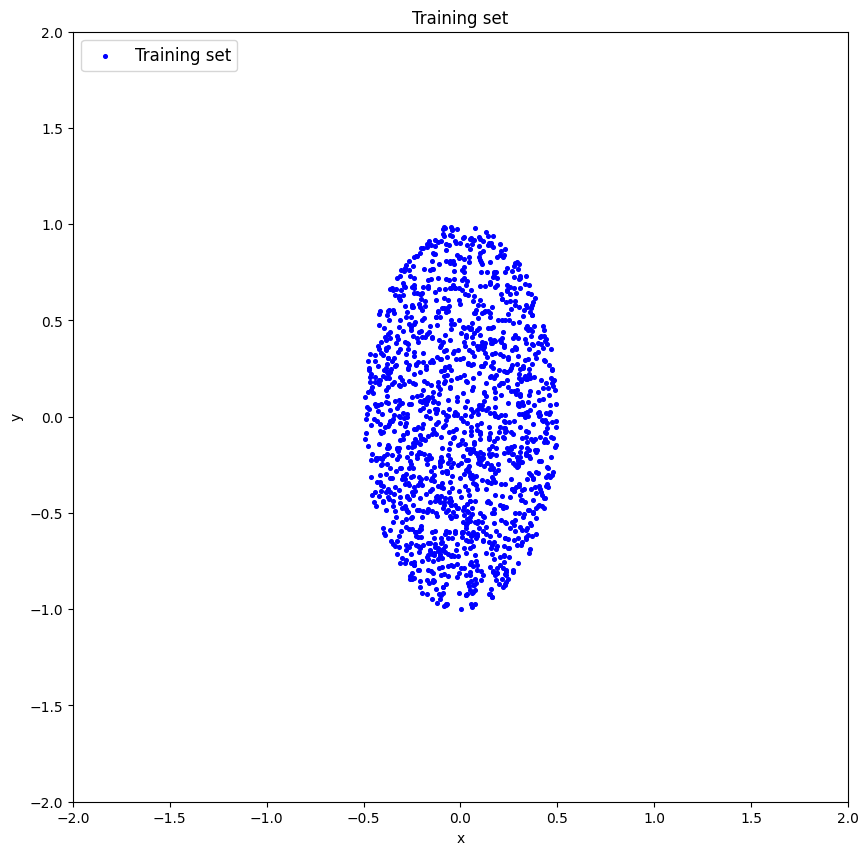

In [ ]:
# Генерации координат точки
def generate_point():
  x = np.random.uniform(-1, 1)
  y = np.random.uniform(-1, 1)
  return np.array([x, y])

# Проверка, попадает ли точка внутрь круга
def is_inside_circle(point, center, vert_radius, hor_radius):
    x, y = point
    cx, cy = center

    distance_x = abs(x - cx)
    distance_y = abs(y - cy)

    if distance_x**2 / hor_radius**2 + distance_y**2 / vert_radius**2 <= 1:
        return True
    else:
        return False

# Параметры
n_points = 1500  # Количество точек
vert_radius = 1  # Радиус по вертикали
hor_radius = 0.5  # Радиус по горизонтали

# Центры кругов
center = np.array([0, 0])

# Генерация массива точек
points = np.empty((n_points, 2))
for i in range(n_points):
  # Генерируем точку
  point = generate_point()


  while not is_inside_circle(point, center, vert_radius, hor_radius):
    point = generate_point()

  # Добавляем точку в массив
  points[i] = point

# Печать массива точек
print(points)

plt.figure(figsize=(10,10))
plt.scatter(points[:,0],points[:,1],marker='o',s=7,color='b',label='Training set')
plt.legend(loc= 'upper left',fontsize=12)
plt.title('Training set')
plt.xlabel('x')
plt.ylabel('y')
plt.xlim([-2, 2])
plt.ylim([-2, 2])
plt.show()

data10 = points

In [ ]:
#### Обучение Автокодировщика
size = data10.shape[1]
patience = 300
verbose_show = True
ae10 = tensorflow.keras.models.Sequential()

# input layer
ae10.add(tensorflow.keras.layers.Dense(size))
ae10.add(tensorflow.keras.layers.Activation('tanh'))

# hidden layers
ae10.add(tensorflow.keras.layers.Dense(5))
ae10.add(tensorflow.keras.layers.Activation('tanh'))
ae10.add(tensorflow.keras.layers.Dense(3))
ae10.add(tensorflow.keras.layers.Activation('tanh'))
ae10.add(tensorflow.keras.layers.Dense(2))
ae10.add(tensorflow.keras.layers.Activation('tanh'))
ae10.add(tensorflow.keras.layers.Dense(3))
ae10.add(tensorflow.keras.layers.Activation('tanh'))
ae10.add(tensorflow.keras.layers.Dense(5))
ae10.add(tensorflow.keras.layers.Activation('tanh'))

# output layer
ae10.add(tensorflow.keras.layers.Dense(size))
ae10.add(tensorflow.keras.layers.Activation('linear'))

optimizer = tensorflow.keras.optimizers.Adam(learning_rate=0.001, beta_1=0.9, beta_2=0.999, amsgrad=False)
ae10.compile(loss='mean_squared_error', optimizer=optimizer)
error_stop = 0.0001
epo = 3000

early_stopping_callback_on_error = EarlyStoppingOnValue(monitor='loss', baseline=error_stop)
early_stopping_callback_on_improving = tensorflow.keras.callbacks.EarlyStopping(monitor='loss',
                                                                                           min_delta=0.0001, patience = patience,
                                                                                           verbose=1, mode='auto',
                                                                                           baseline=None,
                                                                                           restore_best_weights=False)

history_callback = tensorflow.keras.callbacks.History()
verbose = 1 if verbose_show else 0
history_object = ae10.fit(data10, data10,
                                batch_size=data10.shape[0],
                                epochs=epo,
                                callbacks=[early_stopping_callback_on_error, history_callback,
                                early_stopping_callback_on_improving],
                                verbose=verbose)
ae10_trainned = ae10
ae10_pred = ae10_trainned.predict(data10)
ae10_trainned.save('out/AE10.h5')

Epoch 1/3000
1/1 [==============================] - 2s 2s/step - loss: 0.1246
Epoch 2/3000
1/1 [==============================] - 0s 11ms/step - loss: 0.1236
Epoch 3/3000
1/1 [==============================] - 0s 11ms/step - loss: 0.1225
Epoch 4/3000
1/1 [==============================] - 0s 11ms/step - loss: 0.1215
Epoch 5/3000
1/1 [==============================] - 0s 13ms/step - loss: 0.1205
Epoch 6/3000
1/1 [==============================] - 0s 11ms/step - loss: 0.1195
Epoch 7/3000
1/1 [==============================] - 0s 10ms/step - loss: 0.1185
Epoch 8/3000
1/1 [==============================] - 0s 11ms/step - loss: 0.1174
Epoch 9/3000
1/1 [==============================] - 0s 10ms/step - loss: 0.1164
Epoch 10/3000
1/1 [==============================] - 0s 18ms/step - loss: 0.1153
Epoch 11/3000
1/1 [==============================] - 0s 11ms/step - loss: 0.1142
Epoch 12/3000
1/1 [==============================] - 0s 15ms/step - loss: 0.1131
Epoch 13/3000
1/1 [====================

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [ ]:
ae10.save('best_model_for_data10')

In [ ]:
from keras.models import load_model
ae10 = load_model('best_model_for_data10')

ae10_trainned = ae10
ae10_pred = ae10_trainned.predict(data10)
ae10_trainned.save('out/AE10.h5')

47/47 [==============================] - 0s 2ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


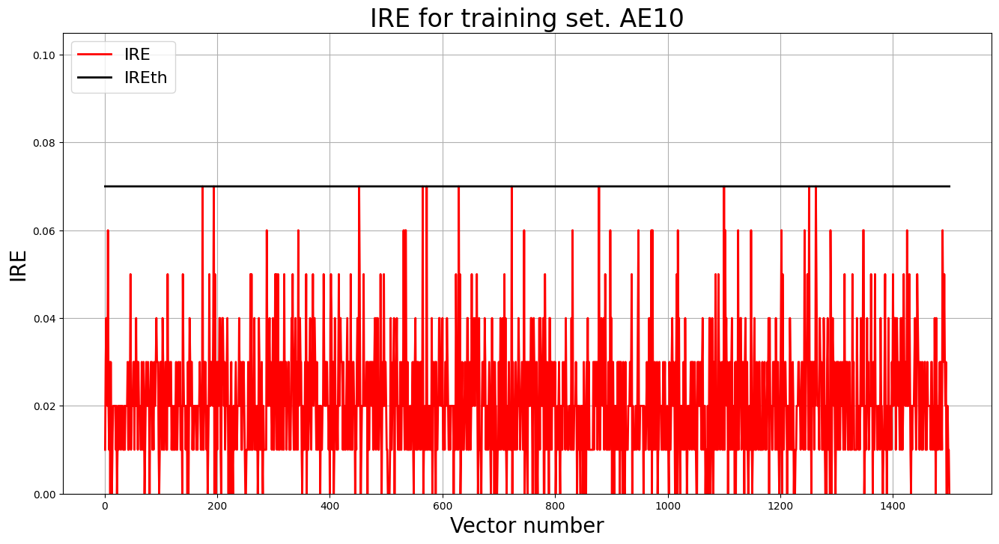

In [ ]:
irefile = 'out/AE10_ire_th.txt'
IRE_array = np.round(ire_array(data10, ae10_pred), 2)
IREth = np.amax(IRE_array)
with open(irefile, 'w') as file:
    file.write(str(IREth))

IRE10 = IRE_array
IREth_10 = IREth

lib.ire_plot('training', IRE10, IREth, 'AE10')

313/313 [==============================] - 2s 5ms/step


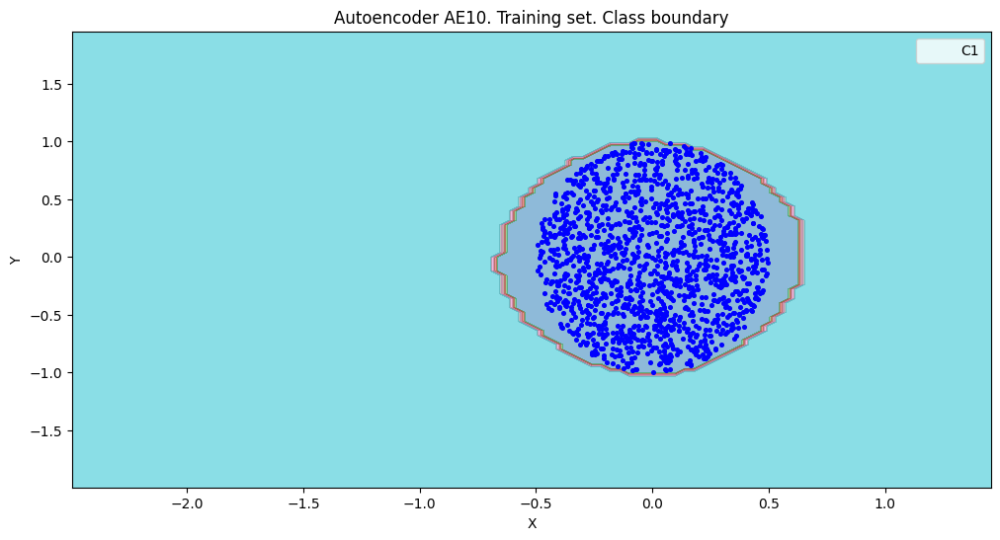

amount:  583
amount_ae:  827


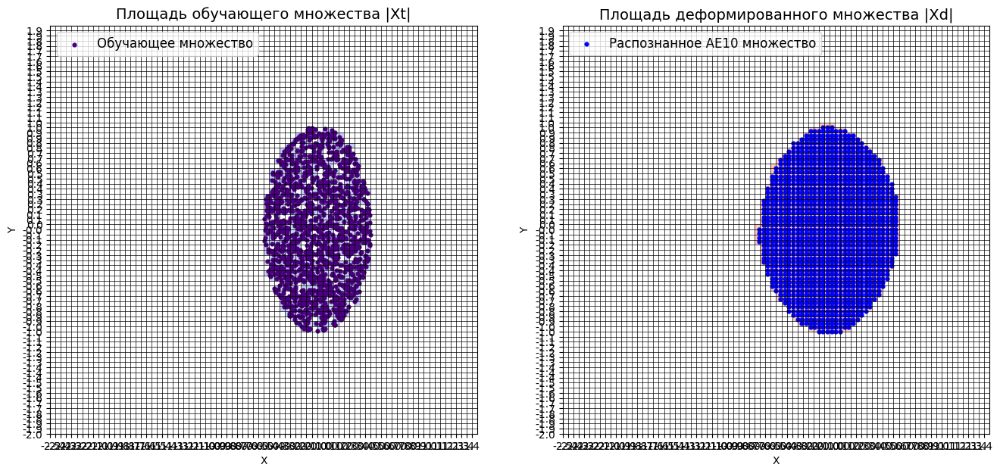

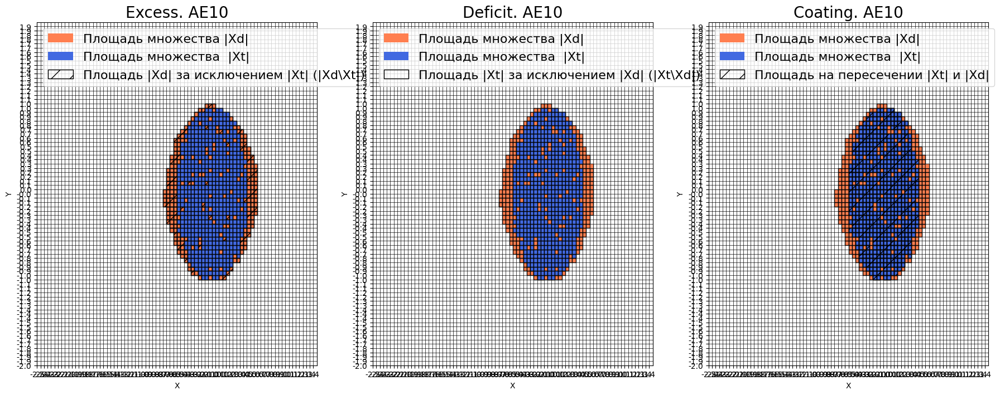


Оценка качества AE10
IDEAL = 0. Excess:  0.41852487135506006
IDEAL = 0. Deficit:  0.0
IDEAL = 1. Coating:  1.0
summa:  1.0
IDEAL = 1. Extrapolation precision (Approx):  0.7049576783555019




In [ ]:
# построение областей покрытия и границ классов
# расчет характеристик качества обучения
# параметр numb_square, отвечающий за количество элементов разбиения по каждой оси пространства признаков
numb_square = 80

xx, yy, Z3 = lib.square_calc(numb_square, data10, ae10_trainned, IREth_10, '10', True)

### Плотное покрытие

In [ ]:
def generate_grid_points(n_points):
    x = np.linspace(-1, 1, n_points)
    y = np.linspace(-1, 1, n_points)

    points = [np.array([i, j]) for i in x for j in y]

    return points

# Функция для проверки, попадает ли точка внутрь эллипса
def is_inside_circle(point, center, vert_radius, hor_radius):
    x, y = point
    cx, cy = center

    distance_x = abs(x - cx)
    distance_y = abs(y - cy)

    if distance_x**2 / hor_radius**2 + distance_y**2 / vert_radius**2 <= 1:
        return True
    else:
        return False

# Параметры
n_points = 80  # Количество точек
vert_radius = 1  # Радиус по вертикали
hor_radius = 0.5  # Радиус по горизонтали

# Центры кругов
center = np.array([0, 0])


grid_points = generate_grid_points(n_points)
points = []

for point in grid_points:
  if is_inside_circle(point, center, vert_radius, hor_radius):
    points.append(point)

points = np.array(points)

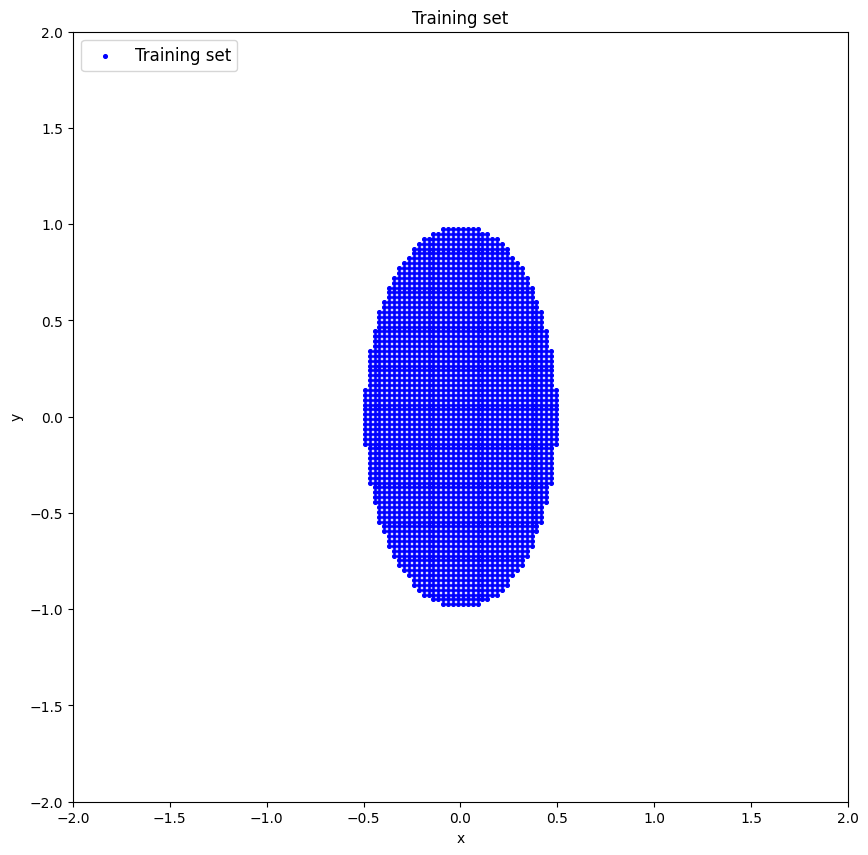

In [ ]:
plt.figure(figsize=(10,10))
plt.scatter(points[:,0],points[:,1],marker='o',s=7,color='b',label='Training set')
plt.legend(loc= 'upper left',fontsize=12)
plt.title('Training set')
plt.xlabel('x')
plt.ylabel('y')
plt.xlim([-2, 2])
plt.ylim([-2, 2])
plt.show()

data10 = points

2794/2794 [==============================] - 8s 3ms/step


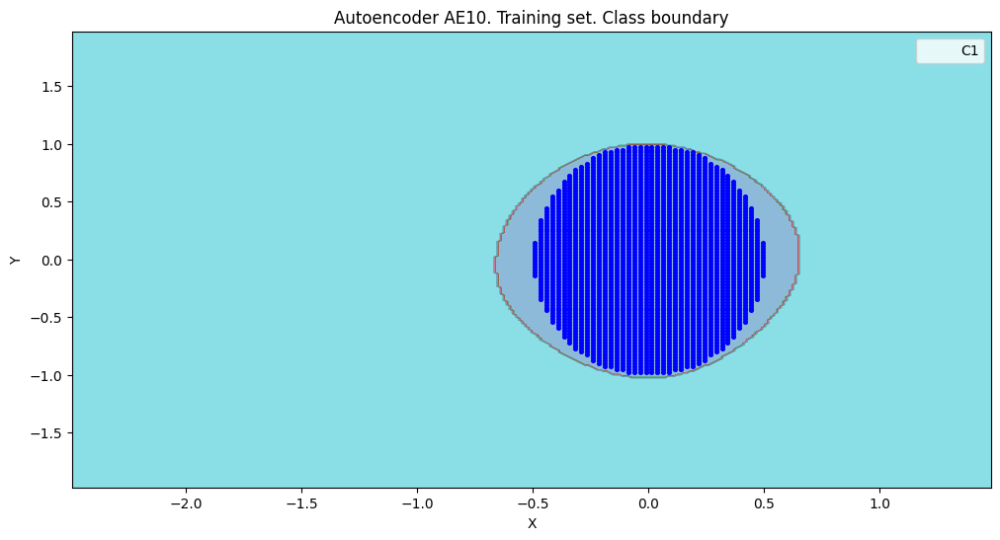

amount:  2452
amount_ae:  3279


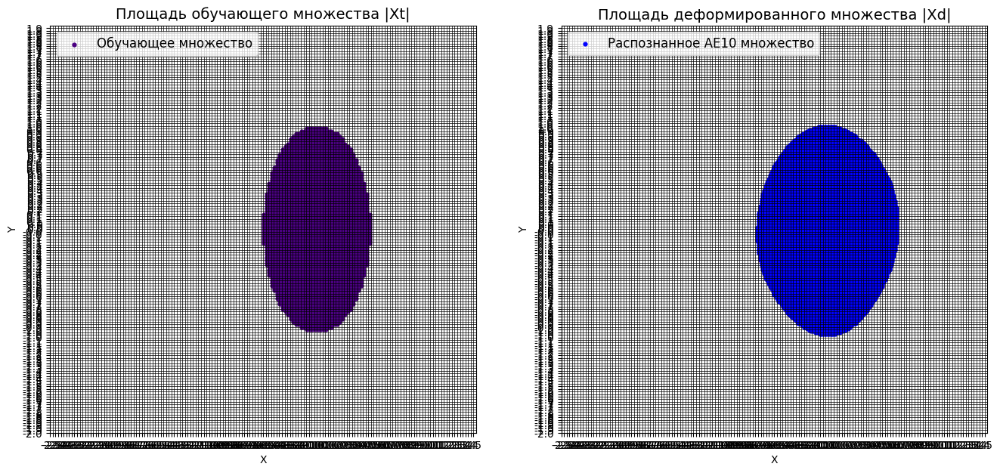

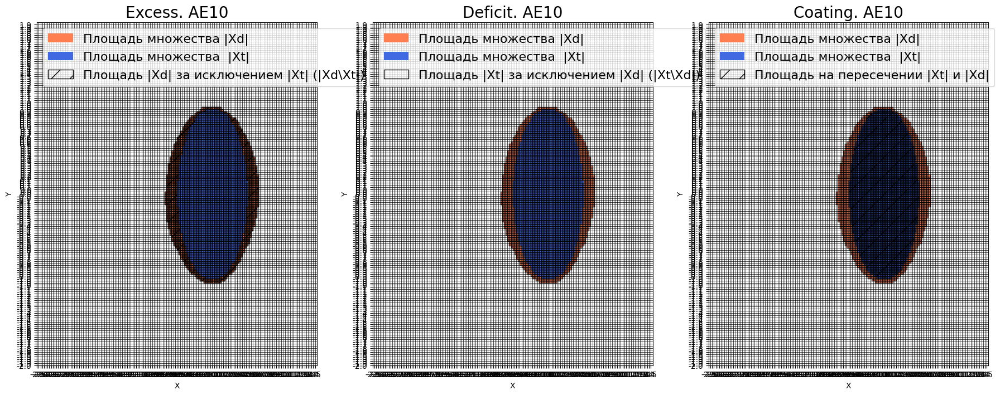


Оценка качества AE10
IDEAL = 0. Excess:  0.33727569331158236
IDEAL = 0. Deficit:  0.0
IDEAL = 1. Coating:  1.0
summa:  1.0
IDEAL = 1. Extrapolation precision (Approx):  0.7477889600487952




In [ ]:
# построение областей покрытия и границ классов
# расчет характеристик качества обучения
# параметр numb_square, отвечающий за количество элементов разбиения по каждой оси пространства признаков
numb_square = 158

xx, yy, Z3 = lib.square_calc1(numb_square, data10, ae10_trainned, IREth_10, '10', True)

### График Ecxess


In [ ]:
Excess = [0, 1, 0, 2.5, 0, 0.25, 0, 1.125, 0.2, 0.38, 0.09, 0.5, 0.19, 0.2, 0.171, 0.406, 0.282, 0.273, 0.192,
          0.391, 0.22, 0.263, 0.197, 0.269, 0.234, 0.253, 0.277, 0.277, 0.26, 0.245, 0.243, 0.309, 0.296, 0.268,
          0.236, 0.315, 0.269, 0.257, 0.26, 0.326, 0.25, 0.269, 0.237, 0.284, 0.279, 0.259, 0.283, 0.283, 0.278,
          0.261, 0.274, 0.313, 0.299, 0.289, 0.297, 0.311, 0.294, 0.278, 0.309, 0.311, 0.331, 0.309, 0.292, 0.324,
          0.312, 0.319, 0.322, 0.349, 0.348, 0.359, 0.343, 0.372, 0.364, 0.387, 0.36, 0.433, 0.392, 0.425, 0.401,
          0.441, 0.412, 0.449, 0.441, 0.441, 0.491, 0.477, 0.468, 0.503, 0.515, 0.515, 0.523, 0.535, 0.581, 0.572,
          0.595, 0.591, 0.589, 0.645, 0.65, 0.664]

In [ ]:
n = list(range(1, 101))

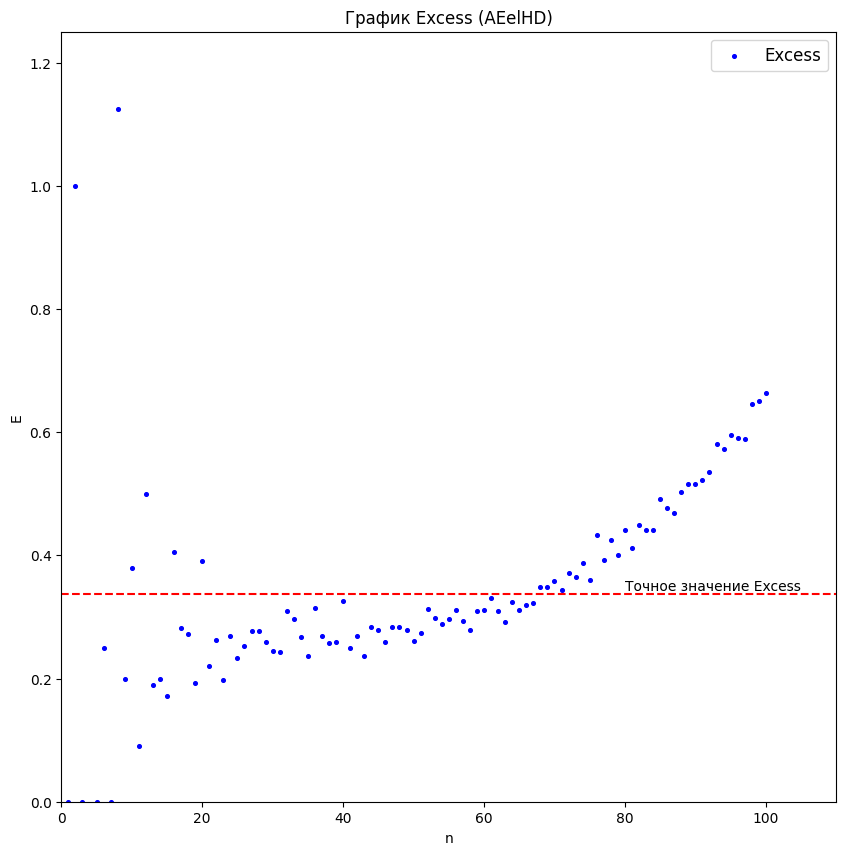

In [ ]:
plt.figure(figsize=(10,10))
plt.scatter(n,Excess,marker='o',s=7,color='b',label='Excess')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Excess (AEelHD)')
plt.xlabel('n')
plt.ylabel('E')
plt.hlines(0.337, 0, 110, color='red',linestyle='--')
plt.text(105, 0.350, 'Точное значение Excess', ha='right', va='center')
plt.xlim([0, 110])
plt.ylim([0, 1.25])
plt.show()

### Среднее Excess

In [ ]:
nn = np.arange(5,101)
av = []
for i in nn:
  av.append(np.mean(Excess[0:i]))

print(av)

[0.7, 0.625, 0.5357142857142857, 0.609375, 0.5638888888888889, 0.5455, 0.504090909090909, 0.50375, 0.47961538461538467, 0.4596428571428572, 0.44040000000000007, 0.43825000000000003, 0.42905882352941177, 0.4203888888888889, 0.4083684210526316, 0.40750000000000003, 0.39857142857142863, 0.39240909090909093, 0.3839130434782609, 0.379125, 0.37332, 0.3686923076923077, 0.3652962962962963, 0.3621428571428571, 0.35862068965517235, 0.3548333333333333, 0.35122580645161283, 0.34990625000000003, 0.3482727272727273, 0.34591176470588236, 0.3427714285714286, 0.342, 0.3400270270270271, 0.33784210526315794, 0.33584615384615385, 0.3356, 0.33351219512195124, 0.33197619047619054, 0.32976744186046514, 0.32872727272727276, 0.32762222222222226, 0.3261304347826087, 0.32521276595744686, 0.32433333333333336, 0.3233877551020409, 0.32214000000000004, 0.3211960784313726, 0.3210384615384616, 0.320622641509434, 0.3200370370370371, 0.3196181818181819, 0.3194642857142857, 0.31901754385964914, 0.3183103448275862, 0.3181

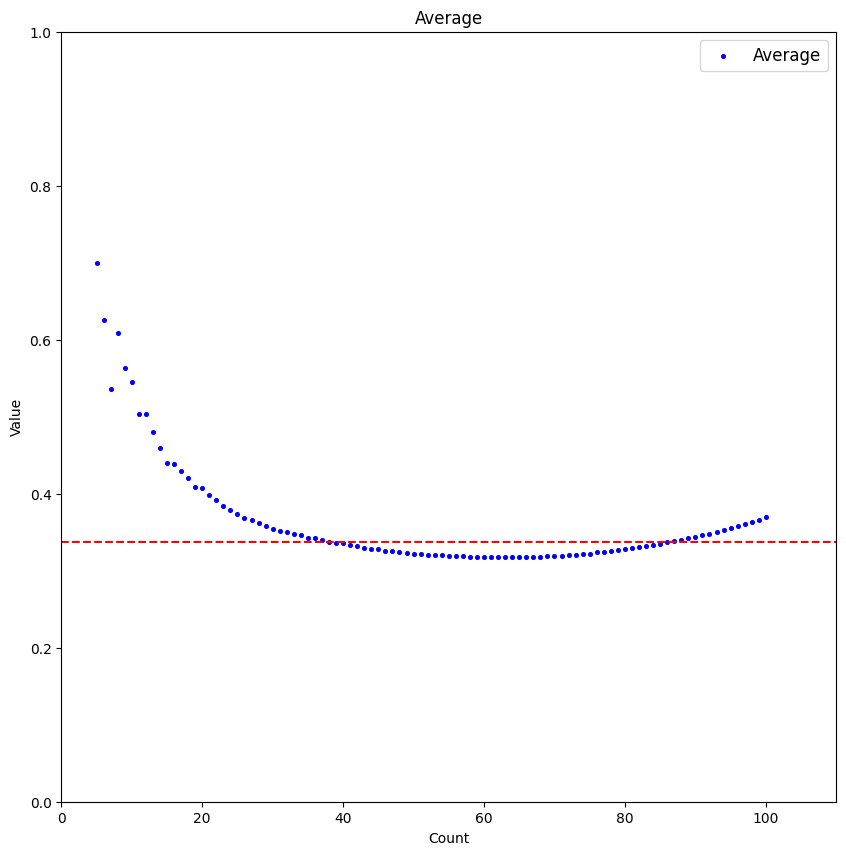

In [ ]:
plt.figure(figsize=(10,10))
plt.scatter(nn,av,marker='o',s=7,color='b',label='Average')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Average')
plt.xlabel('Count')
plt.ylabel('Value')
plt.hlines(0.337, 0, 110, color='red',linestyle='--')
plt.xlim([0, 110])
plt.ylim([0, 1])
plt.show()

### Аппроксимация с помощью МНК (эллипс)

In [ ]:
x = np.array(n)
y = np.array(Excess)

#### 1-я степень

In [ ]:
m = len(x)
X = np.stack((np.ones(m), x)).T
beta, residuals, rank, sv = linalg.lstsq(X, y)

beta0, beta1 = beta
beta0, beta1

(0.28448787878787885, 0.0016778637863786394)

Сумма квадратов отклонений

In [ ]:
residuals


7.186816379753978

In [ ]:
beta = np.polyfit(x, y, 1)
beta1, beta0 = beta
beta0, beta1

(0.28448787878787896, 0.0016778637863786368)

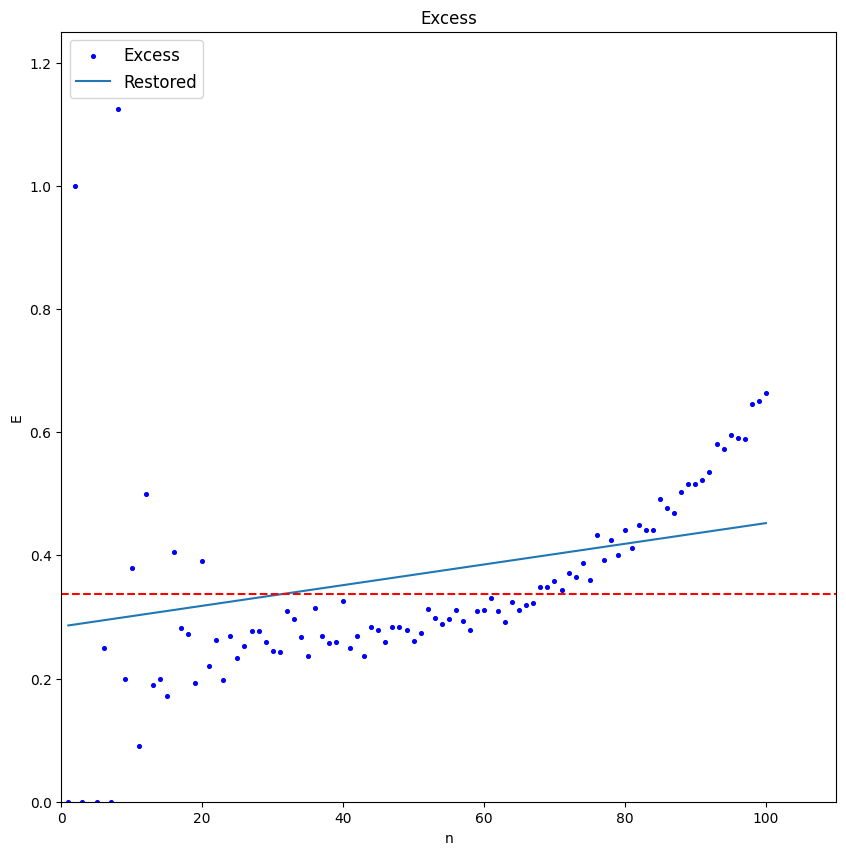

In [ ]:
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='b',label='Excess')
plt.plot(x, beta0 + beta1*x , label = 'Restored')
plt.legend(loc= 'upper left',fontsize=12)
plt.title('Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.hlines(0.337, 0, 110, color='red',linestyle='--')
plt.xlim([0, 110])
plt.ylim([0, 1.25])
plt.show()

#### 2-я степень

In [ ]:
beta = np.polyfit(x, y, 2)
beta2, beta1, beta0 = beta
beta0, beta1, beta2

(0.5169467532467535, -0.011996187652378695, 0.00013538664790848837)

In [ ]:
X = np.stack((np.ones(m), x, x**2)).T
beta, residuals, rank, sv = linalg.lstsq(X, y)
beta0, beta1, beta2 = beta
beta

array([ 5.16946753e-01, -1.19961877e-02,  1.35386648e-04])

Сумма квадратов отклонений

In [ ]:
residuals

6.1690174690393755

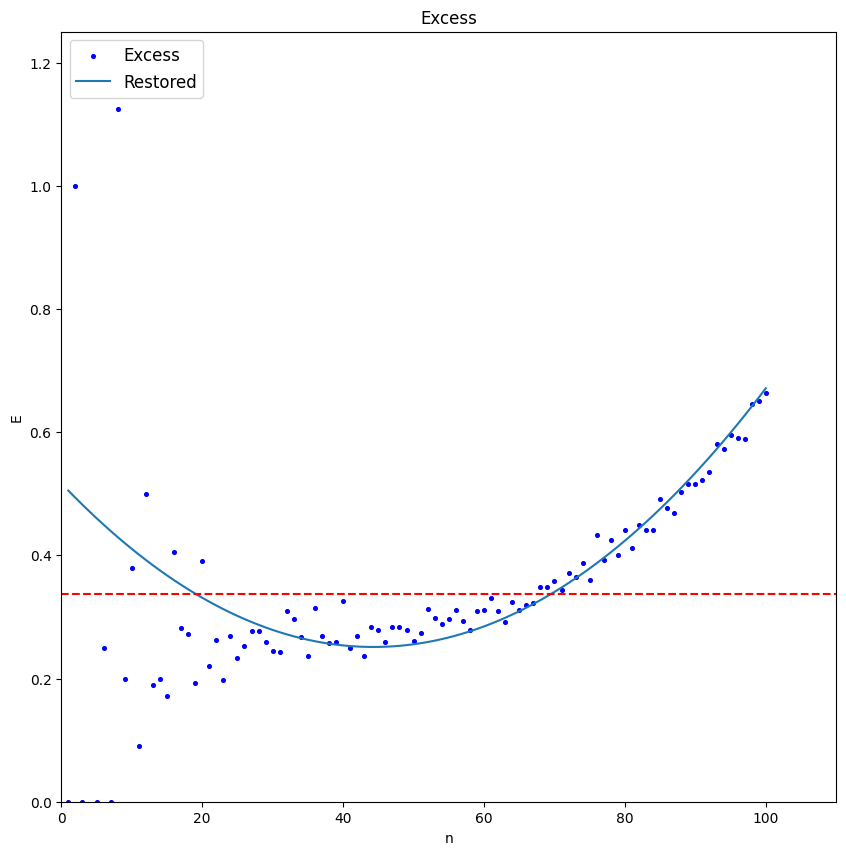

In [ ]:
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='b',label='Excess')
plt.plot(x, beta0 + beta1*x + beta2*x**2 , label = 'Restored')
plt.legend(loc= 'upper left',fontsize=12)
plt.title('Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.hlines(0.337, 0, 110, color='red',linestyle='--')
plt.xlim([0, 110])
plt.ylim([0, 1.25])
plt.show()

##### Экстремум

In [ ]:
from sympy import *

x = Symbol('x', real=True)
f = 0.5169467532467535 -0.011996187652378695*x + 0.00013538664790848837*x**2
fprime = f.diff(x)
fprime

0.000270773295816977*x - 0.0119961876523787

In [ ]:
solve(fprime, x)

[44.3034369995158]

In [ ]:
def f(x):
    return 0.5169467532467535 -0.011996187652378695*x + 0.00013538664790848837*x**2

from scipy.optimize import minimize_scalar
res = minimize_scalar(f)
print ('res.fun = ', res.fun)
print ('res.x = ', res.x)

res.fun =  0.25121058130098883
res.x =  44.30343699952111


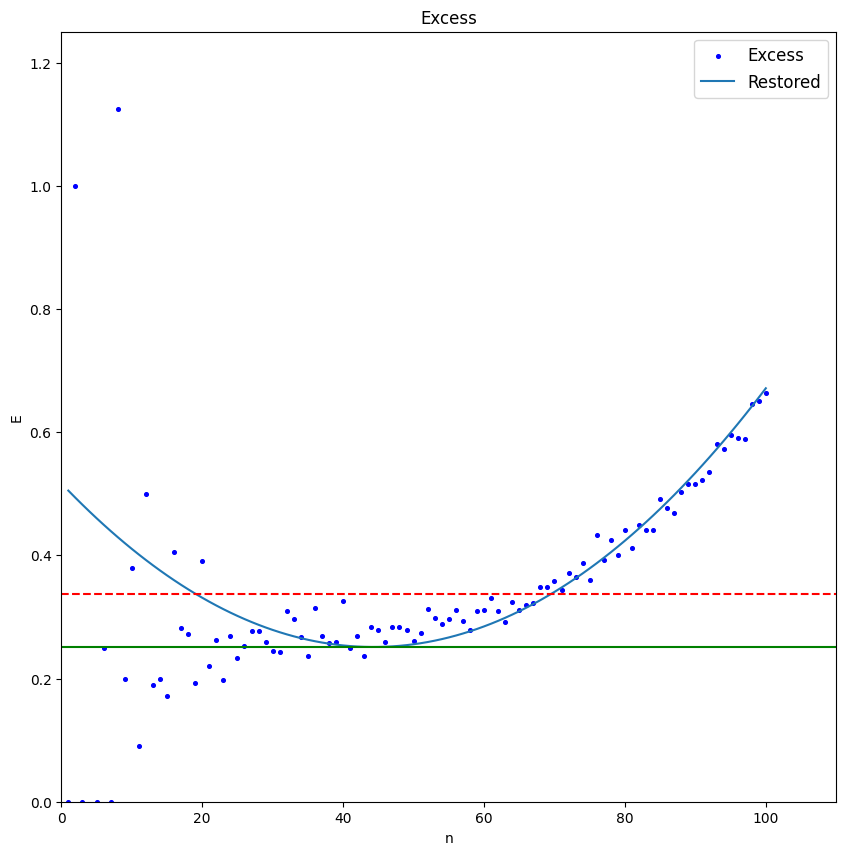

In [ ]:
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='b',label='Excess')
plt.plot(x, beta0 + beta1*x + beta2*x**2, label = 'Restored')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.axhline(y = 0.337, color = 'r', linestyle = '--',label='exact')
plt.hlines(0.251, 0, 110, color='green',linestyle='-')
plt.xlim([0, 110])
plt.ylim([0, 1.25])
plt.show()

##### Точки пересечения многочлена с пунктирной прямой

In [ ]:
def f(x):
  return 0.5169467532467535 -0.011996187652378695*x + 0.00013538664790848837*x**2

def find_intersection_points(f, y_intercept, x_min, x_max, tolerance):
  """
  Находит точки пересечения функции f с горизонтальной прямой y = y_intercept.

  Args:
    f: Функция, задающая график.
    y_intercept: Ордината горизонтальной прямой.
    x_min: Левая граница области поиска.
    x_max: Правая граница области поиска.
    tolerance: Точность вычисления.

  Returns:
    Список точек пересечения (x, y).
  """

  points = []
  for x in np.arange(x_min, x_max, tolerance):
    if abs(f(x) - y_intercept) < tolerance:
      points.append((x, y_intercept))

  return points

# Пример использования
y_intercept = 0.337
x_min = 0
x_max = 100
tolerance = 0.001

points = find_intersection_points(f, y_intercept, x_min, x_max, tolerance)

print(f"Точки пересечения: {points}")

Точки пересечения: [(18.985, 0.337), (18.986, 0.337), (18.987000000000002, 0.337), (18.988, 0.337), (18.989, 0.337), (18.990000000000002, 0.337), (18.991, 0.337), (18.992, 0.337), (18.993000000000002, 0.337), (18.994, 0.337), (18.995, 0.337), (18.996, 0.337), (18.997, 0.337), (18.998, 0.337), (18.999, 0.337), (19.0, 0.337), (19.001, 0.337), (19.002, 0.337), (19.003, 0.337), (19.004, 0.337), (19.005, 0.337), (19.006, 0.337), (19.007, 0.337), (19.008, 0.337), (19.009, 0.337), (19.01, 0.337), (19.011, 0.337), (19.012, 0.337), (19.013, 0.337), (19.014, 0.337), (19.015, 0.337), (19.016000000000002, 0.337), (19.017, 0.337), (19.018, 0.337), (19.019000000000002, 0.337), (19.02, 0.337), (19.021, 0.337), (19.022000000000002, 0.337), (19.023, 0.337), (19.024, 0.337), (19.025000000000002, 0.337), (19.026, 0.337), (19.027, 0.337), (19.028, 0.337), (19.029, 0.337), (19.03, 0.337), (19.031, 0.337), (19.032, 0.337), (19.033, 0.337), (19.034, 0.337), (19.035, 0.337), (19.036, 0.337), (19.037, 0.337), 

In [ ]:
res = np.round(np.array([points[0], points[len(points)-1]]))
res

array([[19.,  0.],
       [70.,  0.]])

#### 3-я степень

In [ ]:
beta = np.polyfit(x, y, 3)
beta3, beta2, beta1, beta0 = beta
beta0, beta1, beta2, beta3

(0.5848165501852096,
 -0.019864843714037773,
 0.00032918960889779945,
 -1.279227465275979e-06)

In [ ]:
X = np.stack((np.ones(m), x, x**2, x**3)).T
beta, residuals, rank, sv = linalg.lstsq(X, y)
beta0, beta1, beta2, beta3 = beta
beta

array([ 5.84816550e-01, -1.98648437e-02,  3.29189609e-04, -1.27922747e-06])

In [ ]:
residuals

6.110655586266745

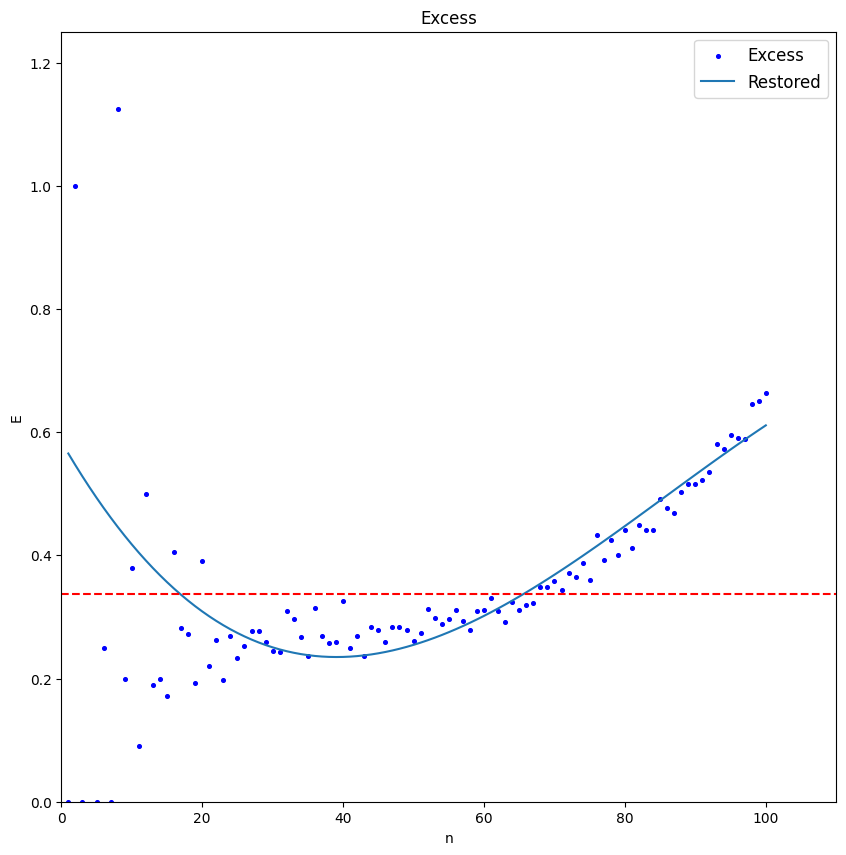

In [ ]:
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='b',label='Excess')
plt.plot(x, beta0 + beta1*x + beta2*x**2 + beta3*x**3 , label = 'Restored')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.hlines(0.337, 0, 110, color='red',linestyle='--')
plt.xlim([0, 110])
plt.ylim([0, 1.25])
plt.show()

###### Экстремум

In [ ]:
from sympy import *

x = Symbol('x', real=True)
f = 5.84816550e-01 -1.98648437e-02*x + 3.29189609e-04*x**2 -1.27922747e-06*x**3
fprime = f.diff(x)
fprime

-3.83768241e-6*x**2 + 0.000658379218*x - 0.0198648437

In [ ]:
solve(fprime, x)

[39.0701538315918, 132.486308549046]

In [ ]:
def f(x):
    return 5.84816550e-01 -1.98648437e-02*x + 3.29189609e-04*x**2 -1.27922747e-06*x**3

from scipy.optimize import minimize_scalar
res = minimize_scalar(f)
print ('res.fun = ', res.fun)
print ('res.x = ', res.x)

res.fun =  0.23490166406097607
res.x =  39.070153816969295


In [ ]:
res = minimize_scalar(f, bounds=(0, 100), method='bounded')
res.fun  # minimum
res.x  # minimizer

39.0701534231053

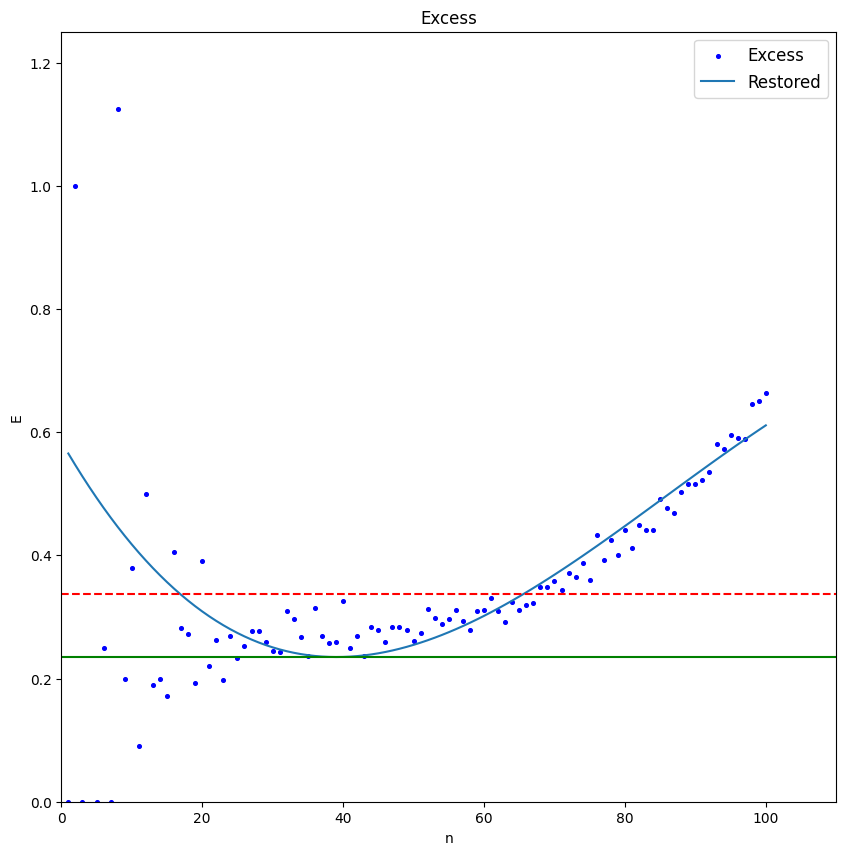

In [ ]:
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='b',label='Excess')
plt.plot(x, beta0 + beta1*x + beta2*x**2 + beta3*x**3 , label = 'Restored')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.axhline(y = 0.337, color = 'r', linestyle = '--',label='exact')
plt.hlines(0.2349, 0, 110, color='green',linestyle='-')
plt.xlim([0, 110])
plt.ylim([0, 1.25])
plt.show()

##### Точки пересечения многочлена с точным значением

In [ ]:
def f(x):
  return 5.84816550e-01 -1.98648437e-02*x + 3.29189609e-04*x**2 -1.27922747e-06*x**3

def find_intersection_points(f, y_intercept, x_min, x_max, tolerance):
  """
  Находит точки пересечения функции f с горизонтальной прямой y = y_intercept.

  Args:
    f: Функция, задающая график.
    y_intercept: Ордината горизонтальной прямой.
    x_min: Левая граница области поиска.
    x_max: Правая граница области поиска.
    tolerance: Точность вычисления.

  Returns:
    Список точек пересечения (x, y).
  """

  points = []
  for x in np.arange(x_min, x_max, tolerance):
    if abs(f(x) - y_intercept) < tolerance:
      points.append((x, y_intercept))

  return points

# Пример использования
y_intercept = 0.337
x_min = 0
x_max = 100
tolerance = 0.001

points = find_intersection_points(f, y_intercept, x_min, x_max, tolerance)

print(f"Точки пересечения: {points}")

Точки пересечения: [(16.794, 0.337), (16.795, 0.337), (16.796, 0.337), (16.797, 0.337), (16.798000000000002, 0.337), (16.799, 0.337), (16.8, 0.337), (16.801000000000002, 0.337), (16.802, 0.337), (16.803, 0.337), (16.804000000000002, 0.337), (16.805, 0.337), (16.806, 0.337), (16.807, 0.337), (16.808, 0.337), (16.809, 0.337), (16.81, 0.337), (16.811, 0.337), (16.812, 0.337), (16.813, 0.337), (16.814, 0.337), (16.815, 0.337), (16.816, 0.337), (16.817, 0.337), (16.818, 0.337), (16.819, 0.337), (16.82, 0.337), (16.821, 0.337), (16.822, 0.337), (16.823, 0.337), (16.824, 0.337), (16.825, 0.337), (16.826, 0.337), (16.827, 0.337), (16.828, 0.337), (16.829, 0.337), (16.830000000000002, 0.337), (16.831, 0.337), (16.832, 0.337), (16.833000000000002, 0.337), (16.834, 0.337), (16.835, 0.337), (16.836000000000002, 0.337), (16.837, 0.337), (16.838, 0.337), (16.839, 0.337), (16.84, 0.337), (16.841, 0.337), (16.842, 0.337), (16.843, 0.337), (16.844, 0.337), (16.845, 0.337), (16.846, 0.337), (16.847, 0.3

In [ ]:
res = np.round(np.array([points[0], points[len(points)-1]]))
res

array([[17.,  0.],
       [66.,  0.]])

#### EXP

In [ ]:
linear_func = lambda x, b0, b1: b0 + b1*x
quadratic_func = lambda x, b0, b1, b2: b0 + b1*x + b2*x**2
qubic_func = lambda x, b0, b1, b2, b3: b0 + b1*x + b2*x**2 + b3*x**3
exp_func = lambda x, b0, b1, b2: b0 + b1*np.exp(b2*x)
exp1_func = lambda x, b0, b1, b2: b0 + b1*np.exp(x-b2)
exp2_func = lambda x, b0, b1, b2: b0 + b1*np.power(b2,x)
exp3_func = lambda x, b0, b1, b2, b3:  b0 + b1*np.power(b2,(x-b3))

In [ ]:
from scipy.optimize import leastsq

# list of model
model_list = [
    'linear', 'quadratic',
    'qubic', 'exp', 'exp1', 'exp2', 'exp3']

# model reference
models_dict = {
        'linear':             linear_func,
        'quadratic':          quadratic_func,
        'qubic':              qubic_func,
        'exp':                exp_func,
        'exp1':               exp1_func,
        'exp2':               exp2_func,
        'exp3':               exp3_func}

# initial values
p0_dict = {
        'linear':             [0, 0],
        'quadratic':          [0, 0, 0],
        'qubic':              [0, 0, 0, 0],
        'exp':                [0, 0, 0],
        'exp1':               [0, 0, 0],
        'exp2':               [1, 1, 1],
        'exp3':               [1, 1, 1, 1]}

# titles (formulas)
formulas_dict = {
        'linear':             'y = b0 + b1*x',
        'quadratic':          'y = b0 + b1*x + b2*x^2',
        'qubic':              'y = b0 + b1*x + b2*x^2 + b3*x^3',
        'exp':                'y = b0 + b1*np.exp(b2*x)',
        'exp1':               'y = b0 + b1*np.exp(x-b2)',
        'exp2':               'y = b0 + b1*np.power(b2,x)',
        'exp3':               'y = b0 + b1*np.power(b2,(x-b3))'}

# actual data
X_fact = x
Y_fact = y

# function for calculating residuals
residual_func = lambda p, x, y: y - func(x, *p)

# return all optional outputs
full_output = True

# variables to save the calculation results
calculation_results_df = pd.DataFrame(columns=['func', 'p0', 'popt', 'cov_x', 'SSE', 'MSE', 'pcov', 'perr', 'Y_calc', 'error_metrics'])
error_metrics_results_df = pd.DataFrame(columns=['MSE', 'RMSE', 'MAE', 'MSPE', 'MAPE', 'RMSLE', 'R2'])

# calculations
for func_name in model_list:
    print(f'{func_name.upper()} MODEL: {formulas_dict[func_name]}')
    func = models_dict[func_name]
    calculation_results_df.loc[func_name, 'func'] = func
    p0 = p0_dict[func_name]
    print(f'p0 = {p0}')
    calculation_results_df.loc[func_name, 'p0'] = p0
    if full_output:
        (popt, cov_x, infodict, mesg, ier) = leastsq(residual_func, p0, args=(X_fact, Y_fact), full_output=full_output)
        integer_flag = f'ier = {ier}, the solution was found' if ier<=4 else f'ier = {ier}, the solution was not found'
        print(integer_flag, '\n', mesg)
        calculation_results_df.loc[func_name, 'popt'] = popt
        print(f'parameters = {popt}')
        calculation_results_df.loc[func_name, 'cov_x'] = cov_x
        print(f'cov_x = \n{cov_x}')
        #SSE = (residual_func(popt, X_fact, Y_fact)**2).sum()
        SSE = (infodict['fvec']**2).sum()
        calculation_results_df.loc[func_name, 'SSE'] = SSE
        print(f'SSE = {SSE}')
        MSE = SSE / (len(Y_fact)-len(p0))
        calculation_results_df.loc[func_name, 'MSE'] = MSE
        print(f'MSE = {MSE}')
        pcov = cov_x * MSE
        calculation_results_df.loc[func_name, 'pcov'] = pcov
        print(f'pcov =\n {pcov}')
        perr = np.sqrt(np.diag(pcov))
        calculation_results_df.loc[func_name, 'perr'] = perr
        print(f'perr = {perr}\n')
    else:
        popt = leastsq(residual_func, p0, args=(X_fact, Y_fact), full_output=full_output)
        calculation_results_df.loc[func_name, 'popt'] = popt
        print(f'parameters = {popt}\n')
    Y_calc = func(X_fact, *popt)
    calculation_results_df.loc[func_name, 'Y_calc'] = Y_calc
    (error_metrics_dict, error_metrics_df) = regression_error_metrics(Yfact=Y_fact, Ycalc=Y_calc, model_name=func_name)
    calculation_results_df.loc[func_name, 'error_metrics'] = error_metrics_dict.values()
    error_metrics_results_df = pd.concat([error_metrics_results_df, error_metrics_df])

LINEAR MODEL: y = b0 + b1*x
p0 = [0, 0]
ier = 3, the solution was found 
 Both actual and predicted relative reductions in the sum of squares
  are at most 0.000000 and the relative error between two consecutive iterates is at 
  most 0.000000
parameters = [0.28448788 0.00167786]
cov_x = 
[[ 4.06060611e-02 -6.06060613e-04]
 [-6.06060613e-04  1.20012002e-05]]
SSE = 7.186816379753974
MSE = 0.0733348610178977
pcov =
 [[ 2.97783985e-03 -4.44453708e-05]
 [-4.44453708e-05  8.80106351e-07]]
perr = [0.05456959 0.00093814]

QUADRATIC MODEL: y = b0 + b1*x + b2*x^2
p0 = [0, 0, 0]
ier = 1, the solution was found 
 Both actual and predicted relative reductions in the sum of squares
  are at most 0.000000
parameters = [ 5.16946753e-01 -1.19961877e-02  1.35386648e-04]
cov_x = 
[[ 9.36982056e-02 -3.72912799e-03  3.09214591e-05]
 [-3.72912799e-03  1.95711048e-04 -1.81890937e-06]
 [ 3.09214591e-05 -1.81890937e-06  1.80090036e-08]]
SSE = 6.169017469039373
MSE = 0.0635981182375193
pcov =
 [[ 5.95902956e-0

<ipython-input-7-a10df777837d>:36: RuntimeWarning: divide by zero encountered in divide
  MSPE = (1/n_fit) *  np.sum(((Yfact-Ycalc)/Yfact)**2)
<ipython-input-7-a10df777837d>:37: RuntimeWarning: divide by zero encountered in divide
  MAPE = (1/n_fit) *  np.sum(abs((Yfact-Ycalc)/Yfact))
<ipython-input-7-a10df777837d>:36: RuntimeWarning: divide by zero encountered in divide
  MSPE = (1/n_fit) *  np.sum(((Yfact-Ycalc)/Yfact)**2)
<ipython-input-7-a10df777837d>:37: RuntimeWarning: divide by zero encountered in divide
  MAPE = (1/n_fit) *  np.sum(abs((Yfact-Ycalc)/Yfact))
<ipython-input-7-a10df777837d>:36: RuntimeWarning: divide by zero encountered in divide
  MSPE = (1/n_fit) *  np.sum(((Yfact-Ycalc)/Yfact)**2)
<ipython-input-7-a10df777837d>:37: RuntimeWarning: divide by zero encountered in divide
  MAPE = (1/n_fit) *  np.sum(abs((Yfact-Ycalc)/Yfact))
<ipython-input-7-a10df777837d>:36: RuntimeWarning: divide by zero encountered in divide
  MSPE = (1/n_fit) *  np.sum(((Yfact-Ycalc)/Yfact)**2)

In [ ]:
b0, b1, b2 = [ 1.16771406e+03, -1.16742956e+03, -1.43698063e-06]

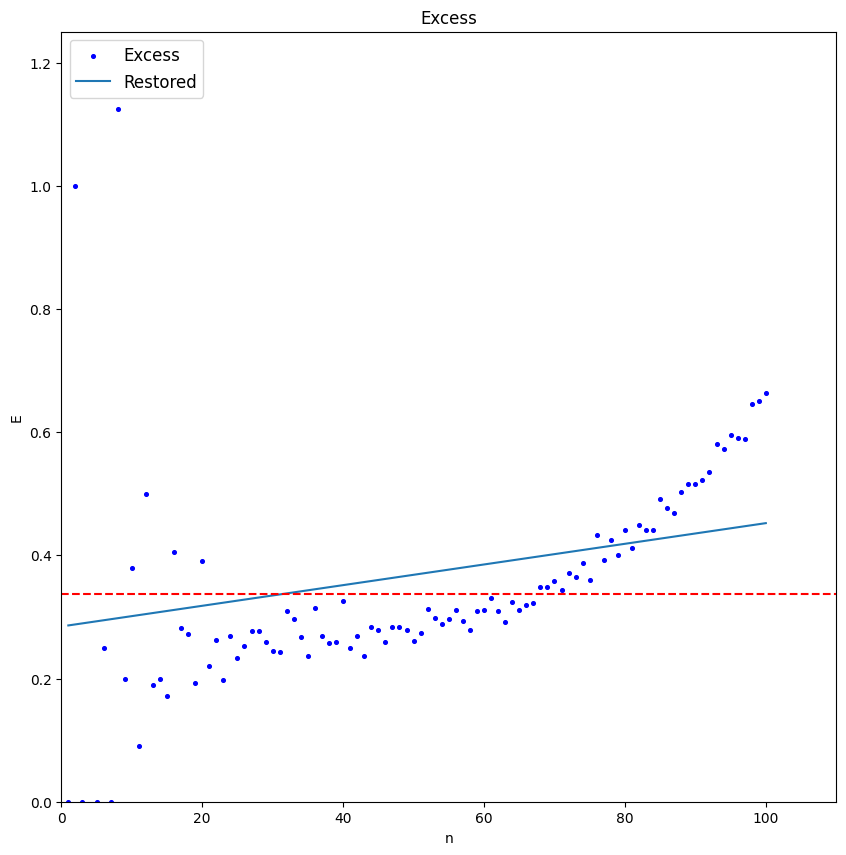

In [ ]:
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='b',label='Excess')
plt.plot(x, b0 + b1*np.exp(b2*x) , label = 'Restored')
plt.legend(loc= 'upper left',fontsize=12)
plt.title('Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.hlines(0.337, 0, 110, color='red',linestyle='--')
plt.xlim([0, 110])
plt.ylim([0, 1.25])
plt.show()

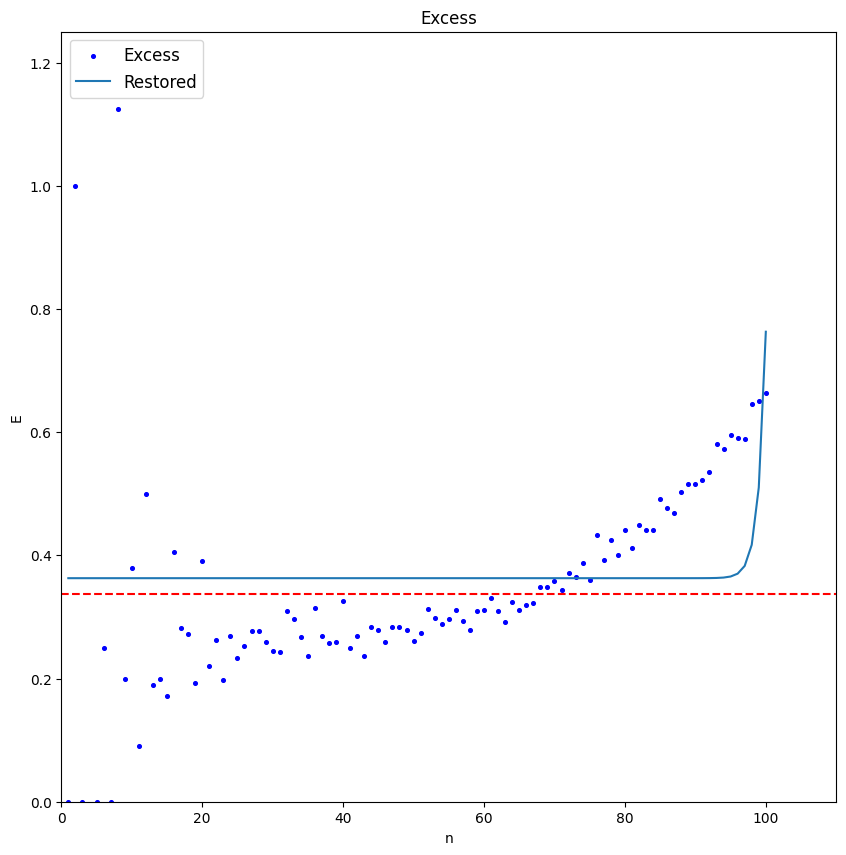

In [ ]:
b0, b1, b2 = [3.62890616e-01, 1.48837766e-44, 0.00000000e+00]

plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='b',label='Excess')
plt.plot(x, b0 + b1*np.exp(x-b2) , label = 'Restored')
plt.legend(loc= 'upper left',fontsize=12)
plt.title('Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.hlines(0.337, 0, 110, color='red',linestyle='--')
plt.xlim([0, 110])
plt.ylim([0, 1.25])
plt.show()

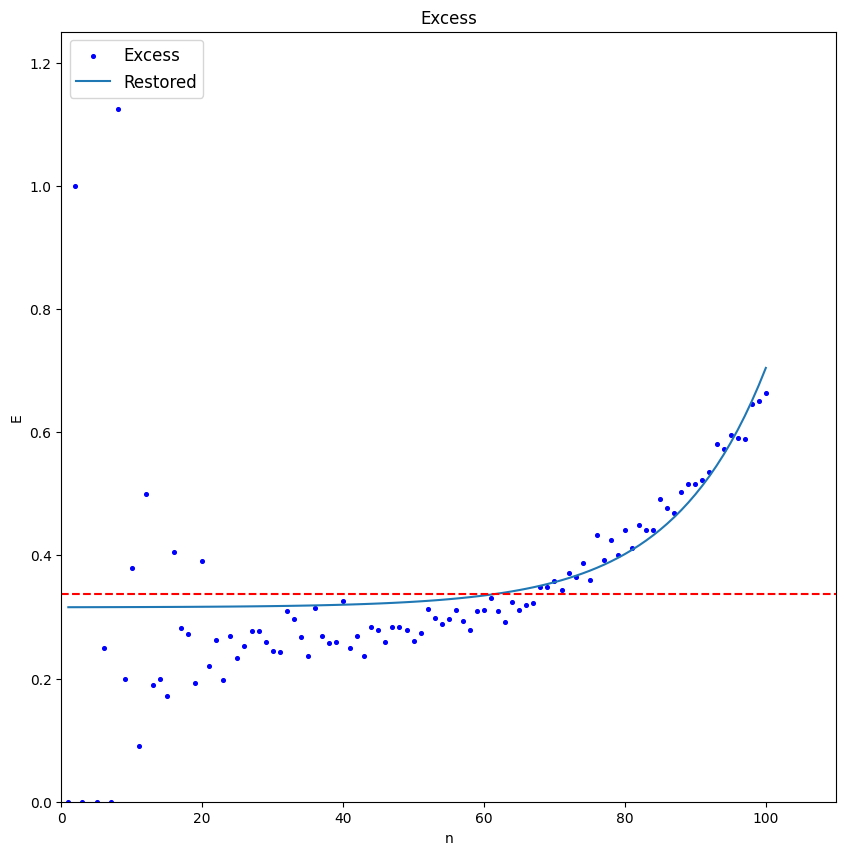

In [ ]:
b0, b1, b2 = [3.15534100e-01, 2.12492259e-04, 1.07801002e+00]

plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='b',label='Excess')
plt.plot(x, b0 + b1*np.power(b2,x) , label = 'Restored')
plt.legend(loc= 'upper left',fontsize=12)
plt.title('Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.hlines(0.337, 0, 110, color='red',linestyle='--')
plt.xlim([0, 110])
plt.ylim([0, 1.25])
plt.show()

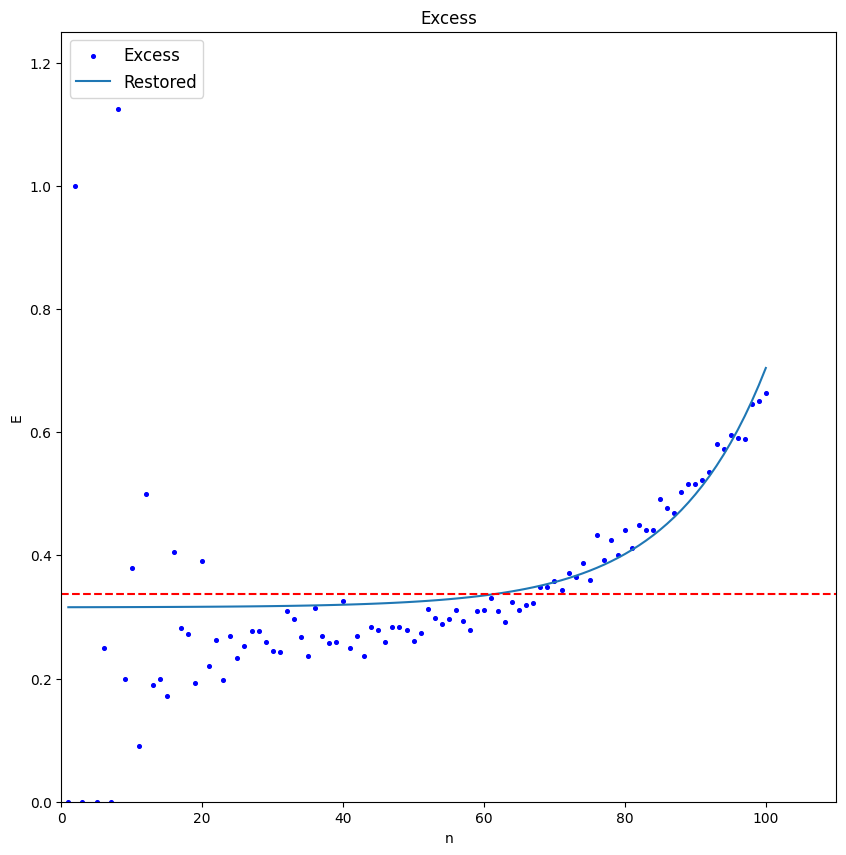

In [ ]:
b0, b1, b2, b3 = [3.15520498e-01, 4.27435815e-04, 1.07797963e+00, 9.27241684e+00]

plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='b',label='Excess')
plt.plot(x, b0 + b1*np.power(b2,(x-b3)) , label = 'Restored')
plt.legend(loc= 'upper left',fontsize=12)
plt.title('Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.hlines(0.337, 0, 110, color='red',linestyle='--')
plt.xlim([0, 110])
plt.ylim([0, 1.25])
plt.show()

### Несколько точек (Excess)

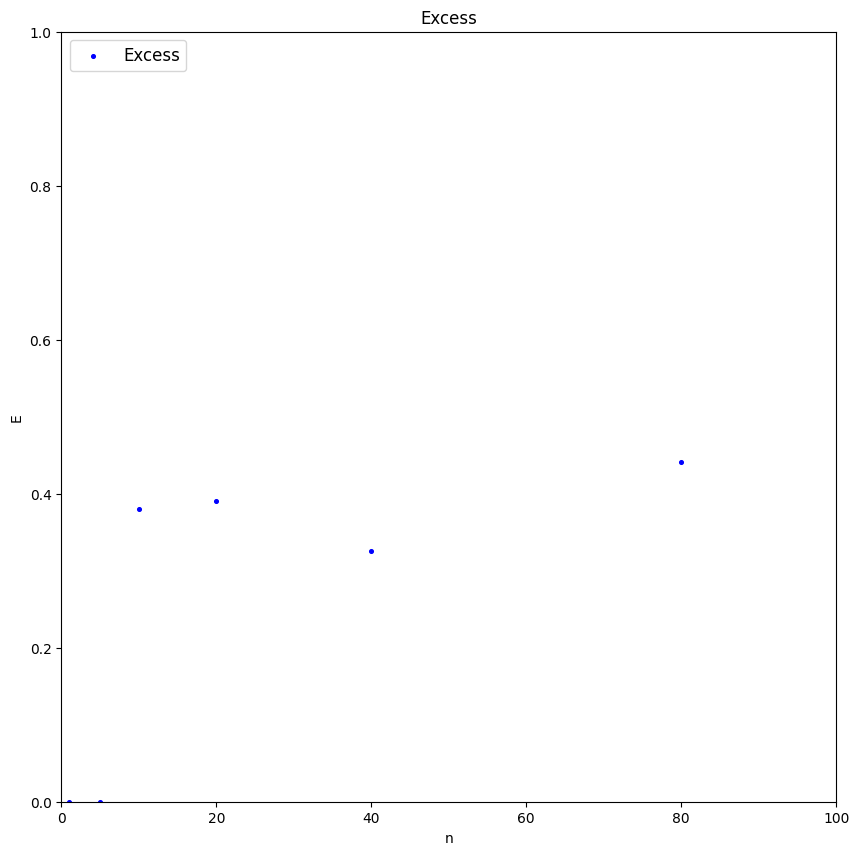

In [ ]:
Excess = [0, 0, 0.38, 0.391, 0.326, 0.441]
n = [1, 5, 10, 20, 40, 80]

plt.figure(figsize=(10,10))
plt.scatter(n,Excess,marker='o',s=7,color='b',label='Excess')
plt.legend(loc= 'upper left',fontsize=12)
plt.title('Excess')
plt.xlabel('n')
plt.ylabel('E')
# plt.hlines(0.337, 0, 110, color='red',linestyle='--')
plt.xlim([0, 100])
plt.ylim([0, 1])
plt.show()

In [ ]:
x = np.array(n)
y = np.array(Excess)

Многочлен 3-й степени

In [ ]:
beta = np.polyfit(x, y, 3)
beta3, beta2, beta1, beta0 = beta
beta0, beta1, beta2, beta3

(-0.0933846607395261,
 0.050125172247016396,
 -0.001443444794287141,
 1.1254997060453245e-05)

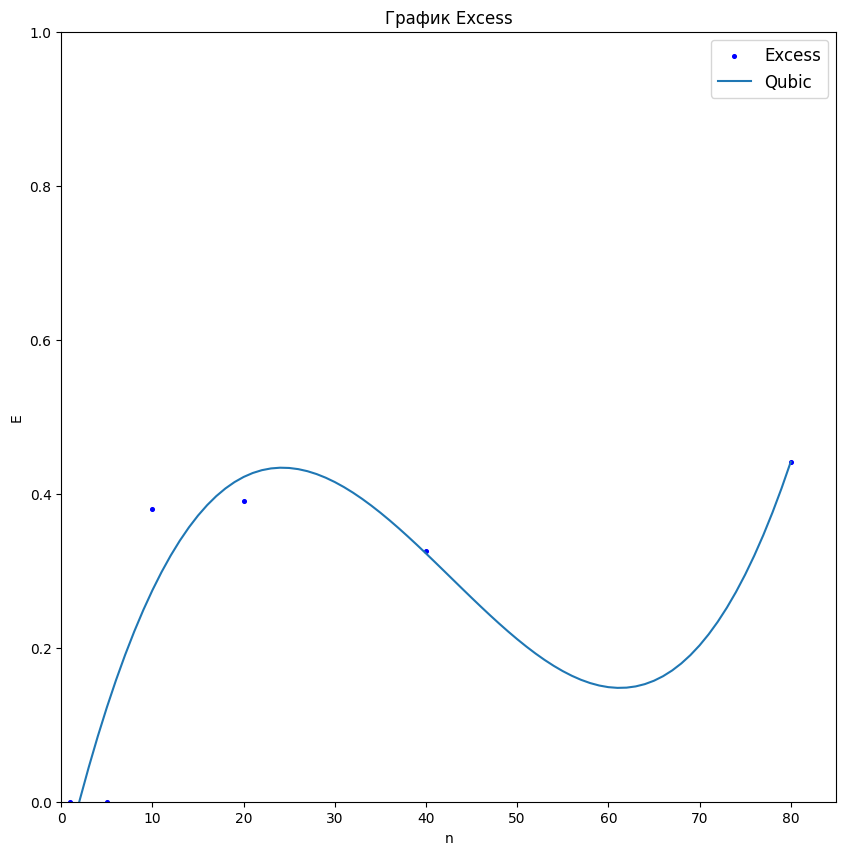

In [ ]:
xx = np.arange (1,81)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='b',label='Excess')
plt.plot(xx, beta0 + beta1*xx + beta2*xx**2 + beta3*xx**3 , label = 'Qubic')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Excess')
plt.xlabel('n')
plt.ylabel('E')
# plt.hlines(0.337, 0, 110, color='red',linestyle='--')
plt.xlim([0, 85])
plt.ylim([0, 1])
plt.show()

In [ ]:
from sympy import *

x = Symbol('x', real=True)
f = beta0 + beta1*x + beta2*x**2 + beta3*x**3
fprime = f.diff(x)

solve(fprime, x)

[24.2292197003844, 61.2702721569692]

Многочлен 2-й степени

In [ ]:
beta = np.polyfit(x, y, 2)
beta2, beta1, beta0 = beta
beta0, beta1, beta2

(0.04802632539479352, 0.015287278525697742, -0.00013311909481323117)

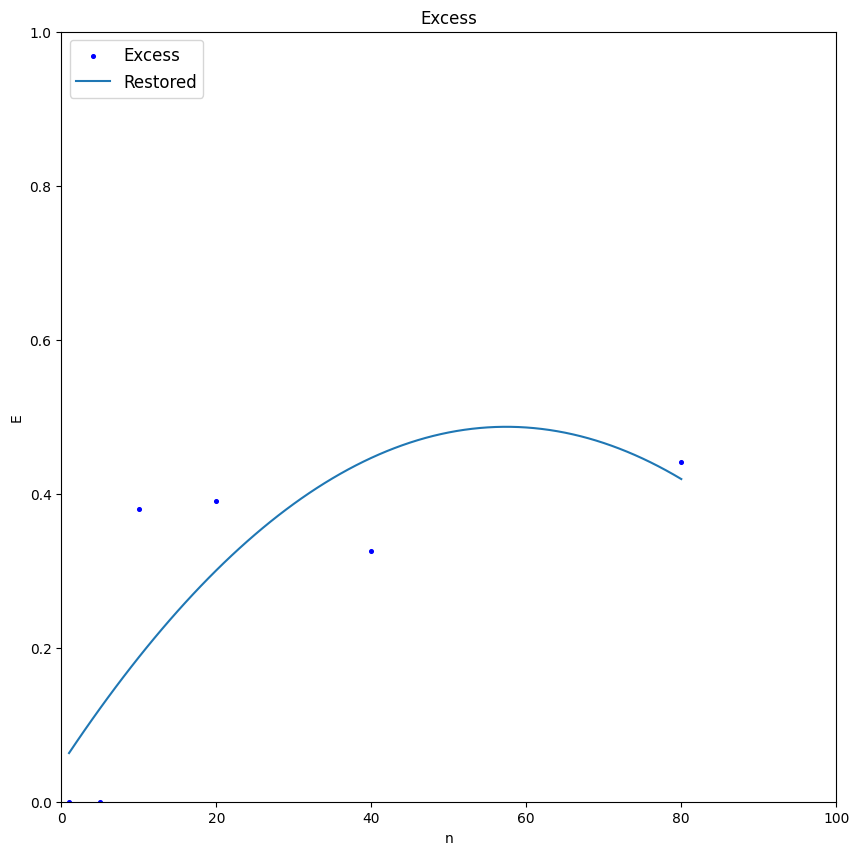

In [ ]:
xx = np.arange (1,81)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='b',label='Excess')
plt.plot(xx, beta0 + beta1*xx + beta2*xx**2 , label = 'Restored')
plt.legend(loc= 'upper left',fontsize=12)
plt.title('Excess')
plt.xlabel('n')
plt.ylabel('E')
#plt.hlines(0.337, 0, 110, color='red',linestyle='--')
plt.xlim([0, 100])
plt.ylim([0, 1])
plt.show()

In [ ]:
from sympy import *

x = Symbol('x', real=True)
f = beta0 + beta1*x + beta2*x**2
fprime = f.diff(x)

solve(fprime, x)

[57.4195555759528]

Многочлен 1-й степени

In [ ]:
beta = np.polyfit(x, y, 1)
beta1, beta0 = beta
beta0, beta1

(0.14025000000000012, 0.003966129032258063)

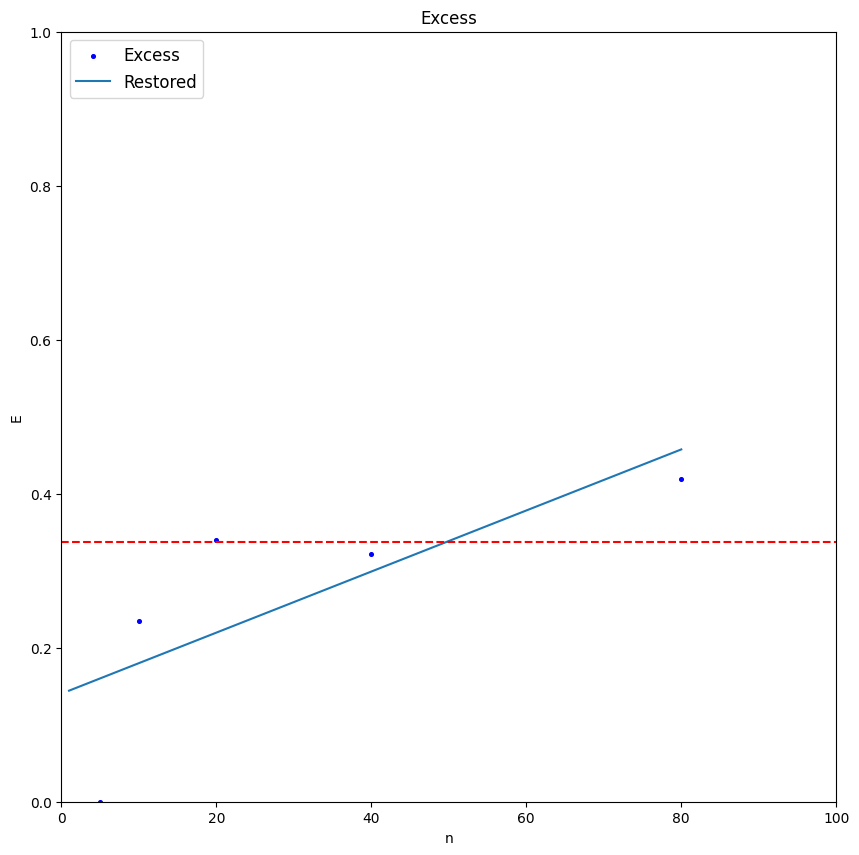

In [ ]:
xx = np.arange (1,81)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='b',label='Excess')
plt.plot(xx, beta0 + beta1*xx , label = 'Restored')
plt.legend(loc= 'upper left',fontsize=12)
plt.title('Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.hlines(0.337, 0, 110, color='red',linestyle='--')
plt.xlim([0, 100])
plt.ylim([0, 1])
plt.show()

In [ ]:
from scipy.optimize import leastsq

x = np.array(n)
y = np.array(Excess)

linear_func = lambda x, b0, b1: b0 + b1*x
quadratic_func = lambda x, b0, b1, b2: b0 + b1*x + b2*x**2
qubic_func = lambda x, b0, b1, b2, b3: b0 + b1*x + b2*x**2 + b3*x**3
exp_func = lambda x, b0, b1, b2: b0 + b1*np.exp(b2*x)
exp1_func = lambda x, b0, b1, b2: b0 + b1*np.exp(x-b2)
exp2_func = lambda x, b0, b1, b2: b0 + b1*np.power(b2,x)
exp3_func = lambda x, b0, b1, b2, b3:  b0 + b1*np.power(b2,(x-b3))

# list of model
model_list = [
    'linear', 'quadratic',
    'qubic', 'exp', 'exp2', 'exp3']

# model reference
models_dict = {
        'linear':             linear_func,
        'quadratic':          quadratic_func,
        'qubic':              qubic_func,
        'exp':                exp_func,
        'exp2':               exp2_func,
        'exp3':               exp3_func}

# initial values
p0_dict = {
        'linear':             [0, 0],
        'quadratic':          [0, 0, 0],
        'qubic':              [0, 0, 0, 0],
        'exp':                [0, 0, 0],
        'exp2':               [1, 1, 1],
        'exp3':               [1, 1, 1, 1]}

# titles (formulas)
formulas_dict = {
        'linear':             'y = b0 + b1*x',
        'quadratic':          'y = b0 + b1*x + b2*x^2',
        'qubic':              'y = b0 + b1*x + b2*x^2 + b3*x^3',
        'exp':                'y = b0 + b1*np.exp(b2*x)',
        'exp2':               'y = b0 + b1*np.power(b2,x)',
        'exp3':               'y = b0 + b1*np.power(b2,(x-b3))'}

# actual data
X_fact = x
Y_fact = y

# function for calculating residuals
residual_func = lambda p, x, y: y - func(x, *p)

# return all optional outputs
full_output = True

# variables to save the calculation results
calculation_results_df = pd.DataFrame(columns=['func', 'p0', 'popt', 'cov_x', 'SSE', 'MSE', 'pcov', 'perr', 'Y_calc', 'error_metrics'])
error_metrics_results_df = pd.DataFrame(columns=['MSE', 'RMSE', 'MAE', 'MSPE', 'MAPE', 'RMSLE', 'R2'])

# calculations
for func_name in model_list:
    print(f'{func_name.upper()} MODEL: {formulas_dict[func_name]}')
    func = models_dict[func_name]
    calculation_results_df.loc[func_name, 'func'] = func
    p0 = p0_dict[func_name]
    print(f'p0 = {p0}')
    calculation_results_df.loc[func_name, 'p0'] = p0
    if full_output:
        (popt, cov_x, infodict, mesg, ier) = leastsq(residual_func, p0, args=(X_fact, Y_fact), full_output=full_output)
        integer_flag = f'ier = {ier}, the solution was found' if ier<=4 else f'ier = {ier}, the solution was not found'
        print(integer_flag, '\n', mesg)
        calculation_results_df.loc[func_name, 'popt'] = popt
        print(f'parameters = {popt}')
        calculation_results_df.loc[func_name, 'cov_x'] = cov_x
        print(f'cov_x = \n{cov_x}')
        #SSE = (residual_func(popt, X_fact, Y_fact)**2).sum()
        SSE = (infodict['fvec']**2).sum()
        calculation_results_df.loc[func_name, 'SSE'] = SSE
        print(f'SSE = {SSE}')
        MSE = SSE / (len(Y_fact)-len(p0))
        calculation_results_df.loc[func_name, 'MSE'] = MSE
        print(f'MSE = {MSE}')
        pcov = cov_x * MSE
        calculation_results_df.loc[func_name, 'pcov'] = pcov
        print(f'pcov =\n {pcov}')
        perr = np.sqrt(np.diag(pcov))
        calculation_results_df.loc[func_name, 'perr'] = perr
        print(f'perr = {perr}\n')
    else:
        popt = leastsq(residual_func, p0, args=(X_fact, Y_fact), full_output=full_output)
        calculation_results_df.loc[func_name, 'popt'] = popt
        print(f'parameters = {popt}\n')
    Y_calc = func(X_fact, *popt)
    calculation_results_df.loc[func_name, 'Y_calc'] = Y_calc
    (error_metrics_dict, error_metrics_df) = regression_error_metrics(Yfact=Y_fact, Ycalc=Y_calc, model_name=func_name)
    calculation_results_df.loc[func_name, 'error_metrics'] = error_metrics_dict.values()
    error_metrics_results_df = pd.concat([error_metrics_results_df, error_metrics_df])

LINEAR MODEL: y = b0 + b1*x
p0 = [0, 0]
ier = 3, the solution was found 
 Both actual and predicted relative reductions in the sum of squares
  are at most 0.000000 and the relative error between two consecutive iterates is at 
  most 0.000000
parameters = [0.14028143 0.00446353]
cov_x = 
[[ 3.17897092e-01 -5.81655474e-03]
 [-5.81655474e-03  2.23713642e-04]]
SSE = 0.1147408894854586
MSE = 0.02868522237136465
pcov =
 [[ 9.11894877e-03 -1.66849166e-04]
 [-1.66849166e-04  6.41727558e-06]]
perr = [0.09549319 0.00253323]

QUADRATIC MODEL: y = b0 + b1*x + b2*x^2
p0 = [0, 0, 0]
ier = 1, the solution was found 
 Both actual and predicted relative reductions in the sum of squares
  are at most 0.000000
parameters = [ 0.04802633  0.01528728 -0.00013312]
cov_x = 
[[ 5.55248449e-01 -3.36635789e-02  3.42485051e-04]
 [-3.36635789e-02  3.49083969e-03 -4.01817396e-05]
 [ 3.42485051e-04 -4.01817396e-05  4.94187304e-07]]
SSE = 0.07888264179962215
MSE = 0.026294213933207383
pcov =
 [[ 1.45998215e-02 -8.8

<ipython-input-7-a10df777837d>:36: RuntimeWarning: divide by zero encountered in divide
  MSPE = (1/n_fit) *  np.sum(((Yfact-Ycalc)/Yfact)**2)
<ipython-input-7-a10df777837d>:37: RuntimeWarning: divide by zero encountered in divide
  MAPE = (1/n_fit) *  np.sum(abs((Yfact-Ycalc)/Yfact))
<ipython-input-7-a10df777837d>:36: RuntimeWarning: divide by zero encountered in divide
  MSPE = (1/n_fit) *  np.sum(((Yfact-Ycalc)/Yfact)**2)
<ipython-input-7-a10df777837d>:37: RuntimeWarning: divide by zero encountered in divide
  MAPE = (1/n_fit) *  np.sum(abs((Yfact-Ycalc)/Yfact))
<ipython-input-7-a10df777837d>:36: RuntimeWarning: divide by zero encountered in divide
  MSPE = (1/n_fit) *  np.sum(((Yfact-Ycalc)/Yfact)**2)
<ipython-input-7-a10df777837d>:37: RuntimeWarning: divide by zero encountered in divide
  MAPE = (1/n_fit) *  np.sum(abs((Yfact-Ycalc)/Yfact))
<ipython-input-7-a10df777837d>:36: RuntimeWarning: divide by zero encountered in divide
  MSPE = (1/n_fit) *  np.sum(((Yfact-Ycalc)/Yfact)**2)

Экспонента вида y = b0 + b1*np.exp(b2*x)

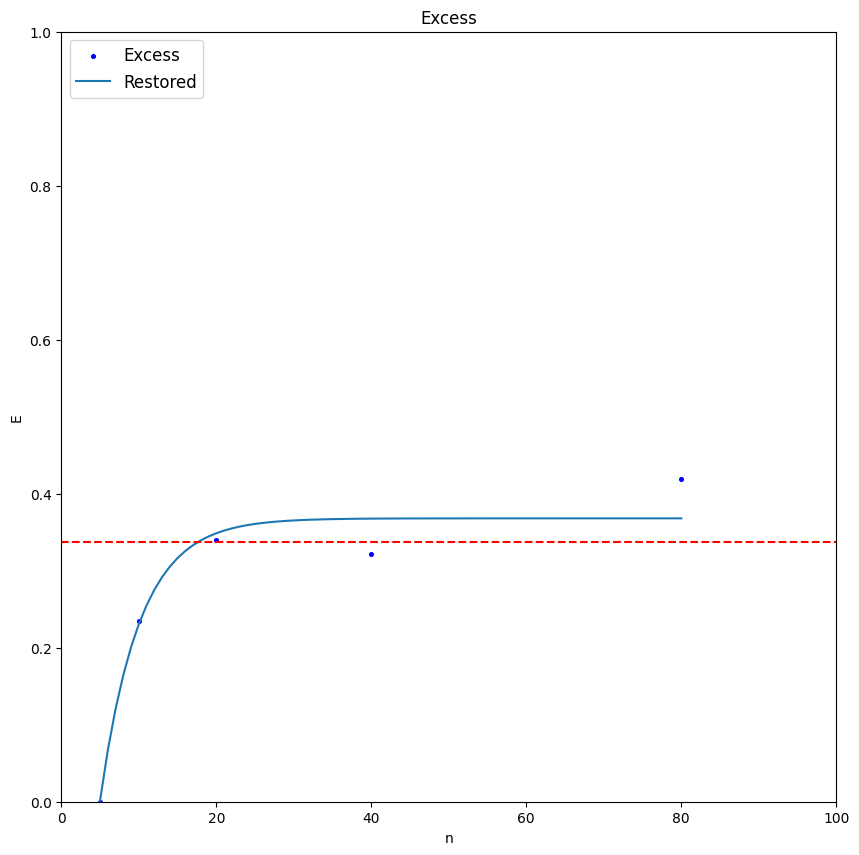

In [ ]:
b0, b1, b2 = [ 0.36802795, -0.97807738, -0.1961398 ]

xx = np.arange (1,81)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='b',label='Excess')
plt.plot(xx, b0 + b1*np.exp(b2*xx) , label = 'Restored')
plt.legend(loc= 'upper left',fontsize=12)
plt.title('Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.hlines(0.337, 0, 110, color='red',linestyle='--')
plt.xlim([0, 100])
plt.ylim([0, 1])
plt.show()

Экспонента вида y = b0 + b1*np.power(b2,x)

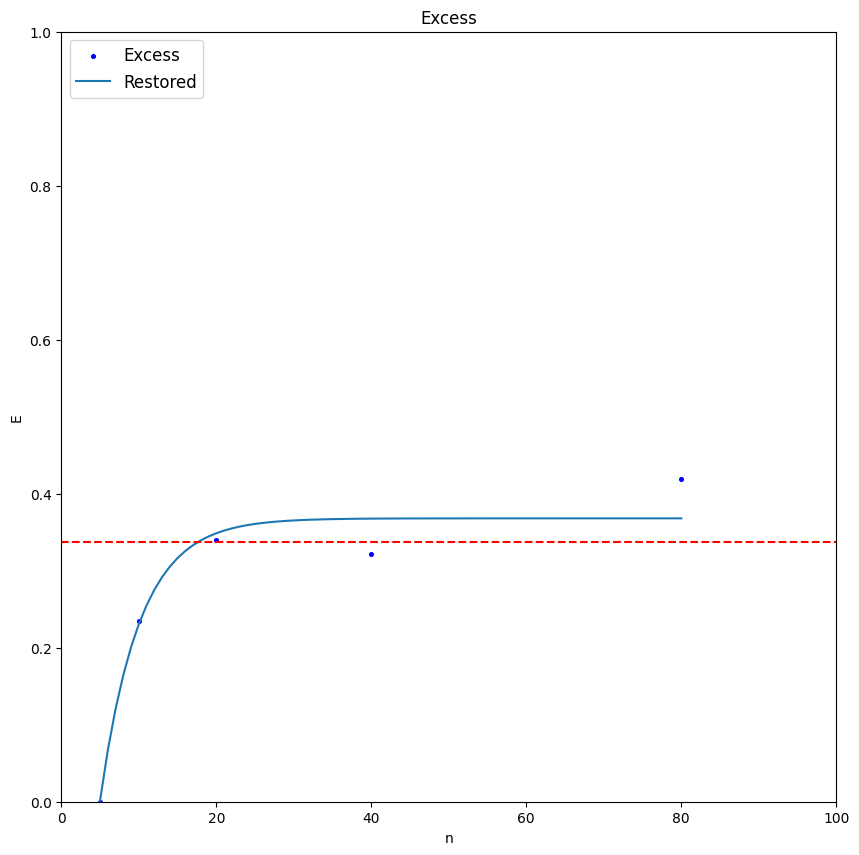

In [ ]:
b0, b1, b2 = [ 0.3680279,  -0.97807851,  0.82189713]

xx = np.arange (1,81)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='b',label='Excess')
plt.plot(xx, b0 + b1*np.power(b2,xx) , label = 'Restored')
plt.legend(loc= 'upper left',fontsize=12)
plt.title('Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.hlines(0.337, 0, 110, color='red',linestyle='--')
plt.xlim([0, 100])
plt.ylim([0, 1])
plt.show()

### Все графики (Excess)


In [ ]:
# 1-я степень
b0, b1 = [0.28448788, 0.00167786]

In [ ]:
# 2-я степень
be0, be1, be2 = [ 5.16946753e-01, -1.19961877e-02,  1.35386648e-04]

In [ ]:
# 3-я степень
beta0, beta1, beta2, beta3 = [5.84816550e-01, -1.98648437e-02,  3.29189609e-04, -1.27922747e-06]

In [ ]:
# Экспонента
bet0, bet1, bet2 = [3.15534100e-01, 2.12492259e-04, 1.07801002e+00]

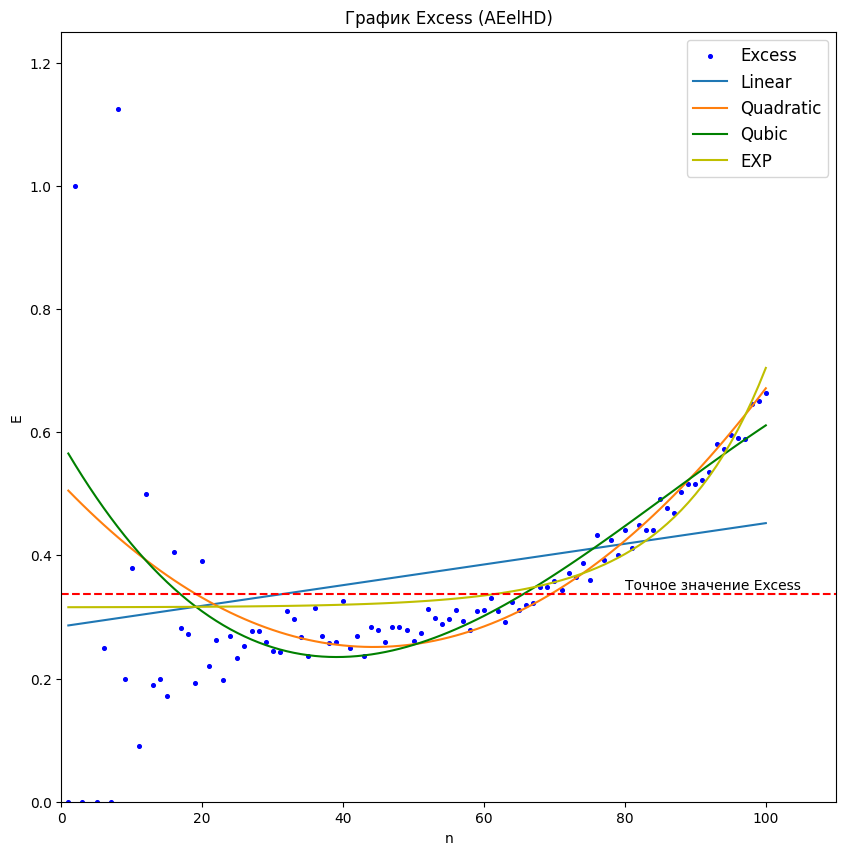

In [ ]:
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='b',label='Excess')
plt.plot(x, b0 + b1*x , label = 'Linear')
plt.plot(x, be0 + be1*x + be2*x**2 , label = 'Quadratic')
plt.plot(x, beta0 + beta1*x + beta2*x**2 + beta3*x**3 ,color='g', label = 'Qubic')
plt.plot(x, bet0 + bet1*np.power(bet2,x) , color = 'y', label = 'EXP')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Excess (AEelHD)')
plt.xlabel('n')
plt.ylabel('E')
plt.axhline(y = 0.337, color = 'r', linestyle = '--',label='exact')
plt.text(105, 0.352, 'Точное значение Excess', ha='right', va='center')
plt.xlim([0, 110])
plt.ylim([0, 1.25])
plt.show()

### График Approx

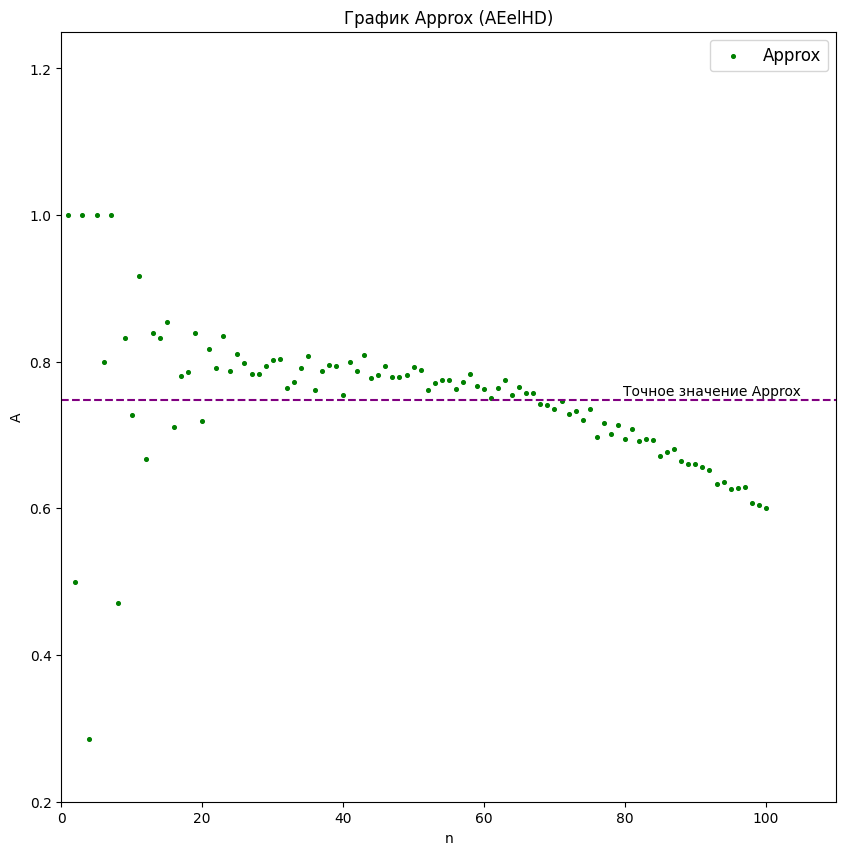

In [ ]:
Approx = [1, 0.5, 1, 0.286, 1, 0.8, 1, 0.471, 0.833, 0.727, 0.917, 0.667, 0.839, 0.833, 0.854, 0.711, 0.78, 0.786, 0.839, 0.719,
          0.817, 0.792, 0.835, 0.788, 0.811, 0.798, 0.783, 0.783, 0.794, 0.803, 0.804, 0.764, 0.772, 0.792, 0.808, 0.761, 0.788, 0.795, 0.794, 0.754,
          0.8, 0.788, 0.809, 0.778, 0.782, 0.794, 0.779, 0.779, 0.782, 0.793, 0.789, 0.761, 0.771, 0.775, 0.775, 0.763, 0.772, 0.783, 0.767, 0.763,
          0.751, 0.764, 0.775, 0.755, 0.765, 0.757, 0.757, 0.743, 0.741, 0.736, 0.746, 0.729, 0.733, 0.721, 0.736, 0.698, 0.716, 0.702, 0.714, 0.695,
          0.708, 0.692, 0.694, 0.693, 0.671, 0.677, 0.681, 0.665, 0.66, 0.66, 0.656, 0.652, 0.633, 0.636, 0.627, 0.628, 0.629, 0.608, 0.605, 0.601]

n = list(range(1, 101))

plt.figure(figsize=(10,10))
plt.scatter(n,Approx,marker='o',s=7,color='g',label='Approx')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Approx (AEelHD)')
plt.xlabel('n')
plt.ylabel('A')
plt.hlines(0.748, 0, 110, color='purple',linestyle='--')
plt.text(105, 0.76, 'Точное значение Approx', ha='right', va='center')
plt.xlim([0, 110])
plt.ylim([0.2, 1.25])
plt.show()

### Среднее Approx

In [ ]:
nn = np.arange(1,101)

av = []
for i in nn:
  av.append(np.mean(Approx[0:i]))

print(av)

[1.0, 0.75, 0.8333333333333334, 0.6965, 0.7572, 0.7643333333333334, 0.798, 0.757125, 0.7655555555555557, 0.7617, 0.7758181818181819, 0.76675, 0.7723076923076924, 0.7766428571428572, 0.7818, 0.7773749999999999, 0.7775294117647058, 0.7779999999999999, 0.7812105263157894, 0.7780999999999999, 0.7799523809523808, 0.7805, 0.7828695652173913, 0.7830833333333332, 0.7841999999999999, 0.7847307692307692, 0.7846666666666666, 0.784607142857143, 0.7849310344827587, 0.7855333333333334, 0.7861290322580645, 0.7854375, 0.785030303030303, 0.785235294117647, 0.7858857142857143, 0.7851944444444444, 0.7852702702702703, 0.7855263157894737, 0.7857435897435898, 0.78495, 0.7853170731707317, 0.7853809523809523, 0.7859302325581394, 0.7857499999999998, 0.7856666666666664, 0.7858478260869562, 0.7857021276595743, 0.7855625, 0.7854897959183674, 0.7856400000000001, 0.7857058823529413, 0.7852307692307694, 0.7849622641509436, 0.7847777777777779, 0.7846000000000001, 0.7842142857142856, 0.7839999999999999, 0.783982758620

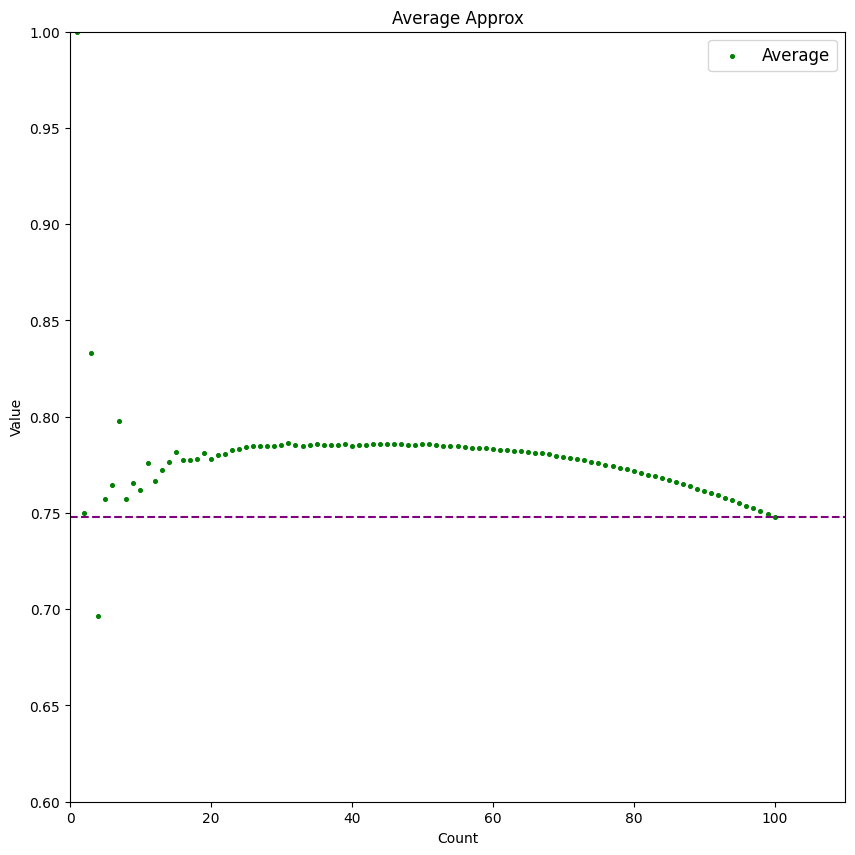

In [ ]:
plt.figure(figsize=(10,10))
plt.scatter(nn,av,marker='o',s=7,color='g',label='Average')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Average Approx')
plt.xlabel('Count')
plt.ylabel('Value')
plt.hlines(0.748, 0, 110, color='purple',linestyle='--')
plt.xlim([0, 110])
plt.ylim([0.6, 1])
plt.show()

### Аппроксимация МНК (Approx)

In [ ]:
x = np.array(n)
y = np.array(Approx)

linear_func = lambda x, b0, b1: b0 + b1*x
quadratic_func = lambda x, b0, b1, b2: b0 + b1*x + b2*x**2
qubic_func = lambda x, b0, b1, b2, b3: b0 + b1*x + b2*x**2 + b3*x**3
exp_func = lambda x, b0, b1, b2: b0 + b1*np.exp(b2*x)
exp1_func = lambda x, b0, b1, b2: b0 + b1*np.exp(x-b2)
exp2_func = lambda x, b0, b1: b0*np.power(b1,x)
exp3_func = lambda x, b0, b1, b2:  b0 + b1*np.power(b2,x)


from scipy.optimize import leastsq

# list of model
model_list = [
    'linear', 'quadratic',
    'qubic', 'EXP']

# model reference
models_dict = {
        'linear':             linear_func,
        'quadratic':          quadratic_func,
        'qubic':              qubic_func,
        'EXP':                exp3_func}

# initial values
p0_dict = {
        'linear':             [0, 0],
        'quadratic':          [0, 0, 0],
        'qubic':              [0, 0, 0, 0],
        'EXP':                [1, 1, 1]}

# titles (formulas)
formulas_dict = {
        'linear':             'y = b0 + b1*x',
        'quadratic':          'y = b0 + b1*x + b2*x^2',
        'qubic':              'y = b0 + b1*x + b2*x^2 + b3*x^3',
        'EXP':                'y = b0 +b1*b2^x'}

# actual data
X_fact = x
Y_fact = y

# function for calculating residuals
residual_func = lambda p, x, y: y - func(x, *p)

# return all optional outputs
full_output = True

# variables to save the calculation results
calculation_results_df = pd.DataFrame(columns=['func', 'p0', 'popt', 'cov_x', 'SSE', 'MSE', 'pcov', 'perr', 'Y_calc', 'error_metrics'])
error_metrics_results_df = pd.DataFrame(columns=['MSE', 'RMSE', 'MAE', 'MSPE', 'MAPE', 'RMSLE', 'R2'])

# calculations
for func_name in model_list:
    print(f'{func_name.upper()} MODEL: {formulas_dict[func_name]}')
    func = models_dict[func_name]
    calculation_results_df.loc[func_name, 'func'] = func
    p0 = p0_dict[func_name]
    print(f'p0 = {p0}')
    calculation_results_df.loc[func_name, 'p0'] = p0
    if full_output:
        (popt, cov_x, infodict, mesg, ier) = leastsq(residual_func, p0, args=(X_fact, Y_fact), full_output=full_output)
        integer_flag = f'ier = {ier}, the solution was found' if ier<=4 else f'ier = {ier}, the solution was not found'
        print(integer_flag, '\n', mesg)
        calculation_results_df.loc[func_name, 'popt'] = popt
        print(f'parameters = {popt}')
        calculation_results_df.loc[func_name, 'cov_x'] = cov_x
        print(f'cov_x = \n{cov_x}')
        #SSE = (residual_func(popt, X_fact, Y_fact)**2).sum()
        SSE = (infodict['fvec']**2).sum()
        calculation_results_df.loc[func_name, 'SSE'] = SSE
        print(f'SSE = {SSE}')
        MSE = SSE / (len(Y_fact)-len(p0))
        calculation_results_df.loc[func_name, 'MSE'] = MSE
        print(f'MSE = {MSE}')
        pcov = cov_x * MSE
        calculation_results_df.loc[func_name, 'pcov'] = pcov
        print(f'pcov =\n {pcov}')
        perr = np.sqrt(np.diag(pcov))
        calculation_results_df.loc[func_name, 'perr'] = perr
        print(f'perr = {perr}\n')
    else:
        popt = leastsq(residual_func, p0, args=(X_fact, Y_fact), full_output=full_output)
        calculation_results_df.loc[func_name, 'popt'] = popt
        print(f'parameters = {popt}\n')
    Y_calc = func(X_fact, *popt)
    calculation_results_df.loc[func_name, 'Y_calc'] = Y_calc
    (error_metrics_dict, error_metrics_df) = regression_error_metrics(Yfact=Y_fact, Ycalc=Y_calc, model_name=func_name)
    calculation_results_df.loc[func_name, 'error_metrics'] = error_metrics_dict.values()
    error_metrics_results_df = pd.concat([error_metrics_results_df, error_metrics_df])

LINEAR MODEL: y = b0 + b1*x
p0 = [0, 0]
ier = 2, the solution was found 
 The relative error between two consecutive iterates is at most 0.000000
parameters = [ 0.8262406  -0.00154714]
cov_x = 
[[ 4.06060596e-02 -6.06060591e-04]
 [-6.06060591e-04  1.20011999e-05]]
SSE = 0.7703453712751279
MSE = 0.007860667053827836
pcov =
 [[ 3.19190715e-04 -4.76404052e-06]
 [-4.76404052e-06  9.43374368e-08]]
perr = [0.01786591 0.00030714]

QUADRATIC MODEL: y = b0 + b1*x + b2*x^2
p0 = [0, 0, 0]
ier = 1, the solution was found 
 Both actual and predicted relative reductions in the sum of squares
  are at most 0.000000
parameters = [ 7.58677310e-01  2.42717083e-03 -3.93496192e-05]
cov_x = 
[[ 9.36982088e-02 -3.72912814e-03  3.09214611e-05]
 [-3.72912814e-03  1.95711055e-04 -1.81890947e-06]
 [ 3.09214611e-05 -1.81890947e-06  1.80090048e-08]]
SSE = 0.684366571294127
MSE = 0.007055325477259042
pcov =
 [[ 6.61071359e-04 -2.63102128e-05  2.18160972e-07]
 [-2.63102128e-05  1.38080519e-06 -1.28329983e-08]
 [ 2.

TypeError: unsupported operand type(s) for *: 'NoneType' and 'float'

#### 1-я степень

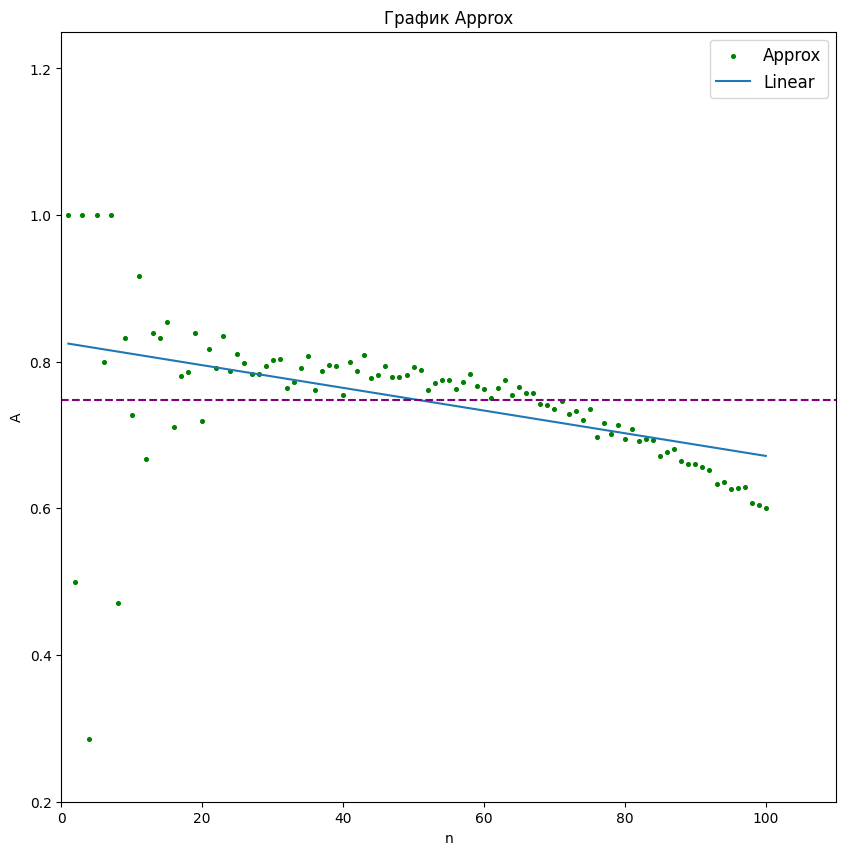

In [ ]:
b0, b1 = [ 0.8262406,  -0.00154714]

xx = np.arange (1,101)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='g',label='Approx')
plt.plot(xx, b0 + b1*xx , label = 'Linear')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Approx')
plt.xlabel('n')
plt.ylabel('A')
plt.hlines(0.748, 0, 110, color='purple',linestyle='--')
plt.xlim([0, 110])
plt.ylim([0.2, 1.25])
plt.show()

#### 2-я степень

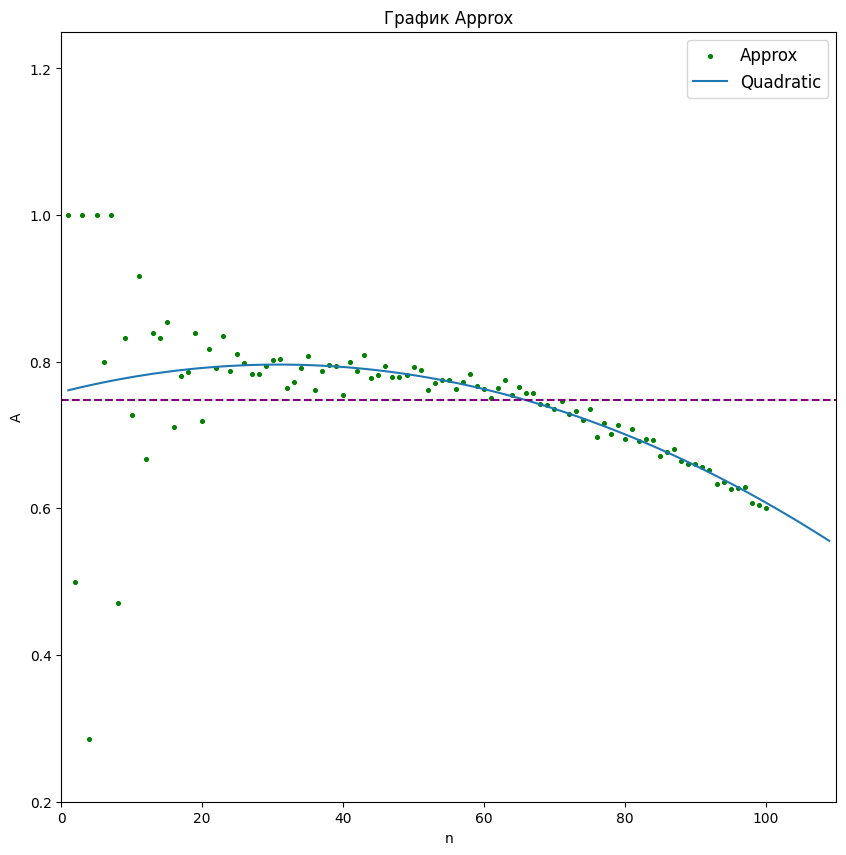

In [ ]:
b0, b1, b2 = [ 7.58677310e-01,  2.42717083e-03, -3.93496192e-05]

xx = np.arange (1,110)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='g',label='Approx')
plt.plot(xx, b0 + b1*xx + b2*xx**2 , label = 'Quadratic')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Approx')
plt.xlabel('n')
plt.ylabel('A')
plt.hlines(0.748, 0, 110, color='purple',linestyle='--')
plt.xlim([0, 110])
plt.ylim([0.2, 1.25])
plt.show()

#### 3-я степень

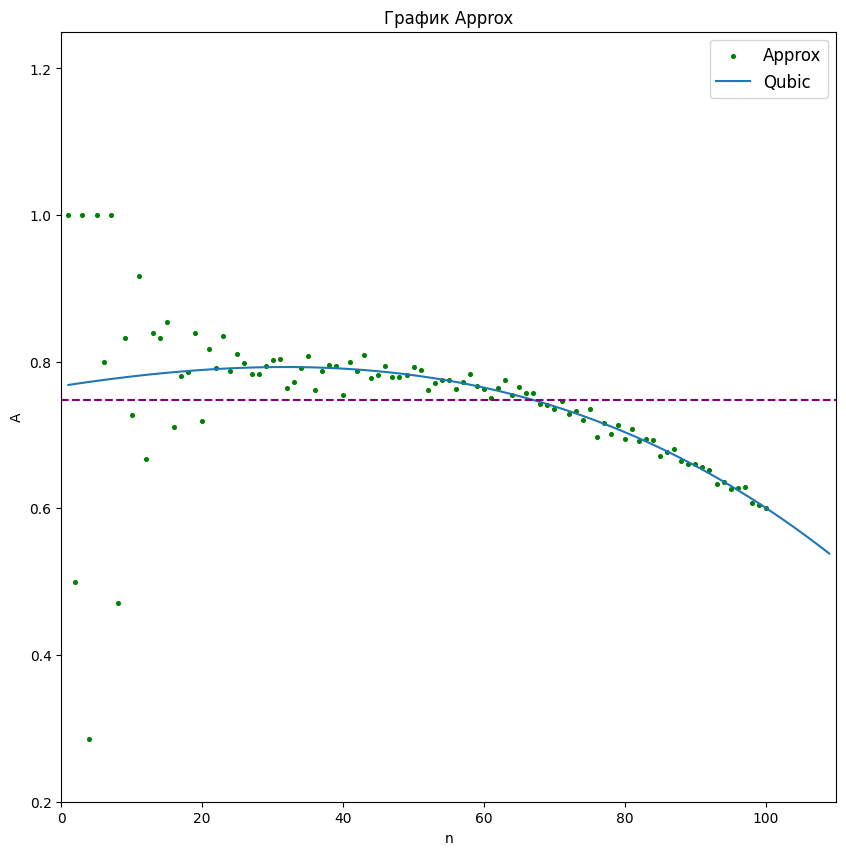

In [ ]:
b0, b1, b2, b3 =[ 7.66846052e-01,  1.48010708e-03, -1.60236845e-05, -1.53966566e-07]

xx = np.arange (1,110)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='g',label='Approx')
plt.plot(xx, b0 + b1*xx + b2*xx**2 + b3*xx**3 , label = 'Qubic')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Approx')
plt.xlabel('n')
plt.ylabel('A')
plt.hlines(0.748, 0, 110, color='purple',linestyle='--')
plt.xlim([0, 110])
plt.ylim([0.2, 1.25])
plt.show()

#### EXP

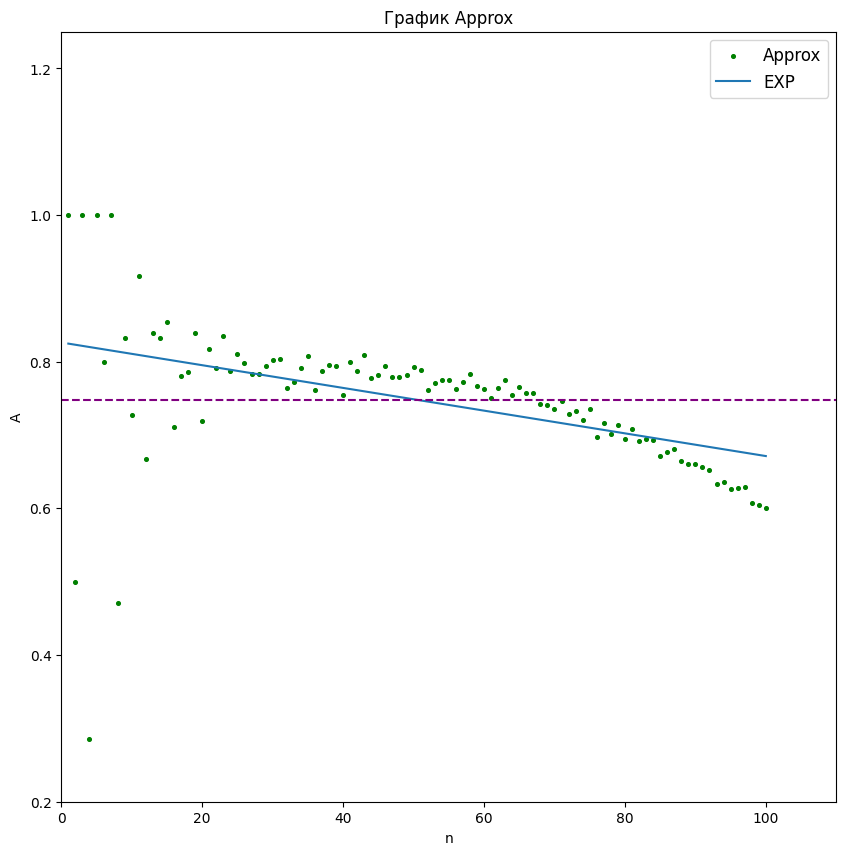

In [ ]:
b0, b1, b2 = [-706.48156458,  707.30780518,    0.99999781]

plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='g',label='Approx')
plt.plot(x, b0 + b1*np.power(b2,x) , label = 'EXP')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Approx')
plt.xlabel('n')
plt.ylabel('A')
plt.hlines(0.748, 0, 110, color='purple',linestyle='--')
plt.xlim([0, 110])
plt.ylim([0.2, 1.25])
plt.show()

### Все графики (Approx)

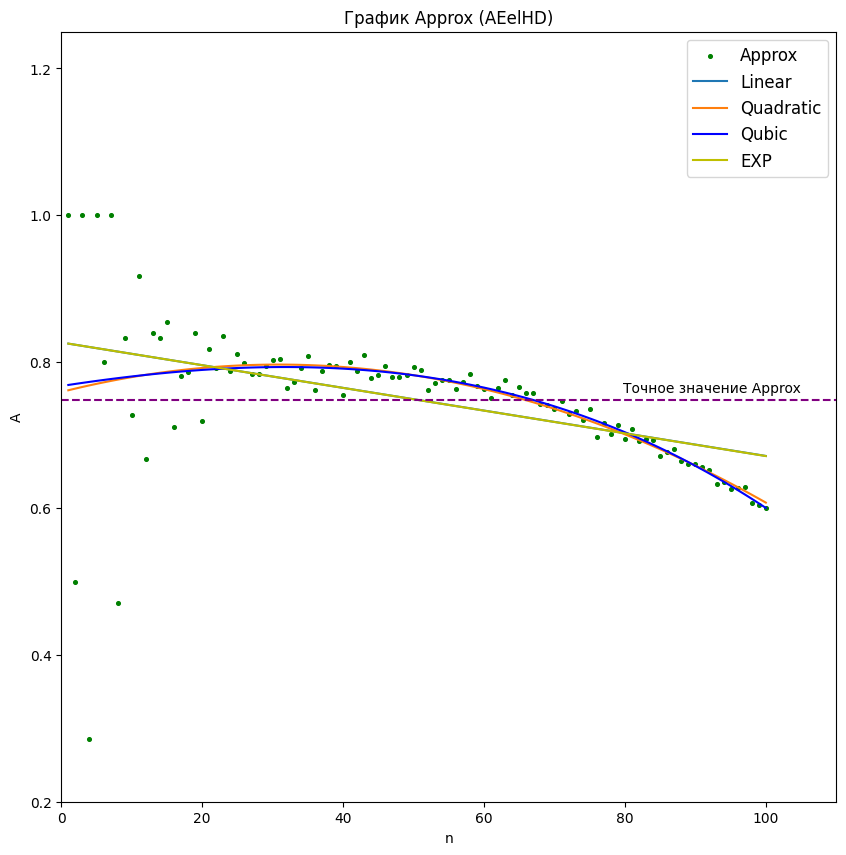

In [ ]:
# 1-я степень
b0, b1 = [ 0.8262406,  -0.00154714]

# 2-я степень
be0, be1, be2 = [ 7.58677310e-01,  2.42717083e-03, -3.93496192e-05]

# 3-я степень
beta0, beta1, beta2, beta3 = [ 7.66846052e-01,  1.48010708e-03, -1.60236845e-05, -1.53966566e-07]

# Экспонента
bet0, bet1, bet2 = [-706.48156458,  707.30780518,    0.99999781]

xx = np.arange (1,101)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='g',label='Approx')
plt.plot(xx, b0 + b1*xx , label = 'Linear')
plt.plot(xx, be0 + be1*xx + be2*xx**2 , label = 'Quadratic')
plt.plot(xx, beta0 + beta1*xx + beta2*xx**2 + beta3*xx**3 ,color='b', label = 'Qubic')
plt.plot(xx, bet0 + bet1*np.power(bet2,xx) , color = 'y', label = 'EXP')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Approx (AEelHD)')
plt.xlabel('n')
plt.ylabel('A')
plt.hlines(0.748, 0, 110, color='purple',linestyle='--')
plt.text(105, 0.763, 'Точное значение Approx', ha='right', va='center')
plt.xlim([0, 110])
plt.ylim([0.2, 1.25])
plt.show()

### Несколько точек (Approx)

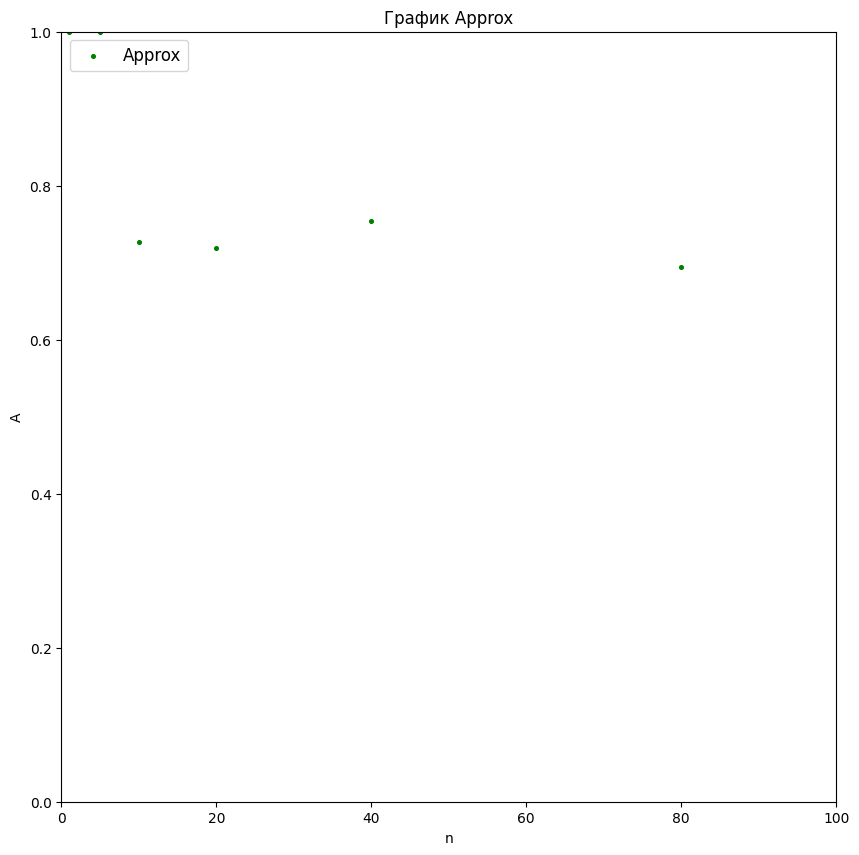

In [ ]:
Approx = [1, 1, 0.727, 0.719, 0.754, 0.695]
n = [1, 5, 10, 20, 40, 80]

plt.figure(figsize=(10,10))
plt.scatter(n,Approx,marker='o',s=7,color='g',label='Approx')
plt.legend(loc= 'upper left',fontsize=12)
plt.title('График Approx')
plt.xlabel('n')
plt.ylabel('A')
# plt.hlines(0.337, 0, 110, color='red',linestyle='--')
plt.xlim([0, 100])
plt.ylim([0, 1])
plt.show()

In [ ]:
x = np.array(n)
y = np.array(Approx)

linear_func = lambda x, b0, b1: b0 + b1*x
quadratic_func = lambda x, b0, b1, b2: b0 + b1*x + b2*x**2
qubic_func = lambda x, b0, b1, b2, b3: b0 + b1*x + b2*x**2 + b3*x**3
exp_func = lambda x, b0, b1, b2: b0 + b1*np.exp(b2*x)
exp1_func = lambda x, b0, b1, b2: b0 + b1*np.exp(x-b2)
exp2_func = lambda x, b0, b1: b0*np.power(b1,x)
exp3_func = lambda x, b0, b1, b2:  b0 + b1*np.power(b2,x)


from scipy.optimize import leastsq

# list of model
model_list = [
    'linear', 'quadratic',
    'qubic']

# model reference
models_dict = {
        'linear':             linear_func,
        'quadratic':          quadratic_func,
        'qubic':              qubic_func}

# initial values
p0_dict = {
        'linear':             [0, 0],
        'quadratic':          [0, 0, 0],
        'qubic':              [0, 0, 0, 0]}

# titles (formulas)
formulas_dict = {
        'linear':             'y = b0 + b1*x',
        'quadratic':          'y = b0 + b1*x + b2*x^2',
        'qubic':              'y = b0 + b1*x + b2*x^2 + b3*x^3'}

# actual data
X_fact = x
Y_fact = y

# function for calculating residuals
residual_func = lambda p, x, y: y - func(x, *p)

# return all optional outputs
full_output = True

# variables to save the calculation results
calculation_results_df = pd.DataFrame(columns=['func', 'p0', 'popt', 'cov_x', 'SSE', 'MSE', 'pcov', 'perr', 'Y_calc', 'error_metrics'])
error_metrics_results_df = pd.DataFrame(columns=['MSE', 'RMSE', 'MAE', 'MSPE', 'MAPE', 'RMSLE', 'R2'])

# calculations
for func_name in model_list:
    print(f'{func_name.upper()} MODEL: {formulas_dict[func_name]}')
    func = models_dict[func_name]
    calculation_results_df.loc[func_name, 'func'] = func
    p0 = p0_dict[func_name]
    print(f'p0 = {p0}')
    calculation_results_df.loc[func_name, 'p0'] = p0
    if full_output:
        (popt, cov_x, infodict, mesg, ier) = leastsq(residual_func, p0, args=(X_fact, Y_fact), full_output=full_output)
        integer_flag = f'ier = {ier}, the solution was found' if ier<=4 else f'ier = {ier}, the solution was not found'
        print(integer_flag, '\n', mesg)
        calculation_results_df.loc[func_name, 'popt'] = popt
        print(f'parameters = {popt}')
        calculation_results_df.loc[func_name, 'cov_x'] = cov_x
        print(f'cov_x = \n{cov_x}')
        #SSE = (residual_func(popt, X_fact, Y_fact)**2).sum()
        SSE = (infodict['fvec']**2).sum()
        calculation_results_df.loc[func_name, 'SSE'] = SSE
        print(f'SSE = {SSE}')
        MSE = SSE / (len(Y_fact)-len(p0))
        calculation_results_df.loc[func_name, 'MSE'] = MSE
        print(f'MSE = {MSE}')
        pcov = cov_x * MSE
        calculation_results_df.loc[func_name, 'pcov'] = pcov
        print(f'pcov =\n {pcov}')
        perr = np.sqrt(np.diag(pcov))
        calculation_results_df.loc[func_name, 'perr'] = perr
        print(f'perr = {perr}\n')
    else:
        popt = leastsq(residual_func, p0, args=(X_fact, Y_fact), full_output=full_output)
        calculation_results_df.loc[func_name, 'popt'] = popt
        print(f'parameters = {popt}\n')
    Y_calc = func(X_fact, *popt)
    calculation_results_df.loc[func_name, 'Y_calc'] = Y_calc
    (error_metrics_dict, error_metrics_df) = regression_error_metrics(Yfact=Y_fact, Ycalc=Y_calc, model_name=func_name)
    calculation_results_df.loc[func_name, 'error_metrics'] = error_metrics_dict.values()
    error_metrics_results_df = pd.concat([error_metrics_results_df, error_metrics_df])

LINEAR MODEL: y = b0 + b1*x
p0 = [0, 0]
ier = 3, the solution was found 
 Both actual and predicted relative reductions in the sum of squares
  are at most 0.000000 and the relative error between two consecutive iterates is at 
  most 0.000000
parameters = [ 0.89645078 -0.00310067]
cov_x = 
[[ 3.17897092e-01 -5.81655479e-03]
 [-5.81655479e-03  2.23713647e-04]]
SSE = 0.06055153131991053
MSE = 0.015137882829977632
pcov =
 [[ 4.81228893e-03 -8.80503249e-05]
 [-8.80503249e-05  3.38655097e-06]]
perr = [0.06937066 0.00184026]

QUADRATIC MODEL: y = b0 + b1*x + b2*x^2
p0 = [0, 0, 0]
ier = 3, the solution was found 
 Both actual and predicted relative reductions in the sum of squares
  are at most 0.000000 and the relative error between two consecutive iterates is at 
  most 0.000000
parameters = [ 9.69004175e-01 -1.16129299e-02  1.04690594e-04]
cov_x = 
[[ 5.55248486e-01 -3.36635843e-02  3.42485132e-04]
 [-3.36635843e-02  3.49084022e-03 -4.01817464e-05]
 [ 3.42485132e-04 -4.01817464e-05  4.941

3 степень

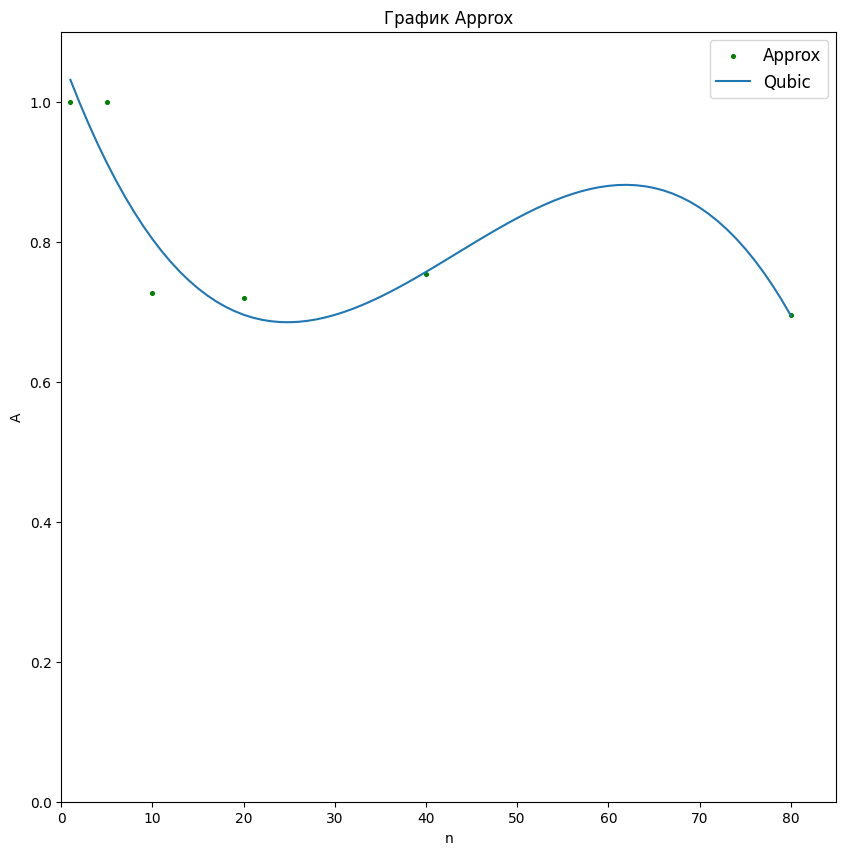

In [ ]:
b0, b1, b2, b3 =[ 1.06573538e+00, -3.54435506e-02,  1.00100984e-03, -7.69890304e-06]

xx = np.arange (1,81)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='g',label='Approx')
plt.plot(xx, b0 + b1*xx + b2*xx**2 + b3*xx**3 , label = 'Qubic')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Approx')
plt.xlabel('n')
plt.ylabel('A')
# plt.hlines(0.748, 0, 110, color='purple',linestyle='--')
plt.xlim([0, 85])
plt.ylim([0, 1.1])
plt.show()

In [ ]:
from sympy import *

x = Symbol('x', real=True)
f = b0 + b1*x + b2*x**2 + b3*x**3
fprime = f.diff(x)

solve(fprime, x)

[24.7986718640012, 61.8811953672315]

2 степень

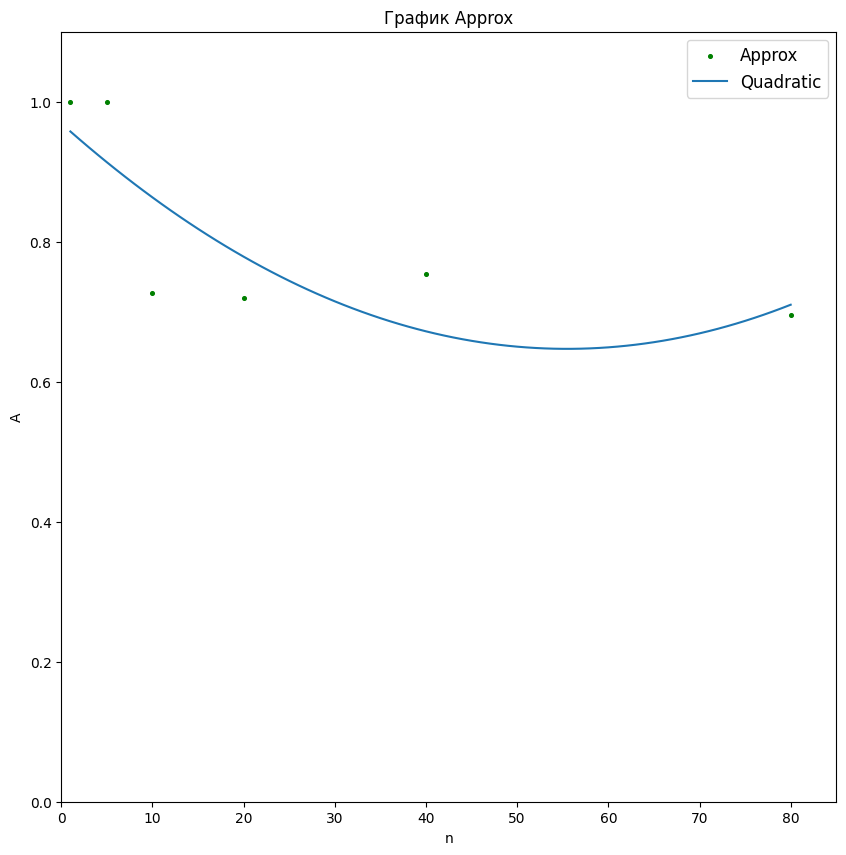

In [ ]:
b0, b1, b2 = [ 9.69004175e-01, -1.16129299e-02,  1.04690594e-04]

xx = np.arange (1,81)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='g',label='Approx')
plt.plot(xx, b0 + b1*xx + b2*xx**2 , label = 'Quadratic')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Approx')
plt.xlabel('n')
plt.ylabel('A')
#plt.hlines(0.748, 0, 110, color='purple',linestyle='--')
plt.xlim([0, 85])
plt.ylim([0, 1.1])
plt.show()

In [ ]:
from sympy import *

x = Symbol('x', real=True)
f = b0 + b1*x + b2*x**2
fprime = f.diff(x)

solve(fprime, x)

[55.4631006296516]

### Сведенные графики Excess и Approx

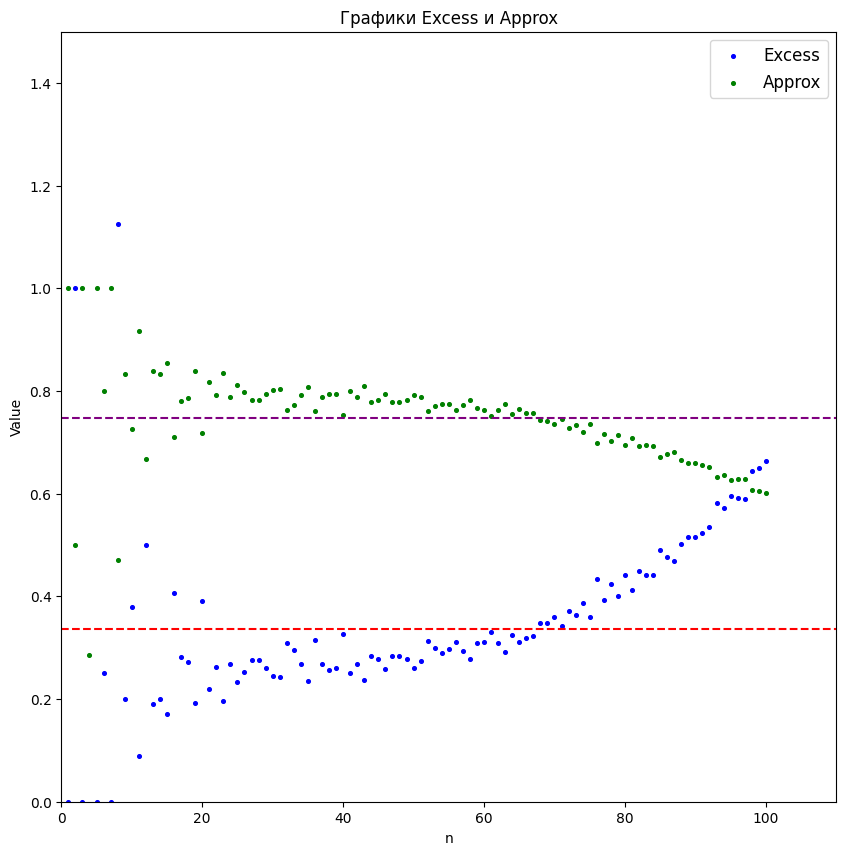

In [ ]:
Approx = [1, 0.5, 1, 0.286, 1, 0.8, 1, 0.471, 0.833, 0.727, 0.917, 0.667, 0.839, 0.833, 0.854, 0.711, 0.78, 0.786, 0.839, 0.719,
          0.817, 0.792, 0.835, 0.788, 0.811, 0.798, 0.783, 0.783, 0.794, 0.803, 0.804, 0.764, 0.772, 0.792, 0.808, 0.761, 0.788, 0.795, 0.794, 0.754,
          0.8, 0.788, 0.809, 0.778, 0.782, 0.794, 0.779, 0.779, 0.782, 0.793, 0.789, 0.761, 0.771, 0.775, 0.775, 0.763, 0.772, 0.783, 0.767, 0.763,
          0.751, 0.764, 0.775, 0.755, 0.765, 0.757, 0.757, 0.743, 0.741, 0.736, 0.746, 0.729, 0.733, 0.721, 0.736, 0.698, 0.716, 0.702, 0.714, 0.695,
          0.708, 0.692, 0.694, 0.693, 0.671, 0.677, 0.681, 0.665, 0.66, 0.66, 0.656, 0.652, 0.633, 0.636, 0.627, 0.628, 0.629, 0.608, 0.605, 0.601]

Excess = [0, 1, 0, 2.5, 0, 0.25, 0, 1.125, 0.2, 0.38, 0.09, 0.5, 0.19, 0.2, 0.171, 0.406, 0.282, 0.273, 0.192,
          0.391, 0.22, 0.263, 0.197, 0.269, 0.234, 0.253, 0.277, 0.277, 0.26, 0.245, 0.243, 0.309, 0.296, 0.268,
          0.236, 0.315, 0.269, 0.257, 0.26, 0.326, 0.25, 0.269, 0.237, 0.284, 0.279, 0.259, 0.283, 0.283, 0.278,
          0.261, 0.274, 0.313, 0.299, 0.289, 0.297, 0.311, 0.294, 0.278, 0.309, 0.311, 0.331, 0.309, 0.292, 0.324,
          0.312, 0.319, 0.322, 0.349, 0.348, 0.359, 0.343, 0.372, 0.364, 0.387, 0.36, 0.433, 0.392, 0.425, 0.401,
          0.441, 0.412, 0.449, 0.441, 0.441, 0.491, 0.477, 0.468, 0.503, 0.515, 0.515, 0.523, 0.535, 0.581, 0.572,
          0.595, 0.591, 0.589, 0.645, 0.65, 0.664]

n = list(range(1, 101))


plt.figure(figsize=(10,10))
plt.scatter(n,Excess,marker='o',s=7,color='b',label='Excess')
plt.scatter(n,Approx,marker='o',s=7,color='g',label='Approx')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Графики Excess и Approx')
plt.hlines(0.337, 0, 110, color='r',linestyle='--')
plt.hlines(0.748, 0, 110, color='purple',linestyle='--')
plt.xlabel('n')
plt.ylabel('Value')
plt.xlim([0, 110])
plt.ylim([0, 1.5])
plt.show()

# Работа с кольцом

## Широкое горло (через собственную функцию)

In [ ]:
import numpy as np

# Функция для генерация координат точки
def generate_point():
  x = np.random.uniform(-1, 1)
  y = np.random.uniform(-1, 1)
  return np.array([x, y])

# Функция для проверки, попадает ли точка внутрь круга
def is_inside_circle(point, center, radius):
  # Вычисляем расстояние между точкой и центром круга
  distance = np.linalg.norm(point - center)
  return distance <= radius

# Параметры
n_points = 1000  # Количество точек
outer_radius = 1.0  # Радиус внешнего круга
inner_radius = 0.7  # Радиус внутреннего круга

# Центры кругов
outer_center = np.array([0, 0])
inner_center = np.array([0, 0])

# Генерация массива точек
points = np.empty((n_points, 2))
for i in range(n_points):
  # Генерируем точку
  point = generate_point()

  # Проверяем, попадает ли она внутрь обоих кругов
  while is_inside_circle(point, inner_center, inner_radius) or not is_inside_circle(point, outer_center, outer_radius):
    point = generate_point()

  # Добавляем точку в массив
  points[i] = point

# Печать массива точек
print(points)

[[-0.44031414 -0.88520501]
 [ 0.13570952  0.93490421]
 [-0.08788082  0.90318579]
 ...
 [-0.93026097  0.31802328]
 [-0.78150976 -0.14949843]
 [-0.70564865  0.57223358]]


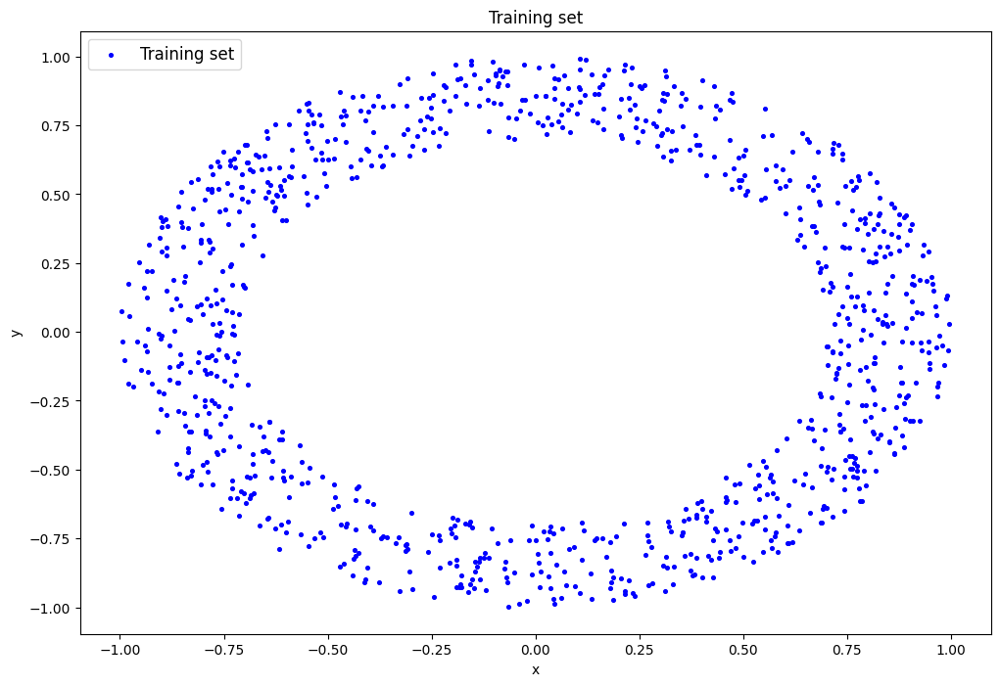

In [ ]:
data8 = points

plt.figure(figsize=(12,8))
plt.scatter(points[:,0],points[:,1],marker='o',s=7,color='b',label='Training set')
plt.legend(loc= 'upper left',fontsize=12)
plt.title('Training set')
plt.xlabel('x')
plt.ylabel('y')
plt.show()

In [ ]:
#### Обучение Автокодировщика
size = data8.shape[1]
patience = 700
verbose_show = True

ae8 = tensorflow.keras.models.Sequential()

# input layer
ae8.add(tensorflow.keras.layers.Dense(size))
ae8.add(tensorflow.keras.layers.Activation('tanh'))

# hidden layers
ae8.add(tensorflow.keras.layers.Dense(5))
ae8.add(tensorflow.keras.layers.Activation('tanh'))
ae8.add(tensorflow.keras.layers.Dense(3))
ae8.add(tensorflow.keras.layers.Activation('tanh'))
ae8.add(tensorflow.keras.layers.Dense(2))
ae8.add(tensorflow.keras.layers.Activation('tanh'))
ae8.add(tensorflow.keras.layers.Dense(1))
ae8.add(tensorflow.keras.layers.Activation('tanh'))
ae8.add(tensorflow.keras.layers.Dense(2))
ae8.add(tensorflow.keras.layers.Activation('tanh'))
ae8.add(tensorflow.keras.layers.Dense(3))
ae8.add(tensorflow.keras.layers.Activation('tanh'))
ae8.add(tensorflow.keras.layers.Dense(5))
ae8.add(tensorflow.keras.layers.Activation('tanh'))

# output layer
ae8.add(tensorflow.keras.layers.Dense(size))
ae8.add(tensorflow.keras.layers.Activation('linear'))

optimizer = tensorflow.keras.optimizers.Adam(learning_rate=0.001, beta_1=0.9, beta_2=0.999, amsgrad=False)
ae8.compile(loss='mean_squared_error', optimizer=optimizer)

error_stop = 0.0001
epo = 10000

early_stopping_callback_on_error = EarlyStoppingOnValue(monitor='loss', baseline=error_stop)
early_stopping_callback_on_improving = tensorflow.keras.callbacks.EarlyStopping(monitor='loss',
                                                                                           min_delta=0.0001, patience = patience,
                                                                                           verbose=1, mode='auto',
                                                                                           baseline=None,
                                                                                           restore_best_weights=False)

history_callback = tensorflow.keras.callbacks.History()
verbose = 1 if verbose_show else 0
history_object = ae8.fit(data8, data8,
                                batch_size=data8.shape[0],
                                epochs=epo,
                                callbacks=[early_stopping_callback_on_error, history_callback,
                                early_stopping_callback_on_improving],
                                verbose=verbose)
ae8_trainned = ae8
ae8_pred = ae8_trainned.predict(data8)
ae8_trainned.save('out/AE8.h5')


Выходные данные были обрезаны до нескольких последних строк (5000).
1/1 [==============================] - 0s 11ms/step - loss: 0.0045
Epoch 4496/10000
1/1 [==============================] - 0s 14ms/step - loss: 0.0045
Epoch 4497/10000
1/1 [==============================] - 0s 19ms/step - loss: 0.0045
Epoch 4498/10000
1/1 [==============================] - 0s 13ms/step - loss: 0.0045
Epoch 4499/10000
1/1 [==============================] - 0s 15ms/step - loss: 0.0045
Epoch 4500/10000
1/1 [==============================] - 0s 13ms/step - loss: 0.0045
Epoch 4501/10000
1/1 [==============================] - 0s 12ms/step - loss: 0.0045
Epoch 4502/10000
1/1 [==============================] - 0s 13ms/step - loss: 0.0045
Epoch 4503/10000
1/1 [==============================] - 0s 14ms/step - loss: 0.0045
Epoch 4504/10000
1/1 [==============================] - 0s 11ms/step - loss: 0.0045
Epoch 4505/10000
1/1 [==============================] - 0s 12ms/step - loss: 0.0045
Epoch 4506/10000
1/1 [===

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [ ]:
ae8.save('best_model_for_data8')

In [ ]:
from keras.models import load_model
ae8 = load_model('best_model_for_data8')

ae8_trainned = ae8
ae8_pred = ae8_trainned.predict(data8)
ae8_trainned.save('out/AE8.h5')

32/32 [==============================] - 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


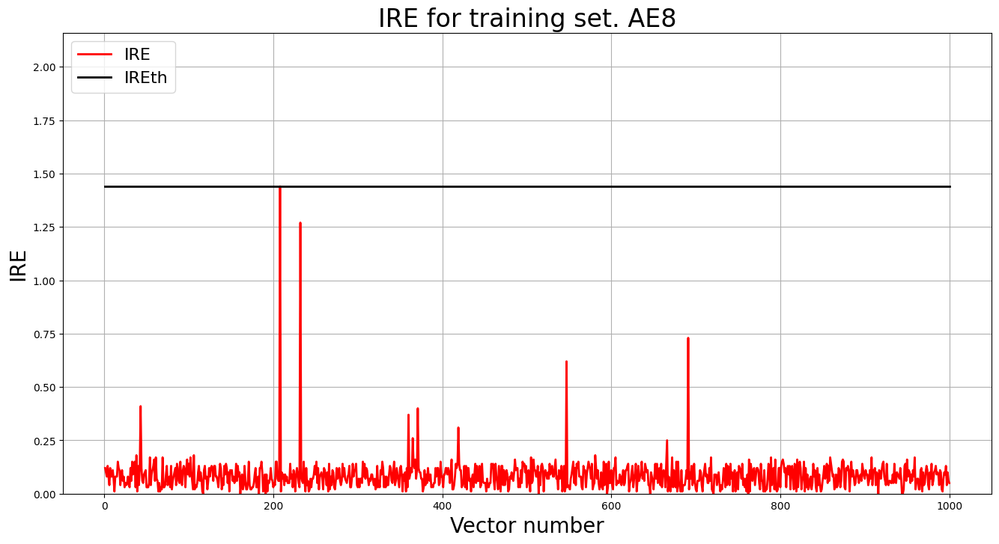

In [ ]:
irefile = 'out/AE8_ire_th.txt'
IRE_array = np.round(ire_array(data8, ae8_pred), 2)
IREth = np.amax(IRE_array)
with open(irefile, 'w') as file:
    file.write(str(IREth))

IRE_8 = IRE_array
IREth_8 = IREth
lib.ire_plot('training', IRE_8, IREth, 'AE8')

250/250 [==============================] - 1s 2ms/step


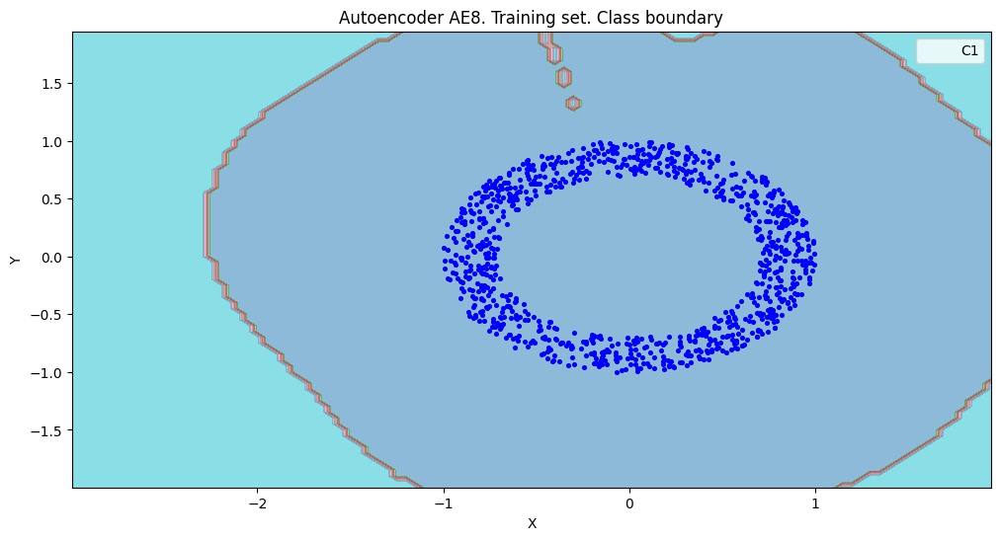

KeyboardInterrupt: 

In [ ]:
# построение областей покрытия и границ классов
# расчет характеристик качества обучения
# параметр numb_square, отвечающий за количество элементов разбиения по каждой оси пространства признаков
numb_square = 100

xx, yy, Z3 = lib.square_calc(numb_square, data8, ae8_trainned, IREth_8, '8', True)

### Плотное покрытие

In [ ]:
import numpy as np

# Функция для проверки, попадает ли точка внутрь круга
def is_inside_circle(point, center, radius):
  # Вычисляем расстояние между точкой и центром круга
  distance = np.linalg.norm(point - center)
  return distance <= radius

# Параметры
n_points = 100  # Количество точек
outer_radius = 1.0  # Радиус внешнего круга
inner_radius = 0.7  # Радиус внутреннего круга

def generate_grid_points(n_points):
    x = np.linspace(-1, 1, n_points)
    y = np.linspace(-1, 1, n_points)

    points = [np.array([i, j]) for i in x for j in y]

    return points

# Центры кругов
outer_center = np.array([0, 0])
inner_center = np.array([0, 0])


grid_points = generate_grid_points(n_points)
points = []

for point in grid_points:
  if not is_inside_circle(point, inner_center, inner_radius) and  is_inside_circle(point, outer_center, outer_radius):
    points.append(point)

points = np.array(points)

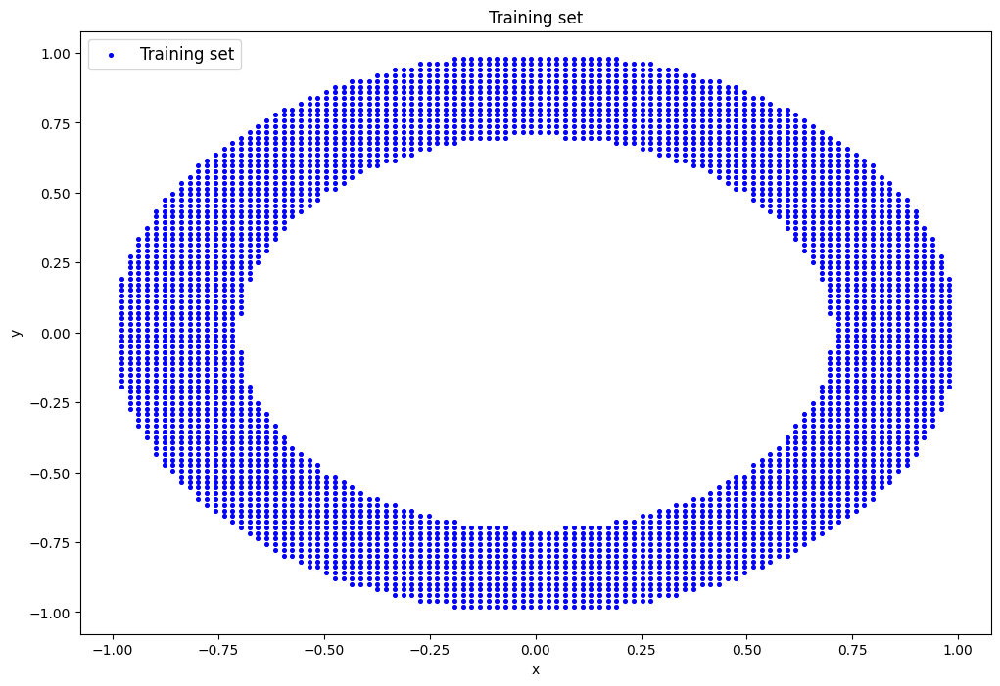

In [ ]:
data8 = points


plt.figure(figsize=(12,8))
plt.scatter(points[:,0],points[:,1],marker='o',s=7,color='b',label='Training set')
plt.legend(loc= 'upper left',fontsize=12)
plt.title('Training set')
plt.xlabel('x')
plt.ylabel('y')
plt.show()

6263/6263 [==============================] - 18s 3ms/step


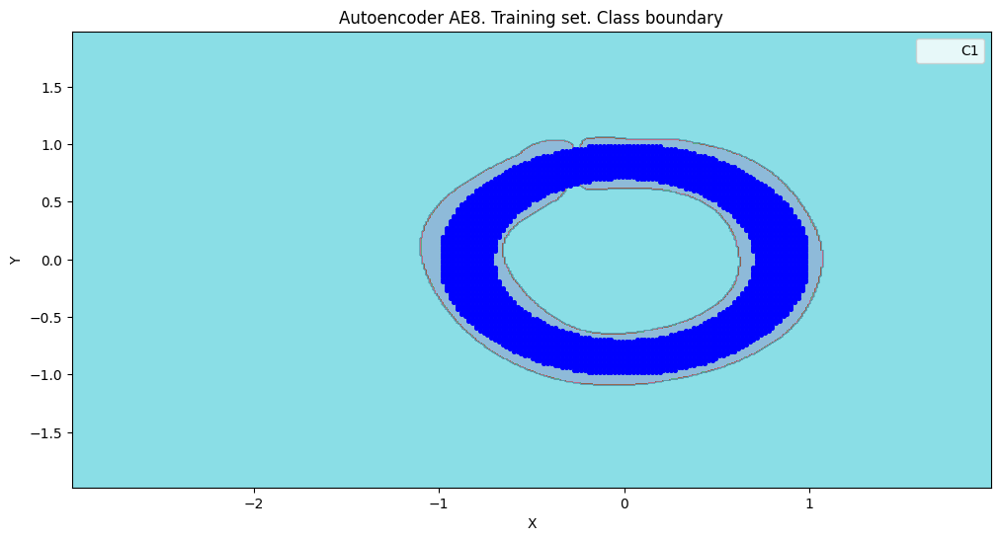

amount:  3212
amount_ae:  5024


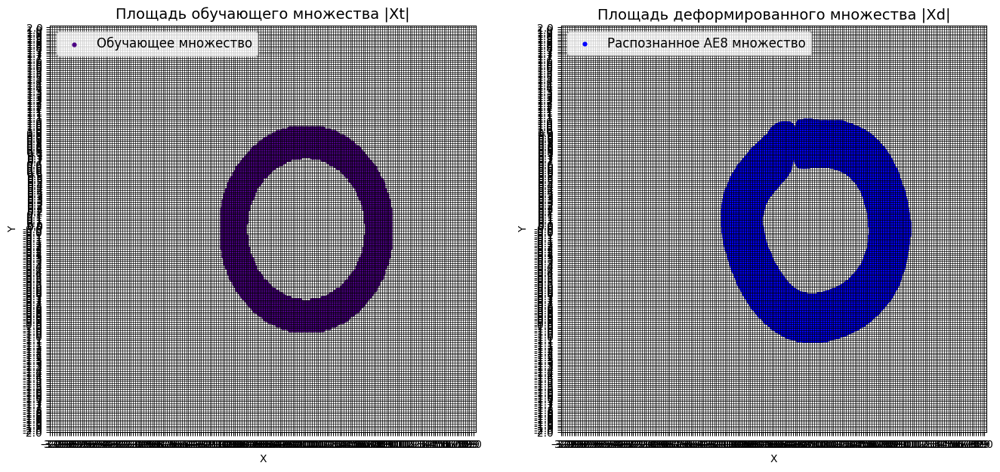

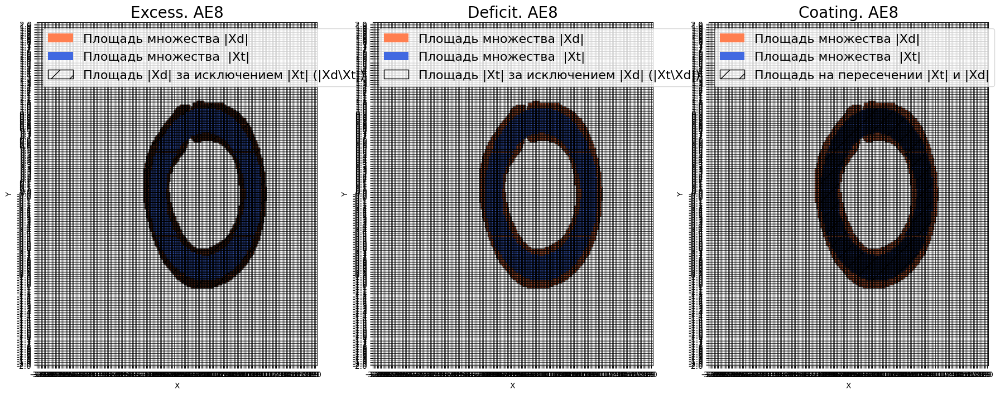


Оценка качества AE8
IDEAL = 0. Excess:  0.5694271481942715
IDEAL = 0. Deficit:  0.005292652552926526
IDEAL = 1. Coating:  0.9947073474470735
summa:  1.0
IDEAL = 1. Extrapolation precision (Approx):  0.6393312101910829




In [ ]:
# построение областей покрытия и границ классов
# расчет характеристик качества обучения
# параметр numb_square, отвечающий за количество элементов разбиения по каждой оси пространства признаков
numb_square = 200

xx, yy, Z3 = lib.square_calc1(numb_square, data8, ae8_trainned, IREth_8, '8', True)

### График

In [ ]:
E = [0, 0, 0, 0.33, 0.5, 0, 0.06, 0.43, 0.1, 0.3, 0, 0.25, 0.19, 0.11, 0.34, 0.25, 0.26, 0.22, 0.25,
     0.33, 0.26, 0.19, 0.29, 0.39, 0.38, 0.36, 0.32, 0.32, 0.3, 0.37, 0.32, 0.35, 0.42, 0.39, 0.31,
     0.4, 0.33, 0.37, 0.35, 0.43, 0.4, 0.39, 0.39, 0.33, 0.46, 0.4, 0.37, 0.41, 0.43, 0.42, 0.46, 0.47,
     0.35, 0.42, 0.45, 0.46, 0.45, 0.46, 0.45, 0.49, 0.49, 0.48, 0.59, 0.51, 0.51, 0.54, 0.56, 0.59, 0.54,
     0.57, 0.59, 0.59, 0.62, 0.58, 0.65, 0.66, 0.64, 0.65, 0.68, 0.76, 0.68, 0.67, 0.76, 0.71, 0.71, 0.72,
     0.74, 0.73, 0.72, 0.78, 0.78, 0.74, 0.78, 0.81, 0.81, 0.8, 0.82, 0.8, 0.87, 0.83]

In [ ]:
E = np.array(E)
E.shape[0]

100

In [ ]:
n = list(range(1, 101))

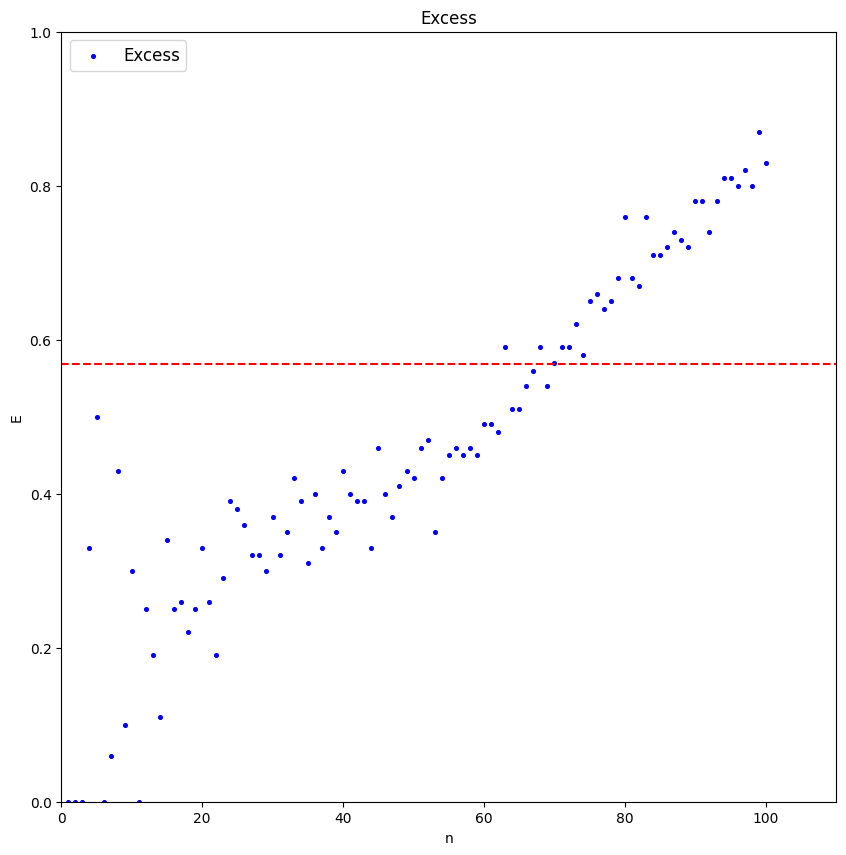

In [ ]:
plt.figure(figsize=(10,10))
plt.scatter(n,E,marker='o',s=7,color='b',label='Excess')
plt.legend(loc= 'upper left',fontsize=12)
plt.title('Excess')
plt.hlines(0.569, 0, 110, color='red',linestyle='--')
plt.xlabel('n')
plt.ylabel('E')
plt.xlim([0, 110])
plt.ylim([0, 1])
plt.show()

## Узкое горло (через собственную функцию)

In [ ]:
import numpy as np

# Функция для генерации координат точки
def generate_point():
  x = np.random.uniform(-1, 1)
  y = np.random.uniform(-1, 1)
  return np.array([x, y])

# Функция для проверки, попадает ли точка внутрь круга
def is_inside_circle(point, center, radius):
  # Вычисляем расстояние между точкой и центром круга
  distance = np.linalg.norm(point - center)
  return distance <= radius

# Параметры
n_points = 1500  # Количество точек
outer_radius = 1.0  # Радиус внешнего круга
inner_radius = 0.3  # Радиус внутреннего круга

# Центры кругов
outer_center = np.array([0, 0])
inner_center = np.array([0, 0])

# Генерация массива точек
points = np.empty((n_points, 2))
for i in range(n_points):
  # Генерируем точку
  point = generate_point()

  # Проверяем, попадает ли она внутрь обоих кругов
  while is_inside_circle(point, inner_center, inner_radius) or not is_inside_circle(point, outer_center, outer_radius):
    point = generate_point()

  # Добавляем точку в массив
  points[i] = point

# Печать массива точек
print(points)

[[ 0.89637605 -0.10913096]
 [-0.78489829  0.41961023]
 [ 0.43674478 -0.33990109]
 ...
 [ 0.33345951  0.63964064]
 [-0.2816098   0.62597259]
 [-0.67401936  0.0783638 ]]


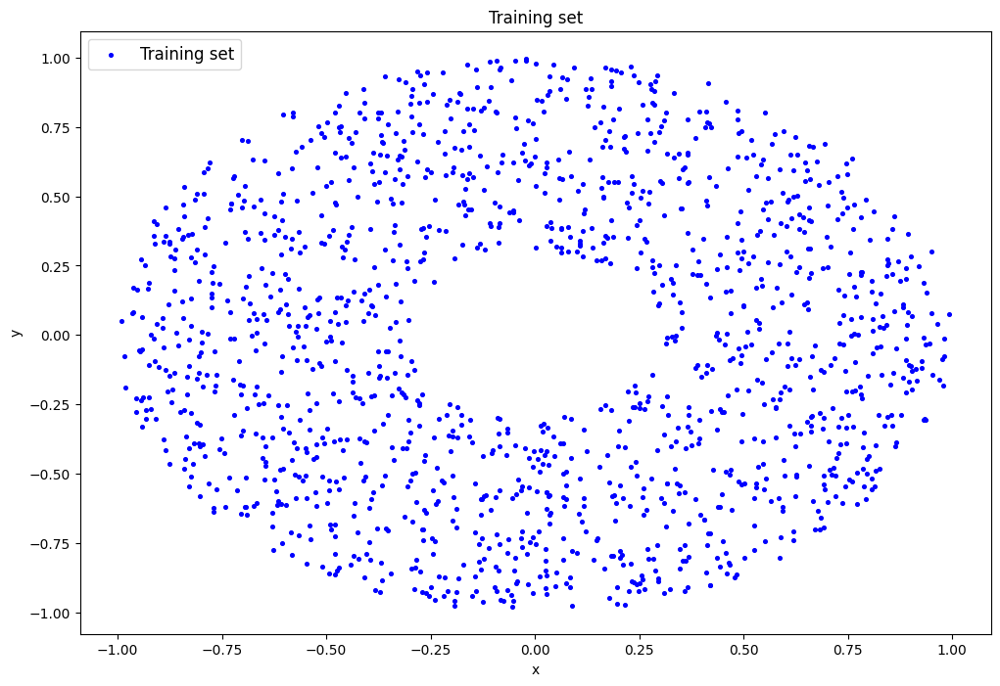

In [ ]:
data9 = points

plt.figure(figsize=(12,8))
plt.scatter(points[:,0],points[:,1],marker='o',s=7,color='b',label='Training set')
plt.legend(loc= 'upper left',fontsize=12)
plt.title('Training set')
plt.xlabel('x')
plt.ylabel('y')
plt.show()

In [ ]:
#### Обучение Автокодировщика
size = data9.shape[1]
patience = 700
verbose_show = True

ae9 = tensorflow.keras.models.Sequential()

# input layer
ae9.add(tensorflow.keras.layers.Dense(size))
ae9.add(tensorflow.keras.layers.Activation('tanh'))

# hidden layers
ae9.add(tensorflow.keras.layers.Dense(5))
ae9.add(tensorflow.keras.layers.Activation('tanh'))
ae9.add(tensorflow.keras.layers.Dense(3))
ae9.add(tensorflow.keras.layers.Activation('tanh'))
ae9.add(tensorflow.keras.layers.Dense(2))
ae9.add(tensorflow.keras.layers.Activation('tanh'))
ae9.add(tensorflow.keras.layers.Dense(1))
ae9.add(tensorflow.keras.layers.Activation('tanh'))
ae9.add(tensorflow.keras.layers.Dense(2))
ae9.add(tensorflow.keras.layers.Activation('tanh'))
ae9.add(tensorflow.keras.layers.Dense(3))
ae9.add(tensorflow.keras.layers.Activation('tanh'))
ae9.add(tensorflow.keras.layers.Dense(5))
ae9.add(tensorflow.keras.layers.Activation('tanh'))

# output layer
ae9.add(tensorflow.keras.layers.Dense(size))
ae9.add(tensorflow.keras.layers.Activation('linear'))

optimizer = tensorflow.keras.optimizers.Adam(learning_rate=0.001, beta_1=0.9, beta_2=0.999, amsgrad=False)
ae9.compile(loss='mean_squared_error', optimizer=optimizer)

error_stop = 0.0001
epo = 10000

early_stopping_callback_on_error = EarlyStoppingOnValue(monitor='loss', baseline=error_stop)
early_stopping_callback_on_improving = tensorflow.keras.callbacks.EarlyStopping(monitor='loss',
                                                                                           min_delta=0.0001, patience = patience,
                                                                                           verbose=1, mode='auto',
                                                                                           baseline=None,
                                                                                           restore_best_weights=False)

history_callback = tensorflow.keras.callbacks.History()
verbose = 1 if verbose_show else 0
history_object = ae9.fit(data9, data9,
                                batch_size=data9.shape[0],
                                epochs=epo,
                                callbacks=[early_stopping_callback_on_error, history_callback,
                                early_stopping_callback_on_improving],
                                verbose=verbose)
ae9_trainned = ae9
ae9_pred = ae9_trainned.predict(data9)
ae9_trainned.save('out/AE9.h5')


Выходные данные были обрезаны до нескольких последних строк (5000).
1/1 [==============================] - 0s 16ms/step - loss: 0.0218
Epoch 4743/10000
1/1 [==============================] - 0s 14ms/step - loss: 0.0218
Epoch 4744/10000
1/1 [==============================] - 0s 17ms/step - loss: 0.0218
Epoch 4745/10000
1/1 [==============================] - 0s 14ms/step - loss: 0.0218
Epoch 4746/10000
1/1 [==============================] - 0s 10ms/step - loss: 0.0218
Epoch 4747/10000
1/1 [==============================] - 0s 14ms/step - loss: 0.0218
Epoch 4748/10000
1/1 [==============================] - 0s 13ms/step - loss: 0.0218
Epoch 4749/10000
1/1 [==============================] - 0s 12ms/step - loss: 0.0218
Epoch 4750/10000
1/1 [==============================] - 0s 13ms/step - loss: 0.0218
Epoch 4751/10000
1/1 [==============================] - 0s 10ms/step - loss: 0.0218
Epoch 4752/10000
1/1 [==============================] - 0s 13ms/step - loss: 0.0218
Epoch 4753/10000
1/1 [===

In [ ]:
ae9.save('best_model_for_data9')

In [ ]:
from keras.models import load_model
ae9 = load_model('best_model_for_data9')

ae9_trainned = ae9
ae9_pred = ae9_trainned.predict(data9)
ae9_trainned.save('out/AE9.h5')

47/47 [==============================] - 0s 2ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


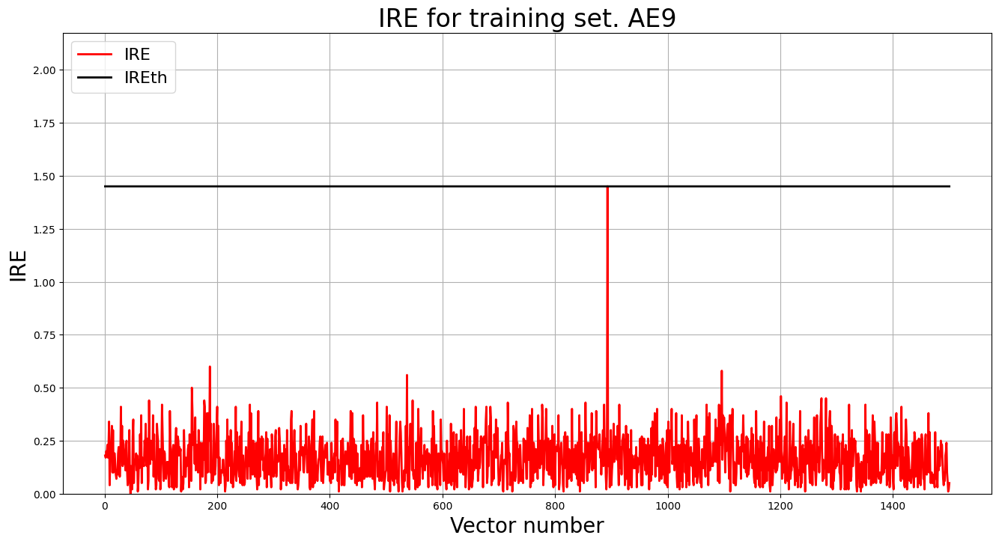

In [ ]:
irefile = 'out/AE9_ire_th.txt'
IRE_array = np.round(ire_array(data9, ae9_pred), 2)
IREth = np.amax(IRE_array)
with open(irefile, 'w') as file:
    file.write(str(IREth))

IRE_9 = IRE_array
IREth_9 = IREth
lib.ire_plot('training', IRE_9, IREth, 'AE9')

250/250 [==============================] - 1s 3ms/step


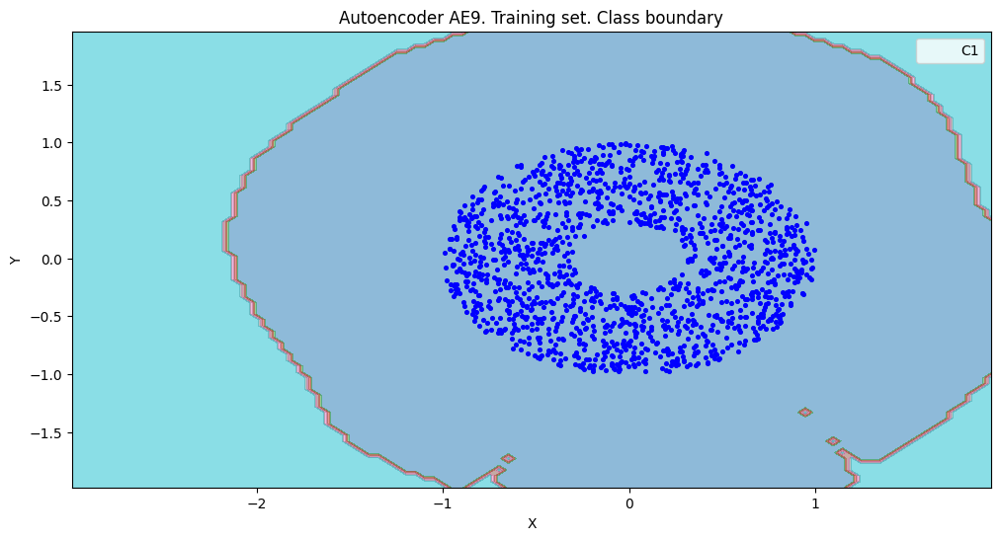

amount:  6
amount_ae:  23


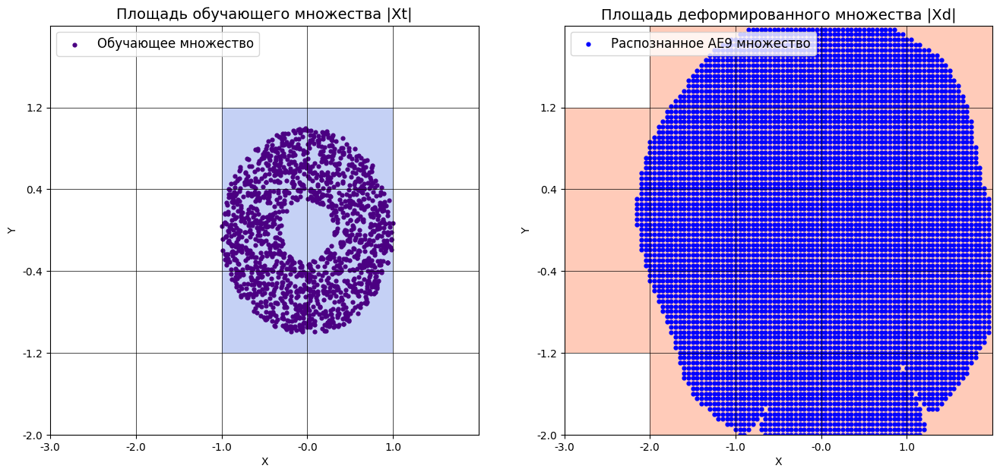

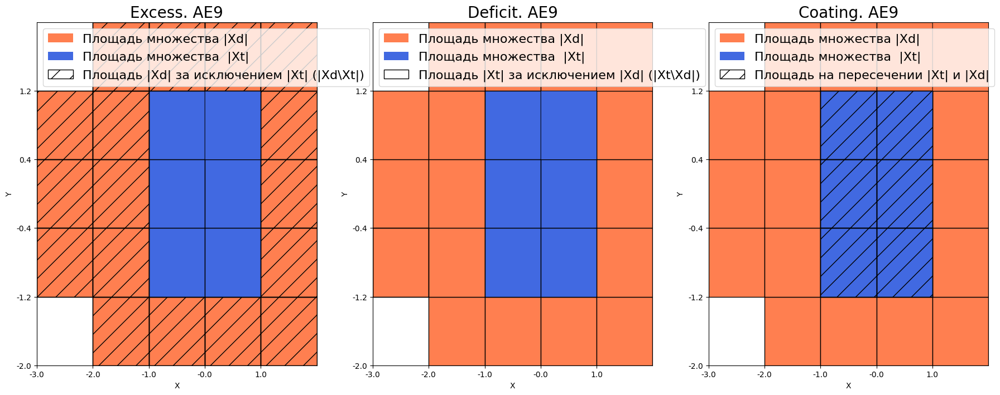


Оценка качества AE9
IDEAL = 0. Excess:  2.8333333333333335
IDEAL = 0. Deficit:  0.0
IDEAL = 1. Coating:  1.0
summa:  1.0
IDEAL = 1. Extrapolation precision (Approx):  0.26086956521739135




In [ ]:
# построение областей покрытия и границ классов
# расчет характеристик качества обучения
# параметр numb_square, отвечающий за количество элементов разбиения по каждой оси пространства признаков
numb_square = 5

xx, yy, Z3 = lib.square_calc(numb_square, data9, ae9_trainned, IREth_9, '9', True)

### Плотное покрытие

In [ ]:
import numpy as np

# Функция для проверки, попадает ли точка внутрь круга
def is_inside_circle(point, center, radius):
  # Вычисляем расстояние между точкой и центром круга
  distance = np.linalg.norm(point - center)
  return distance <= radius

# Параметры
n_points = 100  # Количество точек
outer_radius = 1.0  # Радиус внешнего круга
inner_radius = 0.3  # Радиус внутреннего круга

def generate_grid_points(n_points):
    x = np.linspace(-1, 1, n_points)
    y = np.linspace(-1, 1, n_points)

    points = [np.array([i, j]) for i in x for j in y]

    return points

# Центры кругов
outer_center = np.array([0, 0])
inner_center = np.array([0, 0])


grid_points = generate_grid_points(n_points)
points = []

for point in grid_points:
  if not is_inside_circle(point, inner_center, inner_radius) and  is_inside_circle(point, outer_center, outer_radius):
    points.append(point)

points = np.array(points)

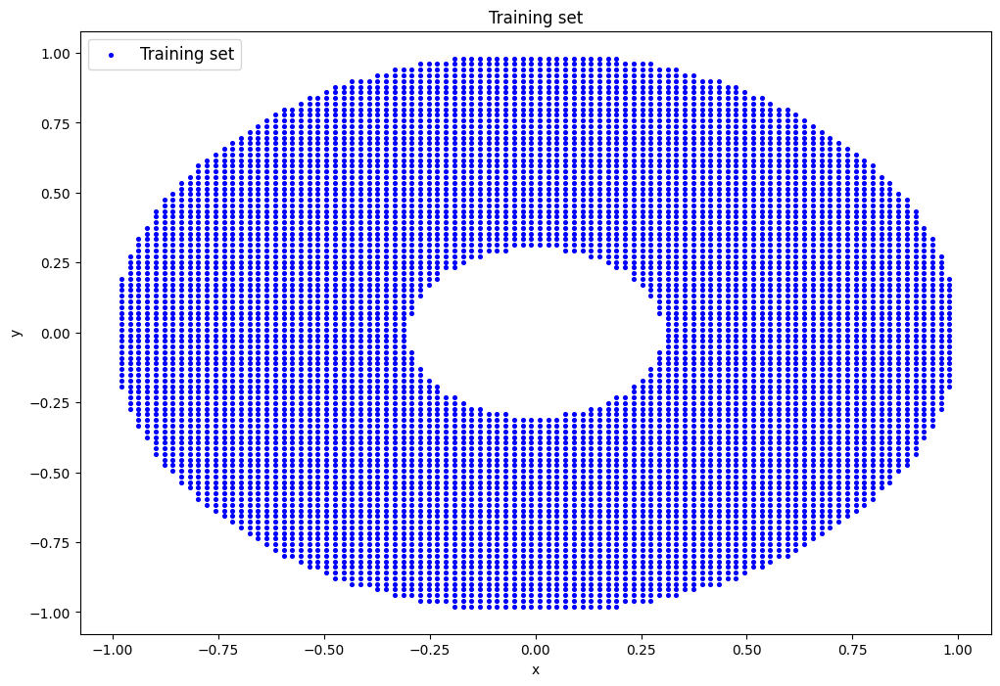

In [ ]:
data9 = points


plt.figure(figsize=(12,8))
plt.scatter(points[:,0],points[:,1],marker='o',s=7,color='b',label='Training set')
plt.legend(loc= 'upper left',fontsize=12)
plt.title('Training set')
plt.xlabel('x')
plt.ylabel('y')
plt.show()

2250/2250 [==============================] - 4s 2ms/step


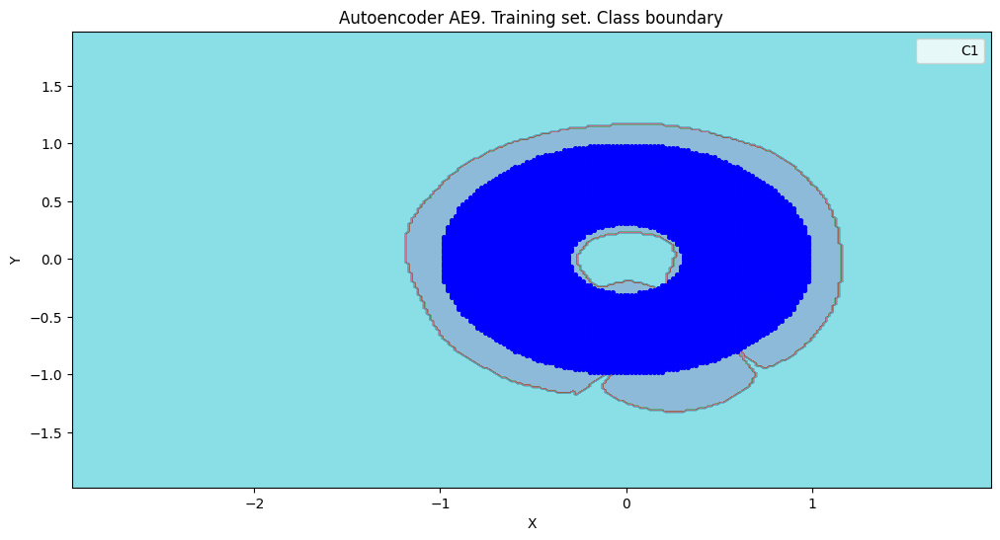

amount:  5708
amount_ae:  8863


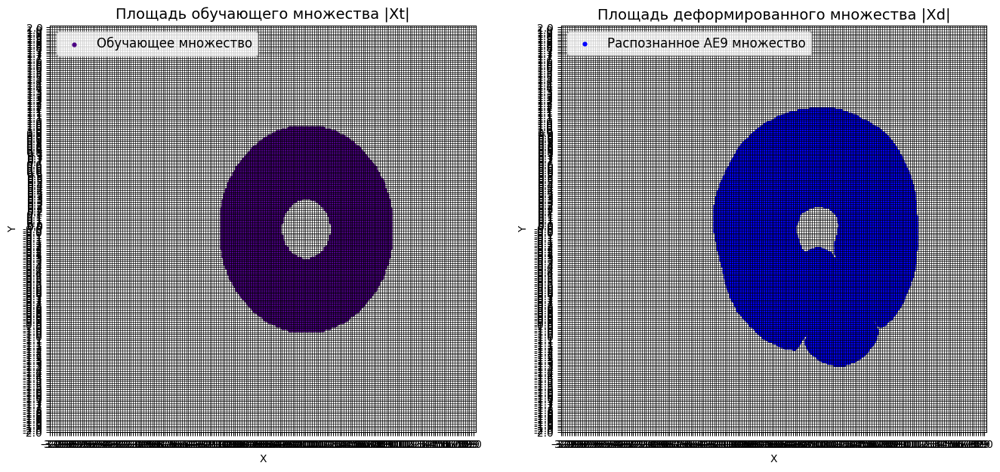

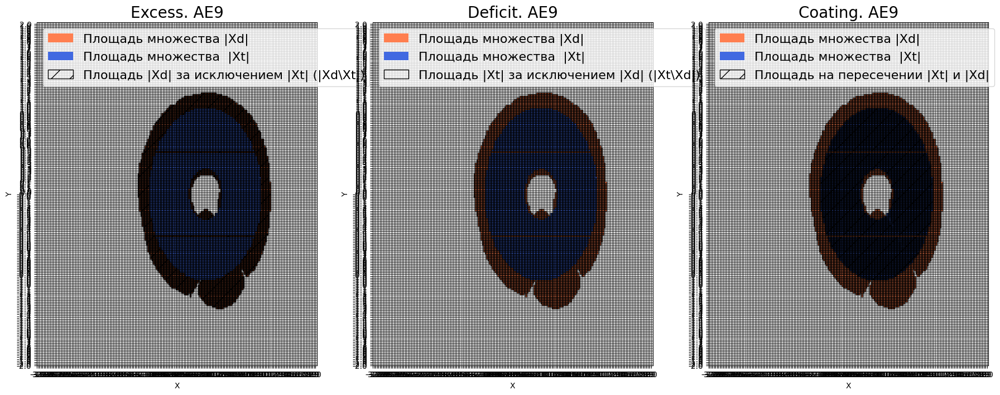


Оценка качества AE9
IDEAL = 0. Excess:  0.5560616678346181
IDEAL = 0. Deficit:  0.0033286615276804485
IDEAL = 1. Coating:  0.9966713384723196
summa:  1.0
IDEAL = 1. Extrapolation precision (Approx):  0.6440257249238408




In [ ]:
# построение областей покрытия и границ классов
# расчет характеристик качества обучения
# параметр numb_square, отвечающий за количество элементов разбиения по каждой оси пространства признаков
numb_square = 200

xx, yy, Z3 = lib.square_calc1(numb_square, data9, ae9_trainned, IREth_9, '9', True)

### График Excess

In [ ]:
Excess = [0, 0, 0, 0.5, 1.33, 0, 0.125, 0.438, 0.381, 0.522, 0.3, 0.378, 0.444, 0.372, 0.435, 0.5, 0.456,
     0.375, 0.257, 0.557, 0.446, 0.413, 0.447, 0.381, 0.449, 0.496, 0.445, 0.474, 0.445, 0.46, 0.432,
     0.491, 0.454, 0.458, 0.498, 0.452, 0.484, 0.464, 0.5, 0.548, 0.468, 0.465, 0.493, 0.498, 0.506,
     0.473, 0.523, 0.494, 0.49, 0.512, 0.571, 0.514, 0.538, 0.541, 0.559, 0.569, 0.537, 0.585, 0.579,
     0.599, 0.593, 0.606, 0.615, 0.643, 0.623, 0.633, 0.653, 0.674, 0.676, 0.714, 0.712, 0.718, 0.744,
     0.757, 0.767, 0.795, 0.759, 0.798, 0.84, 0.859]

In [ ]:
np.mean(Excess)

0.51625

In [ ]:
n = list(range(1, 81))

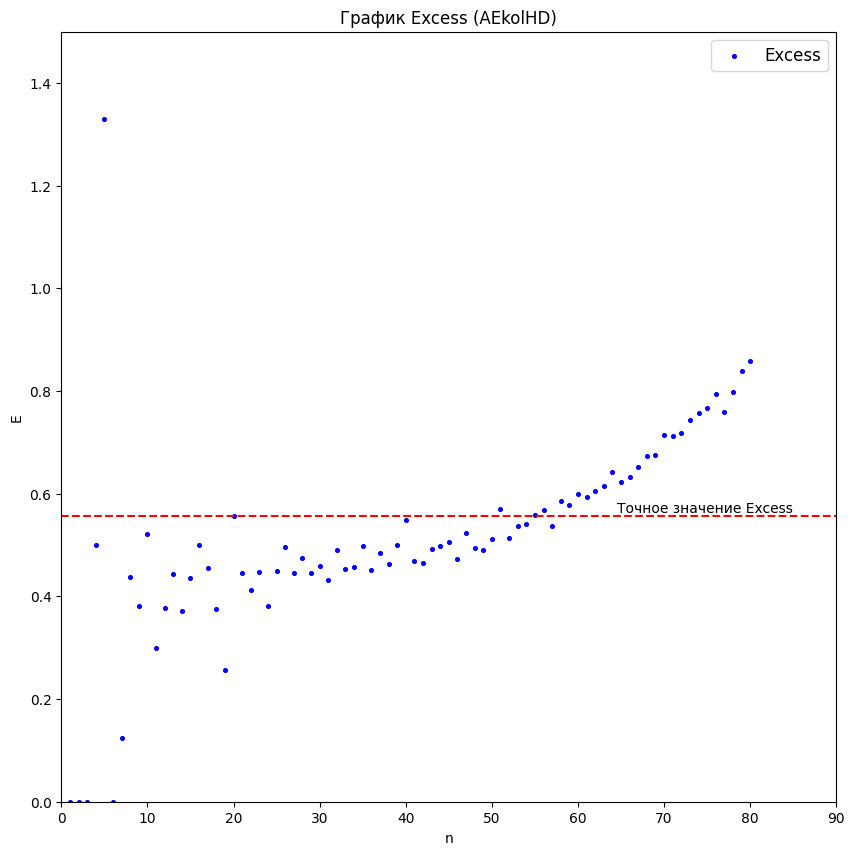

In [ ]:
plt.figure(figsize=(10,10))
plt.scatter(n,Excess,marker='o',s=7,color='b',label='Excess')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Excess (AEkolHD)')
plt.xlabel('n')
plt.ylabel('E')
plt.hlines(0.556, 0, 90, color='red',linestyle='--')
plt.text(85, 0.572, 'Точное значение Excess', ha='right', va='center')
plt.xlim([0, 90])
plt.ylim([0, 1.5])
plt.show()

### Среднее 30 шагов

In [ ]:
nn = np.arange(5,81)

av = []
for i in nn:
  av.append(np.mean(Excess[0:i]))

print(av)

[0.366, 0.305, 0.2792857142857143, 0.299125, 0.30822222222222223, 0.3296, 0.3269090909090909, 0.33116666666666666, 0.33984615384615385, 0.34214285714285714, 0.34833333333333333, 0.3578125, 0.36358823529411766, 0.3642222222222222, 0.35857894736842105, 0.3685, 0.3721904761904762, 0.3740454545454545, 0.3772173913043478, 0.37737499999999996, 0.3802399999999999, 0.38469230769230767, 0.3869259259259259, 0.39003571428571426, 0.3919310344827586, 0.3942, 0.3954193548387097, 0.39840625, 0.4000909090909091, 0.40179411764705886, 0.40454285714285715, 0.4058611111111111, 0.40797297297297297, 0.40944736842105267, 0.4117692307692308, 0.41517499999999996, 0.4164634146341463, 0.4176190476190476, 0.4193720930232558, 0.42115909090909087, 0.42304444444444445, 0.42413043478260865, 0.4262340425531914, 0.42764583333333334, 0.4289183673469388, 0.43058, 0.43333333333333335, 0.4348846153846154, 0.4368301886792453, 0.4387592592592593, 0.4409454545454546, 0.4432321428571429, 0.44487719298245615, 0.4472931034482759

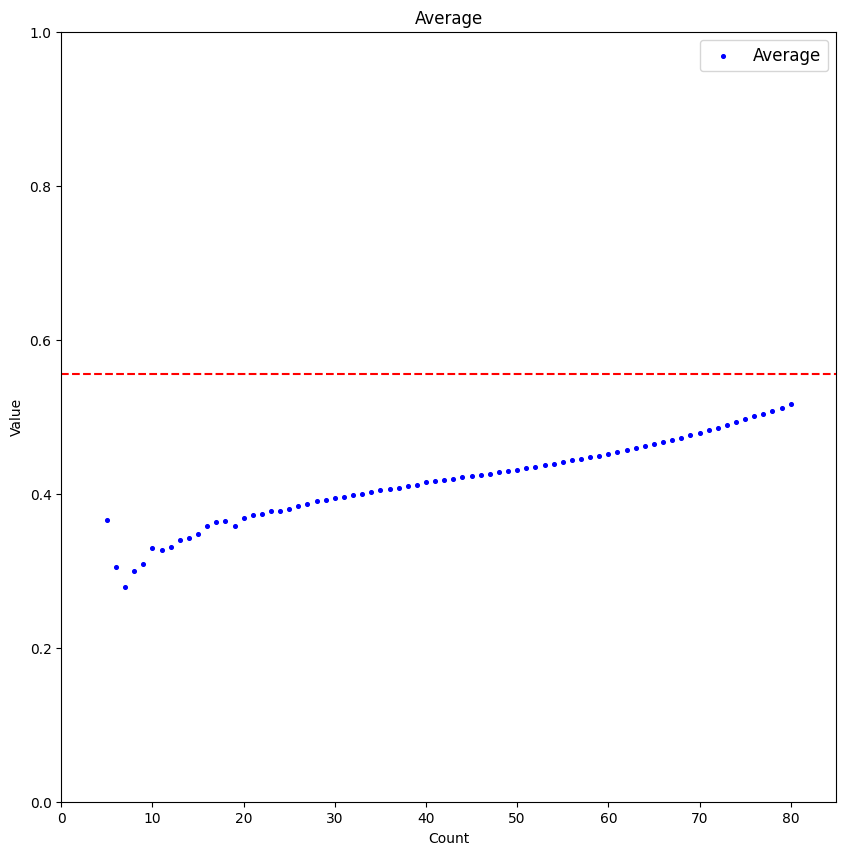

In [ ]:
plt.figure(figsize=(10,10))
plt.scatter(nn,av,marker='o',s=7,color='b',label='Average')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Average')
plt.xlabel('Count')
plt.ylabel('Value')
plt.hlines(0.556, 0, 85, color='red',linestyle='--')
plt.xlim([0, 85])
plt.ylim([0, 1])
plt.show()

### Среднее

In [ ]:
# 5 разбиений: 1, 20, 40, 60, 80
E = [0, 0.557, 0.548, 0.599, 0.859]
np.mean(E)

0.5126

In [ ]:
# 6 разбиений: 1, 16, 32, 48, 64, 80
E = [0, 0.5, 0.491, 0.494, 0.643, 0.859]
np.mean(E)

0.49783333333333335

In [ ]:
# 7 разбиений: 1, 14, 27, 40, 54, 67, 80
E = [0, 0.372, 0.445, 0.548, 0.541, 0.653, 0.859]
np.mean(E)

0.4882857142857143

In [ ]:
# 8 разбиений: 1, 12, 23, 35, 46, 58, 69, 80
E = [0, 0.378, 0.447, 0.498, 0.473, 0.585, 0.676, 0.859]
np.mean(E)

0.4895

In [ ]:
# 9 разбиений: 1, 10, 20, 30, 40, 50, 60, 70, 80
E = [0, 0.522, 0.557, 0.46, 0.548, 0.512, 0.599, 0.714, 0.859]
np.mean(E)

0.5301111111111112

In [ ]:
# 10 разбиений: 1, 9, 18, 27, 35, 44, 53, 61, 70, 80
E = [0, 0.381, 0.375, 0.445, 0.498, 0.498, 0.538, 0.593, 0.714, 0.859]
np.mean(E)

0.4901

In [ ]:
# 11 разбиений: 1, 8, 16, 24, 32, 40, 48, 56, 64, 72, 80
E = [0, 0.438, 0.5, 0.381, 0.491, 0.548, 0.494, 0.569, 0.643, 0.718, 0.859]
np.mean(E)

0.5128181818181818

In [ ]:
# 12 разбиений: 1, 8, 15, 23, 31, 38, 45, 52, 59, 66, 73, 80
E = [0, 0.438, 0.435, 0.447, 0.432, 0.464, 0.506, 0.514, 0.579, 0.633, 0.744, 0.859]
np.mean(E)

0.50425

In [ ]:
# 13 разбиений: 1, 7, 14, 20, 26, 33, 39, 46, 52, 59, 66, 73, 80
E = [0, 0.125, 0.372, 0.557, 0.496, 0.454, 0.5, 0.473, 0.514, 0.579, 0.633, 0.744, 0.859]
np.mean(E)

0.48507692307692307

In [ ]:
# 14 разбиений: 1, 7, 13, 20, 26, 32, 39, 45, 51, 57, 64, 70, 76, 80
E = [0, 0.125, 0.444, 0.557, 0.496, 0.491, 0.5, 0.506, 0.571, 0.537, 0.643, 0.714, 0.795, 0.859]
np.mean(E)

0.517

In [ ]:
# 15 разбиений: 1, 6, 12, 18, 23, 29, 35, 40, 46, 52, 57, 63, 69, 74, 80
E = [0, 0, 0.378, 0.375, 0.447, 0.445, 0.498, 0.548, 0.473, 0.514, 0.537, 0.615, 0.676, 0.757, 0.859]
np.mean(E)

0.4748

In [ ]:
# 16 разиений: 1, 6, 11, 17, 23, 28, 33, 39, 44, 49, 55, 61, 66, 71, 76, 80
E = [0, 0, 0.3, 0.456, 0.447, 0.474, 0.454, 0.5, 0.498, 0.49, 0.559, 0.593, 0.633, 0.712, 0.795, 0.859]
np.mean(E)

0.48562500000000003

In [ ]:
# 17 разбиений: 1, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80
E = [0, 1.33, 0.522, 0.435, 0.557, 0.449, 0.46, 0.498, 0.548, 0.506, 0.512, 0.559, 0.599, 0.623, 0.714, 0.767, 0.859]
np.mean(E)

0.5845882352941176

In [ ]:
# 18 разбиений: 1, 5, 10, 14, 19, 23, 28, 32, 36, 41, 45, 50, 55, 60, 64, 69, 74, 80
E = [0, 1.33, 0.522, 0.372, 0.257, 0.447, 0.474, 0.491, 0.452, 0.468, 0.506, 0.512, 0.559, 0.599,
     0.643, 0.676, 0.757, 0.859]
np.mean(E)

0.5513333333333333

In [ ]:
# 19 разбиений: 1, 5, 10, 14, 19, 23, 28, 32, 37, 41, 46, 50, 55, 59, 64, 68, 73, 77, 80
E = [0, 1.33, 0.522, 0.372, 0.257, 0.447, 0.474, 0.491, 0.484, 0.468,
     0.473, 0.512, 0.559, 0.579, 0.643, 0.674, 0.744, 0.759, 0.859]
np.mean(E)

0.5603684210526316

In [ ]:
# 20 разбиений: 1, 5, 9, 13, 18, 22, 26, 30, 34, 39, 43, 47, 51, 55, 59, 63, 68, 72, 76, 80
E = [0, 1.33, 0.381, 0.444, 0.375, 0.413, 0.496, 0.46, 0.458, 0.5, 0.493,
     0.523, 0.571, 0.559, 0.579, 0.615, 0.674, 0.718, 0.795, 0.859]
np.mean(E)

0.5621499999999999

In [ ]:
# 21 разбиение: 1, 4, 8, 12, 16, 20, 24, 28, 32, 36, 40, 44, 48, 52, 56, 60, 64, 68, 72, 76, 80
E = [0, 0.5, 0.438, 0.378, 0.5, 0.557, 0.381, 0.474, 0.491, 0.452, 0.548, 0.498, 0.494,
     0.514, 0.569, 0.599, 0.643, 0.674, 0.718, 0.795, 0.859 ]
np.mean(E)

0.5277142857142858

In [ ]:
# 22 разбиения: 1, 4, 8, 12, 16, 19, 22, 25, 28, 32, 36, 40, 44, 48, 52, 56, 60, 64, 68, 72, 76, 80
E = [0, 0.5, 0.438, 0.378, 0.5, 0.257, 0.413, 0.449, 0.474, 0.491, 0.452, 0.548, 0.498, 0.494,
     0.514, 0.569, 0.599, 0.643, 0.674, 0.718, 0.795, 0.859 ]
np.mean(E)

0.5119545454545454

In [ ]:
# 23 разбиения: 1, 4, 8, 11, 15, 18, 22, 25, 29, 32, 36, 39, 43, 46, 50, 53, 57, 60, 64, 67, 71, 75, 80
E = [0, 0.5, 0.438, 0.3, 0.435, 0.375, 0.413, 0.449, 0.445, 0.491, 0.452, 0.5, 0.493,
     0.473, 0.512, 0.538, 0.537, 0.599, 0.643, 0.653, 0.712, 0.767, 0.859]
np.mean(E)

0.5036521739130435

In [ ]:
# 24 разбиения: 1, 4, 8, 11, 15, 18, 22, 25, 29, 32, 35, 38, 41, 44, 47, 50, 53, 57, 60, 64, 67, 71, 75, 80
E = [0, 0.5, 0.438, 0.3, 0.435, 0.375, 0.413, 0.449, 0.445, 0.491, 0.498, 0.464, 0.468, 0.498,
     0.523, 0.512, 0.538, 0.537, 0.599, 0.643, 0.653, 0.712, 0.767, 0.859 ]
np.mean(E)

0.5048750000000001

In [ ]:
# 25 разбиений: 1, 4, 7, 10, 14, 17, 20, 24, 27, 30, 33, 36, 40, 43, 47, 50, 53, 56, 60, 63, 66, 70, 73, 76, 80
E = [0, 0.5, 0.125, 0.522, 0.372, 0.456, 0.557, 0.381, 0.445, 0.46, 0.454, 0.452, 0.548,
     0.493, 0.523, 0.512, 0.538, 0.569, 0.599, 0.615, 0.633, 0.714, 0.744, 0.795, 0.859]
np.mean(E)

0.5146400000000001

In [ ]:
# 26 разбиений: 1, 4, 7, 10, 14, 17, 20, 23, 26, 29, 32, 35, 38, 41, 44, 47, 50, 53, 56, 60, 63, 66, 70, 73, 76, 80
E = [0, 0.5, 0.125, 0.522, 0.372, 0.456, 0.557, 0.447, 0.496, 0.445, 0.491, 0.498, 0.464, 0.468,
     0.498, 0.523, 0.512, 0.538, 0.569, 0.599, 0.615, 0.633, 0.714, 0.744, 0.795, 0.859]
np.mean(E)

0.5169230769230769

In [ ]:
# 27 разбиений: 1, 4, 7, 10, 13, 16, 19, 22, 25, 28, 32, 35, 38, 41, 44, 47, 50, 53, 56, 59, 62, 65, 68, 71, 74, 77, 80
E = [0,  0.5, 0.125, 0.522, 0.444, 0.5, 0.257, 0.413, 0.449, 0.474, 0.491, 0.498, 0.464, 0.468, 0.498,
     0.523, 0.512, 0.538, 0.569, 0.579, 0.606, 0.623, 0.674, 0.712, 0.757, 0.759, 0.859]
np.mean(E)

0.5116296296296297

In [ ]:
# 28 разбиений: 1, 4, 7, 10, 13, 16, 19, 22, 25, 27, 29, 32, 35, 38, 41, 44, 47, 50, 53, 56, 59, 62, 65, 68, 71, 74, 77, 80
E = [0,  0.5, 0.125, 0.522, 0.444, 0.5, 0.257, 0.413, 0.449, 0.445, 0.445, 0.491, 0.498, 0.464, 0.468, 0.498,
     0.523, 0.512, 0.538, 0.569, 0.579, 0.606, 0.623, 0.674, 0.712, 0.757, 0.759, 0.859]
np.mean(E)

0.5082142857142856

In [ ]:
# 29 разбиений: 1, 3, 6, 9, 11, 14, 17, 20, 23, 26, 29, 32, 35, 38, 41, 44, 47, 50, 53, 56, 58, 60, 62, 65, 68, 71, 74, 77, 80
E = [0, 0, 0, 0.381, 0.3, 0.372, 0.456, 0.557, 0.447, 0.496, 0.445, 0.491, 0.498, 0.464, 0.468,
     0.498, 0.523, 0.512, 0.538, 0.569, 0.585, 0.599, 0.606, 0.623, 0.674, 0.712, 0.757, 0.759, 0.859]
np.mean(E)

0.4892758620689655

In [ ]:
# 30 разбиений: 1, 3, 5, 8, 11, 14, 17, 20, 23, 26, 29, 32, 36, 38, 40, 43, 45, 48, 50, 53, 55, 58, 60, 63, 65, 68, 70, 73, 76, 80
E = [0, 0, 1.33, 0.438, 0.3, 0.372, 0.456, 0.557, 0.447, 0.496, 0.445, 0.491, 0.452, 0.464, 0.548,
     0.493, 0.506, 0.494, 0.512, 0.538, 0.559, 0.585, 0.599, 0.615, 0.623, 0.674, 0.714, 0.744, 0.795, 0.859]
np.mean(E)

0.5368666666666666

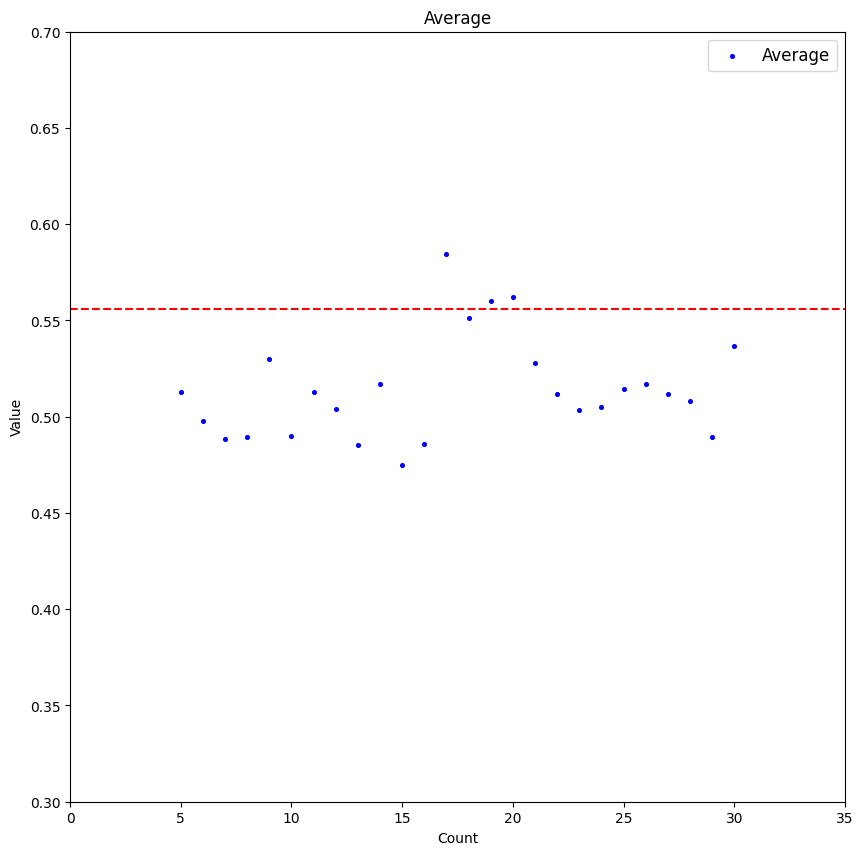

In [ ]:
average = [0.5126, 0.4978, 0.48828, 0.4895, 0.5301, 0.4901, 0.5128, 0.50425, 0.48507, 0.517, 0.4748,
           0.4856, 0.58458, 0.5513, 0.56036, 0.562149, 0.52771, 0.51195, 0.50365, 0.50487,
           0.51464, 0.5169, 0.51162, 0.5082, 0.489275, 0.53686]

count = list(range(5, 31))

plt.figure(figsize=(10,10))
plt.scatter(count,average,marker='o',s=7,color='b',label='Average')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Average')
plt.xlabel('Count')
plt.ylabel('Value')
plt.hlines(0.556, 0, 40, color='red',linestyle='--')
plt.xlim([0, 35])
plt.ylim([0.3, 0.7])
plt.show()

### Аппроксимация с помощью МНК (кольцо с узким горлом)

In [ ]:
x = np.array(n)
y = np.array(Excess)

In [ ]:
linear_func = lambda x, b0, b1: b0 + b1*x
quadratic_func = lambda x, b0, b1, b2: b0 + b1*x + b2*x**2
qubic_func = lambda x, b0, b1, b2, b3: b0 + b1*x + b2*x**2 + b3*x**3
exp_func = lambda x, b0, b1, b2: b0 + b1*np.exp(b2*x)
exp1_func = lambda x, b0, b1, b2: b0 + b1*np.exp(x-b2)
exp2_func = lambda x, b0, b1: b0*np.power(b1,x)
exp3_func = lambda x, b0, b1, b2:  b0 + b1*np.power(b2,x)

In [ ]:
from scipy.optimize import leastsq

# list of model
model_list = [
    'linear', 'quadratic',
    'qubic', 'exp', 'exp1', 'exp2', 'exp3']

# model reference
models_dict = {
        'linear':             linear_func,
        'quadratic':          quadratic_func,
        'qubic':              qubic_func,
        'exp':                exp_func,
        'exp1':               exp1_func,
        'exp2':               exp2_func,
        'exp3':               exp3_func}

# initial values
p0_dict = {
        'linear':             [0, 0],
        'quadratic':          [0, 0, 0],
        'qubic':              [0, 0, 0, 0],
        'exp':                [0, 0, 0],
        'exp1':               [0, 0, 0],
        'exp2':               [1, 1],
        'exp3':               [0, 1, 1]}

# titles (formulas)
formulas_dict = {
        'linear':             'y = b0 + b1*x',
        'quadratic':          'y = b0 + b1*x + b2*x^2',
        'qubic':              'y = b0 + b1*x + b2*x^2 + b3*x^3',
        'exp':                'y = b0 + b1*np.exp(b2*x)',
        'exp1':               'y = b0 + b1*np.exp(x-b2)',
        'exp2':               'y = b0*np.power(b1,x)',
        'exp3':               'y = b0 + b1*np.power(b2,x)'}

# actual data
X_fact = x
Y_fact = y

# function for calculating residuals
residual_func = lambda p, x, y: y - func(x, *p)

# return all optional outputs
full_output = True

# variables to save the calculation results
calculation_results_df = pd.DataFrame(columns=['func', 'p0', 'popt', 'cov_x', 'SSE', 'MSE', 'pcov', 'perr', 'Y_calc', 'error_metrics'])
error_metrics_results_df = pd.DataFrame(columns=['MSE', 'RMSE', 'MAE', 'MSPE', 'MAPE', 'RMSLE', 'R2'])

# calculations
for func_name in model_list:
    print(f'{func_name.upper()} MODEL: {formulas_dict[func_name]}')
    func = models_dict[func_name]
    calculation_results_df.loc[func_name, 'func'] = func
    p0 = p0_dict[func_name]
    print(f'p0 = {p0}')
    calculation_results_df.loc[func_name, 'p0'] = p0
    if full_output:
        (popt, cov_x, infodict, mesg, ier) = leastsq(residual_func, p0, args=(X_fact, Y_fact), full_output=full_output)
        integer_flag = f'ier = {ier}, the solution was found' if ier<=4 else f'ier = {ier}, the solution was not found'
        print(integer_flag, '\n', mesg)
        calculation_results_df.loc[func_name, 'popt'] = popt
        print(f'parameters = {popt}')
        calculation_results_df.loc[func_name, 'cov_x'] = cov_x
        print(f'cov_x = \n{cov_x}')
        #SSE = (residual_func(popt, X_fact, Y_fact)**2).sum()
        SSE = (infodict['fvec']**2).sum()
        calculation_results_df.loc[func_name, 'SSE'] = SSE
        print(f'SSE = {SSE}')
        MSE = SSE / (len(Y_fact)-len(p0))
        calculation_results_df.loc[func_name, 'MSE'] = MSE
        print(f'MSE = {MSE}')
        pcov = cov_x * MSE
        calculation_results_df.loc[func_name, 'pcov'] = pcov
        print(f'pcov =\n {pcov}')
        perr = np.sqrt(np.diag(pcov))
        calculation_results_df.loc[func_name, 'perr'] = perr
        print(f'perr = {perr}\n')
    else:
        popt = leastsq(residual_func, p0, args=(X_fact, Y_fact), full_output=full_output)
        calculation_results_df.loc[func_name, 'popt'] = popt
        print(f'parameters = {popt}\n')
    Y_calc = func(X_fact, *popt)
    calculation_results_df.loc[func_name, 'Y_calc'] = Y_calc
    (error_metrics_dict, error_metrics_df) = regression_error_metrics(Yfact=Y_fact, Ycalc=Y_calc, model_name=func_name)
    calculation_results_df.loc[func_name, 'error_metrics'] = error_metrics_dict.values()
    error_metrics_results_df = pd.concat([error_metrics_results_df, error_metrics_df])

LINEAR MODEL: y = b0 + b1*x
p0 = [0, 0]
ier = 3, the solution was found 
 Both actual and predicted relative reductions in the sum of squares
  are at most 0.000000 and the relative error between two consecutive iterates is at 
  most 0.000000
parameters = [0.28773544 0.00564233]
cov_x = 
[[ 5.09493666e-02 -9.49367078e-04]
 [-9.49367078e-04  2.34411624e-05]]
SSE = 1.7190857434599156
MSE = 0.02203956081358866
pcov =
 [[ 1.12290166e-03 -2.09236334e-05]
 [-2.09236334e-05  5.16632925e-07]]
perr = [0.03350972 0.00071877]

QUADRATIC MODEL: y = b0 + b1*x + b2*x^2
p0 = [0, 0, 0]
ier = 1, the solution was found 
 Both actual and predicted relative reductions in the sum of squares
  are at most 0.000000
parameters = [3.33962439e-01 2.25987161e-03 4.17588041e-05]
cov_x = 
[[ 1.18317916e-01 -5.87877316e-03  6.08568648e-05]
 [-5.87877316e-03  3.84129413e-04 -4.45294134e-06]
 [ 6.08568648e-05 -4.45294134e-06  5.49745842e-08]]
SSE = 1.6873656723709618
MSE = 0.02191383990092158
pcov =
 [[ 2.59279987e-

<ipython-input-7-a10df777837d>:36: RuntimeWarning: divide by zero encountered in divide
  MSPE = (1/n_fit) *  np.sum(((Yfact-Ycalc)/Yfact)**2)
<ipython-input-7-a10df777837d>:37: RuntimeWarning: divide by zero encountered in divide
  MAPE = (1/n_fit) *  np.sum(abs((Yfact-Ycalc)/Yfact))
<ipython-input-7-a10df777837d>:36: RuntimeWarning: divide by zero encountered in divide
  MSPE = (1/n_fit) *  np.sum(((Yfact-Ycalc)/Yfact)**2)
<ipython-input-7-a10df777837d>:37: RuntimeWarning: divide by zero encountered in divide
  MAPE = (1/n_fit) *  np.sum(abs((Yfact-Ycalc)/Yfact))
<ipython-input-7-a10df777837d>:36: RuntimeWarning: divide by zero encountered in divide
  MSPE = (1/n_fit) *  np.sum(((Yfact-Ycalc)/Yfact)**2)
<ipython-input-7-a10df777837d>:37: RuntimeWarning: divide by zero encountered in divide
  MAPE = (1/n_fit) *  np.sum(abs((Yfact-Ycalc)/Yfact))
<ipython-input-7-a10df777837d>:36: RuntimeWarning: divide by zero encountered in divide
  MSPE = (1/n_fit) *  np.sum(((Yfact-Ycalc)/Yfact)**2)

#### Аппроксимация многочленом 1-й степени

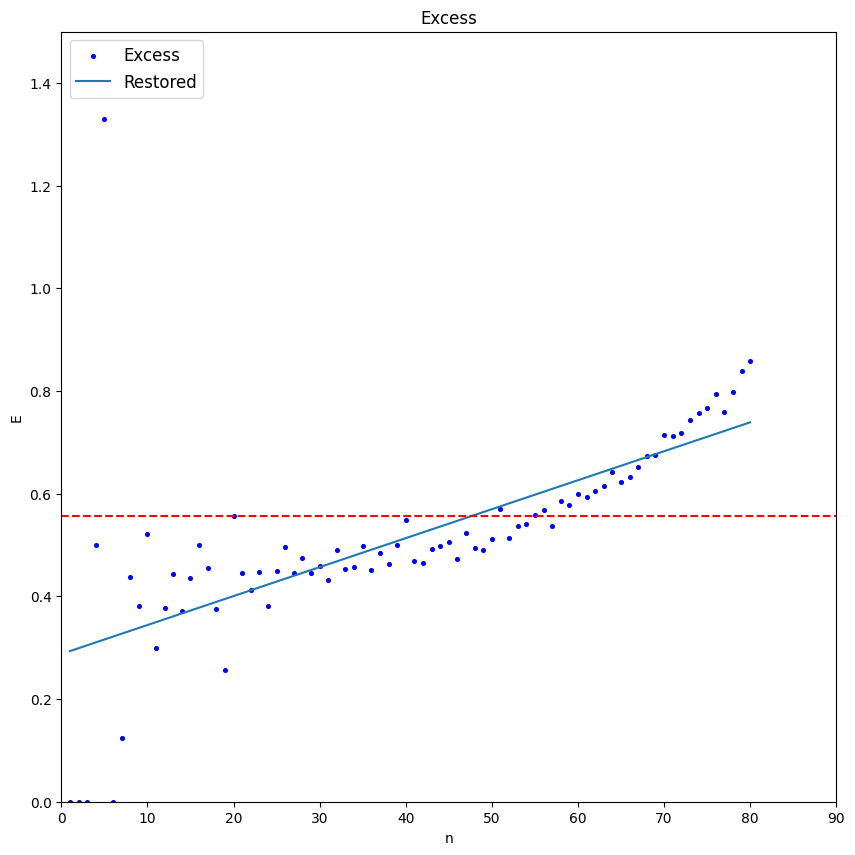

In [ ]:
b0, b1 = [0.28773544, 0.00564233]

plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='b',label='Excess')
plt.plot(x, b0 + b1*x , label = 'Restored')
plt.legend(loc= 'upper left',fontsize=12)
plt.title('Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.hlines(0.556, 0, 90, color='red',linestyle='--')
plt.xlim([0, 90])
plt.ylim([0, 1.5])
plt.show()

#### Аппроксимация многочленом 2-й степени

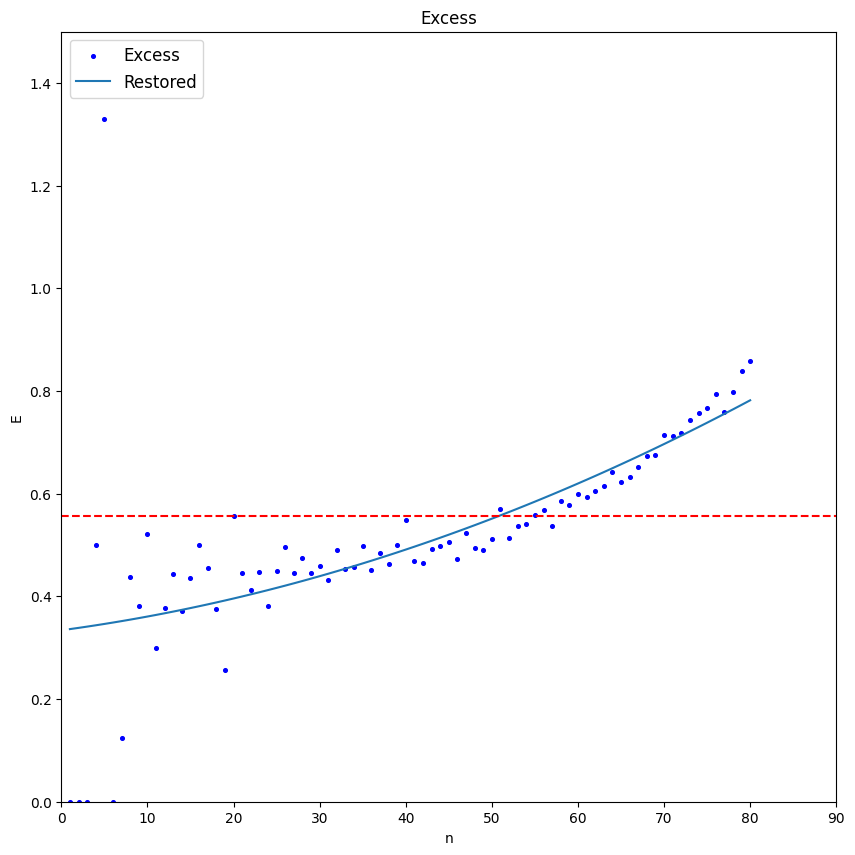

In [ ]:
b0, b1, b2 = [3.33962439e-01, 2.25987161e-03, 4.17588041e-05]

plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='b',label='Excess')
plt.plot(x, b0 + b1*x + b2*x**2 , label = 'Restored')
plt.legend(loc= 'upper left',fontsize=12)
plt.title('Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.hlines(0.556, 0, 90, color='red',linestyle='--')
plt.xlim([0, 90])
plt.ylim([0, 1.5])
plt.show()

#### Аппроксимация многочленом 3-й степени

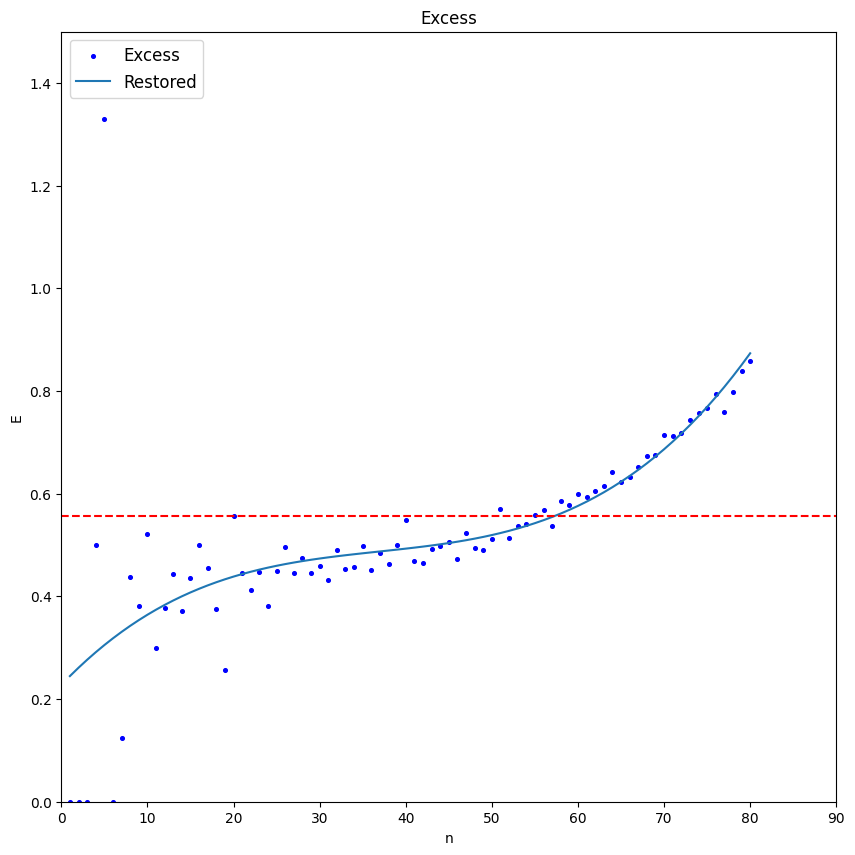

In [ ]:
b0, b1, b2, b3 = [ 2.27568160e-01,  1.75491545e-02, -4.27213923e-04,  3.85985784e-06]

plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='b',label='Excess')
plt.plot(x, b0 + b1*x + b2*x**2 + b3*x**3 , label = 'Restored')
plt.legend(loc= 'upper left',fontsize=12)
plt.title('Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.hlines(0.556, 0, 90, color='red',linestyle='--')
plt.xlim([0, 90])
plt.ylim([0, 1.5])
plt.show()

##### Экстремум

In [ ]:
from sympy import *

x = Symbol('x', real=True)
f = 2.27568160e-01 + 1.75491545e-02*x -4.27213923e-04*x**2 + 3.85985784e-06*x**3
fprime = f.diff(x)
fprime

1.157957352e-5*x**2 - 0.000854427846*x + 0.0175491545

In [ ]:
solve(fprime, x)

[]

#### Аппроксимация экспонентами

 y = b0 + b1*e^(b2**x)

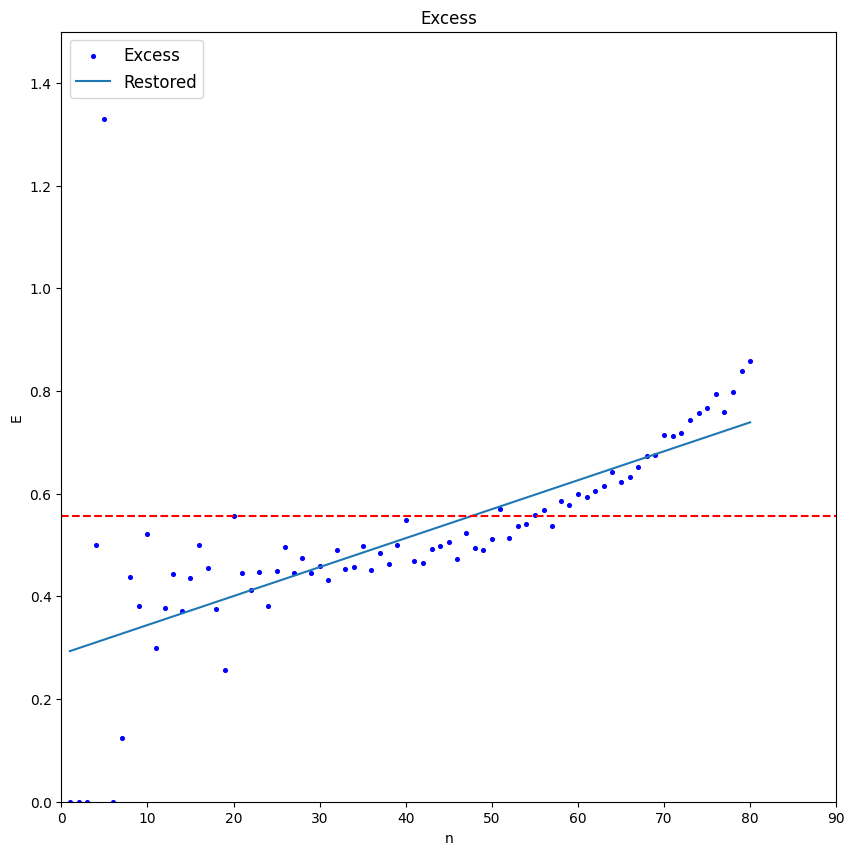

In [ ]:
b0, b1, b2 = [ 1.07194111e+03, -1.07165339e+03, -5.26617536e-06]

plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='b',label='Excess')
plt.plot(x, b0 + b1*np.exp(b2*x) , label = 'Restored')
plt.legend(loc= 'upper left',fontsize=12)
plt.title('Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.hlines(0.556, 0, 90, color='red',linestyle='--')
plt.xlim([0, 90])
plt.ylim([0, 1.5])
plt.show()

y = b0 + b1*np.exp(x-b2)

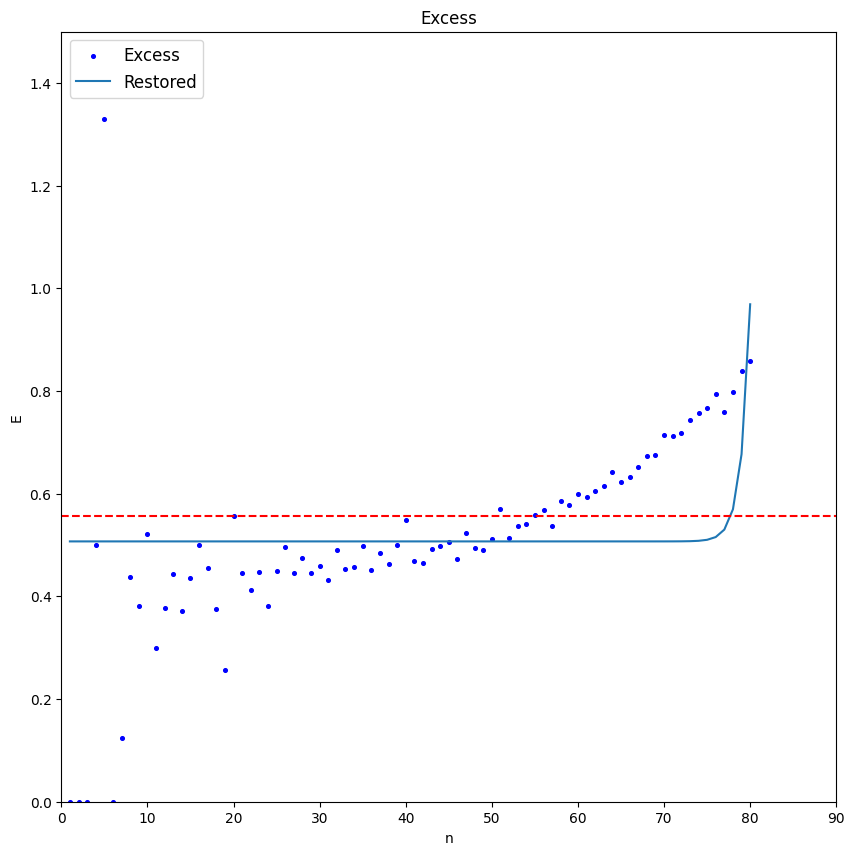

In [ ]:
b0, b1, b2 = [5.07115604e-01, 8.33702641e-36, 0.00000000e+00]

plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='b',label='Excess')
plt.plot(x, b0 + b1*np.exp(x-b2) , label = 'Restored')
plt.legend(loc= 'upper left',fontsize=12)
plt.title('Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.hlines(0.556, 0, 90, color='red',linestyle='--')
plt.xlim([0, 90])
plt.ylim([0, 1.5])
plt.show()

y = b0*np.power(b1,x)

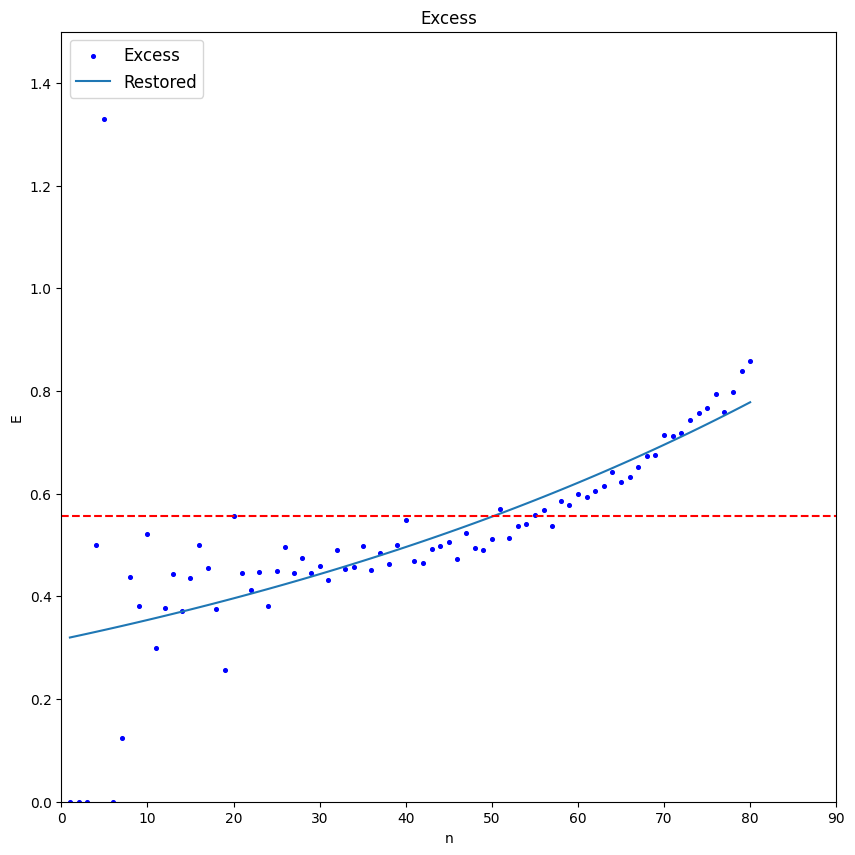

In [ ]:
b0, b1 = [0.31631374, 1.01131647]

plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='b',label='Excess')
plt.plot(x, b0*np.power(b1,x) , label = 'Restored')
plt.legend(loc= 'upper left',fontsize=12)
plt.title('Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.hlines(0.556, 0, 90, color='red',linestyle='--')
plt.xlim([0, 90])
plt.ylim([0, 1.5])
plt.show()

y = b0 + b1*np.power(b2,x)

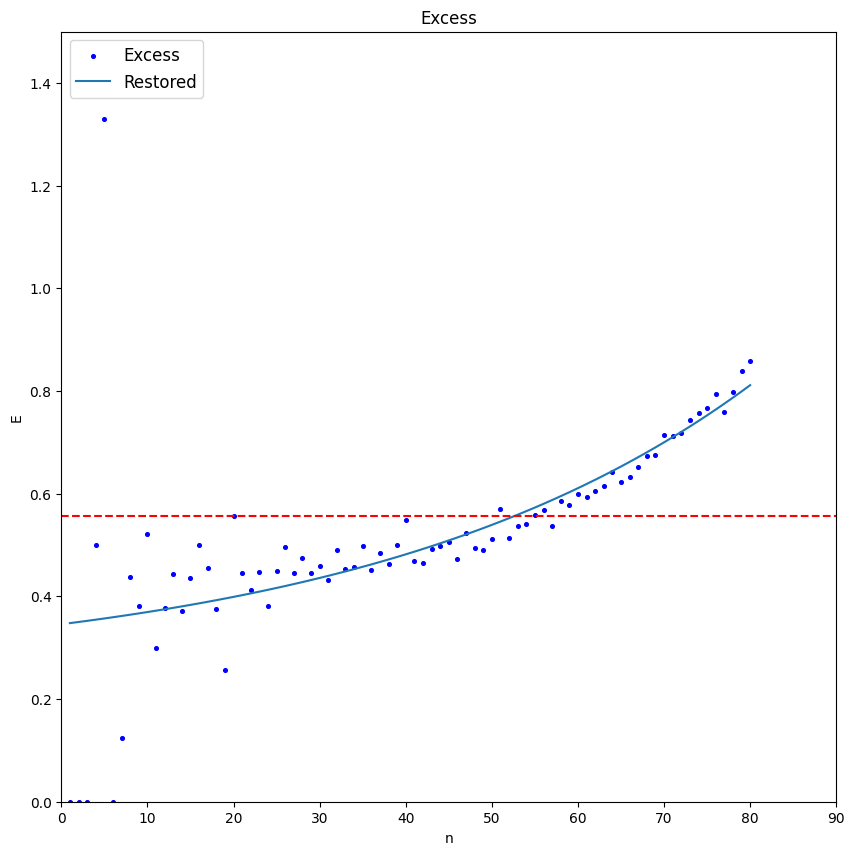

In [ ]:
b0, b1, b2 = [0.25004637, 0.09574933, 1.02235568]

plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='b',label='Excess')
plt.plot(x, b0 + b1*np.power(b2,x) , label = 'Restored')
plt.legend(loc= 'upper left',fontsize=12)
plt.title('Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.hlines(0.556, 0, 90, color='red',linestyle='--')
plt.xlim([0, 90])
plt.ylim([0, 1.5])
plt.show()

#### Все графики

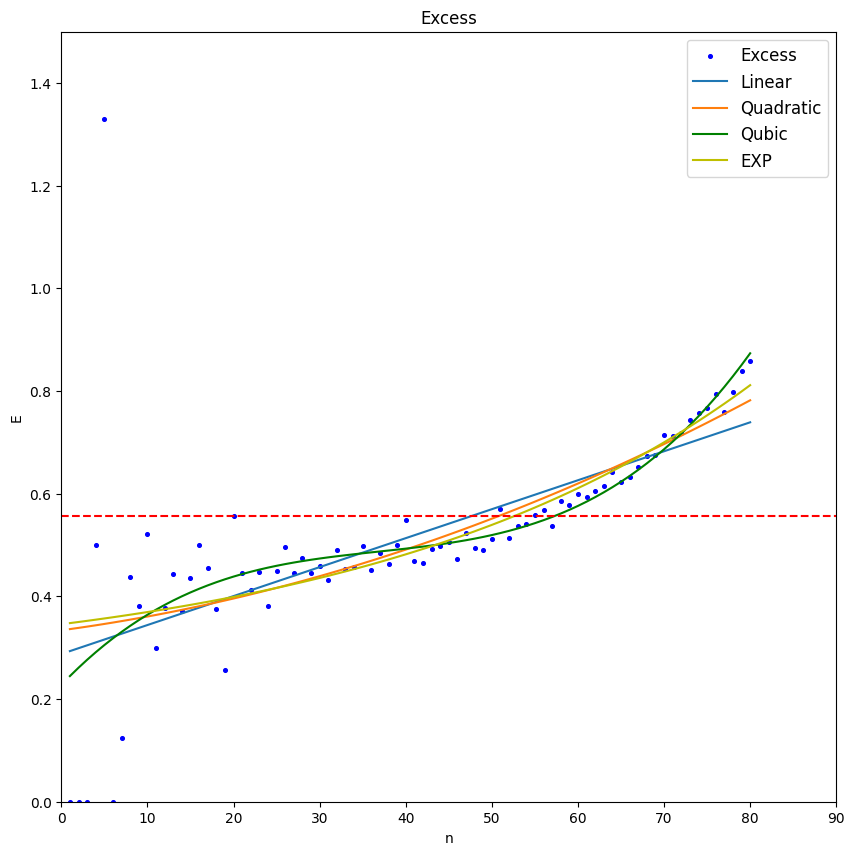

In [ ]:
# 1-я степень
b0, b1 = [0.28773544, 0.00564233]

# 2-я степень
be0, be1, be2 = [3.33962439e-01, 2.25987161e-03, 4.17588041e-05]

# 3-я степень
beta0, beta1, beta2, beta3 = [ 2.27568160e-01,  1.75491545e-02, -4.27213923e-04,  3.85985784e-06]

# Экспонента
bet0, bet1, bet2 = [0.25004637, 0.09574933, 1.02235568]

plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='b',label='Excess')
plt.plot(x, b0 + b1*x , label = 'Linear')
plt.plot(x, be0 + be1*x + be2*x**2 , label = 'Quadratic')
plt.plot(x, beta0 + beta1*x + beta2*x**2 + beta3*x**3 ,color='g', label = 'Qubic')
plt.plot(x, bet0 + bet1*np.power(bet2,x) , color = 'y', label = 'EXP')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.hlines(0.556, 0, 90, color='red',linestyle='--')
plt.xlim([0, 90])
plt.ylim([0, 1.5])
plt.show()

### Несколько точек

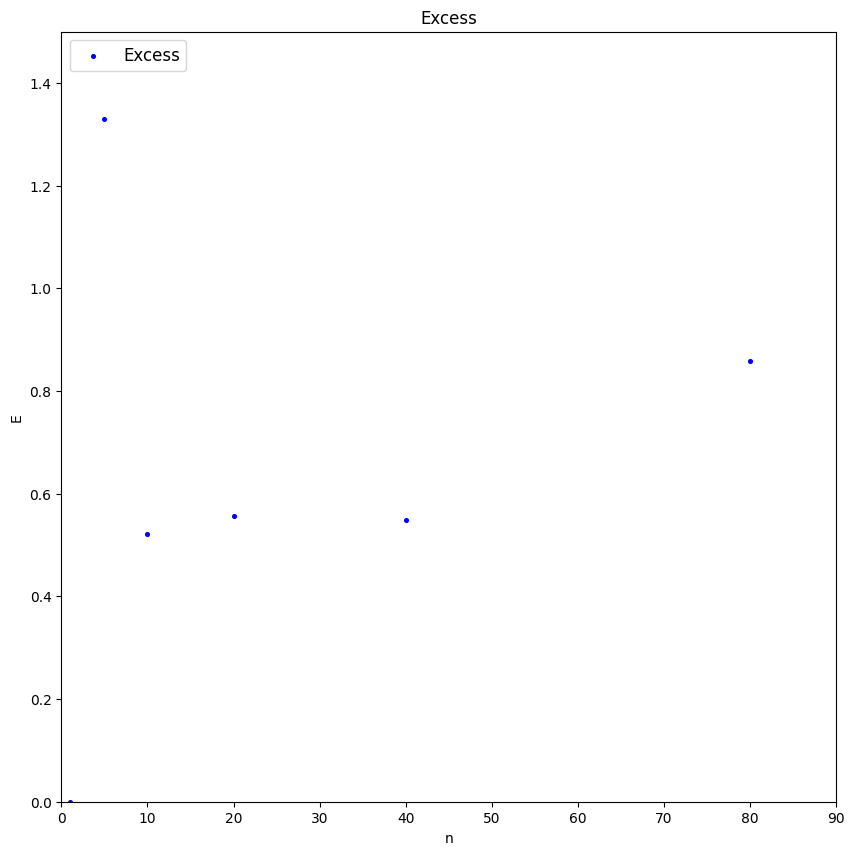

In [ ]:
E = [0, 1.33, 0.522, 0.557, 0.548, 0.859]
n = [1, 5, 10, 20, 40, 80]

plt.figure(figsize=(10,10))
plt.scatter(n,E,marker='o',s=7,color='b',label='Excess')
plt.legend(loc= 'upper left',fontsize=12)
plt.title('Excess')
plt.xlabel('n')
plt.ylabel('E')
#plt.hlines(0.556, 0, 90, color='red',linestyle='--')
plt.xlim([0, 90])
plt.ylim([0, 1.5])
plt.show()

In [ ]:
x = np.array(n)
y = np.array(E)

from scipy.optimize import leastsq

linear_func = lambda x, b0, b1: b0 + b1*x
quadratic_func = lambda x, b0, b1, b2: b0 + b1*x + b2*x**2
qubic_func = lambda x, b0, b1, b2, b3: b0 + b1*x + b2*x**2 + b3*x**3
exp_func = lambda x, b0, b1, b2: b0 + b1*np.exp(b2*x)
exp1_func = lambda x, b0, b1, b2: b0 + b1*np.exp(x-b2)
exp2_func = lambda x, b0, b1, b2: b0 + b1*np.power(b2,x)
exp3_func = lambda x, b0, b1, b2, b3:  b0 + b1*np.power(b2,(x-b3))

# list of model
model_list = [
    'linear', 'quadratic',
    'qubic', 'exp2']

# model reference
models_dict = {
        'linear':             linear_func,
        'quadratic':          quadratic_func,
        'qubic':              qubic_func,
        'exp2':               exp2_func}

# initial values
p0_dict = {
        'linear':             [0, 0],
        'quadratic':          [0, 0, 0],
        'qubic':              [0, 0, 0, 0],
        'exp2':               [1, 1, 1]}

# titles (formulas)
formulas_dict = {
        'linear':             'y = b0 + b1*x',
        'quadratic':          'y = b0 + b1*x + b2*x^2',
        'qubic':              'y = b0 + b1*x + b2*x^2 + b3*x^3',
        'exp2':               'y = b0 + b1*np.power(b2,x)'}

# actual data
X_fact = x
Y_fact = y

# function for calculating residuals
residual_func = lambda p, x, y: y - func(x, *p)

# return all optional outputs
full_output = True

# variables to save the calculation results
calculation_results_df = pd.DataFrame(columns=['func', 'p0', 'popt', 'cov_x', 'SSE', 'MSE', 'pcov', 'perr', 'Y_calc', 'error_metrics'])
error_metrics_results_df = pd.DataFrame(columns=['MSE', 'RMSE', 'MAE', 'MSPE', 'MAPE', 'RMSLE', 'R2'])

# calculations
for func_name in model_list:
    print(f'{func_name.upper()} MODEL: {formulas_dict[func_name]}')
    func = models_dict[func_name]
    calculation_results_df.loc[func_name, 'func'] = func
    p0 = p0_dict[func_name]
    print(f'p0 = {p0}')
    calculation_results_df.loc[func_name, 'p0'] = p0
    if full_output:
        (popt, cov_x, infodict, mesg, ier) = leastsq(residual_func, p0, args=(X_fact, Y_fact), full_output=full_output)
        integer_flag = f'ier = {ier}, the solution was found' if ier<=4 else f'ier = {ier}, the solution was not found'
        print(integer_flag, '\n', mesg)
        calculation_results_df.loc[func_name, 'popt'] = popt
        print(f'parameters = {popt}')
        calculation_results_df.loc[func_name, 'cov_x'] = cov_x
        print(f'cov_x = \n{cov_x}')
        #SSE = (residual_func(popt, X_fact, Y_fact)**2).sum()
        SSE = (infodict['fvec']**2).sum()
        calculation_results_df.loc[func_name, 'SSE'] = SSE
        print(f'SSE = {SSE}')
        MSE = SSE / (len(Y_fact)-len(p0))
        calculation_results_df.loc[func_name, 'MSE'] = MSE
        print(f'MSE = {MSE}')
        pcov = cov_x * MSE
        calculation_results_df.loc[func_name, 'pcov'] = pcov
        print(f'pcov =\n {pcov}')
        perr = np.sqrt(np.diag(pcov))
        calculation_results_df.loc[func_name, 'perr'] = perr
        print(f'perr = {perr}\n')
    else:
        popt = leastsq(residual_func, p0, args=(X_fact, Y_fact), full_output=full_output)
        calculation_results_df.loc[func_name, 'popt'] = popt
        print(f'parameters = {popt}\n')
    Y_calc = func(X_fact, *popt)
    calculation_results_df.loc[func_name, 'Y_calc'] = Y_calc
    (error_metrics_dict, error_metrics_df) = regression_error_metrics(Yfact=Y_fact, Ycalc=Y_calc, model_name=func_name)
    calculation_results_df.loc[func_name, 'error_metrics'] = error_metrics_dict.values()
    error_metrics_results_df = pd.concat([error_metrics_results_df, error_metrics_df])

LINEAR MODEL: y = b0 + b1*x
p0 = [0, 0]
ier = 3, the solution was found 
 Both actual and predicted relative reductions in the sum of squares
  are at most 0.000000 and the relative error between two consecutive iterates is at 
  most 0.000000
parameters = [0.55204385 0.00322908]
cov_x = 
[[ 3.17897093e-01 -5.81655488e-03]
 [-5.81655488e-03  2.23713650e-04]]
SSE = 0.9162334192393737
MSE = 0.22905835480984343
pcov =
 [[ 7.28169851e-02 -1.33233049e-03]
 [-1.33233049e-03  5.12434806e-05]]
perr = [0.26984622 0.00715846]

QUADRATIC MODEL: y = b0 + b1*x + b2*x^2
p0 = [0, 0, 0]
ier = 1, the solution was found 
 Both actual and predicted relative reductions in the sum of squares
  are at most 0.000000
parameters = [ 5.81670135e-01 -2.46793548e-04  4.27491186e-05]
cov_x = 
[[ 5.55248177e-01 -3.36635625e-02  3.42484967e-04]
 [-3.36635625e-02  3.49083903e-03 -4.01817416e-05]
 [ 3.42484967e-04 -4.01817416e-05  4.94187432e-07]]
SSE = 0.9125354552209687
MSE = 0.30417848507365625
pcov =
 [[ 1.6889454

<ipython-input-7-a10df777837d>:36: RuntimeWarning: divide by zero encountered in divide
  MSPE = (1/n_fit) *  np.sum(((Yfact-Ycalc)/Yfact)**2)
<ipython-input-7-a10df777837d>:37: RuntimeWarning: divide by zero encountered in divide
  MAPE = (1/n_fit) *  np.sum(abs((Yfact-Ycalc)/Yfact))
<ipython-input-7-a10df777837d>:36: RuntimeWarning: divide by zero encountered in divide
  MSPE = (1/n_fit) *  np.sum(((Yfact-Ycalc)/Yfact)**2)
<ipython-input-7-a10df777837d>:37: RuntimeWarning: divide by zero encountered in divide
  MAPE = (1/n_fit) *  np.sum(abs((Yfact-Ycalc)/Yfact))
<ipython-input-7-a10df777837d>:36: RuntimeWarning: divide by zero encountered in divide
  MSPE = (1/n_fit) *  np.sum(((Yfact-Ycalc)/Yfact)**2)
<ipython-input-7-a10df777837d>:37: RuntimeWarning: divide by zero encountered in divide
  MAPE = (1/n_fit) *  np.sum(abs((Yfact-Ycalc)/Yfact))
<ipython-input-7-a10df777837d>:36: RuntimeWarning: divide by zero encountered in divide
  MSPE = (1/n_fit) *  np.sum(((Yfact-Ycalc)/Yfact)**2)

##### 1-я степень

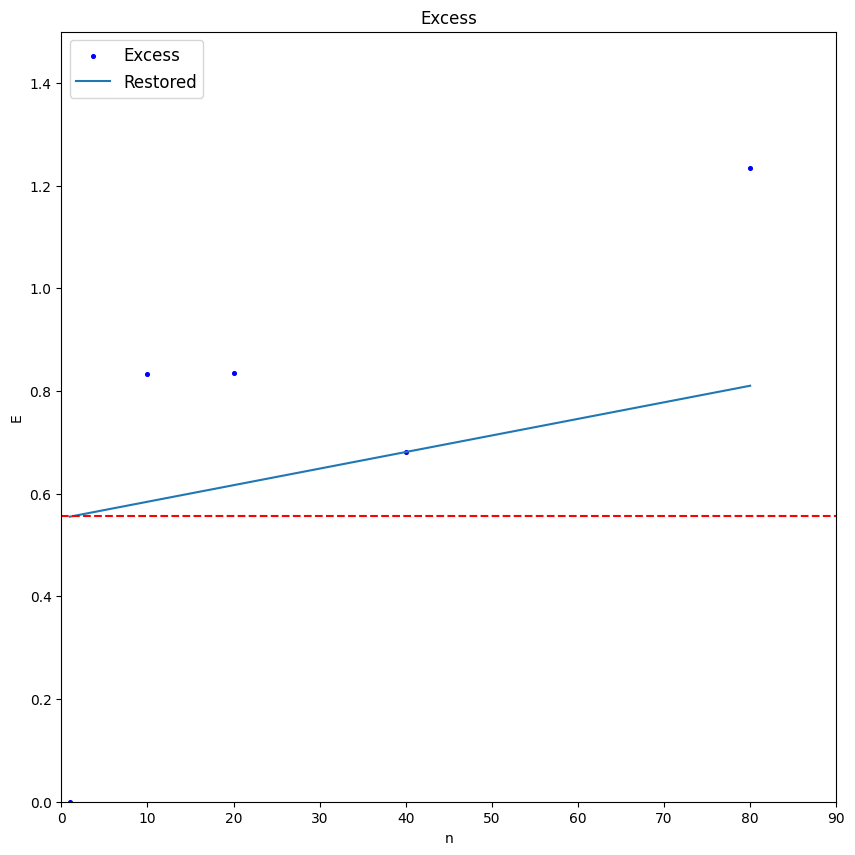

In [ ]:
# многочлен 1-й степени

b0, b1 = [0.55204385, 0.00322908]

xx = np.arange (1,81)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='b',label='Excess')
plt.plot(xx, b0 + b1*xx , label = 'Restored')
plt.legend(loc= 'upper left',fontsize=12)
plt.title('Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.hlines(0.556, 0, 90, color='red',linestyle='--')
plt.xlim([0, 90])
plt.ylim([0, 1.5])
plt.show()

##### 2-я степень

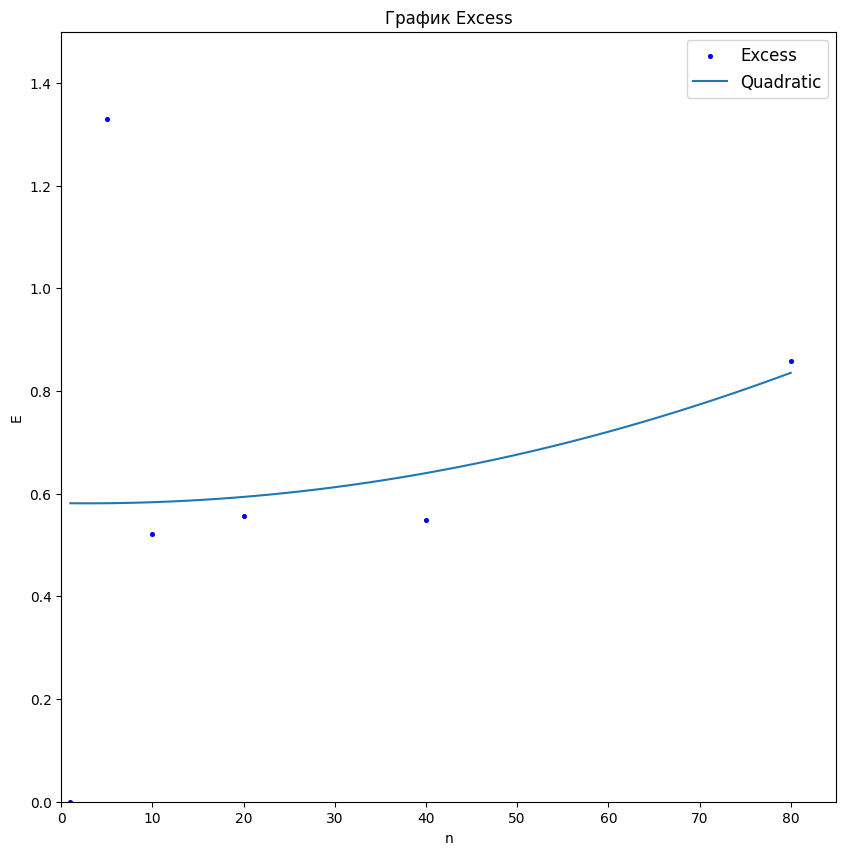

In [ ]:
# многочлен 2-й степени

b0, b1, b2 = [ 5.81670135e-01, -2.46793548e-04,  4.27491186e-05]

xx = np.arange (1,81)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='b',label='Excess')
plt.plot(xx, b0 + b1*xx + b2*xx**2 , label = 'Quadratic')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Excess')
plt.xlabel('n')
plt.ylabel('E')
#plt.hlines(0.556, 0, 90, color='red',linestyle='--')
plt.xlim([0, 85])
plt.ylim([0, 1.5])
plt.show()

In [ ]:
from sympy import *

x = Symbol('x', real=True)
f = b0 + b1*x + b2*x**2
fprime = f.diff(x)

solve(fprime, x)

[2.88653375885041]

In [ ]:
import numpy as np

# Задаем функцию
def f(x):
    return  5.81670135e-01 -2.46793548e-04*x + 4.27491186e-05*x**2

# Создаем массив значений x

x = np.arange(0,81)

# Вычисляем значения функции y
y = f(x)

# Находим экстремумы (корни производной)
derivative = np.gradient(y, x)
extrema_indices = np.where(np.diff(np.sign(derivative)))[0]
extrema_x = x[extrema_indices]
extrema_y = y[extrema_indices]

# Выводим экстремумы
for i, (ex, ey) in enumerate(zip(extrema_x, extrema_y)):
    print(f'Экстремум {i + 1}: x = {ex}, y = {ey}')

Экстремум 1: x = 2, y = 0.5813475443784


##### 3-я степень

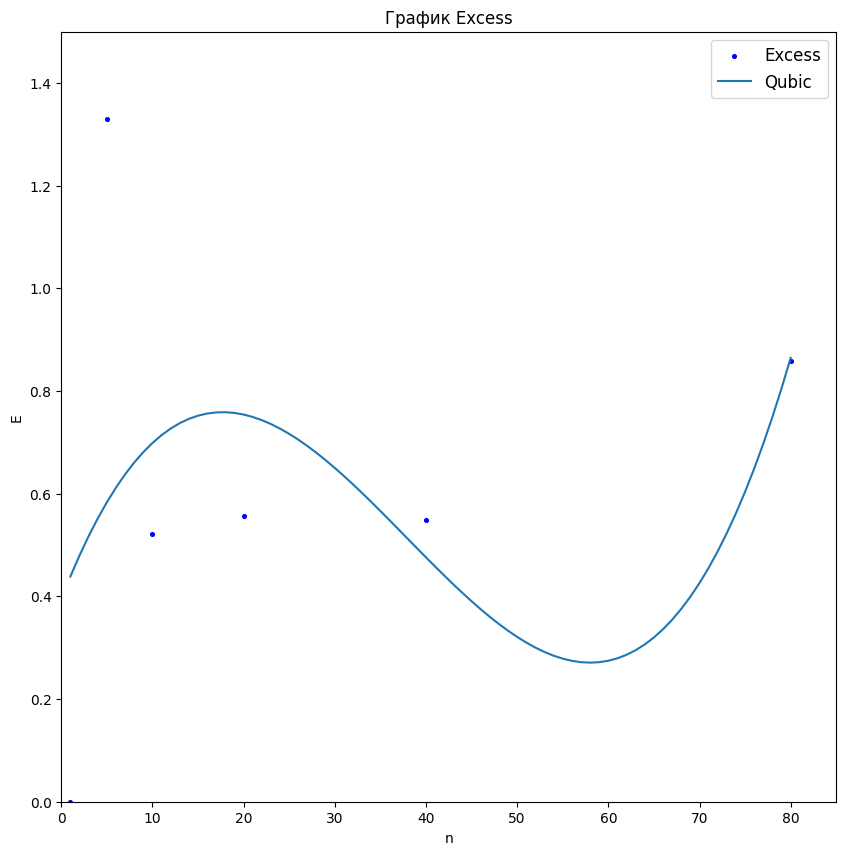

In [ ]:
# многочлен 3-й степени

b0, b1, b2, b3 = [ 3.94588498e-01,  4.58424832e-02, -1.69076451e-03,  1.48899551e-05]

xx = np.arange (1,81)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='b',label='Excess')
plt.plot(xx, b0 + b1*xx + b2*xx**2 + b3*xx**3 , label = 'Qubic')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Excess')
plt.xlabel('n')
plt.ylabel('E')
# plt.hlines(0.556, 0, 90, color='red',linestyle='--')
plt.xlim([0, 85])
plt.ylim([0, 1.5])
plt.show()

In [ ]:
from sympy import *

x = Symbol('x', real=True)
f = b0 + b1*x + b2*x**2 + b3*x**3
fprime = f.diff(x)

solve(fprime, x)

[17.6911372594720, 58.0093153228195]

In [ ]:
import sympy as sp

def f(x):
  z = b0 + b1*x + b2*x**2 + b3*x**3
  return z

# Объявляем символьную переменную x
x = sp.Symbol ("x")
# Вывод функции
print("f(x) =", f(x))
# Находим производную функции f(x) и сохраняем ее в переменной d_f:
d_f = sp.diff(f(x), x)
print("Первая производная функции:",d_f)

# Решаем уравнение d_f = 0:
x_extr = sp.solve (d_f)
print ("точка экстремума:", x_extr)

# Сохраняем точки экстремума в переменные:
x_0 = x_extr[0]
x_1 = x_extr[1]

# Находим вторую производную функции:
d2_f = sp.diff(f(x), x, 2)
print("Вторая производная функции:", d2_f)

# Решаем уравнение d2_f = 0
x_extr2 = sp.solve (d2_f)
print ("точка перегиба:", x_extr2)

# Находим значение второй производной в точках экстремума x_0 и x_1,
# Сохраняем их в переменные f_0_d2 и f_1_d2:
f_0_d2 = d2_f.evalf(subs = {x : x_0})
f_1_d2 = d2_f.evalf(subs = {x : x_1})

# Определяем, является ли точка x_0 точкой лок.минимума, максимума или перегиба
if f_0_d2 > 0:
  print(x_0, "- локальный минимум")
elif f_0_d2 < 0:
  print(x_0, "- локальный максимум")
else:
  print(x_0, "- точка перегиба")

# Определяем, является ли точка x_1 точкой лок.минимума, максимума или перегиба
if f_1_d2 > 0:
  print(x_1, "- локальный минимум")
elif f_1_d2 < 0:
  print(x_1, "- локальный максимум")
else:
  print(x_1, "- точка перегиба")

f(x) = 1.48899551e-5*x**3 - 0.00169076451*x**2 + 0.0458424832*x + 0.394588498
Первая производная функции: 4.46698653e-5*x**2 - 0.00338152902*x + 0.0458424832
точка экстремума: [17.6911372594720, 58.0093153228195]
Вторая производная функции: 8.93397306e-5*x - 0.00338152902
точка перегиба: [37.8502262911458]
17.6911372594720 - локальный максимум
58.0093153228195 - локальный минимум


##### Экпонента

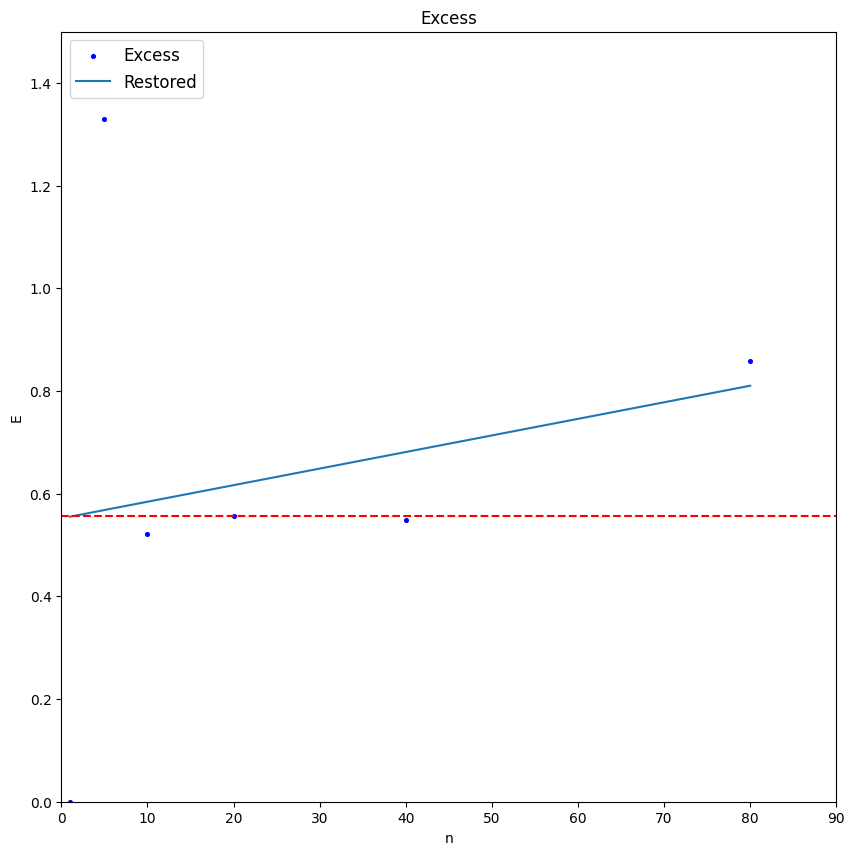

In [ ]:
# Экспонента

b0, b1, b2 = [ 260.05554592, -259.50350965,    0.99998755]

xx = np.arange (1,81)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='b',label='Excess')
plt.plot(xx, b0 + b1*np.power(b2,xx) , label = 'Restored')
plt.legend(loc= 'upper left',fontsize=12)
plt.title('Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.hlines(0.556, 0, 90, color='red',linestyle='--')
plt.xlim([0, 90])
plt.ylim([0, 1.5])
plt.show()

### График Approx

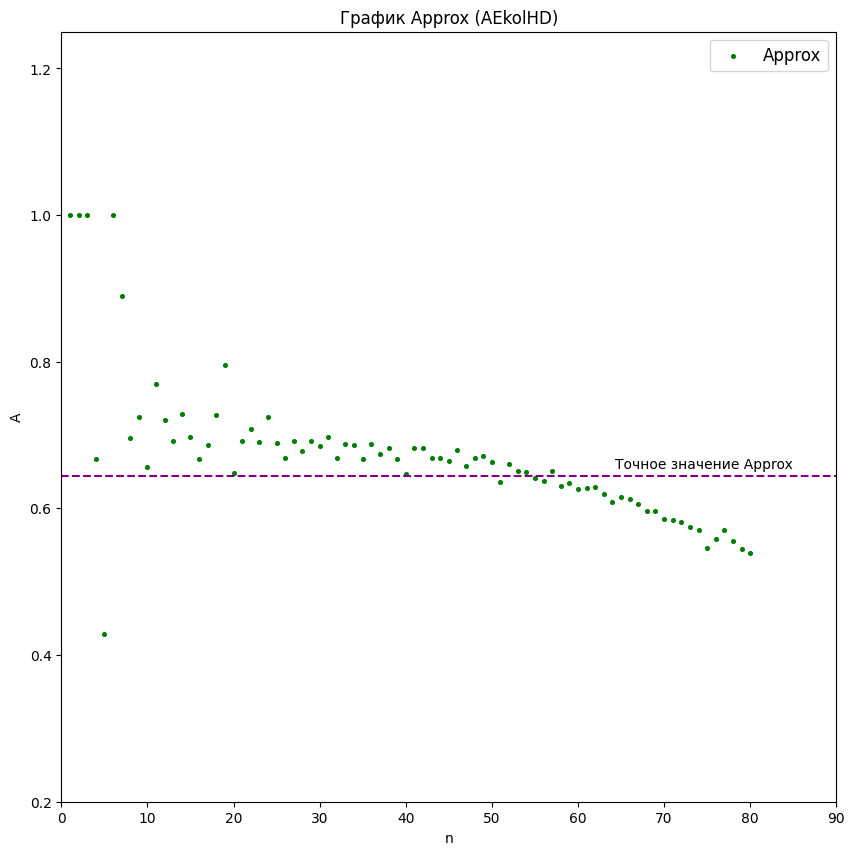

In [ ]:
Approx = [1, 1, 1, 0.667, 0.429, 1, 0.889, 0.696, 0.724, 0.657, 0.769, 0.721, 0.692, 0.729, 0.697, 0.667, 0.687, 0.727, 0.796, 0.648,
          0.692, 0.708, 0.691, 0.724, 0.689, 0.669, 0.692, 0.678, 0.692, 0.685, 0.698, 0.669, 0.688, 0.686, 0.668, 0.688, 0.674, 0.683, 0.667, 0.647,
          0.683, 0.683, 0.669, 0.669, 0.664, 0.679, 0.658, 0.669, 0.671, 0.663, 0.636, 0.66, 0.651, 0.649, 0.642, 0.638, 0.651, 0.631, 0.634, 0.627,
          0.628, 0.629, 0.619, 0.609, 0.616, 0.613, 0.606, 0.597, 0.597, 0.586, 0.584, 0.582, 0.575, 0.57, 0.546, 0.558, 0.571, 0.556, 0.544, 0.539]

n = list(range(1, 81))

plt.figure(figsize=(10,10))
plt.scatter(n,Approx,marker='o',s=7,color='g',label='Approx')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Approx (AEkolHD)')
plt.xlabel('n')
plt.ylabel('A')
plt.hlines(0.644, 0, 90, color='purple',linestyle='--')
plt.text(85, 0.66, 'Точное значение Approx', ha='right', va='center')
plt.xlim([0, 90])
plt.ylim([0.2, 1.25])
plt.show()

### Среднее Approx

[1.0, 1.0, 1.0, 0.91675, 0.8192, 0.8493333333333334, 0.8550000000000001, 0.835125, 0.8227777777777778, 0.8062000000000001, 0.802818181818182, 0.7960000000000002, 0.7880000000000001, 0.7837857142857143, 0.778, 0.7710625, 0.7661176470588235, 0.7639444444444444, 0.7656315789473683, 0.7597499999999999, 0.7565238095238095, 0.7543181818181818, 0.7515652173913042, 0.7504166666666666, 0.74796, 0.7449230769230769, 0.7429629629629629, 0.7406428571428572, 0.7389655172413793, 0.7371666666666666, 0.7359032258064516, 0.7338125, 0.7324242424242424, 0.7310588235294118, 0.7292571428571428, 0.728111111111111, 0.7266486486486485, 0.7254999999999999, 0.724, 0.722075, 0.7211219512195123, 0.7202142857142858, 0.7190232558139535, 0.7178863636363637, 0.716688888888889, 0.7158695652173914, 0.7146382978723406, 0.7136875000000001, 0.7128163265306123, 0.71182, 0.7103333333333334, 0.7093653846153847, 0.7082641509433963, 0.7071666666666667, 0.7059818181818184, 0.7047678571428572, 0.7038245614035088, 0.70256896551724

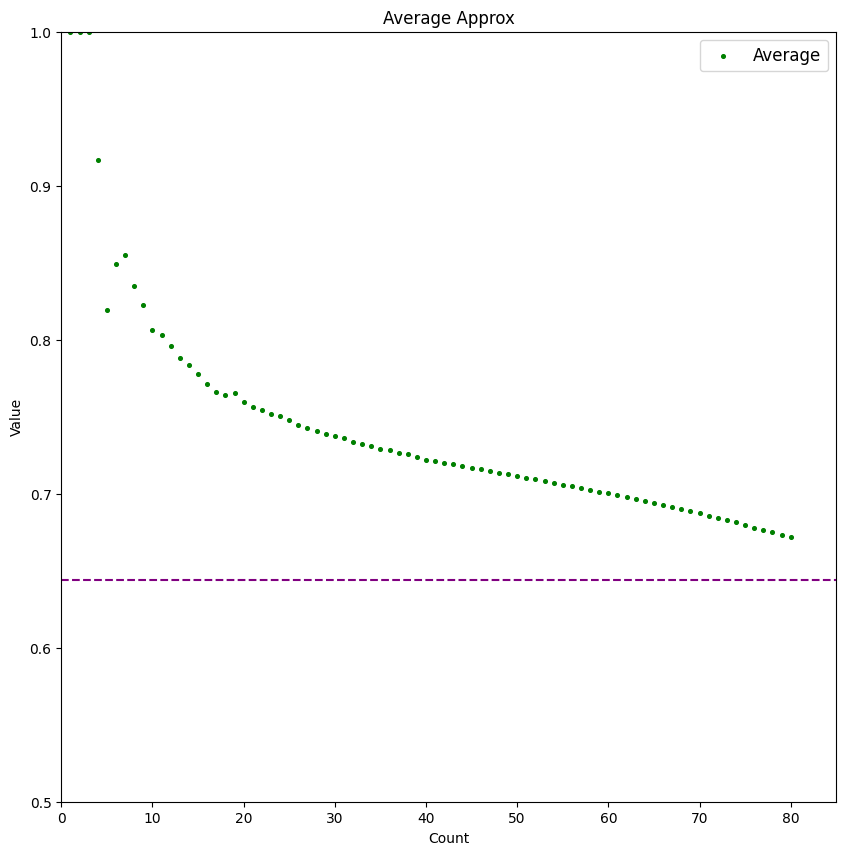

In [ ]:
nn = np.arange(1,81)

av = []
for i in nn:
  av.append(np.mean(Approx[0:i]))

print(av)

plt.figure(figsize=(10,10))
plt.scatter(nn,av,marker='o',s=7,color='g',label='Average')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Average Approx')
plt.xlabel('Count')
plt.ylabel('Value')
plt.hlines(0.644, 0, 85, color='purple',linestyle='--')
plt.xlim([0, 85])
plt.ylim([0.5, 1])
plt.show()

### Аппроксимация МНК (Approx)

In [ ]:
x = np.array(n)
y = np.array(Approx)

linear_func = lambda x, b0, b1: b0 + b1*x
quadratic_func = lambda x, b0, b1, b2: b0 + b1*x + b2*x**2
qubic_func = lambda x, b0, b1, b2, b3: b0 + b1*x + b2*x**2 + b3*x**3
exp_func = lambda x, b0, b1, b2: b0 + b1*np.exp(b2*x)
exp1_func = lambda x, b0, b1, b2: b0 + b1*np.exp(x-b2)
exp2_func = lambda x, b0, b1: b0*np.power(b1,x)
exp3_func = lambda x, b0, b1, b2:  b0 + b1*np.power(b2,x)


from scipy.optimize import leastsq

# list of model
model_list = [
    'linear', 'quadratic',
    'qubic', 'EXP']

# model reference
models_dict = {
        'linear':             linear_func,
        'quadratic':          quadratic_func,
        'qubic':              qubic_func,
        'EXP':                exp3_func}

# initial values
p0_dict = {
        'linear':             [0, 0],
        'quadratic':          [0, 0, 0],
        'qubic':              [0, 0, 0, 0],
        'EXP':                [1, 1, 1]}

# titles (formulas)
formulas_dict = {
        'linear':             'y = b0 + b1*x',
        'quadratic':          'y = b0 + b1*x + b2*x^2',
        'qubic':              'y = b0 + b1*x + b2*x^2 + b3*x^3',
        'EXP':                'y = b0 +b1*b2^x'}

# actual data
X_fact = x
Y_fact = y

# function for calculating residuals
residual_func = lambda p, x, y: y - func(x, *p)

# return all optional outputs
full_output = True

# variables to save the calculation results
calculation_results_df = pd.DataFrame(columns=['func', 'p0', 'popt', 'cov_x', 'SSE', 'MSE', 'pcov', 'perr', 'Y_calc', 'error_metrics'])
error_metrics_results_df = pd.DataFrame(columns=['MSE', 'RMSE', 'MAE', 'MSPE', 'MAPE', 'RMSLE', 'R2'])

# calculations
for func_name in model_list:
    print(f'{func_name.upper()} MODEL: {formulas_dict[func_name]}')
    func = models_dict[func_name]
    calculation_results_df.loc[func_name, 'func'] = func
    p0 = p0_dict[func_name]
    print(f'p0 = {p0}')
    calculation_results_df.loc[func_name, 'p0'] = p0
    if full_output:
        (popt, cov_x, infodict, mesg, ier) = leastsq(residual_func, p0, args=(X_fact, Y_fact), full_output=full_output)
        integer_flag = f'ier = {ier}, the solution was found' if ier<=4 else f'ier = {ier}, the solution was not found'
        print(integer_flag, '\n', mesg)
        calculation_results_df.loc[func_name, 'popt'] = popt
        print(f'parameters = {popt}')
        calculation_results_df.loc[func_name, 'cov_x'] = cov_x
        print(f'cov_x = \n{cov_x}')
        #SSE = (residual_func(popt, X_fact, Y_fact)**2).sum()
        SSE = (infodict['fvec']**2).sum()
        calculation_results_df.loc[func_name, 'SSE'] = SSE
        print(f'SSE = {SSE}')
        MSE = SSE / (len(Y_fact)-len(p0))
        calculation_results_df.loc[func_name, 'MSE'] = MSE
        print(f'MSE = {MSE}')
        pcov = cov_x * MSE
        calculation_results_df.loc[func_name, 'pcov'] = pcov
        print(f'pcov =\n {pcov}')
        perr = np.sqrt(np.diag(pcov))
        calculation_results_df.loc[func_name, 'perr'] = perr
        print(f'perr = {perr}\n')
    else:
        popt = leastsq(residual_func, p0, args=(X_fact, Y_fact), full_output=full_output)
        calculation_results_df.loc[func_name, 'popt'] = popt
        print(f'parameters = {popt}\n')
    Y_calc = func(X_fact, *popt)
    calculation_results_df.loc[func_name, 'Y_calc'] = Y_calc
    (error_metrics_dict, error_metrics_df) = regression_error_metrics(Yfact=Y_fact, Ycalc=Y_calc, model_name=func_name)
    calculation_results_df.loc[func_name, 'error_metrics'] = error_metrics_dict.values()
    error_metrics_results_df = pd.concat([error_metrics_results_df, error_metrics_df])

LINEAR MODEL: y = b0 + b1*x
p0 = [0, 0]
ier = 2, the solution was found 
 The relative error between two consecutive iterates is at most 0.000000
parameters = [ 0.7887943  -0.00289153]
cov_x = 
[[ 5.09493674e-02 -9.49367087e-04]
 [-9.49367087e-04  2.34411625e-05]]
SSE = 0.40003622415611817
MSE = 0.005128669540463053
pcov =
 [[ 2.61302468e-04 -4.86899006e-06]
 [-4.86899006e-06  1.20221976e-07]]
perr = [0.01616485 0.00034673]

QUADRATIC MODEL: y = b0 + b1*x + b2*x^2
p0 = [0, 0, 0]
ier = 1, the solution was found 
 Both actual and predicted relative reductions in the sum of squares
  are at most 0.000000
parameters = [ 8.08479856e-01 -4.33193231e-03  1.77827937e-05]
cov_x = 
[[ 1.18317926e-01 -5.87877397e-03  6.08568748e-05]
 [-5.87877397e-03  3.84129483e-04 -4.45294221e-06]
 [ 6.08568748e-05 -4.45294221e-06  5.49745950e-08]]
SSE = 0.39428397054291364
MSE = 0.005120571046011865
pcov =
 [[ 6.05855345e-04 -3.01026798e-05  3.11621951e-07]
 [-3.01026798e-05  1.96696231e-06 -2.28016069e-08]
 [

#### 1 степень

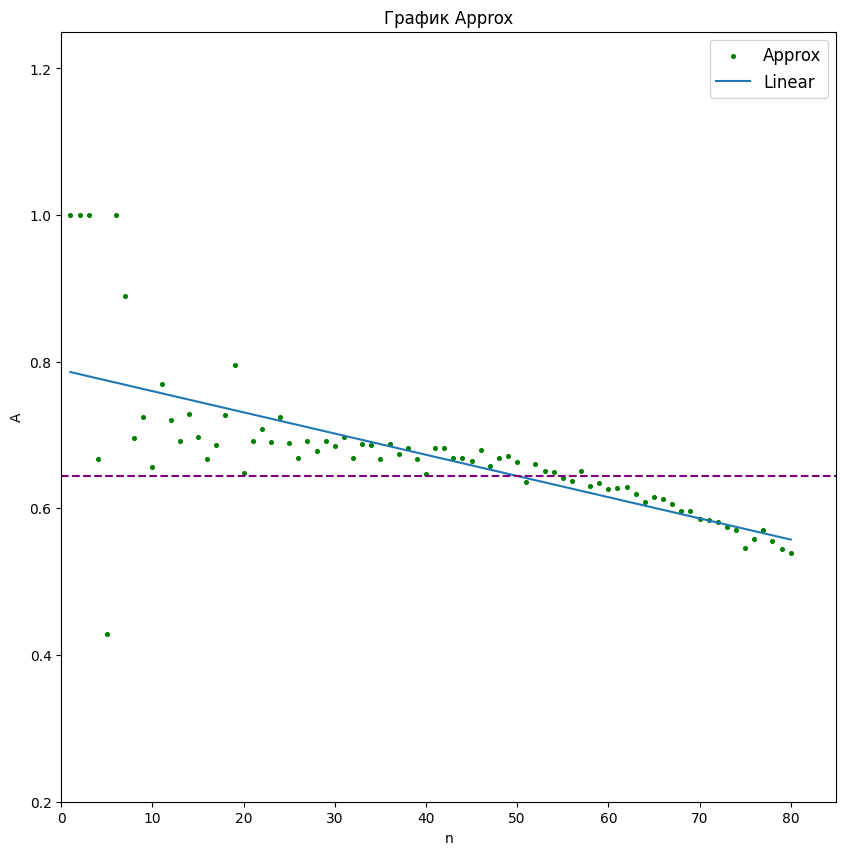

In [ ]:
b0, b1 = [ 0.7887943,  -0.00289153]

xx = np.arange (1,81)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='g',label='Approx')
plt.plot(xx, b0 + b1*xx , label = 'Linear')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Approx')
plt.xlabel('n')
plt.ylabel('A')
plt.hlines(0.644, 0, 85, color='purple',linestyle='--')
plt.xlim([0, 85])
plt.ylim([0.2, 1.25])
plt.show()

#### 2 степень

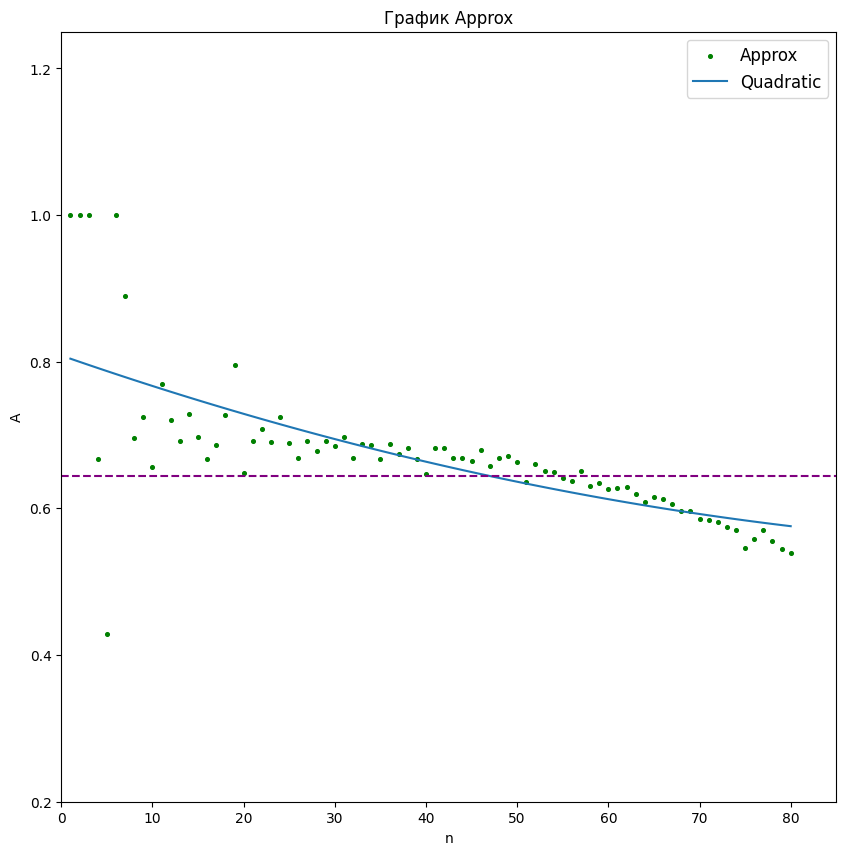

In [ ]:
b0, b1, b2 = [ 8.08479856e-01, -4.33193231e-03,  1.77827937e-05]

xx = np.arange (1,81)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='g',label='Approx')
plt.plot(xx, b0 + b1*xx + b2*xx**2 , label = 'Quadratic')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Approx')
plt.xlabel('n')
plt.ylabel('A')
plt.hlines(0.644, 0, 85, color='purple',linestyle='--')
plt.xlim([0, 85])
plt.ylim([0.2, 1.25])
plt.show()

#### 3 степень

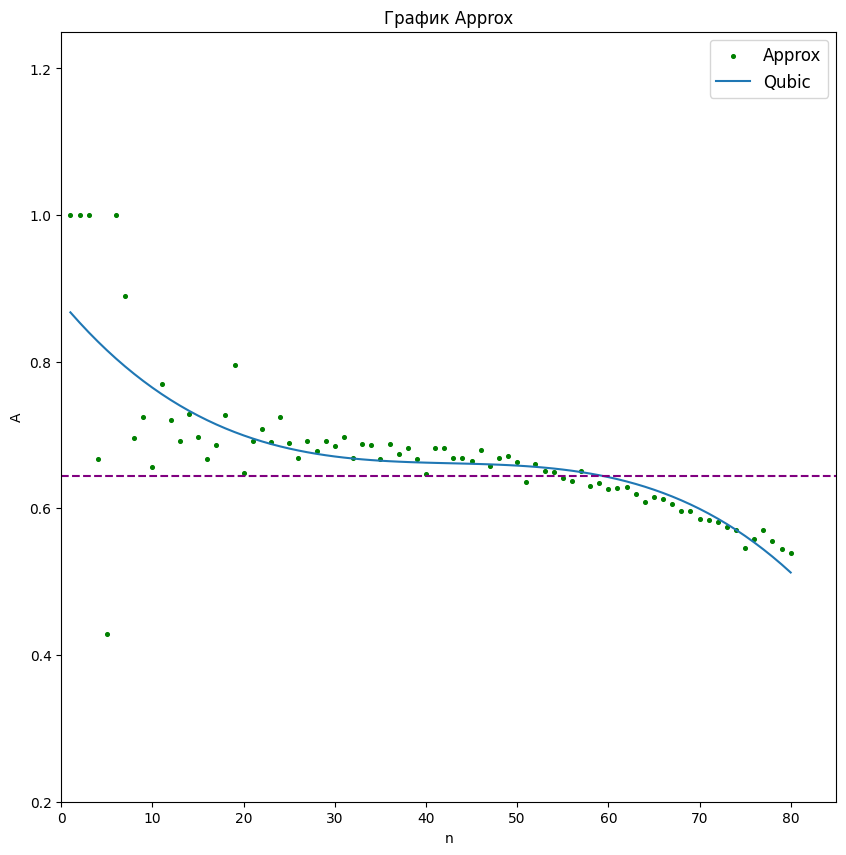

In [ ]:
b0, b1, b2, b3 =[ 8.81878530e-01, -1.48796148e-02,  3.41315000e-04, -2.66281652e-06]

xx = np.arange (1,81)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='g',label='Approx')
plt.plot(xx, b0 + b1*xx + b2*xx**2 + b3*xx**3 , label = 'Qubic')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Approx')
plt.xlabel('n')
plt.ylabel('A')
plt.hlines(0.644, 0, 85, color='purple',linestyle='--')
plt.xlim([0, 85])
plt.ylim([0.2, 1.25])
plt.show()

#### EXP

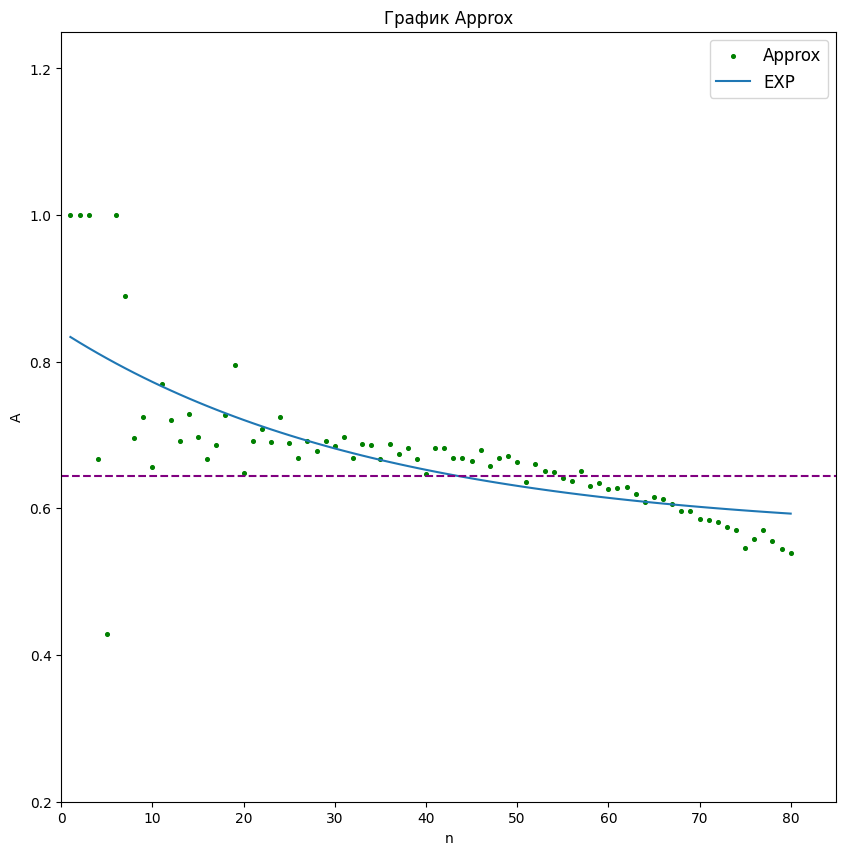

In [ ]:
b0, b1, b2 = [0.56528931, 0.27630971, 0.97160896]

xx = np.arange (1,81)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='g',label='Approx')
plt.plot(xx, b0 + b1*np.power(b2,xx) , label = 'EXP')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Approx')
plt.xlabel('n')
plt.ylabel('A')
plt.hlines(0.644, 0, 85, color='purple',linestyle='--')
plt.xlim([0, 85])
plt.ylim([0.2, 1.25])
plt.show()

### Несколько точек (Approx)

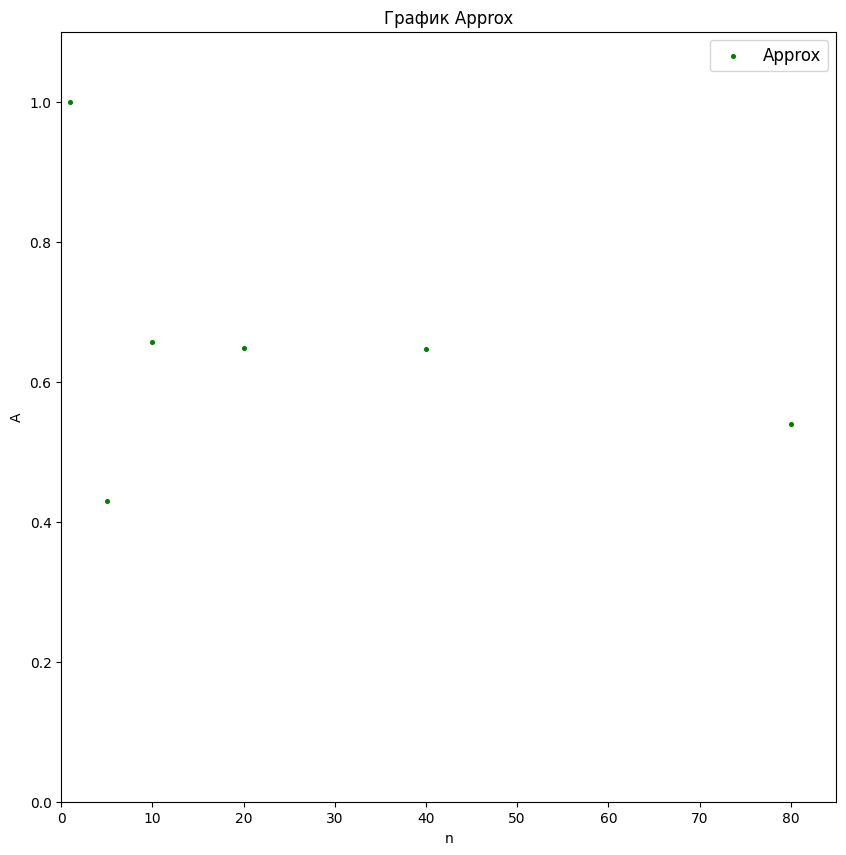

In [ ]:
Approx = [1, 0.429, 0.657, 0.648, 0.647, 0.539]
n = [1, 5, 10, 20, 40, 80]

plt.figure(figsize=(10,10))
plt.scatter(n,Approx,marker='o',s=7,color='g',label='Approx')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Approx')
plt.xlabel('n')
plt.ylabel('A')
# plt.hlines(0.337, 0, 110, color='red',linestyle='--')
plt.xlim([0, 85])
plt.ylim([0, 1.1])
plt.show()

In [ ]:
x = np.array(n)
y = np.array(Approx)

from scipy.optimize import leastsq

linear_func = lambda x, b0, b1: b0 + b1*x
quadratic_func = lambda x, b0, b1, b2: b0 + b1*x + b2*x**2
qubic_func = lambda x, b0, b1, b2, b3: b0 + b1*x + b2*x**2 + b3*x**3
exp_func = lambda x, b0, b1, b2: b0 + b1*np.exp(b2*x)
exp1_func = lambda x, b0, b1, b2: b0 + b1*np.exp(x-b2)
exp2_func = lambda x, b0, b1, b2: b0 + b1*np.power(b2,x)
exp3_func = lambda x, b0, b1, b2, b3:  b0 + b1*np.power(b2,(x-b3))

# list of model
model_list = [
    'linear', 'quadratic',
    'qubic', 'exp2']

# model reference
models_dict = {
        'linear':             linear_func,
        'quadratic':          quadratic_func,
        'qubic':              qubic_func,
        'exp2':               exp2_func}

# initial values
p0_dict = {
        'linear':             [0, 0],
        'quadratic':          [0, 0, 0],
        'qubic':              [0, 0, 0, 0],
        'exp2':               [1, 1, 1]}

# titles (formulas)
formulas_dict = {
        'linear':             'y = b0 + b1*x',
        'quadratic':          'y = b0 + b1*x + b2*x^2',
        'qubic':              'y = b0 + b1*x + b2*x^2 + b3*x^3',
        'exp2':               'y = b0 + b1*np.power(b2,x)'}

# actual data
X_fact = x
Y_fact = y

# function for calculating residuals
residual_func = lambda p, x, y: y - func(x, *p)

# return all optional outputs
full_output = True

# variables to save the calculation results
calculation_results_df = pd.DataFrame(columns=['func', 'p0', 'popt', 'cov_x', 'SSE', 'MSE', 'pcov', 'perr', 'Y_calc', 'error_metrics'])
error_metrics_results_df = pd.DataFrame(columns=['MSE', 'RMSE', 'MAE', 'MSPE', 'MAPE', 'RMSLE', 'R2'])

# calculations
for func_name in model_list:
    print(f'{func_name.upper()} MODEL: {formulas_dict[func_name]}')
    func = models_dict[func_name]
    calculation_results_df.loc[func_name, 'func'] = func
    p0 = p0_dict[func_name]
    print(f'p0 = {p0}')
    calculation_results_df.loc[func_name, 'p0'] = p0
    if full_output:
        (popt, cov_x, infodict, mesg, ier) = leastsq(residual_func, p0, args=(X_fact, Y_fact), full_output=full_output)
        integer_flag = f'ier = {ier}, the solution was found' if ier<=4 else f'ier = {ier}, the solution was not found'
        print(integer_flag, '\n', mesg)
        calculation_results_df.loc[func_name, 'popt'] = popt
        print(f'parameters = {popt}')
        calculation_results_df.loc[func_name, 'cov_x'] = cov_x
        print(f'cov_x = \n{cov_x}')
        #SSE = (residual_func(popt, X_fact, Y_fact)**2).sum()
        SSE = (infodict['fvec']**2).sum()
        calculation_results_df.loc[func_name, 'SSE'] = SSE
        print(f'SSE = {SSE}')
        MSE = SSE / (len(Y_fact)-len(p0))
        calculation_results_df.loc[func_name, 'MSE'] = MSE
        print(f'MSE = {MSE}')
        pcov = cov_x * MSE
        calculation_results_df.loc[func_name, 'pcov'] = pcov
        print(f'pcov =\n {pcov}')
        perr = np.sqrt(np.diag(pcov))
        calculation_results_df.loc[func_name, 'perr'] = perr
        print(f'perr = {perr}\n')
    else:
        popt = leastsq(residual_func, p0, args=(X_fact, Y_fact), full_output=full_output)
        calculation_results_df.loc[func_name, 'popt'] = popt
        print(f'parameters = {popt}\n')
    Y_calc = func(X_fact, *popt)
    calculation_results_df.loc[func_name, 'Y_calc'] = Y_calc
    (error_metrics_dict, error_metrics_df) = regression_error_metrics(Yfact=Y_fact, Ycalc=Y_calc, model_name=func_name)
    calculation_results_df.loc[func_name, 'error_metrics'] = error_metrics_dict.values()
    error_metrics_results_df = pd.concat([error_metrics_results_df, error_metrics_df])

LINEAR MODEL: y = b0 + b1*x
p0 = [0, 0]
ier = 2, the solution was found 
 The relative error between two consecutive iterates is at most 0.000000
parameters = [ 0.71292394 -0.00229195]
cov_x = 
[[ 3.17897097e-01 -5.81655489e-03]
 [-5.81655489e-03  2.23713644e-04]]
SSE = 0.16017634340044742
MSE = 0.040044085850111856
pcov =
 [[ 1.27298987e-02 -2.32918623e-04]
 [-2.32918623e-04  8.95840838e-06]]
perr = [0.11282685 0.00299306]

QUADRATIC MODEL: y = b0 + b1*x + b2*x^2
p0 = [0, 0, 0]
ier = 1, the solution was found 
 Both actual and predicted relative reductions in the sum of squares
  are at most 0.000000
parameters = [ 7.41731349e-01 -5.67174889e-03  4.15675265e-05]
cov_x = 
[[ 5.55248458e-01 -3.36635803e-02  3.42485080e-04]
 [-3.36635803e-02  3.49083972e-03 -4.01817399e-05]
 [ 3.42485080e-04 -4.01817399e-05  4.94187302e-07]]
SSE = 0.15667997878296042
MSE = 0.052226659594320136
pcov =
 [[ 2.89987722e-02 -1.75813635e-03  1.78868517e-05]
 [-1.75813635e-03  1.82314898e-04 -2.09855805e-06]
 [

3 степень

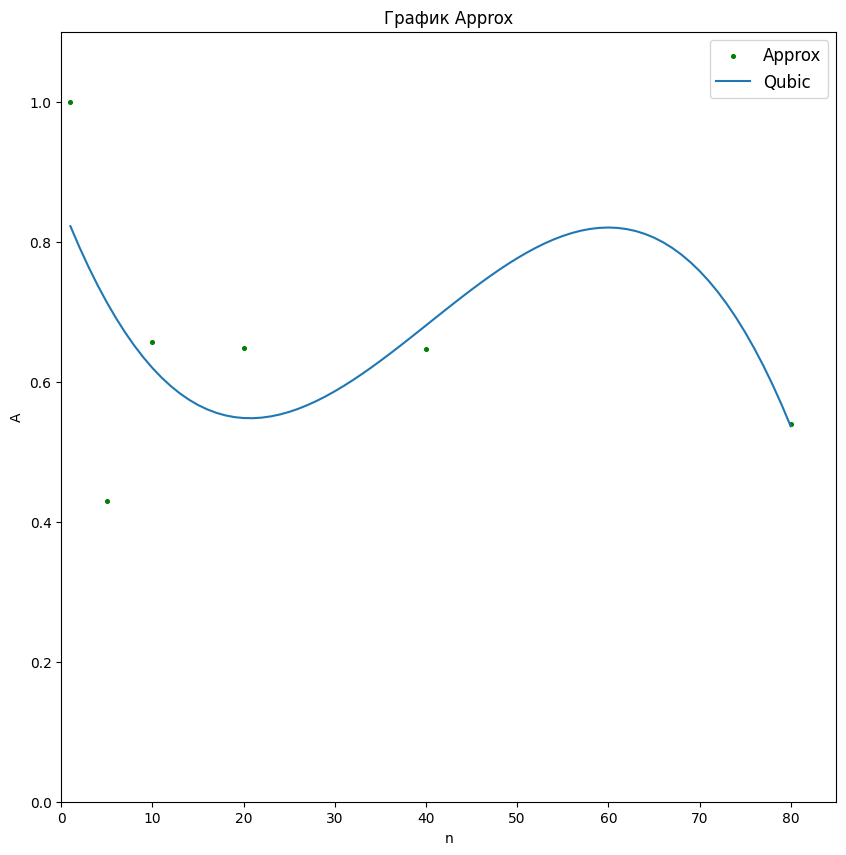

In [ ]:
b0, b1, b2, b3 =[ 8.54626162e-01, -3.34844218e-02,  1.08766005e-03, -8.98537535e-06]

xx = np.arange (1,81)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='g',label='Approx')
plt.plot(xx, b0 + b1*xx + b2*xx**2 + b3*xx**3 , label = 'Qubic')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Approx')
plt.xlabel('n')
plt.ylabel('A')
plt.xlim([0, 85])
plt.ylim([0, 1.1])
plt.show()

In [ ]:
from sympy import *

x = Symbol('x', real=True)
f = b0 + b1*x + b2*x**2 + b3*x**3
fprime = f.diff(x)

solve(fprime, x)

[20.7054061850098, 59.9931369203709]

In [ ]:
import sympy as sp

def f(x):
  z = b0 + b1*x + b2*x**2 + b3*x**3
  return z

# Объявляем символьную переменную x
x = sp.Symbol ("x")
# Вывод функции
print("f(x) =", f(x))
# Находим производную функции f(x) и сохраняем ее в переменной d_f:
d_f = sp.diff(f(x), x)
print("Первая производная функции:",d_f)

# Решаем уравнение d_f = 0:
x_extr = sp.solve (d_f)
print ("точка экстремума:", x_extr)

# Сохраняем точки экстремума в переменные:
x_0 = x_extr[0]
x_1 = x_extr[1]

# Находим вторую производную функции:
d2_f = sp.diff(f(x), x, 2)
print("Вторая производная функции:", d2_f)

# Решаем уравнение d2_f = 0
x_extr2 = sp.solve (d2_f)
print ("точка перегиба:", x_extr2)

# Находим значение второй производной в точках экстремума x_0 и x_1,
# Сохраняем их в переменные f_0_d2 и f_1_d2:
f_0_d2 = d2_f.evalf(subs = {x : x_0})
f_1_d2 = d2_f.evalf(subs = {x : x_1})

# Определяем, является ли точка x_0 точкой лок.минимума, максимума или перегиба
if f_0_d2 > 0:
  print(x_0, "- локальный минимум")
elif f_0_d2 < 0:
  print(x_0, "- локальный максимум")
else:
  print(x_0, "- точка перегиба")

# Определяем, является ли точка x_1 точкой лок.минимума, максимума или перегиба
if f_1_d2 > 0:
  print(x_1, "- локальный минимум")
elif f_1_d2 < 0:
  print(x_1, "- локальный максимум")
else:
  print(x_1, "- точка перегиба")

f(x) = -8.98537535e-6*x**3 + 0.00108766005*x**2 - 0.0334844218*x + 0.854626162
Первая производная функции: -2.695612605e-5*x**2 + 0.0021753201*x - 0.0334844218
точка экстремума: [20.7054061850098, 59.9931369203709]
Вторая производная функции: 0.0021753201 - 5.39122521e-5*x
точка перегиба: [40.3492715526903]
20.7054061850098 - локальный минимум
59.9931369203709 - локальный максимум


2 степень

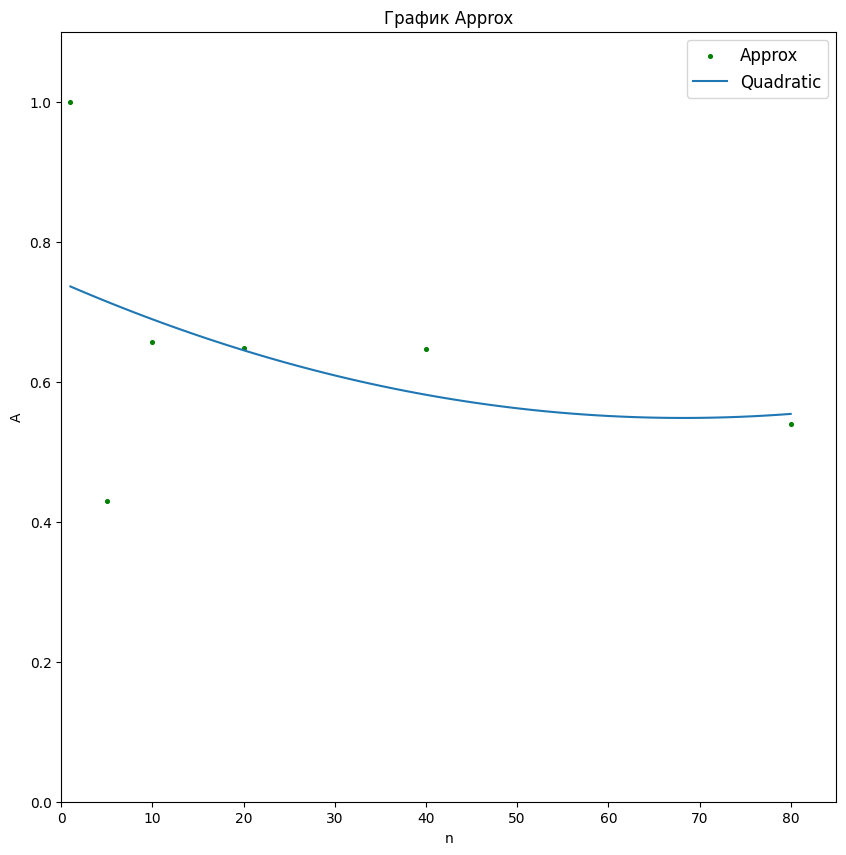

In [ ]:
b0, b1, b2 = [ 7.41731349e-01, -5.67174889e-03,  4.15675265e-05]

xx = np.arange (1,81)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='g',label='Approx')
plt.plot(xx, b0 + b1*xx + b2*xx**2 , label = 'Quadratic')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Approx')
plt.xlabel('n')
plt.ylabel('A')
plt.xlim([0, 85])
plt.ylim([0, 1.1])
plt.show()

In [ ]:
from sympy import *

x = Symbol('x', real=True)
f = b0 + b1*x + b2*x**2
fprime = f.diff(x)

solve(fprime, x)

[68.2233147791462]

### Сведенные графики Excess и Approx

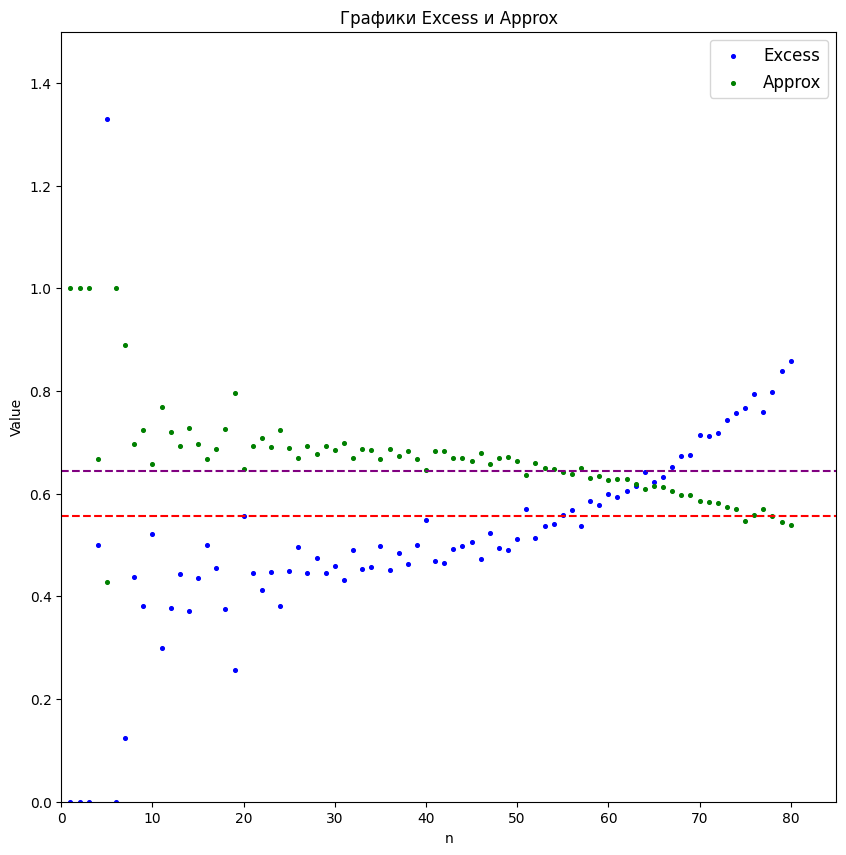

In [ ]:
Approx = [1, 1, 1, 0.667, 0.429, 1, 0.889, 0.696, 0.724, 0.657, 0.769, 0.721, 0.692, 0.729, 0.697, 0.667, 0.687, 0.727, 0.796, 0.648,
          0.692, 0.708, 0.691, 0.724, 0.689, 0.669, 0.692, 0.678, 0.692, 0.685, 0.698, 0.669, 0.688, 0.686, 0.668, 0.688, 0.674, 0.683, 0.667, 0.647,
          0.683, 0.683, 0.669, 0.669, 0.664, 0.679, 0.658, 0.669, 0.671, 0.663, 0.636, 0.66, 0.651, 0.649, 0.642, 0.638, 0.651, 0.631, 0.634, 0.627,
          0.628, 0.629, 0.619, 0.609, 0.616, 0.613, 0.606, 0.597, 0.597, 0.586, 0.584, 0.582, 0.575, 0.57, 0.546, 0.558, 0.571, 0.556, 0.544, 0.539]

Excess = [0, 0, 0, 0.5, 1.33, 0, 0.125, 0.438, 0.381, 0.522, 0.3, 0.378, 0.444, 0.372, 0.435, 0.5, 0.456,
     0.375, 0.257, 0.557, 0.446, 0.413, 0.447, 0.381, 0.449, 0.496, 0.445, 0.474, 0.445, 0.46, 0.432,
     0.491, 0.454, 0.458, 0.498, 0.452, 0.484, 0.464, 0.5, 0.548, 0.468, 0.465, 0.493, 0.498, 0.506,
     0.473, 0.523, 0.494, 0.49, 0.512, 0.571, 0.514, 0.538, 0.541, 0.559, 0.569, 0.537, 0.585, 0.579,
     0.599, 0.593, 0.606, 0.615, 0.643, 0.623, 0.633, 0.653, 0.674, 0.676, 0.714, 0.712, 0.718, 0.744,
     0.757, 0.767, 0.795, 0.759, 0.798, 0.84, 0.859]

n = list(range(1, 81))


plt.figure(figsize=(10,10))
plt.scatter(n,Excess,marker='o',s=7,color='b',label='Excess')
plt.scatter(n,Approx,marker='o',s=7,color='g',label='Approx')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Графики Excess и Approx')
plt.hlines(0.556, 0, 85, color='r',linestyle='--')
plt.hlines(0.644, 0, 85, color='purple',linestyle='--')
plt.xlabel('n')
plt.ylabel('Value')
plt.xlim([0, 85])
plt.ylim([0, 1.5])
plt.show()

# Работа с прямоугольником

In [ ]:
import random
import numpy as np

def generuj_body(x_min, x_max, y_min, y_max, n_points):

  points = np.empty((n_points, 2))
  for i in range(n_points):
    x = random.uniform(x_min, x_max)
    y = random.uniform(y_min, y_max)
    points[i] = [x, y]
  return points


## Малый прямоугольник

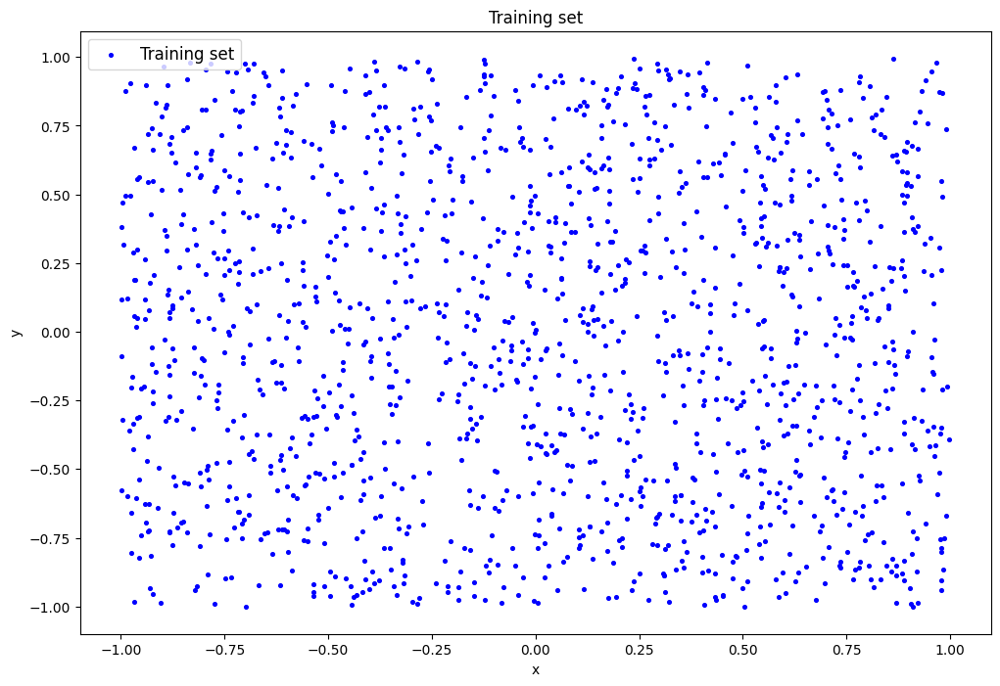

In [ ]:
# Пример использования
x_min = -1
x_max = 1
y_min = -1
y_max = 1
n_points = 1500

points = generuj_body(x_min, x_max, y_min, y_max, n_points)
data7 = points

plt.figure(figsize=(12,8))
plt.scatter(points[:,0],points[:,1],marker='o',s=7,color='b',label='Training set')
plt.legend(loc= 'upper left',fontsize=12)
plt.title('Training set')
plt.xlabel('x')
plt.ylabel('y')
plt.savefig('out/train_set.png')
plt.show()

In [ ]:
#### Обучение Автокодировщика
size = data7.shape[1]
patience = 700
verbose_show = True

ae_7 = tensorflow.keras.models.Sequential()

# input layer
ae_7.add(tensorflow.keras.layers.Dense(size))
ae_7.add(tensorflow.keras.layers.Activation('tanh'))

# hidden layers
ae_7.add(tensorflow.keras.layers.Dense(5))
ae_7.add(tensorflow.keras.layers.Activation('tanh'))
ae_7.add(tensorflow.keras.layers.Dense(3))
ae_7.add(tensorflow.keras.layers.Activation('tanh'))
ae_7.add(tensorflow.keras.layers.Dense(2))
ae_7.add(tensorflow.keras.layers.Activation('tanh'))
ae_7.add(tensorflow.keras.layers.Dense(3))
ae_7.add(tensorflow.keras.layers.Activation('tanh'))
ae_7.add(tensorflow.keras.layers.Dense(5))
ae_7.add(tensorflow.keras.layers.Activation('tanh'))

# output layer
ae_7.add(tensorflow.keras.layers.Dense(size))
ae_7.add(tensorflow.keras.layers.Activation('linear'))

optimizer = tensorflow.keras.optimizers.Adam(learning_rate=0.001, beta_1=0.9, beta_2=0.999, amsgrad=False)
ae_7.compile(loss='mean_squared_error', optimizer=optimizer)

error_stop = 0.0001
epo = 2000

early_stopping_callback_on_error = EarlyStoppingOnValue(monitor='loss', baseline=error_stop)
early_stopping_callback_on_improving = tensorflow.keras.callbacks.EarlyStopping(monitor='loss',
                                                                                           min_delta=0.0001, patience = patience,
                                                                                           verbose=1, mode='auto',
                                                                                           baseline=None,
                                                                                           restore_best_weights=False)

history_callback = tensorflow.keras.callbacks.History()
verbose = 1 if verbose_show else 0
history_object = ae_7.fit(data7, data7,
                                batch_size=data7.shape[0],
                                epochs=epo,
                                callbacks=[early_stopping_callback_on_error, history_callback,
                                early_stopping_callback_on_improving],
                                verbose=verbose)
ae7_trainned = ae_7
ae7_pred = ae7_trainned.predict(data7)
ae7_trainned.save('out/AE7.h5')

Epoch 1/2000
1/1 [==============================] - 3s 3s/step - loss: 0.4352
Epoch 2/2000
1/1 [==============================] - 0s 13ms/step - loss: 0.4278
Epoch 3/2000
1/1 [==============================] - 0s 14ms/step - loss: 0.4206
Epoch 4/2000
1/1 [==============================] - 0s 17ms/step - loss: 0.4137
Epoch 5/2000
1/1 [==============================] - 0s 21ms/step - loss: 0.4070
Epoch 6/2000
1/1 [==============================] - 0s 13ms/step - loss: 0.4005
Epoch 7/2000
1/1 [==============================] - 0s 14ms/step - loss: 0.3942
Epoch 8/2000
1/1 [==============================] - 0s 17ms/step - loss: 0.3882
Epoch 9/2000
1/1 [==============================] - 0s 16ms/step - loss: 0.3823
Epoch 10/2000
1/1 [==============================] - 0s 15ms/step - loss: 0.3767
Epoch 11/2000
1/1 [==============================] - 0s 19ms/step - loss: 0.3712
Epoch 12/2000
1/1 [==============================] - 0s 20ms/step - loss: 0.3660
Epoch 13/2000
1/1 [====================

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [ ]:
ae_7.save('best_model_for_data7')

In [ ]:
from keras.models import load_model
ae_7 = load_model('best_model_for_data7')

ae7_trainned = ae_7
ae7_pred = ae7_trainned.predict(data7)
ae7_trainned.save('out/AE7.h5')

47/47 [==============================] - 0s 3ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


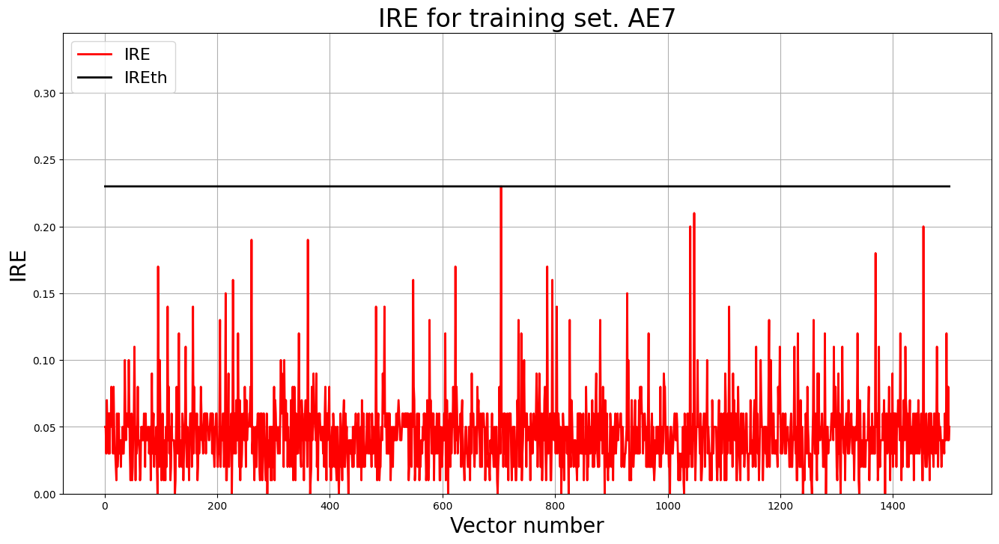

In [ ]:
irefile = 'out/AE7_ire_th.txt'
IRE_array = np.round(ire_array(data7, ae7_pred), 2)
IREth = np.amax(IRE_array)
with open(irefile, 'w') as file:
    file.write(str(IREth))

IRE_7 = IRE_array
IREth_7 = IREth
lib.ire_plot('training', IRE_7, IREth, 'AE7')

250/250 [==============================] - 1s 3ms/step


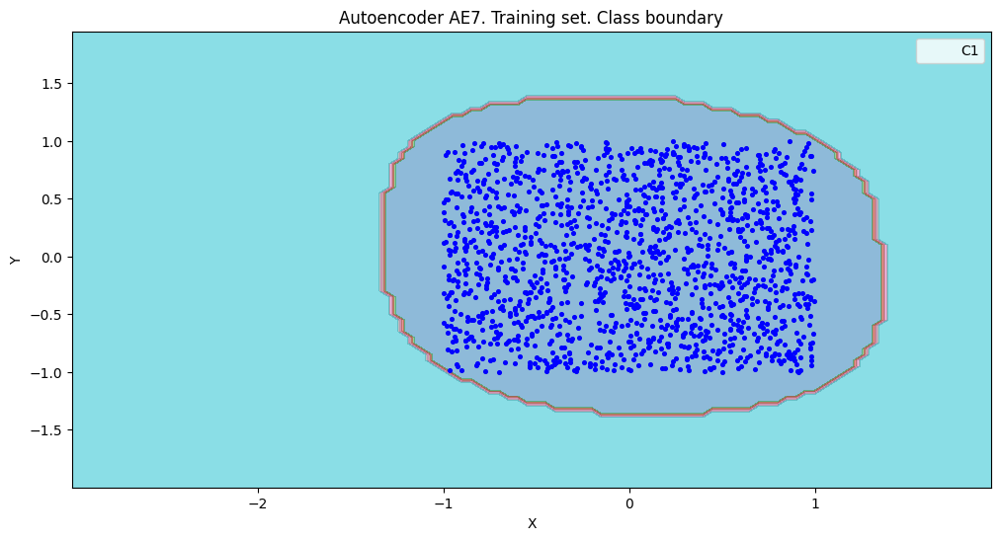

amount:  863
amount_ae:  2017


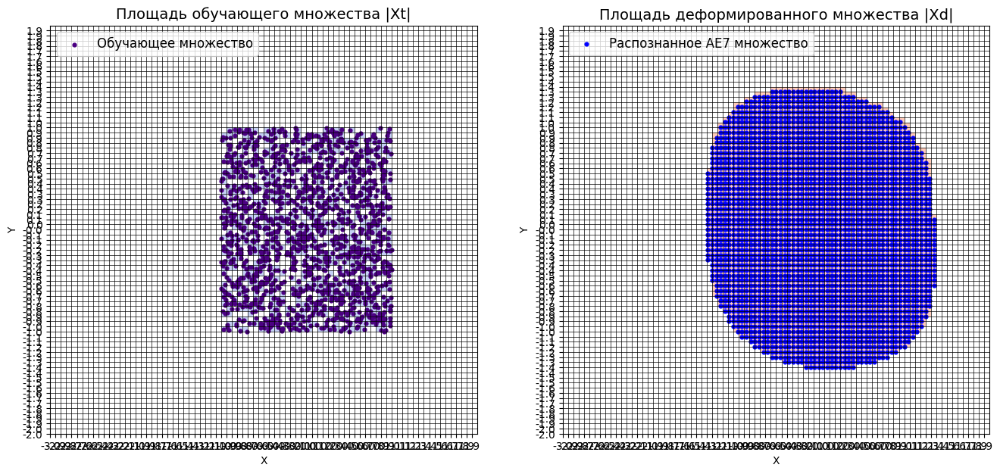

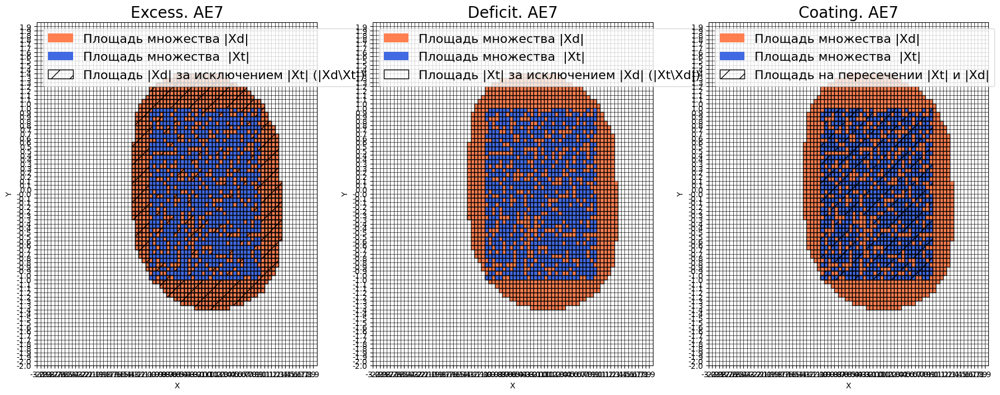


Оценка качества AE7
IDEAL = 0. Excess:  1.3371958285052143
IDEAL = 0. Deficit:  0.0
IDEAL = 1. Coating:  1.0
summa:  1.0
IDEAL = 1. Extrapolation precision (Approx):  0.4278631631135349




In [ ]:
# построение областей покрытия и границ классов
# расчет характеристик качества обучения
# параметр numb_square, отвечающий за количество элементов разбиения по каждой оси пространства признаков
numb_square = 80
xx, yy, Z3 = lib.square_calc(numb_square, data7, ae7_trainned, IREth_7, '7', True)

### Плотное покрытие

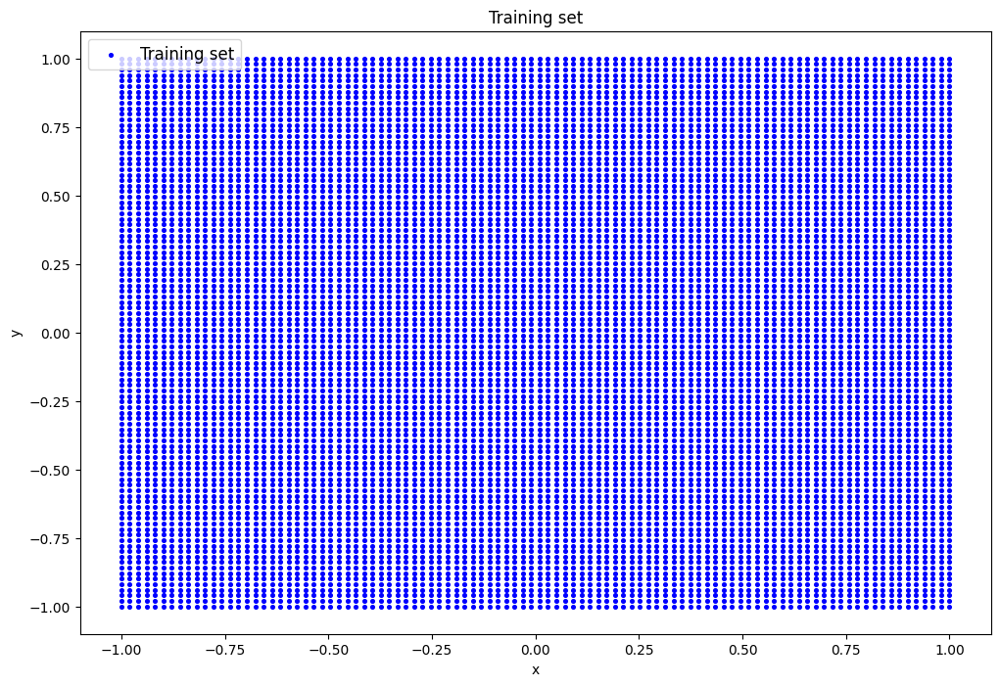

In [ ]:
def generuj_body(x_min, x_max, y_min, y_max, n_points_x, n_points_y):
    #n_points_x - число точек по x
    #n_points_y - число точек по y
    x = np.linspace(x_min, x_max, n_points_x)
    y = np.linspace(y_min, y_max, n_points_y)

    points = [[i, j] for i in x for j in y]

    return np.array(points)


# Пример использования
x_min, x_max = (-1, 1)
y_min, y_max = (-1, 1)
n_points_x = 100
n_points_y = 100

points = generuj_body(x_min, x_max, y_min, y_max, n_points_x, n_points_y)
data7 = points

plt.figure(figsize=(12,8))
plt.scatter(points[:,0],points[:,1],marker='o',s=7,color='b',label='Training set')
plt.legend(loc= 'upper left',fontsize=12)
plt.title('Training set')
plt.xlabel('x')
plt.ylabel('y')
plt.savefig('out/train_set.png')
plt.show()

2250/2250 [==============================] - 6s 2ms/step


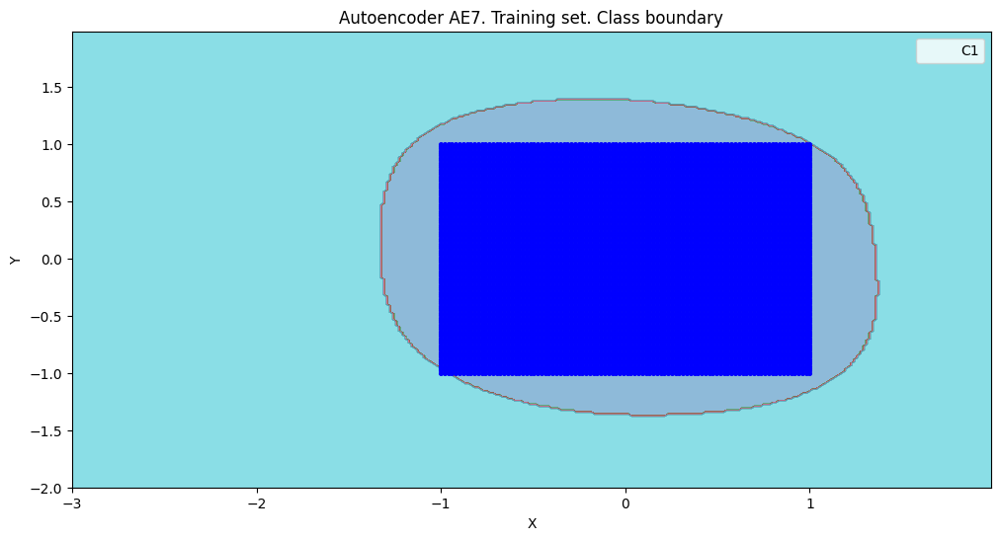

amount:  8100
amount_ae:  12634


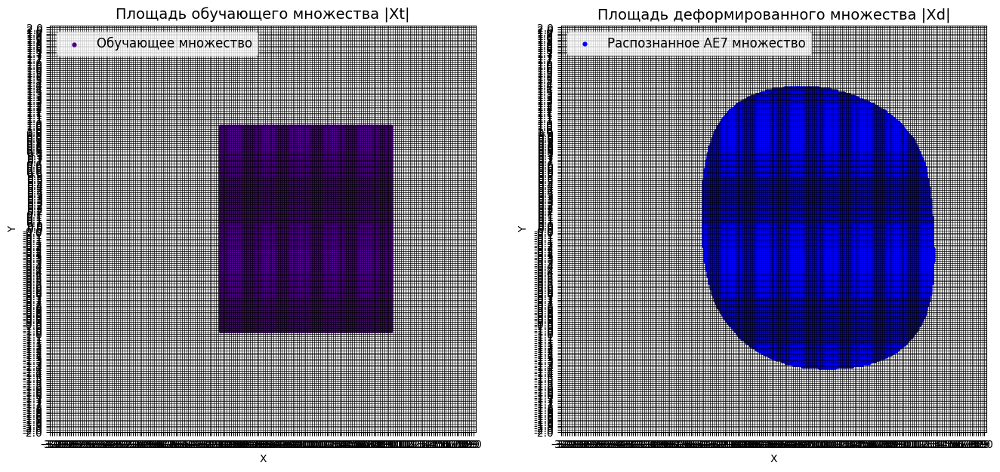

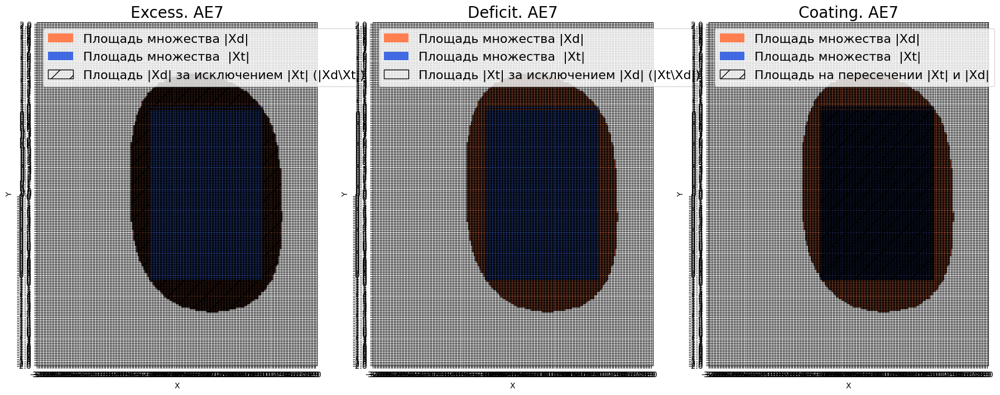


Оценка качества AE7
IDEAL = 0. Excess:  0.56
IDEAL = 0. Deficit:  0.0002469135802469136
IDEAL = 1. Coating:  0.9997530864197531
summa:  1.0
IDEAL = 1. Extrapolation precision (Approx):  0.6411271173025169




In [ ]:
# построение областей покрытия и границ классов
# расчет характеристик качества обучения
# параметр numb_square, отвечающий за количество элементов разбиения по каждой оси пространства признаков
numb_square = 200
xx, yy, Z3 = lib.square_calc1(numb_square, data7, ae7_trainned, IREth_7, '7', True)

### График Excess

In [ ]:
Excess = [0, 0, 0, 1, 1.667, 0.333, 0, 0.75, 0.32, 0.792, 0.457, 0.5, 0.524, 0.375, 0.481, 0.679, 0.486,
     0.4, 0.273, 0.763, 0.565, 0.392, 0.333, 0.454, 0.623, 0.441, 0.375, 0.587, 0.383, 0.51, 0.445,
     0.489, 0.498, 0.458, 0.498, 0.52, 0.503, 0.444, 0.431, 0.599, 0.509, 0.509, 0.457, 0.51, 0.568,
     0.5, 0.509, 0.591, 0.538, 0.575, 0.589, 0.554, 0.619, 0.589, 0.657, 0.67, 0.682, 0.632, 0.659,
     0.716, 0.743, 0.725, 0.695, 0.822, 0.823, 0.781, 0.803, 0.855, 0.871, 0.876]

In [ ]:
np.mean(Excess)

0.5567857142857142

In [ ]:
n = list(range(1, 71))

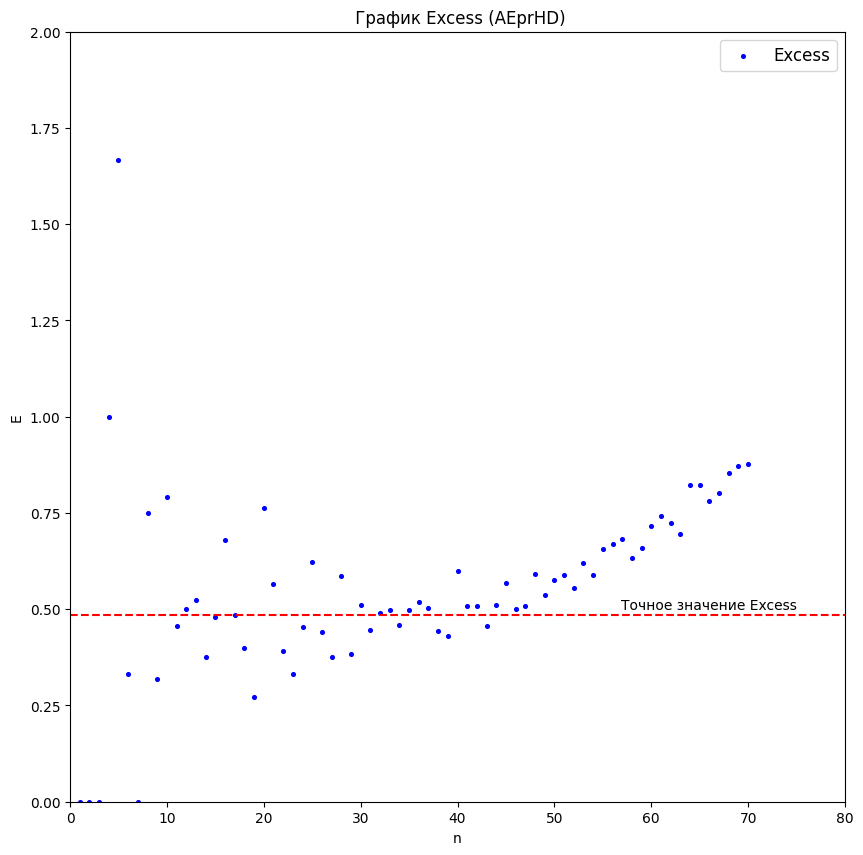

In [ ]:
plt.figure(figsize=(10,10))
plt.scatter(n,Excess,marker='o',s=7,color='b',label='Excess')
plt.legend(loc= 'upper right',fontsize=12)
plt.title(' График Excess (AEprHD)')
plt.hlines(0.486, 0, 80, color='red',linestyle='--')
plt.text(75, 0.51, 'Точное значение Excess', ha='right', va='center')
plt.xlabel('n')
plt.ylabel('E')
plt.xlim([0, 80])
plt.ylim([0, 2])
plt.show()

### Среднее 30 шагов

In [ ]:
nn = np.arange(5,71)

av = []
for i in nn:
  av.append(np.mean(Excess[0:i]))

print(av)

[0.5334, 0.5, 0.42857142857142855, 0.46875, 0.45222222222222225, 0.4862, 0.48354545454545456, 0.48491666666666666, 0.4879230769230769, 0.47985714285714287, 0.4799333333333333, 0.492375, 0.49200000000000005, 0.4868888888888889, 0.47563157894736846, 0.49000000000000005, 0.4935714285714286, 0.4889545454545454, 0.48217391304347823, 0.48100000000000004, 0.48668, 0.48492307692307696, 0.48085185185185186, 0.48464285714285715, 0.4811379310344827, 0.4821, 0.4809032258064516, 0.48115624999999995, 0.4816666666666666, 0.48097058823529404, 0.4814571428571428, 0.4825277777777777, 0.48308108108108105, 0.4820526315789473, 0.4807435897435897, 0.48369999999999996, 0.4843170731707317, 0.4849047619047619, 0.4842558139534884, 0.48484090909090916, 0.48668888888888895, 0.4869782608695653, 0.4874468085106384, 0.4896041666666667, 0.4905918367346939, 0.49228, 0.4941764705882353, 0.49532692307692305, 0.4976603773584905, 0.49935185185185177, 0.5022181818181818, 0.5052142857142857, 0.5083157894736842, 0.5104482758

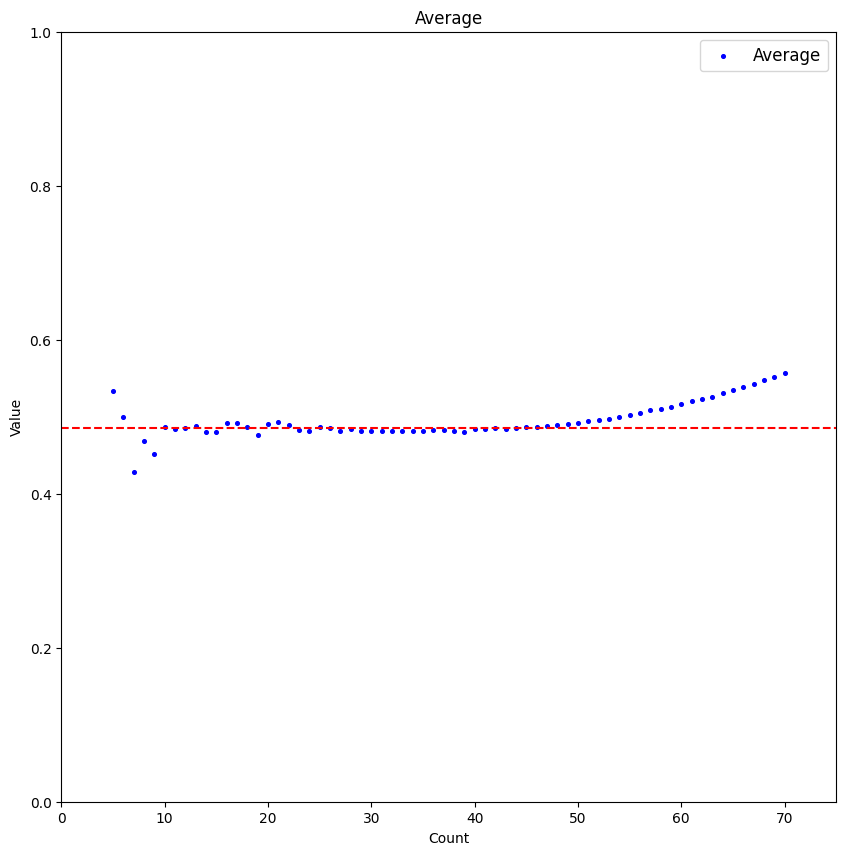

In [ ]:
plt.figure(figsize=(10,10))
plt.scatter(nn,av,marker='o',s=7,color='b',label='Average')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Average')
plt.xlabel('Count')
plt.ylabel('Value')
plt.hlines(0.486, 0, 75, color='red',linestyle='--')
plt.xlim([0, 75])
plt.ylim([0, 1])
plt.show()

### Среднее

In [ ]:
# 5 разбиений: 1, 15, 30, 50, 70
E = [0, 0.481, 0.51, 0.575, 0.876]
np.mean(E)

0.48839999999999995

In [ ]:
# 6 разбиений: 1, 14, 28, 42, 56, 70
E = [0, 0.375, 0.587, 0.509, 0.67, 0.876]
np.mean(E)

0.5028333333333334

### Аппроксимация с помощью МНК (малый прямоугольник)

In [ ]:
x = np.array(n)
y = np.array(Excess)

In [ ]:
linear_func = lambda x, b0, b1: b0 + b1*x
quadratic_func = lambda x, b0, b1, b2: b0 + b1*x + b2*x**2
qubic_func = lambda x, b0, b1, b2, b3: b0 + b1*x + b2*x**2 + b3*x**3
exp_func = lambda x, b0, b1, b2: b0 + b1*np.exp(b2*x)
exp1_func = lambda x, b0, b1, b2: b0 + b1*np.exp(x-b2)
exp2_func = lambda x, b0, b1: b0*np.power(b1,x)
exp3_func = lambda x, b0, b1, b2:  b0 + b1*np.power(b2,x)

In [ ]:
from scipy.optimize import leastsq

# list of model
model_list = [
    'linear', 'quadratic',
    'qubic', 'exp', 'exp1', 'exp2', 'exp3']

# model reference
models_dict = {
        'linear':             linear_func,
        'quadratic':          quadratic_func,
        'qubic':              qubic_func,
        'exp':                exp_func,
        'exp1':               exp1_func,
        'exp2':               exp2_func,
        'exp3':               exp3_func}

# initial values
p0_dict = {
        'linear':             [0, 0],
        'quadratic':          [0, 0, 0],
        'qubic':              [0, 0, 0, 0],
        'exp':                [0, 0, 0],
        'exp1':               [0, 0, 0],
        'exp2':               [1, 1],
        'exp3':               [0, 1, 1]}

# titles (formulas)
formulas_dict = {
        'linear':             'y = b0 + b1*x',
        'quadratic':          'y = b0 + b1*x + b2*x^2',
        'qubic':              'y = b0 + b1*x + b2*x^2 + b3*x^3',
        'exp':                'y = b0 + b1*np.exp(b2*x)',
        'exp1':               'y = b0 + b1*np.exp(x-b2)',
        'exp2':               'y = b0*np.power(b1,x)',
        'exp3':               'y = b0 + b1*np.power(b2,x)'}

# actual data
X_fact = x
Y_fact = y

# function for calculating residuals
residual_func = lambda p, x, y: y - func(x, *p)

# return all optional outputs
full_output = True

# variables to save the calculation results
calculation_results_df = pd.DataFrame(columns=['func', 'p0', 'popt', 'cov_x', 'SSE', 'MSE', 'pcov', 'perr', 'Y_calc', 'error_metrics'])
error_metrics_results_df = pd.DataFrame(columns=['MSE', 'RMSE', 'MAE', 'MSPE', 'MAPE', 'RMSLE', 'R2'])

# calculations
for func_name in model_list:
    print(f'{func_name.upper()} MODEL: {formulas_dict[func_name]}')
    func = models_dict[func_name]
    calculation_results_df.loc[func_name, 'func'] = func
    p0 = p0_dict[func_name]
    print(f'p0 = {p0}')
    calculation_results_df.loc[func_name, 'p0'] = p0
    if full_output:
        (popt, cov_x, infodict, mesg, ier) = leastsq(residual_func, p0, args=(X_fact, Y_fact), full_output=full_output)
        integer_flag = f'ier = {ier}, the solution was found' if ier<=4 else f'ier = {ier}, the solution was not found'
        print(integer_flag, '\n', mesg)
        calculation_results_df.loc[func_name, 'popt'] = popt
        print(f'parameters = {popt}')
        calculation_results_df.loc[func_name, 'cov_x'] = cov_x
        print(f'cov_x = \n{cov_x}')
        #SSE = (residual_func(popt, X_fact, Y_fact)**2).sum()
        SSE = (infodict['fvec']**2).sum()
        calculation_results_df.loc[func_name, 'SSE'] = SSE
        print(f'SSE = {SSE}')
        MSE = SSE / (len(Y_fact)-len(p0))
        calculation_results_df.loc[func_name, 'MSE'] = MSE
        print(f'MSE = {MSE}')
        pcov = cov_x * MSE
        calculation_results_df.loc[func_name, 'pcov'] = pcov
        print(f'pcov =\n {pcov}')
        perr = np.sqrt(np.diag(pcov))
        calculation_results_df.loc[func_name, 'perr'] = perr
        print(f'perr = {perr}\n')
    else:
        popt = leastsq(residual_func, p0, args=(X_fact, Y_fact), full_output=full_output)
        calculation_results_df.loc[func_name, 'popt'] = popt
        print(f'parameters = {popt}\n')
    Y_calc = func(X_fact, *popt)
    calculation_results_df.loc[func_name, 'Y_calc'] = Y_calc
    (error_metrics_dict, error_metrics_df) = regression_error_metrics(Yfact=Y_fact, Ycalc=Y_calc, model_name=func_name)
    calculation_results_df.loc[func_name, 'error_metrics'] = error_metrics_dict.values()
    error_metrics_results_df = pd.concat([error_metrics_results_df, error_metrics_df])

LINEAR MODEL: y = b0 + b1*x
p0 = [0, 0]
ier = 3, the solution was found 
 Both actual and predicted relative reductions in the sum of squares
  are at most 0.000000 and the relative error between two consecutive iterates is at 
  most 0.000000
parameters = [0.38615777 0.00480642]
cov_x = 
[[ 5.83850936e-02 -1.24223603e-03]
 [-1.24223603e-03  3.49925643e-05]]
SSE = 3.40253140743592
MSE = 0.050037226579939996
pcov =
 [[ 2.92142816e-03 -6.21580458e-05]
 [-6.21580458e-05  1.75093087e-06]]
perr = [0.05405024 0.00132323]

QUADRATIC MODEL: y = b0 + b1*x + b2*x^2
p0 = [0, 0, 0]
ier = 1, the solution was found 
 Both actual and predicted relative reductions in the sum of squares
  are at most 0.000000
parameters = [ 5.08896164e-01 -5.42177884e-03  1.44059155e-04]
cov_x = 
[[ 1.36207529e-01 -7.72743901e-03  9.13408865e-05]
 [-7.72743901e-03  5.75426146e-04 -7.61174054e-06]
 [ 9.13408865e-05 -7.61174054e-06  1.07207613e-07]]
SSE = 3.208953359051839
MSE = 0.047894826254505064
pcov =
 [[ 6.52363593

<ipython-input-7-a10df777837d>:36: RuntimeWarning: divide by zero encountered in divide
  MSPE = (1/n_fit) *  np.sum(((Yfact-Ycalc)/Yfact)**2)
<ipython-input-7-a10df777837d>:37: RuntimeWarning: divide by zero encountered in divide
  MAPE = (1/n_fit) *  np.sum(abs((Yfact-Ycalc)/Yfact))
<ipython-input-7-a10df777837d>:36: RuntimeWarning: divide by zero encountered in divide
  MSPE = (1/n_fit) *  np.sum(((Yfact-Ycalc)/Yfact)**2)
<ipython-input-7-a10df777837d>:37: RuntimeWarning: divide by zero encountered in divide
  MAPE = (1/n_fit) *  np.sum(abs((Yfact-Ycalc)/Yfact))
<ipython-input-7-a10df777837d>:36: RuntimeWarning: divide by zero encountered in divide
  MSPE = (1/n_fit) *  np.sum(((Yfact-Ycalc)/Yfact)**2)
<ipython-input-7-a10df777837d>:37: RuntimeWarning: divide by zero encountered in divide
  MAPE = (1/n_fit) *  np.sum(abs((Yfact-Ycalc)/Yfact))
<ipython-input-7-a10df777837d>:36: RuntimeWarning: divide by zero encountered in divide
  MSPE = (1/n_fit) *  np.sum(((Yfact-Ycalc)/Yfact)**2)

#### Аппроксимация многочленом 1-степени

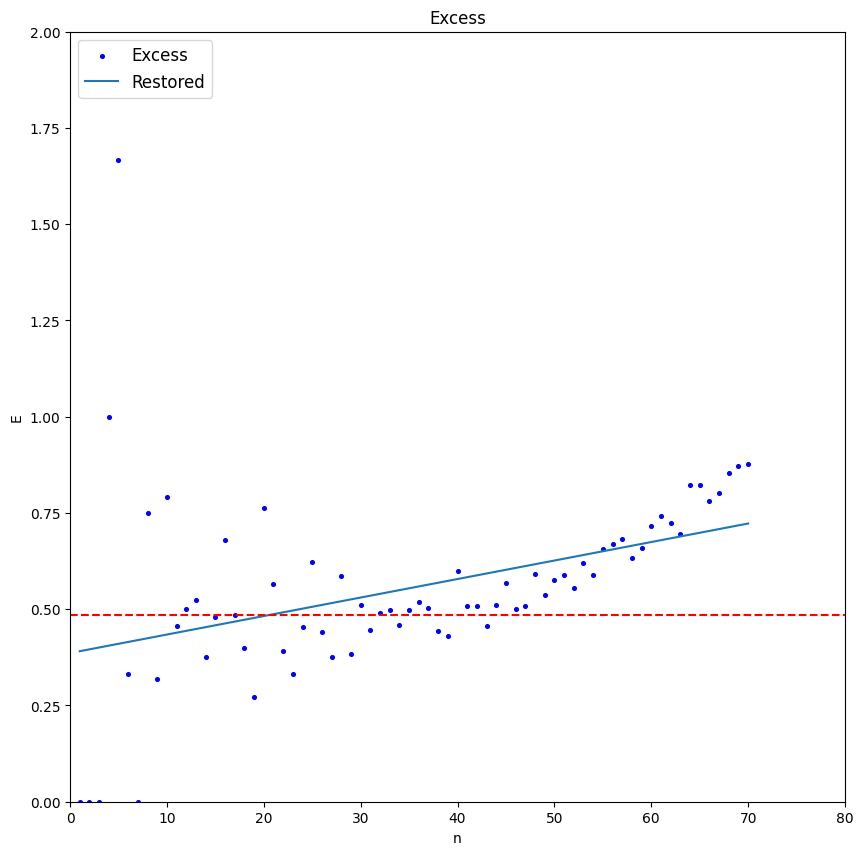

In [ ]:
b0, b1 = [0.38615777, 0.00480642]

plt.figure(figsize=(10,10))
plt.scatter(n,E,marker='o',s=7,color='b',label='Excess')
plt.plot(x, b0 + b1*x , label = 'Restored')
plt.legend(loc= 'upper left',fontsize=12)
plt.title('Excess')
plt.hlines(0.486, 0, 80, color='red',linestyle='--')
plt.xlabel('n')
plt.ylabel('E')
plt.xlim([0, 80])
plt.ylim([0, 2])
plt.show()

#### Аппроксимация многочленом 2-й степени

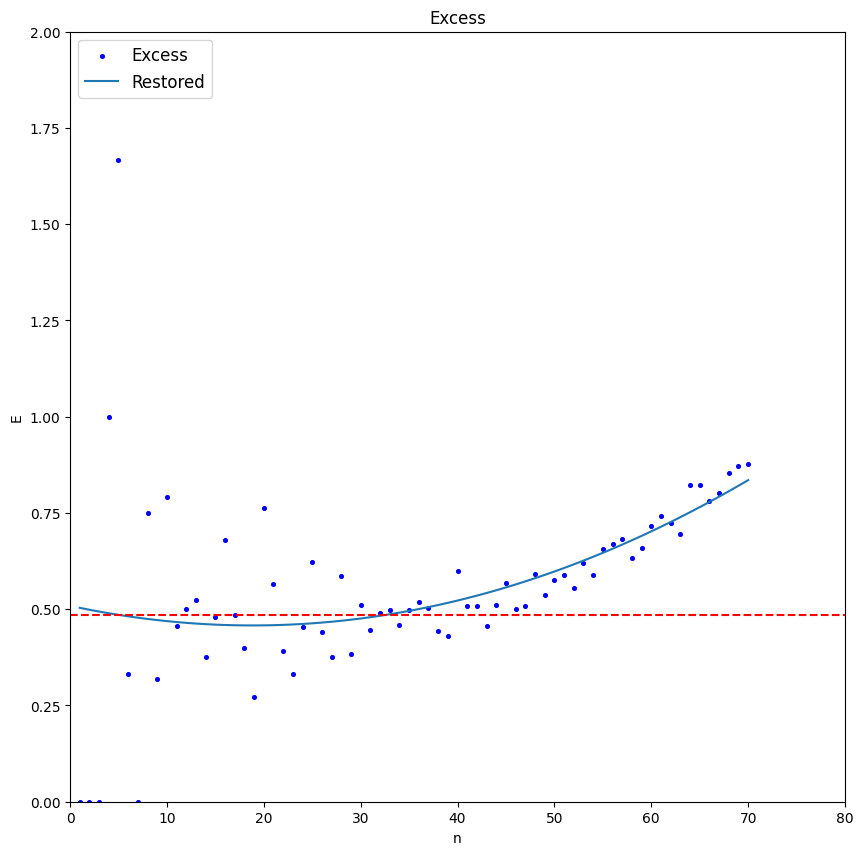

In [ ]:
b0, b1, b2 = [ 5.08896164e-01, -5.42177884e-03,  1.44059155e-04]

plt.figure(figsize=(10,10))
plt.scatter(n,E,marker='o',s=7,color='b',label='Excess')
plt.plot(x, b0 + b1*x + b2*x**2 , label = 'Restored')
plt.legend(loc= 'upper left',fontsize=12)
plt.title('Excess')
plt.hlines(0.486, 0, 80, color='red',linestyle='--')
plt.xlabel('n')
plt.ylabel('E')
plt.xlim([0, 80])
plt.ylim([0, 2])
plt.show()

#### Аппроксимация многочленом 3-й степени

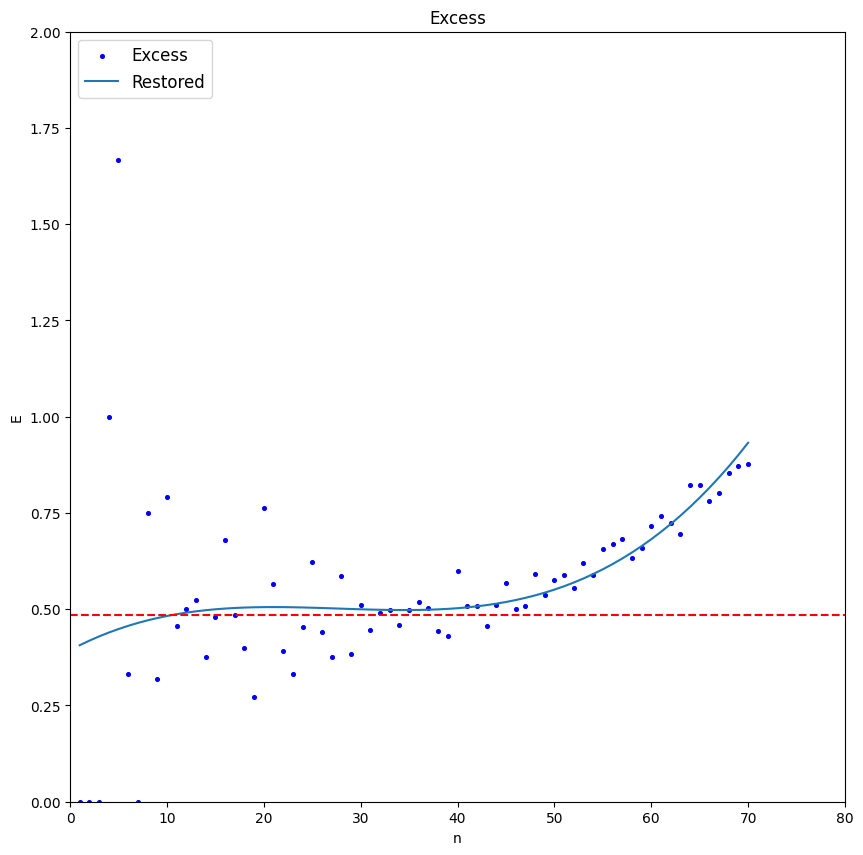

In [ ]:
b0, b1, b2, b3 = [ 3.93559911e-01,  1.34071790e-02, -5.14252787e-04,  6.18133279e-06]

plt.figure(figsize=(10,10))
plt.scatter(n,E,marker='o',s=7,color='b',label='Excess')
plt.plot(x, b0 + b1*x + b2*x**2 + b3*x**3, label = 'Restored')
plt.legend(loc= 'upper left',fontsize=12)
plt.title('Excess')
plt.hlines(0.486, 0, 80, color='red',linestyle='--')
plt.xlabel('n')
plt.ylabel('E')
plt.xlim([0, 80])
plt.ylim([0, 2])
plt.show()

#### Аппроксимация экспонентами

y = b0 + b1*np.exp(b2*x)

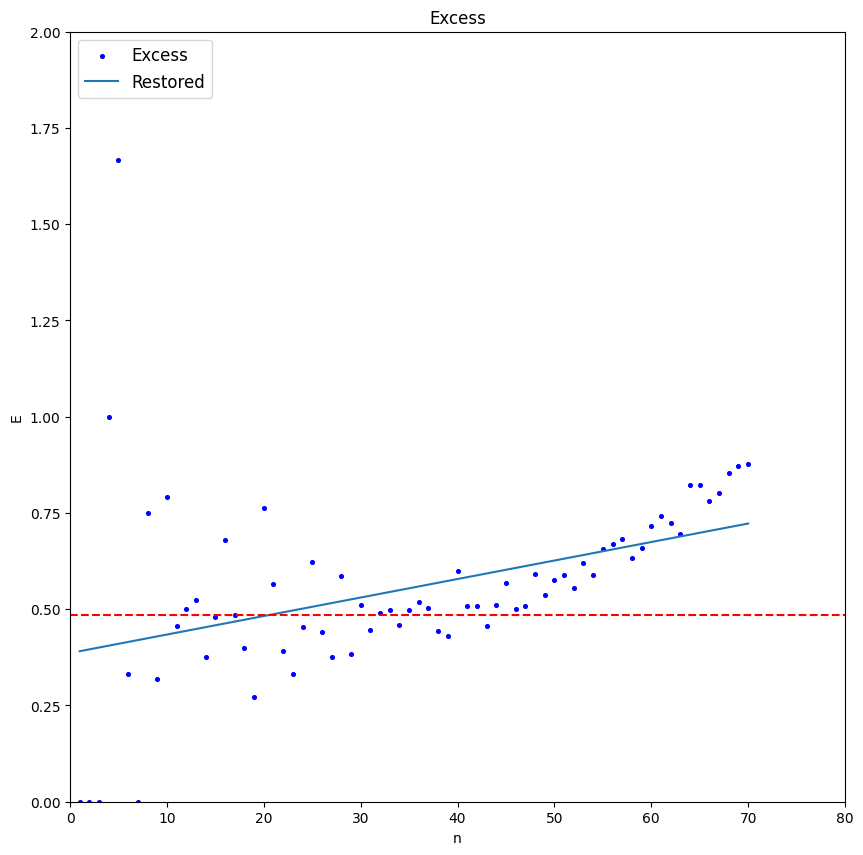

In [ ]:
b0, b1, b2 = [ 1.03989547e+03, -1.03950931e+03, -4.62414564e-06]

plt.figure(figsize=(10,10))
plt.scatter(n,E,marker='o',s=7,color='b',label='Excess')
plt.plot(x, b0 + b1*np.exp(b2*x), label = 'Restored')
plt.legend(loc= 'upper left',fontsize=12)
plt.title('Excess')
plt.hlines(0.486, 0, 80, color='red',linestyle='--')
plt.xlabel('n')
plt.ylabel('E')
plt.xlim([0, 80])
plt.ylim([0, 2])
plt.show()

y = b0 + b1*np.exp(x-b2)

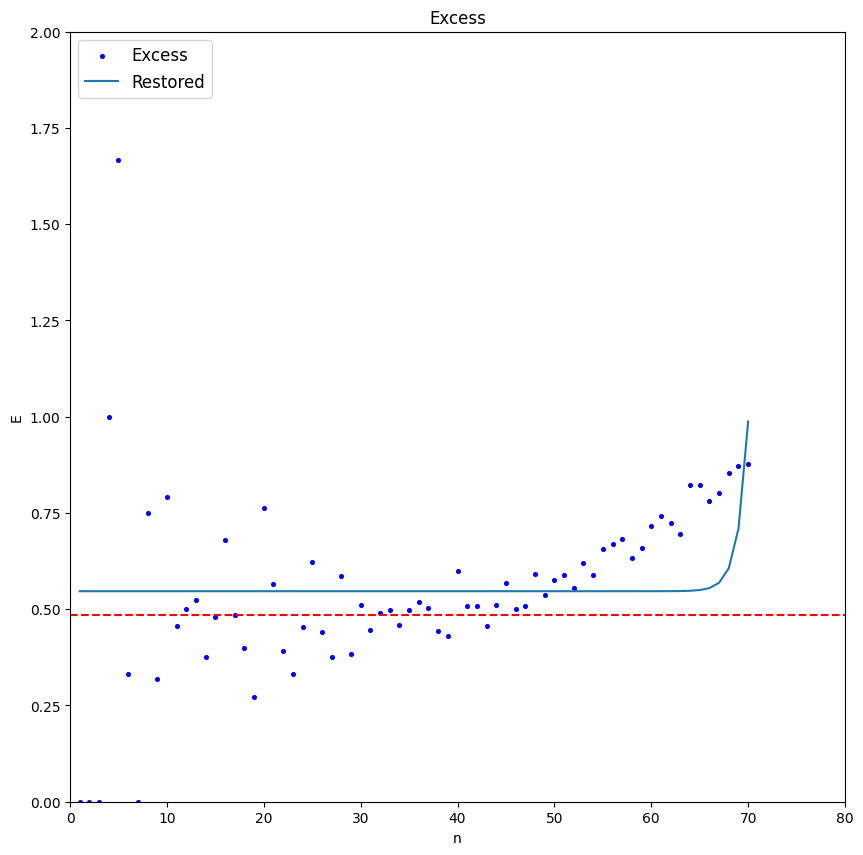

In [ ]:
b0, b1, b2 = [5.46820473e-01, 1.75296017e-31, 0.00000000e+00]

plt.figure(figsize=(10,10))
plt.scatter(n,E,marker='o',s=7,color='b',label='Excess')
plt.plot(x, b0 + b1*np.exp(x-b2), label = 'Restored')
plt.legend(loc= 'upper left',fontsize=12)
plt.title('Excess')
plt.hlines(0.486, 0, 80, color='red',linestyle='--')
plt.xlabel('n')
plt.ylabel('E')
plt.xlim([0, 80])
plt.ylim([0, 2])
plt.show()

y = b0*np.power(b1,x)

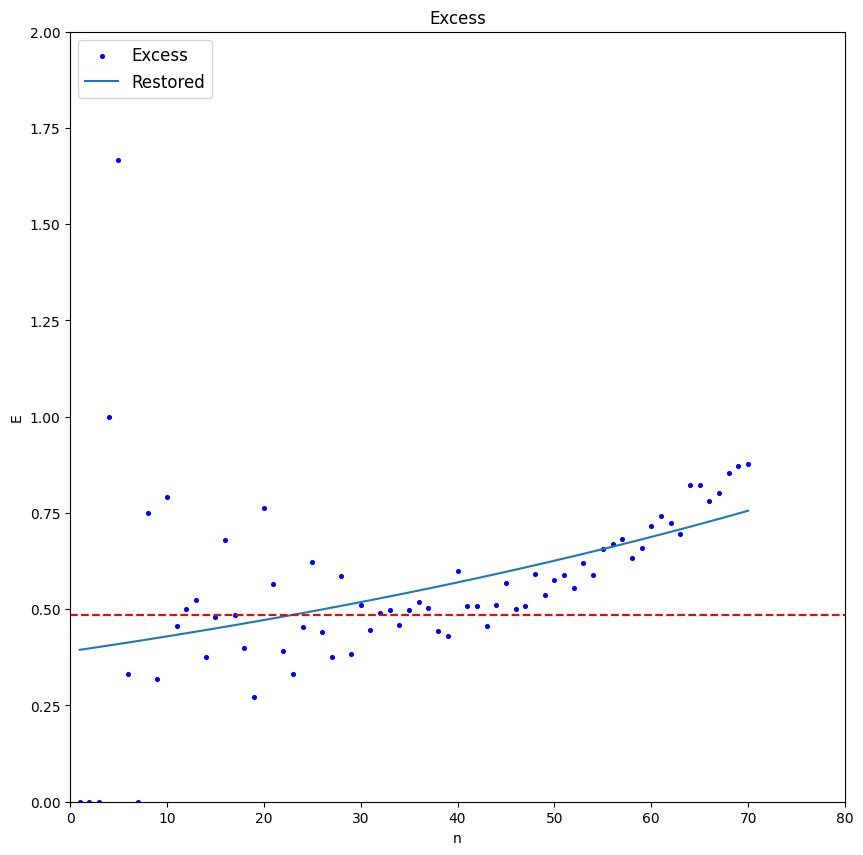

In [ ]:
b0, b1 = [0.39082146, 1.0094666 ]

plt.figure(figsize=(10,10))
plt.scatter(n,E,marker='o',s=7,color='b',label='Excess')
plt.plot(x, b0*np.power(b1,x), label = 'Restored')
plt.legend(loc= 'upper left',fontsize=12)
plt.title('Excess')
plt.hlines(0.486, 0, 80, color='red',linestyle='--')
plt.xlabel('n')
plt.ylabel('E')
plt.xlim([0, 80])
plt.ylim([0, 2])
plt.show()

y = b0 + b1*np.power(b2,x)

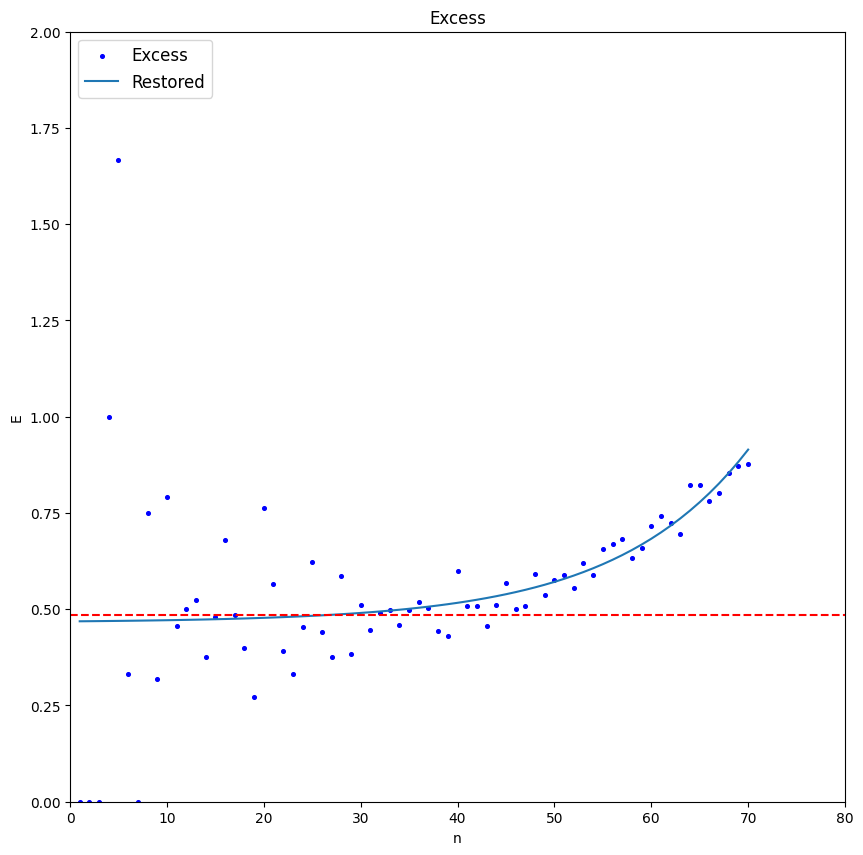

In [ ]:
b0, b1, b2 = [0.46564768, 0.00280787, 1.0751837 ]

plt.figure(figsize=(10,10))
plt.scatter(n,E,marker='o',s=7,color='b',label='Excess')
plt.plot(x, b0 + b1*np.power(b2,x), label = 'Restored')
plt.legend(loc= 'upper left',fontsize=12)
plt.title('Excess')
plt.hlines(0.486, 0, 80, color='red',linestyle='--')
plt.xlabel('n')
plt.ylabel('E')
plt.xlim([0, 80])
plt.ylim([0, 2])
plt.show()

#### Все графики

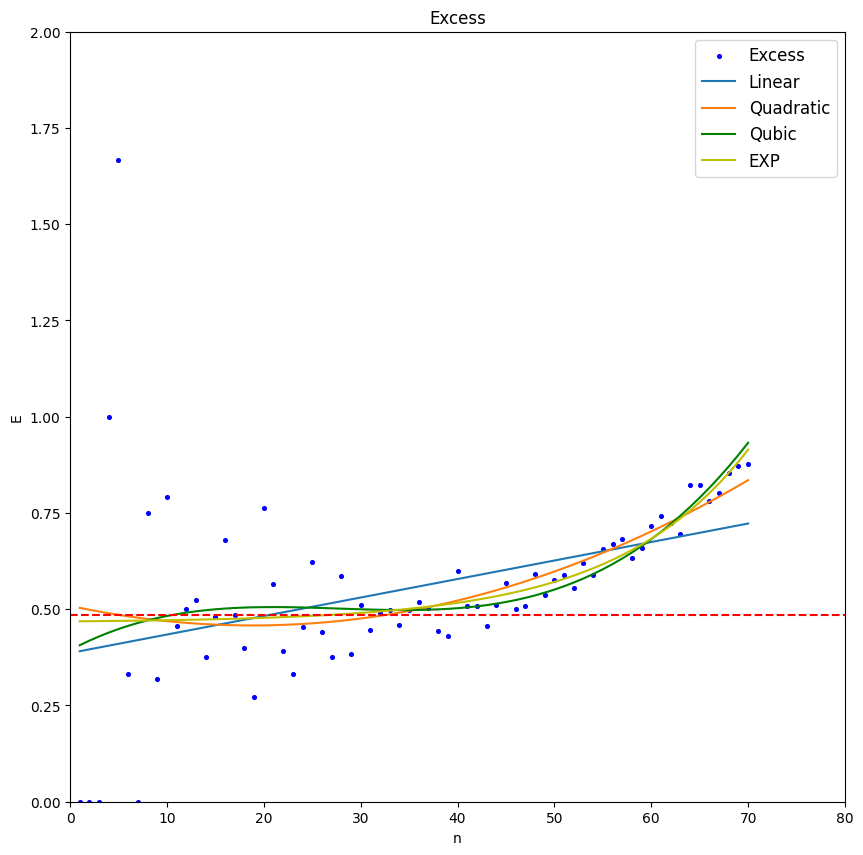

In [ ]:
# 1-я степень
b0, b1 = [0.38615777, 0.00480642]

# 2-я степень
be0, be1, be2 = [ 5.08896164e-01, -5.42177884e-03,  1.44059155e-04]

# 3-я степень
beta0, beta1, beta2, beta3 = [ 3.93559911e-01,  1.34071790e-02, -5.14252787e-04,  6.18133279e-06]

# Экспонента
bet0, bet1, bet2 = [0.46564768, 0.00280787, 1.0751837 ]

plt.figure(figsize=(10,10))
plt.scatter(n,E,marker='o',s=7,color='b',label='Excess')
plt.plot(x, b0 + b1*x , label = 'Linear')
plt.plot(x, be0 + be1*x + be2*x**2 , label = 'Quadratic')
plt.plot(x, beta0 + beta1*x + beta2*x**2 + beta3*x**3 ,color='g', label = 'Qubic')
plt.plot(x, bet0 + bet1*np.power(bet2,x) , color = 'y', label = 'EXP')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Excess')
plt.hlines(0.486, 0, 80, color='red',linestyle='--')
plt.xlabel('n')
plt.ylabel('E')
plt.xlim([0, 80])
plt.ylim([0, 2])
plt.show()

### Несколько точек

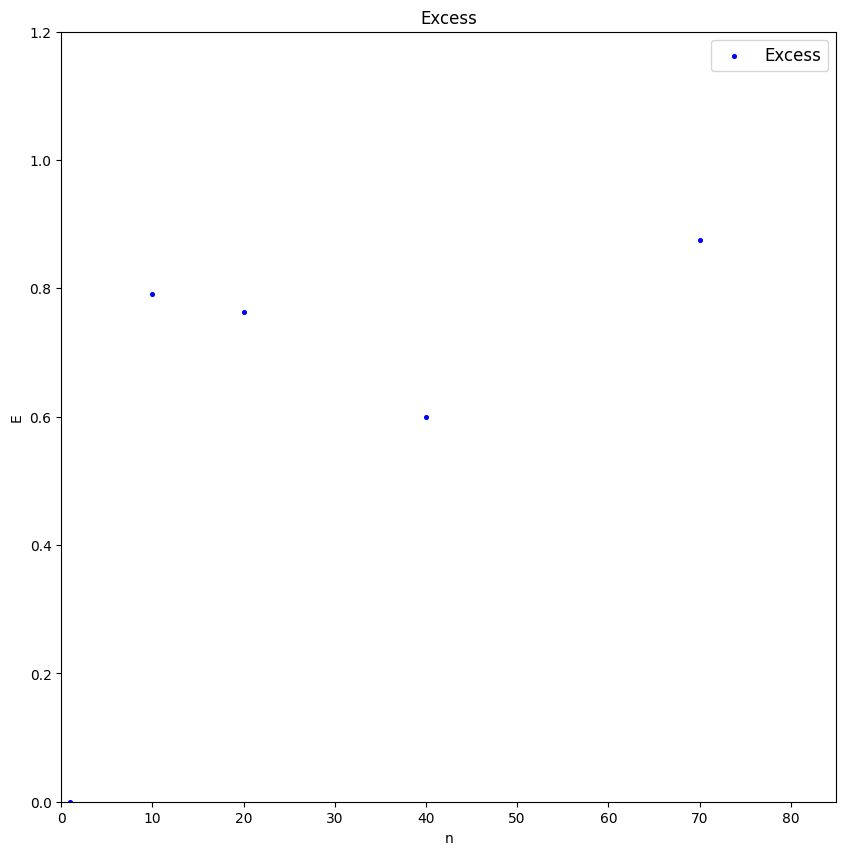

In [ ]:
E = [0, 1.667, 0.792, 0.763, 0.599, 0.876]
n = [1, 5, 10, 20, 40, 70]

plt.figure(figsize=(10,10))
plt.scatter(n,E,marker='o',s=7,color='b',label='Excess')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.xlim([0, 85])
plt.ylim([0, 1.2])
plt.show()

In [ ]:
x = np.array(n)
y = np.array(E)

from scipy.optimize import leastsq

linear_func = lambda x, b0, b1: b0 + b1*x
quadratic_func = lambda x, b0, b1, b2: b0 + b1*x + b2*x**2
qubic_func = lambda x, b0, b1, b2, b3: b0 + b1*x + b2*x**2 + b3*x**3
exp_func = lambda x, b0, b1, b2: b0 + b1*np.exp(b2*x)
exp1_func = lambda x, b0, b1, b2: b0 + b1*np.exp(x-b2)
exp2_func = lambda x, b0, b1, b2: b0 + b1*np.power(b2,x)
exp3_func = lambda x, b0, b1, b2, b3:  b0 + b1*np.power(b2,(x-b3))

# list of model
model_list = [
    'linear', 'quadratic',
    'qubic', 'exp2']

# model reference
models_dict = {
        'linear':             linear_func,
        'quadratic':          quadratic_func,
        'qubic':              qubic_func,
        'exp2':               exp2_func}

# initial values
p0_dict = {
        'linear':             [0, 0],
        'quadratic':          [0, 0, 0],
        'qubic':              [0, 0, 0, 0],
        'exp2':               [1, 1, 1]}

# titles (formulas)
formulas_dict = {
        'linear':             'y = b0 + b1*x',
        'quadratic':          'y = b0 + b1*x + b2*x^2',
        'qubic':              'y = b0 + b1*x + b2*x^2 + b3*x^3',
        'exp2':               'y = b0 + b1*np.power(b2,x)'}

# actual data
X_fact = x
Y_fact = y

# function for calculating residuals
residual_func = lambda p, x, y: y - func(x, *p)

# return all optional outputs
full_output = True

# variables to save the calculation results
calculation_results_df = pd.DataFrame(columns=['func', 'p0', 'popt', 'cov_x', 'SSE', 'MSE', 'pcov', 'perr', 'Y_calc', 'error_metrics'])
error_metrics_results_df = pd.DataFrame(columns=['MSE', 'RMSE', 'MAE', 'MSPE', 'MAPE', 'RMSLE', 'R2'])

# calculations
for func_name in model_list:
    print(f'{func_name.upper()} MODEL: {formulas_dict[func_name]}')
    func = models_dict[func_name]
    calculation_results_df.loc[func_name, 'func'] = func
    p0 = p0_dict[func_name]
    print(f'p0 = {p0}')
    calculation_results_df.loc[func_name, 'p0'] = p0
    if full_output:
        (popt, cov_x, infodict, mesg, ier) = leastsq(residual_func, p0, args=(X_fact, Y_fact), full_output=full_output)
        integer_flag = f'ier = {ier}, the solution was found' if ier<=4 else f'ier = {ier}, the solution was not found'
        print(integer_flag, '\n', mesg)
        calculation_results_df.loc[func_name, 'popt'] = popt
        print(f'parameters = {popt}')
        calculation_results_df.loc[func_name, 'cov_x'] = cov_x
        print(f'cov_x = \n{cov_x}')
        #SSE = (residual_func(popt, X_fact, Y_fact)**2).sum()
        SSE = (infodict['fvec']**2).sum()
        calculation_results_df.loc[func_name, 'SSE'] = SSE
        print(f'SSE = {SSE}')
        MSE = SSE / (len(Y_fact)-len(p0))
        calculation_results_df.loc[func_name, 'MSE'] = MSE
        print(f'MSE = {MSE}')
        pcov = cov_x * MSE
        calculation_results_df.loc[func_name, 'pcov'] = pcov
        print(f'pcov =\n {pcov}')
        perr = np.sqrt(np.diag(pcov))
        calculation_results_df.loc[func_name, 'perr'] = perr
        print(f'perr = {perr}\n')
    else:
        popt = leastsq(residual_func, p0, args=(X_fact, Y_fact), full_output=full_output)
        calculation_results_df.loc[func_name, 'popt'] = popt
        print(f'parameters = {popt}\n')
    Y_calc = func(X_fact, *popt)
    calculation_results_df.loc[func_name, 'Y_calc'] = Y_calc
    (error_metrics_dict, error_metrics_df) = regression_error_metrics(Yfact=Y_fact, Ycalc=Y_calc, model_name=func_name)
    calculation_results_df.loc[func_name, 'error_metrics'] = error_metrics_dict.values()
    error_metrics_results_df = pd.concat([error_metrics_results_df, error_metrics_df])

LINEAR MODEL: y = b0 + b1*x
p0 = [0, 0]
ier = 1, the solution was found 
 Both actual and predicted relative reductions in the sum of squares
  are at most 0.000000
parameters = [7.65309597e-01 7.20153551e-04]
cov_x = 
[[ 3.37140090e-01 -7.00575734e-03]
 [-7.00575734e-03  2.87907845e-04]]
SSE = 1.4357294892514396
MSE = 0.3589323723128599
pcov =
 [[ 1.21010492e-01 -2.51459310e-03]
 [-2.51459310e-03  1.03339446e-04]]
perr = [0.34786562 0.0101656 ]

QUADRATIC MODEL: y = b0 + b1*x + b2*x^2
p0 = [0, 0, 0]
ier = 1, the solution was found 
 Both actual and predicted relative reductions in the sum of squares
  are at most 0.000000
parameters = [7.65370698e-01 7.12262491e-04 1.11797524e-07]
cov_x = 
[[ 5.84234287e-01 -3.89169343e-02  4.52100137e-04]
 [-3.89169343e-02  4.40910300e-03 -5.83868464e-05]
 [ 4.52100137e-04 -5.83868464e-05  8.27193016e-07]]
SSE = 1.4357294741413926
MSE = 0.4785764913804642
pcov =
 [[ 2.79600795e-01 -1.86247299e-02  2.16364497e-04]
 [-1.86247299e-02  2.11009304e-03 -2.

<ipython-input-7-a10df777837d>:36: RuntimeWarning: divide by zero encountered in divide
  MSPE = (1/n_fit) *  np.sum(((Yfact-Ycalc)/Yfact)**2)
<ipython-input-7-a10df777837d>:37: RuntimeWarning: divide by zero encountered in divide
  MAPE = (1/n_fit) *  np.sum(abs((Yfact-Ycalc)/Yfact))
<ipython-input-7-a10df777837d>:36: RuntimeWarning: divide by zero encountered in divide
  MSPE = (1/n_fit) *  np.sum(((Yfact-Ycalc)/Yfact)**2)
<ipython-input-7-a10df777837d>:37: RuntimeWarning: divide by zero encountered in divide
  MAPE = (1/n_fit) *  np.sum(abs((Yfact-Ycalc)/Yfact))
<ipython-input-7-a10df777837d>:36: RuntimeWarning: divide by zero encountered in divide
  MSPE = (1/n_fit) *  np.sum(((Yfact-Ycalc)/Yfact)**2)
<ipython-input-7-a10df777837d>:37: RuntimeWarning: divide by zero encountered in divide
  MAPE = (1/n_fit) *  np.sum(abs((Yfact-Ycalc)/Yfact))
<ipython-input-7-a10df777837d>:36: RuntimeWarning: divide by zero encountered in divide
  MSPE = (1/n_fit) *  np.sum(((Yfact-Ycalc)/Yfact)**2)

#### 1-я степень

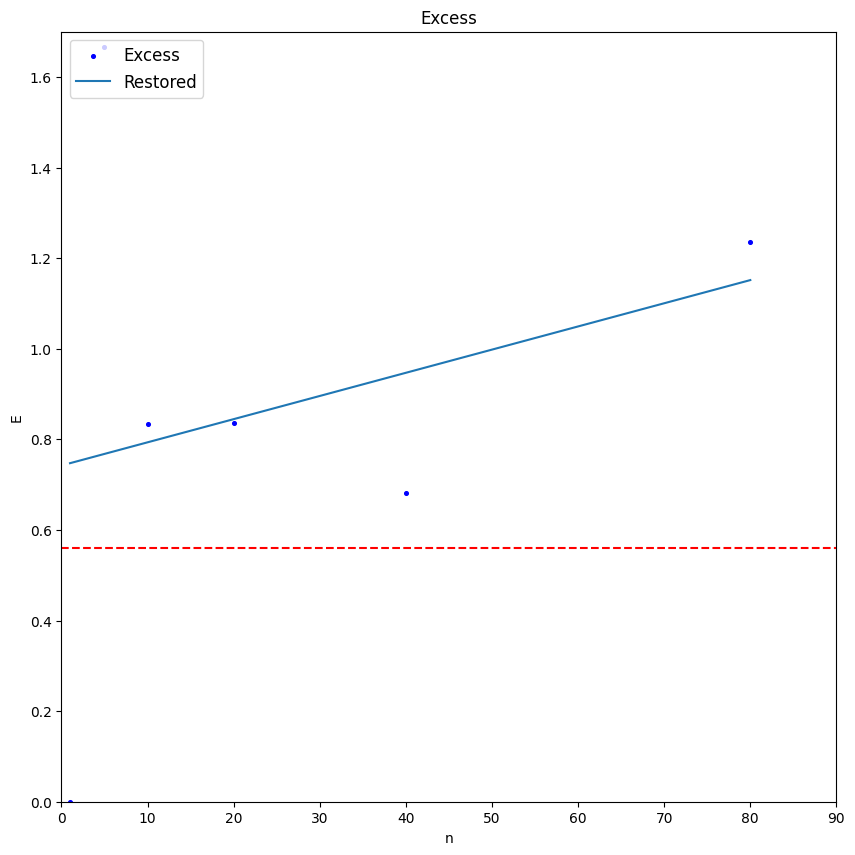

In [ ]:
# многочлен 1-й степени

b0, b1 = [0.74229128, 0.005117]
xx = np.arange (1,81)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='b',label='Excess')
plt.plot(xx, b0 + b1*xx , label = 'Restored')
plt.legend(loc= 'upper left',fontsize=12)
plt.title('Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.hlines(0.56, 0, 90, color='red',linestyle='--')
plt.xlim([0, 90])
plt.ylim([0, 1.7])
plt.show()

#### 2-я степень

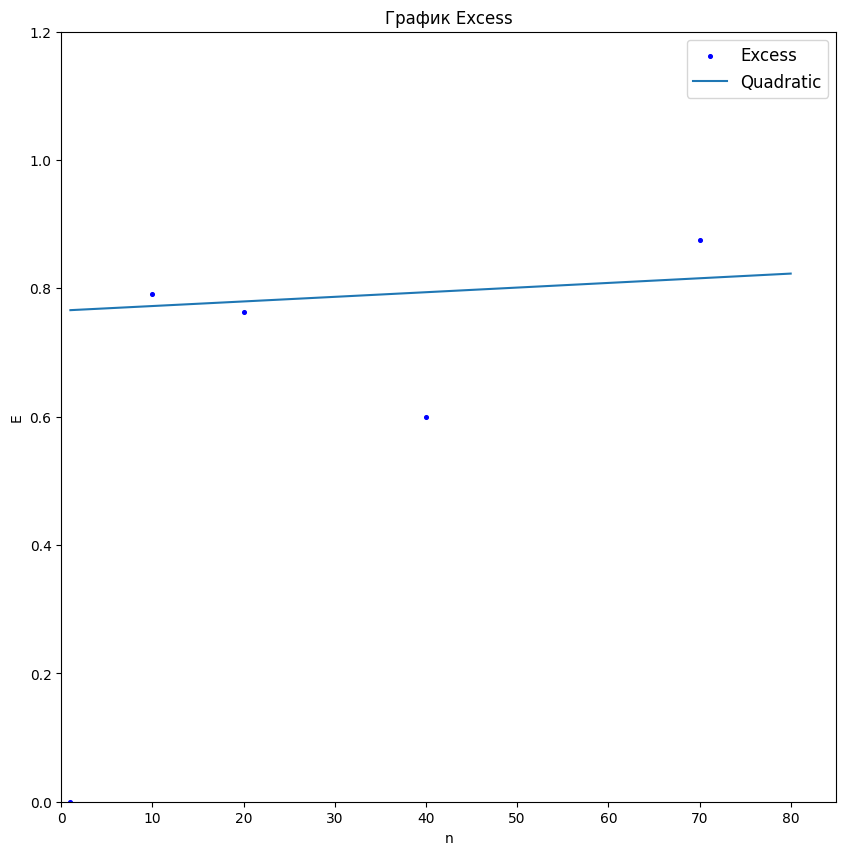

In [ ]:
# многочлен 2-й степени

b0, b1, b2 = [7.65370698e-01, 7.12262491e-04, 1.11797524e-07]

xx = np.arange (1,81)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='b',label='Excess')
plt.plot(xx, b0 + b1*xx + b2*xx**2 , label = 'Quadratic')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.xlim([0, 85])
plt.ylim([0, 1.2])
plt.show()

#### 3-я степень

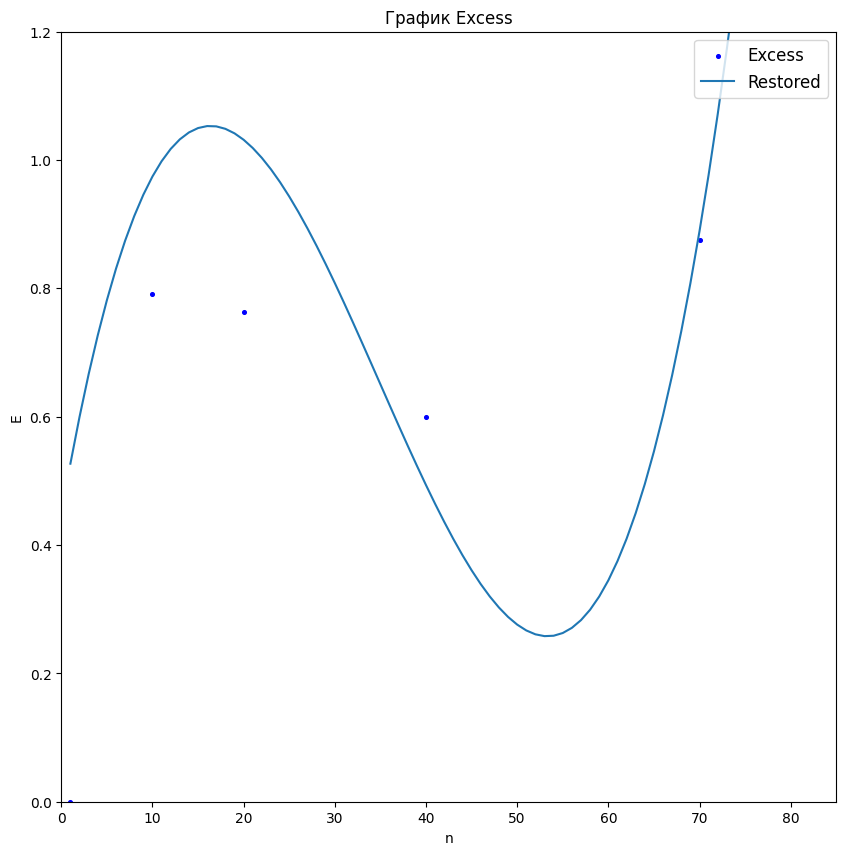

In [ ]:
# многочлен 3-й степени

b0, b1, b2, b3 = [ 4.47624311e-01,  8.24476510e-02, -3.29227171e-03, 3.14938218e-05]
xx = np.arange (1,81)

plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='b',label='Excess')
plt.plot(xx, b0 + b1*xx + b2*xx**2 + b3*xx**3 , label = 'Restored')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.xlim([0, 85])
plt.ylim([0, 1.2])
plt.show()

In [ ]:
from sympy import *

x = Symbol('x', real=True)
f = b0 + b1*x + b2*x**2 + b3*x**3
fprime = f.diff(x)

solve(fprime, x)

[16.3635636641463, 53.3278132860677]

In [ ]:
import sympy as sp

def f(x):
  z = b0 + b1*x + b2*x**2 + b3*x**3
  return z

# Объявляем символьную переменную x
x = sp.Symbol ("x")
# Вывод функции
print("f(x) =", f(x))
# Находим производную функции f(x) и сохраняем ее в переменной d_f:
d_f = sp.diff(f(x), x)
print("Первая производная функции:",d_f)

# Решаем уравнение d_f = 0:
x_extr = sp.solve (d_f)
print ("точка экстремума:", x_extr)

# Сохраняем точки экстремума в переменные:
x_0 = x_extr[0]
x_1 = x_extr[1]

# Находим вторую производную функции:
d2_f = sp.diff(f(x), x, 2)
print("Вторая производная функции:", d2_f)

# Решаем уравнение d2_f = 0
x_extr2 = sp.solve (d2_f)
print ("точка перегиба:", x_extr2)

# Находим значение второй производной в точках экстремума x_0 и x_1,
# Сохраняем их в переменные f_0_d2 и f_1_d2:
f_0_d2 = d2_f.evalf(subs = {x : x_0})
f_1_d2 = d2_f.evalf(subs = {x : x_1})

# Определяем, является ли точка x_0 точкой лок.минимума, максимума или перегиба
if f_0_d2 > 0:
  print(x_0, "- локальный минимум")
elif f_0_d2 < 0:
  print(x_0, "- локальный максимум")
else:
  print(x_0, "- точка перегиба")

# Определяем, является ли точка x_1 точкой лок.минимума, максимума или перегиба
if f_1_d2 > 0:
  print(x_1, "- локальный минимум")
elif f_1_d2 < 0:
  print(x_1, "- локальный максимум")
else:
  print(x_1, "- точка перегиба")

f(x) = 3.14938218e-5*x**3 - 0.00329227171*x**2 + 0.082447651*x + 0.447624311
Первая производная функции: 9.44814654e-5*x**2 - 0.00658454342*x + 0.082447651
точка экстремума: [16.3635636641463, 53.3278132860677]
Вторая производная функции: 0.0001889629308*x - 0.00658454342
точка перегиба: [34.8456884751070]
16.3635636641463 - локальный максимум
53.3278132860677 - локальный минимум


#### Экспонента

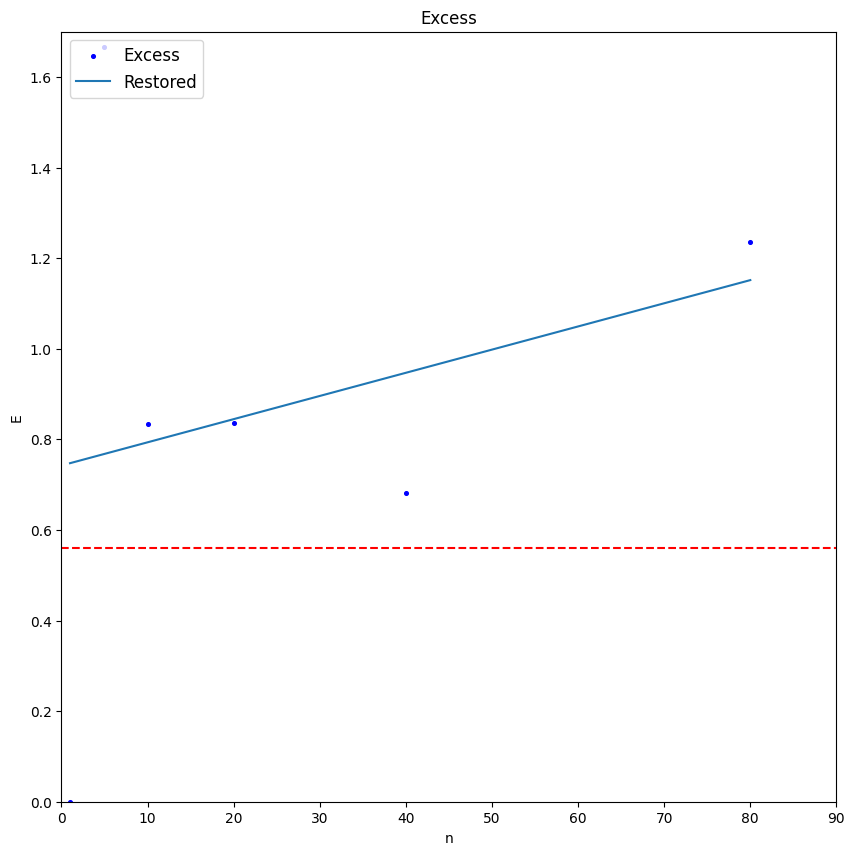

In [ ]:
# Экспонента

b0, b1, b2 = [ 543.52353034, -542.78124867,    0.99999057]

xx = np.arange (1,81)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='b',label='Excess')
plt.plot(xx, b0 + b1*np.power(b2,xx) , label = 'Restored')
plt.legend(loc= 'upper left',fontsize=12)
plt.title('Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.hlines(0.56, 0, 90, color='red',linestyle='--')
plt.xlim([0, 90])
plt.ylim([0, 1.7])
plt.show()

### График Approx

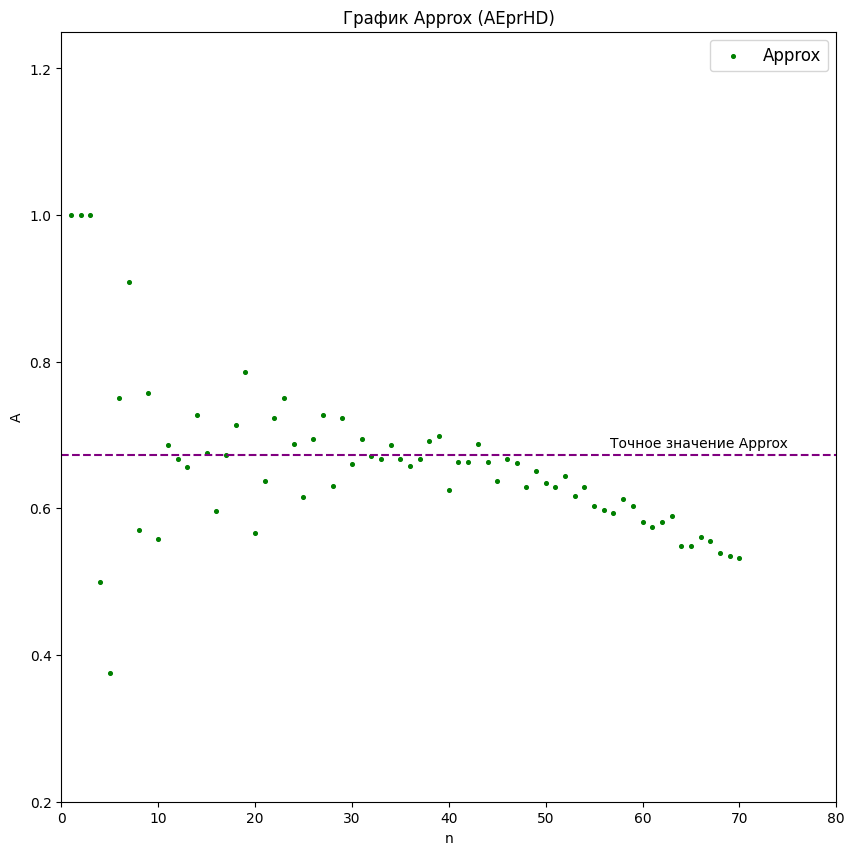

In [ ]:
Approx = [1, 1, 1, 0.5, 0.375, 0.75, 0.909, 0.571, 0.758, 0.558, 0.686, 0.667, 0.656, 0.727, 0.675, 0.596, 0.673, 0.714, 0.786, 0.567,
          0.638, 0.723, 0.75, 0.688, 0.616, 0.694, 0.727, 0.63, 0.723, 0.66, 0.694, 0.672, 0.667, 0.686, 0.668, 0.658, 0.667, 0.692, 0.699, 0.625,
          0.663, 0.663, 0.688, 0.663, 0.638, 0.667, 0.662, 0.629, 0.651, 0.635, 0.629, 0.644, 0.617, 0.629, 0.603, 0.598, 0.594, 0.613, 0.603, 0.582,
          0.574, 0.581, 0.59, 0.549, 0.549, 0.561, 0.555, 0.539, 0.535, 0.533]

n = list(range(1, 71))

plt.figure(figsize=(10,10))
plt.scatter(n,Approx,marker='o',s=7,color='g',label='Approx')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Approx (AEprHD)')
plt.xlabel('n')
plt.ylabel('A')
plt.hlines(0.673, 0, 80, color='purple',linestyle='--')
plt.text(75, 0.688, 'Точное значение Approx', ha='right', va='center')
plt.xlim([0, 80])
plt.ylim([0.2, 1.25])
plt.show()

### Среднее Approx

[1.0, 1.0, 1.0, 0.875, 0.775, 0.7708333333333334, 0.7905714285714286, 0.763125, 0.7625555555555557, 0.7421, 0.7370000000000001, 0.7311666666666667, 0.7253846153846155, 0.7255000000000001, 0.7221333333333335, 0.71425, 0.7118235294117647, 0.7119444444444445, 0.715842105263158, 0.7084, 0.7050476190476191, 0.7058636363636365, 0.7077826086956523, 0.7069583333333332, 0.70332, 0.7029615384615384, 0.7038518518518517, 0.7012142857142856, 0.7019655172413791, 0.7005666666666666, 0.7003548387096773, 0.69946875, 0.6984848484848485, 0.6981176470588235, 0.6972571428571429, 0.6961666666666667, 0.6953783783783785, 0.6952894736842106, 0.6953846153846155, 0.6936249999999999, 0.6928780487804878, 0.6921666666666666, 0.6920697674418604, 0.6914090909090909, 0.6902222222222222, 0.6897173913043478, 0.6891276595744682, 0.687875, 0.687122448979592, 0.68608, 0.6849607843137255, 0.6841730769230769, 0.6829056603773584, 0.6819074074074073, 0.6804727272727272, 0.679, 0.6775087719298246, 0.6763965517241379, 0.67515254

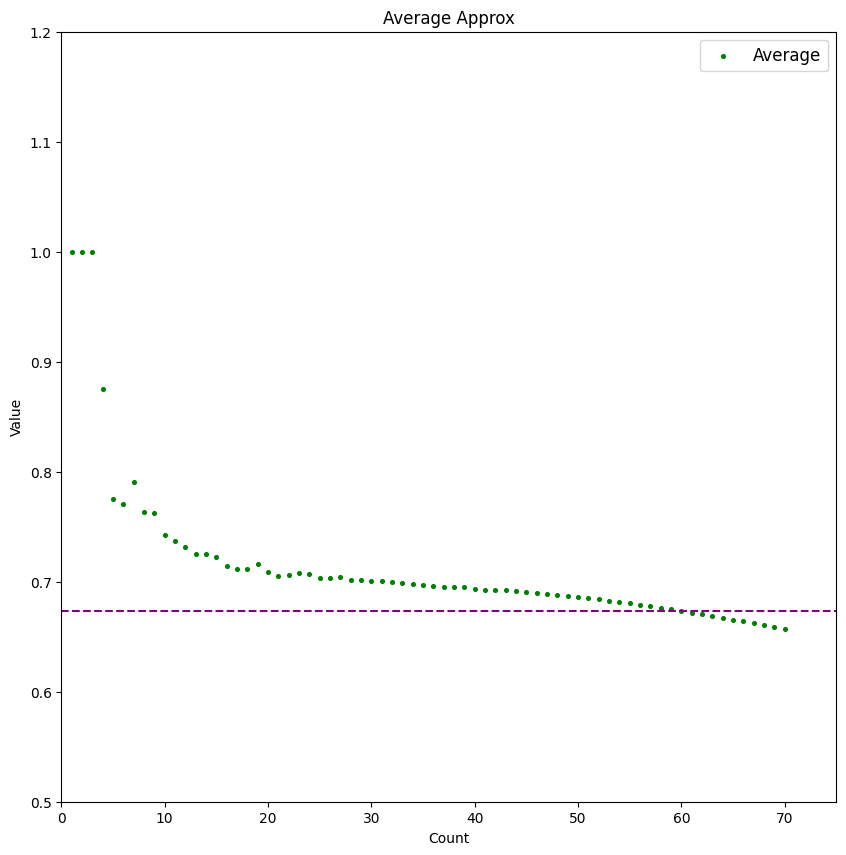

In [ ]:
nn = np.arange(1,71)

av = []
for i in nn:
  av.append(np.mean(Approx[0:i]))

print(av)

plt.figure(figsize=(10,10))
plt.scatter(nn,av,marker='o',s=7,color='g',label='Average')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Average Approx')
plt.xlabel('Count')
plt.ylabel('Value')
plt.hlines(0.673, 0, 75, color='purple',linestyle='--')
plt.xlim([0, 75])
plt.ylim([0.5, 1.2])
plt.show()

### Аппроксимация МНК (Approx)

In [ ]:
x = np.array(n)
y = np.array(Approx)

linear_func = lambda x, b0, b1: b0 + b1*x
quadratic_func = lambda x, b0, b1, b2: b0 + b1*x + b2*x**2
qubic_func = lambda x, b0, b1, b2, b3: b0 + b1*x + b2*x**2 + b3*x**3
exp_func = lambda x, b0, b1, b2: b0 + b1*np.exp(b2*x)
exp1_func = lambda x, b0, b1, b2: b0 + b1*np.exp(x-b2)
exp2_func = lambda x, b0, b1: b0*np.power(b1,x)
exp3_func = lambda x, b0, b1, b2:  b0 + b1*np.power(b2,x)


from scipy.optimize import leastsq

# list of model
model_list = [
    'linear', 'quadratic',
    'qubic', 'EXP']

# model reference
models_dict = {
        'linear':             linear_func,
        'quadratic':          quadratic_func,
        'qubic':              qubic_func,
        'EXP':                exp3_func}

# initial values
p0_dict = {
        'linear':             [0, 0],
        'quadratic':          [0, 0, 0],
        'qubic':              [0, 0, 0, 0],
        'EXP':                [1, 1, 1]}

# titles (formulas)
formulas_dict = {
        'linear':             'y = b0 + b1*x',
        'quadratic':          'y = b0 + b1*x + b2*x^2',
        'qubic':              'y = b0 + b1*x + b2*x^2 + b3*x^3',
        'EXP':                'y = b0 +b1*b2^x'}

# actual data
X_fact = x
Y_fact = y

# function for calculating residuals
residual_func = lambda p, x, y: y - func(x, *p)

# return all optional outputs
full_output = True

# variables to save the calculation results
calculation_results_df = pd.DataFrame(columns=['func', 'p0', 'popt', 'cov_x', 'SSE', 'MSE', 'pcov', 'perr', 'Y_calc', 'error_metrics'])
error_metrics_results_df = pd.DataFrame(columns=['MSE', 'RMSE', 'MAE', 'MSPE', 'MAPE', 'RMSLE', 'R2'])

# calculations
for func_name in model_list:
    print(f'{func_name.upper()} MODEL: {formulas_dict[func_name]}')
    func = models_dict[func_name]
    calculation_results_df.loc[func_name, 'func'] = func
    p0 = p0_dict[func_name]
    print(f'p0 = {p0}')
    calculation_results_df.loc[func_name, 'p0'] = p0
    if full_output:
        (popt, cov_x, infodict, mesg, ier) = leastsq(residual_func, p0, args=(X_fact, Y_fact), full_output=full_output)
        integer_flag = f'ier = {ier}, the solution was found' if ier<=4 else f'ier = {ier}, the solution was not found'
        print(integer_flag, '\n', mesg)
        calculation_results_df.loc[func_name, 'popt'] = popt
        print(f'parameters = {popt}')
        calculation_results_df.loc[func_name, 'cov_x'] = cov_x
        print(f'cov_x = \n{cov_x}')
        #SSE = (residual_func(popt, X_fact, Y_fact)**2).sum()
        SSE = (infodict['fvec']**2).sum()
        calculation_results_df.loc[func_name, 'SSE'] = SSE
        print(f'SSE = {SSE}')
        MSE = SSE / (len(Y_fact)-len(p0))
        calculation_results_df.loc[func_name, 'MSE'] = MSE
        print(f'MSE = {MSE}')
        pcov = cov_x * MSE
        calculation_results_df.loc[func_name, 'pcov'] = pcov
        print(f'pcov =\n {pcov}')
        perr = np.sqrt(np.diag(pcov))
        calculation_results_df.loc[func_name, 'perr'] = perr
        print(f'perr = {perr}\n')
    else:
        popt = leastsq(residual_func, p0, args=(X_fact, Y_fact), full_output=full_output)
        calculation_results_df.loc[func_name, 'popt'] = popt
        print(f'parameters = {popt}\n')
    Y_calc = func(X_fact, *popt)
    calculation_results_df.loc[func_name, 'Y_calc'] = Y_calc
    (error_metrics_dict, error_metrics_df) = regression_error_metrics(Yfact=Y_fact, Ycalc=Y_calc, model_name=func_name)
    calculation_results_df.loc[func_name, 'error_metrics'] = error_metrics_dict.values()
    error_metrics_results_df = pd.concat([error_metrics_results_df, error_metrics_df])

LINEAR MODEL: y = b0 + b1*x
p0 = [0, 0]
ier = 2, the solution was found 
 The relative error between two consecutive iterates is at most 0.000000
parameters = [ 0.7512     -0.00265674]
cov_x = 
[[ 5.83850940e-02 -1.24223603e-03]
 [-1.24223603e-03  3.49925639e-05]]
SSE = 0.5585613810865192
MSE = 0.008214137957154694
pcov =
 [[ 4.79583216e-04 -1.02038981e-05]
 [-1.02038981e-05  2.87433747e-07]]
perr = [0.02189939 0.00053613]

QUADRATIC MODEL: y = b0 + b1*x + b2*x^2
p0 = [0, 0, 0]
ier = 1, the solution was found 
 Both actual and predicted relative reductions in the sum of squares
  are at most 0.000000
parameters = [ 7.44436025e-01 -2.09307585e-03 -7.93893798e-06]
cov_x = 
[[ 1.36207522e-01 -7.72743821e-03  9.13408739e-05]
 [-7.72743821e-03  5.75426057e-04 -7.61173918e-06]
 [ 9.13408739e-05 -7.61173918e-06  1.07207592e-07]]
SSE = 0.5579734868515439
MSE = 0.00832796249032155
pcov =
 [[ 1.13433114e-03 -6.43538156e-05  7.60683372e-07]
 [-6.43538156e-05  4.79212662e-06 -6.33902784e-08]
 [ 7.

TypeError: unsupported operand type(s) for *: 'NoneType' and 'float'

#### 1 степень

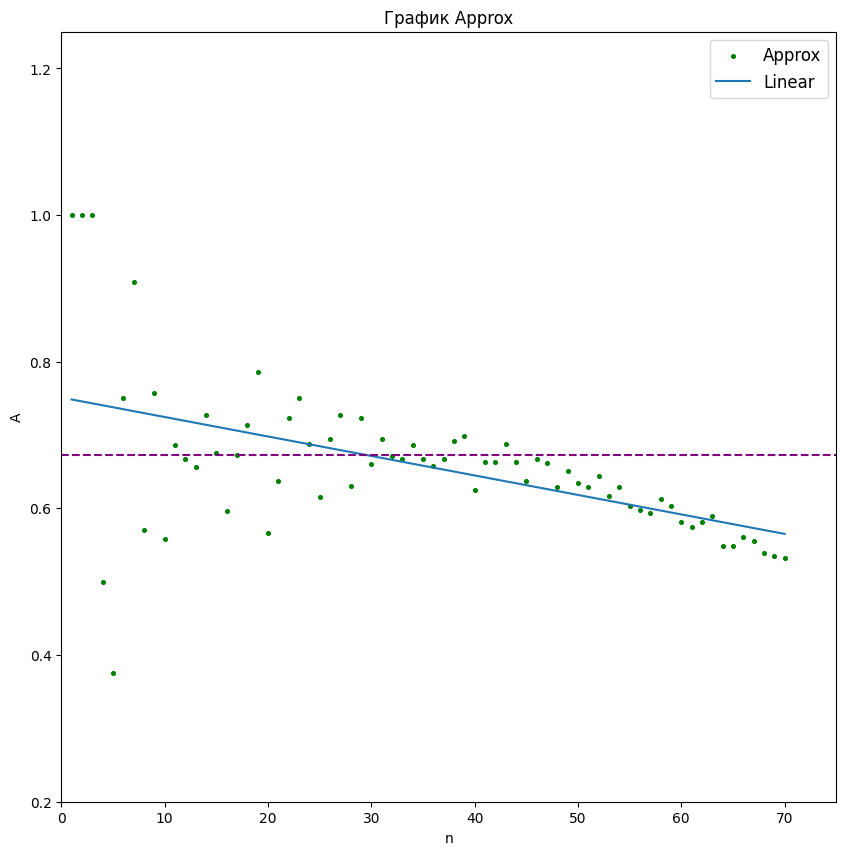

In [ ]:
b0, b1 = [ 0.7512,     -0.00265674]

xx = np.arange (1,71)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='g',label='Approx')
plt.plot(xx, b0 + b1*xx , label = 'Linear')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Approx')
plt.xlabel('n')
plt.ylabel('A')
plt.hlines(0.673, 0, 75, color='purple',linestyle='--')
plt.xlim([0, 75])
plt.ylim([0.2, 1.25])
plt.show()

#### 2 степень

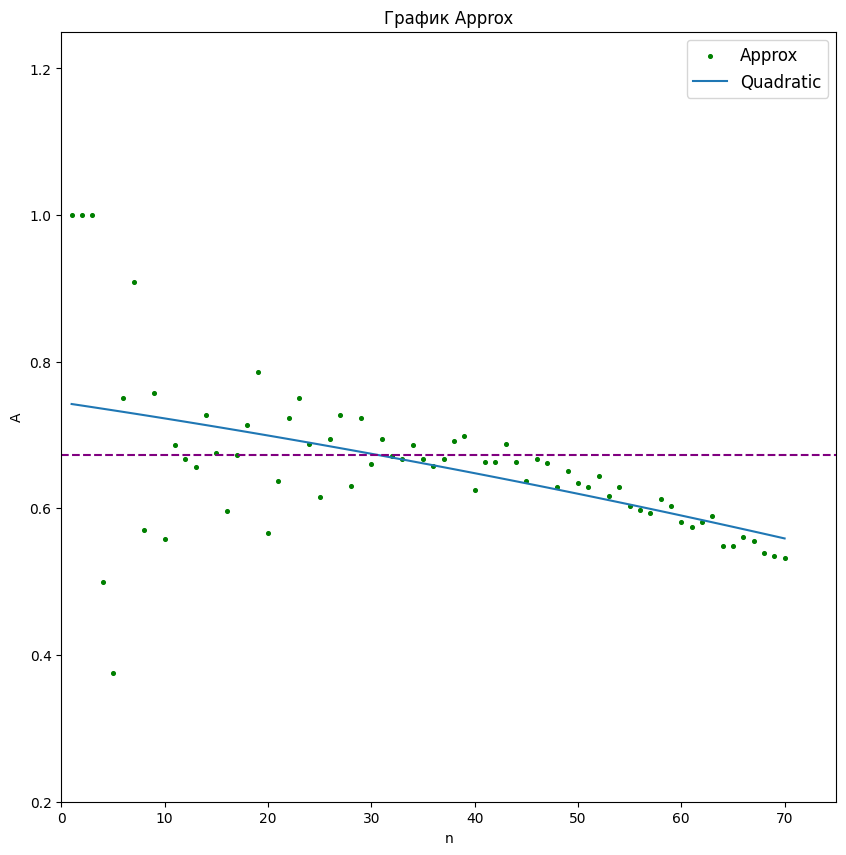

In [ ]:
b0, b1, b2 = [ 7.44436025e-01, -2.09307585e-03, -7.93893798e-06]

xx = np.arange (1,71)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='g',label='Approx')
plt.plot(xx, b0 + b1*xx + b2*xx**2 , label = 'Quadratic')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Approx')
plt.xlabel('n')
plt.ylabel('A')
plt.hlines(0.673, 0, 75, color='purple',linestyle='--')
plt.xlim([0, 75])
plt.ylim([0.2, 1.25])
plt.show()

#### 3 степень

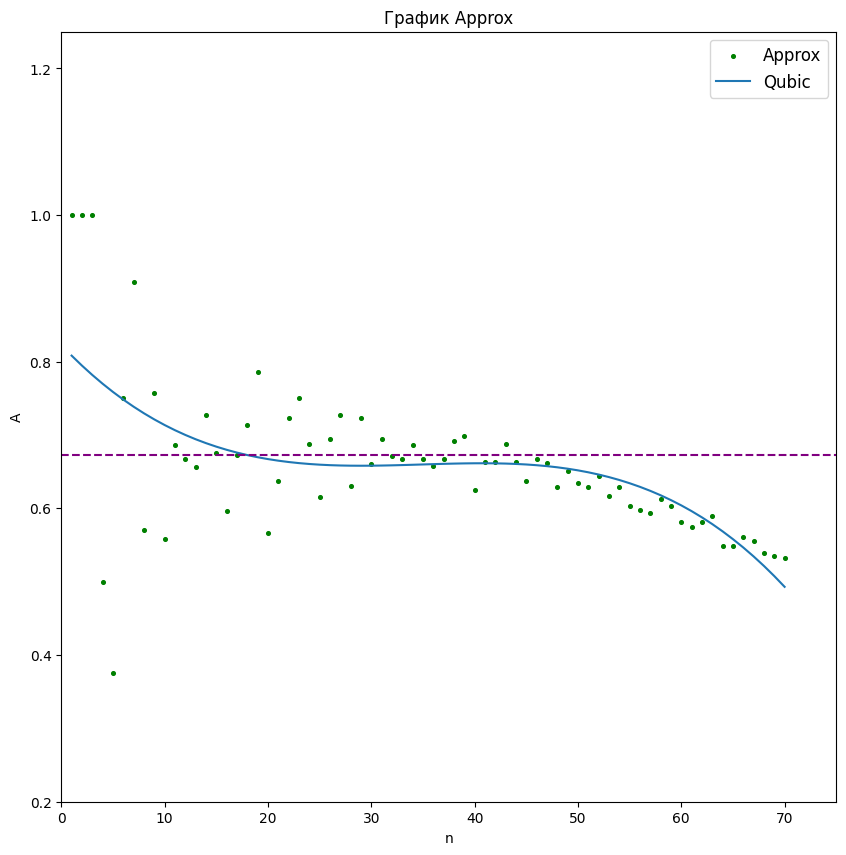

In [ ]:
b0, b1, b2, b3 =[ 8.22773231e-01, -1.48818385e-02,  4.39191236e-04, -4.19840539e-06]

xx = np.arange (1,71)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='g',label='Approx')
plt.plot(xx, b0 + b1*xx + b2*xx**2 + b3*xx**3 , label = 'Qubic')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Approx')
plt.xlabel('n')
plt.ylabel('A')
plt.hlines(0.673, 0, 75, color='purple',linestyle='--')
plt.xlim([0, 75])
plt.ylim([0.2, 1.25])
plt.show()

#### EXP

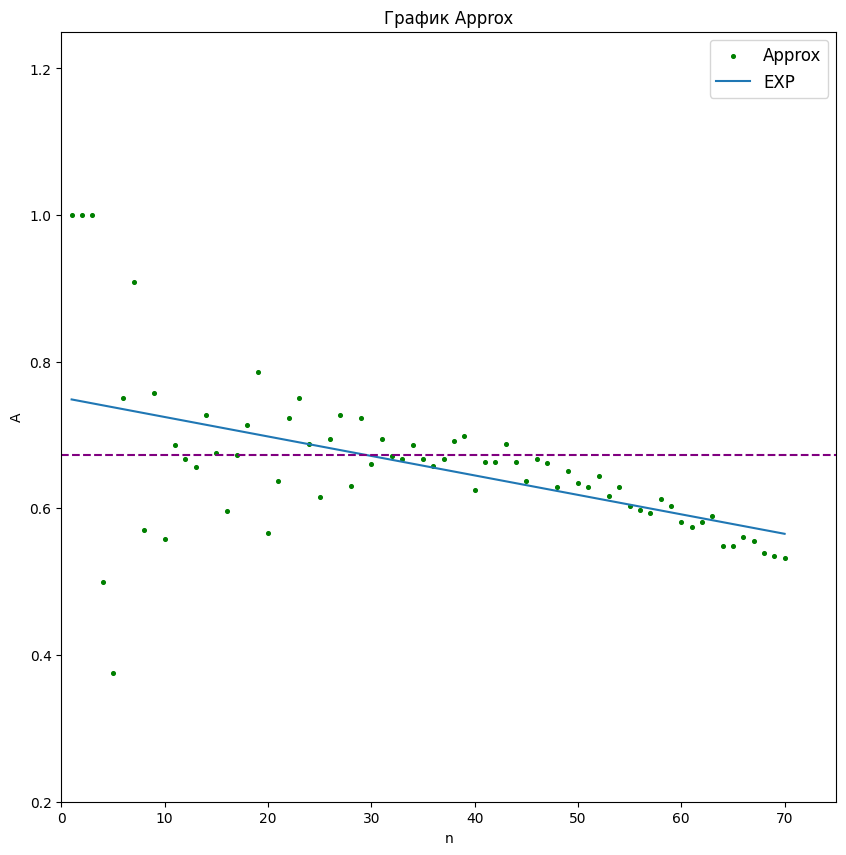

In [ ]:
b0, b1, b2 = [-108.66912727,  109.4203525,     0.99997571]

xx = np.arange (1,71)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='g',label='Approx')
plt.plot(xx, b0 + b1*np.power(b2,xx) , label = 'EXP')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Approx')
plt.xlabel('n')
plt.ylabel('A')
plt.hlines(0.673, 0, 75, color='purple',linestyle='--')
plt.xlim([0, 75])
plt.ylim([0.2, 1.25])
plt.show()

### Несколько точек (Approx)

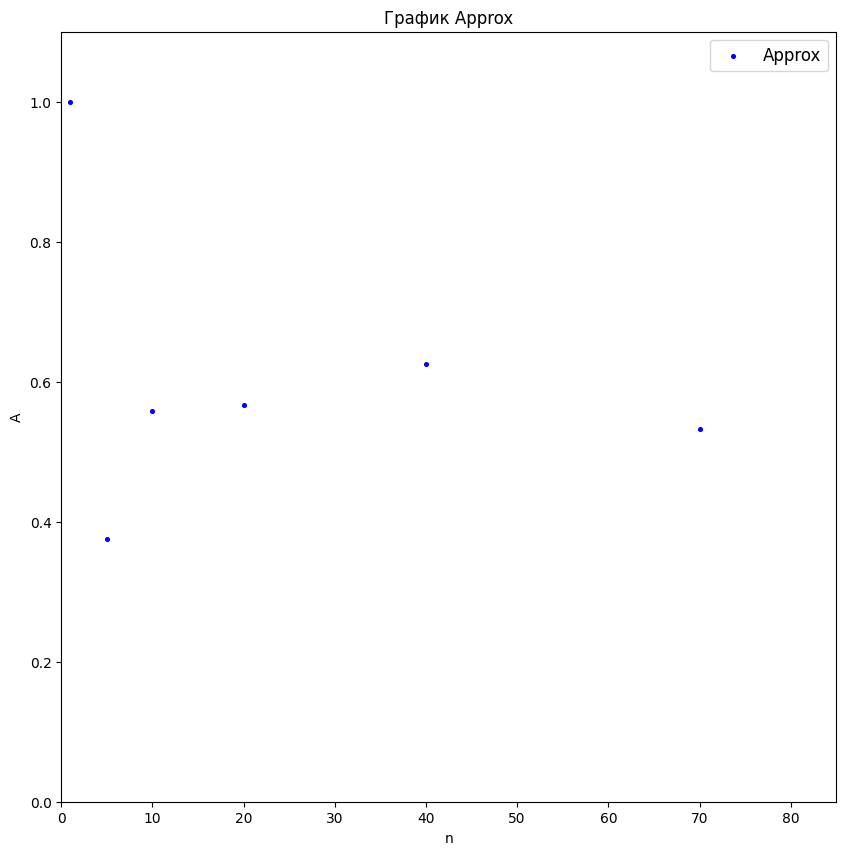

In [ ]:
Approx = [1, 0.375, 0.558, 0.567, 0.625, 0.533]
n = [1, 5, 10, 20, 40, 70]

plt.figure(figsize=(10,10))
plt.scatter(n,Approx,marker='o',s=7,color='b',label='Approx')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Approx')
plt.xlabel('n')
plt.ylabel('A')
plt.xlim([0, 85])
plt.ylim([0, 1.1])
plt.show()

In [ ]:
x = np.array(n)
y = np.array(Approx)

linear_func = lambda x, b0, b1: b0 + b1*x
quadratic_func = lambda x, b0, b1, b2: b0 + b1*x + b2*x**2
qubic_func = lambda x, b0, b1, b2, b3: b0 + b1*x + b2*x**2 + b3*x**3
exp_func = lambda x, b0, b1, b2: b0 + b1*np.exp(b2*x)
exp1_func = lambda x, b0, b1, b2: b0 + b1*np.exp(x-b2)
exp2_func = lambda x, b0, b1: b0*np.power(b1,x)
exp3_func = lambda x, b0, b1, b2:  b0 + b1*np.power(b2,x)


from scipy.optimize import leastsq

# list of model
model_list = [
    'linear', 'quadratic',
    'qubic']

# model reference
models_dict = {
        'linear':             linear_func,
        'quadratic':          quadratic_func,
        'qubic':              qubic_func}

# initial values
p0_dict = {
        'linear':             [0, 0],
        'quadratic':          [0, 0, 0],
        'qubic':              [0, 0, 0, 0]}

# titles (formulas)
formulas_dict = {
        'linear':             'y = b0 + b1*x',
        'quadratic':          'y = b0 + b1*x + b2*x^2',
        'qubic':              'y = b0 + b1*x + b2*x^2 + b3*x^3'}

# actual data
X_fact = x
Y_fact = y

# function for calculating residuals
residual_func = lambda p, x, y: y - func(x, *p)

# return all optional outputs
full_output = True

# variables to save the calculation results
calculation_results_df = pd.DataFrame(columns=['func', 'p0', 'popt', 'cov_x', 'SSE', 'MSE', 'pcov', 'perr', 'Y_calc', 'error_metrics'])
error_metrics_results_df = pd.DataFrame(columns=['MSE', 'RMSE', 'MAE', 'MSPE', 'MAPE', 'RMSLE', 'R2'])

# calculations
for func_name in model_list:
    print(f'{func_name.upper()} MODEL: {formulas_dict[func_name]}')
    func = models_dict[func_name]
    calculation_results_df.loc[func_name, 'func'] = func
    p0 = p0_dict[func_name]
    print(f'p0 = {p0}')
    calculation_results_df.loc[func_name, 'p0'] = p0
    if full_output:
        (popt, cov_x, infodict, mesg, ier) = leastsq(residual_func, p0, args=(X_fact, Y_fact), full_output=full_output)
        integer_flag = f'ier = {ier}, the solution was found' if ier<=4 else f'ier = {ier}, the solution was not found'
        print(integer_flag, '\n', mesg)
        calculation_results_df.loc[func_name, 'popt'] = popt
        print(f'parameters = {popt}')
        calculation_results_df.loc[func_name, 'cov_x'] = cov_x
        print(f'cov_x = \n{cov_x}')
        #SSE = (residual_func(popt, X_fact, Y_fact)**2).sum()
        SSE = (infodict['fvec']**2).sum()
        calculation_results_df.loc[func_name, 'SSE'] = SSE
        print(f'SSE = {SSE}')
        MSE = SSE / (len(Y_fact)-len(p0))
        calculation_results_df.loc[func_name, 'MSE'] = MSE
        print(f'MSE = {MSE}')
        pcov = cov_x * MSE
        calculation_results_df.loc[func_name, 'pcov'] = pcov
        print(f'pcov =\n {pcov}')
        perr = np.sqrt(np.diag(pcov))
        calculation_results_df.loc[func_name, 'perr'] = perr
        print(f'perr = {perr}\n')
    else:
        popt = leastsq(residual_func, p0, args=(X_fact, Y_fact), full_output=full_output)
        calculation_results_df.loc[func_name, 'popt'] = popt
        print(f'parameters = {popt}\n')
    Y_calc = func(X_fact, *popt)
    calculation_results_df.loc[func_name, 'Y_calc'] = Y_calc
    (error_metrics_dict, error_metrics_df) = regression_error_metrics(Yfact=Y_fact, Ycalc=Y_calc, model_name=func_name)
    calculation_results_df.loc[func_name, 'error_metrics'] = error_metrics_dict.values()
    error_metrics_results_df = pd.concat([error_metrics_results_df, error_metrics_df])

LINEAR MODEL: y = b0 + b1*x
p0 = [0, 0]
ier = 1, the solution was found 
 Both actual and predicted relative reductions in the sum of squares
  are at most 0.000000
parameters = [ 0.65805077 -0.00198839]
cov_x = 
[[ 3.37140114e-01 -7.00575806e-03]
 [-7.00575806e-03  2.87907863e-04]]
SSE = 0.20429886497120925
MSE = 0.05107471624280231
pcov =
 [[ 1.72193356e-02 -3.57817105e-04]
 [-3.57817105e-04  1.47048124e-05]]
perr = [0.13122247 0.00383469]

QUADRATIC MODEL: y = b0 + b1*x + b2*x^2
p0 = [0, 0, 0]
ier = 1, the solution was found 
 Both actual and predicted relative reductions in the sum of squares
  are at most 0.000000
parameters = [ 7.07160120e-01 -8.33076422e-03  8.98563703e-05]
cov_x = 
[[ 5.84215329e-01 -3.89150374e-02  4.52078496e-04]
 [-3.89150374e-02  4.40892865e-03 -5.83850504e-05]
 [ 4.52078496e-04 -5.83850504e-05  8.27177120e-07]]
SSE = 0.19453775556708527
MSE = 0.06484591852236175
pcov =
 [[ 3.78839796e-02 -2.52348134e-03  2.93154453e-05]
 [-2.52348134e-03  2.85901028e-04 -3

3 степень

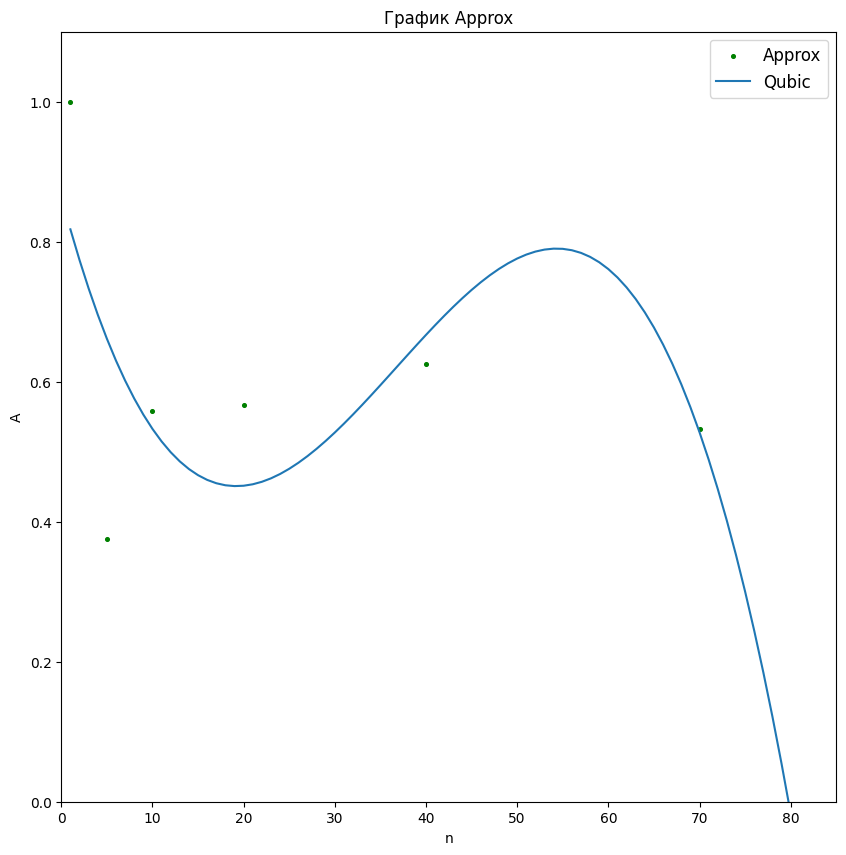

In [ ]:
b0, b1, b2, b3 = [ 8.64899986e-01, -4.89069273e-02,  1.72430495e-03, -1.56345797e-05]

xx = np.arange (1,81)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='g',label='Approx')
plt.plot(xx, b0 + b1*xx + b2*xx**2 + b3*xx**3 , label = 'Qubic')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Approx')
plt.xlabel('n')
plt.ylabel('A')
plt.xlim([0, 85])
plt.ylim([0, 1.1])
plt.show()

In [ ]:
from sympy import *

x = Symbol('x', real=True)
f = b0 + b1*x + b2*x**2 + b3*x**3
fprime = f.diff(x)

solve(fprime, x)

[19.1904194036733, 54.3348467301731]

In [ ]:
import sympy as sp

def f(x):
  z = b0 + b1*x + b2*x**2 + b3*x**3
  return z

# Объявляем символьную переменную x
x = sp.Symbol ("x")
# Вывод функции
print("f(x) =", f(x))
# Находим производную функции f(x) и сохраняем ее в переменной d_f:
d_f = sp.diff(f(x), x)
print("Первая производная функции:",d_f)

# Решаем уравнение d_f = 0:
x_extr = sp.solve (d_f)
print ("точка экстремума:", x_extr)

# Сохраняем точки экстремума в переменные:
x_0 = x_extr[0]
x_1 = x_extr[1]

# Находим вторую производную функции:
d2_f = sp.diff(f(x), x, 2)
print("Вторая производная функции:", d2_f)

# Решаем уравнение d2_f = 0
x_extr2 = sp.solve (d2_f)
print ("точка перегиба:", x_extr2)

# Находим значение второй производной в точках экстремума x_0 и x_1,
# Сохраняем их в переменные f_0_d2 и f_1_d2:
f_0_d2 = d2_f.evalf(subs = {x : x_0})
f_1_d2 = d2_f.evalf(subs = {x : x_1})

# Определяем, является ли точка x_0 точкой лок.минимума, максимума или перегиба
if f_0_d2 > 0:
  print(x_0, "- локальный минимум")
elif f_0_d2 < 0:
  print(x_0, "- локальный максимум")
else:
  print(x_0, "- точка перегиба")

# Определяем, является ли точка x_1 точкой лок.минимума, максимума или перегиба
if f_1_d2 > 0:
  print(x_1, "- локальный минимум")
elif f_1_d2 < 0:
  print(x_1, "- локальный максимум")
else:
  print(x_1, "- точка перегиба")

f(x) = -1.56345797e-5*x**3 + 0.00172430495*x**2 - 0.0489069273*x + 0.864899986
Первая производная функции: -4.69037391e-5*x**2 + 0.0034486099*x - 0.0489069273
точка экстремума: [19.1904194036733, 54.3348467301731]
Вторая производная функции: 0.0034486099 - 9.38074782e-5*x
точка перегиба: [36.7626330669232]
19.1904194036733 - локальный минимум
54.3348467301731 - локальный максимум


2 степень

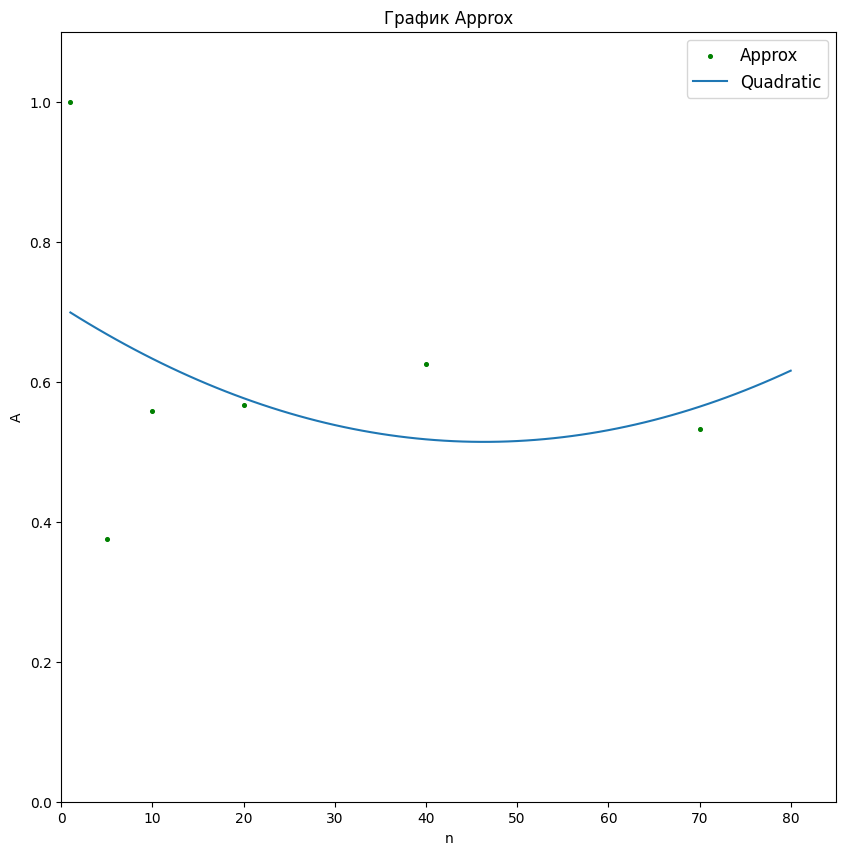

In [ ]:
b0, b1, b2 = [ 7.07160120e-01, -8.33076422e-03,  8.98563703e-05]

xx = np.arange (1,81)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='g',label='Approx')
plt.plot(xx, b0 + b1*xx + b2*xx**2 , label = 'Quadratic')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Approx')
plt.xlabel('n')
plt.ylabel('A')
plt.xlim([0, 85])
plt.ylim([0, 1.1])
plt.show()

In [ ]:
from sympy import *

x = Symbol('x', real=True)
f = b0 + b1*x + b2*x**2
fprime = f.diff(x)

solve(fprime, x)

[46.3560023189586]

### Сведенные графики Excess и Approx

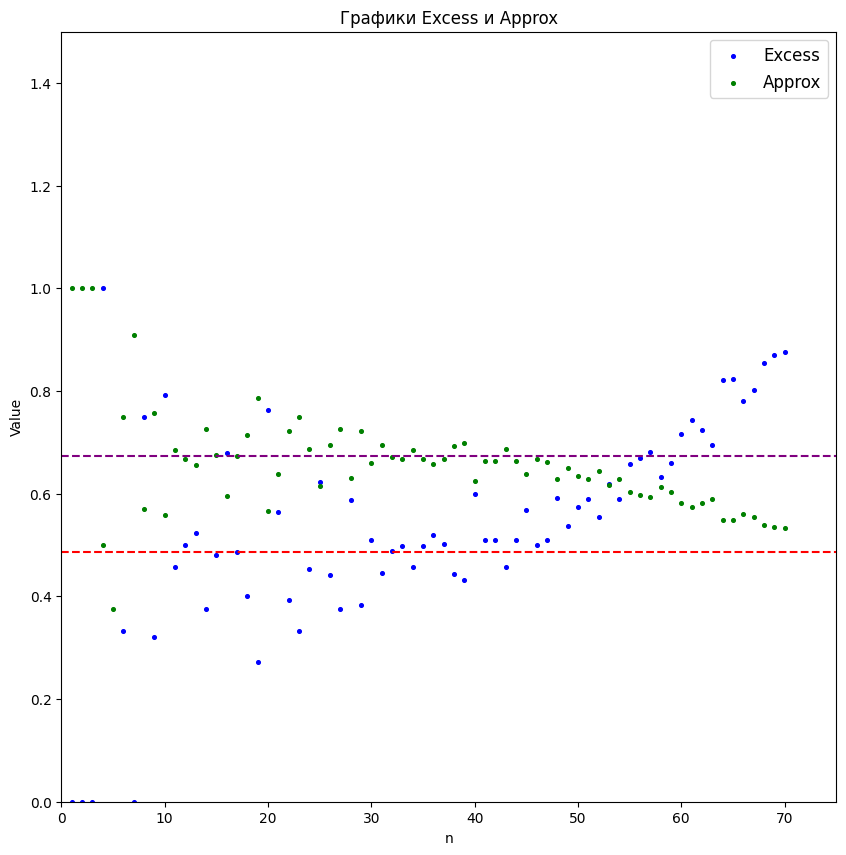

In [ ]:
Approx = [1, 1, 1, 0.5, 0.375, 0.75, 0.909, 0.571, 0.758, 0.558, 0.686, 0.667, 0.656, 0.727, 0.675, 0.596, 0.673, 0.714, 0.786, 0.567,
          0.638, 0.723, 0.75, 0.688, 0.616, 0.694, 0.727, 0.63, 0.723, 0.66, 0.694, 0.672, 0.667, 0.686, 0.668, 0.658, 0.667, 0.692, 0.699, 0.625,
          0.663, 0.663, 0.688, 0.663, 0.638, 0.667, 0.662, 0.629, 0.651, 0.635, 0.629, 0.644, 0.617, 0.629, 0.603, 0.598, 0.594, 0.613, 0.603, 0.582,
          0.574, 0.581, 0.59, 0.549, 0.549, 0.561, 0.555, 0.539, 0.535, 0.533]

Excess = [0, 0, 0, 1, 1.667, 0.333, 0, 0.75, 0.32, 0.792, 0.457, 0.5, 0.524, 0.375, 0.481, 0.679, 0.486,
     0.4, 0.273, 0.763, 0.565, 0.392, 0.333, 0.454, 0.623, 0.441, 0.375, 0.587, 0.383, 0.51, 0.445,
     0.489, 0.498, 0.458, 0.498, 0.52, 0.503, 0.444, 0.431, 0.599, 0.509, 0.509, 0.457, 0.51, 0.568,
     0.5, 0.509, 0.591, 0.538, 0.575, 0.589, 0.554, 0.619, 0.589, 0.657, 0.67, 0.682, 0.632, 0.659,
     0.716, 0.743, 0.725, 0.695, 0.822, 0.823, 0.781, 0.803, 0.855, 0.871, 0.876]

n = list(range(1, 71))


plt.figure(figsize=(10,10))
plt.scatter(n,Excess,marker='o',s=7,color='b',label='Excess')
plt.scatter(n,Approx,marker='o',s=7,color='g',label='Approx')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Графики Excess и Approx')
plt.hlines(0.486, 0, 75, color='r',linestyle='--')
plt.hlines(0.673, 0, 75, color='purple',linestyle='--')
plt.xlabel('n')
plt.ylabel('Value')
plt.xlim([0, 75])
plt.ylim([0, 1.5])
plt.show()

# Менее плотное покрытие


## Эллипс

[[ 0.1483254   0.46389426]
 [ 0.24781061 -0.29400562]
 [ 0.27104492  0.53562283]
 [ 0.20752362  0.55890536]
 [-0.36065651 -0.23394706]
 [ 0.32889457  0.59119093]
 [ 0.1027208  -0.16314625]
 [ 0.07486771  0.69276098]
 [-0.07728222 -0.51006536]
 [-0.07268589 -0.38308593]
 [-0.22368448  0.87448094]
 [ 0.30299437  0.17749814]
 [ 0.37115947 -0.01857393]
 [-0.32496657  0.30010919]
 [-0.32786215 -0.68740316]
 [ 0.23372681  0.83461182]
 [ 0.16449214 -0.81490001]
 [ 0.02099162  0.19390555]
 [-0.44602777  0.27510238]
 [ 0.38245108 -0.30300918]
 [-0.20720847  0.60612241]
 [ 0.19311201 -0.07303322]
 [ 0.02057051  0.35052636]
 [-0.01036766 -0.18519276]
 [ 0.20796996 -0.20667681]
 [-0.28252016  0.49497884]
 [ 0.21963078  0.05123529]
 [-0.13773842  0.28190274]
 [-0.08068988  0.9647738 ]
 [-0.37124435  0.25418828]
 [ 0.15651087 -0.38915454]
 [-0.37774631  0.44295538]
 [-0.29770727  0.76175407]
 [-0.32071964 -0.49095932]
 [ 0.40291604  0.57449568]
 [-0.14338157 -0.95732099]
 [-0.20845036 -0.22811138]
 

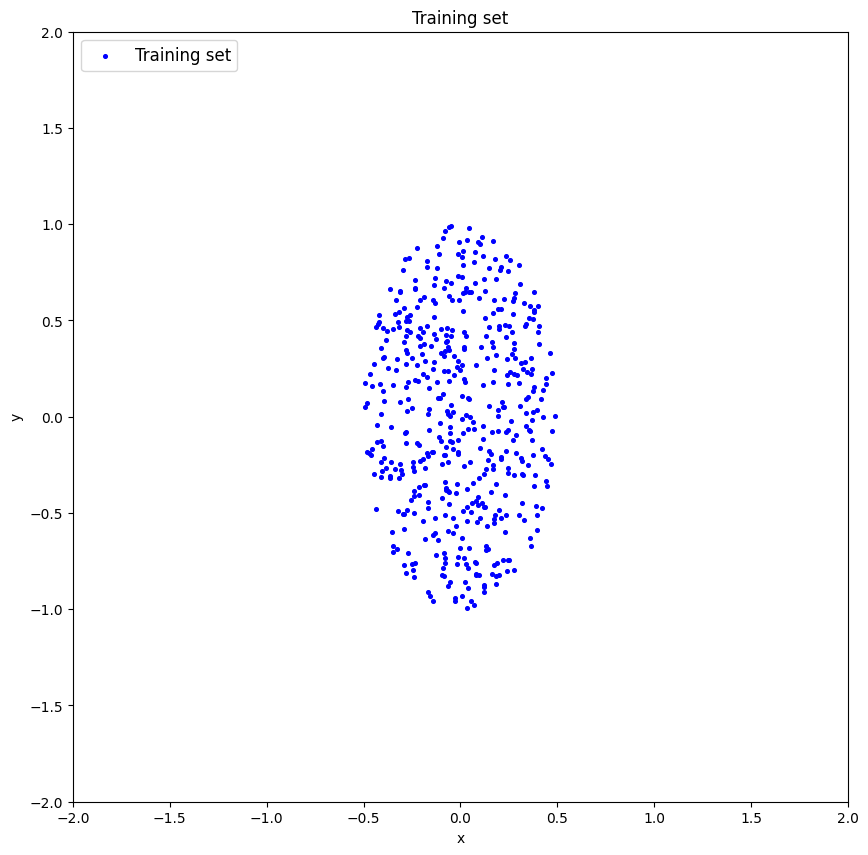

In [ ]:
# Функция для генерации координат точки
def generate_point():
  # Генерируем два случайных числа в диапазоне [-1, 1]
  x = np.random.uniform(-1, 1)
  y = np.random.uniform(-1, 1)
  return np.array([x, y])

# Функция для проверки, попадает ли точка внутрь круга
def is_inside_circle(point, center, vert_radius, hor_radius):
    x, y = point
    cx, cy = center

    distance_x = abs(x - cx)
    distance_y = abs(y - cy)

    if distance_x**2 / hor_radius**2 + distance_y**2 / vert_radius**2 <= 1:
        return True
    else:
        return False

# Параметры
n_points = 500  # Количество точек
vert_radius = 1  # Радиус по вертикали
hor_radius = 0.5  # Радиус по горизонтали

# Центры кругов
center = np.array([0, 0])

# Генерация массива точек
points = np.empty((n_points, 2))
for i in range(n_points):
  # Генерируем точку
  point = generate_point()

  # Проверяем, попадает ли она внутрь обоих кругов
  while not is_inside_circle(point, center, vert_radius, hor_radius):
    point = generate_point()

  # Добавляем точку в массив
  points[i] = point

# Печать массива точек
print(points)


In [ ]:
np.savetxt('data1.txt', data1)

In [ ]:
# Загрузка датасета

with open('/content/drive/My Drive/Colab Notebooks/data1.txt', 'r') as f:
    data1 = np.loadtxt(f)
data1

array([[ 0.1483254 ,  0.46389426],
       [ 0.24781061, -0.29400562],
       [ 0.27104492,  0.53562283],
       [ 0.20752362,  0.55890536],
       [-0.36065651, -0.23394706],
       [ 0.32889457,  0.59119093],
       [ 0.1027208 , -0.16314625],
       [ 0.07486771,  0.69276098],
       [-0.07728222, -0.51006536],
       [-0.07268589, -0.38308593],
       [-0.22368448,  0.87448094],
       [ 0.30299437,  0.17749814],
       [ 0.37115947, -0.01857393],
       [-0.32496657,  0.30010919],
       [-0.32786215, -0.68740316],
       [ 0.23372681,  0.83461182],
       [ 0.16449214, -0.81490001],
       [ 0.02099162,  0.19390555],
       [-0.44602777,  0.27510238],
       [ 0.38245108, -0.30300918],
       [-0.20720847,  0.60612241],
       [ 0.19311201, -0.07303322],
       [ 0.02057051,  0.35052636],
       [-0.01036766, -0.18519276],
       [ 0.20796996, -0.20667681],
       [-0.28252016,  0.49497884],
       [ 0.21963078,  0.05123529],
       [-0.13773842,  0.28190274],
       [-0.08068988,

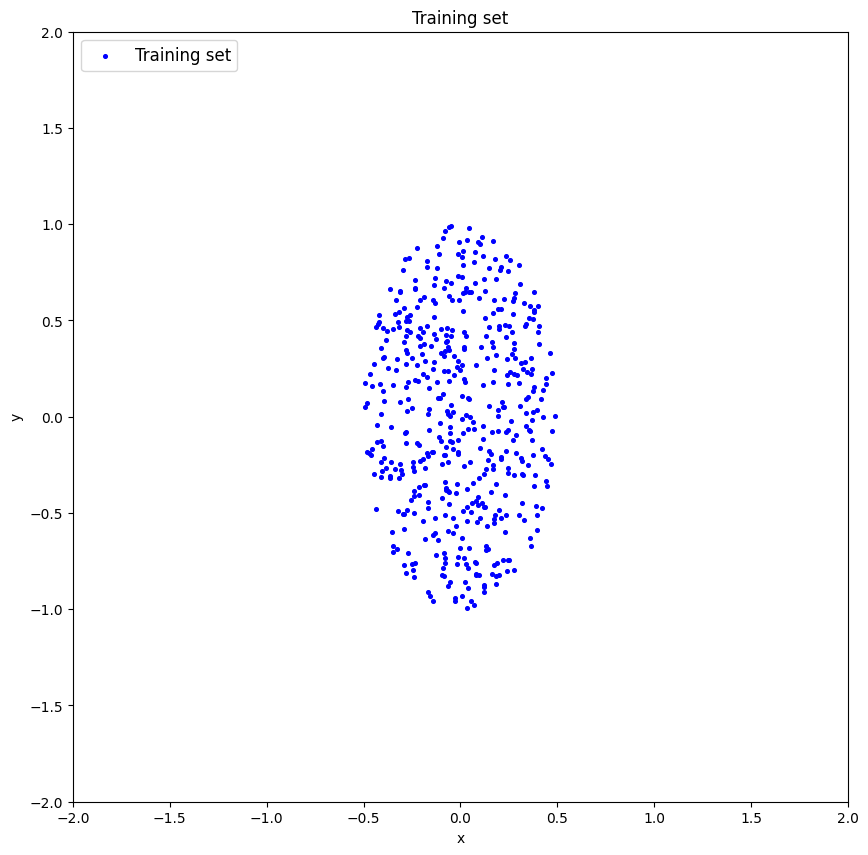

In [ ]:
plt.figure(figsize=(10,10))
plt.scatter(data1[:,0],data1[:,1],marker='o',s=7,color='b',label='Training set')
plt.legend(loc= 'upper left',fontsize=12)
plt.title('Training set')
plt.xlabel('x')
plt.ylabel('y')
plt.xlim([-2, 2])
plt.ylim([-2, 2])
plt.show()

### Обучение и построение EDCA

In [ ]:
#### Обучение Автокодировщика
size = data1.shape[1]
patience = 300
verbose_show = True
ae_el = tensorflow.keras.models.Sequential()

# input layer
ae_el.add(tensorflow.keras.layers.Dense(size))
ae_el.add(tensorflow.keras.layers.Activation('tanh'))

# hidden layers
ae_el.add(tensorflow.keras.layers.Dense(5))
ae_el.add(tensorflow.keras.layers.Activation('tanh'))
ae_el.add(tensorflow.keras.layers.Dense(3))
ae_el.add(tensorflow.keras.layers.Activation('tanh'))
ae_el.add(tensorflow.keras.layers.Dense(2))
ae_el.add(tensorflow.keras.layers.Activation('tanh'))
ae_el.add(tensorflow.keras.layers.Dense(3))
ae_el.add(tensorflow.keras.layers.Activation('tanh'))
ae_el.add(tensorflow.keras.layers.Dense(5))
ae_el.add(tensorflow.keras.layers.Activation('tanh'))

# output layer
ae_el.add(tensorflow.keras.layers.Dense(size))
ae_el.add(tensorflow.keras.layers.Activation('linear'))

optimizer = tensorflow.keras.optimizers.Adam(learning_rate=0.001, beta_1=0.9, beta_2=0.999, amsgrad=False)
ae_el.compile(loss='mean_squared_error', optimizer=optimizer)
error_stop = 0.0001
epo = 3000

early_stopping_callback_on_error = EarlyStoppingOnValue(monitor='loss', baseline=error_stop)
early_stopping_callback_on_improving = tensorflow.keras.callbacks.EarlyStopping(monitor='loss',
                                                                                           min_delta=0.0001, patience = patience,
                                                                                           verbose=1, mode='auto',
                                                                                           baseline=None,
                                                                                           restore_best_weights=False)

history_callback = tensorflow.keras.callbacks.History()
verbose = 1 if verbose_show else 0
history_object = ae_el.fit(data1, data1,
                                batch_size=data1.shape[0],
                                epochs=epo,
                                callbacks=[early_stopping_callback_on_error, history_callback,
                                early_stopping_callback_on_improving],
                                verbose=verbose)
ae_el_trainned = ae_el
ae_el_pred = ae_el_trainned.predict(data1)
ae_el_trainned.save('out/AE_el.h5')

Выходные данные были обрезаны до нескольких последних строк (5000).
1/1 [==============================] - 0s 18ms/step - loss: 0.0358
Epoch 261/3000
1/1 [==============================] - 0s 17ms/step - loss: 0.0358
Epoch 262/3000
1/1 [==============================] - 0s 18ms/step - loss: 0.0357
Epoch 263/3000
1/1 [==============================] - 0s 13ms/step - loss: 0.0356
Epoch 264/3000
1/1 [==============================] - 0s 16ms/step - loss: 0.0355
Epoch 265/3000
1/1 [==============================] - 0s 12ms/step - loss: 0.0355
Epoch 266/3000
1/1 [==============================] - 0s 15ms/step - loss: 0.0354
Epoch 267/3000
1/1 [==============================] - 0s 13ms/step - loss: 0.0353
Epoch 268/3000
1/1 [==============================] - 0s 12ms/step - loss: 0.0352
Epoch 269/3000
1/1 [==============================] - 0s 15ms/step - loss: 0.0352
Epoch 270/3000
1/1 [==============================] - 0s 17ms/step - loss: 0.0351
Epoch 271/3000
1/1 [=========================

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [ ]:
# Сохранение автокодировщика
ae_el.save('best_model_for_data1')

In [ ]:
# Загрузка автокодировщика
from keras.models import load_model
ae_el = load_model('best_model_for_data1')

ae_el_trainned = ae_el
ae_el_pred = ae_el_trainned.predict(data1)
ae_el_trainned.save('out/AE_el.h5')

16/16 [==============================] - 0s 2ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


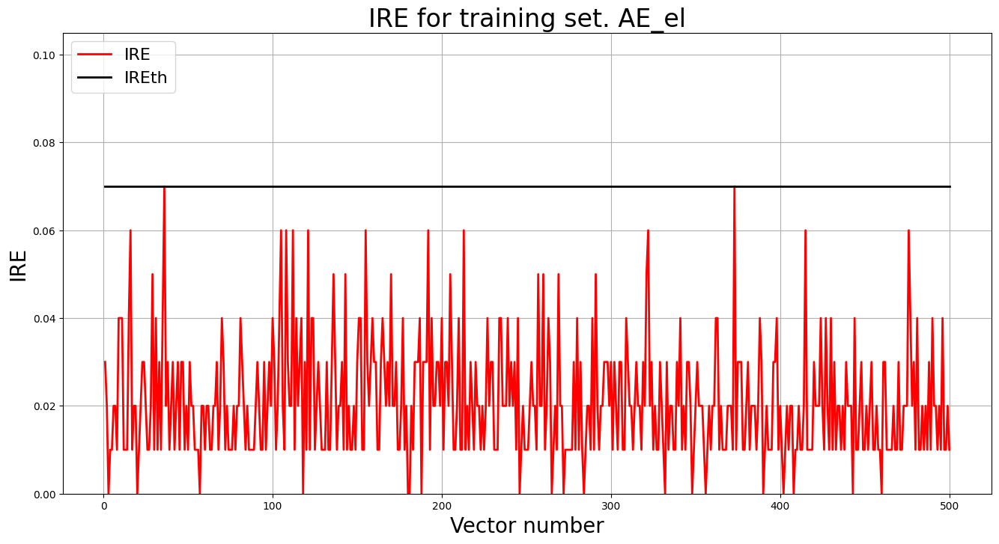

In [ ]:
irefile = 'out/AE_el_ire_th.txt'
IRE_array = np.round(ire_array(data1, ae_el_pred), 2)
IREth = np.amax(IRE_array)
with open(irefile, 'w') as file:
    file.write(str(IREth))

IRE1 = IRE_array
IREth_1 = IREth

lib.ire_plot('training', IRE1, IREth, 'AE_el')

313/313 [==============================] - 1s 2ms/step


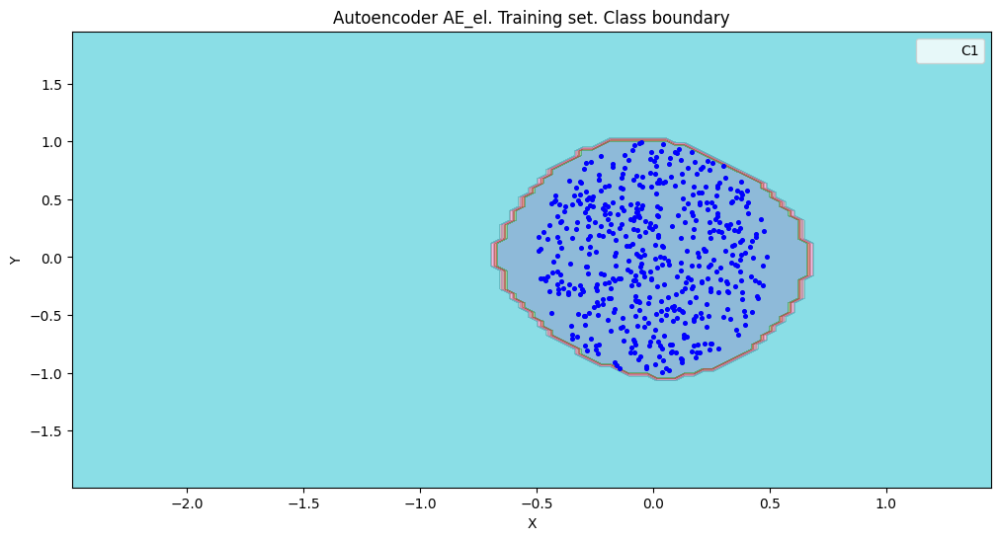

amount:  363
amount_ae:  846


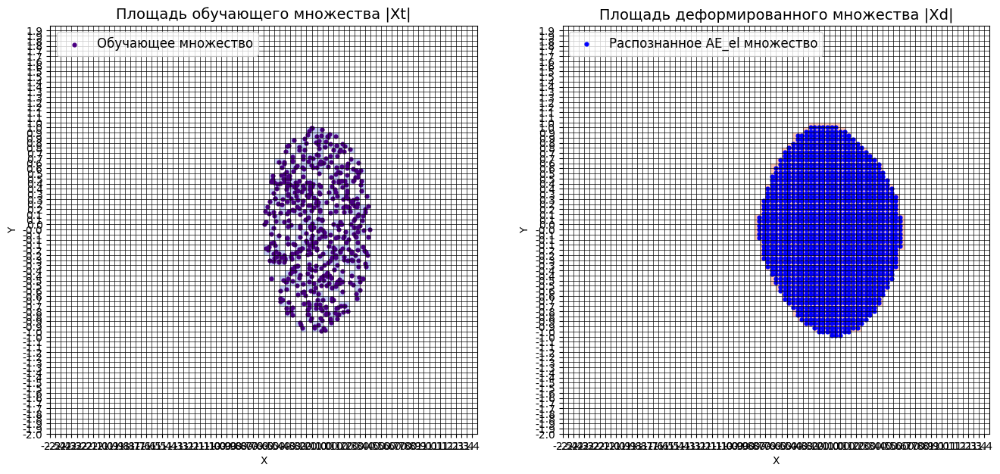

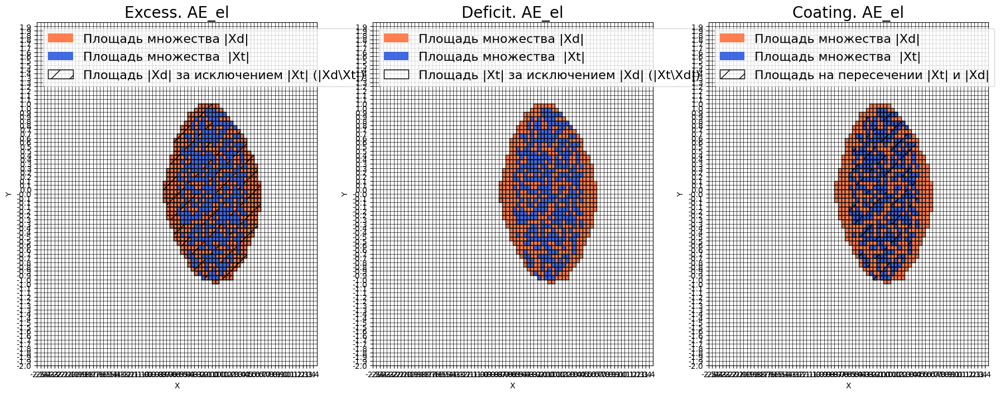


Оценка качества AE_el
IDEAL = 0. Excess:  1.3305785123966942
IDEAL = 0. Deficit:  0.0
IDEAL = 1. Coating:  1.0
summa:  1.0
IDEAL = 1. Extrapolation precision (Approx):  0.4290780141843972




In [ ]:
# построение областей покрытия и границ классов
# расчет характеристик качества обучения
# параметр numb_square, отвечающий за количество элементов разбиения по каждой оси пространства признаков
numb_square = 80

xx, yy, Z3 = lib.square_calc(numb_square, data1, ae_el_trainned, IREth_1, '_el', True)

### Плотное покрытие

In [ ]:
def generate_grid_points(n_points):
    x = np.linspace(-1, 1, n_points)
    y = np.linspace(-1, 1, n_points)

    points = [np.array([i, j]) for i in x for j in y]

    return points

# Функция для проверки, попадает ли точка внутрь эллипса
def is_inside_circle(point, center, vert_radius, hor_radius):
    x, y = point
    cx, cy = center

    distance_x = abs(x - cx)
    distance_y = abs(y - cy)

    if distance_x**2 / hor_radius**2 + distance_y**2 / vert_radius**2 <= 1:
        return True
    else:
        return False

# Параметры
n_points = 80  # Количество точек
vert_radius = 1  # Радиус по вертикали
hor_radius = 0.5  # Радиус по горизонтали

# Центры кругов
center = np.array([0, 0])


grid_points = generate_grid_points(n_points)
points = []

for point in grid_points:
  if is_inside_circle(point, center, vert_radius, hor_radius):
    points.append(point)

points = np.array(points)

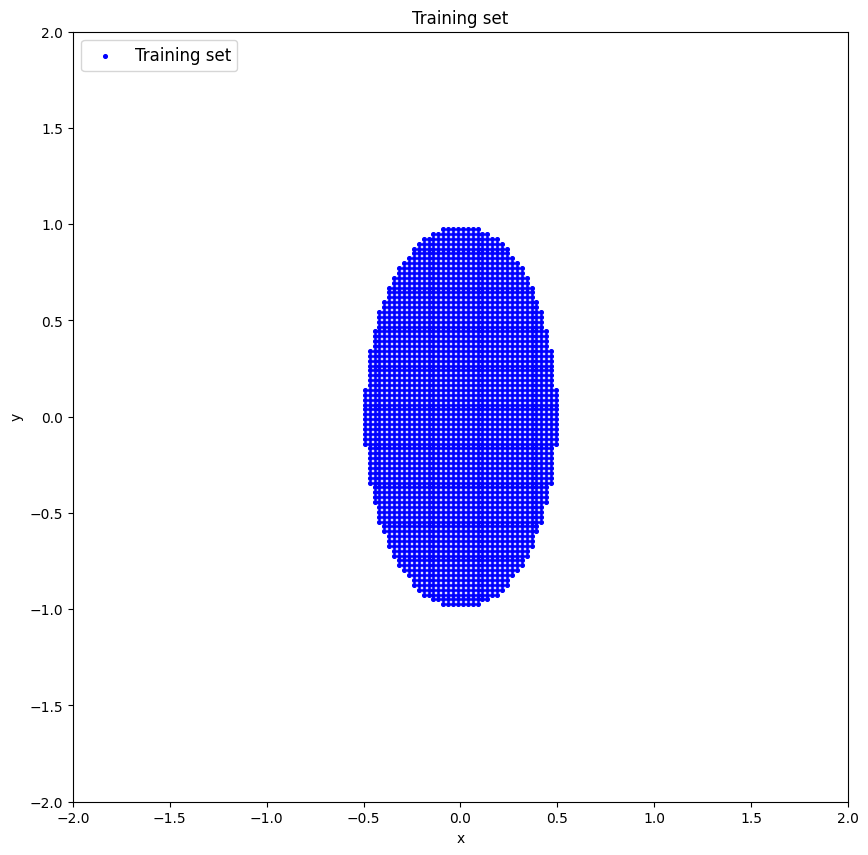

In [ ]:
plt.figure(figsize=(10,10))
plt.scatter(points[:,0],points[:,1],marker='o',s=7,color='b',label='Training set')
plt.legend(loc= 'upper left',fontsize=12)
plt.title('Training set')
plt.xlabel('x')
plt.ylabel('y')
plt.xlim([-2, 2])
plt.ylim([-2, 2])
plt.show()

data1_plot = points

2794/2794 [==============================] - 7s 3ms/step


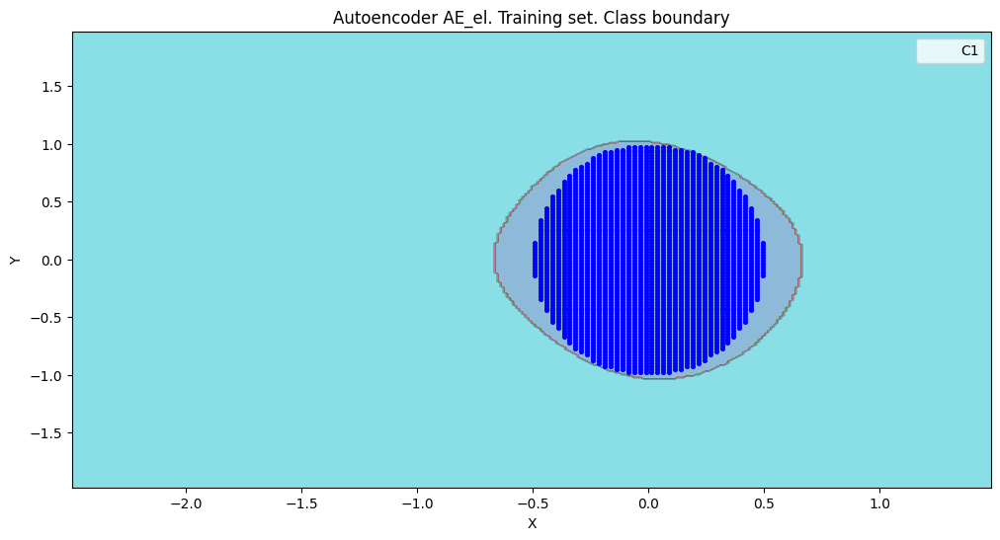

amount:  2452
amount_ae:  3311


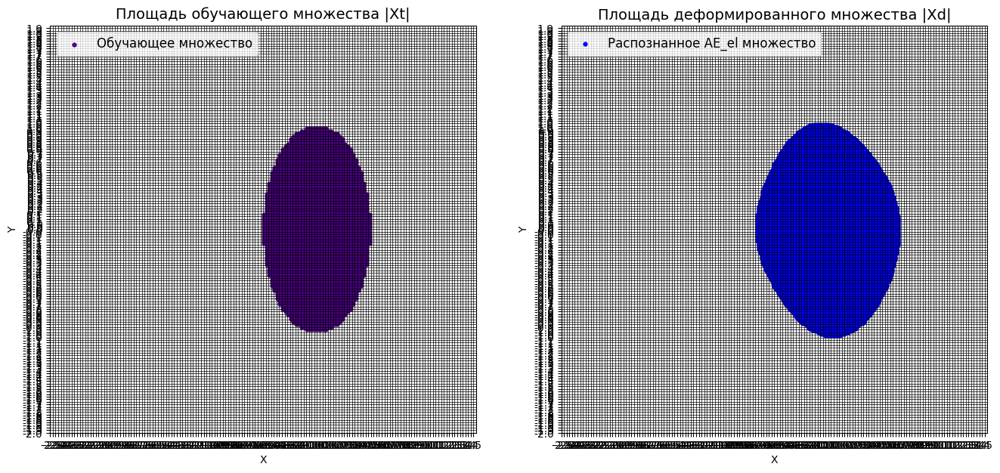

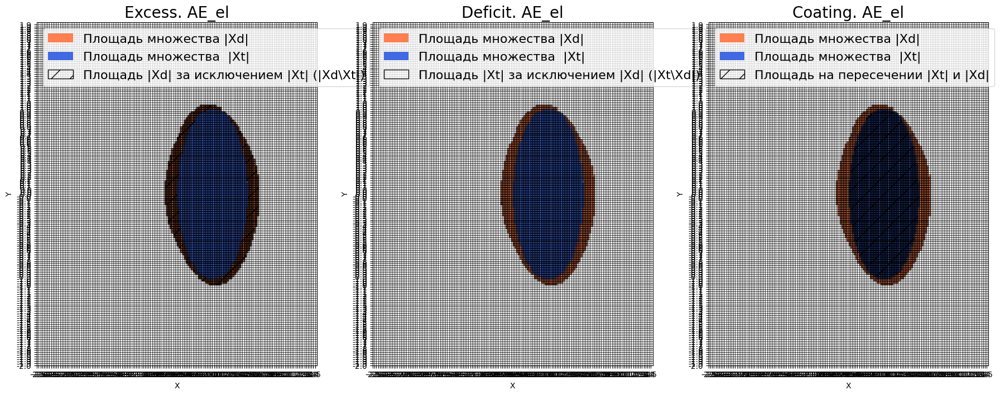


Оценка качества AE_el
IDEAL = 0. Excess:  0.350326264274062
IDEAL = 0. Deficit:  0.0
IDEAL = 1. Coating:  1.0
summa:  1.0
IDEAL = 1. Extrapolation precision (Approx):  0.7405617638175777




In [ ]:
# построение областей покрытия и границ классов
# расчет характеристик качества обучения
# параметр numb_square, отвечающий за количество элементов разбиения по каждой оси пространства признаков
numb_square = 158

xx, yy, Z3 = lib.square_calc1(numb_square, data1_plot, ae_el_trainned, IREth_1, '_el', True)

### График Excess

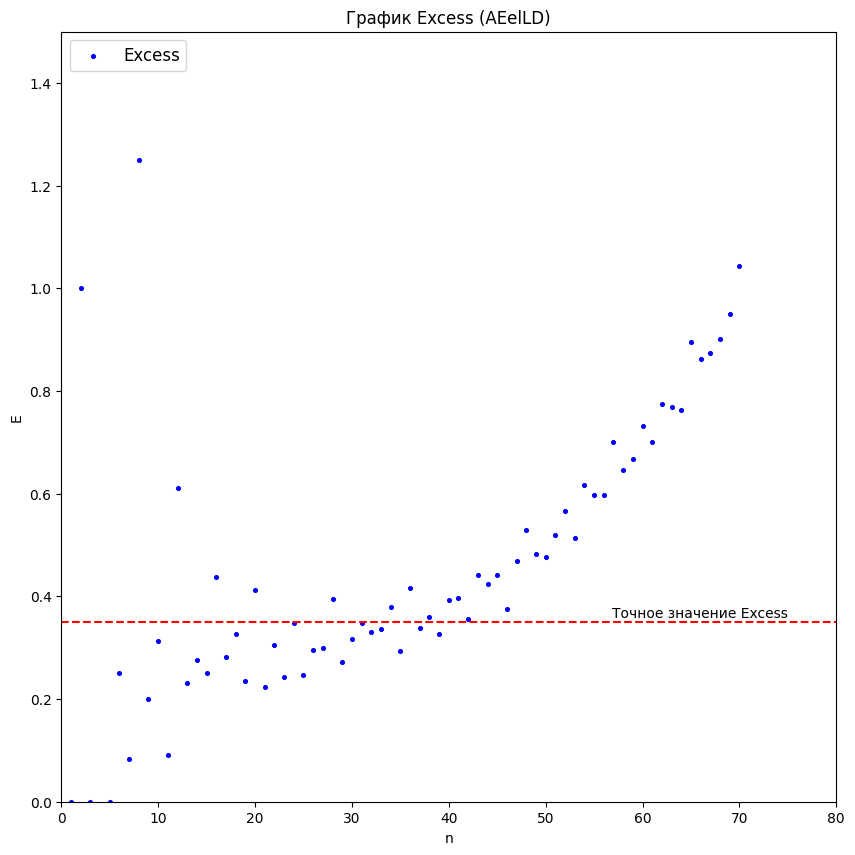

In [ ]:
Excess = [0, 1, 0, 3, 0, 0.25, 0.083, 1.25, 0.2, 0.313, 0.091, 0.611, 0.231, 0.276, 0.25, 0.438, 0.282, 0.326, 0.235, 0.413,
          0.224, 0.305, 0.243, 0.348, 0.247, 0.296, 0.299, 0.395, 0.273, 0.317, 0.349, 0.33, 0.336, 0.379, 0.294, 0.416, 0.338, 0.359, 0.327, 0.393,
          0.396, 0.355, 0.441, 0.424, 0.441, 0.376, 0.469, 0.529, 0.482, 0.476, 0.519, 0.567, 0.514, 0.617, 0.597, 0.597, 0.701, 0.646, 0.668, 0.732,
          0.701, 0.775, 0.768, 0.763, 0.896, 0.862, 0.874, 0.901, 0.951, 1.044]

n = list(range(1, 71))

plt.figure(figsize=(10,10))
plt.scatter(n,Excess,marker='o',s=7,color='b',label='Excess')
plt.legend(loc= 'upper left',fontsize=12)
plt.title('График Excess (AEelLD)')
plt.hlines(0.350, 0, 80, color='red',linestyle='--')
plt.text(75, 0.367, 'Точное значение Excess', ha='right', va='center')
plt.xlabel('n')
plt.ylabel('E')
plt.xlim([0, 80])
plt.ylim([0, 1.5])
plt.show()

### Среднее

In [ ]:
nn = np.arange(5,71)

av = []
for i in nn:
  av.append(np.mean(Excess[0:i]))

print(av)

[0.8, 0.7083333333333334, 0.619, 0.697875, 0.6425555555555555, 0.6096, 0.5624545454545454, 0.5665, 0.5406923076923077, 0.5217857142857143, 0.5036666666666666, 0.4995625, 0.486764705882353, 0.4778333333333334, 0.4650526315789474, 0.46245, 0.4510952380952381, 0.4444545454545455, 0.4356956521739131, 0.43204166666666666, 0.42463999999999996, 0.41969230769230764, 0.41522222222222216, 0.4144999999999999, 0.40962068965517234, 0.40653333333333325, 0.40467741935483864, 0.40234375, 0.4003333333333333, 0.3997058823529412, 0.3966857142857143, 0.39722222222222225, 0.3956216216216216, 0.3946578947368421, 0.39292307692307693, 0.392925, 0.393, 0.3920952380952381, 0.39323255813953484, 0.39393181818181816, 0.3949777777777777, 0.3945652173913043, 0.39614893617021274, 0.39891666666666675, 0.4006122448979592, 0.40212000000000003, 0.40441176470588236, 0.4075384615384615, 0.4095471698113207, 0.4133888888888889, 0.4167272727272728, 0.4199464285714286, 0.4248771929824562, 0.42868965517241386, 0.432745762711864

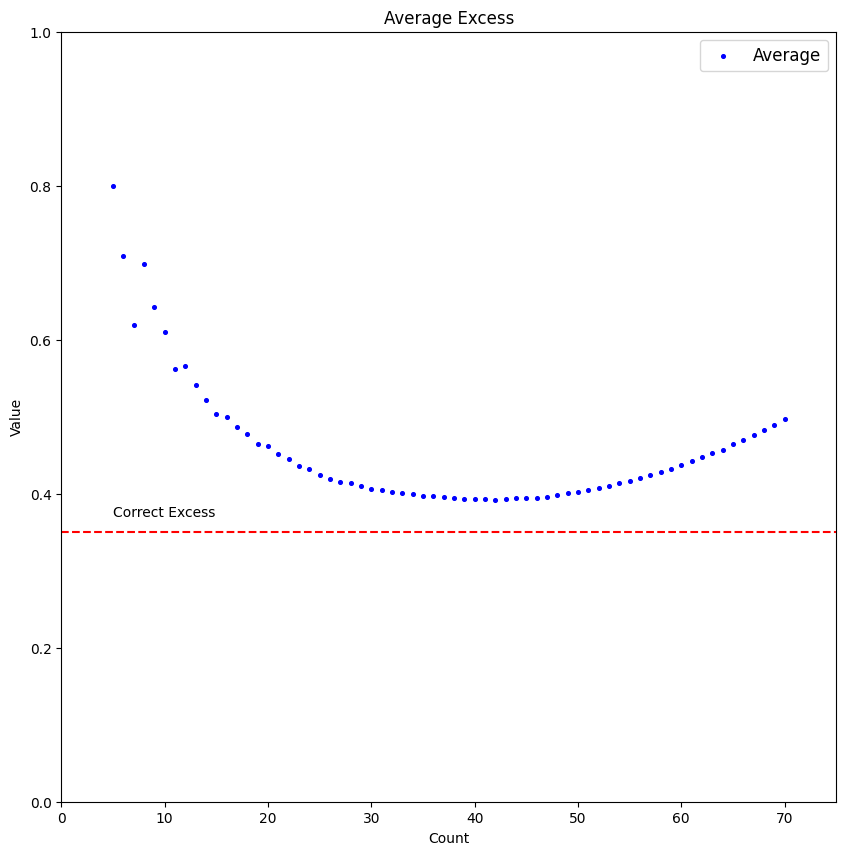

In [ ]:
plt.figure(figsize=(10,10))
plt.scatter(nn,av,marker='o',s=7,color='b',label='Average')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Average Excess')
plt.xlabel('Count')
plt.ylabel('Value')
plt.hlines(0.350, 0, 75, color='red',linestyle='--')
plt.text(5,0.37,'Correct Excess')
plt.xlim([0, 75])
plt.ylim([0, 1])
plt.show()

### Аппроксимация МНК

In [ ]:
x = np.array(n)
y = np.array(Excess)

In [ ]:
linear_func = lambda x, b0, b1: b0 + b1*x
quadratic_func = lambda x, b0, b1, b2: b0 + b1*x + b2*x**2
qubic_func = lambda x, b0, b1, b2, b3: b0 + b1*x + b2*x**2 + b3*x**3
exp_func = lambda x, b0, b1, b2: b0 + b1*np.exp(b2*x)
exp1_func = lambda x, b0, b1, b2: b0 + b1*np.exp(x-b2)
exp2_func = lambda x, b0, b1: b0*np.power(b1,x)
exp3_func = lambda x, b0, b1, b2:  b0 + b1*np.power(b2,x)
exp4_func = lambda x, b0, b1, b2, b3:  b0 + b1*np.power(b2,(x-b3))


from scipy.optimize import leastsq

# list of model
model_list = [
    'linear', 'quadratic',
    'qubic', 'exp3', 'exp4']

# model reference
models_dict = {
        'linear':             linear_func,
        'quadratic':          quadratic_func,
        'qubic':              qubic_func,
        'exp3':               exp3_func,
        'exp4':               exp4_func}

# initial values
p0_dict = {
        'linear':             [0, 0],
        'quadratic':          [0, 0, 0],
        'qubic':              [0, 0, 0, 0],
        'exp3':               [1, 1, 1],
        'exp4':               [1, 1, 1, 0]}

# titles (formulas)
formulas_dict = {
        'linear':             'y = b0 + b1*x',
        'quadratic':          'y = b0 + b1*x + b2*x^2',
        'qubic':              'y = b0 + b1*x + b2*x^2 + b3*x^3',
        'exp3':               'y = b0 + b1*np.power(b2,x)',
        'exp4':               'y = b0 + b1*np.power(b2,(x-b3))'}

# actual data
X_fact = x
Y_fact = y

# function for calculating residuals
residual_func = lambda p, x, y: y - func(x, *p)

# return all optional outputs
full_output = True

# variables to save the calculation results
calculation_results_df = pd.DataFrame(columns=['func', 'p0', 'popt', 'cov_x', 'SSE', 'MSE', 'pcov', 'perr', 'Y_calc', 'error_metrics'])
error_metrics_results_df = pd.DataFrame(columns=['MSE', 'RMSE', 'MAE', 'MSPE', 'MAPE', 'RMSLE', 'R2'])

# calculations
for func_name in model_list:
    print(f'{func_name.upper()} MODEL: {formulas_dict[func_name]}')
    func = models_dict[func_name]
    calculation_results_df.loc[func_name, 'func'] = func
    p0 = p0_dict[func_name]
    print(f'p0 = {p0}')
    calculation_results_df.loc[func_name, 'p0'] = p0
    if full_output:
        (popt, cov_x, infodict, mesg, ier) = leastsq(residual_func, p0, args=(X_fact, Y_fact), full_output=full_output)
        integer_flag = f'ier = {ier}, the solution was found' if ier<=4 else f'ier = {ier}, the solution was not found'
        print(integer_flag, '\n', mesg)
        calculation_results_df.loc[func_name, 'popt'] = popt
        print(f'parameters = {popt}')
        calculation_results_df.loc[func_name, 'cov_x'] = cov_x
        print(f'cov_x = \n{cov_x}')
        #SSE = (residual_func(popt, X_fact, Y_fact)**2).sum()
        SSE = (infodict['fvec']**2).sum()
        calculation_results_df.loc[func_name, 'SSE'] = SSE
        print(f'SSE = {SSE}')
        MSE = SSE / (len(Y_fact)-len(p0))
        calculation_results_df.loc[func_name, 'MSE'] = MSE
        print(f'MSE = {MSE}')
        pcov = cov_x * MSE
        calculation_results_df.loc[func_name, 'pcov'] = pcov
        print(f'pcov =\n {pcov}')
        perr = np.sqrt(np.diag(pcov))
        calculation_results_df.loc[func_name, 'perr'] = perr
        print(f'perr = {perr}\n')
    else:
        popt = leastsq(residual_func, p0, args=(X_fact, Y_fact), full_output=full_output)
        calculation_results_df.loc[func_name, 'popt'] = popt
        print(f'parameters = {popt}\n')
    Y_calc = func(X_fact, *popt)
    calculation_results_df.loc[func_name, 'Y_calc'] = Y_calc
    (error_metrics_dict, error_metrics_df) = regression_error_metrics(Yfact=Y_fact, Ycalc=Y_calc, model_name=func_name)
    calculation_results_df.loc[func_name, 'error_metrics'] = error_metrics_dict.values()
    error_metrics_results_df = pd.concat([error_metrics_results_df, error_metrics_df])

LINEAR MODEL: y = b0 + b1*x
p0 = [0, 0]
ier = 1, the solution was found 
 Both actual and predicted relative reductions in the sum of squares
  are at most 0.000000
parameters = [0.3083118  0.00531878]
cov_x = 
[[ 5.83850929e-02 -1.24223603e-03]
 [-1.24223603e-03  3.49925645e-05]]
SSE = 10.153440236479746
MSE = 0.14931529759529039
pcov =
 [[ 8.71778753e-03 -1.85484842e-04]
 [-1.85484842e-04  5.22492518e-06]]
perr = [0.09336909 0.00228581]

QUADRATIC MODEL: y = b0 + b1*x + b2*x^2
p0 = [0, 0, 0]
ier = 2, the solution was found 
 The relative error between two consecutive iterates is at most 0.000000
parameters = [ 6.79273258e-01 -2.55946722e-02  4.35400766e-04]
cov_x = 
[[ 1.36207525e-01 -7.72743868e-03  9.13408819e-05]
 [-7.72743868e-03  5.75426120e-04 -7.61174018e-06]
 [ 9.13408819e-05 -7.61174018e-06  1.07207608e-07]]
SSE = 8.385153193913611
MSE = 0.12515154020766583
pcov =
 [[ 1.70465815e-02 -9.67100852e-04  1.14314521e-05]
 [-9.67100852e-04  7.20154652e-05 -9.52621008e-07]
 [ 1.1431

<ipython-input-7-a10df777837d>:36: RuntimeWarning: divide by zero encountered in divide
  MSPE = (1/n_fit) *  np.sum(((Yfact-Ycalc)/Yfact)**2)
<ipython-input-7-a10df777837d>:37: RuntimeWarning: divide by zero encountered in divide
  MAPE = (1/n_fit) *  np.sum(abs((Yfact-Ycalc)/Yfact))
<ipython-input-7-a10df777837d>:36: RuntimeWarning: divide by zero encountered in divide
  MSPE = (1/n_fit) *  np.sum(((Yfact-Ycalc)/Yfact)**2)
<ipython-input-7-a10df777837d>:37: RuntimeWarning: divide by zero encountered in divide
  MAPE = (1/n_fit) *  np.sum(abs((Yfact-Ycalc)/Yfact))
<ipython-input-7-a10df777837d>:36: RuntimeWarning: divide by zero encountered in divide
  MSPE = (1/n_fit) *  np.sum(((Yfact-Ycalc)/Yfact)**2)
<ipython-input-7-a10df777837d>:37: RuntimeWarning: divide by zero encountered in divide
  MAPE = (1/n_fit) *  np.sum(abs((Yfact-Ycalc)/Yfact))
<ipython-input-7-a10df777837d>:36: RuntimeWarning: divide by zero encountered in divide
  MSPE = (1/n_fit) *  np.sum(((Yfact-Ycalc)/Yfact)**2)

ier = 1, the solution was found 
 Both actual and predicted relative reductions in the sum of squares
  are at most 0.000000
parameters = [ 539.39152246 -536.83258321    0.99999013  423.99085185]
cov_x = 
[[ 3.82185592e+13 -3.81979687e+13  7.00377626e+05  3.83476308e+12]
 [-3.81979687e+13  3.81809316e+13 -7.00000416e+05 -3.16399139e+12]
 [ 7.00377626e+05 -7.00000416e+05  1.28348330e-02  7.02513836e+04]
 [ 3.83476308e+12 -3.16399139e+12  7.02513836e+04  1.26624064e+14]]
SSE = 10.153653387296844
MSE = 0.15384323314086126
pcov =
 [[ 5.87966671e+12 -5.87649901e+12  1.07748358e+05  5.89952351e+11]
 [-5.87649901e+12  5.87387797e+12 -1.07690327e+05 -4.86758666e+11]
 [ 1.07748358e+05 -1.07690327e+05  1.97455221e-03  1.08077000e+04]
 [ 5.89952351e+11 -4.86758666e+11  1.08077000e+04  1.94802555e+13]]
perr = [2.42480241e+06 2.42360846e+06 4.44359337e-02 4.41364424e+06]



#### 1-я степень

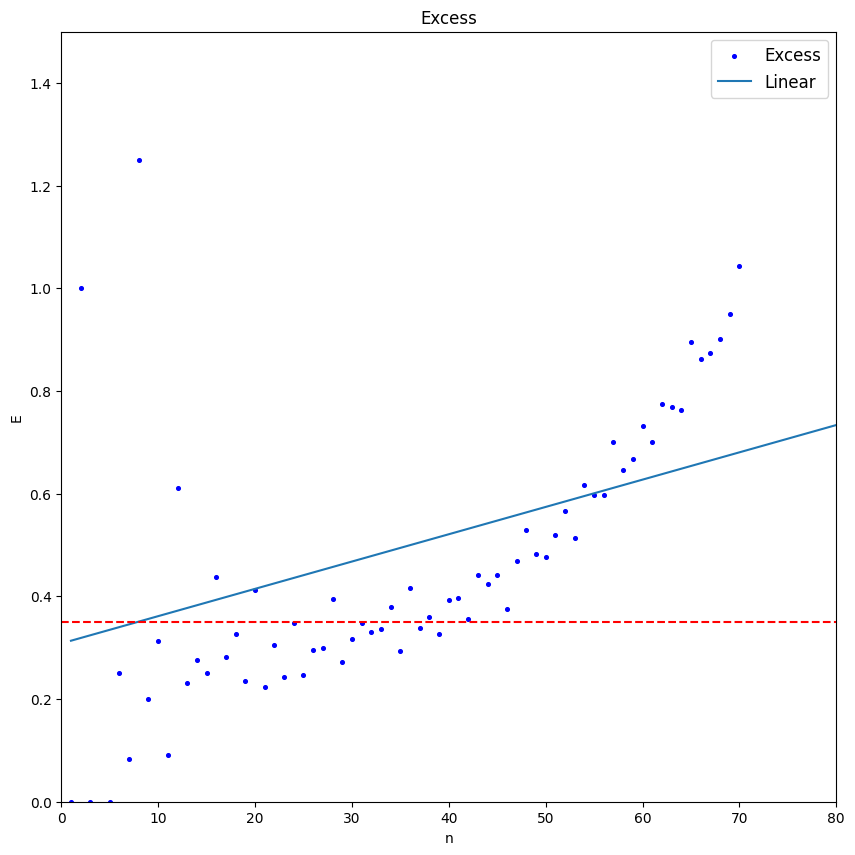

In [ ]:
b0, b1 = [0.3083118,  0.00531878]

xx = np.arange (1,81)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='b',label='Excess')
plt.plot(xx, b0 + b1*xx , label = 'Linear')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.hlines(0.350, 0, 80, color='red',linestyle='--')
plt.xlim([0, 80])
plt.ylim([0, 1.5])
plt.show()

#### 2-я степень

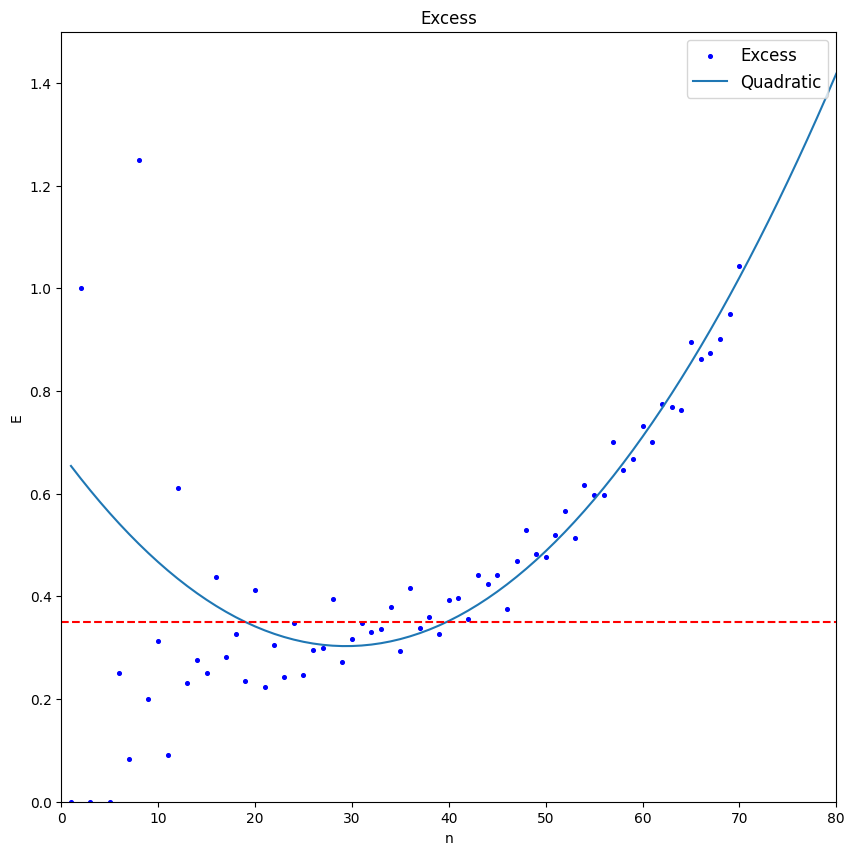

In [ ]:
# многочлен 2-й степени

b0, b1, b2 = [ 6.79273258e-01, -2.55946722e-02,  4.35400766e-04]

xx = np.arange (1,81)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='b',label='Excess')
plt.plot(xx, b0 + b1*xx + b2*xx**2 , label = 'Quadratic')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.hlines(0.350, 0, 80, color='red',linestyle='--')
plt.xlim([0, 80])
plt.ylim([0, 1.5])
plt.show()

In [ ]:
# Экстремум

def f(x):
    return 6.79273258e-01 -2.55946722e-02*x + 4.35400766e-04*x**2

from scipy.optimize import minimize_scalar
res = minimize_scalar(f)
print ('res.fun = ', res.fun)
print ('res.x = ', res.x)

res.fun =  0.30313287413957474
res.x =  29.392084052041618


#### 3-я степень

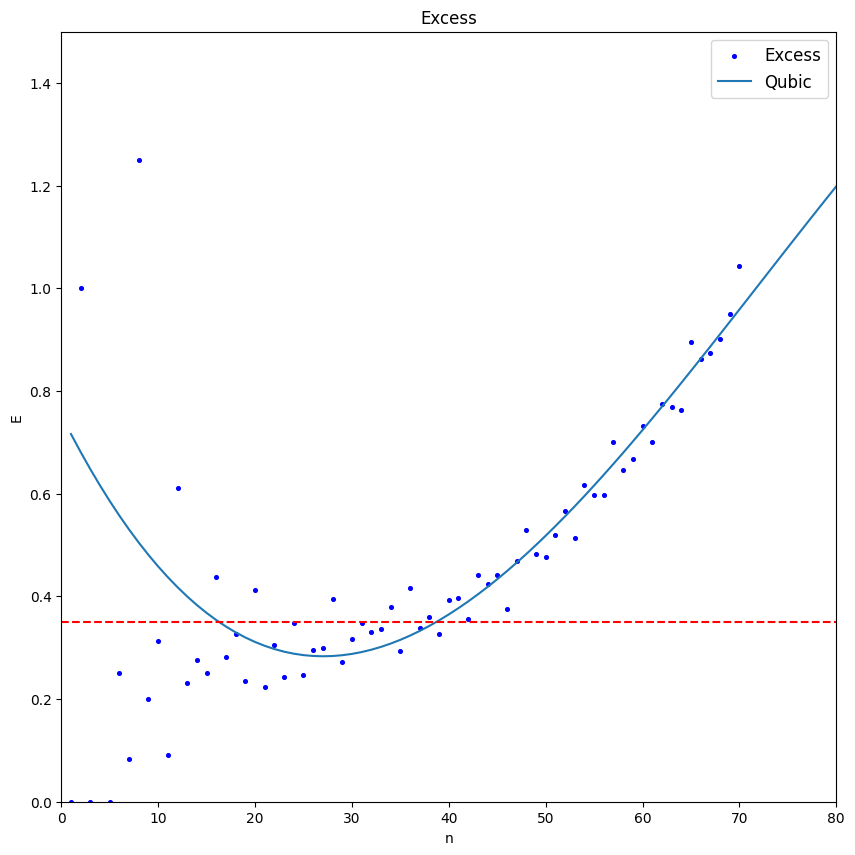

In [ ]:
b0, b1, b2, b3 = [ 7.53121730e-01, -3.76506373e-02,  8.56910328e-04, -3.95783625e-06]

xx = np.arange (1,81)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='b',label='Excess')
plt.plot(xx, b0 + b1*xx + b2*xx**2 + b3*xx**3 , label = 'Qubic')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.hlines(0.350, 0, 80, color='red',linestyle='--')
plt.xlim([0, 80])
plt.ylim([0, 1.5])
plt.show()

In [ ]:
# Экстремум

def f(x):
    return 7.53121730e-01 -3.76506373e-02*x + 8.56910328e-04*x**2 -3.95783625e-06*x**3

from scipy.optimize import minimize_scalar
res = minimize_scalar(f)
print ('res.fun = ', res.fun)
print ('res.x = ', res.x)

res.fun =  0.2833395451024343
res.x =  27.03102490206533


#### Экспонента

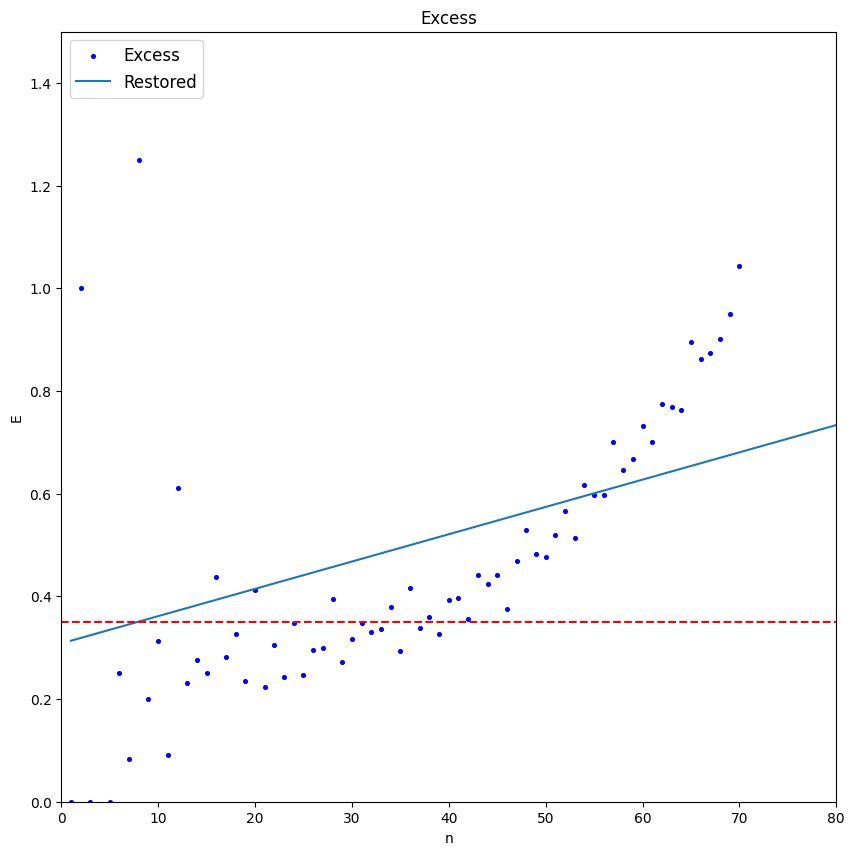

In [ ]:
b0, b1, b2 = [ 2.11600025e+03, -2.11569193e+03,  9.99997486e-01]

xx = np.arange (1,81)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='b',label='Excess')
plt.plot(xx, b0 + b1*np.power(b2,xx) , label = 'Restored')
plt.legend(loc= 'upper left',fontsize=12)
plt.title('Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.hlines(0.350, 0, 80, color='red',linestyle='--')
plt.xlim([0, 80])
plt.ylim([0, 1.5])
plt.show()

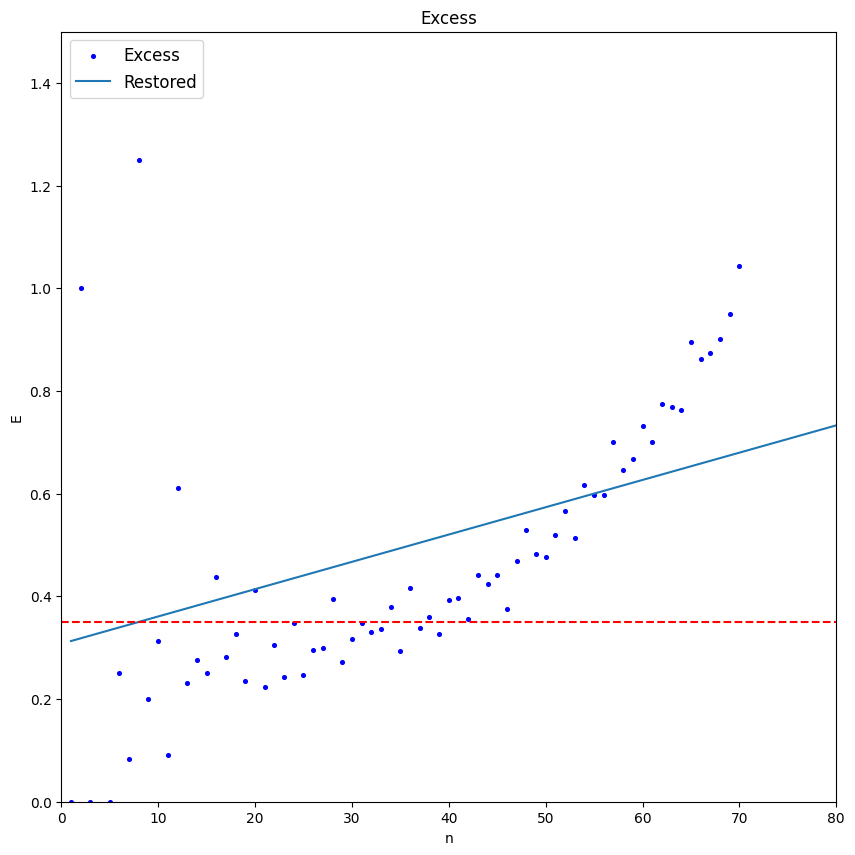

In [ ]:
b0, b1, b2, b3 = [ 539.39152246, -536.83258321,    0.99999013,  423.99085185]

xx = np.arange (1,81)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='b',label='Excess')
plt.plot(xx, b0 + b1*np.power(b2,(xx-b3)) , label = 'Restored')
plt.legend(loc= 'upper left',fontsize=12)
plt.title('Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.hlines(0.350, 0, 80, color='red',linestyle='--')
plt.xlim([0, 80])
plt.ylim([0, 1.5])
plt.show()

### Несколько точек (Excess)

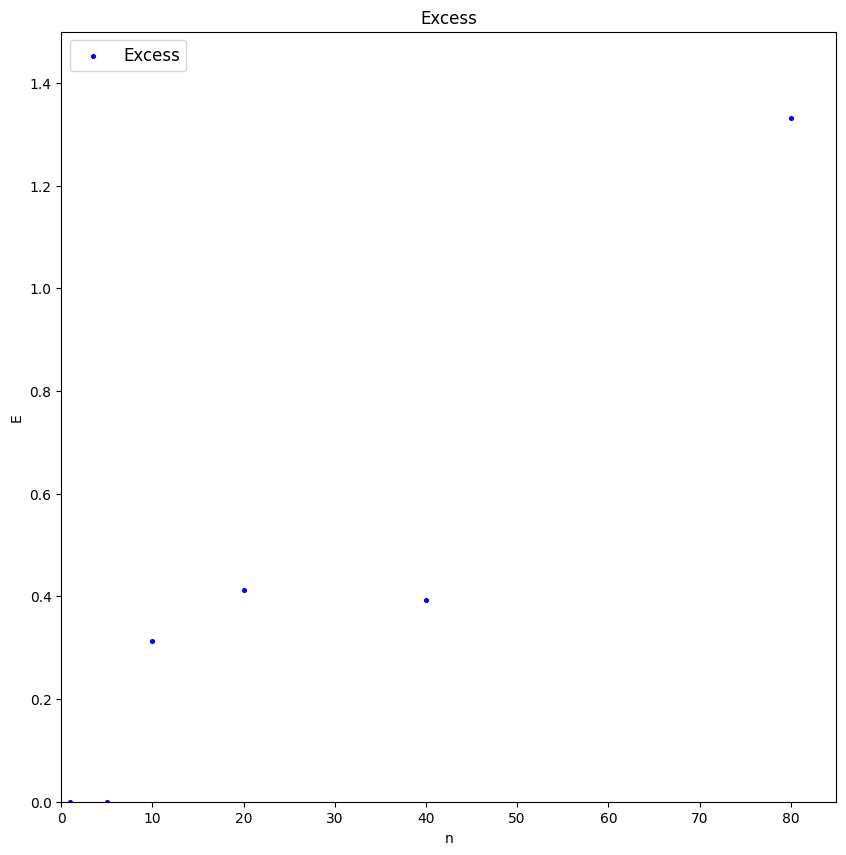

In [ ]:
Excess = [0, 0, 0.313, 0.413, 0.393, 1.331]
n = [1, 5, 10, 20, 40, 80]

plt.figure(figsize=(10,10))
plt.scatter(n,Excess,marker='o',s=7,color='b',label='Excess')
plt.legend(loc= 'upper left',fontsize=12)
plt.title('Excess')
# plt.hlines(0.350, 0, 80, color='red',linestyle='--')
plt.xlabel('n')
plt.ylabel('E')
plt.xlim([0, 85])
plt.ylim([0, 1.5])
plt.show()

In [ ]:
x = np.array(n)
y = np.array(Excess)

linear_func = lambda x, b0, b1: b0 + b1*x
quadratic_func = lambda x, b0, b1, b2: b0 + b1*x + b2*x**2
qubic_func = lambda x, b0, b1, b2, b3: b0 + b1*x + b2*x**2 + b3*x**3
exp_func = lambda x, b0, b1, b2: b0 + b1*np.exp(b2*x)
exp1_func = lambda x, b0, b1, b2: b0 + b1*np.exp(x-b2)
exp2_func = lambda x, b0, b1: b0*np.power(b1,x)
exp3_func = lambda x, b0, b1, b2:  b0 + b1*np.power(b2,x)


from scipy.optimize import leastsq

# list of model
model_list = [
    'linear', 'quadratic',
    'qubic']

# model reference
models_dict = {
        'linear':             linear_func,
        'quadratic':          quadratic_func,
        'qubic':              qubic_func}

# initial values
p0_dict = {
        'linear':             [0, 0],
        'quadratic':          [0, 0, 0],
        'qubic':              [0, 0, 0, 0]}

# titles (formulas)
formulas_dict = {
        'linear':             'y = b0 + b1*x',
        'quadratic':          'y = b0 + b1*x + b2*x^2',
        'qubic':              'y = b0 + b1*x + b2*x^2 + b3*x^3'}

# actual data
X_fact = x
Y_fact = y

# function for calculating residuals
residual_func = lambda p, x, y: y - func(x, *p)

# return all optional outputs
full_output = True

# variables to save the calculation results
calculation_results_df = pd.DataFrame(columns=['func', 'p0', 'popt', 'cov_x', 'SSE', 'MSE', 'pcov', 'perr', 'Y_calc', 'error_metrics'])
error_metrics_results_df = pd.DataFrame(columns=['MSE', 'RMSE', 'MAE', 'MSPE', 'MAPE', 'RMSLE', 'R2'])

# calculations
for func_name in model_list:
    print(f'{func_name.upper()} MODEL: {formulas_dict[func_name]}')
    func = models_dict[func_name]
    calculation_results_df.loc[func_name, 'func'] = func
    p0 = p0_dict[func_name]
    print(f'p0 = {p0}')
    calculation_results_df.loc[func_name, 'p0'] = p0
    if full_output:
        (popt, cov_x, infodict, mesg, ier) = leastsq(residual_func, p0, args=(X_fact, Y_fact), full_output=full_output)
        integer_flag = f'ier = {ier}, the solution was found' if ier<=4 else f'ier = {ier}, the solution was not found'
        print(integer_flag, '\n', mesg)
        calculation_results_df.loc[func_name, 'popt'] = popt
        print(f'parameters = {popt}')
        calculation_results_df.loc[func_name, 'cov_x'] = cov_x
        print(f'cov_x = \n{cov_x}')
        #SSE = (residual_func(popt, X_fact, Y_fact)**2).sum()
        SSE = (infodict['fvec']**2).sum()
        calculation_results_df.loc[func_name, 'SSE'] = SSE
        print(f'SSE = {SSE}')
        MSE = SSE / (len(Y_fact)-len(p0))
        calculation_results_df.loc[func_name, 'MSE'] = MSE
        print(f'MSE = {MSE}')
        pcov = cov_x * MSE
        calculation_results_df.loc[func_name, 'pcov'] = pcov
        print(f'pcov =\n {pcov}')
        perr = np.sqrt(np.diag(pcov))
        calculation_results_df.loc[func_name, 'perr'] = perr
        print(f'perr = {perr}\n')
    else:
        popt = leastsq(residual_func, p0, args=(X_fact, Y_fact), full_output=full_output)
        calculation_results_df.loc[func_name, 'popt'] = popt
        print(f'parameters = {popt}\n')
    Y_calc = func(X_fact, *popt)
    calculation_results_df.loc[func_name, 'Y_calc'] = Y_calc
    (error_metrics_dict, error_metrics_df) = regression_error_metrics(Yfact=Y_fact, Ycalc=Y_calc, model_name=func_name)
    calculation_results_df.loc[func_name, 'error_metrics'] = error_metrics_dict.values()
    error_metrics_results_df = pd.concat([error_metrics_results_df, error_metrics_df])

LINEAR MODEL: y = b0 + b1*x
p0 = [0, 0]
ier = 1, the solution was found 
 Both actual and predicted relative reductions in the sum of squares
  are at most 0.000000
parameters = [0.00181432 0.01563535]
cov_x = 
[[ 3.17896483e-01 -5.81652623e-03]
 [-5.81652623e-03  2.23712806e-04]]
SSE = 0.10137694854586125
MSE = 0.025344237136465313
pcov =
 [[ 8.05684385e-03 -1.47415420e-04]
 [-1.47415420e-04  5.66983042e-06]]
perr = [0.08975992 0.00238114]

QUADRATIC MODEL: y = b0 + b1*x + b2*x^2
p0 = [0, 0, 0]
ier = 1, the solution was found 
 Both actual and predicted relative reductions in the sum of squares
  are at most 0.000000
parameters = [6.33188988e-02 8.41937945e-03 8.87477614e-05]
cov_x = 
[[ 5.55248485e-01 -3.36635841e-02  3.42485137e-04]
 [-3.36635841e-02  3.49084018e-03 -4.01817465e-05]
 [ 3.42485137e-04 -4.01817465e-05  4.94187393e-07]]
SSE = 0.08543933966271278
MSE = 0.028479779887570927
pcov =
 [[ 1.58133546e-02 -9.58731464e-04  9.75390132e-06]
 [-9.58731464e-04  9.94183600e-05 -1.14

<ipython-input-7-a10df777837d>:36: RuntimeWarning: divide by zero encountered in divide
  MSPE = (1/n_fit) *  np.sum(((Yfact-Ycalc)/Yfact)**2)
<ipython-input-7-a10df777837d>:37: RuntimeWarning: divide by zero encountered in divide
  MAPE = (1/n_fit) *  np.sum(abs((Yfact-Ycalc)/Yfact))
<ipython-input-7-a10df777837d>:36: RuntimeWarning: divide by zero encountered in divide
  MSPE = (1/n_fit) *  np.sum(((Yfact-Ycalc)/Yfact)**2)
<ipython-input-7-a10df777837d>:37: RuntimeWarning: divide by zero encountered in divide
  MAPE = (1/n_fit) *  np.sum(abs((Yfact-Ycalc)/Yfact))
<ipython-input-7-a10df777837d>:36: RuntimeWarning: divide by zero encountered in divide
  MSPE = (1/n_fit) *  np.sum(((Yfact-Ycalc)/Yfact)**2)
<ipython-input-7-a10df777837d>:37: RuntimeWarning: divide by zero encountered in divide
  MAPE = (1/n_fit) *  np.sum(abs((Yfact-Ycalc)/Yfact))


3 степень

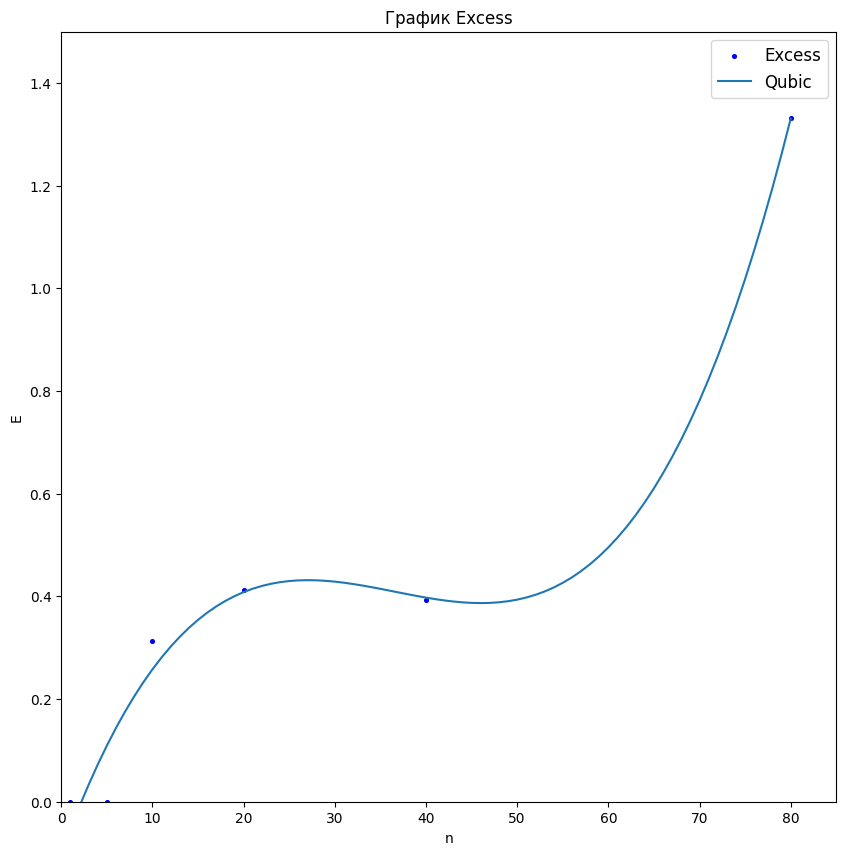

In [ ]:
b0, b1, b2, b3 = [-1.01292354e-01,  4.89728717e-02, -1.43655350e-03,  1.31015221e-05]

xx = np.arange (1,81)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='b',label='Excess')
plt.plot(xx, b0 + b1*xx + b2*xx**2 + b3*xx**3 , label = 'Qubic')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.xlim([0, 85])
plt.ylim([0, 1.5])
plt.show()

In [ ]:
import sympy as sp

def f(x):
  z = b0 + b1*x + b2*x**2 + b3*x**3
  return z

# Объявляем символьную переменную x
x = sp.Symbol ("x")
# Вывод функции
print("f(x) =", f(x))
# Находим производную функции f(x) и сохраняем ее в переменной d_f:
d_f = sp.diff(f(x), x)
print("Первая производная функции:",d_f)

# Решаем уравнение d_f = 0:
x_extr = sp.solve (d_f)
print ("точка экстремума:", x_extr)

# Сохраняем точки экстремума в переменные:
x_0 = x_extr[0]
x_1 = x_extr[1]

# Находим вторую производную функции:
d2_f = sp.diff(f(x), x, 2)
print("Вторая производная функции:", d2_f)

# Находим значение второй производной в точках экстремума x_0 и x_1,
# Сохраняем их в переменные f_0_d2 и f_1_d2:
f_0_d2 = d2_f.evalf(subs = {x : x_0})
f_1_d2 = d2_f.evalf(subs = {x : x_1})

# Определяем, является ли точка x_0 точкой лок.минимума, максимума или перегиба
if f_0_d2 > 0:
  print(x_0, "- локальный минимум")
elif f_0_d2 < 0:
  print(x_0, "- локальный максимум")
else:
  print(x_0, "- точка перегиба")

# Определяем, является ли точка x_1 точкой лок.минимума, максимума или перегиба
if f_1_d2 > 0:
  print(x_1, "- локальный минимум")
elif f_1_d2 < 0:
  print(x_1, "- локальный максимум")
else:
  print(x_1, "- точка перегиба")

f(x) = 1.31015221e-5*x**3 - 0.0014365535*x**2 + 0.0489728717*x - 0.101292354
Первая производная функции: 3.93045663e-5*x**2 - 0.002873107*x + 0.0489728717
точка экстремума: [27.0695409079311, 46.0290140556432]
Вторая производная функции: 7.86091326e-5*x - 0.002873107
27.0695409079311 - локальный максимум
46.0290140556432 - локальный минимум


2 степень

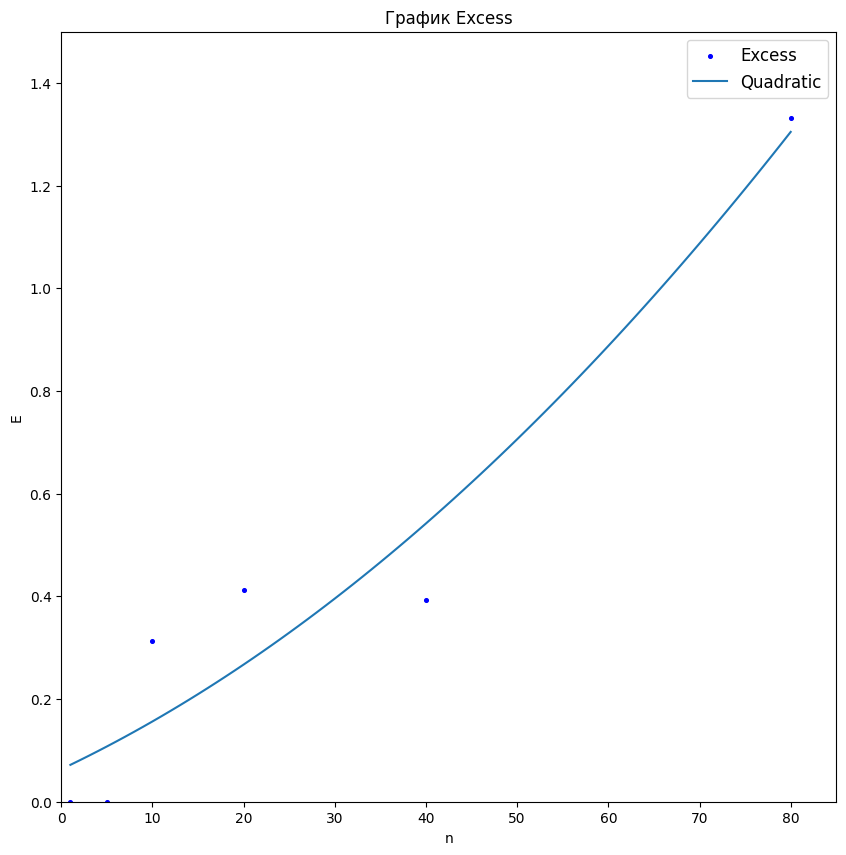

In [ ]:
b0, b1, b2 = [6.33188988e-02, 8.41937945e-03, 8.87477614e-05]

xx = np.arange (1,81)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='b',label='Excess')
plt.plot(xx, b0 + b1*xx + b2*xx**2 , label = 'Quadratic')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.xlim([0, 85])
plt.ylim([0, 1.5])
plt.show()

### График Approx

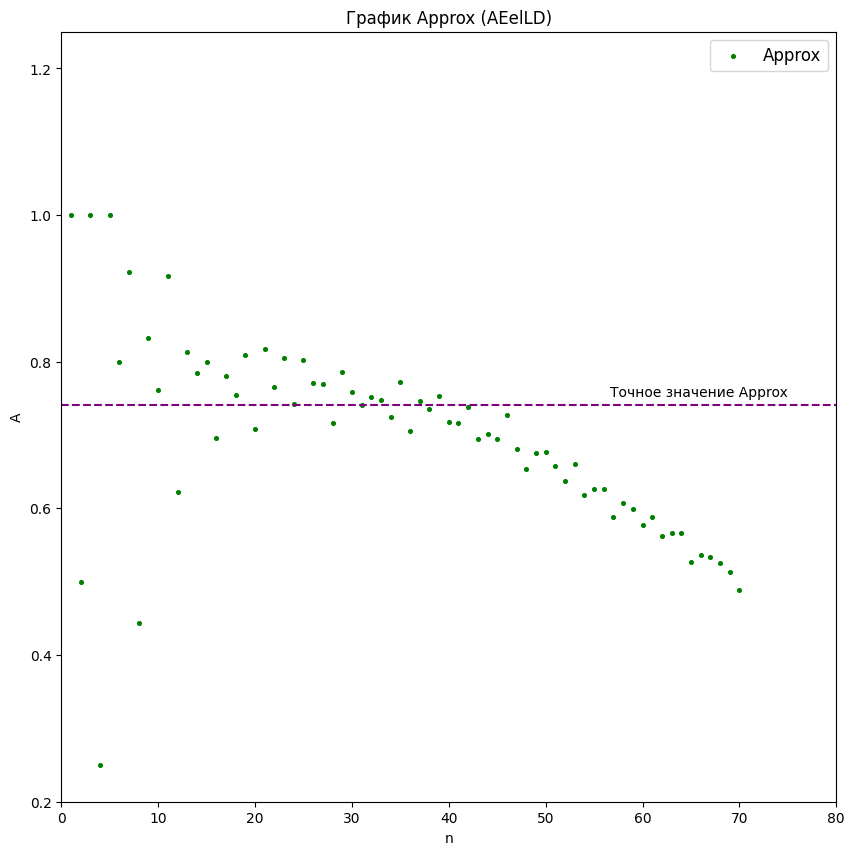

In [ ]:
Approx = [1, 0.5, 1, 0.25, 1, 0.8, 0.923, 0.444, 0.833, 0.762, 0.917, 0.623, 0.813, 0.784, 0.799, 0.696, 0.78, 0.754, 0.809, 0.708,
          0.817, 0.766, 0.805, 0.742, 0.802, 0.771, 0.769, 0.717, 0.786, 0.759, 0.741, 0.752, 0.748, 0.725, 0.773, 0.706, 0.747, 0.735, 0.753, 0.718,
          0.716, 0.738, 0.694, 0.702, 0.694, 0.727, 0.681, 0.654, 0.675, 0.677, 0.658, 0.638, 0.661, 0.618, 0.626, 0.627, 0.588, 0.607, 0.599, 0.577,
          0.588, 0.563, 0.567, 0.567, 0.527, 0.537, 0.534, 0.526, 0.513, 0.489]

n = list(range(1, 71))

plt.figure(figsize=(10,10))
plt.scatter(n,Approx,marker='o',s=7,color='g',label='Approx')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Approx (AEelLD)')
plt.hlines(0.741, 0, 80, color='purple',linestyle='--')
plt.text(75, 0.758, 'Точное значение Approx', ha='right', va='center')
plt.xlabel('n')
plt.ylabel('A')
plt.xlim([0, 80])
plt.ylim([0.2, 1.25])
plt.show()

### Среднее Approx

In [ ]:
nn = np.arange(1,71)

av = []
for i in nn:
  av.append(np.mean(Approx[0:i]))

print(av)

[1.0, 0.75, 0.8333333333333334, 0.6875, 0.75, 0.7583333333333333, 0.7818571428571428, 0.739625, 0.75, 0.7512000000000001, 0.7662727272727273, 0.7543333333333333, 0.7588461538461538, 0.7606428571428572, 0.7632, 0.759, 0.760235294117647, 0.7598888888888888, 0.7624736842105262, 0.7597499999999999, 0.7624761904761903, 0.7626363636363636, 0.7644782608695652, 0.7635416666666667, 0.76508, 0.7653076923076922, 0.7654444444444444, 0.7637142857142856, 0.7644827586206896, 0.7643, 0.7635483870967741, 0.7631875, 0.7627272727272728, 0.7616176470588236, 0.7619428571428573, 0.760388888888889, 0.7600270270270271, 0.7593684210526316, 0.7592051282051282, 0.7581749999999999, 0.7571463414634146, 0.7566904761904761, 0.7552325581395349, 0.7540227272727272, 0.752688888888889, 0.7521304347826087, 0.7506170212765957, 0.7486041666666668, 0.7471020408163266, 0.7457, 0.7439803921568628, 0.7419423076923077, 0.7404150943396227, 0.7381481481481482, 0.7361090909090909, 0.7341607142857143, 0.7315964912280701, 0.72944827

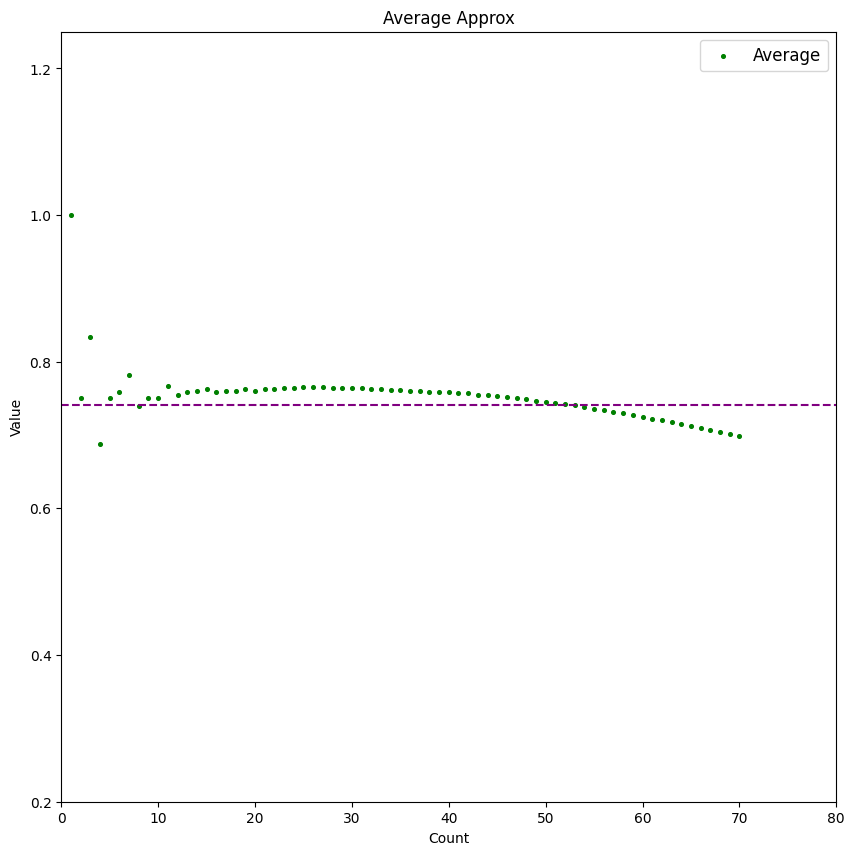

In [ ]:
plt.figure(figsize=(10,10))
plt.scatter(nn,av,marker='o',s=7,color='g',label='Average')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Average Approx')
plt.xlabel('Count')
plt.ylabel('Value')
plt.hlines(0.741, 0, 80, color='purple',linestyle='--')
plt.xlim([0, 80])
plt.ylim([0.2, 1.25])
plt.show()

### Аппроксимация МНК (Approx)

In [ ]:
x = np.array(n)
y = np.array(Approx)

linear_func = lambda x, b0, b1: b0 + b1*x
quadratic_func = lambda x, b0, b1, b2: b0 + b1*x + b2*x**2
qubic_func = lambda x, b0, b1, b2, b3: b0 + b1*x + b2*x**2 + b3*x**3
exp_func = lambda x, b0, b1, b2: b0 + b1*np.exp(b2*x)
exp1_func = lambda x, b0, b1, b2: b0 + b1*np.exp(x-b2)
exp2_func = lambda x, b0, b1: b0*np.power(b1,x)
exp3_func = lambda x, b0, b1, b2:  b0 + b1*np.power(b2,x)


from scipy.optimize import leastsq

# list of model
model_list = [
    'linear', 'quadratic',
    'qubic', 'EXP']

# model reference
models_dict = {
        'linear':             linear_func,
        'quadratic':          quadratic_func,
        'qubic':              qubic_func,
        'EXP':                exp3_func}

# initial values
p0_dict = {
        'linear':             [0, 0],
        'quadratic':          [0, 0, 0],
        'qubic':              [0, 0, 0, 0],
        'EXP':                [1, 1, 1]}

# titles (formulas)
formulas_dict = {
        'linear':             'y = b0 + b1*x',
        'quadratic':          'y = b0 + b1*x + b2*x^2',
        'qubic':              'y = b0 + b1*x + b2*x^2 + b3*x^3',
        'EXP':                'y = b0 +b1*b2^x'}

# actual data
X_fact = x
Y_fact = y

# function for calculating residuals
residual_func = lambda p, x, y: y - func(x, *p)

# return all optional outputs
full_output = True

# variables to save the calculation results
calculation_results_df = pd.DataFrame(columns=['func', 'p0', 'popt', 'cov_x', 'SSE', 'MSE', 'pcov', 'perr', 'Y_calc', 'error_metrics'])
error_metrics_results_df = pd.DataFrame(columns=['MSE', 'RMSE', 'MAE', 'MSPE', 'MAPE', 'RMSLE', 'R2'])

# calculations
for func_name in model_list:
    print(f'{func_name.upper()} MODEL: {formulas_dict[func_name]}')
    func = models_dict[func_name]
    calculation_results_df.loc[func_name, 'func'] = func
    p0 = p0_dict[func_name]
    print(f'p0 = {p0}')
    calculation_results_df.loc[func_name, 'p0'] = p0
    if full_output:
        (popt, cov_x, infodict, mesg, ier) = leastsq(residual_func, p0, args=(X_fact, Y_fact), full_output=full_output)
        integer_flag = f'ier = {ier}, the solution was found' if ier<=4 else f'ier = {ier}, the solution was not found'
        print(integer_flag, '\n', mesg)
        calculation_results_df.loc[func_name, 'popt'] = popt
        print(f'parameters = {popt}')
        calculation_results_df.loc[func_name, 'cov_x'] = cov_x
        print(f'cov_x = \n{cov_x}')
        #SSE = (residual_func(popt, X_fact, Y_fact)**2).sum()
        SSE = (infodict['fvec']**2).sum()
        calculation_results_df.loc[func_name, 'SSE'] = SSE
        print(f'SSE = {SSE}')
        MSE = SSE / (len(Y_fact)-len(p0))
        calculation_results_df.loc[func_name, 'MSE'] = MSE
        print(f'MSE = {MSE}')
        pcov = cov_x * MSE
        calculation_results_df.loc[func_name, 'pcov'] = pcov
        print(f'pcov =\n {pcov}')
        perr = np.sqrt(np.diag(pcov))
        calculation_results_df.loc[func_name, 'perr'] = perr
        print(f'perr = {perr}\n')
    else:
        popt = leastsq(residual_func, p0, args=(X_fact, Y_fact), full_output=full_output)
        calculation_results_df.loc[func_name, 'popt'] = popt
        print(f'parameters = {popt}\n')
    Y_calc = func(X_fact, *popt)
    calculation_results_df.loc[func_name, 'Y_calc'] = Y_calc
    (error_metrics_dict, error_metrics_df) = regression_error_metrics(Yfact=Y_fact, Ycalc=Y_calc, model_name=func_name)
    calculation_results_df.loc[func_name, 'error_metrics'] = error_metrics_dict.values()
    error_metrics_results_df = pd.concat([error_metrics_results_df, error_metrics_df])

LINEAR MODEL: y = b0 + b1*x
p0 = [0, 0]
ier = 3, the solution was found 
 Both actual and predicted relative reductions in the sum of squares
  are at most 0.000000 and the relative error between two consecutive iterates is at 
  most 0.000000
parameters = [ 0.8274795  -0.00363323]
cov_x = 
[[ 5.83850935e-02 -1.24223602e-03]
 [-1.24223602e-03  3.49925637e-05]]
SSE = 0.8051091524451053
MSE = 0.011839840477133901
pcov =
 [[ 6.91270193e-04 -1.47078764e-05]
 [-1.47078764e-05  4.14306372e-07]]
perr = [0.02629202 0.00064367]

QUADRATIC MODEL: y = b0 + b1*x + b2*x^2
p0 = [0, 0, 0]
ier = 1, the solution was found 
 Both actual and predicted relative reductions in the sum of squares
  are at most 0.000000
parameters = [ 7.42075411e-01  3.48378223e-03 -1.00239545e-04]
cov_x = 
[[ 1.36207521e-01 -7.72743839e-03  9.13408785e-05]
 [-7.72743839e-03  5.75426097e-04 -7.61173991e-06]
 [ 9.13408785e-05 -7.61173991e-06  1.07207604e-07]]
SSE = 0.7113847772064613
MSE = 0.010617683241887482
pcov =
 [[ 1.446

#### 1 степень

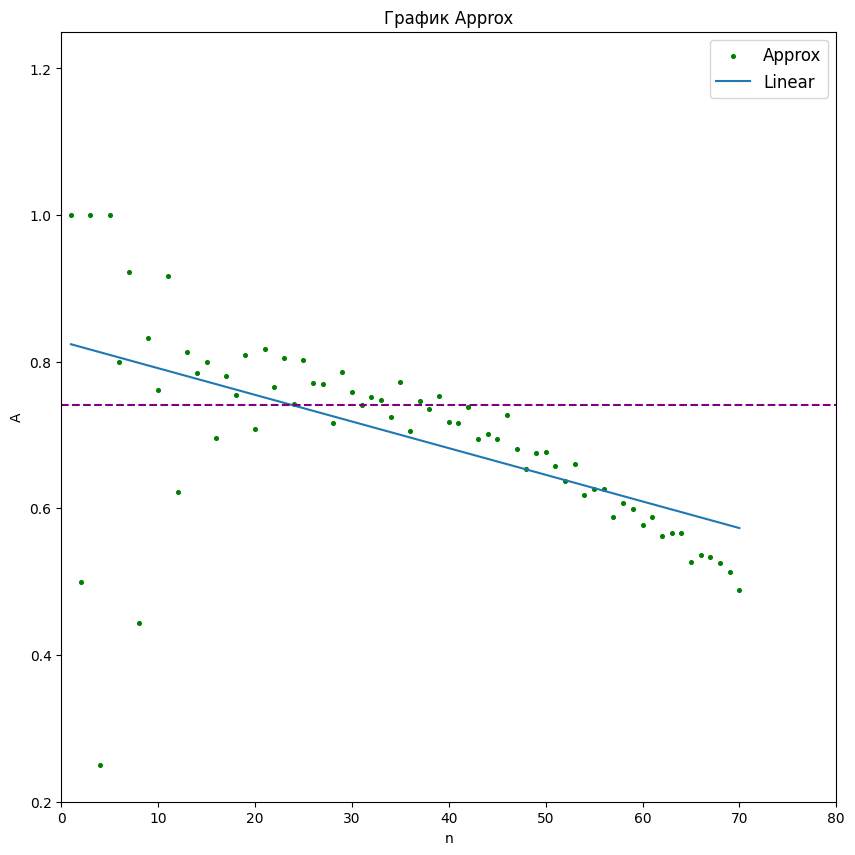

In [ ]:
b0, b1 = [ 0.8274795,  -0.00363323]

xx = np.arange (1,71)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='g',label='Approx')
plt.plot(xx, b0 + b1*xx , label = 'Linear')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Approx')
plt.xlabel('n')
plt.ylabel('A')
plt.hlines(0.741, 0, 80, color='purple',linestyle='--')
plt.xlim([0, 80])
plt.ylim([0.2, 1.25])
plt.show()

#### 2 степень

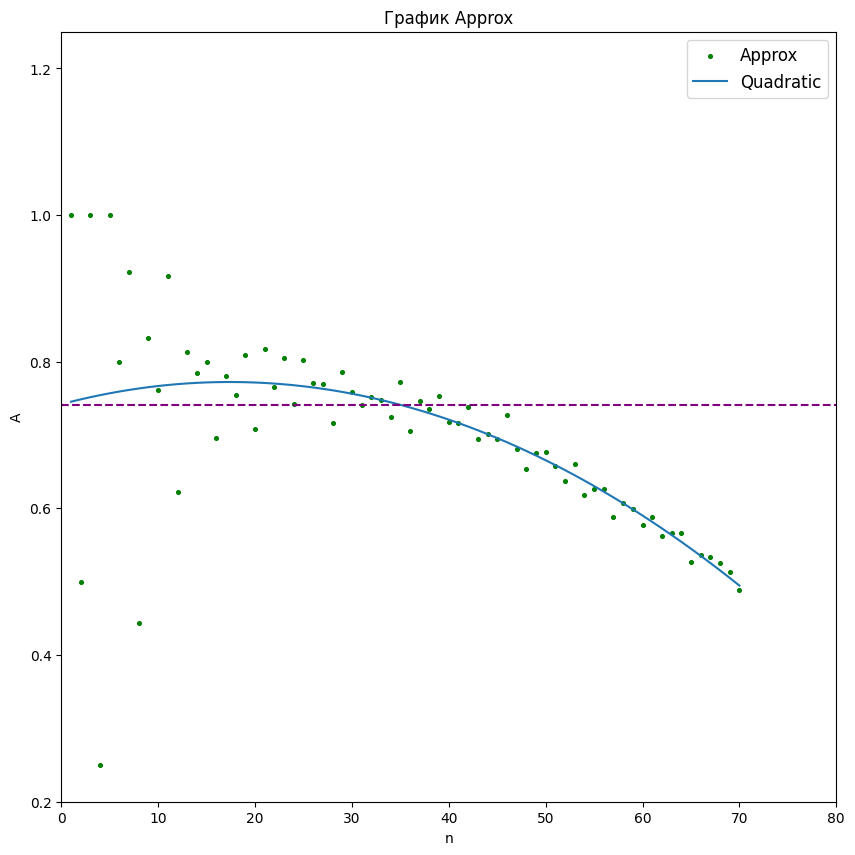

In [ ]:
b0, b1, b2 = [ 7.42075411e-01,  3.48378223e-03, -1.00239545e-04]

xx = np.arange (1,71)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='g',label='Approx')
plt.plot(xx, b0 + b1*xx + b2*xx**2 , label = 'Quadratic')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Approx')
plt.xlabel('n')
plt.ylabel('A')
plt.hlines(0.741, 0, 80, color='purple',linestyle='--')
plt.xlim([0, 80])
plt.ylim([0.2, 1.25])
plt.show()

#### 3 степень

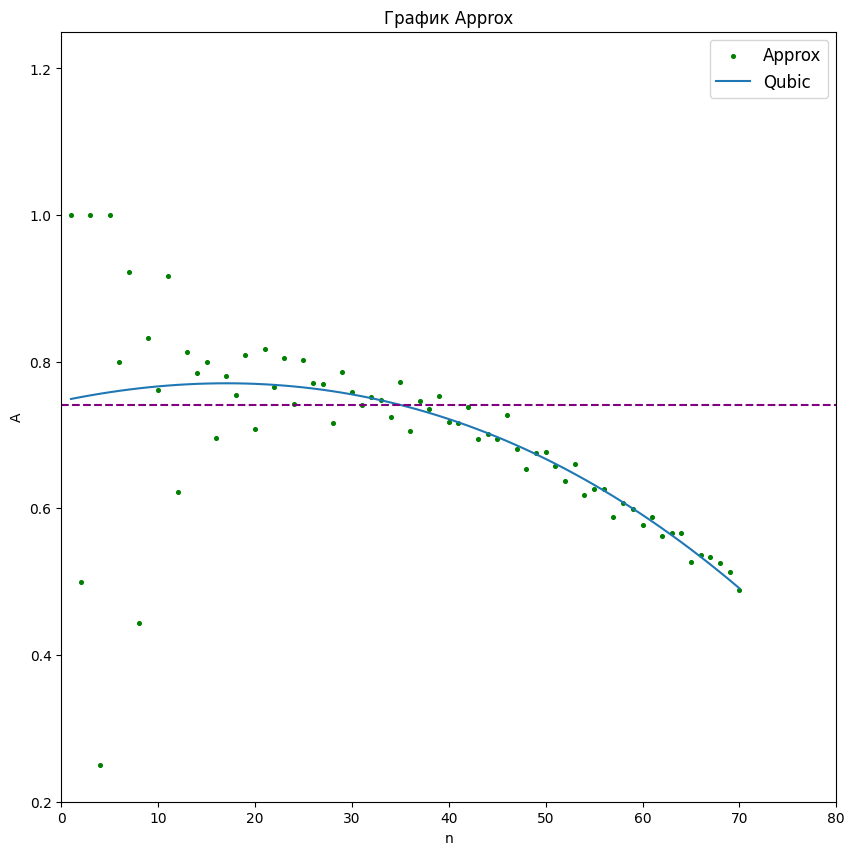

In [ ]:
b0, b1, b2, b3 =[ 7.46527776e-01,  2.75692154e-03, -7.48265037e-05, -2.38620103e-07]

xx = np.arange (1,71)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='g',label='Approx')
plt.plot(xx, b0 + b1*xx + b2*xx**2 + b3*xx**3 , label = 'Qubic')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Approx')
plt.xlabel('n')
plt.ylabel('A')
plt.hlines(0.741, 0, 80, color='purple',linestyle='--')
plt.xlim([0, 80])
plt.ylim([0.2, 1.25])
plt.show()

#### EXP

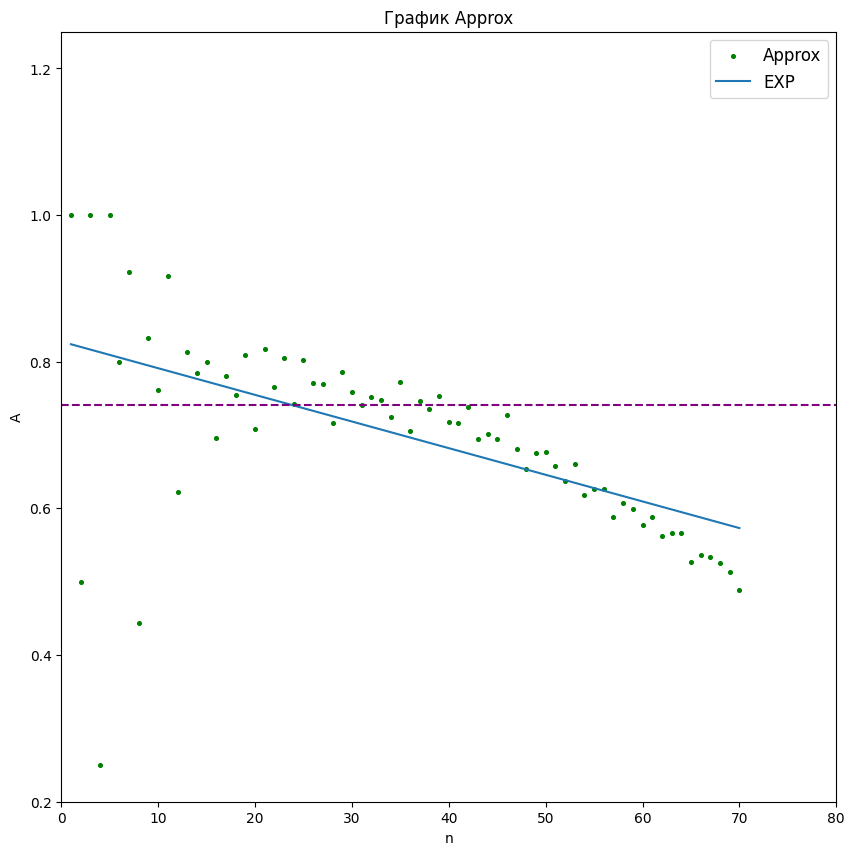

In [ ]:
b0, b1, b2 = [-1.07483573e+03,  1.07566321e+03,  9.99996622e-01]

xx = np.arange (1,71)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='g',label='Approx')
plt.plot(xx, b0 + b1*np.power(b2,xx) , label = 'EXP')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Approx')
plt.xlabel('n')
plt.ylabel('A')
plt.hlines(0.741, 0, 80, color='purple',linestyle='--')
plt.xlim([0, 80])
plt.ylim([0.2, 1.25])
plt.show()

### Несколько точек (Approx)

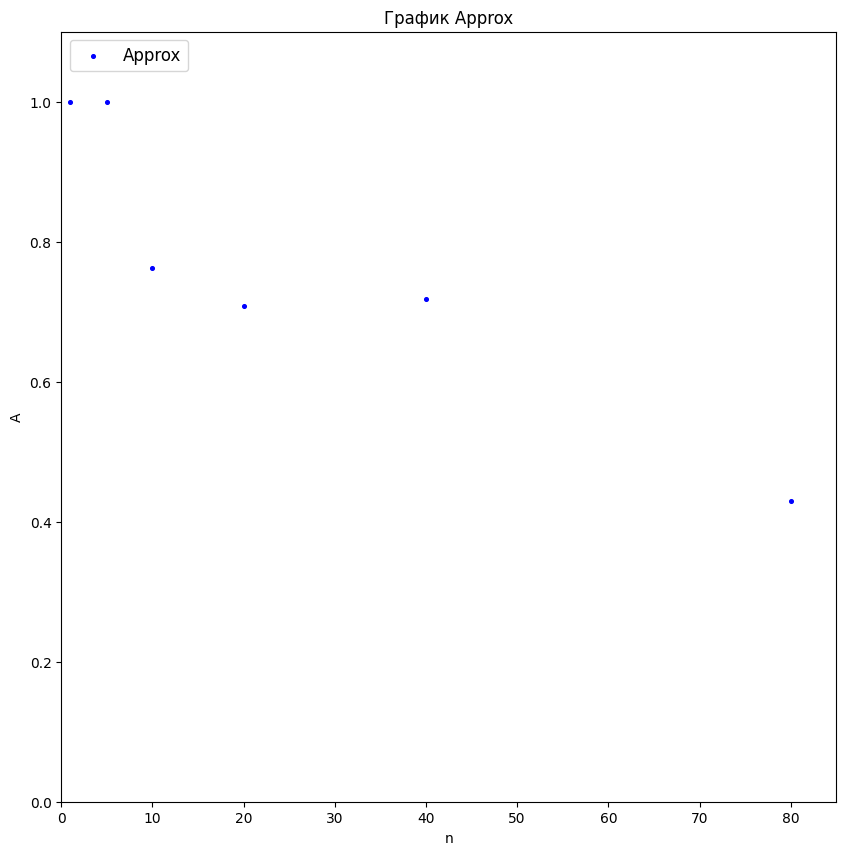

In [ ]:
Approx = [1, 1, 0.762, 0.708, 0.718, 0.429]
n = [1, 5, 10, 20, 40, 80]

plt.figure(figsize=(10,10))
plt.scatter(n,Approx,marker='o',s=7,color='b',label='Approx')
plt.legend(loc= 'upper left',fontsize=12)
plt.title('График Approx')
plt.xlabel('n')
plt.ylabel('A')
plt.xlim([0, 85])
plt.ylim([0, 1.1])
plt.show()

In [ ]:
x = np.array(n)
y = np.array(Approx)

linear_func = lambda x, b0, b1: b0 + b1*x
quadratic_func = lambda x, b0, b1, b2: b0 + b1*x + b2*x**2
qubic_func = lambda x, b0, b1, b2, b3: b0 + b1*x + b2*x**2 + b3*x**3
exp_func = lambda x, b0, b1, b2: b0 + b1*np.exp(b2*x)
exp1_func = lambda x, b0, b1, b2: b0 + b1*np.exp(x-b2)
exp2_func = lambda x, b0, b1: b0*np.power(b1,x)
exp3_func = lambda x, b0, b1, b2:  b0 + b1*np.power(b2,x)


from scipy.optimize import leastsq

# list of model
model_list = [
    'linear', 'quadratic',
    'qubic']

# model reference
models_dict = {
        'linear':             linear_func,
        'quadratic':          quadratic_func,
        'qubic':              qubic_func}

# initial values
p0_dict = {
        'linear':             [0, 0],
        'quadratic':          [0, 0, 0],
        'qubic':              [0, 0, 0, 0]}

# titles (formulas)
formulas_dict = {
        'linear':             'y = b0 + b1*x',
        'quadratic':          'y = b0 + b1*x + b2*x^2',
        'qubic':              'y = b0 + b1*x + b2*x^2 + b3*x^3'}

# actual data
X_fact = x
Y_fact = y

# function for calculating residuals
residual_func = lambda p, x, y: y - func(x, *p)

# return all optional outputs
full_output = True

# variables to save the calculation results
calculation_results_df = pd.DataFrame(columns=['func', 'p0', 'popt', 'cov_x', 'SSE', 'MSE', 'pcov', 'perr', 'Y_calc', 'error_metrics'])
error_metrics_results_df = pd.DataFrame(columns=['MSE', 'RMSE', 'MAE', 'MSPE', 'MAPE', 'RMSLE', 'R2'])

# calculations
for func_name in model_list:
    print(f'{func_name.upper()} MODEL: {formulas_dict[func_name]}')
    func = models_dict[func_name]
    calculation_results_df.loc[func_name, 'func'] = func
    p0 = p0_dict[func_name]
    print(f'p0 = {p0}')
    calculation_results_df.loc[func_name, 'p0'] = p0
    if full_output:
        (popt, cov_x, infodict, mesg, ier) = leastsq(residual_func, p0, args=(X_fact, Y_fact), full_output=full_output)
        integer_flag = f'ier = {ier}, the solution was found' if ier<=4 else f'ier = {ier}, the solution was not found'
        print(integer_flag, '\n', mesg)
        calculation_results_df.loc[func_name, 'popt'] = popt
        print(f'parameters = {popt}')
        calculation_results_df.loc[func_name, 'cov_x'] = cov_x
        print(f'cov_x = \n{cov_x}')
        #SSE = (residual_func(popt, X_fact, Y_fact)**2).sum()
        SSE = (infodict['fvec']**2).sum()
        calculation_results_df.loc[func_name, 'SSE'] = SSE
        print(f'SSE = {SSE}')
        MSE = SSE / (len(Y_fact)-len(p0))
        calculation_results_df.loc[func_name, 'MSE'] = MSE
        print(f'MSE = {MSE}')
        pcov = cov_x * MSE
        calculation_results_df.loc[func_name, 'pcov'] = pcov
        print(f'pcov =\n {pcov}')
        perr = np.sqrt(np.diag(pcov))
        calculation_results_df.loc[func_name, 'perr'] = perr
        print(f'perr = {perr}\n')
    else:
        popt = leastsq(residual_func, p0, args=(X_fact, Y_fact), full_output=full_output)
        calculation_results_df.loc[func_name, 'popt'] = popt
        print(f'parameters = {popt}\n')
    Y_calc = func(X_fact, *popt)
    calculation_results_df.loc[func_name, 'Y_calc'] = Y_calc
    (error_metrics_dict, error_metrics_df) = regression_error_metrics(Yfact=Y_fact, Ycalc=Y_calc, model_name=func_name)
    calculation_results_df.loc[func_name, 'error_metrics'] = error_metrics_dict.values()
    error_metrics_results_df = pd.concat([error_metrics_results_df, error_metrics_df])

LINEAR MODEL: y = b0 + b1*x
p0 = [0, 0]
ier = 3, the solution was found 
 Both actual and predicted relative reductions in the sum of squares
  are at most 0.000000 and the relative error between two consecutive iterates is at 
  most 0.000000
parameters = [ 0.93947136 -0.00653736]
cov_x = 
[[ 3.17897094e-01 -5.81655492e-03]
 [-5.81655492e-03  2.23713651e-04]]
SSE = 0.037656760850111846
MSE = 0.009414190212527962
pcov =
 [[ 2.99274372e-03 -5.47581544e-05]
 [-5.47581544e-05  2.10608286e-06]]
perr = [0.05470598 0.00145123]

QUADRATIC MODEL: y = b0 + b1*x + b2*x^2
p0 = [0, 0, 0]
ier = 1, the solution was found 
 Both actual and predicted relative reductions in the sum of squares
  are at most 0.000000
parameters = [ 9.72023396e-01 -1.03564967e-02  4.69708088e-05]
cov_x = 
[[ 5.55248450e-01 -3.36635826e-02  3.42485114e-04]
 [-3.36635826e-02  3.49084033e-03 -4.01817481e-05]
 [ 3.42485114e-04 -4.01817481e-05  4.94187411e-07]]
SSE = 0.03319234719044691
MSE = 0.01106411573014897
pcov =
 [[ 6.1

3 степень

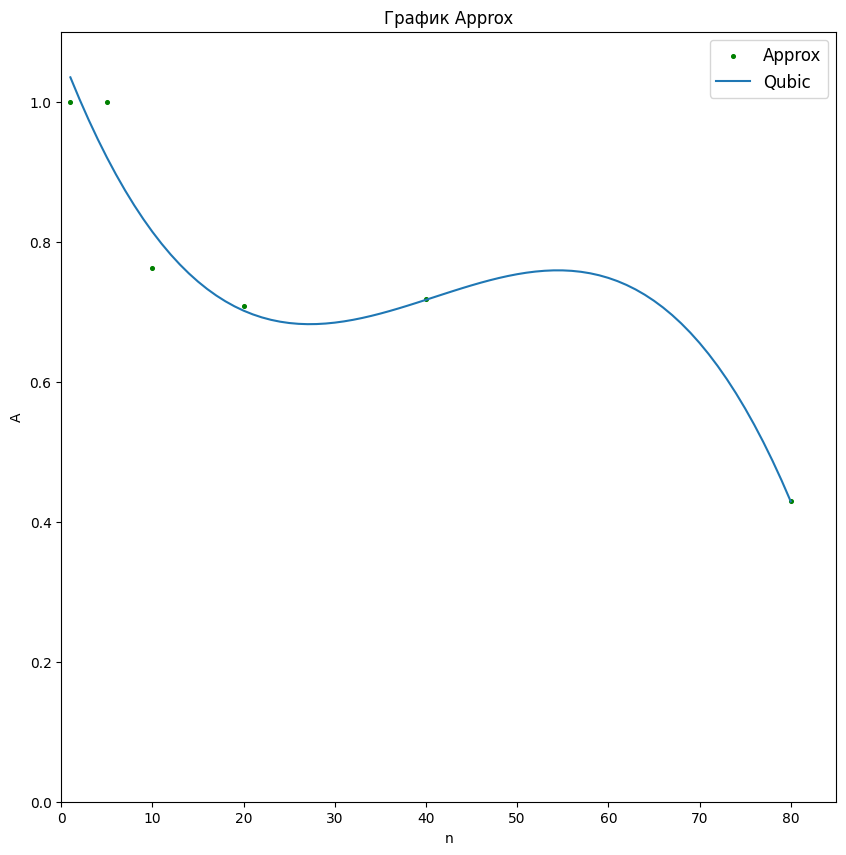

In [ ]:
b0, b1, b2, b3 =[ 1.06788009e+00, -3.39716722e-02, 9.35186712e-04, -7.62929963e-06]

xx = np.arange (1,81)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='g',label='Approx')
plt.plot(xx, b0 + b1*xx + b2*xx**2 + b3*xx**3 , label = 'Qubic')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Approx')
plt.xlabel('n')
plt.ylabel('A')
plt.xlim([0, 85])
plt.ylim([0, 1.1])
plt.show()

In [ ]:
import sympy as sp

def f(x):
  z = b0 + b1*x + b2*x**2 + b3*x**3
  return z

# Объявляем символьную переменную x
x = sp.Symbol ("x")
# Вывод функции
print("f(x) =", f(x))
# Находим производную функции f(x) и сохраняем ее в переменной d_f:
d_f = sp.diff(f(x), x)
print("Первая производная функции:",d_f)

# Решаем уравнение d_f = 0:
x_extr = sp.solve (d_f)
print ("точка экстремума:", x_extr)

# Сохраняем точки экстремума в переменные:
x_0 = x_extr[0]
x_1 = x_extr[1]

# Находим вторую производную функции:
d2_f = sp.diff(f(x), x, 2)
print("Вторая производная функции:", d2_f)

# Находим значение второй производной в точках экстремума x_0 и x_1,
# Сохраняем их в переменные f_0_d2 и f_1_d2:
f_0_d2 = d2_f.evalf(subs = {x : x_0})
f_1_d2 = d2_f.evalf(subs = {x : x_1})

# Определяем, является ли точка x_0 точкой лок.минимума, максимума или перегиба
if f_0_d2 > 0:
  print(x_0, "- локальный минимум")
elif f_0_d2 < 0:
  print(x_0, "- локальный максимум")
else:
  print(x_0, "- точка перегиба")

# Определяем, является ли точка x_1 точкой лок.минимума, максимума или перегиба
if f_1_d2 > 0:
  print(x_1, "- локальный минимум")
elif f_1_d2 < 0:
  print(x_1, "- локальный максимум")
else:
  print(x_1, "- точка перегиба")

f(x) = -7.62929963e-6*x**3 + 0.000935186712*x**2 - 0.0339716722*x + 1.06788009
Первая производная функции: -2.288789889e-5*x**2 + 0.001870373424*x - 0.0339716722
точка экстремума: [27.2495053172785, 54.4693729855782]
Вторая производная функции: 0.001870373424 - 4.577579778e-5*x
27.2495053172785 - локальный минимум
54.4693729855782 - локальный максимум


2 степень

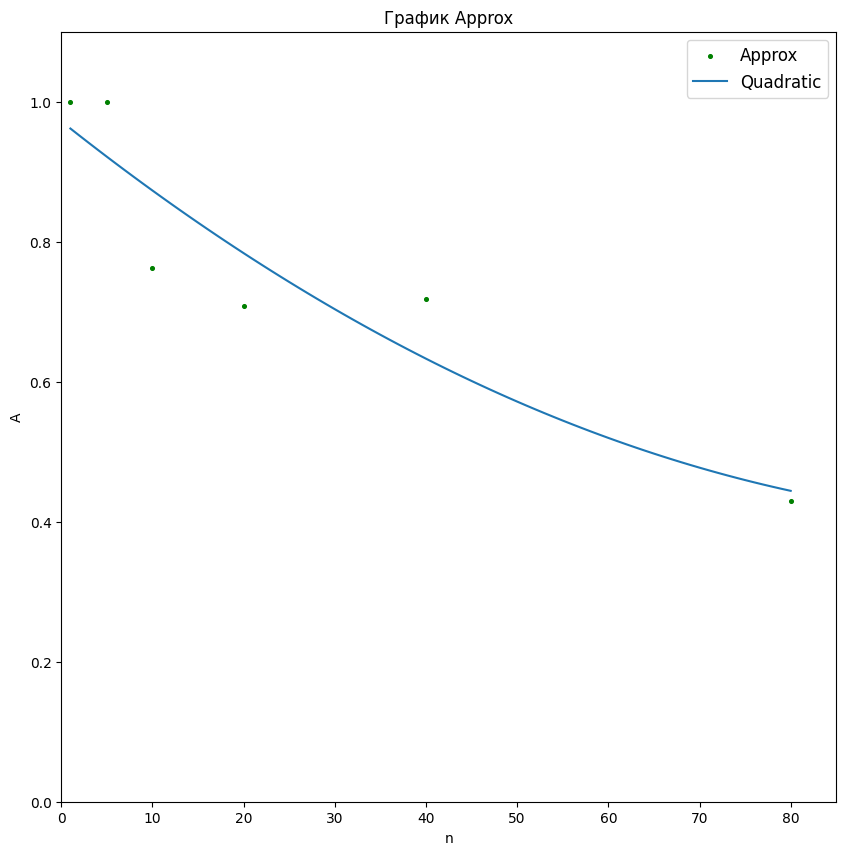

In [ ]:
b0, b1, b2 = [ 9.72023396e-01, -1.03564967e-02,  4.69708088e-05]

xx = np.arange (1,81)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='g',label='Approx')
plt.plot(xx, b0 + b1*xx + b2*xx**2 , label = 'Quadratic')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Approx')
plt.xlabel('n')
plt.ylabel('A')
plt.xlim([0, 85])
plt.ylim([0, 1.1])
plt.show()

### Сведенные графики Excess и Approx

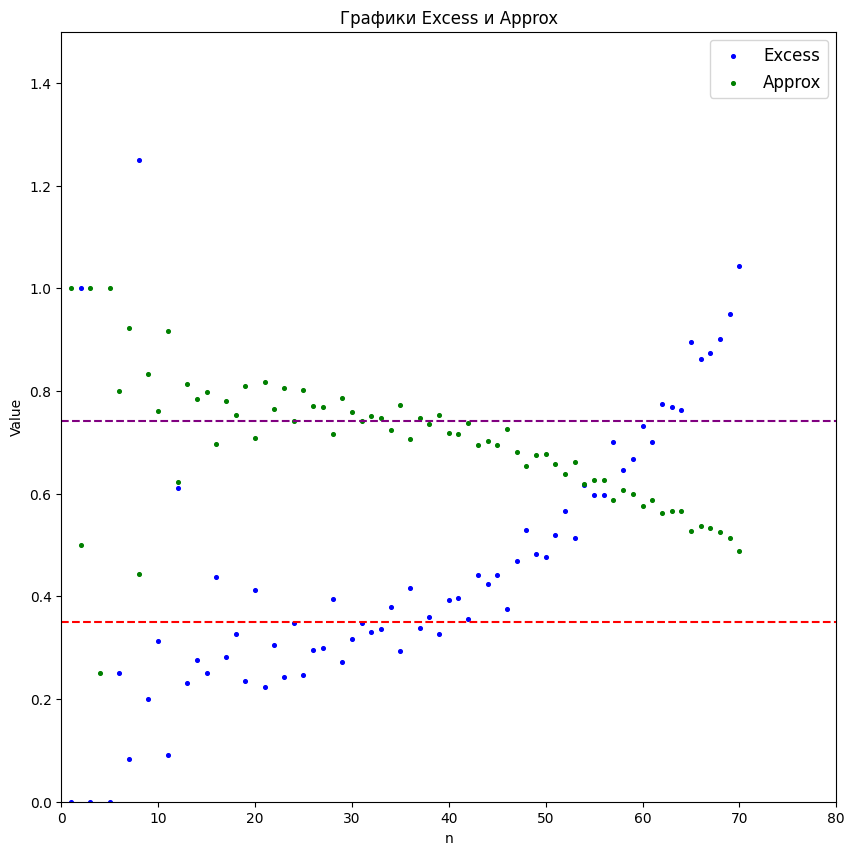

In [ ]:
Approx = [1, 0.5, 1, 0.25, 1, 0.8, 0.923, 0.444, 0.833, 0.762, 0.917, 0.623, 0.813, 0.784, 0.799, 0.696, 0.78, 0.754, 0.809, 0.708,
          0.817, 0.766, 0.805, 0.742, 0.802, 0.771, 0.769, 0.717, 0.786, 0.759, 0.741, 0.752, 0.748, 0.725, 0.773, 0.706, 0.747, 0.735, 0.753, 0.718,
          0.716, 0.738, 0.694, 0.702, 0.694, 0.727, 0.681, 0.654, 0.675, 0.677, 0.658, 0.638, 0.661, 0.618, 0.626, 0.627, 0.588, 0.607, 0.599, 0.577,
          0.588, 0.563, 0.567, 0.567, 0.527, 0.537, 0.534, 0.526, 0.513, 0.489]

Excess = [0, 1, 0, 3, 0, 0.25, 0.083, 1.25, 0.2, 0.313, 0.091, 0.611, 0.231, 0.276, 0.25, 0.438, 0.282, 0.326, 0.235, 0.413,
          0.224, 0.305, 0.243, 0.348, 0.247, 0.296, 0.299, 0.395, 0.273, 0.317, 0.349, 0.33, 0.336, 0.379, 0.294, 0.416, 0.338, 0.359, 0.327, 0.393,
          0.396, 0.355, 0.441, 0.424, 0.441, 0.376, 0.469, 0.529, 0.482, 0.476, 0.519, 0.567, 0.514, 0.617, 0.597, 0.597, 0.701, 0.646, 0.668, 0.732,
          0.701, 0.775, 0.768, 0.763, 0.896, 0.862, 0.874, 0.901, 0.951, 1.044]


n = list(range(1, 71))


plt.figure(figsize=(10,10))
plt.scatter(n,Excess,marker='o',s=7,color='b',label='Excess')
plt.scatter(n,Approx,marker='o',s=7,color='g',label='Approx')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Графики Excess и Approx')
plt.hlines(0.350, 0, 80, color='r',linestyle='--')
plt.hlines(0.741, 0, 80, color='purple',linestyle='--')
plt.xlabel('n')
plt.ylabel('Value')
plt.xlim([0, 80])
plt.ylim([0, 1.5])
plt.show()

## Кольцо

In [ ]:
import numpy as np

# Функция для генерации координат точки
def generate_point():
  # Генерируем два случайных числа в диапазоне [-1, 1]
  x = np.random.uniform(-1, 1)
  y = np.random.uniform(-1, 1)
  return np.array([x, y])

# Функция для проверки, попадает ли точка внутрь круга
def is_inside_circle(point, center, radius):
  # Вычисляем расстояние между точкой и центром круга
  distance = np.linalg.norm(point - center)
  return distance <= radius

# Параметры
n_points = 500  # Количество точек
outer_radius = 1.0  # Радиус внешнего круга
inner_radius = 0.3  # Радиус внутреннего круга

# Центры кругов
outer_center = np.array([0, 0])
inner_center = np.array([0, 0])

# Генерация массива точек
points = np.empty((n_points, 2))
for i in range(n_points):
  # Генерируем точку
  point = generate_point()

  # Проверяем, попадает ли она внутрь обоих кругов
  while is_inside_circle(point, inner_center, inner_radius) or not is_inside_circle(point, outer_center, outer_radius):
    point = generate_point()

  # Добавляем точку в массив
  points[i] = point

# Печать массива точек
print(points)

[[-3.46777432e-01 -6.94382001e-01]
 [-7.07419616e-01  1.29091246e-01]
 [ 5.79477451e-01 -5.54775103e-02]
 [ 3.00989616e-01 -7.62679203e-01]
 [ 1.84492091e-01 -4.30402566e-01]
 [ 6.76510933e-01 -7.35862188e-01]
 [ 6.98485986e-01  3.67792000e-01]
 [-3.78824683e-01  1.24861956e-01]
 [ 8.35557358e-01  9.31962114e-02]
 [ 8.62924402e-01 -5.12309375e-02]
 [ 2.24477194e-01 -3.23615546e-01]
 [-6.50850395e-02  6.11224770e-01]
 [ 4.12952244e-01 -6.83066008e-01]
 [-4.15651446e-01 -8.94054890e-01]
 [ 5.29930380e-01 -2.12628123e-01]
 [ 2.09093608e-02  9.37811427e-01]
 [ 6.98141038e-01 -4.87918973e-01]
 [ 7.48473482e-01  5.65157127e-01]
 [ 4.78153443e-01  4.40046050e-01]
 [ 5.45800282e-01 -2.64941948e-01]
 [ 3.80625590e-01 -1.07278596e-01]
 [ 5.34990190e-02  8.90759757e-01]
 [ 5.65079547e-01  4.01896706e-01]
 [ 7.16179746e-02  8.95862961e-01]
 [-7.80690452e-01  1.42552631e-01]
 [-3.38900925e-01  5.22769096e-01]
 [-6.46384420e-01 -7.62749527e-01]
 [ 7.14190141e-01 -5.36402643e-01]
 [ 3.36123218e-01 -3

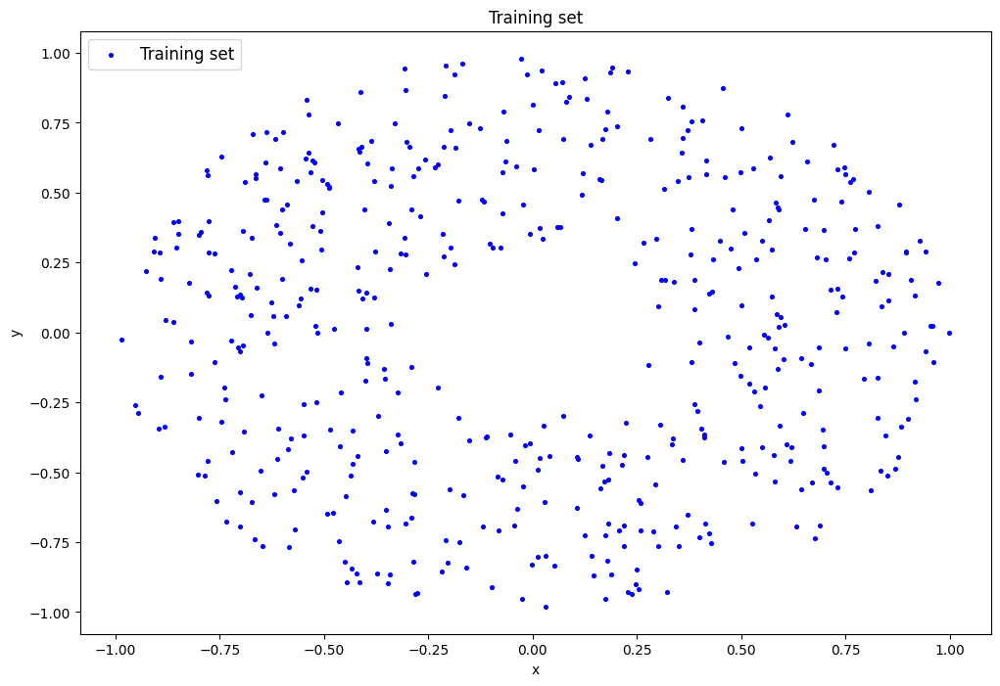

In [ ]:
data2 = points

plt.figure(figsize=(12,8))
plt.scatter(points[:,0],points[:,1],marker='o',s=7,color='b',label='Training set')
plt.legend(loc= 'upper left',fontsize=12)
plt.title('Training set')
plt.xlabel('x')
plt.ylabel('y')
plt.show()

In [ ]:
np.savetxt('data2.txt', data2)

In [ ]:
# Загрузка датасета

with open('/content/drive/My Drive/Colab Notebooks/data2.txt', 'r') as f:
    data2 = np.loadtxt(f)
data2

array([[-3.46777432e-01, -6.94382001e-01],
       [-7.07419616e-01,  1.29091246e-01],
       [ 5.79477451e-01, -5.54775103e-02],
       [ 3.00989616e-01, -7.62679203e-01],
       [ 1.84492091e-01, -4.30402566e-01],
       [ 6.76510933e-01, -7.35862188e-01],
       [ 6.98485986e-01,  3.67792000e-01],
       [-3.78824683e-01,  1.24861956e-01],
       [ 8.35557358e-01,  9.31962114e-02],
       [ 8.62924402e-01, -5.12309375e-02],
       [ 2.24477194e-01, -3.23615546e-01],
       [-6.50850395e-02,  6.11224770e-01],
       [ 4.12952244e-01, -6.83066008e-01],
       [-4.15651446e-01, -8.94054890e-01],
       [ 5.29930380e-01, -2.12628123e-01],
       [ 2.09093608e-02,  9.37811427e-01],
       [ 6.98141038e-01, -4.87918973e-01],
       [ 7.48473482e-01,  5.65157127e-01],
       [ 4.78153443e-01,  4.40046050e-01],
       [ 5.45800282e-01, -2.64941948e-01],
       [ 3.80625590e-01, -1.07278596e-01],
       [ 5.34990190e-02,  8.90759757e-01],
       [ 5.65079547e-01,  4.01896706e-01],
       [ 7.

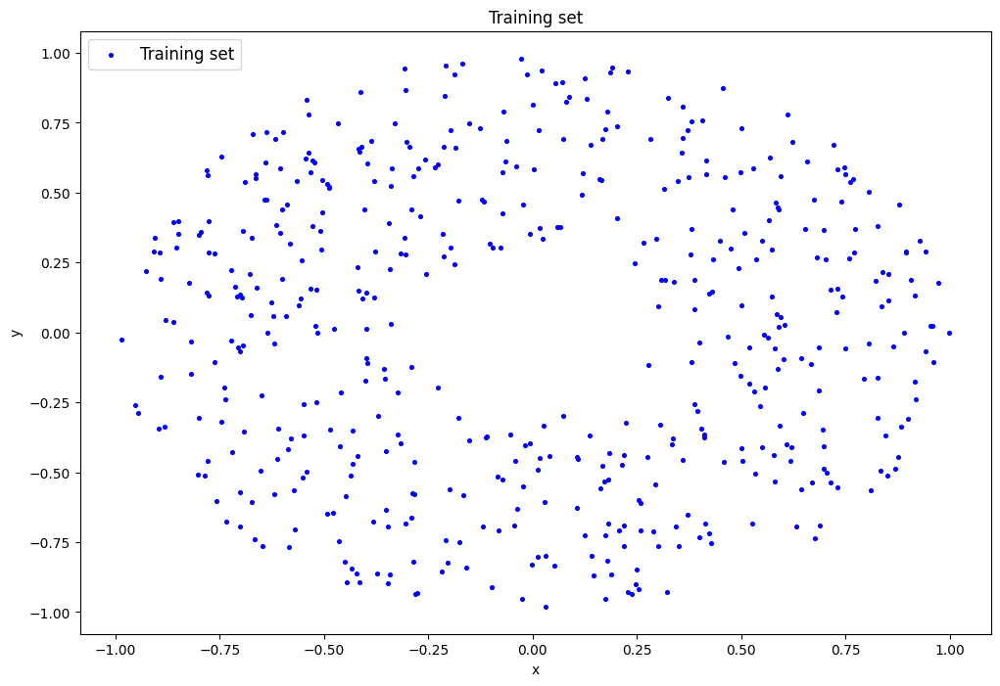

In [ ]:
plt.figure(figsize=(12,8))
plt.scatter(data2[:,0],data2[:,1],marker='o',s=7,color='b',label='Training set')
plt.legend(loc= 'upper left',fontsize=12)
plt.title('Training set')
plt.xlabel('x')
plt.ylabel('y')
plt.show()

### Обучение AE и построение EDCA

In [ ]:
#### Обучение Автокодировщика
size = data2.shape[1]
patience = 700
verbose_show = True

ae_kol = tensorflow.keras.models.Sequential()

# input layer
ae_kol.add(tensorflow.keras.layers.Dense(size))
ae_kol.add(tensorflow.keras.layers.Activation('tanh'))

# hidden layers
ae_kol.add(tensorflow.keras.layers.Dense(5))
ae_kol.add(tensorflow.keras.layers.Activation('tanh'))
ae_kol.add(tensorflow.keras.layers.Dense(3))
ae_kol.add(tensorflow.keras.layers.Activation('tanh'))
ae_kol.add(tensorflow.keras.layers.Dense(2))
ae_kol.add(tensorflow.keras.layers.Activation('tanh'))
ae_kol.add(tensorflow.keras.layers.Dense(1))
ae_kol.add(tensorflow.keras.layers.Activation('tanh'))
ae_kol.add(tensorflow.keras.layers.Dense(2))
ae_kol.add(tensorflow.keras.layers.Activation('tanh'))
ae_kol.add(tensorflow.keras.layers.Dense(3))
ae_kol.add(tensorflow.keras.layers.Activation('tanh'))
ae_kol.add(tensorflow.keras.layers.Dense(5))
ae_kol.add(tensorflow.keras.layers.Activation('tanh'))

# output layer
ae_kol.add(tensorflow.keras.layers.Dense(size))
ae_kol.add(tensorflow.keras.layers.Activation('linear'))

optimizer = tensorflow.keras.optimizers.Adam(learning_rate=0.001, beta_1=0.9, beta_2=0.999, amsgrad=False)
ae_kol.compile(loss='mean_squared_error', optimizer=optimizer)

error_stop = 0.0001
epo = 10000

early_stopping_callback_on_error = EarlyStoppingOnValue(monitor='loss', baseline=error_stop)
early_stopping_callback_on_improving = tensorflow.keras.callbacks.EarlyStopping(monitor='loss',
                                                                                           min_delta=0.0001, patience = patience,
                                                                                           verbose=1, mode='auto',
                                                                                           baseline=None,
                                                                                           restore_best_weights=False)

history_callback = tensorflow.keras.callbacks.History()
verbose = 1 if verbose_show else 0
history_object = ae_kol.fit(data2, data2,
                                batch_size=data2.shape[0],
                                epochs=epo,
                                callbacks=[early_stopping_callback_on_error, history_callback,
                                early_stopping_callback_on_improving],
                                verbose=verbose)
ae_kol_trainned = ae_kol
ae_kol_pred = ae_kol_trainned.predict(data2)
ae_kol_trainned.save('out/AE_kol.h5')


Выходные данные были обрезаны до нескольких последних строк (5000).
1/1 [==============================] - 0s 18ms/step - loss: 0.0171
Epoch 6111/10000
1/1 [==============================] - 0s 27ms/step - loss: 0.0171
Epoch 6112/10000
1/1 [==============================] - 0s 26ms/step - loss: 0.0171
Epoch 6113/10000
1/1 [==============================] - 0s 21ms/step - loss: 0.0171
Epoch 6114/10000
1/1 [==============================] - 0s 15ms/step - loss: 0.0171
Epoch 6115/10000
1/1 [==============================] - 0s 26ms/step - loss: 0.0171
Epoch 6116/10000
1/1 [==============================] - 0s 29ms/step - loss: 0.0171
Epoch 6117/10000
1/1 [==============================] - 0s 17ms/step - loss: 0.0171
Epoch 6118/10000
1/1 [==============================] - 0s 24ms/step - loss: 0.0171
Epoch 6119/10000
1/1 [==============================] - 0s 25ms/step - loss: 0.0171
Epoch 6120/10000
1/1 [==============================] - 0s 22ms/step - loss: 0.0171
Epoch 6121/10000
1/1 [===

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [ ]:
# Сохранение AE
ae_kol.save('best_model_for_data2')

In [ ]:
# Загрузка автокодировщика
from keras.models import load_model
ae_kol = load_model('best_model_for_data2')

ae_kol_trainned = ae_kol
ae_kol_pred = ae_kol_trainned.predict(data2)
ae_kol_trainned.save('out/AE_kol.h5')

16/16 [==============================] - 0s 2ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


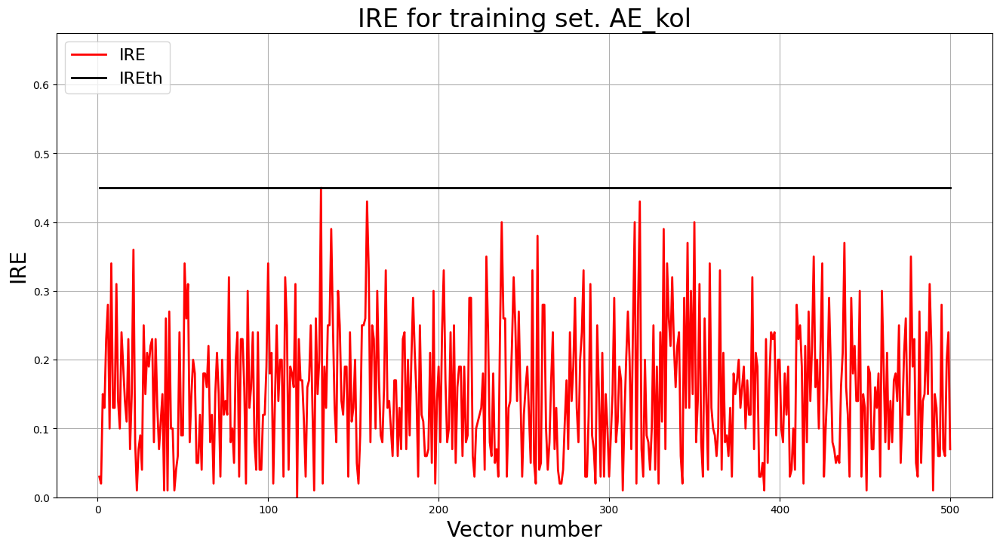

In [ ]:
# Ошибка реконструкции
irefile = 'out/AE_kol_ire_th.txt'
IRE_array = np.round(ire_array(data2, ae_kol_pred), 2)
IREth = np.amax(IRE_array)
with open(irefile, 'w') as file:
    file.write(str(IREth))

IRE2 = IRE_array
IREth_2 = IREth

lib.ire_plot('training', IRE2, IREth, 'AE_kol')

250/250 [==============================] - 0s 2ms/step


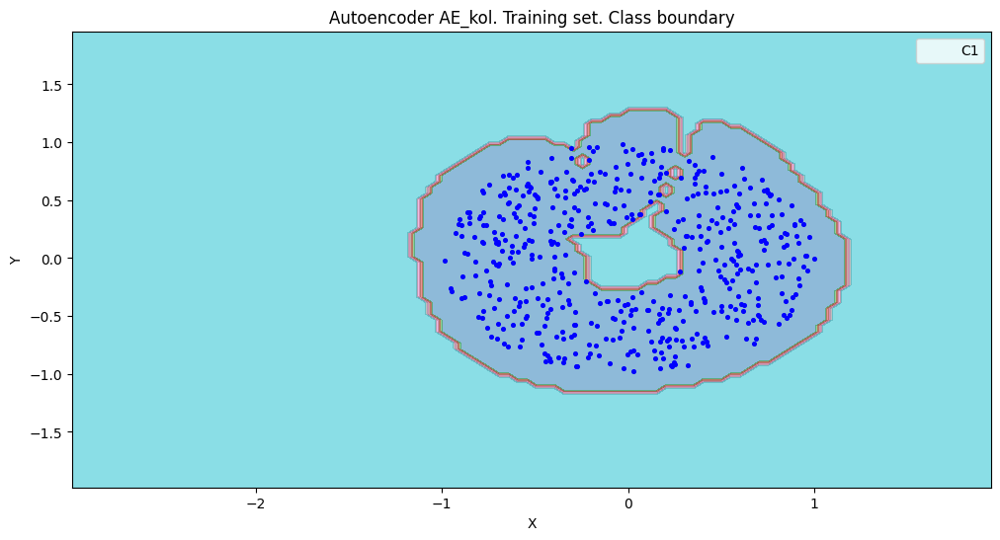

amount:  399
amount_ae:  1352


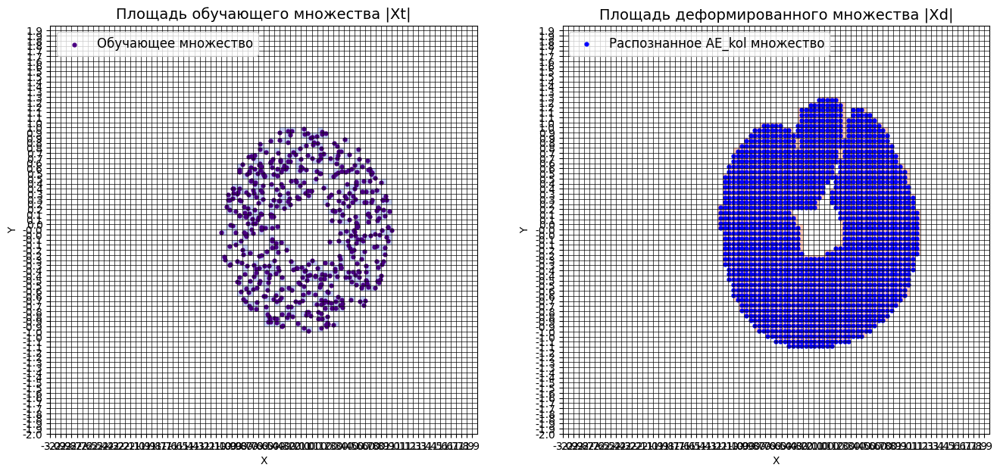

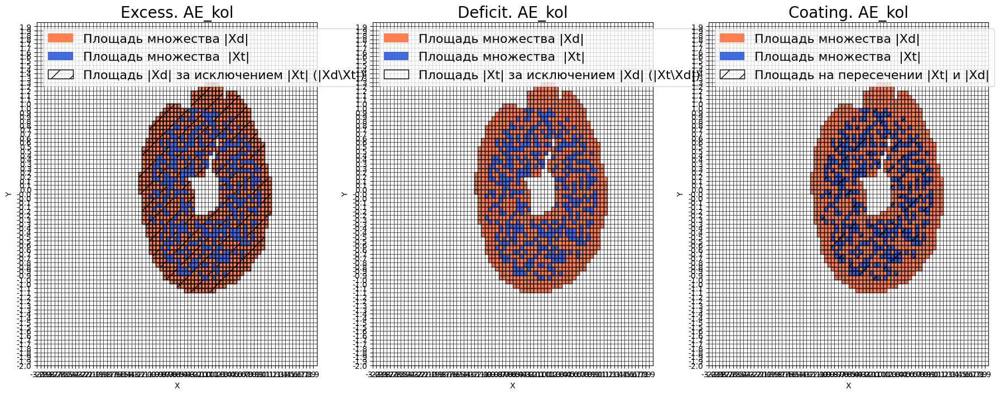


Оценка качества AE_kol
IDEAL = 0. Excess:  2.3909774436090228
IDEAL = 0. Deficit:  0.002506265664160401
IDEAL = 1. Coating:  0.9974937343358395
summa:  1.0
IDEAL = 1. Extrapolation precision (Approx):  0.29511834319526625




In [ ]:
# построение областей покрытия и границ классов
# расчет характеристик качества обучения
# параметр numb_square, отвечающий за количество элементов разбиения по каждой оси пространства признаков
numb_square = 80

xx, yy, Z3 = lib.square_calc(numb_square, data2, ae_kol_trainned, IREth_2, '_kol', True)

### Плотное покрытие

In [ ]:
import numpy as np

# Функция для проверки, попадает ли точка внутрь круга
def is_inside_circle(point, center, radius):
  # Вычисляем расстояние между точкой и центром круга
  distance = np.linalg.norm(point - center)
  return distance <= radius

# Параметры
n_points = 100  # Количество точек
outer_radius = 1.0  # Радиус внешнего круга
inner_radius = 0.3  # Радиус внутреннего круга

def generate_grid_points(n_points):
    x = np.linspace(-1, 1, n_points)
    y = np.linspace(-1, 1, n_points)

    points = [np.array([i, j]) for i in x for j in y]

    return points

# Центры кругов
outer_center = np.array([0, 0])
inner_center = np.array([0, 0])


grid_points = generate_grid_points(n_points)
points = []

for point in grid_points:
  if not is_inside_circle(point, inner_center, inner_radius) and  is_inside_circle(point, outer_center, outer_radius):
    points.append(point)

points = np.array(points)

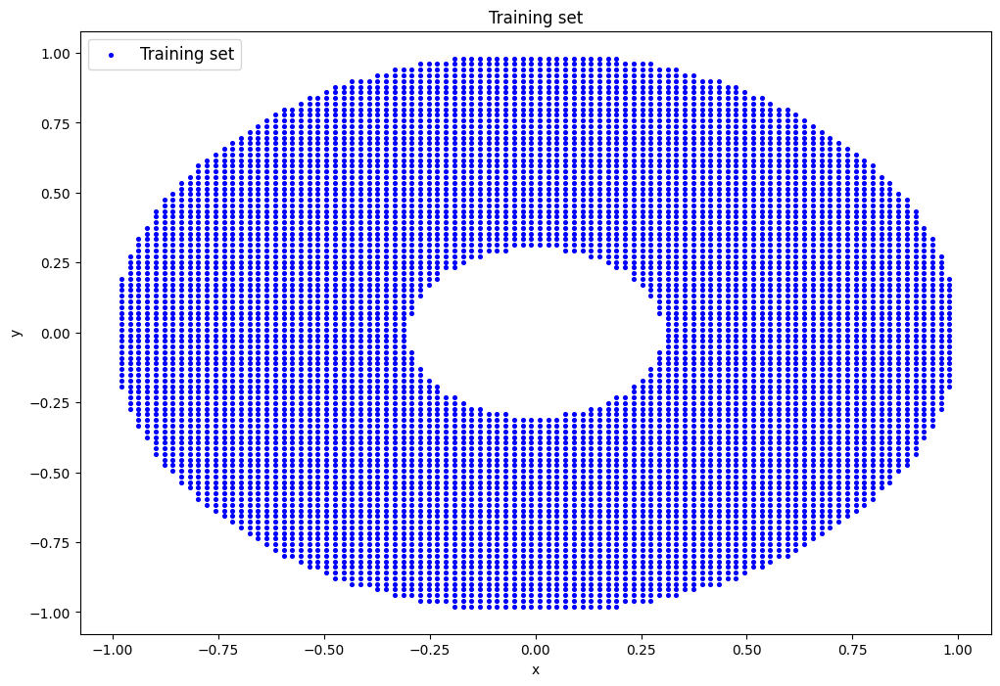

In [ ]:
data2_plot = points

plt.figure(figsize=(12,8))
plt.scatter(points[:,0],points[:,1],marker='o',s=7,color='b',label='Training set')
plt.legend(loc= 'upper left',fontsize=12)
plt.title('Training set')
plt.xlabel('x')
plt.ylabel('y')
plt.show()

2250/2250 [==============================] - 9s 4ms/step


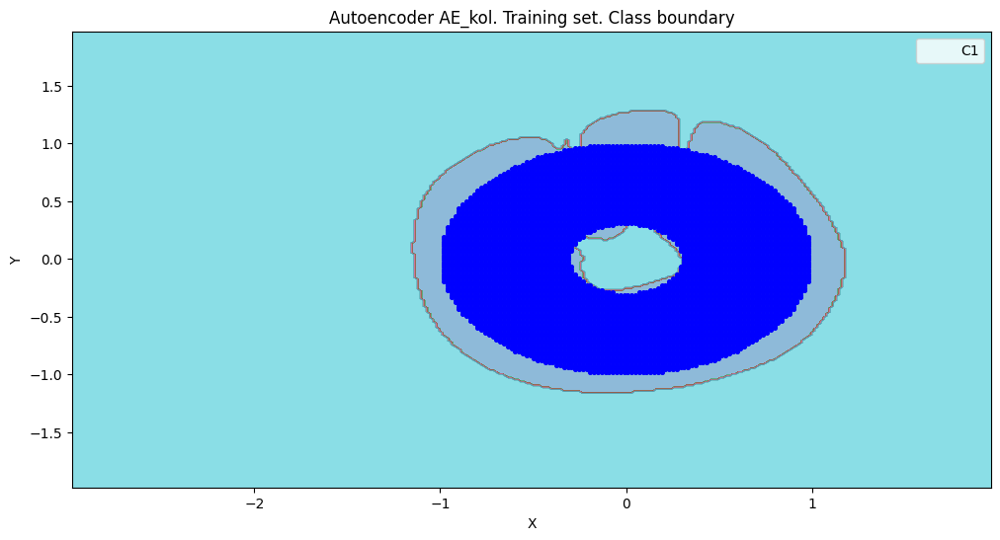

amount:  5708
amount_ae:  8514


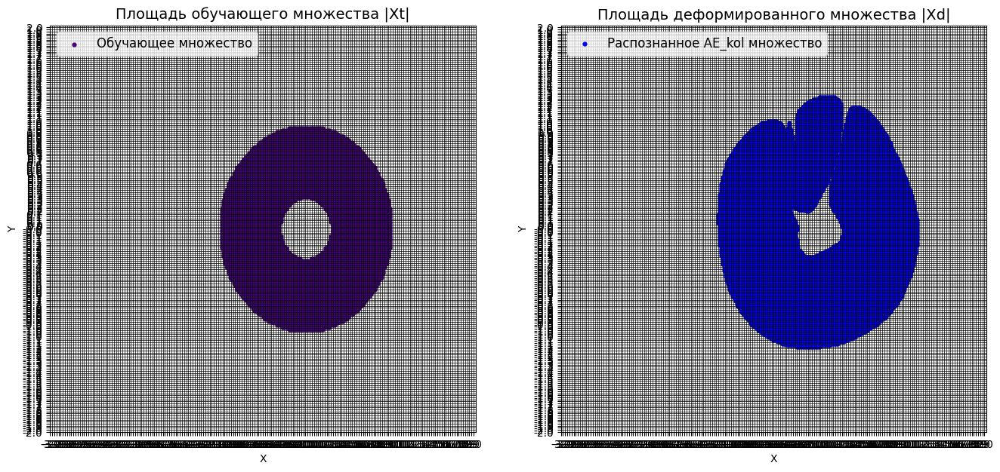

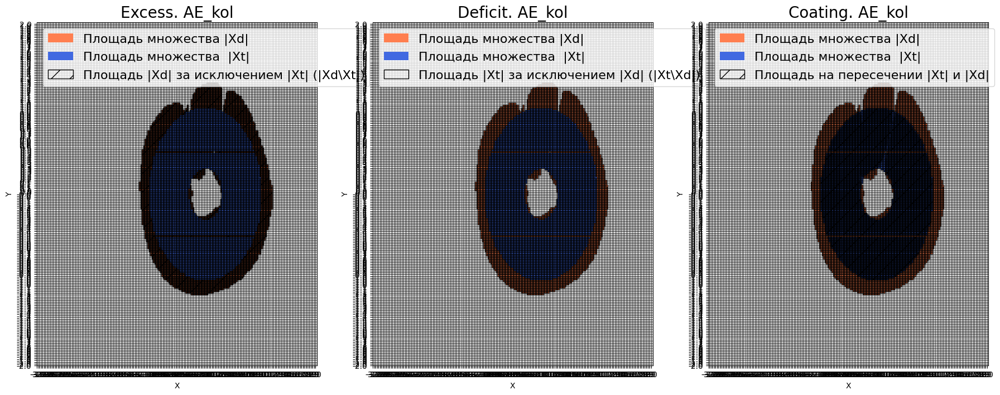


Оценка качества AE_kol
IDEAL = 0. Excess:  0.50385423966363
IDEAL = 0. Deficit:  0.012263489838822705
IDEAL = 1. Coating:  0.9877365101611773
summa:  1.0
IDEAL = 1. Extrapolation precision (Approx):  0.6704251820530891




In [ ]:
# построение областей покрытия и границ классов
# расчет характеристик качества обучения
# параметр numb_square, отвечающий за количество элементов разбиения по каждой оси пространства признаков
numb_square = 200

xx, yy, Z3 = lib.square_calc1(numb_square, data2_plot, ae_kol_trainned, IREth_2, '_kol', True)

### График Excess

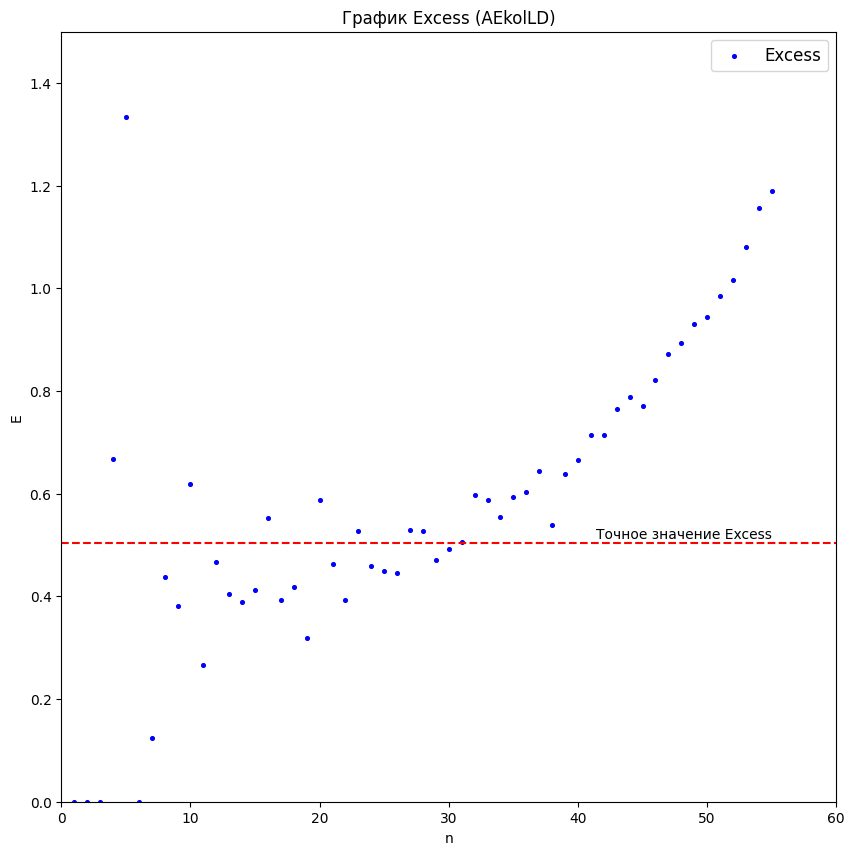

In [ ]:
Excess = [0, 0, 0, 0.667, 1.333, 0, 0.125, 0.438, 0.381, 0.619, 0.267, 0.467, 0.405, 0.39, 0.413, 0.553, 0.393, 0.419, 0.319, 0.588,
          0.463, 0.393, 0.527, 0.459, 0.449, 0.445, 0.529, 0.528, 0.471, 0.493, 0.506, 0.597, 0.588, 0.554, 0.594, 0.603, 0.644, 0.54, 0.639, 0.665,
          0.714, 0.714, 0.765, 0.789, 0.770, 0.821, 0.873, 0.893, 0.931, 0.944, 0.986, 1.017, 1.08, 1.156, 1.19]

n = list(range(1, 56))

plt.figure(figsize=(10,10))
plt.scatter(n,Excess,marker='o',s=7,color='b',label='Excess')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Excess (AEkolLD)')
plt.hlines(0.504, 0, 60, color='red',linestyle='--')
plt.text(55, 0.521, 'Точное значение Excess', ha='right', va='center')
plt.xlabel('n')
plt.ylabel('E')
plt.xlim([0, 60])
plt.ylim([0, 1.5])
plt.show()

### Среднее

In [ ]:
nn = np.arange(5,56)

av = []
for i in nn:
  av.append(np.mean(Excess[0:i]))

print(av)

[0.4, 0.3333333333333333, 0.30357142857142855, 0.32037499999999997, 0.32711111111111113, 0.35629999999999995, 0.34818181818181815, 0.3580833333333333, 0.3616923076923077, 0.3637142857142857, 0.367, 0.378625, 0.3794705882352941, 0.3816666666666666, 0.3783684210526315, 0.38885, 0.39238095238095233, 0.3924090909090909, 0.39826086956521733, 0.40079166666666666, 0.40271999999999997, 0.40434615384615386, 0.408962962962963, 0.4132142857142857, 0.41520689655172416, 0.4178, 0.4206451612903226, 0.42615625, 0.43106060606060603, 0.4346764705882353, 0.4392285714285714, 0.44377777777777777, 0.4491891891891891, 0.45157894736842097, 0.4563846153846153, 0.46160000000000007, 0.46775609756097564, 0.4736190476190476, 0.4803953488372093, 0.48740909090909096, 0.4936888888888889, 0.500804347826087, 0.5087234042553193, 0.5167291666666667, 0.5251836734693878, 0.53356, 0.5424313725490196, 0.5515576923076924, 0.5615283018867925, 0.5725370370370371, 0.5837636363636364]


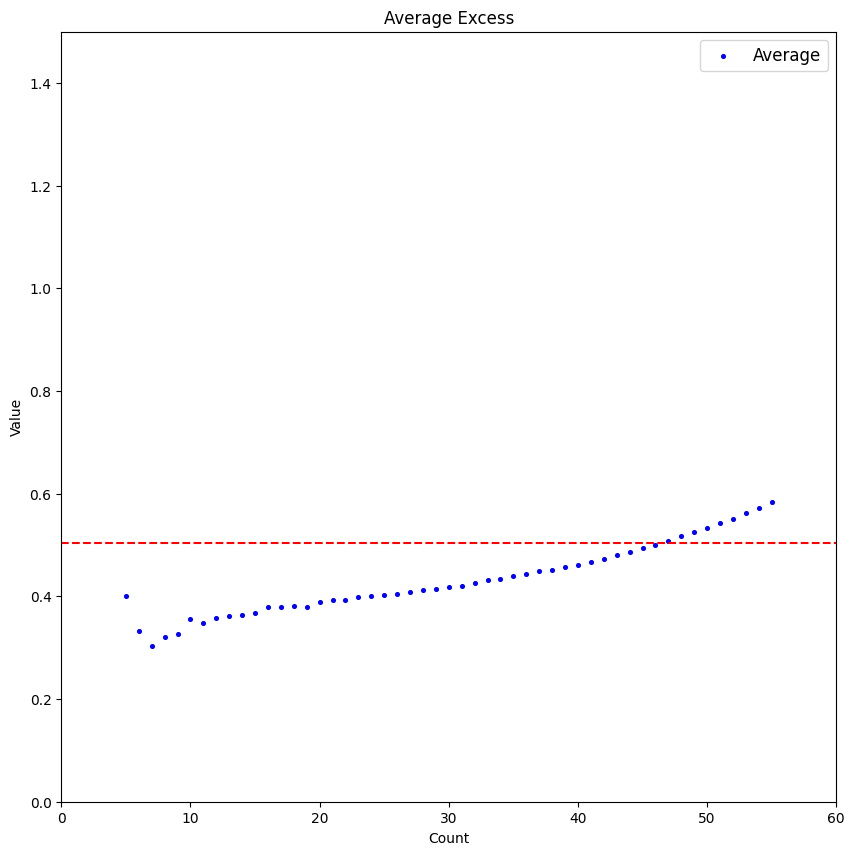

In [ ]:
plt.figure(figsize=(10,10))
plt.scatter(nn,av,marker='o',s=7,color='b',label='Average')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Average Excess')
plt.xlabel('Count')
plt.ylabel('Value')
plt.hlines(0.504, 0, 60, color='red',linestyle='--')
plt.xlim([0, 60])
plt.ylim([0, 1.5])
plt.show()


### Аппроксимация МНК

In [ ]:
x = np.array(n)
y = np.array(Excess)

linear_func = lambda x, b0, b1: b0 + b1*x
quadratic_func = lambda x, b0, b1, b2: b0 + b1*x + b2*x**2
qubic_func = lambda x, b0, b1, b2, b3: b0 + b1*x + b2*x**2 + b3*x**3
exp_func = lambda x, b0, b1, b2: b0 + b1*np.exp(b2*x)
exp1_func = lambda x, b0, b1, b2: b0 + b1*np.exp(x-b2)
exp2_func = lambda x, b0, b1: b0*np.power(b1,x)
exp3_func = lambda x, b0, b1, b2:  b0 + b1*np.power(b2,x)


from scipy.optimize import leastsq

# list of model
model_list = [
    'linear', 'quadratic',
    'qubic', 'exp3']

# model reference
models_dict = {
        'linear':             linear_func,
        'quadratic':          quadratic_func,
        'qubic':              qubic_func,
        'exp3':               exp3_func}

# initial values
p0_dict = {
        'linear':             [0, 0],
        'quadratic':          [0, 0, 0],
        'qubic':              [0, 0, 0, 0],
        'exp3':               [0, 1, 1]}

# titles (formulas)
formulas_dict = {
        'linear':             'y = b0 + b1*x',
        'quadratic':          'y = b0 + b1*x + b2*x^2',
        'qubic':              'y = b0 + b1*x + b2*x^2 + b3*x^3',
        'exp3':               'y = b0 + b1*np.power(b2,x)'}

# actual data
X_fact = x
Y_fact = y

# function for calculating residuals
residual_func = lambda p, x, y: y - func(x, *p)

# return all optional outputs
full_output = True

# variables to save the calculation results
calculation_results_df = pd.DataFrame(columns=['func', 'p0', 'popt', 'cov_x', 'SSE', 'MSE', 'pcov', 'perr', 'Y_calc', 'error_metrics'])
error_metrics_results_df = pd.DataFrame(columns=['MSE', 'RMSE', 'MAE', 'MSPE', 'MAPE', 'RMSLE', 'R2'])

# calculations
for func_name in model_list:
    print(f'{func_name.upper()} MODEL: {formulas_dict[func_name]}')
    func = models_dict[func_name]
    calculation_results_df.loc[func_name, 'func'] = func
    p0 = p0_dict[func_name]
    print(f'p0 = {p0}')
    calculation_results_df.loc[func_name, 'p0'] = p0
    if full_output:
        (popt, cov_x, infodict, mesg, ier) = leastsq(residual_func, p0, args=(X_fact, Y_fact), full_output=full_output)
        integer_flag = f'ier = {ier}, the solution was found' if ier<=4 else f'ier = {ier}, the solution was not found'
        print(integer_flag, '\n', mesg)
        calculation_results_df.loc[func_name, 'popt'] = popt
        print(f'parameters = {popt}')
        calculation_results_df.loc[func_name, 'cov_x'] = cov_x
        print(f'cov_x = \n{cov_x}')
        #SSE = (residual_func(popt, X_fact, Y_fact)**2).sum()
        SSE = (infodict['fvec']**2).sum()
        calculation_results_df.loc[func_name, 'SSE'] = SSE
        print(f'SSE = {SSE}')
        MSE = SSE / (len(Y_fact)-len(p0))
        calculation_results_df.loc[func_name, 'MSE'] = MSE
        print(f'MSE = {MSE}')
        pcov = cov_x * MSE
        calculation_results_df.loc[func_name, 'pcov'] = pcov
        print(f'pcov =\n {pcov}')
        perr = np.sqrt(np.diag(pcov))
        calculation_results_df.loc[func_name, 'perr'] = perr
        print(f'perr = {perr}\n')
    else:
        popt = leastsq(residual_func, p0, args=(X_fact, Y_fact), full_output=full_output)
        calculation_results_df.loc[func_name, 'popt'] = popt
        print(f'parameters = {popt}\n')
    Y_calc = func(X_fact, *popt)
    calculation_results_df.loc[func_name, 'Y_calc'] = Y_calc
    (error_metrics_dict, error_metrics_df) = regression_error_metrics(Yfact=Y_fact, Ycalc=Y_calc, model_name=func_name)
    calculation_results_df.loc[func_name, 'error_metrics'] = error_metrics_dict.values()
    error_metrics_results_df = pd.concat([error_metrics_results_df, error_metrics_df])

LINEAR MODEL: y = b0 + b1*x
p0 = [0, 0]
ier = 3, the solution was found 
 Both actual and predicted relative reductions in the sum of squares
  are at most 0.000000 and the relative error between two consecutive iterates is at 
  most 0.000000
parameters = [0.20358384 0.01357785]
cov_x = 
[[ 7.47474750e-02 -2.02020204e-03]
 [-2.02020204e-03  7.21500728e-05]]
SSE = 2.074739927200577
MSE = 0.03914603636227504
pcov =
 [[ 2.92606738e-03 -7.90829024e-05]
 [-7.90829024e-05  2.82438937e-06]]
perr = [0.05409314 0.00168059]

QUADRATIC MODEL: y = b0 + b1*x + b2*x^2
p0 = [0, 0, 0]
ier = 1, the solution was found 
 Both actual and predicted relative reductions in the sum of squares
  are at most 0.000000
parameters = [ 3.54089461e-01 -2.26484715e-03  2.82905305e-04]
cov_x = 
[[ 1.76138731e-01 -1.26929662e-02  1.90585077e-04]
 [-1.26929662e-02  1.19559896e-03 -2.00615875e-05]
 [ 1.90585077e-04 -2.00615875e-05  3.58242638e-07]]
SSE = 1.8513287591256584
MSE = 0.035602476137031894
pcov =
 [[ 6.2709749

<ipython-input-7-a10df777837d>:36: RuntimeWarning: divide by zero encountered in divide
  MSPE = (1/n_fit) *  np.sum(((Yfact-Ycalc)/Yfact)**2)
<ipython-input-7-a10df777837d>:37: RuntimeWarning: divide by zero encountered in divide
  MAPE = (1/n_fit) *  np.sum(abs((Yfact-Ycalc)/Yfact))
<ipython-input-7-a10df777837d>:36: RuntimeWarning: divide by zero encountered in divide
  MSPE = (1/n_fit) *  np.sum(((Yfact-Ycalc)/Yfact)**2)
<ipython-input-7-a10df777837d>:37: RuntimeWarning: divide by zero encountered in divide
  MAPE = (1/n_fit) *  np.sum(abs((Yfact-Ycalc)/Yfact))
<ipython-input-7-a10df777837d>:36: RuntimeWarning: divide by zero encountered in divide
  MSPE = (1/n_fit) *  np.sum(((Yfact-Ycalc)/Yfact)**2)
<ipython-input-7-a10df777837d>:37: RuntimeWarning: divide by zero encountered in divide
  MAPE = (1/n_fit) *  np.sum(abs((Yfact-Ycalc)/Yfact))
<ipython-input-7-a10df777837d>:36: RuntimeWarning: divide by zero encountered in divide
  MSPE = (1/n_fit) *  np.sum(((Yfact-Ycalc)/Yfact)**2)

#### 1-я степень

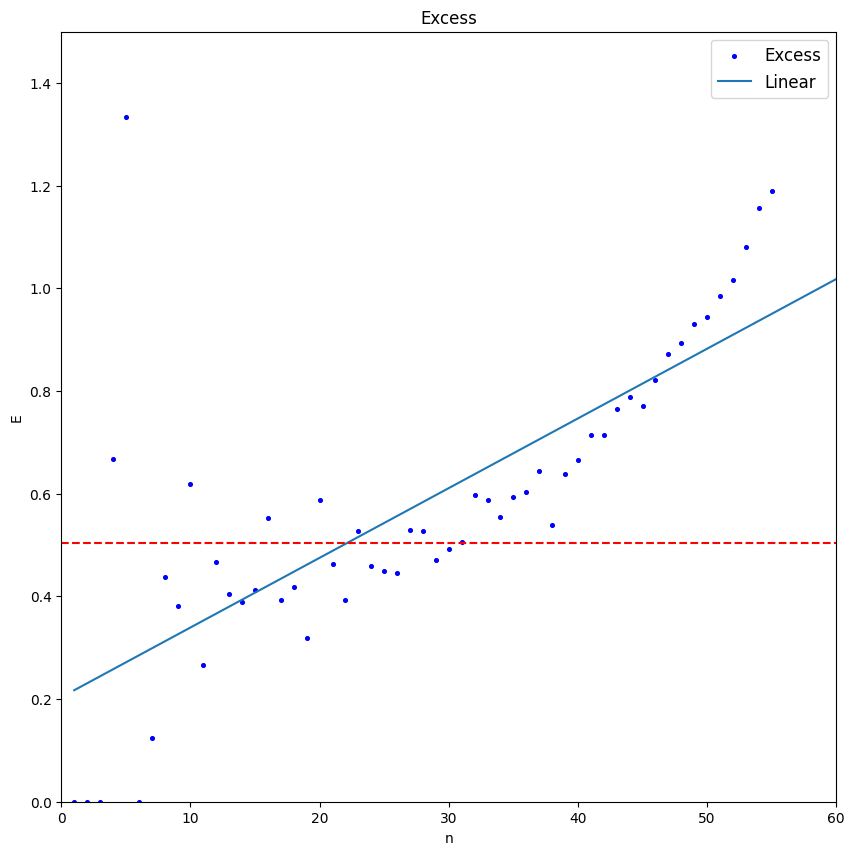

In [ ]:
b0, b1 = [0.20358384, 0.01357785]

xx = np.arange (1,81)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='b',label='Excess')
plt.plot(xx, b0 + b1*xx , label = 'Linear')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.hlines(0.504, 0, 60, color='red',linestyle='--')
plt.xlim([0, 60])
plt.ylim([0, 1.5])
plt.show()

#### 2-я степень

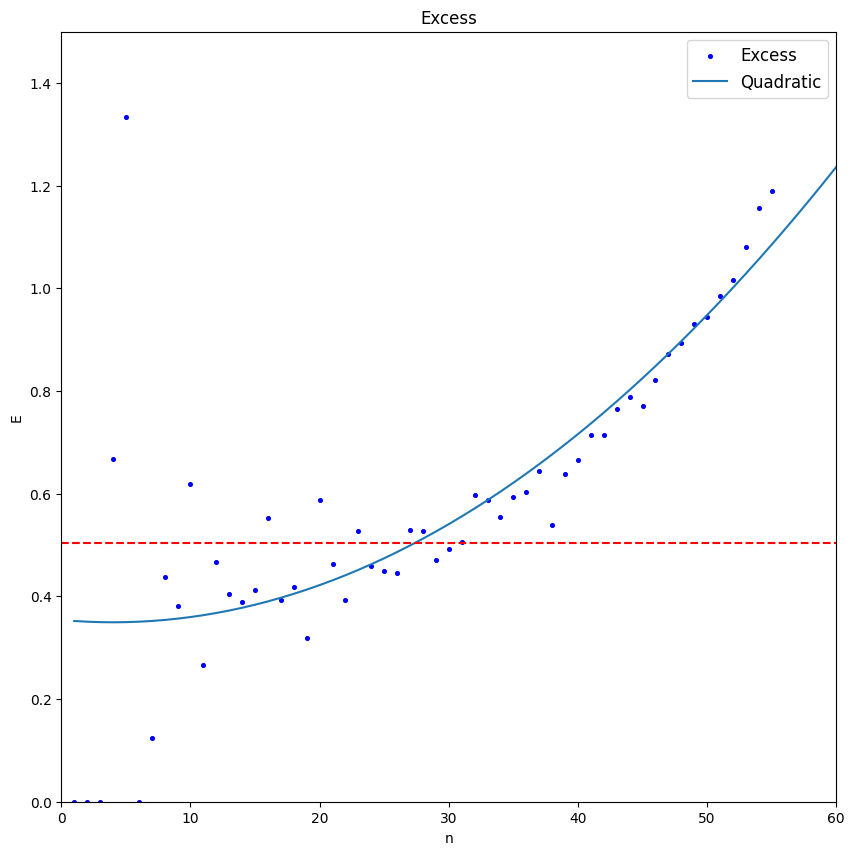

In [ ]:
# многочлен 2-й степени

b0, b1, b2 = [ 3.54089461e-01, -2.26484715e-03,  2.82905305e-04]

xx = np.arange (1,61)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='b',label='Excess')
plt.plot(xx, b0 + b1*xx + b2*xx**2 , label = 'Quadratic')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.hlines(0.504, 0, 60, color='red',linestyle='--')
plt.xlim([0, 60])
plt.ylim([0, 1.5])
plt.show()

In [ ]:
# Экстремум

def f(x):
    return 3.54089461e-01 -2.26484715e-03*x + 2.82905305e-04*x**2

from scipy.optimize import minimize_scalar
res = minimize_scalar(f)
print ('res.fun = ', res.fun)
print ('res.x = ', res.x)

res.fun =  0.3495565550044204
res.x =  4.002835898579725


#### 3-я степень

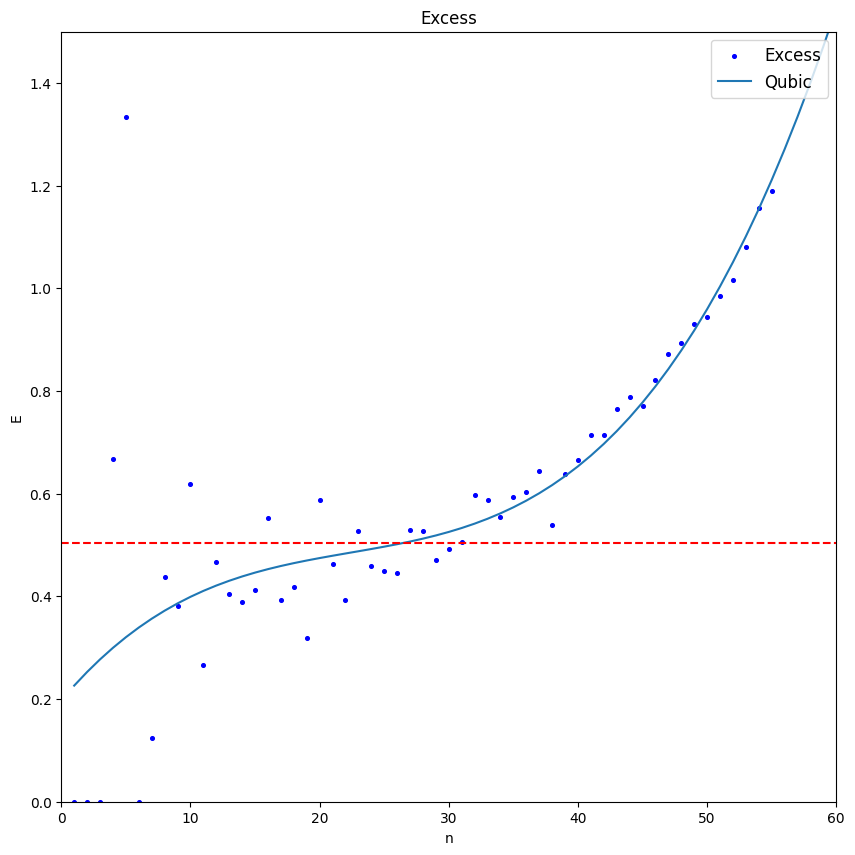

In [ ]:
b0, b1, b2, b3 = [ 1.97486188e-01,  2.98549969e-02, -1.13817702e-03,  1.69176467e-05]

xx = np.arange (1,61)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='b',label='Excess')
plt.plot(xx, b0 + b1*xx + b2*xx**2 + b3*xx**3 , label = 'Qubic')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.hlines(0.504, 0, 60, color='red',linestyle='--')
plt.xlim([0, 60])
plt.ylim([0, 1.5])
plt.show()

#### Экспонента

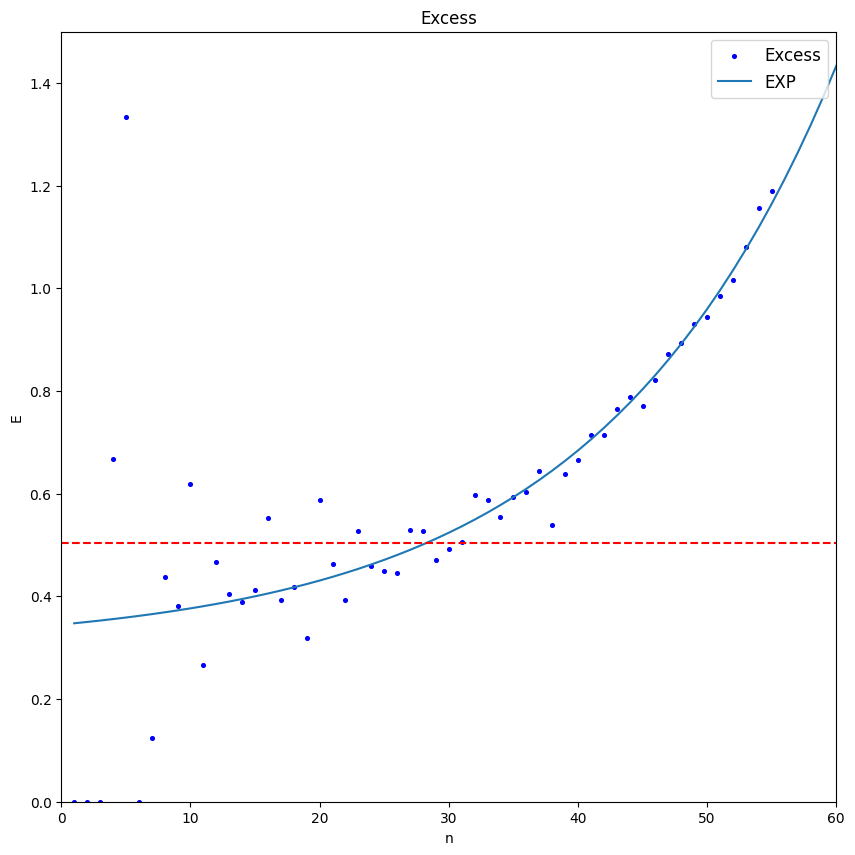

In [ ]:
b0, b1, b2 = [0.30143652, 0.04375593, 1.05571671]

xx = np.arange (1,61)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='b',label='Excess')
plt.plot(xx, b0 + b1*np.power(b2,xx) , label = 'EXP')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.hlines(0.504, 0, 60, color='red',linestyle='--')
plt.xlim([0, 60])
plt.ylim([0, 1.5])
plt.show()

### Несколько точек (Excess)

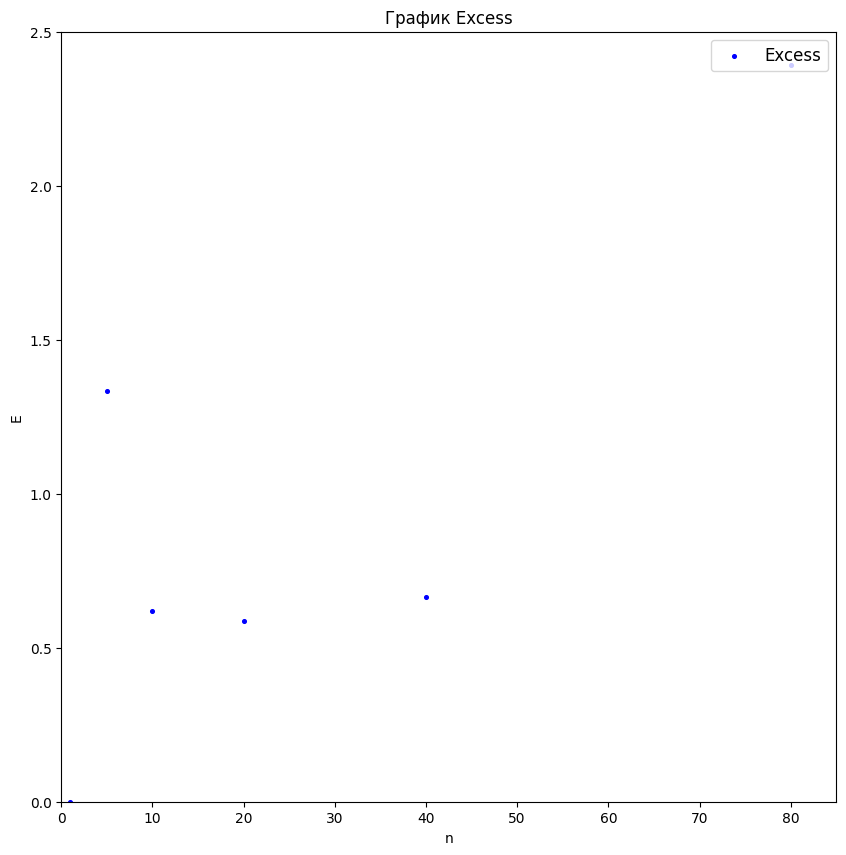

In [ ]:
Excess = [0, 1.333, 0.619, 0.588, 0.665, 2.391]
n = [1, 5, 10, 20, 40, 80]

plt.figure(figsize=(10,10))
plt.scatter(n,Excess,marker='o',s=7,color='b',label='Excess')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.xlim([0, 85])
plt.ylim([0, 2.5])
plt.show()

In [ ]:
x = np.array(n)
y = np.array(Excess)

from scipy.optimize import leastsq

linear_func = lambda x, b0, b1: b0 + b1*x
quadratic_func = lambda x, b0, b1, b2: b0 + b1*x + b2*x**2
qubic_func = lambda x, b0, b1, b2, b3: b0 + b1*x + b2*x**2 + b3*x**3
exp_func = lambda x, b0, b1, b2: b0 + b1*np.exp(b2*x)
exp1_func = lambda x, b0, b1, b2: b0 + b1*np.exp(x-b2)
exp2_func = lambda x, b0, b1, b2: b0 + b1*np.power(b2,x)
exp3_func = lambda x, b0, b1, b2, b3:  b0 + b1*np.power(b2,(x-b3))

# list of model
model_list = [
    'linear', 'quadratic',
    'qubic', 'exp2']

# model reference
models_dict = {
        'linear':             linear_func,
        'quadratic':          quadratic_func,
        'qubic':              qubic_func,
        'exp2':               exp2_func}

# initial values
p0_dict = {
        'linear':             [0, 0],
        'quadratic':          [0, 0, 0],
        'qubic':              [0, 0, 0, 0],
        'exp2':               [1, 1, 1]}

# titles (formulas)
formulas_dict = {
        'linear':             'y = b0 + b1*x',
        'quadratic':          'y = b0 + b1*x + b2*x^2',
        'qubic':              'y = b0 + b1*x + b2*x^2 + b3*x^3',
        'exp2':               'y = b0 + b1*np.power(b2,x)'}

# actual data
X_fact = x
Y_fact = y

# function for calculating residuals
residual_func = lambda p, x, y: y - func(x, *p)

# return all optional outputs
full_output = True

# variables to save the calculation results
calculation_results_df = pd.DataFrame(columns=['func', 'p0', 'popt', 'cov_x', 'SSE', 'MSE', 'pcov', 'perr', 'Y_calc', 'error_metrics'])
error_metrics_results_df = pd.DataFrame(columns=['MSE', 'RMSE', 'MAE', 'MSPE', 'MAPE', 'RMSLE', 'R2'])

# calculations
for func_name in model_list:
    print(f'{func_name.upper()} MODEL: {formulas_dict[func_name]}')
    func = models_dict[func_name]
    calculation_results_df.loc[func_name, 'func'] = func
    p0 = p0_dict[func_name]
    print(f'p0 = {p0}')
    calculation_results_df.loc[func_name, 'p0'] = p0
    if full_output:
        (popt, cov_x, infodict, mesg, ier) = leastsq(residual_func, p0, args=(X_fact, Y_fact), full_output=full_output)
        integer_flag = f'ier = {ier}, the solution was found' if ier<=4 else f'ier = {ier}, the solution was not found'
        print(integer_flag, '\n', mesg)
        calculation_results_df.loc[func_name, 'popt'] = popt
        print(f'parameters = {popt}')
        calculation_results_df.loc[func_name, 'cov_x'] = cov_x
        print(f'cov_x = \n{cov_x}')
        #SSE = (residual_func(popt, X_fact, Y_fact)**2).sum()
        SSE = (infodict['fvec']**2).sum()
        calculation_results_df.loc[func_name, 'SSE'] = SSE
        print(f'SSE = {SSE}')
        MSE = SSE / (len(Y_fact)-len(p0))
        calculation_results_df.loc[func_name, 'MSE'] = MSE
        print(f'MSE = {MSE}')
        pcov = cov_x * MSE
        calculation_results_df.loc[func_name, 'pcov'] = pcov
        print(f'pcov =\n {pcov}')
        perr = np.sqrt(np.diag(pcov))
        calculation_results_df.loc[func_name, 'perr'] = perr
        print(f'perr = {perr}\n')
    else:
        popt = leastsq(residual_func, p0, args=(X_fact, Y_fact), full_output=full_output)
        calculation_results_df.loc[func_name, 'popt'] = popt
        print(f'parameters = {popt}\n')
    Y_calc = func(X_fact, *popt)
    calculation_results_df.loc[func_name, 'Y_calc'] = Y_calc
    (error_metrics_dict, error_metrics_df) = regression_error_metrics(Yfact=Y_fact, Ycalc=Y_calc, model_name=func_name)
    calculation_results_df.loc[func_name, 'error_metrics'] = error_metrics_dict.values()
    error_metrics_results_df = pd.concat([error_metrics_results_df, error_metrics_df])

LINEAR MODEL: y = b0 + b1*x
p0 = [0, 0]
ier = 1, the solution was found 
 Both actual and predicted relative reductions in the sum of squares
  are at most 0.000000
parameters = [0.36846667 0.0217    ]
cov_x = 
[[ 3.17897091e-01 -5.81655492e-03]
 [-5.81655492e-03  2.23713650e-04]]
SSE = 1.3408190333333332
MSE = 0.3352047583333333
pcov =
 [[ 1.06560618e-01 -1.94973689e-03]
 [-1.94973689e-03  7.49898801e-05]]
perr = [0.32643624 0.00865967]

QUADRATIC MODEL: y = b0 + b1*x + b2*x^2
p0 = [0, 0, 0]
ier = 3, the solution was found 
 Both actual and predicted relative reductions in the sum of squares
  are at most 0.000000 and the relative error between two consecutive iterates is at 
  most 0.000000
parameters = [ 6.62333969e-01 -1.27777057e-02  4.24034515e-04]
cov_x = 
[[ 5.55248465e-01 -3.36635819e-02  3.42485110e-04]
 [-3.36635819e-02  3.49083999e-03 -4.01817444e-05]
 [ 3.42485110e-04 -4.01817444e-05  4.94187371e-07]]
SSE = 0.9769787623074961
MSE = 0.32565958743583207
pcov =
 [[ 1.80821986

<ipython-input-7-a10df777837d>:36: RuntimeWarning: divide by zero encountered in divide
  MSPE = (1/n_fit) *  np.sum(((Yfact-Ycalc)/Yfact)**2)
<ipython-input-7-a10df777837d>:37: RuntimeWarning: divide by zero encountered in divide
  MAPE = (1/n_fit) *  np.sum(abs((Yfact-Ycalc)/Yfact))
<ipython-input-7-a10df777837d>:36: RuntimeWarning: divide by zero encountered in divide
  MSPE = (1/n_fit) *  np.sum(((Yfact-Ycalc)/Yfact)**2)
<ipython-input-7-a10df777837d>:37: RuntimeWarning: divide by zero encountered in divide
  MAPE = (1/n_fit) *  np.sum(abs((Yfact-Ycalc)/Yfact))
<ipython-input-7-a10df777837d>:36: RuntimeWarning: divide by zero encountered in divide
  MSPE = (1/n_fit) *  np.sum(((Yfact-Ycalc)/Yfact)**2)
<ipython-input-7-a10df777837d>:37: RuntimeWarning: divide by zero encountered in divide
  MAPE = (1/n_fit) *  np.sum(abs((Yfact-Ycalc)/Yfact))
<ipython-input-7-a10df777837d>:36: RuntimeWarning: divide by zero encountered in divide
  MSPE = (1/n_fit) *  np.sum(((Yfact-Ycalc)/Yfact)**2)

3 степень

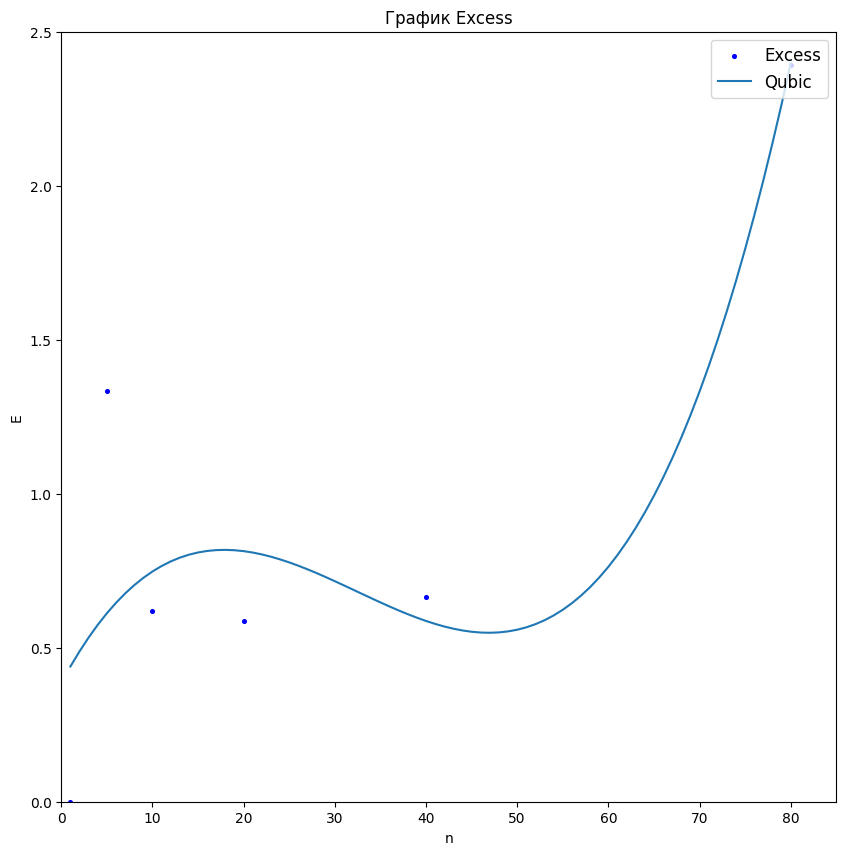

In [ ]:
b0, b1, b2, b3 = [ 3.85720318e-01,  5.53686049e-02, -2.13909007e-03,  2.20158696e-05]

xx = np.arange (1,81)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='b',label='Excess')
plt.plot(xx, b0 + b1*xx + b2*xx**2 + b3*xx**3 , label = 'Qubic')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.xlim([0, 85])
plt.ylim([0, 2.5])
plt.show()

In [ ]:
from sympy import *

x = Symbol('x', real=True)
f = b0 + b1*x + b2*x**2 + b3*x**3
fprime = f.diff(x)

solve(fprime, x)

[17.8746754840085, 46.8995111630030]

In [ ]:
import sympy as sp

def f(x):
  z = b0 + b1*x + b2*x**2 + b3*x**3
  return z

# Объявляем символьную переменную x
x = sp.Symbol ("x")
# Вывод функции
print("f(x) =", f(x))
# Находим производную функции f(x) и сохраняем ее в переменной d_f:
d_f = sp.diff(f(x), x)
print("Первая производная функции:",d_f)

# Решаем уравнение d_f = 0:
x_extr = sp.solve (d_f)
print ("точка экстремума:", x_extr)

# Сохраняем точки экстремума в переменные:
x_0 = x_extr[0]
x_1 = x_extr[1]

# Находим вторую производную функции:
d2_f = sp.diff(f(x), x, 2)
print("Вторая производная функции:", d2_f)

# Решаем уравнение d2_f = 0
x_extr2 = sp.solve (d2_f)
print ("точка перегиба:", x_extr2)

# Находим значение второй производной в точках экстремума x_0 и x_1,
# Сохраняем их в переменные f_0_d2 и f_1_d2:
f_0_d2 = d2_f.evalf(subs = {x : x_0})
f_1_d2 = d2_f.evalf(subs = {x : x_1})

# Определяем, является ли точка x_0 точкой лок.минимума, максимума или перегиба
if f_0_d2 > 0:
  print(x_0, "- локальный минимум")
elif f_0_d2 < 0:
  print(x_0, "- локальный максимум")
else:
  print(x_0, "- точка перегиба")

# Определяем, является ли точка x_1 точкой лок.минимума, максимума или перегиба
if f_1_d2 > 0:
  print(x_1, "- локальный минимум")
elif f_1_d2 < 0:
  print(x_1, "- локальный максимум")
else:
  print(x_1, "- точка перегиба")

f(x) = 2.20158696e-5*x**3 - 0.00213909007*x**2 + 0.0553686049*x + 0.385720318
Первая производная функции: 6.60476088e-5*x**2 - 0.00427818014*x + 0.0553686049
точка экстремума: [17.8746754840085, 46.8995111630030]
Вторая производная функции: 0.0001320952176*x - 0.00427818014
точка перегиба: [32.3870933235058]
17.8746754840085 - локальный максимум
46.8995111630030 - локальный минимум


2 степень

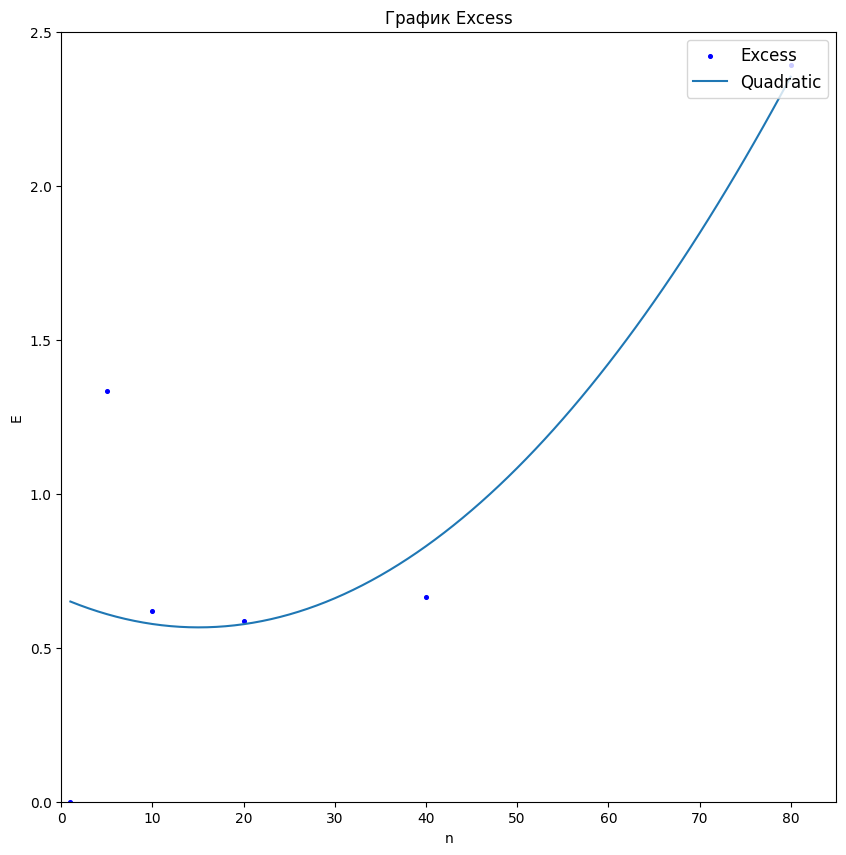

In [ ]:
b0, b1, b2 = [ 6.62333969e-01, -1.27777057e-02,  4.24034515e-04]

xx = np.arange (1,81)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='b',label='Excess')
plt.plot(xx, b0 + b1*xx + b2*xx**2 , label = 'Quadratic')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.xlim([0, 85])
plt.ylim([0, 2.5])
plt.show()

In [ ]:
from sympy import *

x = Symbol('x', real=True)
f = b0 + b1*x + b2*x**2
fprime = f.diff(x)

solve(fprime, x)

[15.0668226854128]

### График Approx

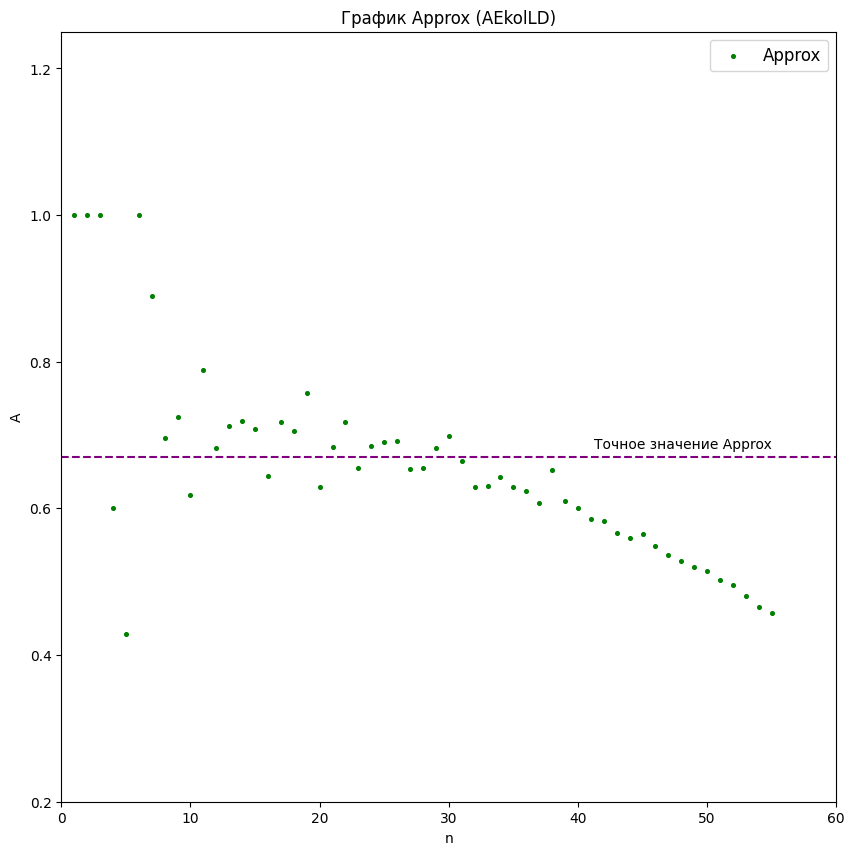

In [ ]:
Approx = [1, 1, 1, 0.6, 0.429, 1, 0.889, 0.696, 0.724, 0.618, 0.789, 0.682, 0.712, 0.719, 0.708, 0.644, 0.718, 0.705, 0.758, 0.629,
          0.684, 0.718, 0.655, 0.685, 0.69, 0.692, 0.654, 0.655, 0.683, 0.699, 0.664, 0.629, 0.63, 0.643, 0.629, 0.624, 0.608, 0.652, 0.61, 0.601,
          0.585, 0.583, 0.567, 0.56, 0.565, 0.549, 0.537, 0.528, 0.52, 0.515, 0.503, 0.496, 0.481, 0.465, 0.457]

n = list(range(1, 56))

plt.figure(figsize=(10,10))
plt.scatter(n,Approx,marker='o',s=7,color='g',label='Approx')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Approx (AEkolLD)')
plt.hlines(0.67, 0, 60, color='purple',linestyle='--')
plt.text(55, 0.687, 'Точное значение Approx', ha='right', va='center')
plt.xlabel('n')
plt.ylabel('A')
plt.xlim([0, 60])
plt.ylim([0.2, 1.25])
plt.show()

### Среднее Approx

[1.0, 1.0, 1.0, 0.9, 0.8058, 0.8381666666666666, 0.8454285714285714, 0.8267500000000001, 0.8153333333333335, 0.7956000000000001, 0.795, 0.7855833333333334, 0.779923076923077, 0.7755714285714286, 0.7710666666666667, 0.763125, 0.7604705882352941, 0.7573888888888889, 0.757421052631579, 0.7510000000000001, 0.7478095238095238, 0.7464545454545455, 0.7424782608695653, 0.7400833333333333, 0.7380800000000001, 0.7363076923076923, 0.7332592592592593, 0.7304642857142858, 0.7288275862068967, 0.7278333333333334, 0.7257741935483872, 0.72275, 0.7199393939393939, 0.7176764705882352, 0.7151428571428572, 0.7126111111111111, 0.7097837837837838, 0.7082631578947369, 0.7057435897435897, 0.703125, 0.7002439024390245, 0.6974523809523809, 0.6944186046511628, 0.6913636363636363, 0.6885555555555556, 0.6855217391304348, 0.6823617021276596, 0.6791458333333334, 0.6758979591836736, 0.6726800000000002, 0.6693529411764707, 0.666019230769231, 0.6625283018867927, 0.6588703703703707, 0.6552000000000003]


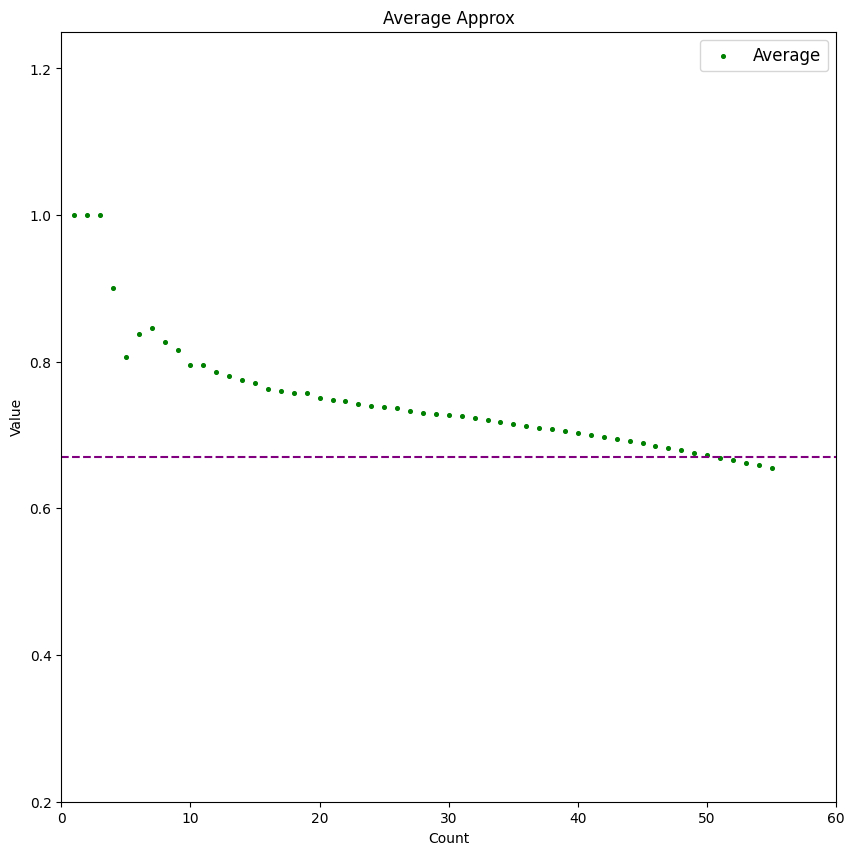

In [ ]:
nn = np.arange(1,56)

av = []
for i in nn:
  av.append(np.mean(Approx[0:i]))

print(av)

plt.figure(figsize=(10,10))
plt.scatter(nn,av,marker='o',s=7,color='g',label='Average')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Average Approx')
plt.xlabel('Count')
plt.ylabel('Value')
plt.hlines(0.67, 0, 60, color='purple',linestyle='--')
plt.xlim([0, 60])
plt.ylim([0.2, 1.25])
plt.show()

### Аппроксимация МНК (Approx)

In [ ]:
x = np.array(n)
y = np.array(Approx)

linear_func = lambda x, b0, b1: b0 + b1*x
quadratic_func = lambda x, b0, b1, b2: b0 + b1*x + b2*x**2
qubic_func = lambda x, b0, b1, b2, b3: b0 + b1*x + b2*x**2 + b3*x**3
exp_func = lambda x, b0, b1, b2: b0 + b1*np.exp(b2*x)
exp1_func = lambda x, b0, b1, b2: b0 + b1*np.exp(x-b2)
exp2_func = lambda x, b0, b1: b0*np.power(b1,x)
exp3_func = lambda x, b0, b1, b2:  b0 + b1*np.power(b2,x)


from scipy.optimize import leastsq

# list of model
model_list = [
    'linear', 'quadratic',
    'qubic', 'EXP']

# model reference
models_dict = {
        'linear':             linear_func,
        'quadratic':          quadratic_func,
        'qubic':              qubic_func,
        'EXP':                exp3_func}

# initial values
p0_dict = {
        'linear':             [0, 0],
        'quadratic':          [0, 0, 0],
        'qubic':              [0, 0, 0, 0],
        'EXP':                [1, 1, 1]}

# titles (formulas)
formulas_dict = {
        'linear':             'y = b0 + b1*x',
        'quadratic':          'y = b0 + b1*x + b2*x^2',
        'qubic':              'y = b0 + b1*x + b2*x^2 + b3*x^3',
        'EXP':                'y = b0 +b1*b2^x'}

# actual data
X_fact = x
Y_fact = y

# function for calculating residuals
residual_func = lambda p, x, y: y - func(x, *p)

# return all optional outputs
full_output = True

# variables to save the calculation results
calculation_results_df = pd.DataFrame(columns=['func', 'p0', 'popt', 'cov_x', 'SSE', 'MSE', 'pcov', 'perr', 'Y_calc', 'error_metrics'])
error_metrics_results_df = pd.DataFrame(columns=['MSE', 'RMSE', 'MAE', 'MSPE', 'MAPE', 'RMSLE', 'R2'])

# calculations
for func_name in model_list:
    print(f'{func_name.upper()} MODEL: {formulas_dict[func_name]}')
    func = models_dict[func_name]
    calculation_results_df.loc[func_name, 'func'] = func
    p0 = p0_dict[func_name]
    print(f'p0 = {p0}')
    calculation_results_df.loc[func_name, 'p0'] = p0
    if full_output:
        (popt, cov_x, infodict, mesg, ier) = leastsq(residual_func, p0, args=(X_fact, Y_fact), full_output=full_output)
        integer_flag = f'ier = {ier}, the solution was found' if ier<=4 else f'ier = {ier}, the solution was not found'
        print(integer_flag, '\n', mesg)
        calculation_results_df.loc[func_name, 'popt'] = popt
        print(f'parameters = {popt}')
        calculation_results_df.loc[func_name, 'cov_x'] = cov_x
        print(f'cov_x = \n{cov_x}')
        #SSE = (residual_func(popt, X_fact, Y_fact)**2).sum()
        SSE = (infodict['fvec']**2).sum()
        calculation_results_df.loc[func_name, 'SSE'] = SSE
        print(f'SSE = {SSE}')
        MSE = SSE / (len(Y_fact)-len(p0))
        calculation_results_df.loc[func_name, 'MSE'] = MSE
        print(f'MSE = {MSE}')
        pcov = cov_x * MSE
        calculation_results_df.loc[func_name, 'pcov'] = pcov
        print(f'pcov =\n {pcov}')
        perr = np.sqrt(np.diag(pcov))
        calculation_results_df.loc[func_name, 'perr'] = perr
        print(f'perr = {perr}\n')
    else:
        popt = leastsq(residual_func, p0, args=(X_fact, Y_fact), full_output=full_output)
        calculation_results_df.loc[func_name, 'popt'] = popt
        print(f'parameters = {popt}\n')
    Y_calc = func(X_fact, *popt)
    calculation_results_df.loc[func_name, 'Y_calc'] = Y_calc
    (error_metrics_dict, error_metrics_df) = regression_error_metrics(Yfact=Y_fact, Ycalc=Y_calc, model_name=func_name)
    calculation_results_df.loc[func_name, 'error_metrics'] = error_metrics_dict.values()
    error_metrics_results_df = pd.concat([error_metrics_results_df, error_metrics_df])

LINEAR MODEL: y = b0 + b1*x
p0 = [0, 0]
ier = 2, the solution was found 
 The relative error between two consecutive iterates is at most 0.000000
parameters = [ 0.82731111 -0.00614683]
cov_x = 
[[ 7.47474745e-02 -2.02020202e-03]
 [-2.02020202e-03  7.21500726e-05]]
SSE = 0.4051800103174603
MSE = 0.007644905855046421
pcov =
 [[ 5.71437405e-04 -1.54442543e-05]
 [-1.54442543e-05  5.51580512e-07]]
perr = [0.02390476 0.00074268]

QUADRATIC MODEL: y = b0 + b1*x + b2*x^2
p0 = [0, 0, 0]
ier = 1, the solution was found 
 Both actual and predicted relative reductions in the sum of squares
  are at most 0.000000
parameters = [ 8.31455384e-01 -6.58306465e-03  7.78998669e-06]
cov_x = 
[[ 1.76138737e-01 -1.26929676e-02  1.90585093e-04]
 [-1.26929676e-02  1.19559921e-03 -2.00615909e-05]
 [ 1.90585093e-04 -2.00615909e-05  3.58242682e-07]]
SSE = 0.4050106170569363
MSE = 0.007788665712633391
pcov =
 [[ 1.37188574e-03 -9.88612818e-05  1.48440358e-06]
 [-9.88612818e-05  9.31212255e-06 -1.56253026e-07]
 [ 1

#### 1 степень

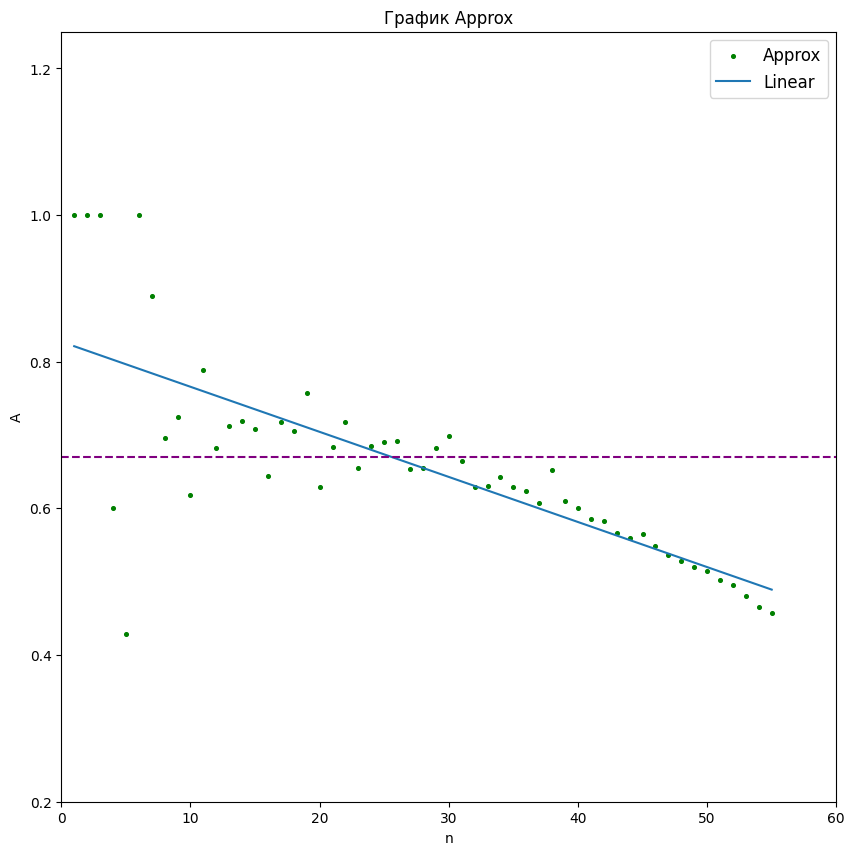

In [ ]:
b0, b1 = [ 0.82731111, -0.00614683]

xx = np.arange (1,56)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='g',label='Approx')
plt.plot(xx, b0 + b1*xx , label = 'Linear')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Approx')
plt.xlabel('n')
plt.ylabel('A')
plt.hlines(0.67, 0, 60, color='purple',linestyle='--')
plt.xlim([0, 60])
plt.ylim([0.2, 1.25])
plt.show()

#### 2 степень

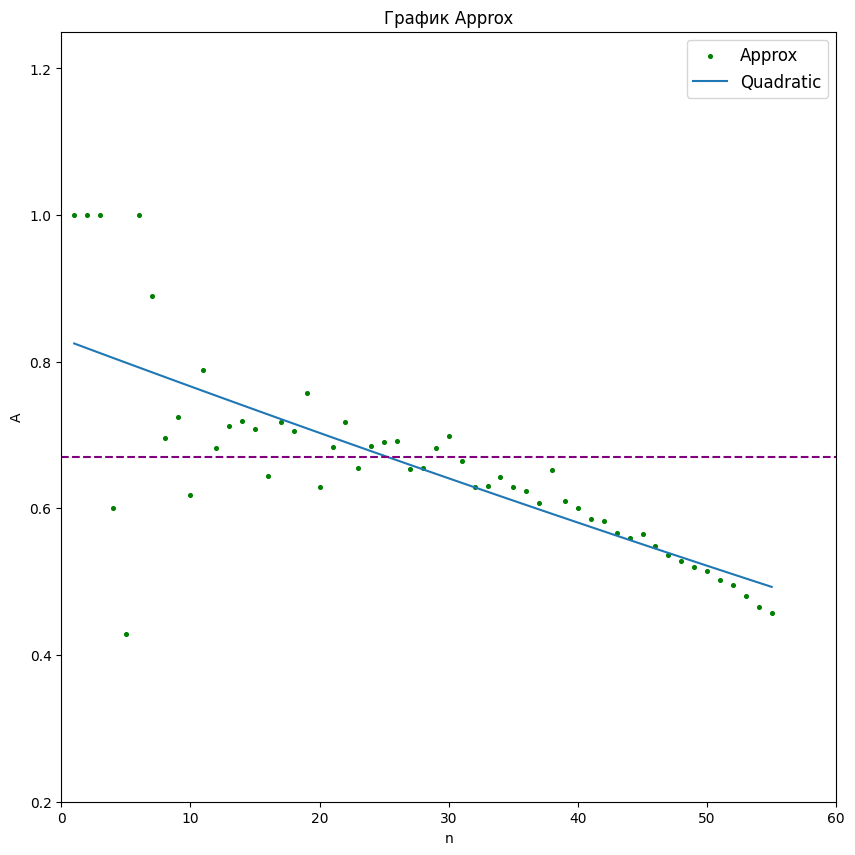

In [ ]:
b0, b1, b2 = [ 8.31455384e-01, -6.58306465e-03,  7.78998669e-06]

xx = np.arange (1,56)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='g',label='Approx')
plt.plot(xx, b0 + b1*xx + b2*xx**2 , label = 'Quadratic')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Approx')
plt.xlabel('n')
plt.ylabel('A')
plt.hlines(0.67, 0, 60, color='purple',linestyle='--')
plt.xlim([0, 60])
plt.ylim([0.2, 1.25])
plt.show()

#### 3 степень

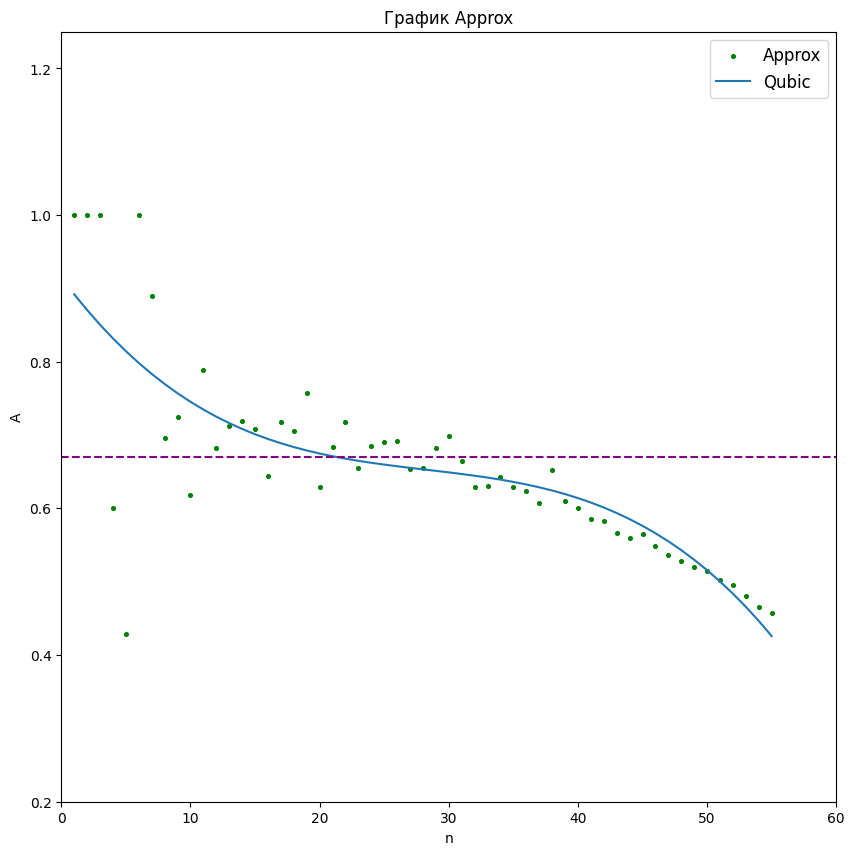

In [ ]:
b0, b1, b2, b3 =[ 9.14910355e-01, -2.36999525e-02,  7.65094620e-04, -9.01553135e-06]

xx = np.arange (1,56)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='g',label='Approx')
plt.plot(xx, b0 + b1*xx + b2*xx**2 + b3*xx**3 , label = 'Qubic')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Approx')
plt.xlabel('n')
plt.ylabel('A')
plt.hlines(0.67, 0, 60, color='purple',linestyle='--')
plt.xlim([0, 60])
plt.ylim([0.2, 1.25])
plt.show()

#### EXP

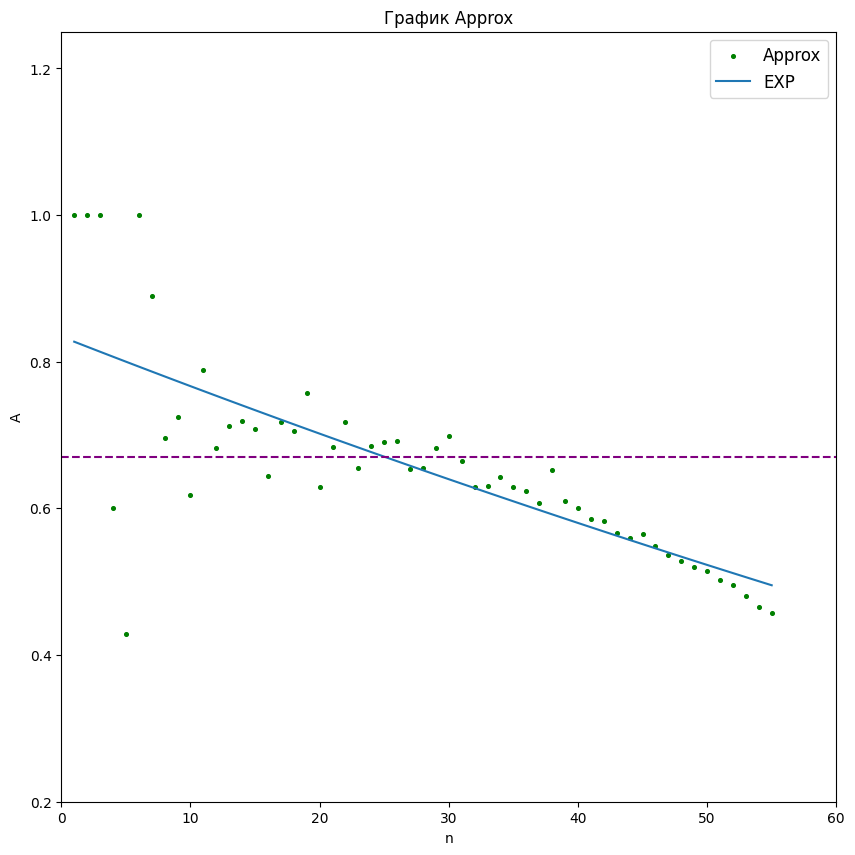

In [ ]:
b0, b1, b2 = [-0.83518007,  1.66937137,  0.99588132]

xx = np.arange (1,56)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='g',label='Approx')
plt.plot(xx, b0 + b1*np.power(b2,xx) , label = 'EXP')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Approx')
plt.xlabel('n')
plt.ylabel('A')
plt.hlines(0.67, 0, 60, color='purple',linestyle='--')
plt.xlim([0, 60])
plt.ylim([0.2, 1.25])
plt.show()

### Несколько точек (Approx)

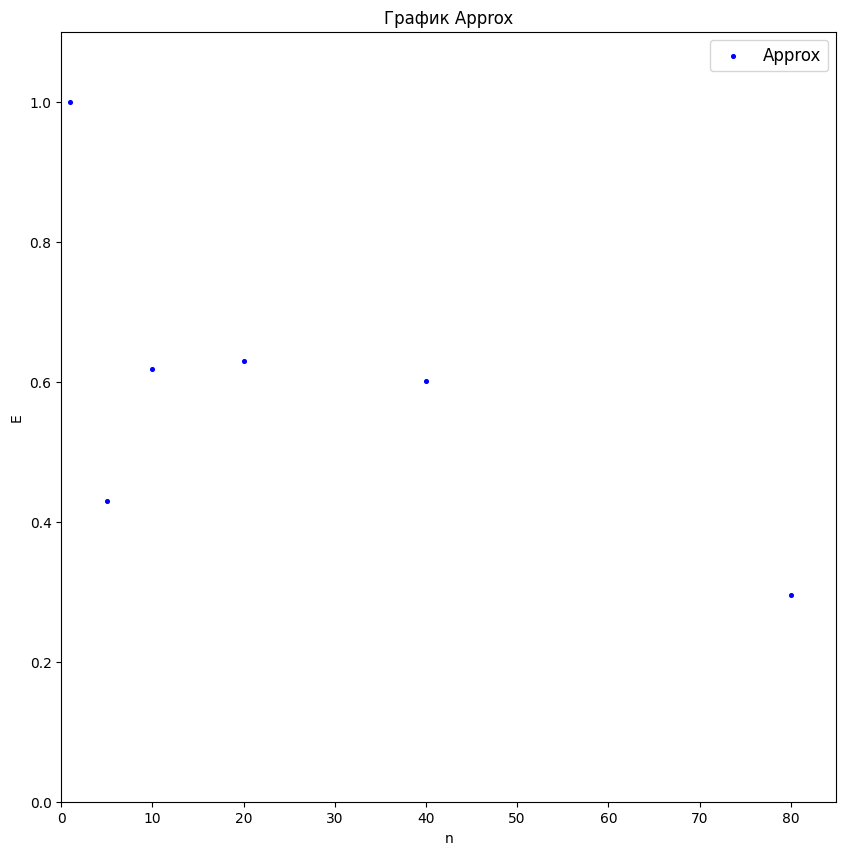

In [ ]:
Approx = [1, 0.429, 0.618, 0.629, 0.601, 0.295]
n = [1, 5, 10, 20, 40, 80]

plt.figure(figsize=(10,10))
plt.scatter(n,Approx,marker='o',s=7,color='b',label='Approx')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Approx')
plt.xlabel('n')
plt.ylabel('E')
plt.xlim([0, 85])
plt.ylim([0, 1.1])
plt.show()

In [ ]:
x = np.array(n)
y = np.array(Approx)

linear_func = lambda x, b0, b1: b0 + b1*x
quadratic_func = lambda x, b0, b1, b2: b0 + b1*x + b2*x**2
qubic_func = lambda x, b0, b1, b2, b3: b0 + b1*x + b2*x**2 + b3*x**3
exp_func = lambda x, b0, b1, b2: b0 + b1*np.exp(b2*x)
exp1_func = lambda x, b0, b1, b2: b0 + b1*np.exp(x-b2)
exp2_func = lambda x, b0, b1: b0*np.power(b1,x)
exp3_func = lambda x, b0, b1, b2:  b0 + b1*np.power(b2,x)


from scipy.optimize import leastsq

# list of model
model_list = [
    'linear', 'quadratic',
    'qubic']

# model reference
models_dict = {
        'linear':             linear_func,
        'quadratic':          quadratic_func,
        'qubic':              qubic_func}

# initial values
p0_dict = {
        'linear':             [0, 0],
        'quadratic':          [0, 0, 0],
        'qubic':              [0, 0, 0, 0]}

# titles (formulas)
formulas_dict = {
        'linear':             'y = b0 + b1*x',
        'quadratic':          'y = b0 + b1*x + b2*x^2',
        'qubic':              'y = b0 + b1*x + b2*x^2 + b3*x^3'}

# actual data
X_fact = x
Y_fact = y

# function for calculating residuals
residual_func = lambda p, x, y: y - func(x, *p)

# return all optional outputs
full_output = True

# variables to save the calculation results
calculation_results_df = pd.DataFrame(columns=['func', 'p0', 'popt', 'cov_x', 'SSE', 'MSE', 'pcov', 'perr', 'Y_calc', 'error_metrics'])
error_metrics_results_df = pd.DataFrame(columns=['MSE', 'RMSE', 'MAE', 'MSPE', 'MAPE', 'RMSLE', 'R2'])

# calculations
for func_name in model_list:
    print(f'{func_name.upper()} MODEL: {formulas_dict[func_name]}')
    func = models_dict[func_name]
    calculation_results_df.loc[func_name, 'func'] = func
    p0 = p0_dict[func_name]
    print(f'p0 = {p0}')
    calculation_results_df.loc[func_name, 'p0'] = p0
    if full_output:
        (popt, cov_x, infodict, mesg, ier) = leastsq(residual_func, p0, args=(X_fact, Y_fact), full_output=full_output)
        integer_flag = f'ier = {ier}, the solution was found' if ier<=4 else f'ier = {ier}, the solution was not found'
        print(integer_flag, '\n', mesg)
        calculation_results_df.loc[func_name, 'popt'] = popt
        print(f'parameters = {popt}')
        calculation_results_df.loc[func_name, 'cov_x'] = cov_x
        print(f'cov_x = \n{cov_x}')
        #SSE = (residual_func(popt, X_fact, Y_fact)**2).sum()
        SSE = (infodict['fvec']**2).sum()
        calculation_results_df.loc[func_name, 'SSE'] = SSE
        print(f'SSE = {SSE}')
        MSE = SSE / (len(Y_fact)-len(p0))
        calculation_results_df.loc[func_name, 'MSE'] = MSE
        print(f'MSE = {MSE}')
        pcov = cov_x * MSE
        calculation_results_df.loc[func_name, 'pcov'] = pcov
        print(f'pcov =\n {pcov}')
        perr = np.sqrt(np.diag(pcov))
        calculation_results_df.loc[func_name, 'perr'] = perr
        print(f'perr = {perr}\n')
    else:
        popt = leastsq(residual_func, p0, args=(X_fact, Y_fact), full_output=full_output)
        calculation_results_df.loc[func_name, 'popt'] = popt
        print(f'parameters = {popt}\n')
    Y_calc = func(X_fact, *popt)
    calculation_results_df.loc[func_name, 'Y_calc'] = Y_calc
    (error_metrics_dict, error_metrics_df) = regression_error_metrics(Yfact=Y_fact, Ycalc=Y_calc, model_name=func_name)
    calculation_results_df.loc[func_name, 'error_metrics'] = error_metrics_dict.values()
    error_metrics_results_df = pd.concat([error_metrics_results_df, error_metrics_df])

LINEAR MODEL: y = b0 + b1*x
p0 = [0, 0]
ier = 3, the solution was found 
 Both actual and predicted relative reductions in the sum of squares
  are at most 0.000000 and the relative error between two consecutive iterates is at 
  most 0.000000
parameters = [ 0.73101611 -0.00521857]
cov_x = 
[[ 3.17897090e-01 -5.81655474e-03]
 [-5.81655474e-03  2.23713644e-04]]
SSE = 0.16156779217002235
MSE = 0.040391948042505586
pcov =
 [[ 1.28404828e-02 -2.34941977e-04]
 [-2.34941977e-04  9.03622987e-06]]
perr = [0.11331585 0.00300603]

QUADRATIC MODEL: y = b0 + b1*x + b2*x^2
p0 = [0, 0, 0]
ier = 1, the solution was found 
 Both actual and predicted relative reductions in the sum of squares
  are at most 0.000000
parameters = [ 7.29509729e-01 -5.04183381e-03 -2.17362182e-06]
cov_x = 
[[ 5.55248907e-01 -3.36636233e-02  3.42485569e-04]
 [-3.36636233e-02  3.49084360e-03 -4.01817828e-05]
 [ 3.42485569e-04 -4.01817828e-05  4.94187770e-07]]
SSE = 0.1615582317643116
MSE = 0.053852743921437206
pcov =
 [[ 2.99

3 степень

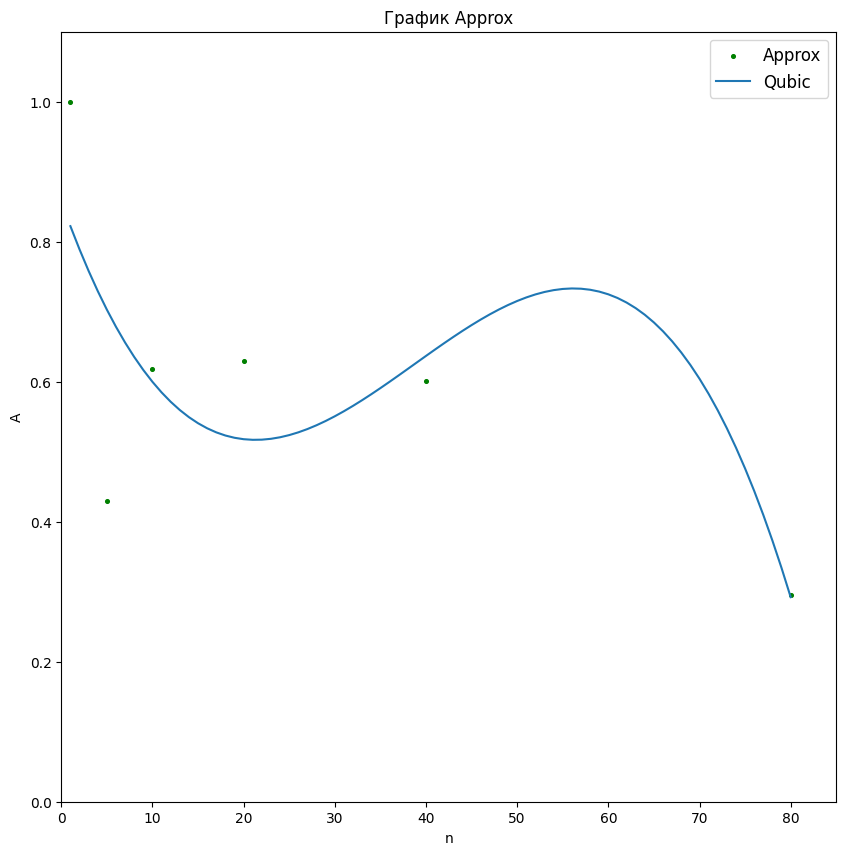

In [ ]:
b0, b1, b2, b3 =[ 8.57691347e-01, -3.66205512e-02,  1.18556767e-03, -1.02020626e-05]

xx = np.arange (1,81)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='g',label='Approx')
plt.plot(xx, b0 + b1*xx + b2*xx**2 + b3*xx**3 , label = 'Qubic')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Approx')
plt.xlabel('n')
plt.ylabel('A')
plt.xlim([0, 85])
plt.ylim([0, 1.1])
plt.show()

In [ ]:
from sympy import *

x = Symbol('x', real=True)
f = b0 + b1*x + b2*x**2 + b3*x**3
fprime = f.diff(x)

solve(fprime, x)

[21.3010211008208, 56.1713957677707]

In [ ]:
import sympy as sp

def f(x):
  z = b0 + b1*x + b2*x**2 + b3*x**3
  return z

# Объявляем символьную переменную x
x = sp.Symbol ("x")
# Вывод функции
print("f(x) =", f(x))
# Находим производную функции f(x) и сохраняем ее в переменной d_f:
d_f = sp.diff(f(x), x)
print("Первая производная функции:",d_f)

# Решаем уравнение d_f = 0:
x_extr = sp.solve (d_f)
print ("точка экстремума:", x_extr)

# Сохраняем точки экстремума в переменные:
x_0 = x_extr[0]
x_1 = x_extr[1]

# Находим вторую производную функции:
d2_f = sp.diff(f(x), x, 2)
print("Вторая производная функции:", d2_f)

# Решаем уравнение d2_f = 0
x_extr2 = sp.solve (d2_f)
print ("точка перегиба:", x_extr2)

# Находим значение второй производной в точках экстремума x_0 и x_1,
# Сохраняем их в переменные f_0_d2 и f_1_d2:
f_0_d2 = d2_f.evalf(subs = {x : x_0})
f_1_d2 = d2_f.evalf(subs = {x : x_1})

# Определяем, является ли точка x_0 точкой лок.минимума, максимума или перегиба
if f_0_d2 > 0:
  print(x_0, "- локальный минимум")
elif f_0_d2 < 0:
  print(x_0, "- локальный максимум")
else:
  print(x_0, "- точка перегиба")

# Определяем, является ли точка x_1 точкой лок.минимума, максимума или перегиба
if f_1_d2 > 0:
  print(x_1, "- локальный минимум")
elif f_1_d2 < 0:
  print(x_1, "- локальный максимум")
else:
  print(x_1, "- точка перегиба")

f(x) = -1.02020626e-5*x**3 + 0.00118556767*x**2 - 0.0366205512*x + 0.857691347
Первая производная функции: -3.06061878e-5*x**2 + 0.00237113534*x - 0.0366205512
точка экстремума: [21.3010211008208, 56.1713957677707]
Вторая производная функции: 0.00237113534 - 6.12123756e-5*x
точка перегиба: [38.7362084342958]
21.3010211008208 - локальный минимум
56.1713957677707 - локальный максимум


2 степень

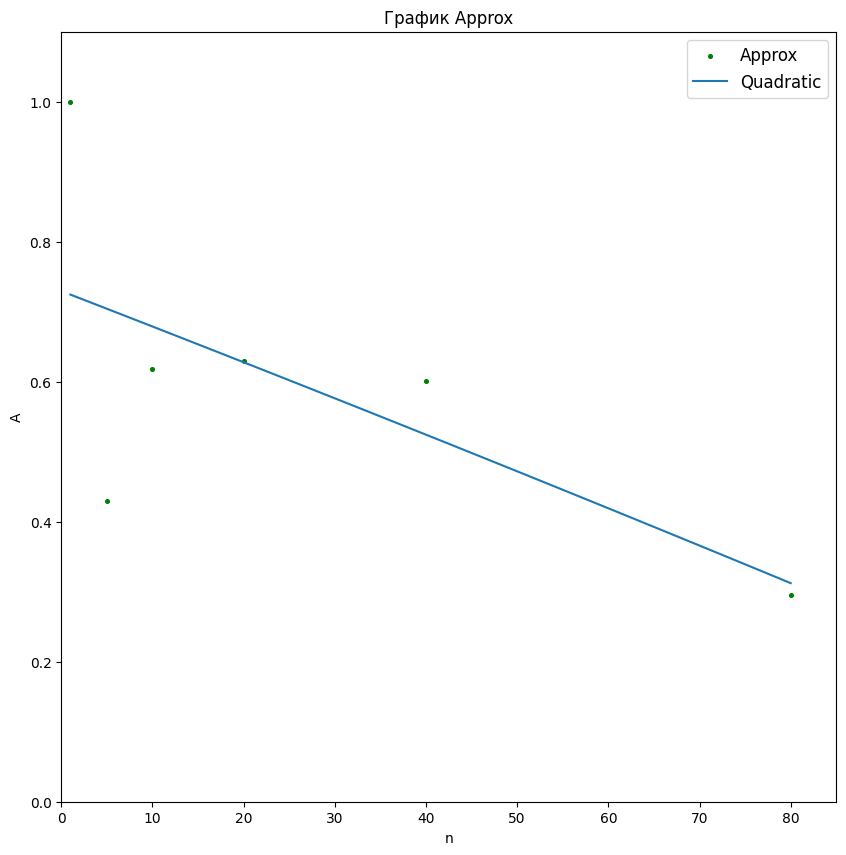

In [ ]:
b0, b1, b2 = [ 7.29509729e-01, -5.04183381e-03, -2.17362182e-06]

xx = np.arange (1,81)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='g',label='Approx')
plt.plot(xx, b0 + b1*xx + b2*xx**2 , label = 'Quadratic')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Approx')
plt.xlabel('n')
plt.ylabel('A')
plt.xlim([0, 85])
plt.ylim([0, 1.1])
plt.show()

### Сведенные графики Excess и Approx

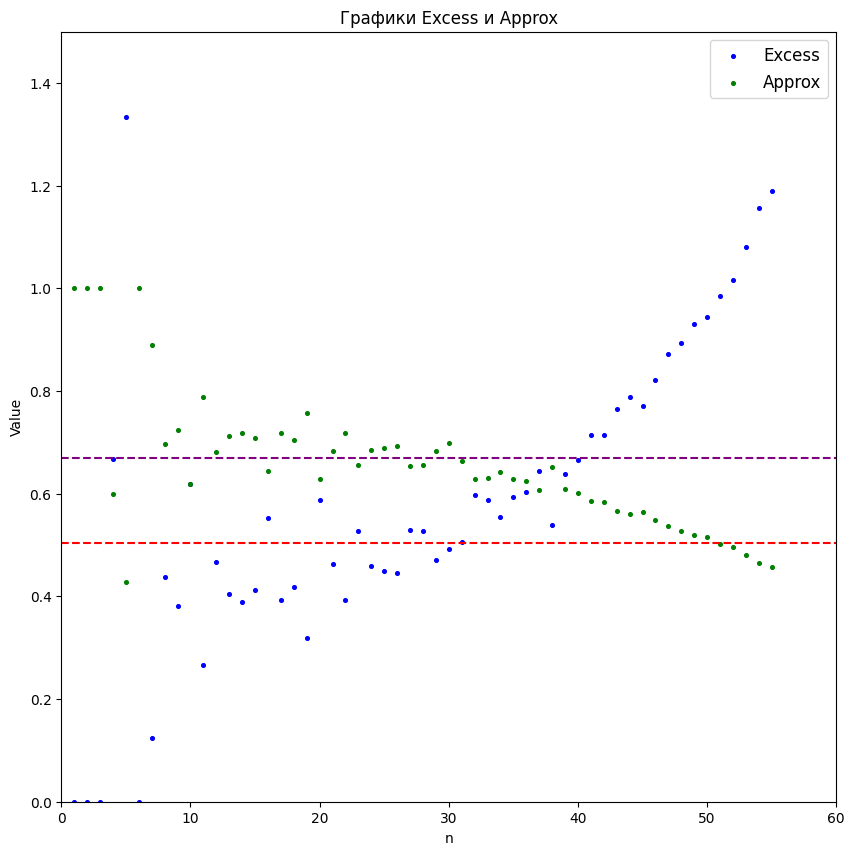

In [ ]:
Approx = [1, 1, 1, 0.6, 0.429, 1, 0.889, 0.696, 0.724, 0.618, 0.789, 0.682, 0.712, 0.719, 0.708, 0.644, 0.718, 0.705, 0.758, 0.629,
          0.684, 0.718, 0.655, 0.685, 0.69, 0.692, 0.654, 0.655, 0.683, 0.699, 0.664, 0.629, 0.63, 0.643, 0.629, 0.624, 0.608, 0.652, 0.61, 0.601,
          0.585, 0.583, 0.567, 0.56, 0.565, 0.549, 0.537, 0.528, 0.52, 0.515, 0.503, 0.496, 0.481, 0.465, 0.457]

Excess = [0, 0, 0, 0.667, 1.333, 0, 0.125, 0.438, 0.381, 0.619, 0.267, 0.467, 0.405, 0.39, 0.413, 0.553, 0.393, 0.419, 0.319, 0.588,
          0.463, 0.393, 0.527, 0.459, 0.449, 0.445, 0.529, 0.528, 0.471, 0.493, 0.506, 0.597, 0.588, 0.554, 0.594, 0.603, 0.644, 0.54, 0.639, 0.665,
          0.714, 0.714, 0.765, 0.789, 0.770, 0.821, 0.873, 0.893, 0.931, 0.944, 0.986, 1.017, 1.08, 1.156, 1.19]


n = list(range(1, 56))


plt.figure(figsize=(10,10))
plt.scatter(n,Excess,marker='o',s=7,color='b',label='Excess')
plt.scatter(n,Approx,marker='o',s=7,color='g',label='Approx')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Графики Excess и Approx')
plt.hlines(0.504, 0, 60, color='r',linestyle='--')
plt.hlines(0.67, 0, 60, color='purple',linestyle='--')
plt.xlabel('n')
plt.ylabel('Value')
plt.xlim([0, 60])
plt.ylim([0, 1.5])
plt.show()

## Прямоугольник

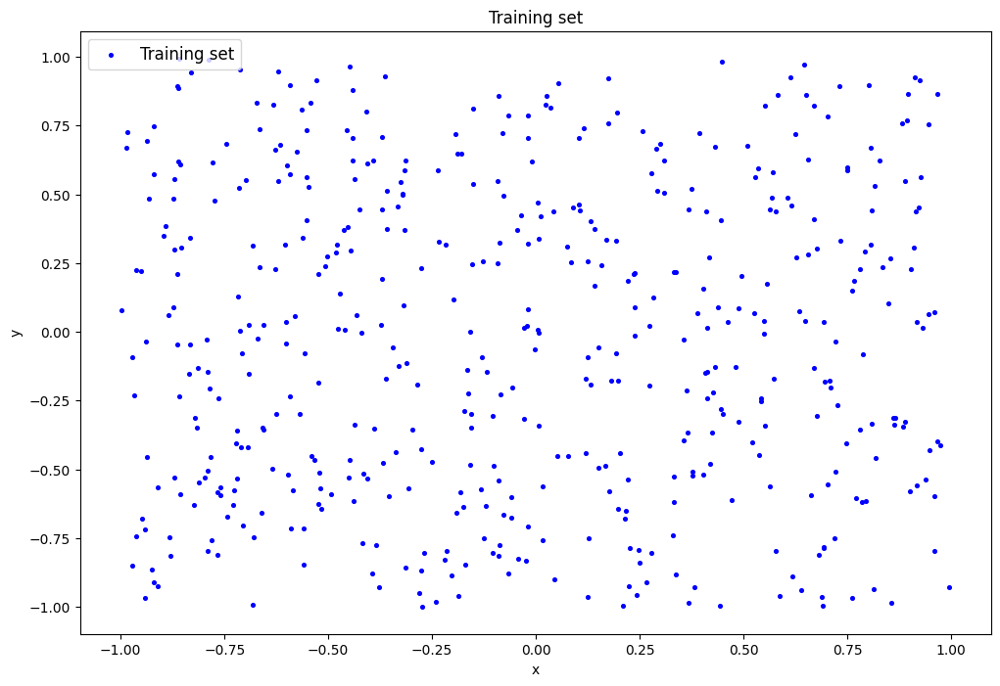

In [ ]:
# Пример использования
x_min = -1
x_max = 1
y_min = -1
y_max = 1
n_points = 500

points = generuj_body(x_min, x_max, y_min, y_max, n_points)
data3 = points

plt.figure(figsize=(12,8))
plt.scatter(points[:,0],points[:,1],marker='o',s=7,color='b',label='Training set')
plt.legend(loc= 'upper left',fontsize=12)
plt.title('Training set')
plt.xlabel('x')
plt.ylabel('y')
plt.savefig('out/train_set.png')
plt.show()

In [ ]:
points

array([[ 0.22201272,  0.18662568],
       [ 0.73066053,  0.89283346],
       [-0.63555103, -0.49843477],
       [-0.38593556, -0.77445389],
       [ 0.44523832,  0.40649133],
       [-0.11943474, -0.6347884 ],
       [-0.31380243, -0.85880593],
       [-0.89262554,  0.38590411],
       [-0.35800376,  0.51180249],
       [-0.77432972,  0.47878112],
       [-0.93131167,  0.48375533],
       [ 0.61511267,  0.45999384],
       [ 0.63778538, -0.93983362],
       [ 0.48683518,  0.08678373],
       [ 0.08830718,  0.45181236],
       [-0.12889956, -0.09095355],
       [-0.02354015, -0.83145316],
       [-0.79072331, -0.79705506],
       [-0.60229912,  0.03570693],
       [-0.0290059 , -0.31700904],
       [ 0.44366126, -0.99591635],
       [-0.99823338,  0.08004344],
       [-0.27599557, -0.42613179],
       [-0.81076668, -0.54836924],
       [-0.07809341,  0.49525049],
       [-0.83013535,  0.9426557 ],
       [ 0.5562288 ,  0.17563612],
       [-0.10061333, -0.48683321],
       [-0.92089766,

In [ ]:
np.savetxt('data3.txt', data3)

In [ ]:
# Загрузка датасета

with open('/content/drive/My Drive/Colab Notebooks/data3.txt', 'r') as f:
    data3 = np.loadtxt(f)
data3

array([[ 0.22201272,  0.18662568],
       [ 0.73066053,  0.89283346],
       [-0.63555103, -0.49843477],
       [-0.38593556, -0.77445389],
       [ 0.44523832,  0.40649133],
       [-0.11943474, -0.6347884 ],
       [-0.31380243, -0.85880593],
       [-0.89262554,  0.38590411],
       [-0.35800376,  0.51180249],
       [-0.77432972,  0.47878112],
       [-0.93131167,  0.48375533],
       [ 0.61511267,  0.45999384],
       [ 0.63778538, -0.93983362],
       [ 0.48683518,  0.08678373],
       [ 0.08830718,  0.45181236],
       [-0.12889956, -0.09095355],
       [-0.02354015, -0.83145316],
       [-0.79072331, -0.79705506],
       [-0.60229912,  0.03570693],
       [-0.0290059 , -0.31700904],
       [ 0.44366126, -0.99591635],
       [-0.99823338,  0.08004344],
       [-0.27599557, -0.42613179],
       [-0.81076668, -0.54836924],
       [-0.07809341,  0.49525049],
       [-0.83013535,  0.9426557 ],
       [ 0.5562288 ,  0.17563612],
       [-0.10061333, -0.48683321],
       [-0.92089766,

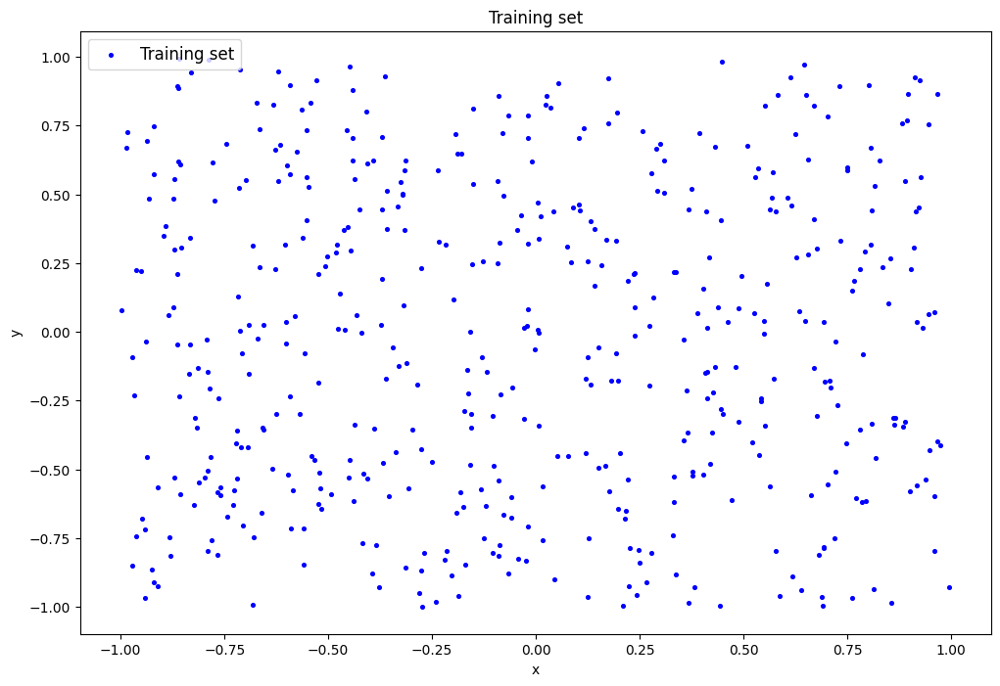

In [ ]:
plt.figure(figsize=(12,8))
plt.scatter(data3[:,0],data3[:,1],marker='o',s=7,color='b',label='Training set')
plt.legend(loc= 'upper left',fontsize=12)
plt.title('Training set')
plt.xlabel('x')
plt.ylabel('y')
plt.show()

### Обучение AE и построение EDCA

In [ ]:
#### Обучение Автокодировщика
size = data3.shape[1]
patience = 700
verbose_show = True

ae_pr = tensorflow.keras.models.Sequential()

# input layer
ae_pr.add(tensorflow.keras.layers.Dense(size))
ae_pr.add(tensorflow.keras.layers.Activation('tanh'))

# hidden layers
ae_pr.add(tensorflow.keras.layers.Dense(5))
ae_pr.add(tensorflow.keras.layers.Activation('tanh'))
ae_pr.add(tensorflow.keras.layers.Dense(3))
ae_pr.add(tensorflow.keras.layers.Activation('tanh'))
ae_pr.add(tensorflow.keras.layers.Dense(2))
ae_pr.add(tensorflow.keras.layers.Activation('tanh'))
ae_pr.add(tensorflow.keras.layers.Dense(3))
ae_pr.add(tensorflow.keras.layers.Activation('tanh'))
ae_pr.add(tensorflow.keras.layers.Dense(5))
ae_pr.add(tensorflow.keras.layers.Activation('tanh'))

# output layer
ae_pr.add(tensorflow.keras.layers.Dense(size))
ae_pr.add(tensorflow.keras.layers.Activation('linear'))

optimizer = tensorflow.keras.optimizers.Adam(learning_rate=0.001, beta_1=0.9, beta_2=0.999, amsgrad=False)
ae_pr.compile(loss='mean_squared_error', optimizer=optimizer)

error_stop = 0.0001
epo = 2000

early_stopping_callback_on_error = EarlyStoppingOnValue(monitor='loss', baseline=error_stop)
early_stopping_callback_on_improving = tensorflow.keras.callbacks.EarlyStopping(monitor='loss',
                                                                                           min_delta=0.0001, patience = patience,
                                                                                           verbose=1, mode='auto',
                                                                                           baseline=None,
                                                                                           restore_best_weights=False)

history_callback = tensorflow.keras.callbacks.History()
verbose = 1 if verbose_show else 0
history_object = ae_pr.fit(data3, data3,
                                batch_size=data3.shape[0],
                                epochs=epo,
                                callbacks=[early_stopping_callback_on_error, history_callback,
                                early_stopping_callback_on_improving],
                                verbose=verbose)
ae_pr_trainned = ae_pr
ae_pr_pred = ae_pr_trainned.predict(data3)
ae_pr_trainned.save('out/AE_pr.h5')

Epoch 1/2000
1/1 [==============================] - 4s 4s/step - loss: 0.2670
Epoch 2/2000
1/1 [==============================] - 0s 16ms/step - loss: 0.2642
Epoch 3/2000
1/1 [==============================] - 0s 21ms/step - loss: 0.2615
Epoch 4/2000
1/1 [==============================] - 0s 18ms/step - loss: 0.2590
Epoch 5/2000
1/1 [==============================] - 0s 18ms/step - loss: 0.2565
Epoch 6/2000
1/1 [==============================] - 0s 20ms/step - loss: 0.2541
Epoch 7/2000
1/1 [==============================] - 0s 17ms/step - loss: 0.2516
Epoch 8/2000
1/1 [==============================] - 0s 18ms/step - loss: 0.2492
Epoch 9/2000
1/1 [==============================] - 0s 21ms/step - loss: 0.2467
Epoch 10/2000
1/1 [==============================] - 0s 25ms/step - loss: 0.2442
Epoch 11/2000
1/1 [==============================] - 0s 16ms/step - loss: 0.2418
Epoch 12/2000
1/1 [==============================] - 0s 17ms/step - loss: 0.2394
Epoch 13/2000
1/1 [====================

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [ ]:
# Сохранение AE
ae_pr.save('best_model_for_data3')

In [ ]:
# Загрузка автокодировщика
from keras.models import load_model
ae_pr = load_model('best_model_for_data3')

ae_pr_trainned = ae_pr
ae_pr_pred = ae_pr_trainned.predict(data3)
ae_pr_trainned.save('out/AE_pr.h5')

16/16 [==============================] - 0s 2ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


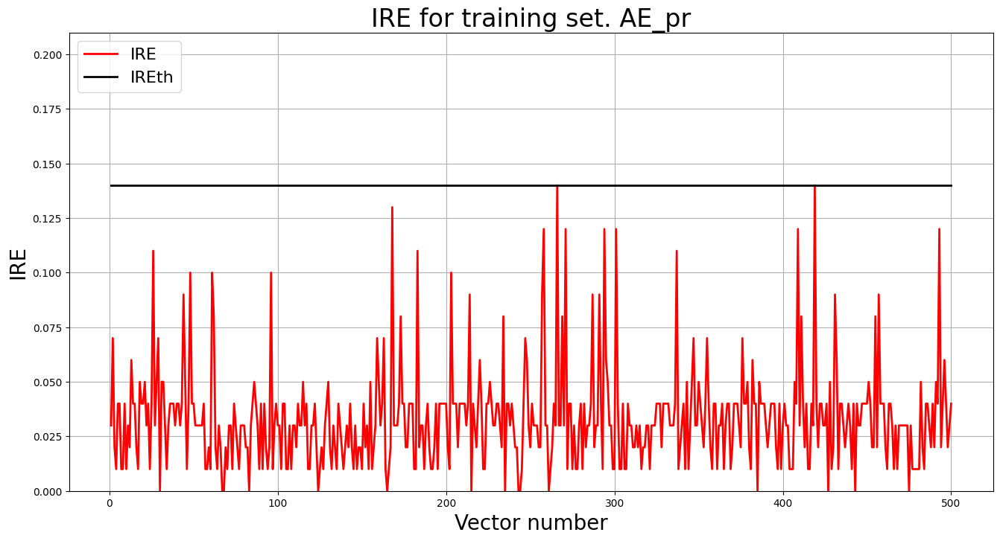

In [ ]:
# Ошибка реконструкции
irefile = 'out/AE_pr_ire_th.txt'
IRE_array = np.round(ire_array(data3, ae_pr_pred), 2)
IREth = np.amax(IRE_array)
with open(irefile, 'w') as file:
    file.write(str(IREth))

IRE3 = IRE_array
IREth_3 = IREth

lib.ire_plot('training', IRE3, IREth, 'AE_pr')

250/250 [==============================] - 0s 1ms/step


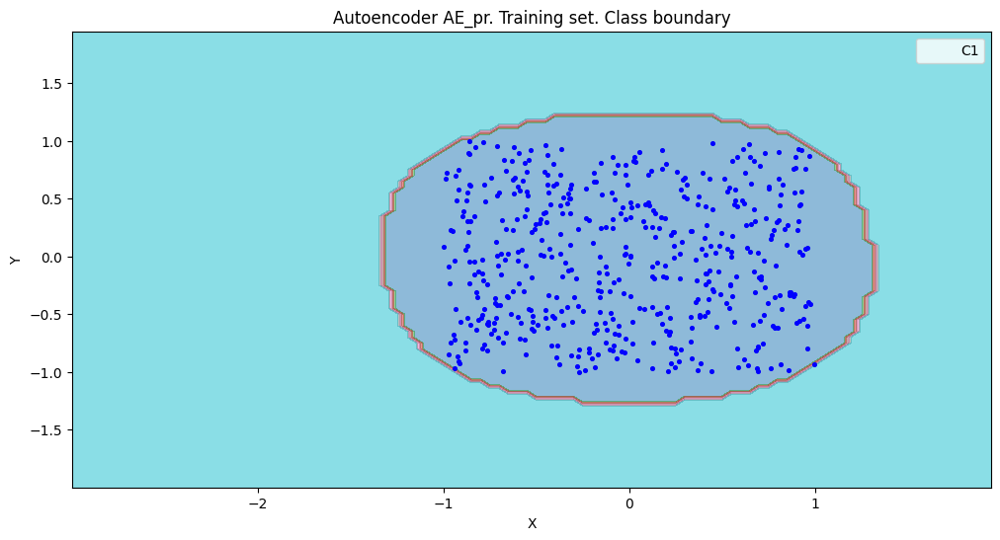

amount:  394
amount_ae:  1382


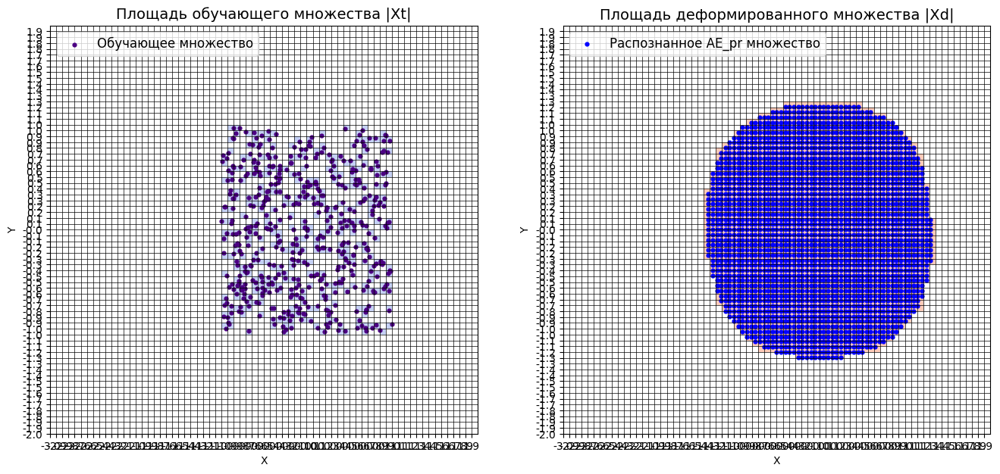

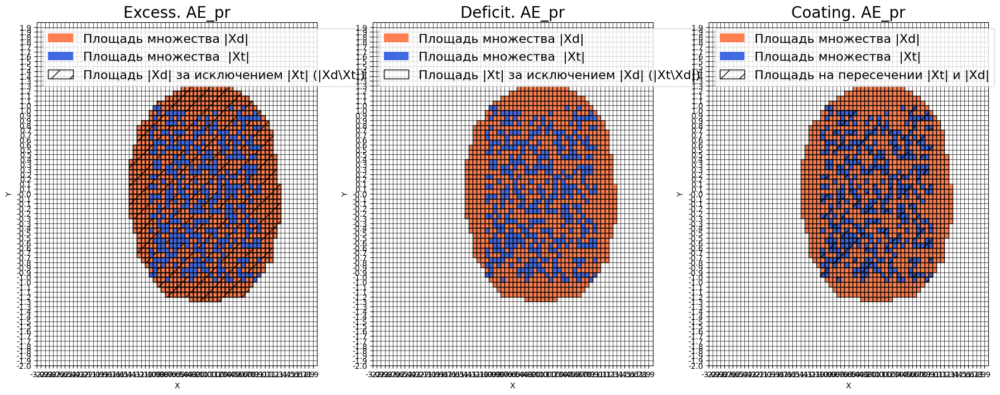


Оценка качества AE_pr
IDEAL = 0. Excess:  2.5076142131979697
IDEAL = 0. Deficit:  0.0
IDEAL = 1. Coating:  1.0
summa:  1.0
IDEAL = 1. Extrapolation precision (Approx):  0.28509406657018815




In [ ]:
# построение областей покрытия и границ классов
# расчет характеристик качества обучения
# параметр numb_square, отвечающий за количество элементов разбиения по каждой оси пространства признаков
numb_square = 70

xx, yy, Z3 = lib.square_calc(numb_square, data3, ae_pr_trainned, IREth_3, '_pr', True)

### Плотное покрытие

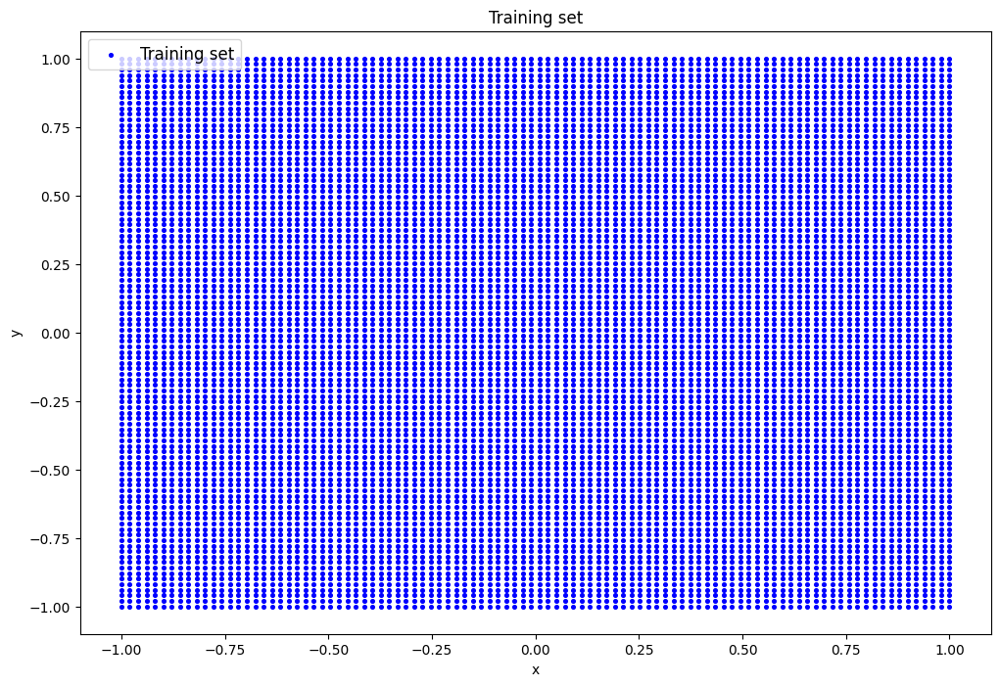

In [ ]:
def generuj_body(x_min, x_max, y_min, y_max, n_points_x, n_points_y):
    #n_points_x - число точек по x
    #n_points_y - число точек по y
    x = np.linspace(x_min, x_max, n_points_x)
    y = np.linspace(y_min, y_max, n_points_y)

    points = [[i, j] for i in x for j in y]

    return np.array(points)


# Пример использования
x_min, x_max = (-1, 1)
y_min, y_max = (-1, 1)
n_points_x = 100
n_points_y = 100

points = generuj_body(x_min, x_max, y_min, y_max, n_points_x, n_points_y)
data3_plot = points

plt.figure(figsize=(12,8))
plt.scatter(points[:,0],points[:,1],marker='o',s=7,color='b',label='Training set')
plt.legend(loc= 'upper left',fontsize=12)
plt.title('Training set')
plt.xlabel('x')
plt.ylabel('y')
plt.savefig('out/train_set.png')
plt.show()

2250/2250 [==============================] - 12s 5ms/step


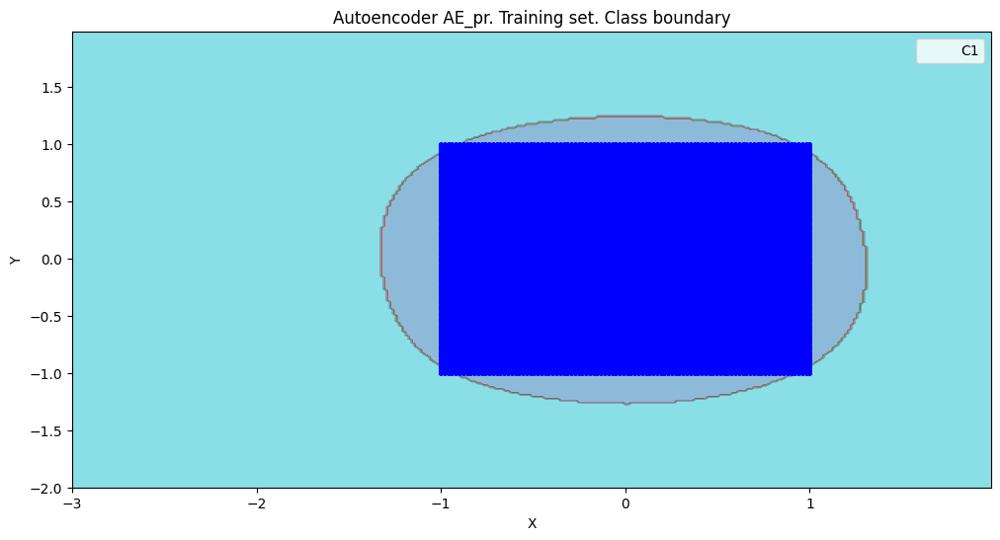

amount:  8100
amount_ae:  11056


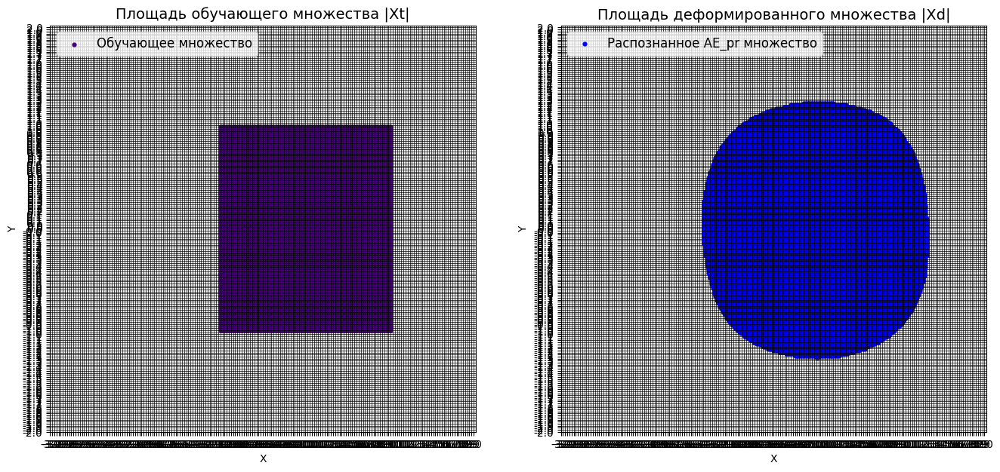

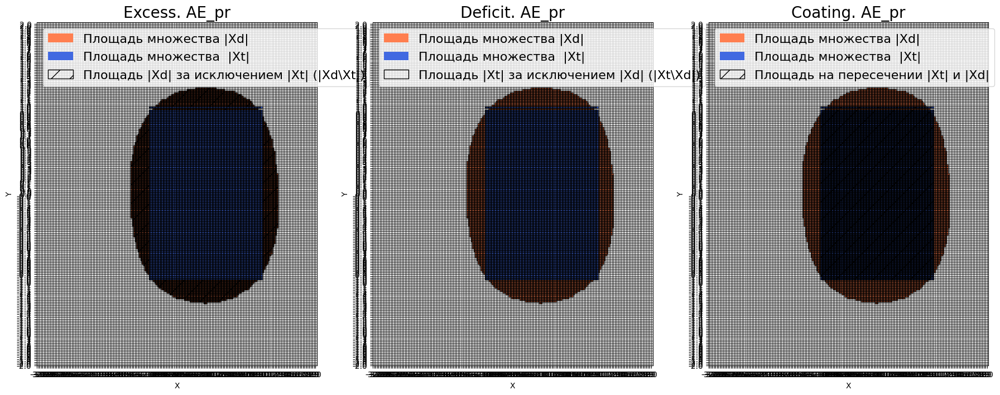


Оценка качества AE_pr
IDEAL = 0. Excess:  0.3685185185185185
IDEAL = 0. Deficit:  0.003580246913580247
IDEAL = 1. Coating:  0.9964197530864197
summa:  1.0
IDEAL = 1. Extrapolation precision (Approx):  0.7326338639652676




In [ ]:
# построение областей покрытия и границ классов
# расчет характеристик качества обучения
# параметр numb_square, отвечающий за количество элементов разбиения по каждой оси пространства признаков
numb_square = 200
xx, yy, Z3 = lib.square_calc1(numb_square, data3_plot, ae_pr_trainned, IREth_3, '_pr', True)

In [ ]:
np.mean(Excess)

0.5696444444444444

### График Excess

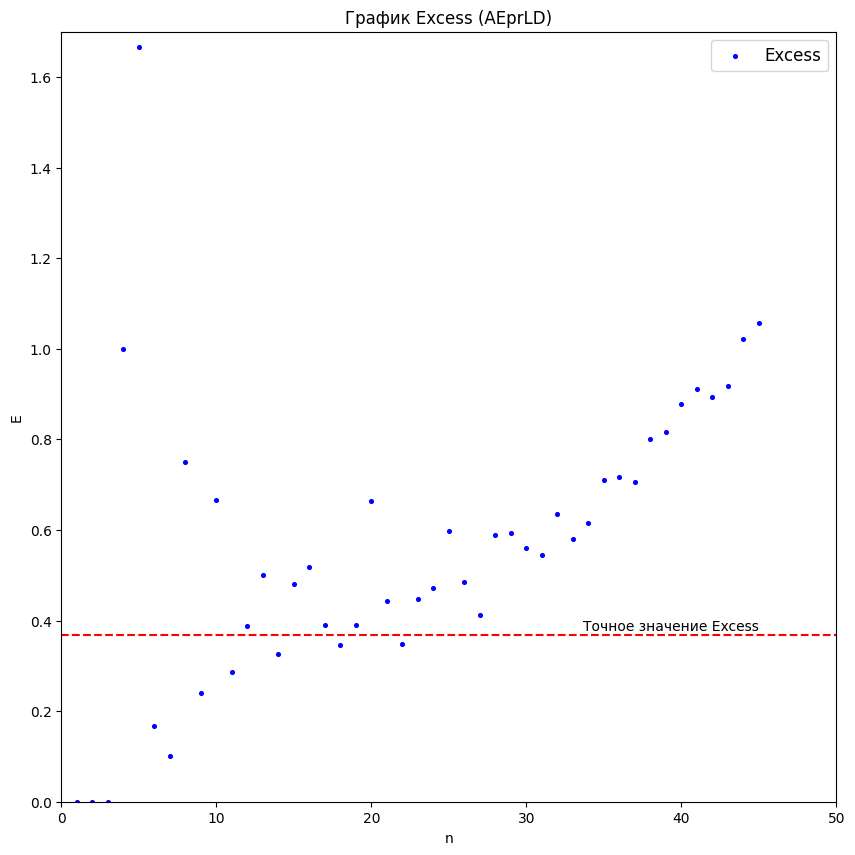

In [ ]:
Excess = [0, 0, 0, 1, 1.667, 0.167, 0.1, 0.75, 0.24, 0.667, 0.286, 0.389, 0.5, 0.327, 0.48, 0.518, 0.391, 0.346, 0.391, 0.663,
          0.443, 0.348, 0.447, 0.471, 0.597, 0.486, 0.413, 0.589, 0.593, 0.561, 0.545, 0.636, 0.58, 0.615, 0.71, 0.718, 0.706, 0.8,
          0.817, 0.877, 0.911, 0.894, 0.917, 1.022, 1.056]

n = list(range(1, 46))

plt.figure(figsize=(10,10))
plt.scatter(n,Excess,marker='o',s=7,color='b',label='Excess')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Excess (AEprLD)')
plt.hlines(0.369, 0, 50, color='red',linestyle='--')
plt.text(45, 0.387, 'Точное значение Excess', ha='right', va='center')
plt.xlabel('n')
plt.ylabel('E')
plt.xlim([0, 50])
plt.ylim([0, 1.7])
plt.show()

### Среднее

In [ ]:
nn = np.arange(5,46)

av = []
for i in nn:
  av.append(np.mean(Excess[0:i]))

print(av)

[0.5334, 0.47233333333333327, 0.4191428571428571, 0.4605, 0.43600000000000005, 0.4591, 0.44336363636363635, 0.43883333333333335, 0.44353846153846155, 0.4352142857142857, 0.43820000000000003, 0.44318749999999996, 0.4401176470588235, 0.4348888888888889, 0.432578947368421, 0.4441, 0.444047619047619, 0.4396818181818182, 0.43999999999999995, 0.4412916666666667, 0.44752000000000003, 0.44900000000000007, 0.4476666666666667, 0.4527142857142858, 0.4575517241379311, 0.4610000000000001, 0.46370967741935487, 0.46909375000000003, 0.47245454545454546, 0.4766470588235294, 0.48331428571428575, 0.48983333333333334, 0.49567567567567566, 0.5036842105263158, 0.5117179487179487, 0.52085, 0.5303658536585366, 0.5390238095238095, 0.5478139534883721, 0.558590909090909, 0.5696444444444444]


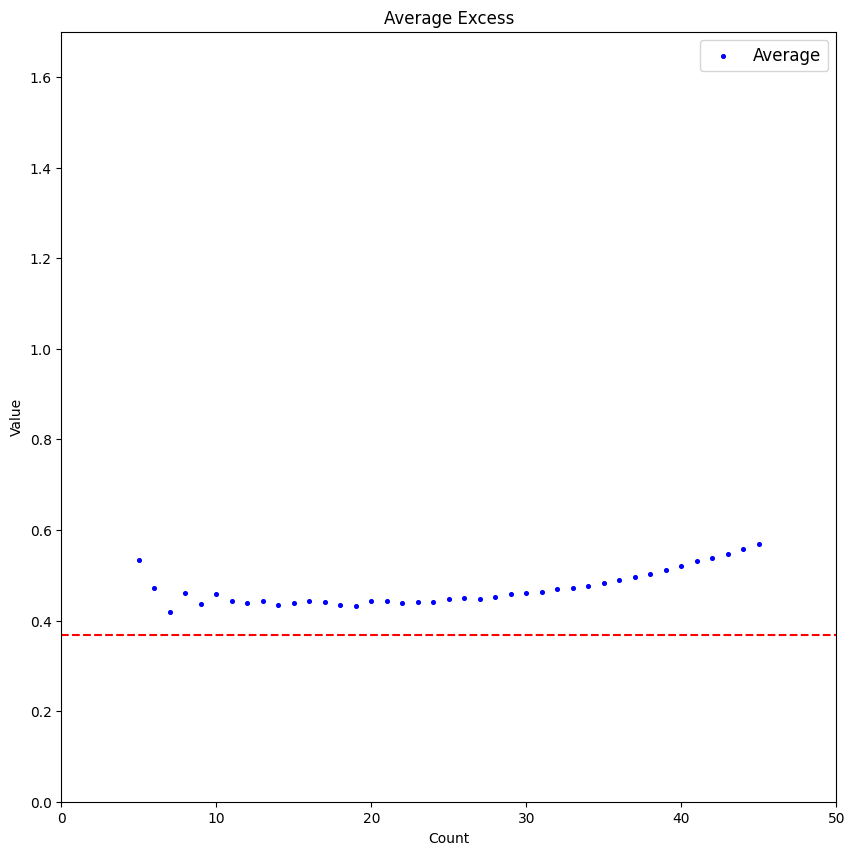

In [ ]:
plt.figure(figsize=(10,10))
plt.scatter(nn,av,marker='o',s=7,color='b',label='Average')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Average Excess')
plt.xlabel('Count')
plt.ylabel('Value')
plt.hlines(0.369, 0, 50, color='red',linestyle='--')
plt.xlim([0, 50])
plt.ylim([0, 1.7])
plt.show()

### Аппроксимация МНК

In [ ]:
x = np.array(n)
y = np.array(Excess)

linear_func = lambda x, b0, b1: b0 + b1*x
quadratic_func = lambda x, b0, b1, b2: b0 + b1*x + b2*x**2
qubic_func = lambda x, b0, b1, b2, b3: b0 + b1*x + b2*x**2 + b3*x**3
exp_func = lambda x, b0, b1, b2: b0 + b1*np.exp(b2*x)
exp1_func = lambda x, b0, b1, b2: b0 + b1*np.exp(x-b2)
exp2_func = lambda x, b0, b1: b0*np.power(b1,x)
exp3_func = lambda x, b0, b1, b2:  b0 + b1*np.power(b2,x)


from scipy.optimize import leastsq

# list of model
model_list = [
    'linear', 'quadratic',
    'qubic', 'exp3']

# model reference
models_dict = {
        'linear':             linear_func,
        'quadratic':          quadratic_func,
        'qubic':              qubic_func,
        'exp3':               exp3_func}

# initial values
p0_dict = {
        'linear':             [0, 0],
        'quadratic':          [0, 0, 0],
        'qubic':              [0, 0, 0, 0],
        'exp3':               [0, 1, 1]}

# titles (formulas)
formulas_dict = {
        'linear':             'y = b0 + b1*x',
        'quadratic':          'y = b0 + b1*x + b2*x^2',
        'qubic':              'y = b0 + b1*x + b2*x^2 + b3*x^3',
        'exp3':               'y = b0 + b1*np.power(b2,x)'}

# actual data
X_fact = x
Y_fact = y

# function for calculating residuals
residual_func = lambda p, x, y: y - func(x, *p)

# return all optional outputs
full_output = True

# variables to save the calculation results
calculation_results_df = pd.DataFrame(columns=['func', 'p0', 'popt', 'cov_x', 'SSE', 'MSE', 'pcov', 'perr', 'Y_calc', 'error_metrics'])
error_metrics_results_df = pd.DataFrame(columns=['MSE', 'RMSE', 'MAE', 'MSPE', 'MAPE', 'RMSLE', 'R2'])

# calculations
for func_name in model_list:
    print(f'{func_name.upper()} MODEL: {formulas_dict[func_name]}')
    func = models_dict[func_name]
    calculation_results_df.loc[func_name, 'func'] = func
    p0 = p0_dict[func_name]
    print(f'p0 = {p0}')
    calculation_results_df.loc[func_name, 'p0'] = p0
    if full_output:
        (popt, cov_x, infodict, mesg, ier) = leastsq(residual_func, p0, args=(X_fact, Y_fact), full_output=full_output)
        integer_flag = f'ier = {ier}, the solution was found' if ier<=4 else f'ier = {ier}, the solution was not found'
        print(integer_flag, '\n', mesg)
        calculation_results_df.loc[func_name, 'popt'] = popt
        print(f'parameters = {popt}')
        calculation_results_df.loc[func_name, 'cov_x'] = cov_x
        print(f'cov_x = \n{cov_x}')
        #SSE = (residual_func(popt, X_fact, Y_fact)**2).sum()
        SSE = (infodict['fvec']**2).sum()
        calculation_results_df.loc[func_name, 'SSE'] = SSE
        print(f'SSE = {SSE}')
        MSE = SSE / (len(Y_fact)-len(p0))
        calculation_results_df.loc[func_name, 'MSE'] = MSE
        print(f'MSE = {MSE}')
        pcov = cov_x * MSE
        calculation_results_df.loc[func_name, 'pcov'] = pcov
        print(f'pcov =\n {pcov}')
        perr = np.sqrt(np.diag(pcov))
        calculation_results_df.loc[func_name, 'perr'] = perr
        print(f'perr = {perr}\n')
    else:
        popt = leastsq(residual_func, p0, args=(X_fact, Y_fact), full_output=full_output)
        calculation_results_df.loc[func_name, 'popt'] = popt
        print(f'parameters = {popt}\n')
    Y_calc = func(X_fact, *popt)
    calculation_results_df.loc[func_name, 'Y_calc'] = Y_calc
    (error_metrics_dict, error_metrics_df) = regression_error_metrics(Yfact=Y_fact, Ycalc=Y_calc, model_name=func_name)
    calculation_results_df.loc[func_name, 'error_metrics'] = error_metrics_dict.values()
    error_metrics_results_df = pd.concat([error_metrics_results_df, error_metrics_df])

LINEAR MODEL: y = b0 + b1*x
p0 = [0, 0]
ier = 3, the solution was found 
 Both actual and predicted relative reductions in the sum of squares
  are at most 0.000000 and the relative error between two consecutive iterates is at 
  most 0.000000
parameters = [0.28697172 0.01229012]
cov_x = 
[[ 0.09191919 -0.0030303 ]
 [-0.0030303   0.00013175]]
SSE = 3.2428294700043914
MSE = 0.07541463883731142
pcov =
 [[ 6.93205258e-03 -2.28529206e-04]
 [-2.28529206e-04  9.93605244e-06]]
perr = [0.08325895 0.00315215]

QUADRATIC MODEL: y = b0 + b1*x + b2*x^2
p0 = [0, 0, 0]
ier = 3, the solution was found 
 Both actual and predicted relative reductions in the sum of squares
  are at most 0.000000 and the relative error between two consecutive iterates is at 
  most 0.000000
parameters = [ 0.45789302 -0.00952962  0.00047434]
cov_x = 
[[ 2.18886541e-01 -1.92389008e-02  3.52360820e-04]
 [-1.92389008e-02  2.20093499e-03 -4.49822322e-05]
 [ 3.52360820e-04 -4.49822322e-05  9.77874608e-07]]
SSE = 3.012738085429

<ipython-input-7-a10df777837d>:36: RuntimeWarning: divide by zero encountered in divide
  MSPE = (1/n_fit) *  np.sum(((Yfact-Ycalc)/Yfact)**2)
<ipython-input-7-a10df777837d>:37: RuntimeWarning: divide by zero encountered in divide
  MAPE = (1/n_fit) *  np.sum(abs((Yfact-Ycalc)/Yfact))
<ipython-input-7-a10df777837d>:36: RuntimeWarning: divide by zero encountered in divide
  MSPE = (1/n_fit) *  np.sum(((Yfact-Ycalc)/Yfact)**2)
<ipython-input-7-a10df777837d>:37: RuntimeWarning: divide by zero encountered in divide
  MAPE = (1/n_fit) *  np.sum(abs((Yfact-Ycalc)/Yfact))
<ipython-input-7-a10df777837d>:36: RuntimeWarning: divide by zero encountered in divide
  MSPE = (1/n_fit) *  np.sum(((Yfact-Ycalc)/Yfact)**2)
<ipython-input-7-a10df777837d>:37: RuntimeWarning: divide by zero encountered in divide
  MAPE = (1/n_fit) *  np.sum(abs((Yfact-Ycalc)/Yfact))
<ipython-input-7-a10df777837d>:36: RuntimeWarning: divide by zero encountered in divide
  MSPE = (1/n_fit) *  np.sum(((Yfact-Ycalc)/Yfact)**2)

#### 1-я степень

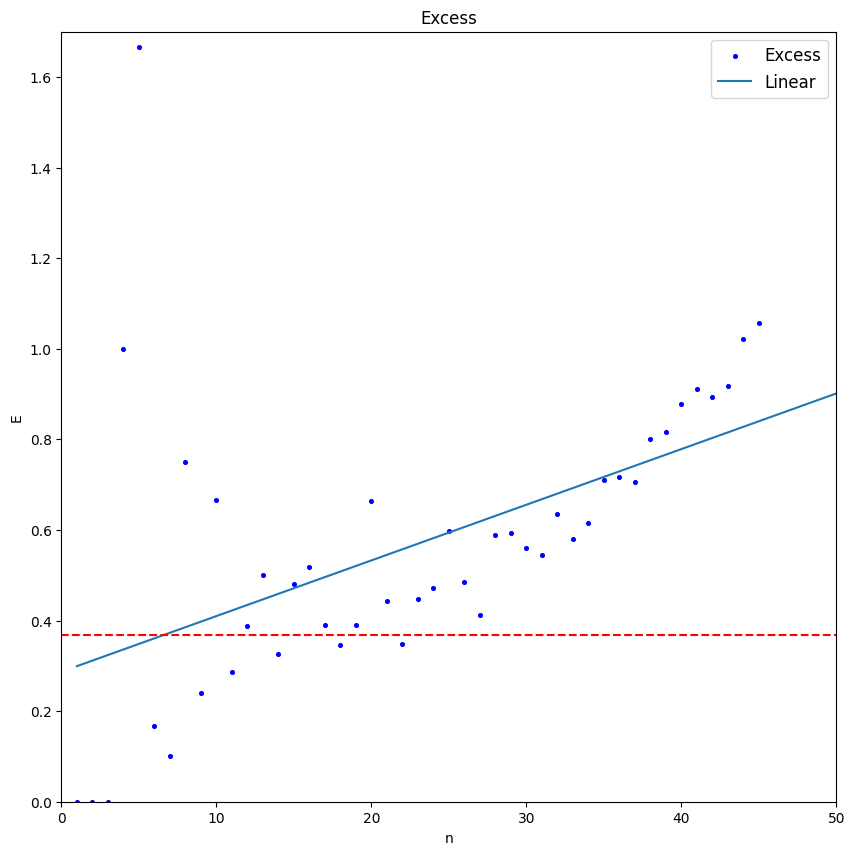

In [ ]:
b0, b1 = [0.28697172, 0.01229012]

xx = np.arange (1,51)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='b',label='Excess')
plt.plot(xx, b0 + b1*xx , label = 'Linear')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.hlines(0.369, 0, 50, color='red',linestyle='--')
plt.xlim([0, 50])
plt.ylim([0, 1.7])
plt.show()

#### 2-я степень

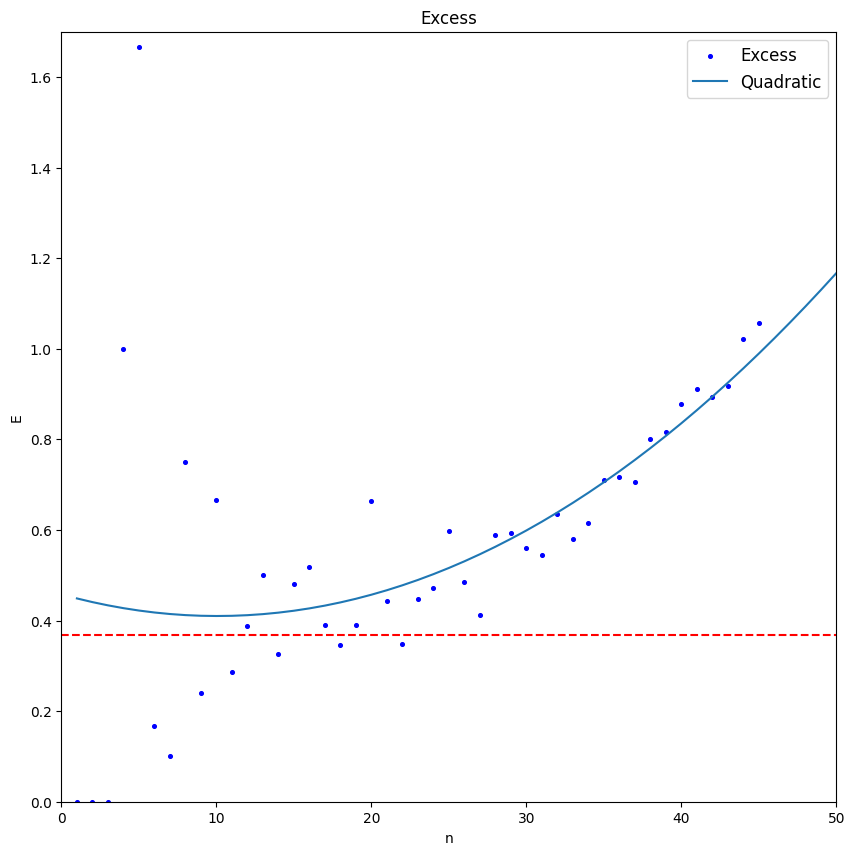

In [ ]:
b0, b1, b2 = [ 0.45789302, -0.00952962,  0.00047434]

xx = np.arange (1,51)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='b',label='Excess')
plt.plot(xx, b0 + b1*xx + b2*xx**2 , label = 'Quadratic')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.hlines(0.369, 0, 50, color='red',linestyle='--')
plt.xlim([0, 50])
plt.ylim([0, 1.7])
plt.show()

In [ ]:
# Экстремум

def f(x):
    return 0.45789302 -0.00952962*x + 0.00047434*x**2

from scipy.optimize import minimize_scalar
res = minimize_scalar(f)
print ('res.fun = ', res.fun)
print ('res.x = ', res.x)

res.fun =  0.41002985362967487
res.x =  10.045136400050573


#### 3-я степень

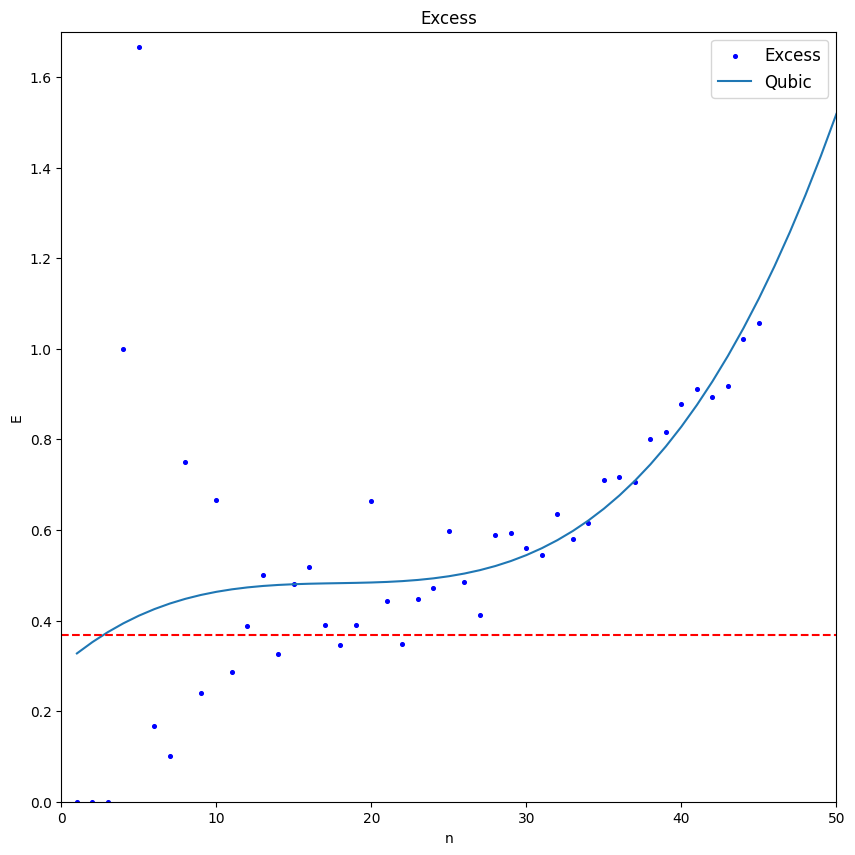

In [ ]:
b0, b1, b2, b3 =[ 2.99309232e-01,  2.97006724e-02, -1.63448481e-03,  3.05627103e-05]

xx = np.arange (1,51)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='b',label='Excess')
plt.plot(xx, b0 + b1*xx + b2*xx**2 + b3*xx**3 , label = 'Qubic')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.hlines(0.369, 0, 50, color='red',linestyle='--')
plt.xlim([0, 50])
plt.ylim([0, 1.7])
plt.show()

#### Экспонента

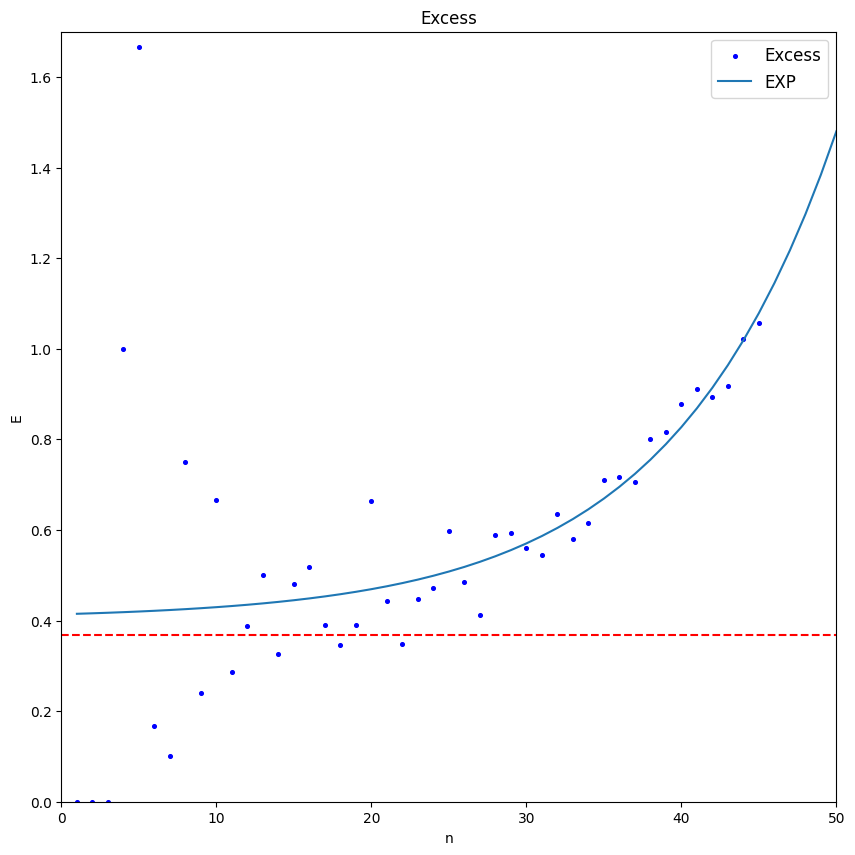

In [ ]:
b0, b1, b2 = [0.40379392, 0.01012884, 1.09781493]

xx = np.arange (1,51)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='b',label='Excess')
plt.plot(xx, b0 + b1*np.power(b2,xx) , label = 'EXP')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.hlines(0.369, 0, 50, color='red',linestyle='--')
plt.xlim([0, 50])
plt.ylim([0, 1.7])
plt.show()

### Несколько точек (Excess)

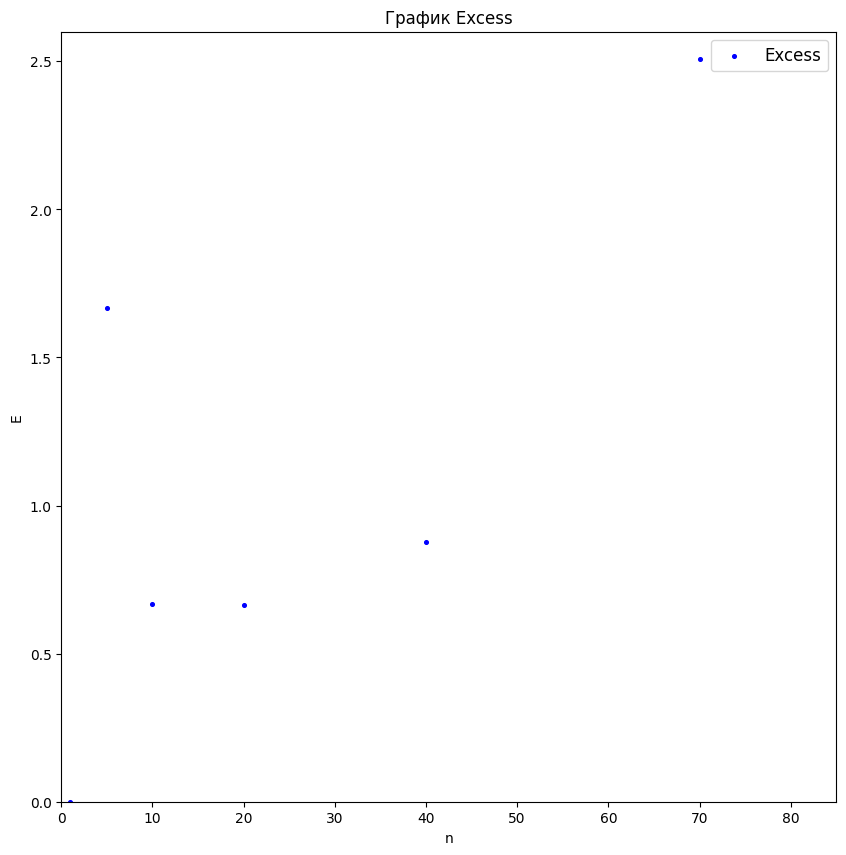

In [ ]:
Excess = [0, 1.667, 0.667, 0.663, 0.877, 2.508]
n = [1, 5, 10, 20, 40, 70]

plt.figure(figsize=(10,10))
plt.scatter(n,Excess,marker='o',s=7,color='b',label='Excess')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.xlim([0, 85])
plt.ylim([0, 2.6])
plt.show()

In [ ]:
x = np.array(n)
y = np.array(Excess)

linear_func = lambda x, b0, b1: b0 + b1*x
quadratic_func = lambda x, b0, b1, b2: b0 + b1*x + b2*x**2
qubic_func = lambda x, b0, b1, b2, b3: b0 + b1*x + b2*x**2 + b3*x**3
exp_func = lambda x, b0, b1, b2: b0 + b1*np.exp(b2*x)
exp1_func = lambda x, b0, b1, b2: b0 + b1*np.exp(x-b2)
exp2_func = lambda x, b0, b1: b0*np.power(b1,x)
exp3_func = lambda x, b0, b1, b2:  b0 + b1*np.power(b2,x)


from scipy.optimize import leastsq

# list of model
model_list = [
    'linear', 'quadratic',
    'qubic']

# model reference
models_dict = {
        'linear':             linear_func,
        'quadratic':          quadratic_func,
        'qubic':              qubic_func}

# initial values
p0_dict = {
        'linear':             [0, 0],
        'quadratic':          [0, 0, 0],
        'qubic':              [0, 0, 0, 0]}

# titles (formulas)
formulas_dict = {
        'linear':             'y = b0 + b1*x',
        'quadratic':          'y = b0 + b1*x + b2*x^2',
        'qubic':              'y = b0 + b1*x + b2*x^2 + b3*x^3'}

# actual data
X_fact = x
Y_fact = y

# function for calculating residuals
residual_func = lambda p, x, y: y - func(x, *p)

# return all optional outputs
full_output = True

# variables to save the calculation results
calculation_results_df = pd.DataFrame(columns=['func', 'p0', 'popt', 'cov_x', 'SSE', 'MSE', 'pcov', 'perr', 'Y_calc', 'error_metrics'])
error_metrics_results_df = pd.DataFrame(columns=['MSE', 'RMSE', 'MAE', 'MSPE', 'MAPE', 'RMSLE', 'R2'])

# calculations
for func_name in model_list:
    print(f'{func_name.upper()} MODEL: {formulas_dict[func_name]}')
    func = models_dict[func_name]
    calculation_results_df.loc[func_name, 'func'] = func
    p0 = p0_dict[func_name]
    print(f'p0 = {p0}')
    calculation_results_df.loc[func_name, 'p0'] = p0
    if full_output:
        (popt, cov_x, infodict, mesg, ier) = leastsq(residual_func, p0, args=(X_fact, Y_fact), full_output=full_output)
        integer_flag = f'ier = {ier}, the solution was found' if ier<=4 else f'ier = {ier}, the solution was not found'
        print(integer_flag, '\n', mesg)
        calculation_results_df.loc[func_name, 'popt'] = popt
        print(f'parameters = {popt}')
        calculation_results_df.loc[func_name, 'cov_x'] = cov_x
        print(f'cov_x = \n{cov_x}')
        #SSE = (residual_func(popt, X_fact, Y_fact)**2).sum()
        SSE = (infodict['fvec']**2).sum()
        calculation_results_df.loc[func_name, 'SSE'] = SSE
        print(f'SSE = {SSE}')
        MSE = SSE / (len(Y_fact)-len(p0))
        calculation_results_df.loc[func_name, 'MSE'] = MSE
        print(f'MSE = {MSE}')
        pcov = cov_x * MSE
        calculation_results_df.loc[func_name, 'pcov'] = pcov
        print(f'pcov =\n {pcov}')
        perr = np.sqrt(np.diag(pcov))
        calculation_results_df.loc[func_name, 'perr'] = perr
        print(f'perr = {perr}\n')
    else:
        popt = leastsq(residual_func, p0, args=(X_fact, Y_fact), full_output=full_output)
        calculation_results_df.loc[func_name, 'popt'] = popt
        print(f'parameters = {popt}\n')
    Y_calc = func(X_fact, *popt)
    calculation_results_df.loc[func_name, 'Y_calc'] = Y_calc
    (error_metrics_dict, error_metrics_df) = regression_error_metrics(Yfact=Y_fact, Ycalc=Y_calc, model_name=func_name)
    calculation_results_df.loc[func_name, 'error_metrics'] = error_metrics_dict.values()
    error_metrics_results_df = pd.concat([error_metrics_results_df, error_metrics_df])

LINEAR MODEL: y = b0 + b1*x
p0 = [0, 0]
ier = 1, the solution was found 
 Both actual and predicted relative reductions in the sum of squares
  are at most 0.000000
parameters = [0.47791755 0.02407188]
cov_x = 
[[ 3.37140112e-01 -7.00575796e-03]
 [-7.00575796e-03  2.87907861e-04]]
SSE = 1.9215773870441457
MSE = 0.48039434676103643
pcov =
 [[ 1.61960204e-01 -3.36552652e-03]
 [-3.36552652e-03  1.38309309e-04]]
perr = [0.4024428 0.0117605]

QUADRATIC MODEL: y = b0 + b1*x + b2*x^2
p0 = [0, 0, 0]
ier = 1, the solution was found 
 Both actual and predicted relative reductions in the sum of squares
  are at most 0.000000
parameters = [ 7.90390027e-01 -1.62833250e-02  5.71737160e-04]
cov_x = 
[[ 5.84215359e-01 -3.89150415e-02  4.52078540e-04]
 [-3.89150415e-02  4.40892926e-03 -5.83850574e-05]
 [ 4.52078540e-04 -5.83850574e-05  8.27177200e-07]]
SSE = 1.5263980053619661
MSE = 0.5087993351206553
pcov =
 [[ 2.97248386e-01 -1.97999473e-02  2.30017261e-04]
 [-1.97999473e-02  2.24326027e-03 -2.970627

<ipython-input-7-a10df777837d>:36: RuntimeWarning: divide by zero encountered in divide
  MSPE = (1/n_fit) *  np.sum(((Yfact-Ycalc)/Yfact)**2)
<ipython-input-7-a10df777837d>:37: RuntimeWarning: divide by zero encountered in divide
  MAPE = (1/n_fit) *  np.sum(abs((Yfact-Ycalc)/Yfact))
<ipython-input-7-a10df777837d>:36: RuntimeWarning: divide by zero encountered in divide
  MSPE = (1/n_fit) *  np.sum(((Yfact-Ycalc)/Yfact)**2)
<ipython-input-7-a10df777837d>:37: RuntimeWarning: divide by zero encountered in divide
  MAPE = (1/n_fit) *  np.sum(abs((Yfact-Ycalc)/Yfact))
<ipython-input-7-a10df777837d>:36: RuntimeWarning: divide by zero encountered in divide
  MSPE = (1/n_fit) *  np.sum(((Yfact-Ycalc)/Yfact)**2)
<ipython-input-7-a10df777837d>:37: RuntimeWarning: divide by zero encountered in divide
  MAPE = (1/n_fit) *  np.sum(abs((Yfact-Ycalc)/Yfact))


3 степень

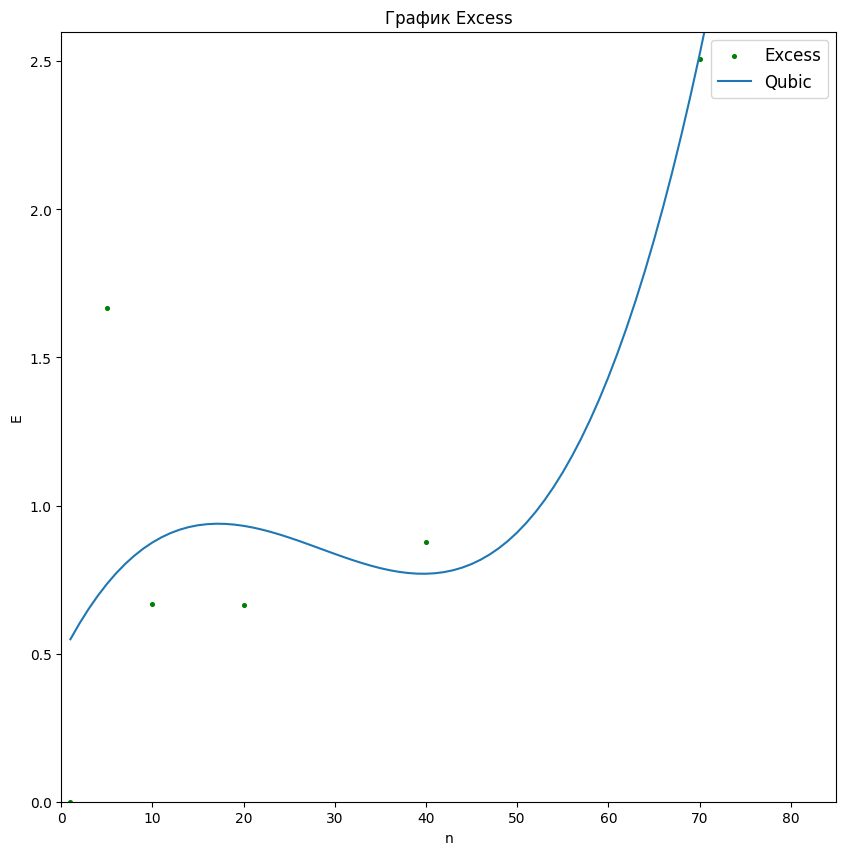

In [ ]:
b0, b1, b2, b3 =[ 4.90097819e-01,  6.09622431e-02, -2.53979187e-03,  2.97638294e-05]

xx = np.arange (1,81)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='g',label='Excess')
plt.plot(xx, b0 + b1*xx + b2*xx**2 + b3*xx**3 , label = 'Qubic')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.xlim([0, 85])
plt.ylim([0, 2.6])
plt.show()

In [ ]:
from sympy import *

x = Symbol('x', real=True)
f = b0 + b1*x + b2*x**2 + b3*x**3
fprime = f.diff(x)

solve(fprime, x)

[17.2046806776628, 39.6829784083015]

In [ ]:
import sympy as sp

def f(x):
  z = b0 + b1*x + b2*x**2 + b3*x**3
  return z

# Объявляем символьную переменную x
x = sp.Symbol ("x")
# Вывод функции
print("f(x) =", f(x))
# Находим производную функции f(x) и сохраняем ее в переменной d_f:
d_f = sp.diff(f(x), x)
print("Первая производная функции:",d_f)

# Решаем уравнение d_f = 0:
x_extr = sp.solve (d_f)
print ("точка экстремума:", x_extr)

# Сохраняем точки экстремума в переменные:
x_0 = x_extr[0]
x_1 = x_extr[1]

# Находим вторую производную функции:
d2_f = sp.diff(f(x), x, 2)
print("Вторая производная функции:", d2_f)

# Решаем уравнение d2_f = 0
x_extr2 = sp.solve (d2_f)
print ("точка перегиба:", x_extr2)

# Находим значение второй производной в точках экстремума x_0 и x_1,
# Сохраняем их в переменные f_0_d2 и f_1_d2:
f_0_d2 = d2_f.evalf(subs = {x : x_0})
f_1_d2 = d2_f.evalf(subs = {x : x_1})

# Определяем, является ли точка x_0 точкой лок.минимума, максимума или перегиба
if f_0_d2 > 0:
  print(x_0, "- локальный минимум")
elif f_0_d2 < 0:
  print(x_0, "- локальный максимум")
else:
  print(x_0, "- точка перегиба")

# Определяем, является ли точка x_1 точкой лок.минимума, максимума или перегиба
if f_1_d2 > 0:
  print(x_1, "- локальный минимум")
elif f_1_d2 < 0:
  print(x_1, "- локальный максимум")
else:
  print(x_1, "- точка перегиба")

f(x) = 2.97638294e-5*x**3 - 0.00253979187*x**2 + 0.0609622431*x + 0.490097819
Первая производная функции: 8.92914882e-5*x**2 - 0.00507958374*x + 0.0609622431
точка экстремума: [17.2046806776628, 39.6829784083015]
Вторая производная функции: 0.0001785829764*x - 0.00507958374
точка перегиба: [28.4438295429821]
17.2046806776628 - локальный максимум
39.6829784083015 - локальный минимум


2 степень

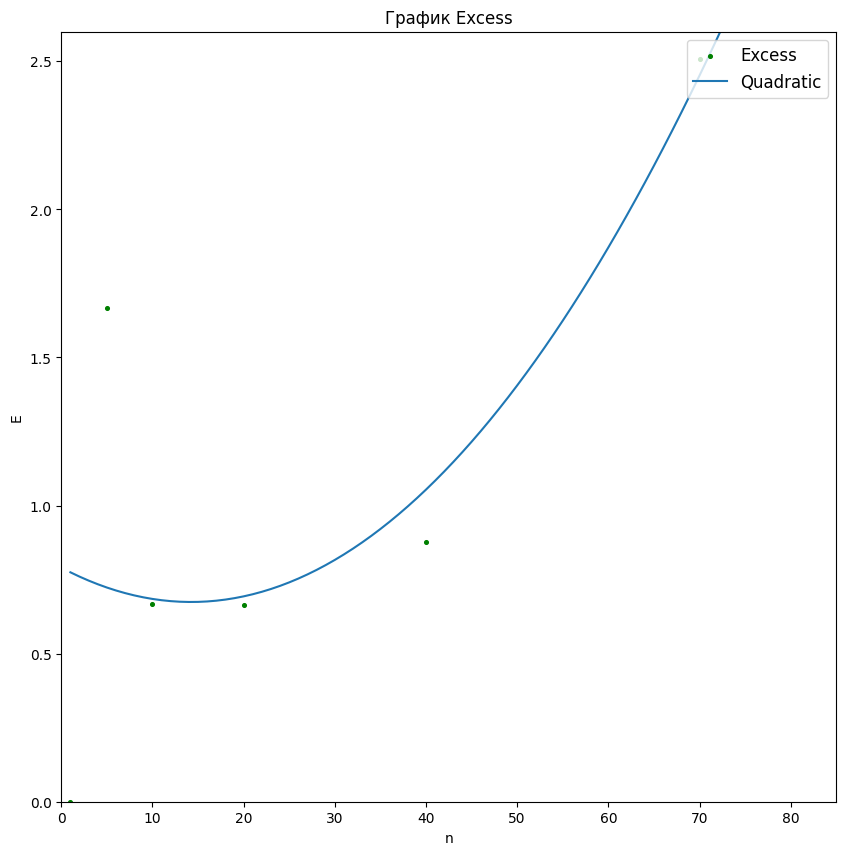

In [ ]:
b0, b1, b2 = [ 7.90390027e-01, -1.62833250e-02,  5.71737160e-04]

xx = np.arange (1,81)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='g',label='Excess')
plt.plot(xx, b0 + b1*xx + b2*xx**2 , label = 'Quadratic')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.xlim([0, 85])
plt.ylim([0, 2.6])
plt.show()

In [ ]:
from sympy import *

x = Symbol('x', real=True)
f = b0 + b1*x + b2*x**2
fprime = f.diff(x)

solve(fprime, x)

[14.2402192294095]

### График Approx

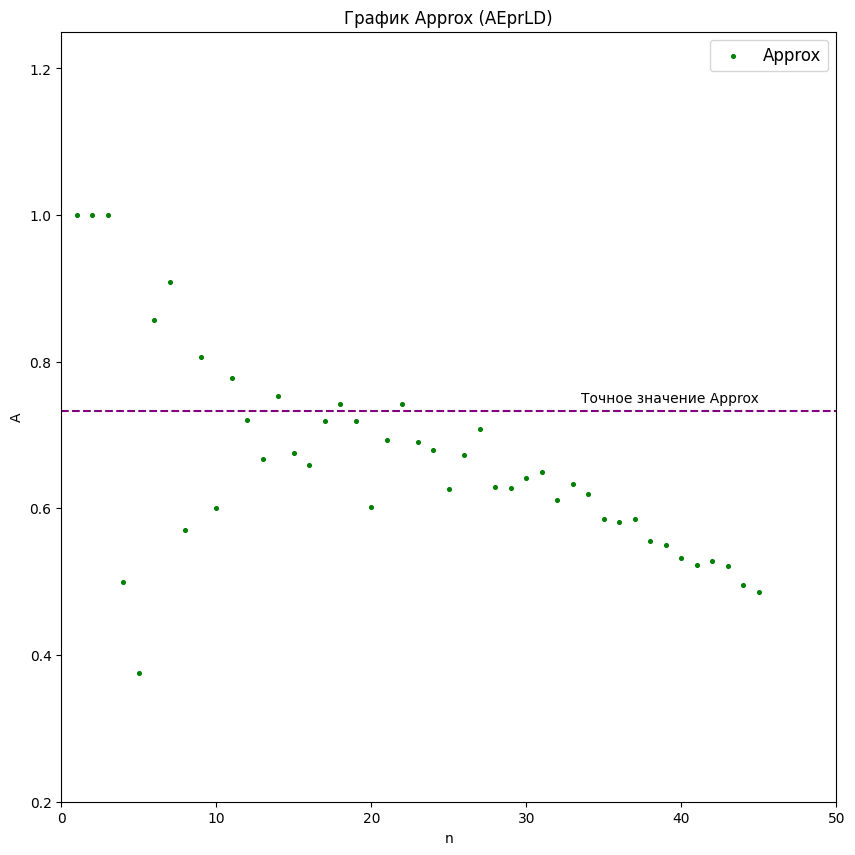

In [ ]:
Approx = [1, 1, 1, 0.5, 0.375, 0.857, 0.909, 0.571, 0.806, 0.6, 0.778, 0.72, 0.667, 0.753, 0.676, 0.659, 0.719, 0.743, 0.719, 0.602,
          0.693, 0.742, 0.691, 0.68, 0.626, 0.673, 0.708, 0.629, 0.628, 0.641, 0.649, 0.611, 0.633, 0.619, 0.585, 0.582, 0.586, 0.556, 0.55, 0.533,
          0.523, 0.528, 0.522, 0.496, 0.486]

n = list(range(1, 46))

plt.figure(figsize=(10,10))
plt.scatter(n,Approx,marker='o',s=7,color='g',label='Approx')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Approx (AEprLD)')
plt.hlines(0.733, 0, 50, color='purple',linestyle='--')
plt.text(45, 0.75, 'Точное значение Approx', ha='right', va='center')
plt.xlabel('n')
plt.ylabel('A')
plt.xlim([0, 50])
plt.ylim([0.2, 1.25])
plt.show()

### Среднее Approx

[1.0, 1.0, 1.0, 0.875, 0.775, 0.7886666666666667, 0.8058571428571428, 0.7765, 0.7797777777777778, 0.7617999999999999, 0.7632727272727272, 0.7596666666666666, 0.7525384615384615, 0.7525714285714286, 0.7474666666666666, 0.7419375, 0.7405882352941177, 0.7407222222222223, 0.739578947368421, 0.7327, 0.7308095238095238, 0.7313181818181818, 0.7295652173913042, 0.7275, 0.7234400000000001, 0.7215, 0.721, 0.7177142857142857, 0.7146206896551724, 0.7121666666666667, 0.7101290322580646, 0.70703125, 0.7047878787878787, 0.7022647058823529, 0.6989142857142857, 0.6956666666666667, 0.6927027027027026, 0.6891052631578948, 0.6855384615384615, 0.6817249999999999, 0.6778536585365853, 0.6742857142857142, 0.6707441860465115, 0.6667727272727272, 0.6627555555555554]


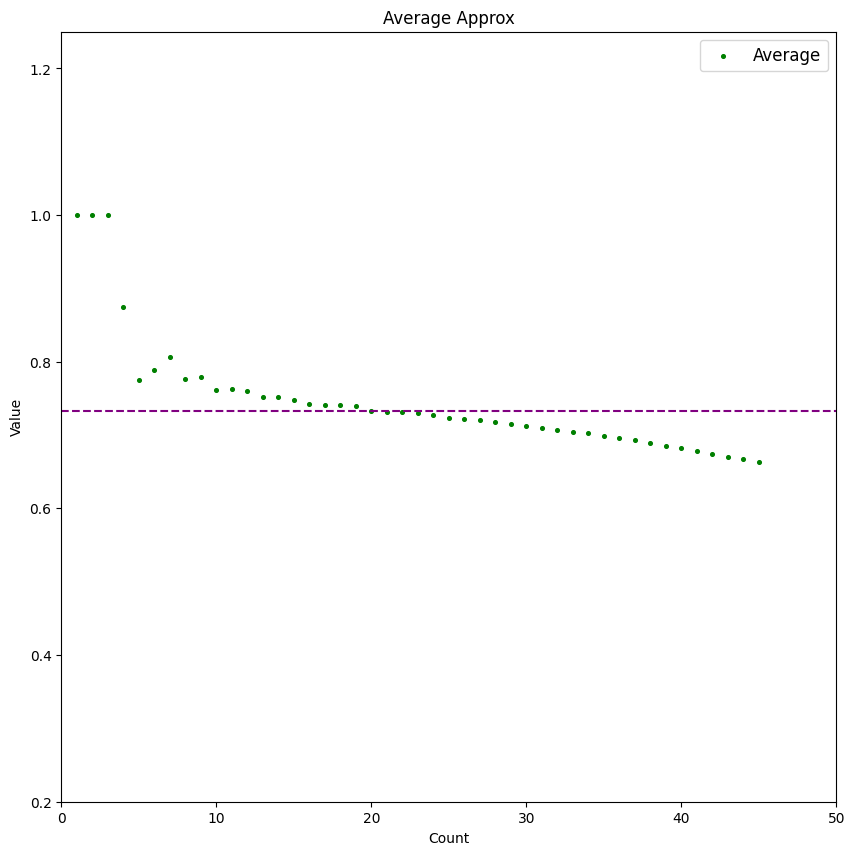

In [ ]:
nn = np.arange(1,46)

av = []
for i in nn:
  av.append(np.mean(Approx[0:i]))

print(av)

plt.figure(figsize=(10,10))
plt.scatter(nn,av,marker='o',s=7,color='g',label='Average')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Average Approx')
plt.xlabel('Count')
plt.ylabel('Value')
plt.hlines(0.733, 0, 50, color='purple',linestyle='--')
plt.xlim([0, 50])
plt.ylim([0.2, 1.25])
plt.show()

### Аппроксимация МНК (Approx)

In [ ]:
x = np.array(n)
y = np.array(Approx)

linear_func = lambda x, b0, b1: b0 + b1*x
quadratic_func = lambda x, b0, b1, b2: b0 + b1*x + b2*x**2
qubic_func = lambda x, b0, b1, b2, b3: b0 + b1*x + b2*x**2 + b3*x**3
exp_func = lambda x, b0, b1, b2: b0 + b1*np.exp(b2*x)
exp1_func = lambda x, b0, b1, b2: b0 + b1*np.exp(x-b2)
exp2_func = lambda x, b0, b1: b0*np.power(b1,x)
exp3_func = lambda x, b0, b1, b2:  b0 + b1*np.power(b2,x)


from scipy.optimize import leastsq

# list of model
model_list = [
    'linear', 'quadratic',
    'qubic', 'EXP']

# model reference
models_dict = {
        'linear':             linear_func,
        'quadratic':          quadratic_func,
        'qubic':              qubic_func,
        'EXP':                exp3_func}

# initial values
p0_dict = {
        'linear':             [0, 0],
        'quadratic':          [0, 0, 0],
        'qubic':              [0, 0, 0, 0],
        'EXP':                [1, 1, 1]}

# titles (formulas)
formulas_dict = {
        'linear':             'y = b0 + b1*x',
        'quadratic':          'y = b0 + b1*x + b2*x^2',
        'qubic':              'y = b0 + b1*x + b2*x^2 + b3*x^3',
        'EXP':                'y = b0 +b1*b2^x'}

# actual data
X_fact = x
Y_fact = y

# function for calculating residuals
residual_func = lambda p, x, y: y - func(x, *p)

# return all optional outputs
full_output = True

# variables to save the calculation results
calculation_results_df = pd.DataFrame(columns=['func', 'p0', 'popt', 'cov_x', 'SSE', 'MSE', 'pcov', 'perr', 'Y_calc', 'error_metrics'])
error_metrics_results_df = pd.DataFrame(columns=['MSE', 'RMSE', 'MAE', 'MSPE', 'MAPE', 'RMSLE', 'R2'])

# calculations
for func_name in model_list:
    print(f'{func_name.upper()} MODEL: {formulas_dict[func_name]}')
    func = models_dict[func_name]
    calculation_results_df.loc[func_name, 'func'] = func
    p0 = p0_dict[func_name]
    print(f'p0 = {p0}')
    calculation_results_df.loc[func_name, 'p0'] = p0
    if full_output:
        (popt, cov_x, infodict, mesg, ier) = leastsq(residual_func, p0, args=(X_fact, Y_fact), full_output=full_output)
        integer_flag = f'ier = {ier}, the solution was found' if ier<=4 else f'ier = {ier}, the solution was not found'
        print(integer_flag, '\n', mesg)
        calculation_results_df.loc[func_name, 'popt'] = popt
        print(f'parameters = {popt}')
        calculation_results_df.loc[func_name, 'cov_x'] = cov_x
        print(f'cov_x = \n{cov_x}')
        #SSE = (residual_func(popt, X_fact, Y_fact)**2).sum()
        SSE = (infodict['fvec']**2).sum()
        calculation_results_df.loc[func_name, 'SSE'] = SSE
        print(f'SSE = {SSE}')
        MSE = SSE / (len(Y_fact)-len(p0))
        calculation_results_df.loc[func_name, 'MSE'] = MSE
        print(f'MSE = {MSE}')
        pcov = cov_x * MSE
        calculation_results_df.loc[func_name, 'pcov'] = pcov
        print(f'pcov =\n {pcov}')
        perr = np.sqrt(np.diag(pcov))
        calculation_results_df.loc[func_name, 'perr'] = perr
        print(f'perr = {perr}\n')
    else:
        popt = leastsq(residual_func, p0, args=(X_fact, Y_fact), full_output=full_output)
        calculation_results_df.loc[func_name, 'popt'] = popt
        print(f'parameters = {popt}\n')
    Y_calc = func(X_fact, *popt)
    calculation_results_df.loc[func_name, 'Y_calc'] = Y_calc
    (error_metrics_dict, error_metrics_df) = regression_error_metrics(Yfact=Y_fact, Ycalc=Y_calc, model_name=func_name)
    calculation_results_df.loc[func_name, 'error_metrics'] = error_metrics_dict.values()
    error_metrics_results_df = pd.concat([error_metrics_results_df, error_metrics_df])

LINEAR MODEL: y = b0 + b1*x
p0 = [0, 0]
ier = 3, the solution was found 
 Both actual and predicted relative reductions in the sum of squares
  are at most 0.000000 and the relative error between two consecutive iterates is at 
  most 0.000000
parameters = [ 0.81298889 -0.00653188]
cov_x = 
[[ 0.09191919 -0.0030303 ]
 [-0.0030303   0.00013175]]
SSE = 0.4955130951690821
MSE = 0.01152356035276935
pcov =
 [[ 1.05923634e-03 -3.49198793e-05]
 [-3.49198793e-05  1.51825562e-06]]
perr = [0.03254591 0.00123218]

QUADRATIC MODEL: y = b0 + b1*x + b2*x^2
p0 = [0, 0, 0]
ier = 1, the solution was found 
 Both actual and predicted relative reductions in the sum of squares
  are at most 0.000000
parameters = [ 8.10154616e-01 -6.17006198e-03 -7.86569740e-06]
cov_x = 
[[ 2.18886650e-01 -1.92389154e-02  3.52361145e-04]
 [-1.92389154e-02  2.20093695e-03 -4.49822758e-05]
 [ 3.52361145e-04 -4.49822758e-05  9.77875582e-07]]
SSE = 0.49544982612111693
MSE = 0.011796424431455165
pcov =
 [[ 2.58207983e-03 -2.269

TypeError: unsupported operand type(s) for *: 'NoneType' and 'float'

#### 1 степень

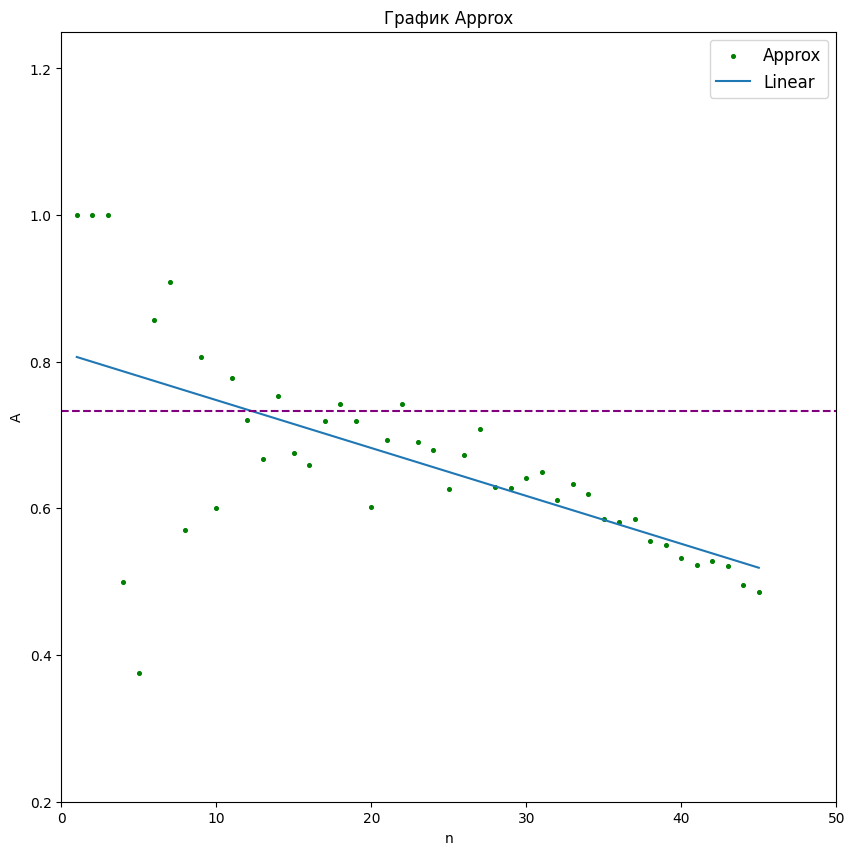

In [ ]:
b0, b1 = [ 0.81298889, -0.00653188]

xx = np.arange (1,46)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='g',label='Approx')
plt.plot(xx, b0 + b1*xx , label = 'Linear')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Approx')
plt.xlabel('n')
plt.ylabel('A')
plt.hlines(0.733, 0, 50, color='purple',linestyle='--')
plt.xlim([0, 50])
plt.ylim([0.2, 1.25])
plt.show()

#### 2 степень

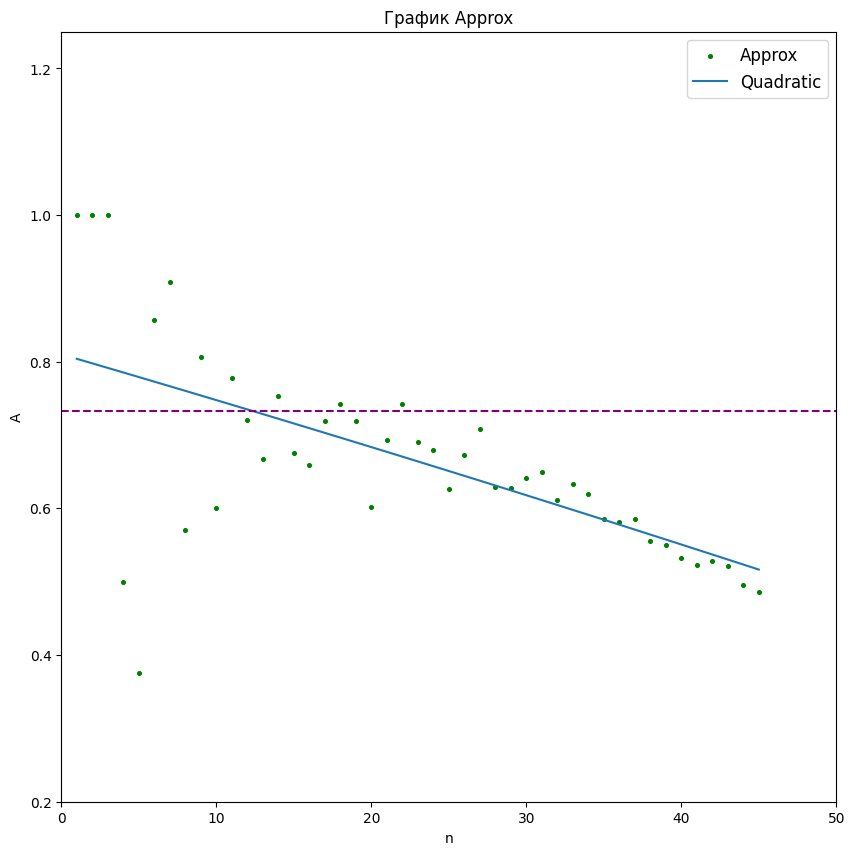

In [ ]:
b0, b1, b2 = [ 8.10154616e-01, -6.17006198e-03, -7.86569740e-06]

xx = np.arange (1,46)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='g',label='Approx')
plt.plot(xx, b0 + b1*xx + b2*xx**2 , label = 'Quadratic')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Approx')
plt.xlabel('n')
plt.ylabel('A')
plt.hlines(0.733, 0, 50, color='purple',linestyle='--')
plt.xlim([0, 50])
plt.ylim([0.2, 1.25])
plt.show()

#### 3 степень

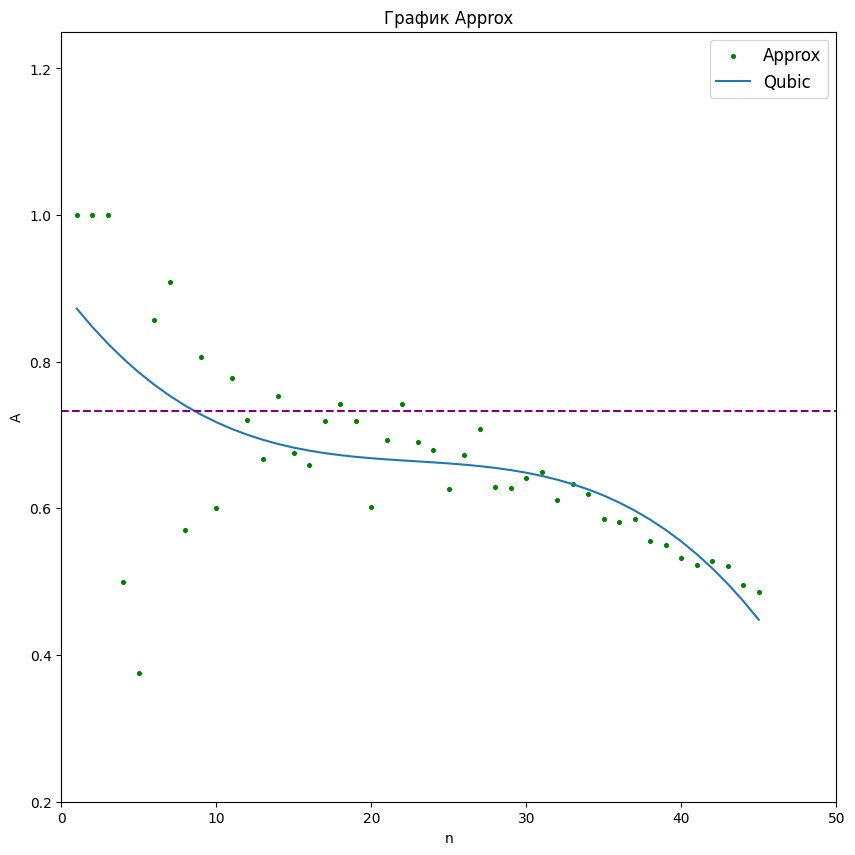

In [ ]:
b0, b1, b2, b3 =[ 8.99522524e-01, -2.82778031e-02,  1.18053734e-03, -1.72232324e-05]

xx = np.arange (1,46)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='g',label='Approx')
plt.plot(xx, b0 + b1*xx + b2*xx**2 + b3*xx**3 , label = 'Qubic')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Approx')
plt.xlabel('n')
plt.ylabel('A')
plt.hlines(0.733, 0, 50, color='purple',linestyle='--')
plt.xlim([0, 50])
plt.ylim([0.2, 1.25])
plt.show()

#### EXP

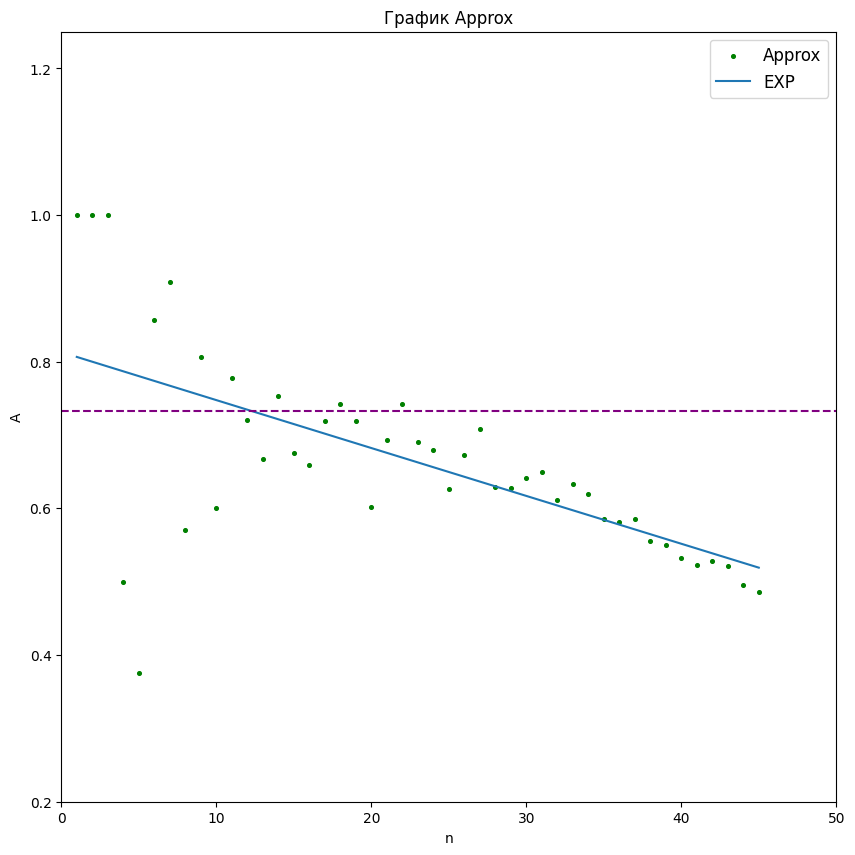

In [ ]:
b0, b1, b2 = [-71.11166916,  71.92476287,   0.99990901]

xx = np.arange (1,46)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='g',label='Approx')
plt.plot(xx, b0 + b1*np.power(b2,xx) , label = 'EXP')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Approx')
plt.xlabel('n')
plt.ylabel('A')
plt.hlines(0.733, 0, 50, color='purple',linestyle='--')
plt.xlim([0, 50])
plt.ylim([0.2, 1.25])
plt.show()

### Несколько точек (Approx)

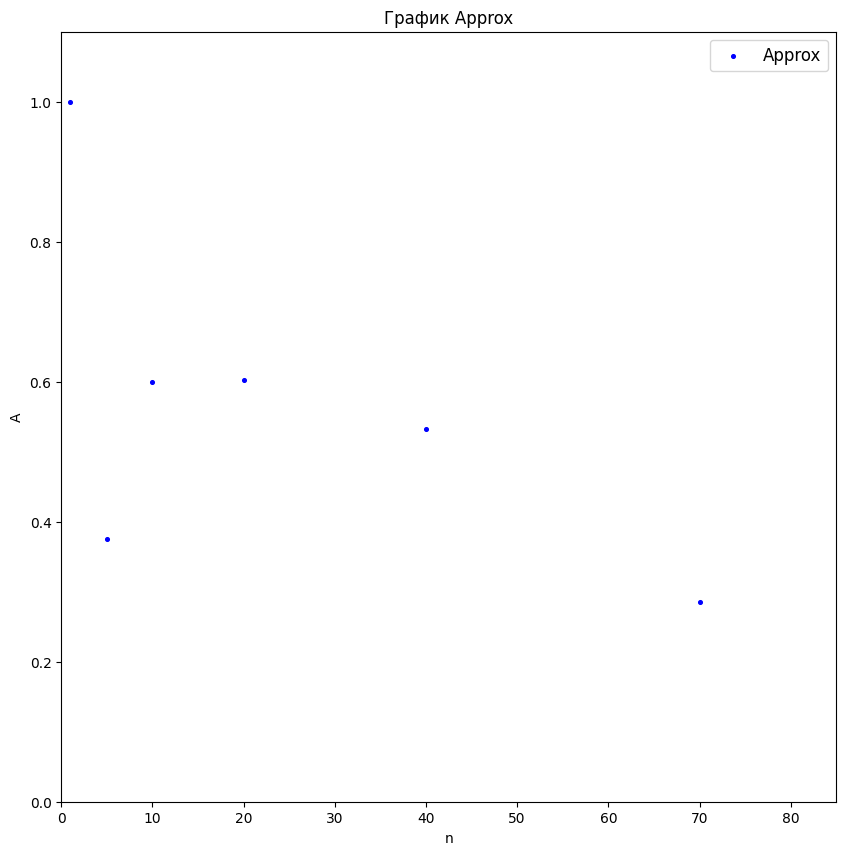

In [ ]:
Approx = [1, 0.375, 0.6, 0.602, 0.533, 0.285]
n = [1, 5, 10, 20, 40, 70]

plt.figure(figsize=(10,10))
plt.scatter(n,Approx,marker='o',s=7,color='b',label='Approx')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Approx')
plt.xlabel('n')
plt.ylabel('A')
plt.xlim([0, 85])
plt.ylim([0, 1.1])
plt.show()

In [ ]:
x = np.array(n)
y = np.array(Approx)

linear_func = lambda x, b0, b1: b0 + b1*x
quadratic_func = lambda x, b0, b1, b2: b0 + b1*x + b2*x**2
qubic_func = lambda x, b0, b1, b2, b3: b0 + b1*x + b2*x**2 + b3*x**3
exp_func = lambda x, b0, b1, b2: b0 + b1*np.exp(b2*x)
exp1_func = lambda x, b0, b1, b2: b0 + b1*np.exp(x-b2)
exp2_func = lambda x, b0, b1: b0*np.power(b1,x)
exp3_func = lambda x, b0, b1, b2:  b0 + b1*np.power(b2,x)


from scipy.optimize import leastsq

# list of model
model_list = [
    'linear', 'quadratic',
    'qubic']

# model reference
models_dict = {
        'linear':             linear_func,
        'quadratic':          quadratic_func,
        'qubic':              qubic_func}

# initial values
p0_dict = {
        'linear':             [0, 0],
        'quadratic':          [0, 0, 0],
        'qubic':              [0, 0, 0, 0]}

# titles (formulas)
formulas_dict = {
        'linear':             'y = b0 + b1*x',
        'quadratic':          'y = b0 + b1*x + b2*x^2',
        'qubic':              'y = b0 + b1*x + b2*x^2 + b3*x^3'}

# actual data
X_fact = x
Y_fact = y

# function for calculating residuals
residual_func = lambda p, x, y: y - func(x, *p)

# return all optional outputs
full_output = True

# variables to save the calculation results
calculation_results_df = pd.DataFrame(columns=['func', 'p0', 'popt', 'cov_x', 'SSE', 'MSE', 'pcov', 'perr', 'Y_calc', 'error_metrics'])
error_metrics_results_df = pd.DataFrame(columns=['MSE', 'RMSE', 'MAE', 'MSPE', 'MAPE', 'RMSLE', 'R2'])

# calculations
for func_name in model_list:
    print(f'{func_name.upper()} MODEL: {formulas_dict[func_name]}')
    func = models_dict[func_name]
    calculation_results_df.loc[func_name, 'func'] = func
    p0 = p0_dict[func_name]
    print(f'p0 = {p0}')
    calculation_results_df.loc[func_name, 'p0'] = p0
    if full_output:
        (popt, cov_x, infodict, mesg, ier) = leastsq(residual_func, p0, args=(X_fact, Y_fact), full_output=full_output)
        integer_flag = f'ier = {ier}, the solution was found' if ier<=4 else f'ier = {ier}, the solution was not found'
        print(integer_flag, '\n', mesg)
        calculation_results_df.loc[func_name, 'popt'] = popt
        print(f'parameters = {popt}')
        calculation_results_df.loc[func_name, 'cov_x'] = cov_x
        print(f'cov_x = \n{cov_x}')
        #SSE = (residual_func(popt, X_fact, Y_fact)**2).sum()
        SSE = (infodict['fvec']**2).sum()
        calculation_results_df.loc[func_name, 'SSE'] = SSE
        print(f'SSE = {SSE}')
        MSE = SSE / (len(Y_fact)-len(p0))
        calculation_results_df.loc[func_name, 'MSE'] = MSE
        print(f'MSE = {MSE}')
        pcov = cov_x * MSE
        calculation_results_df.loc[func_name, 'pcov'] = pcov
        print(f'pcov =\n {pcov}')
        perr = np.sqrt(np.diag(pcov))
        calculation_results_df.loc[func_name, 'perr'] = perr
        print(f'perr = {perr}\n')
    else:
        popt = leastsq(residual_func, p0, args=(X_fact, Y_fact), full_output=full_output)
        calculation_results_df.loc[func_name, 'popt'] = popt
        print(f'parameters = {popt}\n')
    Y_calc = func(X_fact, *popt)
    calculation_results_df.loc[func_name, 'Y_calc'] = Y_calc
    (error_metrics_dict, error_metrics_df) = regression_error_metrics(Yfact=Y_fact, Ycalc=Y_calc, model_name=func_name)
    calculation_results_df.loc[func_name, 'error_metrics'] = error_metrics_dict.values()
    error_metrics_results_df = pd.concat([error_metrics_results_df, error_metrics_df])

LINEAR MODEL: y = b0 + b1*x
p0 = [0, 0]
ier = 2, the solution was found 
 The relative error between two consecutive iterates is at most 0.000000
parameters = [ 0.70893762 -0.005881  ]
cov_x = 
[[ 3.37140111e-01 -7.00575810e-03]
 [-7.00575810e-03  2.87907869e-04]]
SSE = 0.1872096458733205
MSE = 0.04680241146833013
pcov =
 [[ 1.57789702e-02 -3.27886373e-04]
 [-3.27886373e-04  1.34747826e-05]]
perr = [0.12561437 0.0036708 ]

QUADRATIC MODEL: y = b0 + b1*x + b2*x^2
p0 = [0, 0, 0]
ier = 3, the solution was found 
 Both actual and predicted relative reductions in the sum of squares
  are at most 0.000000 and the relative error between two consecutive iterates is at 
  most 0.000000
parameters = [ 7.21015118e-01 -7.44078325e-03  2.20984414e-05]
cov_x = 
[[ 5.84215372e-01 -3.89150452e-02  4.52078615e-04]
 [-3.89150452e-02  4.40892997e-03 -5.83850700e-05]
 [ 4.52078615e-04 -5.83850700e-05  8.27177412e-07]]
SSE = 0.18661927512265009
MSE = 0.06220642504088336
pcov =
 [[ 3.63419497e-02 -2.4207658

3 степень

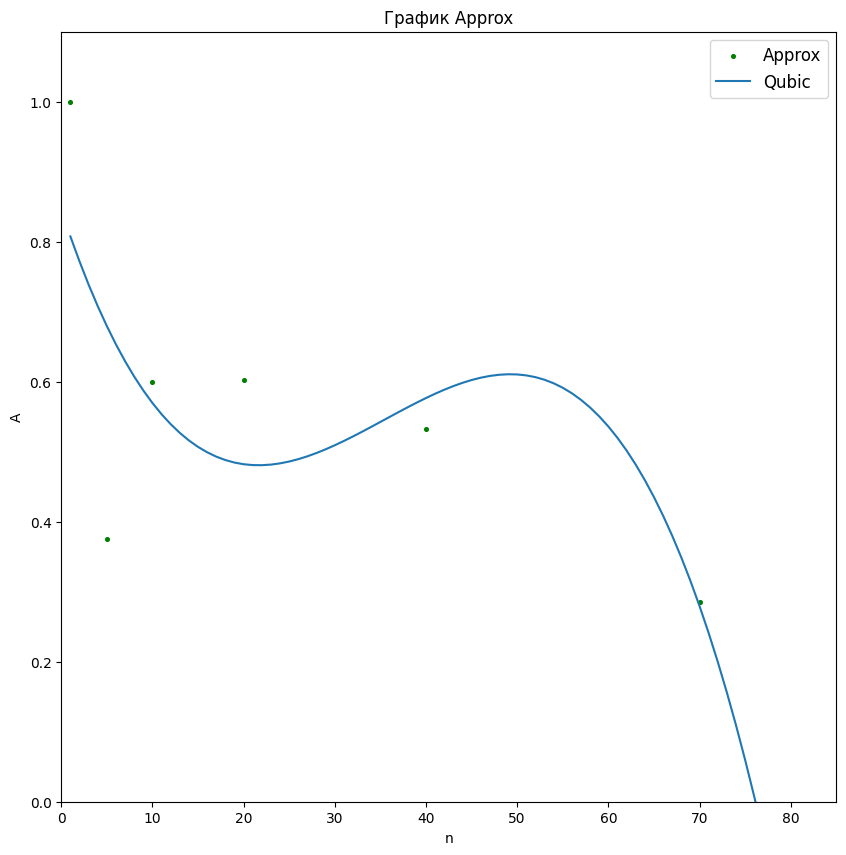

In [ ]:
b0, b1, b2, b3 =[ 8.45746325e-01, -3.95259744e-02,  1.31452215e-03, -1.23628860e-05]

xx = np.arange (1,81)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='g',label='Approx')
plt.plot(xx, b0 + b1*xx + b2*xx**2 + b3*xx**3 , label = 'Qubic')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Approx')
plt.xlabel('n')
plt.ylabel('A')
plt.xlim([0, 85])
plt.ylim([0, 1.1])
plt.show()

In [ ]:
from sympy import *

x = Symbol('x', real=True)
f = b0 + b1*x + b2*x**2 + b3*x**3
fprime = f.diff(x)

solve(fprime, x)

[21.6416493362286, 49.2437491055268]

In [ ]:
import sympy as sp

def f(x):
  z = b0 + b1*x + b2*x**2 + b3*x**3
  return z

# Объявляем символьную переменную x
x = sp.Symbol ("x")
# Вывод функции
print("f(x) =", f(x))
# Находим производную функции f(x) и сохраняем ее в переменной d_f:
d_f = sp.diff(f(x), x)
print("Первая производная функции:",d_f)

# Решаем уравнение d_f = 0:
x_extr = sp.solve (d_f)
print ("точка экстремума:", x_extr)

# Сохраняем точки экстремума в переменные:
x_0 = x_extr[0]
x_1 = x_extr[1]

# Находим вторую производную функции:
d2_f = sp.diff(f(x), x, 2)
print("Вторая производная функции:", d2_f)

# Решаем уравнение d2_f = 0
x_extr2 = sp.solve (d2_f)
print ("точка перегиба:", x_extr2)

# Находим значение второй производной в точках экстремума x_0 и x_1,
# Сохраняем их в переменные f_0_d2 и f_1_d2:
f_0_d2 = d2_f.evalf(subs = {x : x_0})
f_1_d2 = d2_f.evalf(subs = {x : x_1})

# Определяем, является ли точка x_0 точкой лок.минимума, максимума или перегиба
if f_0_d2 > 0:
  print(x_0, "- локальный минимум")
elif f_0_d2 < 0:
  print(x_0, "- локальный максимум")
else:
  print(x_0, "- точка перегиба")

# Определяем, является ли точка x_1 точкой лок.минимума, максимума или перегиба
if f_1_d2 > 0:
  print(x_1, "- локальный минимум")
elif f_1_d2 < 0:
  print(x_1, "- локальный максимум")
else:
  print(x_1, "- точка перегиба")

f(x) = -1.2362886e-5*x**3 + 0.00131452215*x**2 - 0.0395259744*x + 0.845746325
Первая производная функции: -3.7088658e-5*x**2 + 0.0026290443*x - 0.0395259744
точка экстремума: [21.6416493362286, 49.2437491055268]
Вторая производная функции: 0.0026290443 - 7.4177316e-5*x
точка перегиба: [35.4426992208777]
21.6416493362286 - локальный минимум
49.2437491055268 - локальный максимум


2 степень

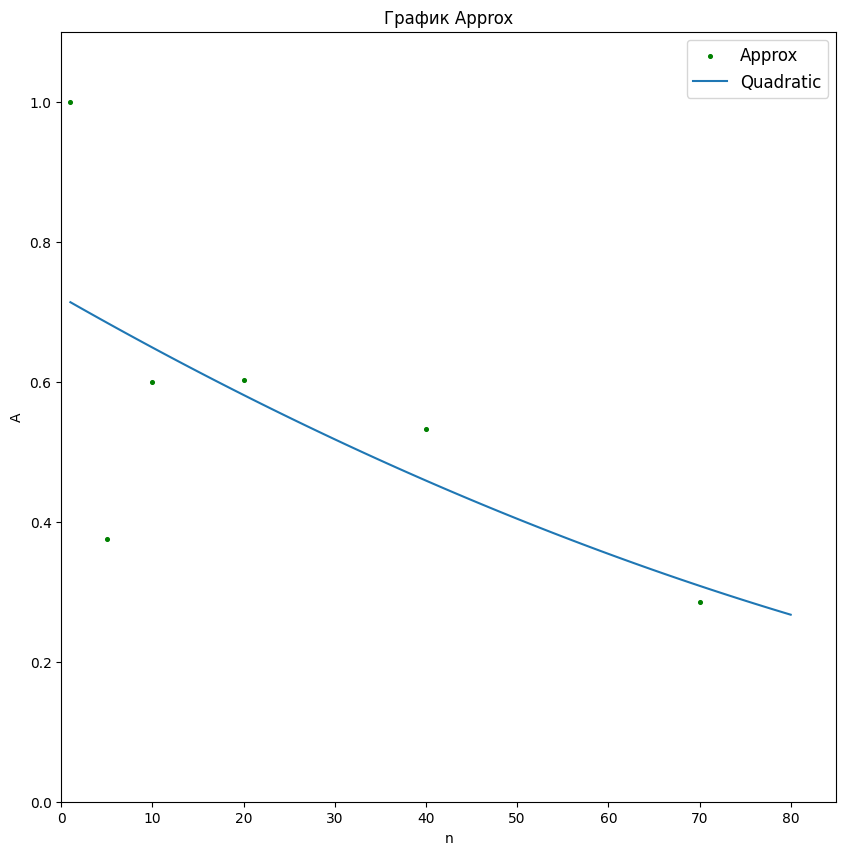

In [ ]:
b0, b1, b2 =  [ 7.21015118e-01, -7.44078325e-03,  2.20984414e-05]

xx = np.arange (1,81)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='g',label='Approx')
plt.plot(xx, b0 + b1*xx + b2*xx**2 , label = 'Quadratic')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Approx')
plt.xlabel('n')
plt.ylabel('A')
plt.xlim([0, 85])
plt.ylim([0, 1.1])
plt.show()

### Сведенные графики Excess и Approx

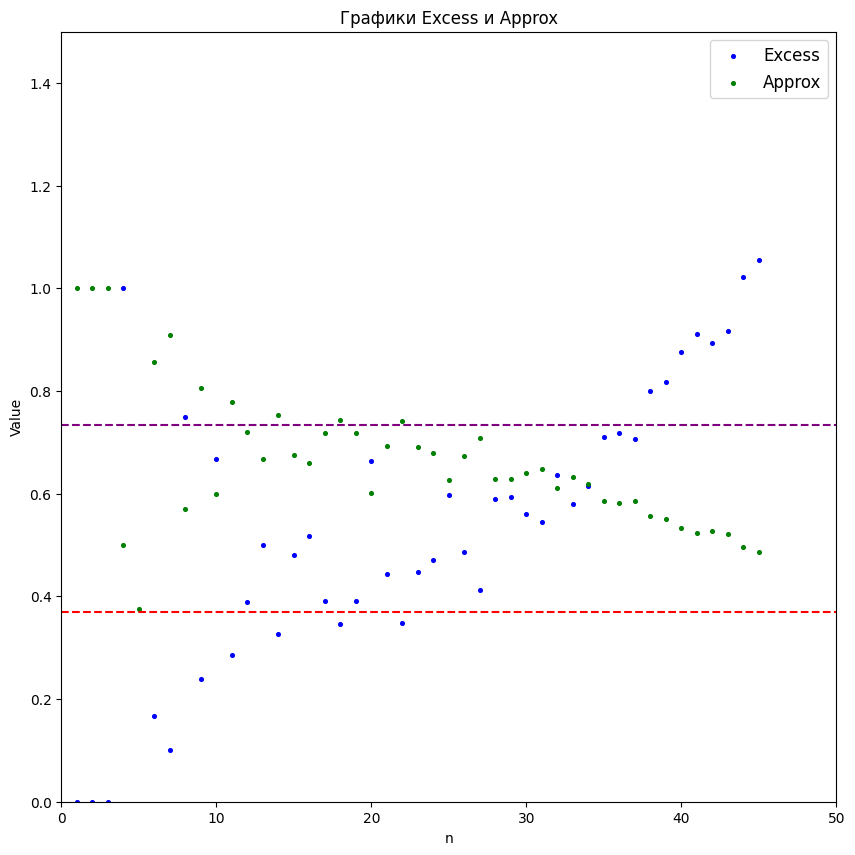

In [ ]:
Approx = [1, 1, 1, 0.5, 0.375, 0.857, 0.909, 0.571, 0.806, 0.6, 0.778, 0.72, 0.667, 0.753, 0.676, 0.659, 0.719, 0.743, 0.719, 0.602,
          0.693, 0.742, 0.691, 0.68, 0.626, 0.673, 0.708, 0.629, 0.628, 0.641, 0.649, 0.611, 0.633, 0.619, 0.585, 0.582, 0.586, 0.556, 0.55, 0.533,
          0.523, 0.528, 0.522, 0.496, 0.486]

Excess = [0, 0, 0, 1, 1.667, 0.167, 0.1, 0.75, 0.24, 0.667, 0.286, 0.389, 0.5, 0.327, 0.48, 0.518, 0.391, 0.346, 0.391, 0.663,
          0.443, 0.348, 0.447, 0.471, 0.597, 0.486, 0.413, 0.589, 0.593, 0.561, 0.545, 0.636, 0.58, 0.615, 0.71, 0.718, 0.706, 0.8,
          0.817, 0.877, 0.911, 0.894, 0.917, 1.022, 1.056]


n = list(range(1, 46))


plt.figure(figsize=(10,10))
plt.scatter(n,Excess,marker='o',s=7,color='b',label='Excess')
plt.scatter(n,Approx,marker='o',s=7,color='g',label='Approx')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Графики Excess и Approx')
plt.hlines(0.369, 0, 50, color='r',linestyle='--')
plt.hlines(0.733, 0, 50, color='purple',linestyle='--')
plt.xlabel('n')
plt.ylabel('Value')
plt.xlim([0, 50])
plt.ylim([0, 1.5])
plt.show()

# Все на одном графике

## Эллипс

### График Excess

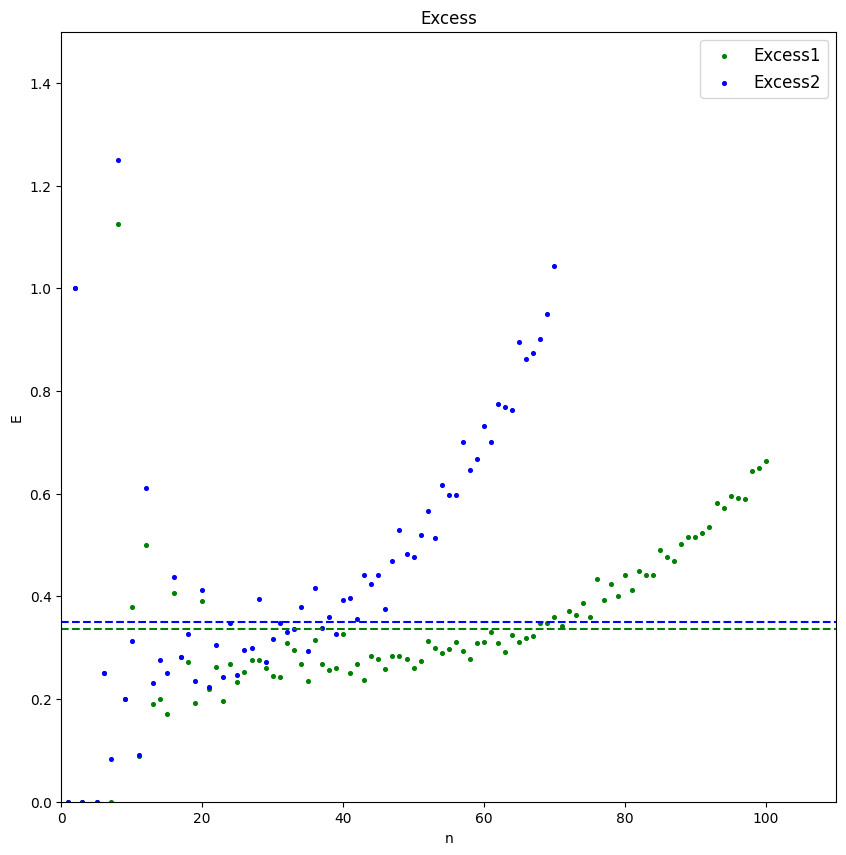

In [ ]:
Excess1 = [0, 1, 0, 2.5, 0, 0.25, 0, 1.125, 0.2, 0.38, 0.09, 0.5, 0.19, 0.2, 0.171, 0.406, 0.282, 0.273, 0.192,
          0.391, 0.22, 0.263, 0.197, 0.269, 0.234, 0.253, 0.277, 0.277, 0.26, 0.245, 0.243, 0.309, 0.296, 0.268,
          0.236, 0.315, 0.269, 0.257, 0.26, 0.326, 0.25, 0.269, 0.237, 0.284, 0.279, 0.259, 0.283, 0.283, 0.278,
          0.261, 0.274, 0.313, 0.299, 0.289, 0.297, 0.311, 0.294, 0.278, 0.309, 0.311, 0.331, 0.309, 0.292, 0.324,
          0.312, 0.319, 0.322, 0.349, 0.348, 0.359, 0.343, 0.372, 0.364, 0.387, 0.36, 0.433, 0.392, 0.425, 0.401,
          0.441, 0.412, 0.449, 0.441, 0.441, 0.491, 0.477, 0.468, 0.503, 0.515, 0.515, 0.523, 0.535, 0.581, 0.572,
          0.595, 0.591, 0.589, 0.645, 0.65, 0.664]

Excess2 = [0, 1, 0, 3, 0, 0.25, 0.083, 1.25, 0.2, 0.313, 0.091, 0.611, 0.231, 0.276, 0.25, 0.438, 0.282, 0.326, 0.235, 0.413,
          0.224, 0.305, 0.243, 0.348, 0.247, 0.296, 0.299, 0.395, 0.273, 0.317, 0.349, 0.33, 0.336, 0.379, 0.294, 0.416, 0.338, 0.359, 0.327, 0.393,
          0.396, 0.355, 0.441, 0.424, 0.441, 0.376, 0.469, 0.529, 0.482, 0.476, 0.519, 0.567, 0.514, 0.617, 0.597, 0.597, 0.701, 0.646, 0.668, 0.732,
          0.701, 0.775, 0.768, 0.763, 0.896, 0.862, 0.874, 0.901, 0.951, 1.044]

n1 = list(range(1, 101))
n2 = list(range(1, 71))

plt.figure(figsize=(10,10))
plt.scatter(n1,Excess1,marker='o',s=7,color='g',label='Excess1')
plt.scatter(n2,Excess2,marker='o',s=7,color='b',label='Excess2')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Excess')
plt.hlines(0.337, 0, 110, color='g',linestyle='--')
plt.hlines(0.350, 0, 110, color='b',linestyle='--')
plt.xlabel('n')
plt.ylabel('E')
plt.xlim([0, 110])
plt.ylim([0, 1.5])
plt.show()

### Среднее

In [ ]:
nn1 = np.arange(5,101)
av1 = []
for i in nn1:
  av1.append(np.mean(Excess1[0:i]))

nn2 = np.arange(5,71)
av2 = []
for i in nn2:
  av2.append(np.mean(Excess2[0:i]))

print(av1)
print(av2)

[0.7, 0.625, 0.5357142857142857, 0.609375, 0.5638888888888889, 0.5455, 0.504090909090909, 0.50375, 0.47961538461538467, 0.4596428571428572, 0.44040000000000007, 0.43825000000000003, 0.42905882352941177, 0.4203888888888889, 0.4083684210526316, 0.40750000000000003, 0.39857142857142863, 0.39240909090909093, 0.3839130434782609, 0.379125, 0.37332, 0.3686923076923077, 0.3652962962962963, 0.3621428571428571, 0.35862068965517235, 0.3548333333333333, 0.35122580645161283, 0.34990625000000003, 0.3482727272727273, 0.34591176470588236, 0.3427714285714286, 0.342, 0.3400270270270271, 0.33784210526315794, 0.33584615384615385, 0.3356, 0.33351219512195124, 0.33197619047619054, 0.32976744186046514, 0.32872727272727276, 0.32762222222222226, 0.3261304347826087, 0.32521276595744686, 0.32433333333333336, 0.3233877551020409, 0.32214000000000004, 0.3211960784313726, 0.3210384615384616, 0.320622641509434, 0.3200370370370371, 0.3196181818181819, 0.3194642857142857, 0.31901754385964914, 0.3183103448275862, 0.3181

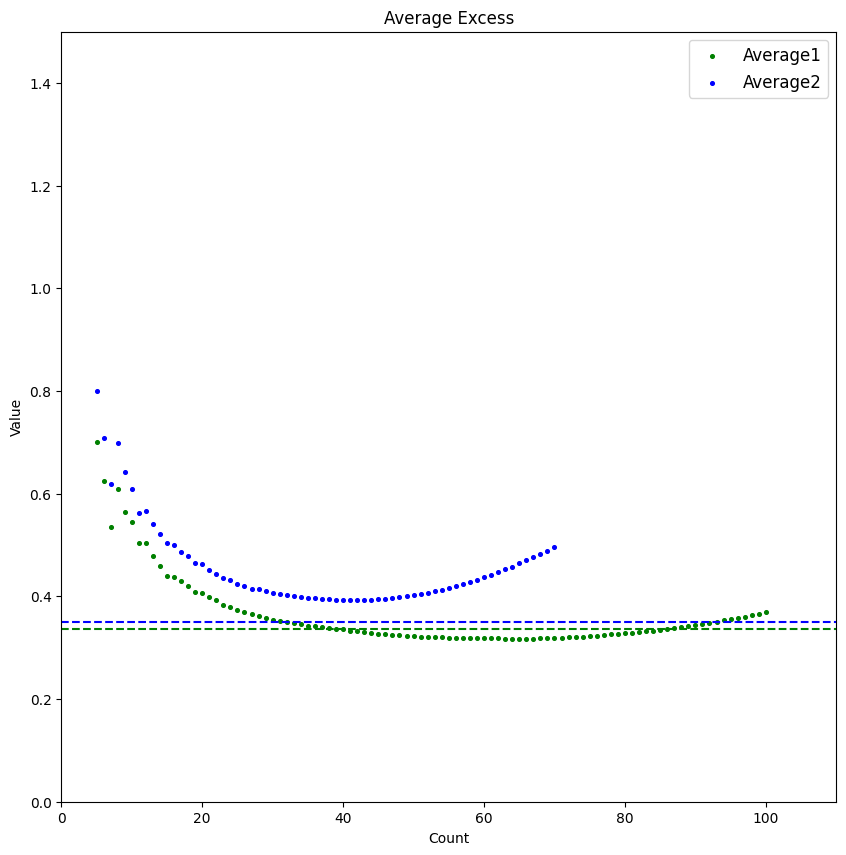

In [ ]:
plt.figure(figsize=(10,10))
plt.scatter(nn1,av1,marker='o',s=7,color='g',label='Average1')
plt.scatter(nn2,av2,marker='o',s=7,color='b',label='Average2')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Average Excess')
plt.xlabel('Count')
plt.ylabel('Value')
plt.hlines(0.337, 0, 110, color='g',linestyle='--')
plt.hlines(0.350, 0, 110, color='b',linestyle='--')
plt.xlim([0, 110])
plt.ylim([0, 1.5])
plt.show()

### МНК 1-я степень

In [ ]:
x1 = np.array(n1)
y1 = np.array(Excess1)

x2 = np.array(n2)
y2 = np.array(Excess2)

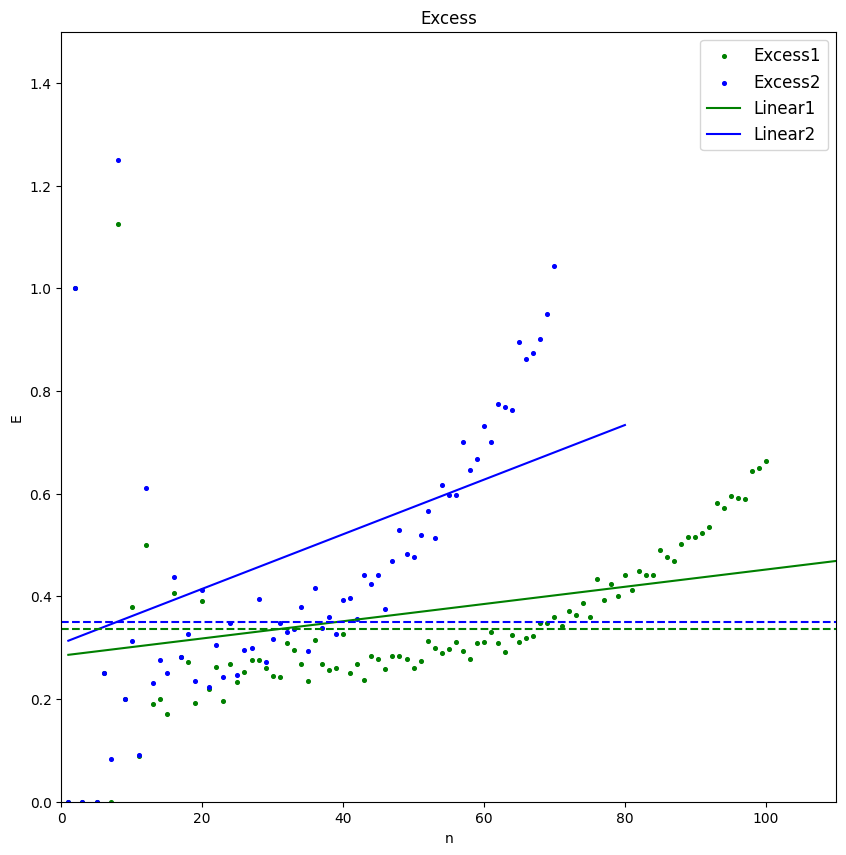

In [ ]:
b0, b1 = [0.28448788, 0.00167786]
be0, be1 = [0.3083118,  0.00531878]

xx1 = np.arange (1,111)
xx2 = np.arange (1,81)
plt.figure(figsize=(10,10))
plt.scatter(x1,y1,marker='o',s=7,color='g',label='Excess1')
plt.scatter(x2,y2,marker='o',s=7,color='b',label='Excess2')
plt.plot(xx1, b0 + b1*xx1 , color = 'g', label = 'Linear1')
plt.plot(xx2, be0 + be1*xx2 , color = 'b', label = 'Linear2')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.hlines(0.337, 0, 110, color='g',linestyle='--')
plt.hlines(0.350, 0, 110, color='b',linestyle='--')
plt.xlim([0, 110])
plt.ylim([0, 1.5])
plt.show()

### МНК 2-я степень

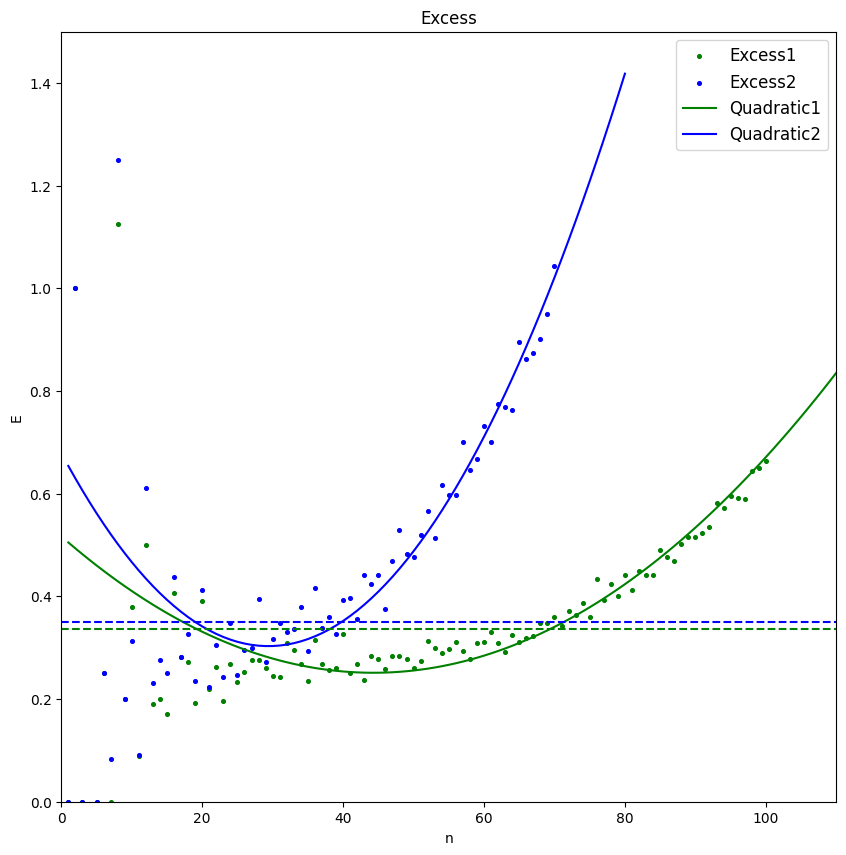

In [ ]:
b0, b1, b2 = [ 5.16946753e-01, -1.19961877e-02,  1.35386648e-04]
be0, be1, be2 = [ 6.79273258e-01, -2.55946722e-02,  4.35400766e-04]

xx1 = np.arange (1,111)
xx2 = np.arange (1,81)
plt.figure(figsize=(10,10))
plt.scatter(x1,y1,marker='o',s=7,color='g',label='Excess1')
plt.scatter(x2,y2,marker='o',s=7,color='b',label='Excess2')
plt.plot(xx1, b0 + b1*xx1 + b2*xx1**2 , color = 'g', label = 'Quadratic1')
plt.plot(xx2, be0 + be1*xx2 + be2*xx2**2 , color = 'b', label = 'Quadratic2')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.hlines(0.337, 0, 110, color='g',linestyle='--')
plt.hlines(0.350, 0, 110, color='b',linestyle='--')
plt.xlim([0, 110])
plt.ylim([0, 1.5])
plt.show()

### МНК 3-я степень

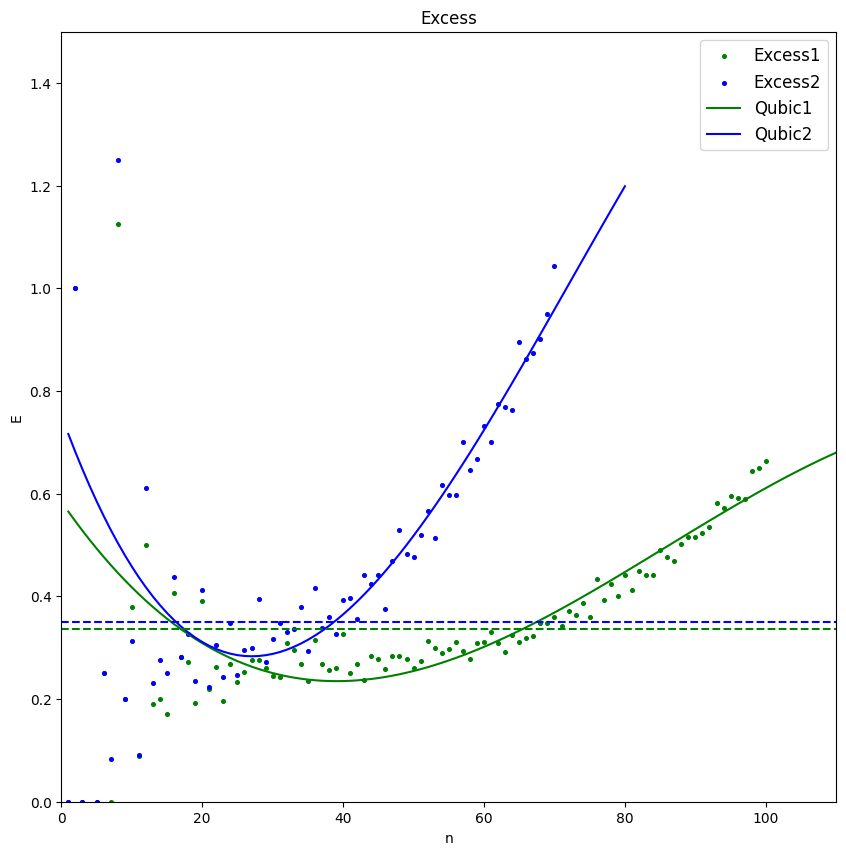

In [ ]:
b0, b1, b2, b3 = [ 5.84816550e-01, -1.98648437e-02,  3.29189609e-04, -1.27922747e-06]
be0, be1, be2, be3 = [ 7.53121730e-01, -3.76506373e-02,  8.56910328e-04, -3.95783625e-06]

xx1 = np.arange (1,111)
xx2 = np.arange (1,81)
plt.figure(figsize=(10,10))
plt.scatter(x1,y1,marker='o',s=7,color='g',label='Excess1')
plt.scatter(x2,y2,marker='o',s=7,color='b',label='Excess2')
plt.plot(xx1, b0 + b1*xx1 + b2*xx1**2 + b3*xx1**3 , color = 'g', label = 'Qubic1')
plt.plot(xx2, be0 + be1*xx2 + be2*xx2**2 + be3*xx2**3 ,color = 'b', label = 'Qubic2')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.hlines(0.350, 0, 110, color='b',linestyle='--')
plt.hlines(0.337, 0, 110, color='g',linestyle='--')
plt.xlim([0, 110])
plt.ylim([0, 1.5])
plt.show()

### МНК экспонента

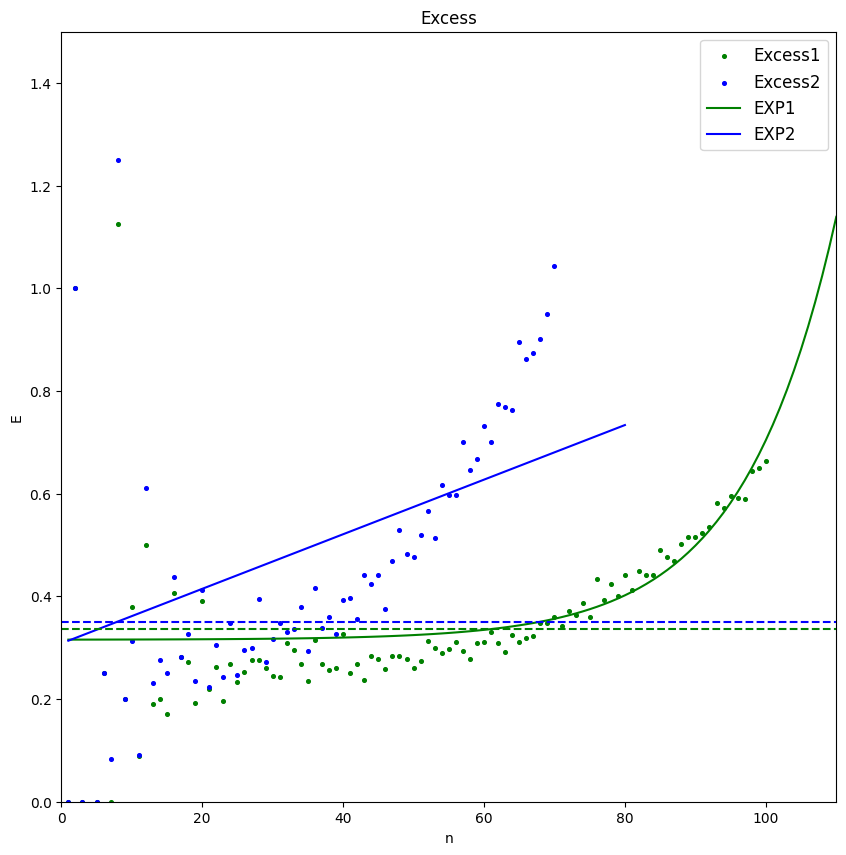

In [ ]:
b0, b1, b2 = [3.15534100e-01, 2.12492259e-04, 1.07801002e+00]
be0, be1, be2 = [ 2.11600025e+03, -2.11569193e+03,  9.99997486e-01]

xx1 = np.arange(1,111)
xx2 = np.arange (1,81)
plt.figure(figsize=(10,10))
plt.scatter(x1,y1,marker='o',s=7,color='g',label='Excess1')
plt.scatter(x2,y2,marker='o',s=7,color='b',label='Excess2')
plt.plot(xx1, b0 + b1*np.power(b2,xx1) ,color = 'g', label = 'EXP1')
plt.plot(xx2, be0 + be1*np.power(be2,xx2) ,color = 'b', label = 'EXP2')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.hlines(0.350, 0, 110, color='b',linestyle='--')
plt.hlines(0.337, 0, 110, color='g',linestyle='--')
plt.xlim([0, 110])
plt.ylim([0, 1.5])
plt.show()

## Кольцо

### График Excess

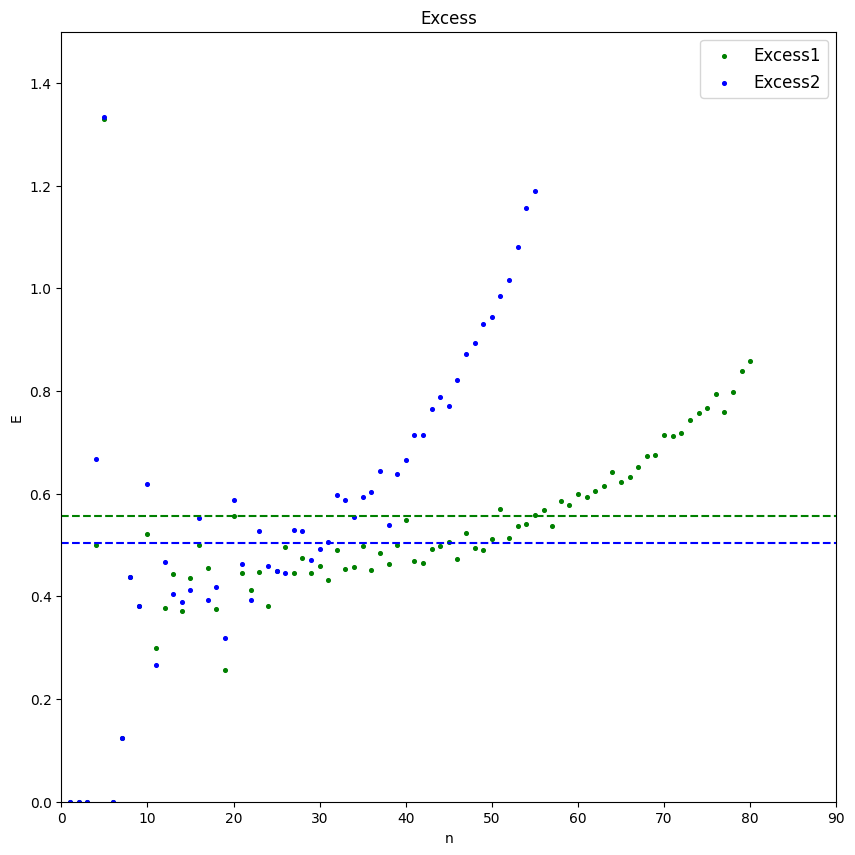

In [ ]:
Excess1 = [0, 0, 0, 0.5, 1.33, 0, 0.125, 0.438, 0.381, 0.522, 0.3, 0.378, 0.444, 0.372, 0.435, 0.5, 0.456,
     0.375, 0.257, 0.557, 0.446, 0.413, 0.447, 0.381, 0.449, 0.496, 0.445, 0.474, 0.445, 0.46, 0.432,
     0.491, 0.454, 0.458, 0.498, 0.452, 0.484, 0.464, 0.5, 0.548, 0.468, 0.465, 0.493, 0.498, 0.506,
     0.473, 0.523, 0.494, 0.49, 0.512, 0.571, 0.514, 0.538, 0.541, 0.559, 0.569, 0.537, 0.585, 0.579,
     0.599, 0.593, 0.606, 0.615, 0.643, 0.623, 0.633, 0.653, 0.674, 0.676, 0.714, 0.712, 0.718, 0.744,
     0.757, 0.767, 0.795, 0.759, 0.798, 0.84, 0.859]

Excess2 = [0, 0, 0, 0.667, 1.333, 0, 0.125, 0.438, 0.381, 0.619, 0.267, 0.467, 0.405, 0.39, 0.413, 0.553, 0.393, 0.419, 0.319, 0.588,
          0.463, 0.393, 0.527, 0.459, 0.449, 0.445, 0.529, 0.528, 0.471, 0.493, 0.506, 0.597, 0.588, 0.554, 0.594, 0.603, 0.644, 0.54, 0.639, 0.665,
          0.714, 0.714, 0.765, 0.789, 0.770, 0.821, 0.873, 0.893, 0.931, 0.944, 0.986, 1.017, 1.08, 1.156, 1.19]

n1 = list(range(1, 81))
n2 = list(range(1, 56))

plt.figure(figsize=(10,10))
plt.scatter(n1,Excess1,marker='o',s=7,color='g',label='Excess1')
plt.scatter(n2,Excess2,marker='o',s=7,color='b',label='Excess2')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Excess')
plt.hlines(0.504, 0, 90, color='b',linestyle='--')
plt.hlines(0.556, 0, 90, color='g',linestyle='--')
plt.xlabel('n')
plt.ylabel('E')
plt.xlim([0, 90])
plt.ylim([0, 1.5])
plt.show()

### Среднее

In [ ]:
nn1 = np.arange(5,81)
av1 = []
for i in nn1:
  av1.append(np.mean(Excess1[0:i]))

print(av1)

nn2 = np.arange(5,56)
av2 = []
for i in nn2:
  av2.append(np.mean(Excess2[0:i]))

print(av2)

[0.366, 0.305, 0.2792857142857143, 0.299125, 0.30822222222222223, 0.3296, 0.3269090909090909, 0.33116666666666666, 0.33984615384615385, 0.34214285714285714, 0.34833333333333333, 0.3578125, 0.36358823529411766, 0.3642222222222222, 0.35857894736842105, 0.3685, 0.3721904761904762, 0.3740454545454545, 0.3772173913043478, 0.37737499999999996, 0.3802399999999999, 0.38469230769230767, 0.3869259259259259, 0.39003571428571426, 0.3919310344827586, 0.3942, 0.3954193548387097, 0.39840625, 0.4000909090909091, 0.40179411764705886, 0.40454285714285715, 0.4058611111111111, 0.40797297297297297, 0.40944736842105267, 0.4117692307692308, 0.41517499999999996, 0.4164634146341463, 0.4176190476190476, 0.4193720930232558, 0.42115909090909087, 0.42304444444444445, 0.42413043478260865, 0.4262340425531914, 0.42764583333333334, 0.4289183673469388, 0.43058, 0.43333333333333335, 0.4348846153846154, 0.4368301886792453, 0.4387592592592593, 0.4409454545454546, 0.4432321428571429, 0.44487719298245615, 0.4472931034482759

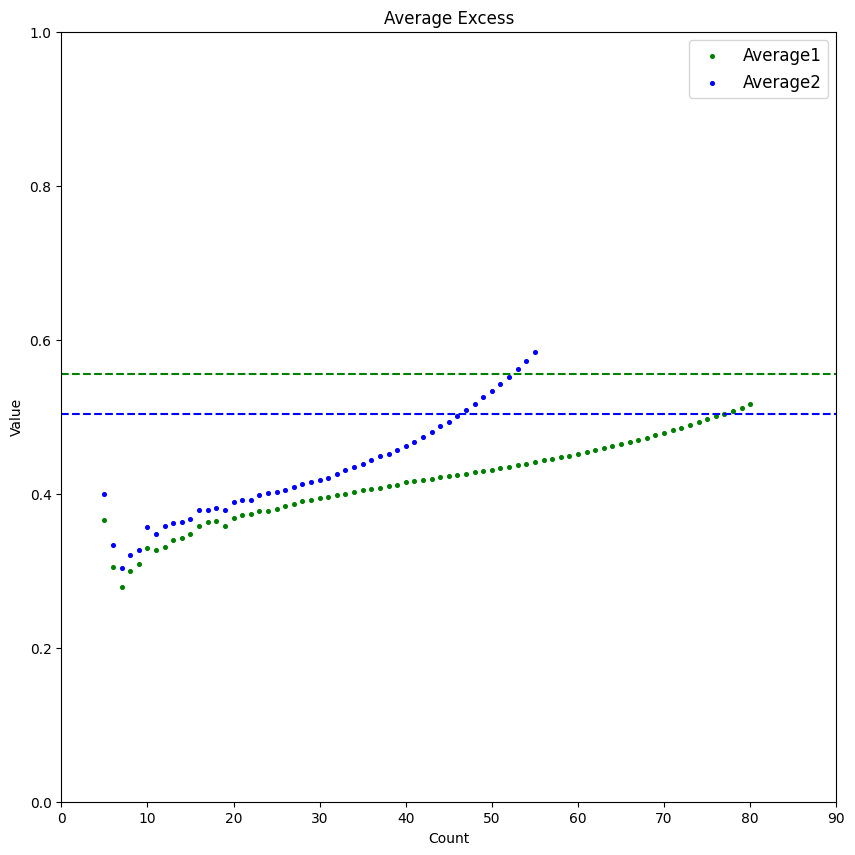

In [ ]:
plt.figure(figsize=(10,10))
plt.scatter(nn1,av1,marker='o',s=7,color='g',label='Average1')
plt.scatter(nn2,av2,marker='o',s=7,color='b',label='Average2')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Average Excess')
plt.xlabel('Count')
plt.ylabel('Value')
plt.hlines(0.556, 0, 90, color='g',linestyle='--')
plt.hlines(0.504, 0, 90, color='b',linestyle='--')
plt.xlim([0, 90])
plt.ylim([0, 1])
plt.show()

### МНК 1-я степень

In [ ]:
x1 = np.array(n1)
y1 = np.array(Excess1)

x2 = np.array(n2)
y2 = np.array(Excess2)

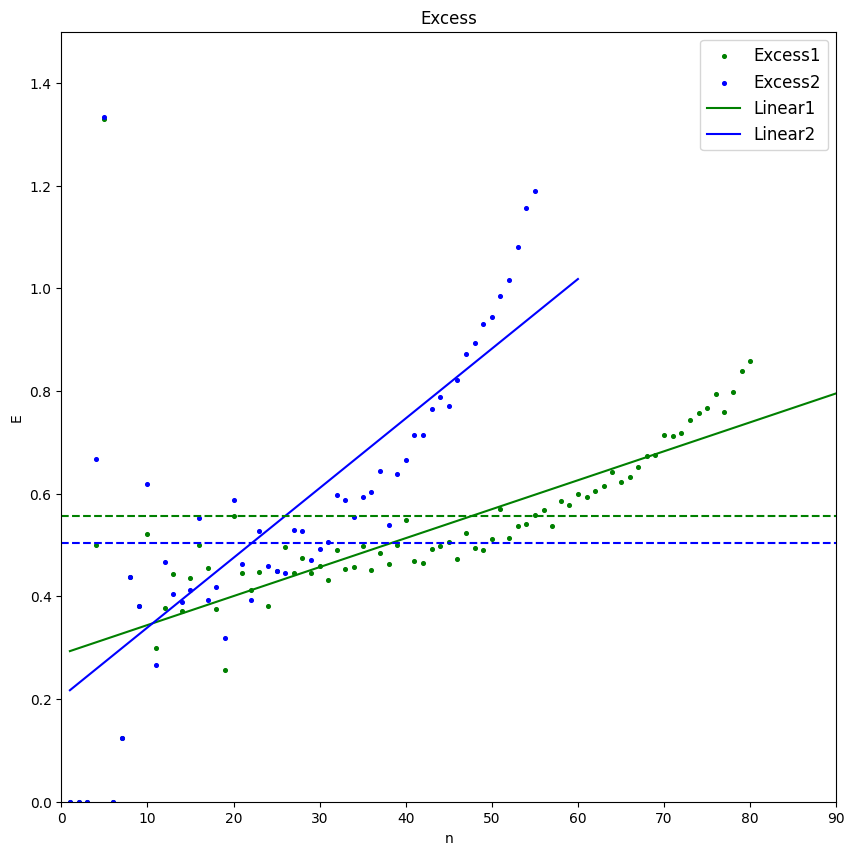

In [ ]:
b0, b1 = [0.28773544, 0.00564233]
be0, be1 = [0.20358384, 0.01357785]

xx1 = np.arange (1,91)
xx2 = np.arange (1,61)
plt.figure(figsize=(10,10))
plt.scatter(x1,y1,marker='o',s=7,color='g',label='Excess1')
plt.scatter(x2,y2,marker='o',s=7,color='b',label='Excess2')
plt.plot(xx1, b0 + b1*xx1 ,color = 'g', label = 'Linear1')
plt.plot(xx2, be0 + be1*xx2 , color = 'b', label = 'Linear2')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.hlines(0.556, 0, 90, color='g',linestyle='--')
plt.hlines(0.504, 0, 90, color='b',linestyle='--')
plt.xlim([0, 90])
plt.ylim([0, 1.5])
plt.show()

### МНК 2-я степень

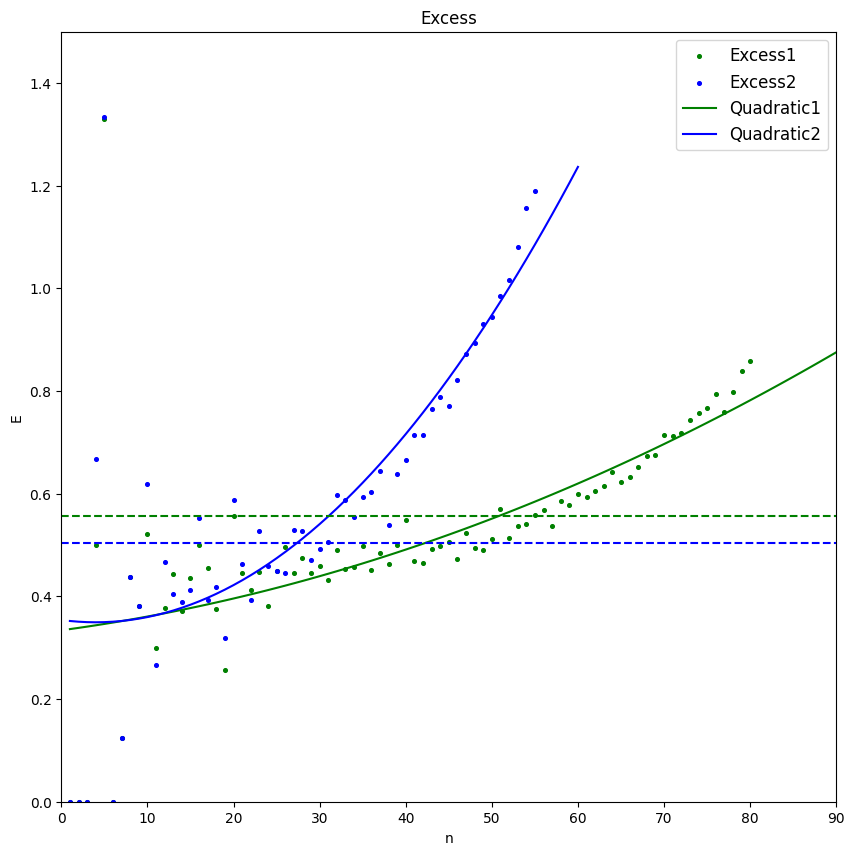

In [ ]:
b0, b1, b2 = [3.33962439e-01, 2.25987161e-03, 4.17588041e-05]
be0, be1, be2 = [ 3.54089461e-01, -2.26484715e-03,  2.82905305e-04]

xx1 = np.arange (1,91)
xx2 = np.arange (1,61)
plt.figure(figsize=(10,10))
plt.scatter(x1,y1,marker='o',s=7,color='g',label='Excess1')
plt.scatter(x2,y2,marker='o',s=7,color='b',label='Excess2')
plt.plot(xx1, b0 + b1*xx1 + b2*xx1**2 ,color = 'g', label = 'Quadratic1')
plt.plot(xx2, be0 + be1*xx2 + be2*xx2**2 ,color = 'b', label = 'Quadratic2')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.hlines(0.556, 0, 90, color='g',linestyle='--')
plt.hlines(0.504, 0, 90, color='b',linestyle='--')
plt.xlim([0, 90])
plt.ylim([0, 1.5])
plt.show()

### МНК 3-я степень

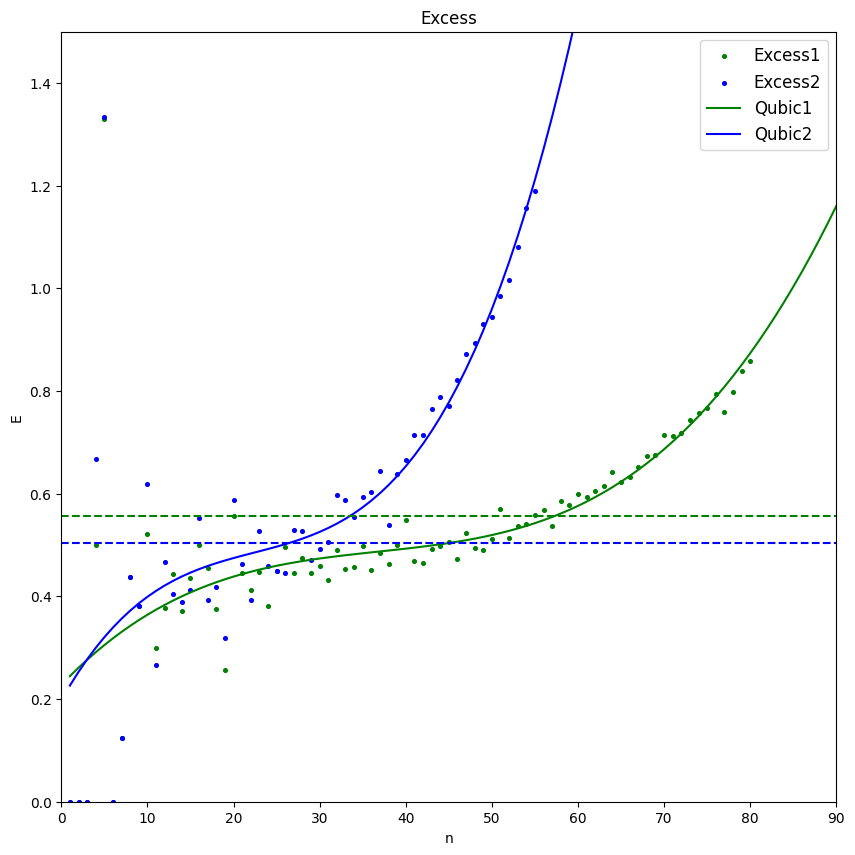

In [ ]:
b0, b1, b2, b3 = [ 2.27568160e-01,  1.75491545e-02, -4.27213923e-04,  3.85985784e-06]
be0, be1, be2, be3 = [ 1.97486188e-01,  2.98549969e-02, -1.13817702e-03,  1.69176467e-05]

xx1 = np.arange (1,91)
xx2 = np.arange (1,61)
plt.figure(figsize=(10,10))
plt.scatter(x1,y1,marker='o',s=7,color='g',label='Excess1')
plt.scatter(x2,y2,marker='o',s=7,color='b',label='Excess2')
plt.plot(xx1, b0 + b1*xx1 + b2*xx1**2 + b3*xx1**3 ,color = 'g', label = 'Qubic1')
plt.plot(xx2, be0 + be1*xx2 + be2*xx2**2 + be3*xx2**3 ,color = 'b', label = 'Qubic2')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.hlines(0.556, 0, 90, color='g',linestyle='--')
plt.hlines(0.504, 0, 90, color='b',linestyle='--')
plt.xlim([0, 90])
plt.ylim([0, 1.5])
plt.show()

### МНК экспонента

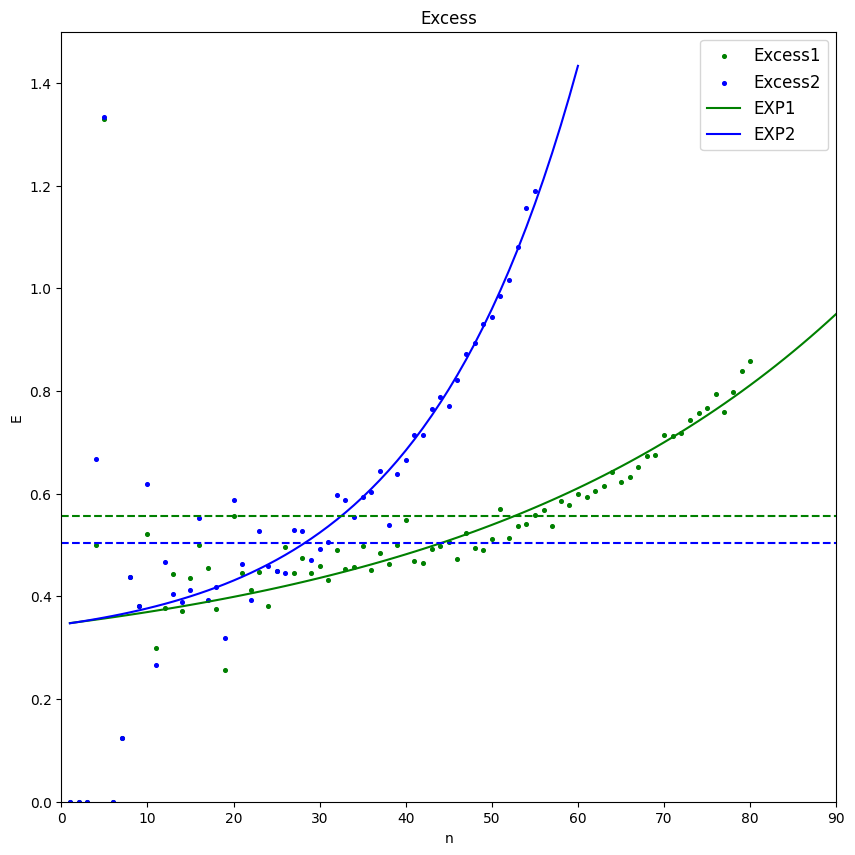

In [ ]:
b0, b1, b2 = [0.25004637, 0.09574933, 1.02235568]
be0, be1, be2 = [0.30143652, 0.04375593, 1.05571671]

xx1 = np.arange (1,91)
xx2 = np.arange (1,61)
plt.figure(figsize=(10,10))
plt.scatter(x1,y1,marker='o',s=7,color='g',label='Excess1')
plt.scatter(x2,y2,marker='o',s=7,color='b',label='Excess2')
plt.plot(xx1, b0 + b1*np.power(b2,xx1) ,color = 'g', label = 'EXP1')
plt.plot(xx2, be0 + be1*np.power(be2,xx2) ,color = 'b', label = 'EXP2')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.hlines(0.556, 0, 90, color='g',linestyle='--')
plt.hlines(0.504, 0, 90, color='b',linestyle='--')
plt.xlim([0, 90])
plt.ylim([0, 1.5])
plt.show()

## Прямоугольник

### График Excess

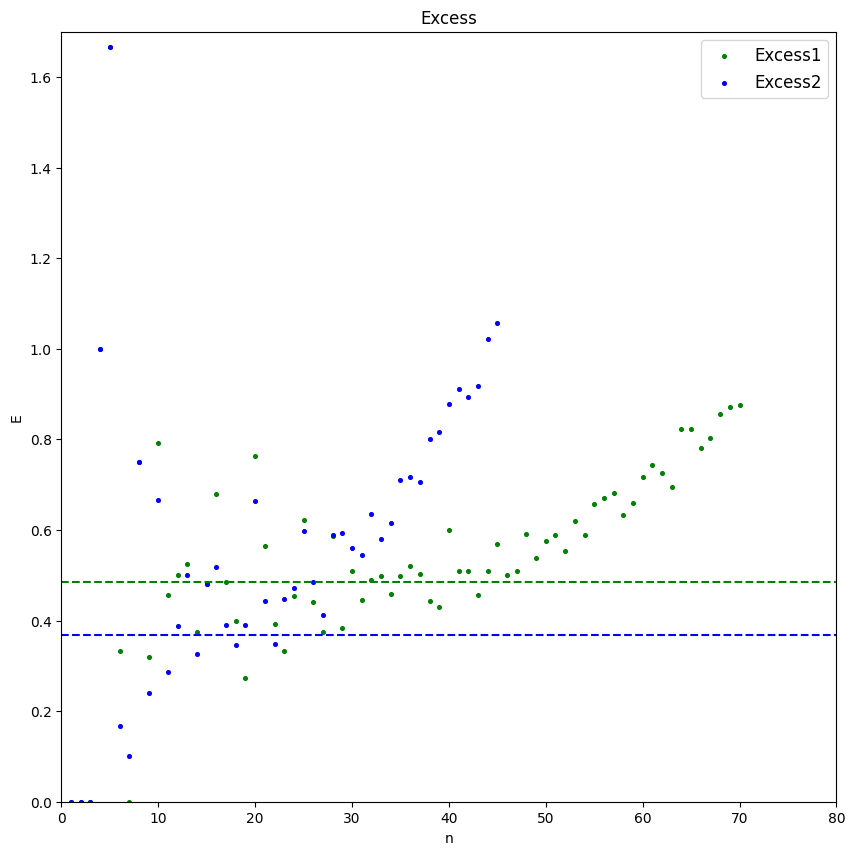

In [ ]:
Excess1 = [0, 0, 0, 1, 1.667, 0.333, 0, 0.75, 0.32, 0.792, 0.457, 0.5, 0.524, 0.375, 0.481, 0.679, 0.486,
     0.4, 0.273, 0.763, 0.565, 0.392, 0.333, 0.454, 0.623, 0.441, 0.375, 0.587, 0.383, 0.51, 0.445,
     0.489, 0.498, 0.458, 0.498, 0.52, 0.503, 0.444, 0.431, 0.599, 0.509, 0.509, 0.457, 0.51, 0.568,
     0.5, 0.509, 0.591, 0.538, 0.575, 0.589, 0.554, 0.619, 0.589, 0.657, 0.67, 0.682, 0.632, 0.659,
     0.716, 0.743, 0.725, 0.695, 0.822, 0.823, 0.781, 0.803, 0.855, 0.871, 0.876]

Excess2 = [0, 0, 0, 1, 1.667, 0.167, 0.1, 0.75, 0.24, 0.667, 0.286, 0.389, 0.5, 0.327, 0.48, 0.518, 0.391, 0.346, 0.391, 0.663,
          0.443, 0.348, 0.447, 0.471, 0.597, 0.486, 0.413, 0.589, 0.593, 0.561, 0.545, 0.636, 0.58, 0.615, 0.71, 0.718, 0.706, 0.8,
          0.817, 0.877, 0.911, 0.894, 0.917, 1.022, 1.056]

n1 = list(range(1, 71))
n2 = list(range(1, 46))

plt.figure(figsize=(10,10))
plt.scatter(n1,Excess1,marker='o',s=7,color='g',label='Excess1')
plt.scatter(n2,Excess2,marker='o',s=7,color='b',label='Excess2')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Excess')
plt.hlines(0.486, 0, 80, color='g',linestyle='--')
plt.hlines(0.369, 0, 80, color='b',linestyle='--')
plt.xlabel('n')
plt.ylabel('E')
plt.xlim([0, 80])
plt.ylim([0, 1.7])
plt.show()

### Среднее

In [ ]:
nn1 = np.arange(5,71)
av1 = []
for i in nn1:
  av1.append(np.mean(Excess1[0:i]))

print(av1)

nn2 = np.arange(5,46)
av2 = []
for i in nn2:
  av2.append(np.mean(Excess2[0:i]))

print(av2)

[0.5334, 0.5, 0.42857142857142855, 0.46875, 0.45222222222222225, 0.4862, 0.48354545454545456, 0.48491666666666666, 0.4879230769230769, 0.47985714285714287, 0.4799333333333333, 0.492375, 0.49200000000000005, 0.4868888888888889, 0.47563157894736846, 0.49000000000000005, 0.4935714285714286, 0.4889545454545454, 0.48217391304347823, 0.48100000000000004, 0.48668, 0.48492307692307696, 0.48085185185185186, 0.48464285714285715, 0.4811379310344827, 0.4821, 0.4809032258064516, 0.48115624999999995, 0.4816666666666666, 0.48097058823529404, 0.4814571428571428, 0.4825277777777777, 0.48308108108108105, 0.4820526315789473, 0.4807435897435897, 0.48369999999999996, 0.4843170731707317, 0.4849047619047619, 0.4842558139534884, 0.48484090909090916, 0.48668888888888895, 0.4869782608695653, 0.4874468085106384, 0.4896041666666667, 0.4905918367346939, 0.49228, 0.4941764705882353, 0.49532692307692305, 0.4976603773584905, 0.49935185185185177, 0.5022181818181818, 0.5052142857142857, 0.5083157894736842, 0.5104482758

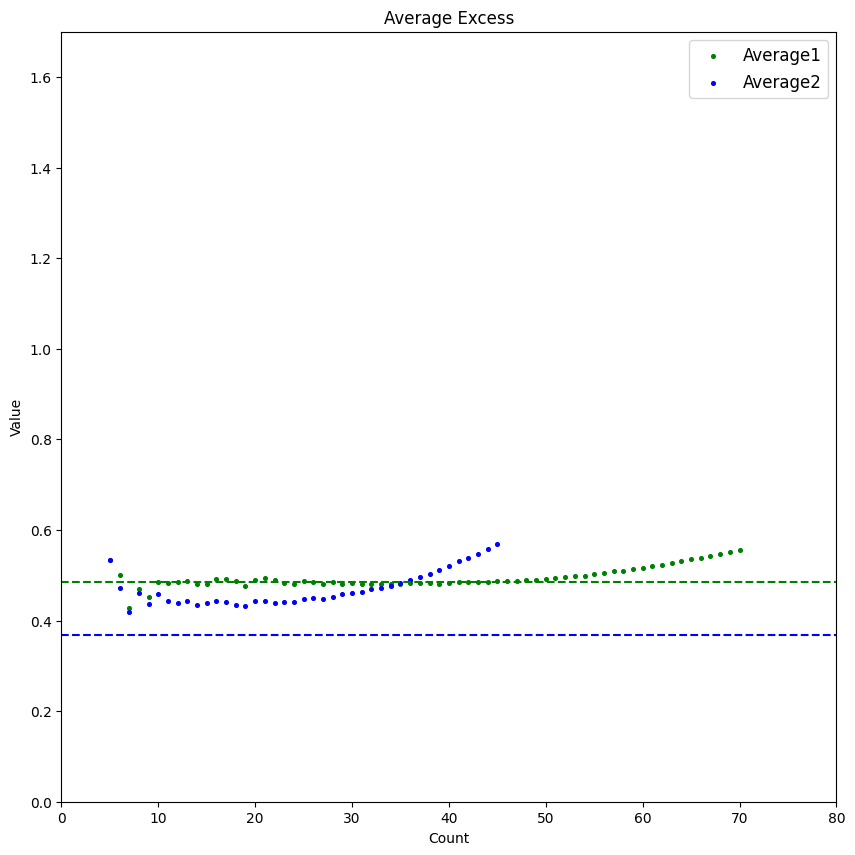

In [ ]:
plt.figure(figsize=(10,10))
plt.scatter(nn1,av1,marker='o',s=7,color='g',label='Average1')
plt.scatter(nn2,av2,marker='o',s=7,color='b',label='Average2')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Average Excess')
plt.xlabel('Count')
plt.ylabel('Value')
plt.hlines(0.486, 0, 80, color='g',linestyle='--')
plt.hlines(0.369, 0, 80, color='b',linestyle='--')
plt.xlim([0, 80])
plt.ylim([0, 1.7])
plt.show()

### МНК 1-я степень

In [ ]:
x1 = np.array(n1)
y1 = np.array(Excess1)

x2 = np.array(n2)
y2 = np.array(Excess2)

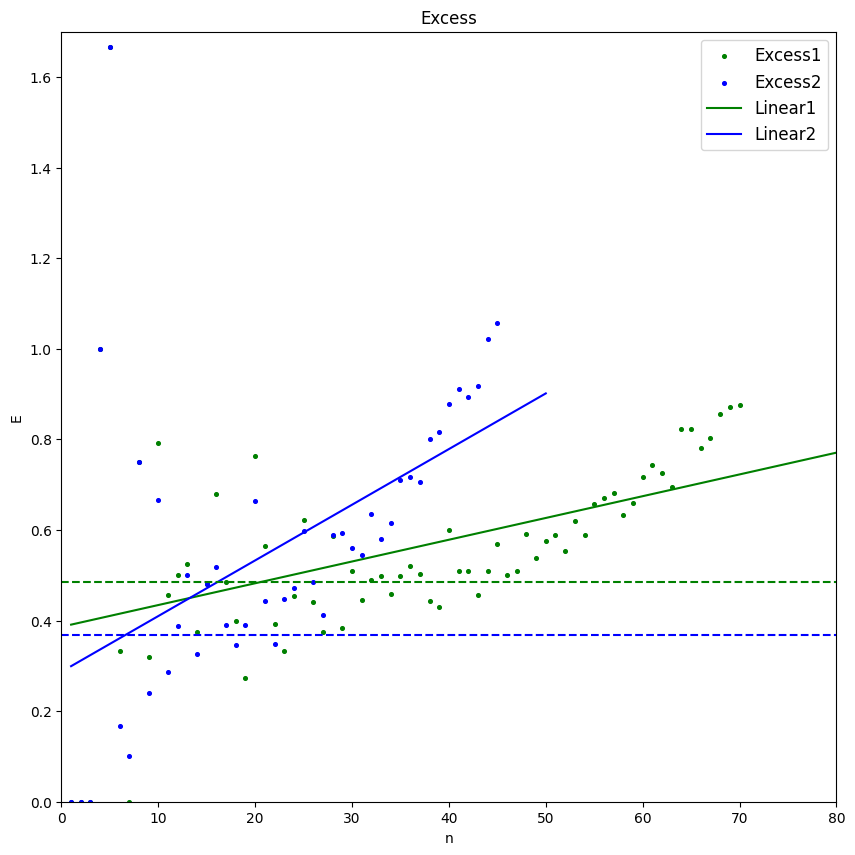

In [ ]:
b0, b1 = [0.38615777, 0.00480642]
be0, be1 = [0.28697172, 0.01229012]

xx1 = np.arange (1,81)
xx2 = np.arange (1,51)
plt.figure(figsize=(10,10))
plt.scatter(x1,y1,marker='o',s=7,color='g',label='Excess1')
plt.scatter(x2,y2,marker='o',s=7,color='b',label='Excess2')
plt.plot(xx1, b0 + b1*xx1 ,color = 'g', label = 'Linear1')
plt.plot(xx2, be0 + be1*xx2 ,color = 'b', label = 'Linear2')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.hlines(0.486, 0, 80, color='g',linestyle='--')
plt.hlines(0.369, 0, 80, color='b',linestyle='--')
plt.xlim([0, 80])
plt.ylim([0, 1.7])
plt.show()

### МНК 2-я степень

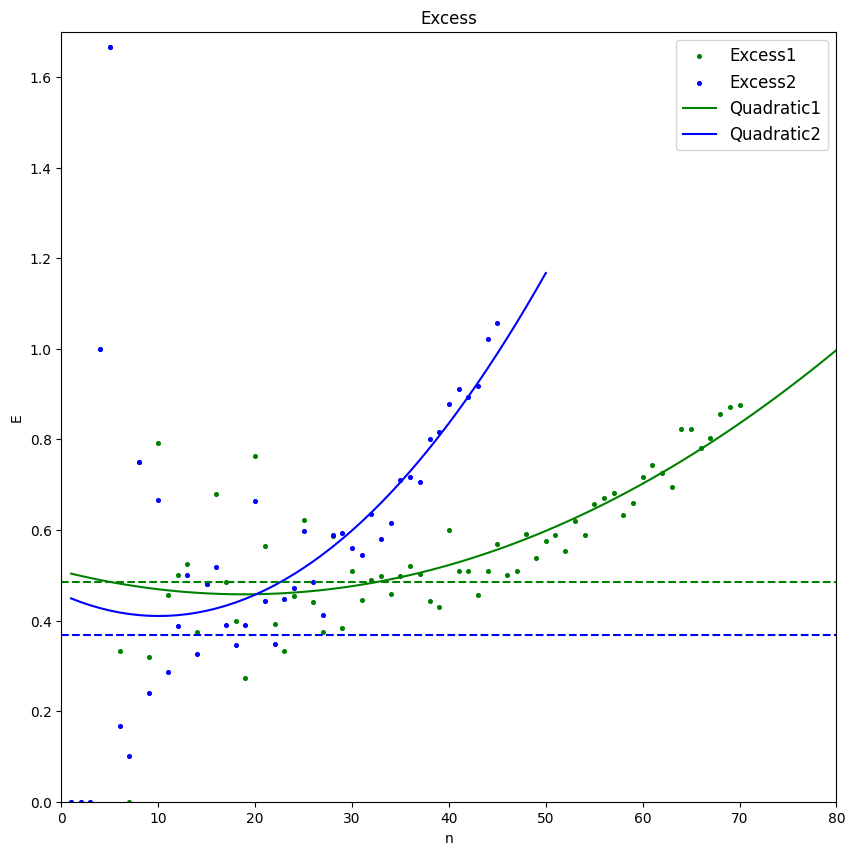

In [ ]:
b0, b1, b2 = [ 5.08896164e-01, -5.42177884e-03,  1.44059155e-04]
be0, be1, be2 = [ 0.45789302, -0.00952962,  0.00047434]

xx1 = np.arange (1,81)
xx2 = np.arange (1,51)
plt.figure(figsize=(10,10))
plt.scatter(x1,y1,marker='o',s=7,color='g',label='Excess1')
plt.scatter(x2,y2,marker='o',s=7,color='b',label='Excess2')
plt.plot(xx1, b0 + b1*xx1 + b2*xx1**2 ,color = 'g', label = 'Quadratic1')
plt.plot(xx2, be0 + be1*xx2 + be2*xx2**2 ,color = 'b', label = 'Quadratic2')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.hlines(0.486, 0, 80, color='g',linestyle='--')
plt.hlines(0.369, 0, 80, color='b',linestyle='--')
plt.xlim([0, 80])
plt.ylim([0, 1.7])
plt.show()

### МНК 3-я степень

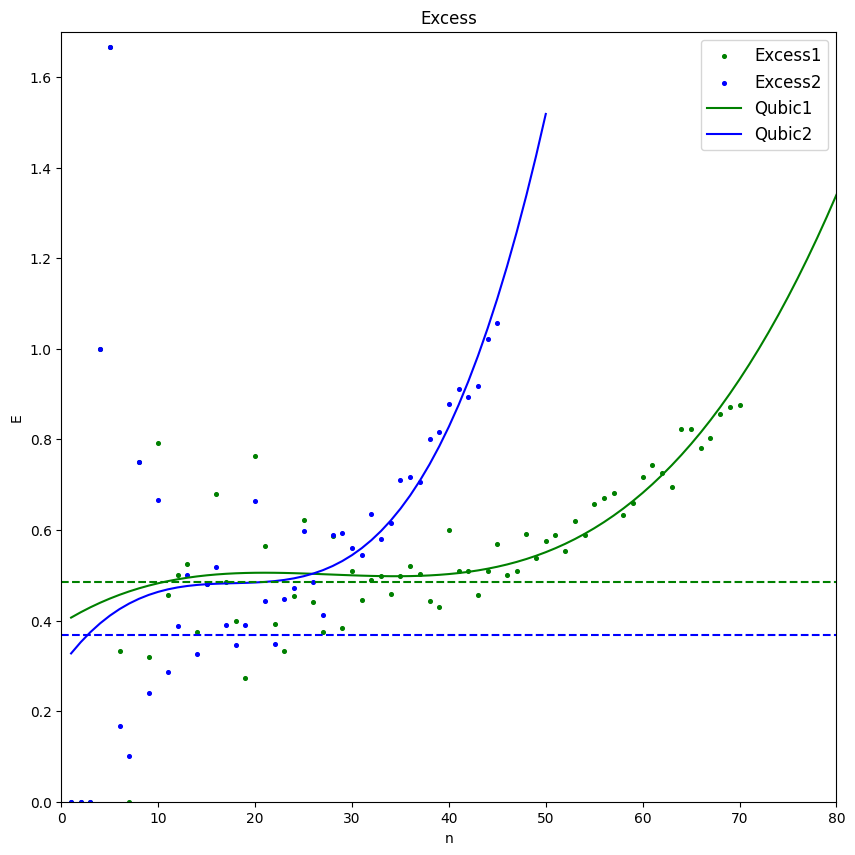

In [ ]:
b0, b1, b2, b3 = [ 3.93559911e-01,  1.34071790e-02, -5.14252787e-04,  6.18133279e-06]
be0, be1, be2, be3 =[ 2.99309232e-01,  2.97006724e-02, -1.63448481e-03,  3.05627103e-05]

xx1 = np.arange (1,81)
xx2 = np.arange (1,51)
plt.figure(figsize=(10,10))
plt.scatter(x1,y1,marker='o',s=7,color='g',label='Excess1')
plt.scatter(x2,y2,marker='o',s=7,color='b',label='Excess2')
plt.plot(xx1, b0 + b1*xx1 + b2*xx1**2 + b3*xx1**3 ,color = 'g', label = 'Qubic1')
plt.plot(xx2, be0 + be1*xx2 + be2*xx2**2 + be3*xx2**3 ,color = 'b', label = 'Qubic2')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.hlines(0.486, 0, 80, color='g',linestyle='--')
plt.hlines(0.369, 0, 80, color='b',linestyle='--')
plt.xlim([0, 80])
plt.ylim([0, 1.7])
plt.show()

### МНК экспонента

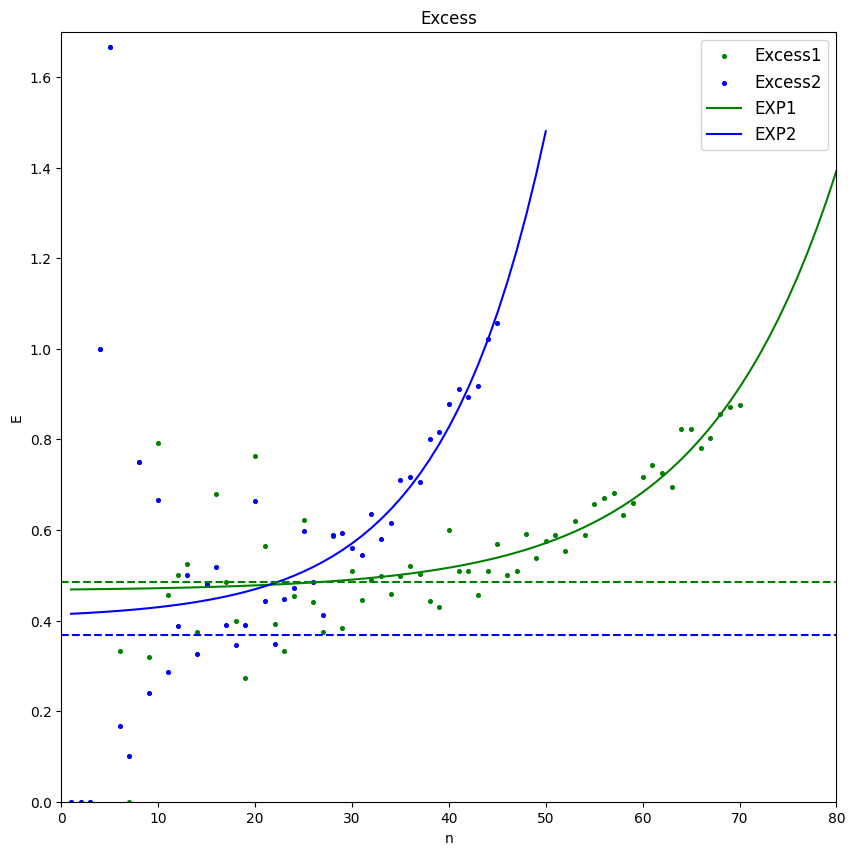

In [ ]:
b0, b1, b2 = [0.46564768, 0.00280787, 1.0751837 ]
be0, be1, be2 = [0.40379392, 0.01012884, 1.09781493]

xx1 = np.arange (1,81)
xx2 = np.arange (1,51)
plt.figure(figsize=(10,10))
plt.scatter(x1,y1,marker='o',s=7,color='g',label='Excess1')
plt.scatter(x2,y2,marker='o',s=7,color='b',label='Excess2')
plt.plot(xx1, b0 + b1*np.power(b2,xx1) ,color ='g', label = 'EXP1')
plt.plot(xx2, be0 + be1*np.power(be2,xx2) ,color ='b', label = 'EXP2')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.hlines(0.486, 0, 80, color='g',linestyle='--')
plt.hlines(0.369, 0, 80, color='b',linestyle='--')
plt.xlim([0, 80])
plt.ylim([0, 1.7])
plt.show()

# ИРИСЫ

In [ ]:
from sklearn import datasets

iris = datasets.load_iris()
X = iris.data
y = iris.target

## Одномерное распределение для каждого из признаков

### 1-й признак

In [ ]:
first_column = np.take(X, 0, axis=1)
first_column

array([5.1, 4.9, 4.7, 4.6, 5. , 5.4, 4.6, 5. , 4.4, 4.9, 5.4, 4.8, 4.8,
       4.3, 5.8, 5.7, 5.4, 5.1, 5.7, 5.1, 5.4, 5.1, 4.6, 5.1, 4.8, 5. ,
       5. , 5.2, 5.2, 4.7, 4.8, 5.4, 5.2, 5.5, 4.9, 5. , 5.5, 4.9, 4.4,
       5.1, 5. , 4.5, 4.4, 5. , 5.1, 4.8, 5.1, 4.6, 5.3, 5. , 7. , 6.4,
       6.9, 5.5, 6.5, 5.7, 6.3, 4.9, 6.6, 5.2, 5. , 5.9, 6. , 6.1, 5.6,
       6.7, 5.6, 5.8, 6.2, 5.6, 5.9, 6.1, 6.3, 6.1, 6.4, 6.6, 6.8, 6.7,
       6. , 5.7, 5.5, 5.5, 5.8, 6. , 5.4, 6. , 6.7, 6.3, 5.6, 5.5, 5.5,
       6.1, 5.8, 5. , 5.6, 5.7, 5.7, 6.2, 5.1, 5.7, 6.3, 5.8, 7.1, 6.3,
       6.5, 7.6, 4.9, 7.3, 6.7, 7.2, 6.5, 6.4, 6.8, 5.7, 5.8, 6.4, 6.5,
       7.7, 7.7, 6. , 6.9, 5.6, 7.7, 6.3, 6.7, 7.2, 6.2, 6.1, 6.4, 7.2,
       7.4, 7.9, 6.4, 6.3, 6.1, 7.7, 6.3, 6.4, 6. , 6.9, 6.7, 6.9, 5.8,
       6.8, 6.7, 6.7, 6.3, 6.5, 6.2, 5.9])

In [ ]:
print('min:', np.min(first_column))
print('max:', np.max(first_column))

min: 4.3
max: 7.9


In [ ]:
((np.max(first_column)+1)-(np.min(first_column)-1))/0.2

28.0

In [ ]:
def distance(point1, point2):
  # Вычисление расстояния по Евклиду
  return np.sqrt(np.sum((point1 - point2)**2))

# Инициализация матрицы расстояний
ds1 = np.zeros((len(first_column), len(first_column)))

# Вычисление расстояния между каждой точкой и каждой другой точкой
for i in range(len(first_column)):
  for j in range(len(first_column)):
    if i != j:
      ds1[i, j] = distance(first_column[i], first_column[j])

In [ ]:
ds1

array([[0. , 0.2, 0.4, ..., 1.4, 1.1, 0.8],
       [0.2, 0. , 0.2, ..., 1.6, 1.3, 1. ],
       [0.4, 0.2, 0. , ..., 1.8, 1.5, 1.2],
       ...,
       [1.4, 1.6, 1.8, ..., 0. , 0.3, 0.6],
       [1.1, 1.3, 1.5, ..., 0.3, 0. , 0.3],
       [0.8, 1. , 1.2, ..., 0.6, 0.3, 0. ]])

In [ ]:
mask = np.tril(np.ones(ds1.shape)).astype(bool)
elements1 = ds1[mask]

elements1 = np.compress(elements1 != 0, elements1)
elements1

array([0.2, 0.4, 0.2, ..., 0.4, 0.6, 0.3])

In [ ]:
# Среднее по всем расстояниям:

# Вычислите сумму всех расстояний
total_1 = np.sum(elements1)

# Количество элементов (не считая диагональных)
n_elements = len(elements1)

# Рассчитайте среднее расстояние
av_ds1 = total_1 / n_elements

print(av_ds1)

0.9790462962962964


In [ ]:
elements1

array([0.2, 0.4, 0.2, ..., 0.4, 0.6, 0.3])

Наиболее частое значение: 0.09999999999999964


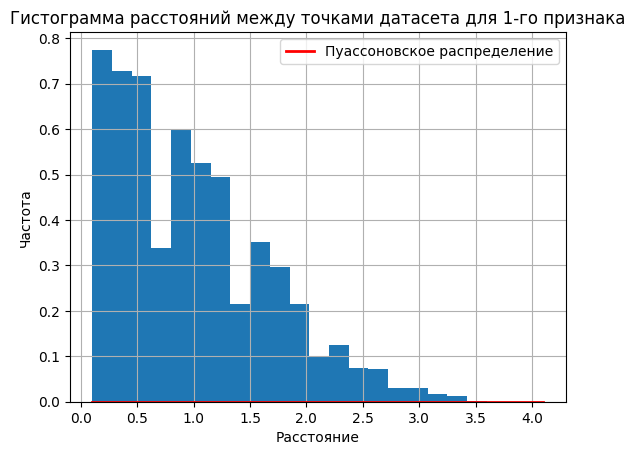

In [ ]:
# Определите диапазон значений
min_distance = np.min(elements1)
max_distance = np.max(elements1)

# Выберите количество интервалов
n_bins = 20

# Построение гистограммы
counts, bins, patches = plt.hist(elements1, bins=n_bins, density=True, range=(min_distance, max_distance))
# Определение наиболее частого диапазона
most_frequent_index = np.argmax(counts)

print("Наиболее частое значение:", bins[most_frequent_index])

# Настройка оформления
plt.xlabel("Расстояние")
plt.ylabel("Частота")
plt.title("Гистограмма расстояний между точками датасета для 1-го признака")
plt.grid(True)

# параметр лямбда пуассоновского распределения
mu = np.mean(elements1)

# кривая пуассоновского распределения
x = np.arange(min(elements1), max(elements1) + 1)
y = poisson.pmf(x, mu)
plt.plot(x, y, 'r-', lw=2, label='Пуассоновское распределение')
plt.legend()
plt.show()

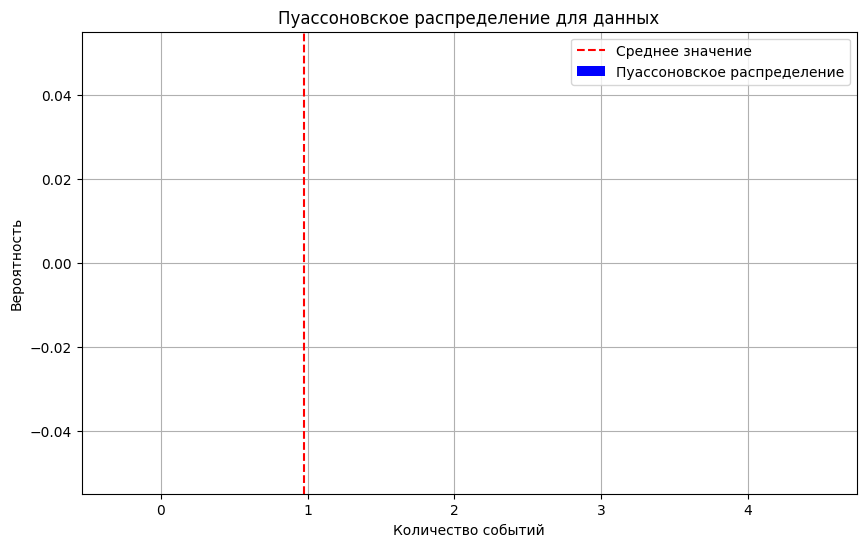

In [ ]:
plt.figure(figsize=(10, 6))
plt.bar(x, y, color='blue', label='Пуассоновское распределение')
plt.axvline(mu, color='red', linestyle='dashed', label='Среднее значение')
plt.xlabel('Количество событий')
plt.ylabel('Вероятность')
plt.title('Пуассоновское распределение для данных')
plt.legend()
plt.grid(True)
plt.show()

### 2-й признак

In [ ]:
second_column = np.take(X, 1, axis=1)
second_column

array([3.5, 3. , 3.2, 3.1, 3.6, 3.9, 3.4, 3.4, 2.9, 3.1, 3.7, 3.4, 3. ,
       3. , 4. , 4.4, 3.9, 3.5, 3.8, 3.8, 3.4, 3.7, 3.6, 3.3, 3.4, 3. ,
       3.4, 3.5, 3.4, 3.2, 3.1, 3.4, 4.1, 4.2, 3.1, 3.2, 3.5, 3.6, 3. ,
       3.4, 3.5, 2.3, 3.2, 3.5, 3.8, 3. , 3.8, 3.2, 3.7, 3.3, 3.2, 3.2,
       3.1, 2.3, 2.8, 2.8, 3.3, 2.4, 2.9, 2.7, 2. , 3. , 2.2, 2.9, 2.9,
       3.1, 3. , 2.7, 2.2, 2.5, 3.2, 2.8, 2.5, 2.8, 2.9, 3. , 2.8, 3. ,
       2.9, 2.6, 2.4, 2.4, 2.7, 2.7, 3. , 3.4, 3.1, 2.3, 3. , 2.5, 2.6,
       3. , 2.6, 2.3, 2.7, 3. , 2.9, 2.9, 2.5, 2.8, 3.3, 2.7, 3. , 2.9,
       3. , 3. , 2.5, 2.9, 2.5, 3.6, 3.2, 2.7, 3. , 2.5, 2.8, 3.2, 3. ,
       3.8, 2.6, 2.2, 3.2, 2.8, 2.8, 2.7, 3.3, 3.2, 2.8, 3. , 2.8, 3. ,
       2.8, 3.8, 2.8, 2.8, 2.6, 3. , 3.4, 3.1, 3. , 3.1, 3.1, 3.1, 2.7,
       3.2, 3.3, 3. , 2.5, 3. , 3.4, 3. ])

In [ ]:
print('min:', np.min(second_column))
print('max:', np.max(second_column))

((np.max(second_column)+1)-(np.min(second_column)-1))/0.2

min: 2.0
max: 4.4


22.0

In [ ]:
# Инициализация матрицы расстояний
ds2 = np.zeros((len(second_column), len(second_column)))

# Вычисление расстояния между каждой точкой и каждой другой точкой
for i in range(len(second_column)):
  for j in range(len(second_column)):
    if i != j:
      ds2[i, j] = distance(second_column[i], second_column[j])

In [ ]:
mask = np.tril(np.ones(ds2.shape)).astype(bool)
elements2 = ds2[mask]

elements2 = np.compress(elements2 != 0, elements2)
elements2

array([0.5, 0.3, 0.2, ..., 0.3, 0.5, 0.4])

In [ ]:
# Среднее по всем расстояниям:

# Вычислите сумму всех расстояний
total_2 = np.sum(elements2)

# Количество элементов (не считая диагональных)
n_elements = len(elements2)

# Рассчитайте среднее расстояние
av_ds2 = total_2 / n_elements

print(av_ds2)

0.5248505880084827


Наиболее частое значение: 0.09999999999999964


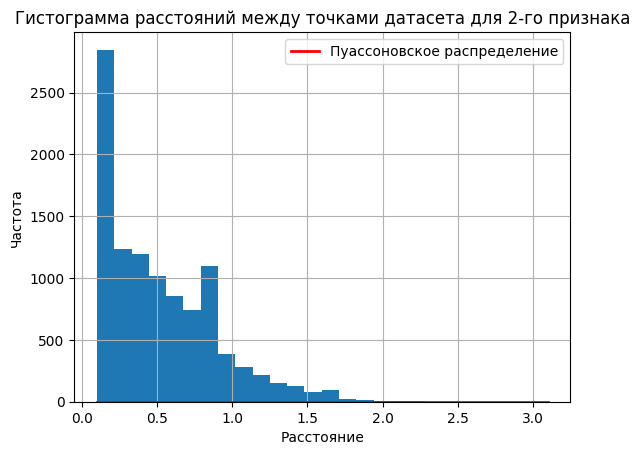

In [ ]:
# Определите диапазон значений
min_distance = np.min(elements2)
max_distance = np.max(elements2)

# Выберите количество интервалов
n_bins = 20


# Построение гистограммы
counts, bins, patches = plt.hist(elements2, bins=n_bins, range=(min_distance, max_distance))
# Определение наиболее частого диапазона
most_frequent_index = np.argmax(counts)

print("Наиболее частое значение:", bins[most_frequent_index])

# Настройка оформления
plt.xlabel("Расстояние")
plt.ylabel("Частота")
plt.title("Гистограмма расстояний между точками датасета для 2-го признака")
plt.grid(True)

# параметр лямбда пуассоновского распределения
mu = np.mean(elements2)

# кривая пуассоновского распределения
x = np.arange(min(elements2), max(elements2) + 1)
y = poisson.pmf(x, mu)
plt.plot(x, y, 'r-', lw=2, label='Пуассоновское распределение')
plt.legend()

plt.show()

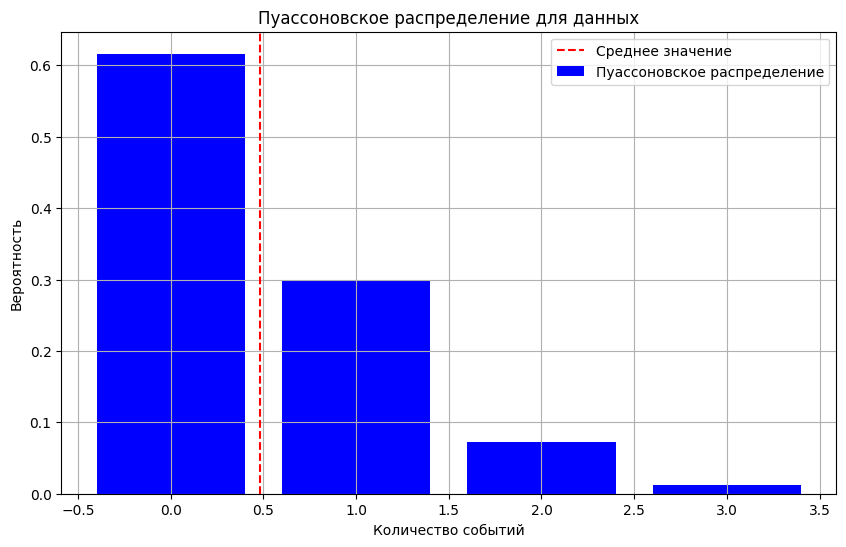

In [ ]:
plt.figure(figsize=(10, 6))
plt.bar(x, y, color='blue', label='Пуассоновское распределение')
plt.axvline(mu, color='red', linestyle='dashed', label='Среднее значение')
plt.xlabel('Количество событий')
plt.ylabel('Вероятность')
plt.title('Пуассоновское распределение для данных')
plt.legend()
plt.grid(True)
plt.show()

### 3-й признак

In [ ]:
thr_column = np.take(X, 2, axis=1)
thr_column

array([1.4, 1.4, 1.3, 1.5, 1.4, 1.7, 1.4, 1.5, 1.4, 1.5, 1.5, 1.6, 1.4,
       1.1, 1.2, 1.5, 1.3, 1.4, 1.7, 1.5, 1.7, 1.5, 1. , 1.7, 1.9, 1.6,
       1.6, 1.5, 1.4, 1.6, 1.6, 1.5, 1.5, 1.4, 1.5, 1.2, 1.3, 1.4, 1.3,
       1.5, 1.3, 1.3, 1.3, 1.6, 1.9, 1.4, 1.6, 1.4, 1.5, 1.4, 4.7, 4.5,
       4.9, 4. , 4.6, 4.5, 4.7, 3.3, 4.6, 3.9, 3.5, 4.2, 4. , 4.7, 3.6,
       4.4, 4.5, 4.1, 4.5, 3.9, 4.8, 4. , 4.9, 4.7, 4.3, 4.4, 4.8, 5. ,
       4.5, 3.5, 3.8, 3.7, 3.9, 5.1, 4.5, 4.5, 4.7, 4.4, 4.1, 4. , 4.4,
       4.6, 4. , 3.3, 4.2, 4.2, 4.2, 4.3, 3. , 4.1, 6. , 5.1, 5.9, 5.6,
       5.8, 6.6, 4.5, 6.3, 5.8, 6.1, 5.1, 5.3, 5.5, 5. , 5.1, 5.3, 5.5,
       6.7, 6.9, 5. , 5.7, 4.9, 6.7, 4.9, 5.7, 6. , 4.8, 4.9, 5.6, 5.8,
       6.1, 6.4, 5.6, 5.1, 5.6, 6.1, 5.6, 5.5, 4.8, 5.4, 5.6, 5.1, 5.1,
       5.9, 5.7, 5.2, 5. , 5.2, 5.4, 5.1])

In [ ]:
print('min:', np.min(thr_column))
print('max:', np.max(thr_column))

((np.max(thr_column)+1)-(np.min(thr_column)-1))/0.2

min: 1.0
max: 6.9


39.5

In [ ]:
# Инициализация матрицы расстояний
ds3 = np.zeros((len(thr_column), len(thr_column)))

# Вычисление расстояния между каждой точкой и каждой другой точкой
for i in range(len(thr_column)):
  for j in range(len(thr_column)):
    if i != j:
      ds3[i, j] = distance(thr_column[i], thr_column[j])

In [ ]:
mask = np.tril(np.ones(ds3.shape)).astype(bool)
elements3 = ds3[mask]

elements3 = np.compress(elements3 != 0, elements3)
elements3

array([0.1, 0.1, 0.1, ..., 0.1, 0.1, 0.3])

In [ ]:
# Среднее по всем расстояниям:

# Вычислите сумму всех расстояний
total_3 = np.sum(elements3)

# Количество элементов (не считая диагональных)
n_elements = len(elements3)

# Рассчитайте среднее расстояние
av_ds3 = total_3 / n_elements

print(av_ds3)

2.044562604031811


Наиболее частое значение: 0.09999999999999964


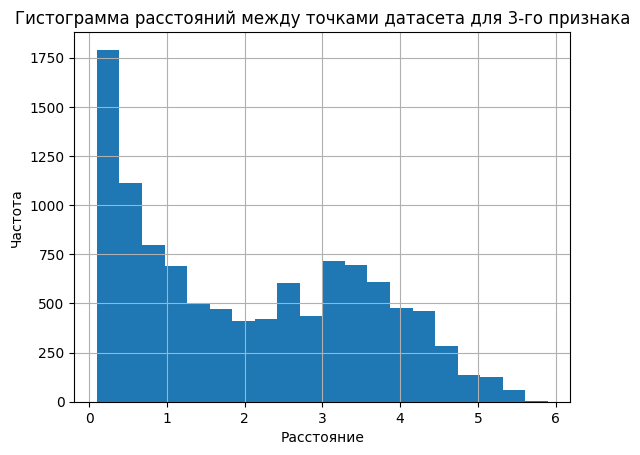

In [ ]:

# Определите диапазон значений
min_distance = np.min(elements3)
max_distance = np.max(elements3)

# Выберите количество интервалов
n_bins = 20


# Построение гистограммы
counts, bins, patches = plt.hist(elements3, bins=n_bins, range=(min_distance, max_distance))
# Определение наиболее частого диапазона
most_frequent_index = np.argmax(counts)

print("Наиболее частое значение:", bins[most_frequent_index])

# Настройка оформления
plt.xlabel("Расстояние")
plt.ylabel("Частота")
plt.title("Гистограмма расстояний между точками датасета для 3-го признака")
plt.grid(True)

"""
# параметр лямбда пуассоновского распределения
mu = np.mean(elements3)

# кривая пуассоновского распределения
x = np.arange(min(elements3), max(elements3) + 1)
y = poisson.pmf(x, mu)
plt.plot(x, y, 'r-', lw=2, label='Пуассоновское распределение')
plt.legend()

"""

plt.show()

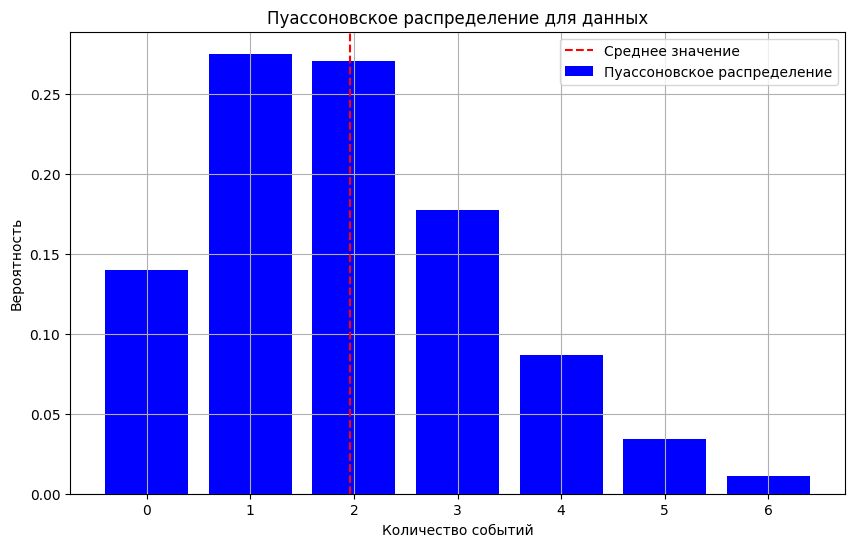

In [ ]:
plt.figure(figsize=(10, 6))
plt.bar(x, y, color='blue', label='Пуассоновское распределение')
plt.axvline(mu, color='red', linestyle='dashed', label='Среднее значение')
plt.xlabel('Количество событий')
plt.ylabel('Вероятность')
plt.title('Пуассоновское распределение для данных')
plt.legend()
plt.grid(True)
plt.show()

In [ ]:
import numpy as np

A = np.array([
    [1, 2, 3],
    [4, 5, 6],
    [7, 8, 9]
])

mask = np.tril(np.ones(A.shape)).astype(bool)
lower_triangular_elements = A[mask]
print(lower_triangular_elements)

[1 4 5 7 8 9]


### 4-й признак

In [ ]:
fourth_column = np.take(X, 3, axis=1)
fourth_column

array([0.2, 0.2, 0.2, 0.2, 0.2, 0.4, 0.3, 0.2, 0.2, 0.1, 0.2, 0.2, 0.1,
       0.1, 0.2, 0.4, 0.4, 0.3, 0.3, 0.3, 0.2, 0.4, 0.2, 0.5, 0.2, 0.2,
       0.4, 0.2, 0.2, 0.2, 0.2, 0.4, 0.1, 0.2, 0.2, 0.2, 0.2, 0.1, 0.2,
       0.2, 0.3, 0.3, 0.2, 0.6, 0.4, 0.3, 0.2, 0.2, 0.2, 0.2, 1.4, 1.5,
       1.5, 1.3, 1.5, 1.3, 1.6, 1. , 1.3, 1.4, 1. , 1.5, 1. , 1.4, 1.3,
       1.4, 1.5, 1. , 1.5, 1.1, 1.8, 1.3, 1.5, 1.2, 1.3, 1.4, 1.4, 1.7,
       1.5, 1. , 1.1, 1. , 1.2, 1.6, 1.5, 1.6, 1.5, 1.3, 1.3, 1.3, 1.2,
       1.4, 1.2, 1. , 1.3, 1.2, 1.3, 1.3, 1.1, 1.3, 2.5, 1.9, 2.1, 1.8,
       2.2, 2.1, 1.7, 1.8, 1.8, 2.5, 2. , 1.9, 2.1, 2. , 2.4, 2.3, 1.8,
       2.2, 2.3, 1.5, 2.3, 2. , 2. , 1.8, 2.1, 1.8, 1.8, 1.8, 2.1, 1.6,
       1.9, 2. , 2.2, 1.5, 1.4, 2.3, 2.4, 1.8, 1.8, 2.1, 2.4, 2.3, 1.9,
       2.3, 2.5, 2.3, 1.9, 2. , 2.3, 1.8])

In [ ]:
print('min:', np.min(fourth_column))
print('max:', np.max(fourth_column))

((np.max(fourth_column)+1)-(np.min(fourth_column)-1))/0.2

min: 0.1
max: 2.5


22.0

In [ ]:
# Инициализация матрицы расстояний
ds4 = np.zeros((len(fourth_column), len(fourth_column)))

# Вычисление расстояния между каждой точкой и каждой другой точкой
for i in range(len(fourth_column)):
  for j in range(len(fourth_column)):
    if i != j:
      ds4[i, j] = distance(fourth_column[i], fourth_column[j])

In [ ]:
mask = np.tril(np.ones(ds4.shape)).astype(bool)
elements4 = ds4[mask]

elements4 = np.compress(elements4 != 0, elements4)
elements4

array([0.2, 0.2, 0.2, ..., 0.1, 0.2, 0.5])

In [ ]:
# Среднее по всем расстояниям:

# Вычислите сумму всех расстояний
total_4 = np.sum(elements4)

# Количество элементов (не считая диагональных)
n_elements = len(elements4)

# Рассчитайте среднее расстояние
av_ds4 = total_4 / n_elements

print(av_ds4)

0.9357108387221312


Наиболее частое значение: 0.09999999999999964


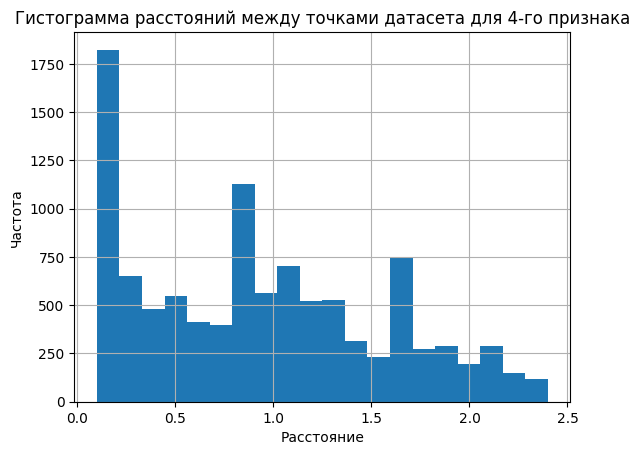

In [ ]:
# Определите диапазон значений
min_distance = np.min(elements4)
max_distance = np.max(elements4)

# Выберите количество интервалов
n_bins = 20


# Построение гистограммы
counts, bins, patches = plt.hist(elements4, bins=n_bins, range=(min_distance, max_distance))
# Определение наиболее частого диапазона
most_frequent_index = np.argmax(counts)

print("Наиболее частое значение:", bins[most_frequent_index])

# Настройка оформления
plt.xlabel("Расстояние")
plt.ylabel("Частота")
plt.title("Гистограмма расстояний между точками датасета для 4-го признака")
plt.grid(True)

"""
# параметр лямбда пуассоновского распределения
mu = np.mean(elements4)

# кривая пуассоновского распределения
x = np.arange(min(elements4), max(elements4) + 1)
y = poisson.pmf(x, mu)
plt.plot(x, y, 'r-', lw=2, label='Пуассоновское распределение')
plt.legend()
"""

plt.show()

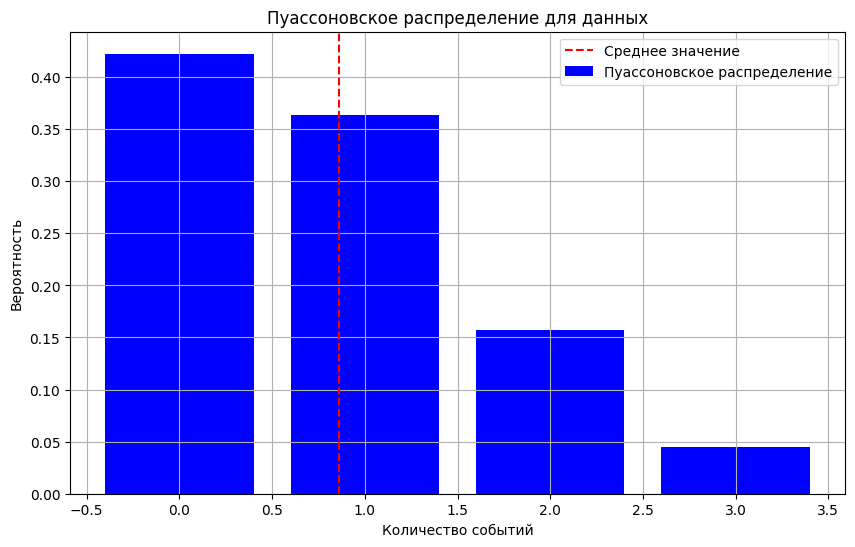

In [ ]:
plt.figure(figsize=(10, 6))
plt.bar(x, y, color='blue', label='Пуассоновское распределение')
plt.axvline(mu, color='red', linestyle='dashed', label='Среднее значение')
plt.xlabel('Количество событий')
plt.ylabel('Вероятность')
plt.title('Пуассоновское распределение для данных')
plt.legend()
plt.grid(True)
plt.show()

## Визуализация

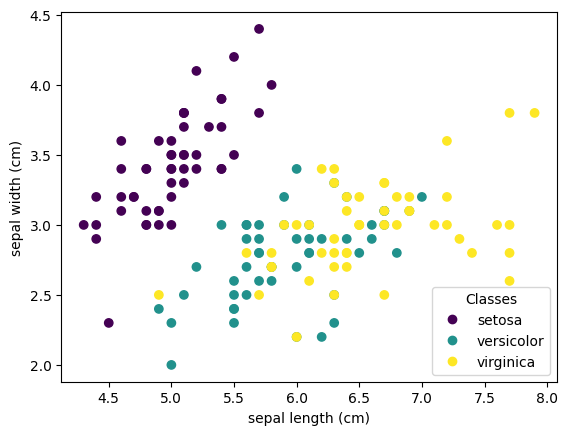

In [ ]:
import matplotlib.pyplot as plt

_, ax = plt.subplots()
scatter = ax.scatter(iris.data[:, 0], iris.data[:, 1], c=iris.target)
ax.set(xlabel=iris.feature_names[0], ylabel=iris.feature_names[1])
_ = ax.legend(scatter.legend_elements()[0], iris.target_names, loc="lower right", title="Classes")

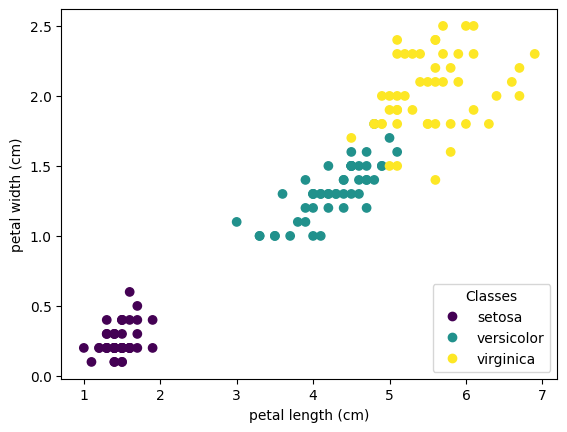

In [ ]:
_, ax = plt.subplots()
scatter = ax.scatter(iris.data[:, 2], iris.data[:, 3], c=iris.target)
ax.set(xlabel=iris.feature_names[2], ylabel=iris.feature_names[3])
_ = ax.legend(scatter.legend_elements()[0], iris.target_names, loc="lower right", title="Classes")

## PCA

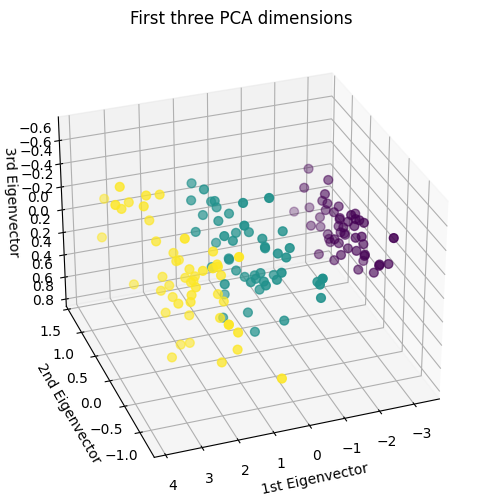

In [ ]:
import mpl_toolkits.mplot3d

from sklearn.decomposition import PCA

fig = plt.figure(1, figsize=(8, 6))
ax = fig.add_subplot(111, projection="3d", elev=-150, azim=110)

X_reduced = PCA(n_components=3).fit_transform(iris.data)
ax.scatter(
    X_reduced[:, 0],
    X_reduced[:, 1],
    X_reduced[:, 2],
    c=iris.target,
    s=40,
)

ax.set_title("First three PCA dimensions")
ax.set_xlabel("1st Eigenvector")
# Добавляем разметку по оси X
ax.xaxis.set_tick_params(labelbottom=True)
ax.set_ylabel("2nd Eigenvector")
# Добавляем разметку по оси Y
ax.yaxis.set_tick_params(labelleft=True)
ax.set_zlabel("3rd Eigenvector")
# Добавляем разметку по оси Z
ax.zaxis.set_tick_params(labelright=True)

plt.show()


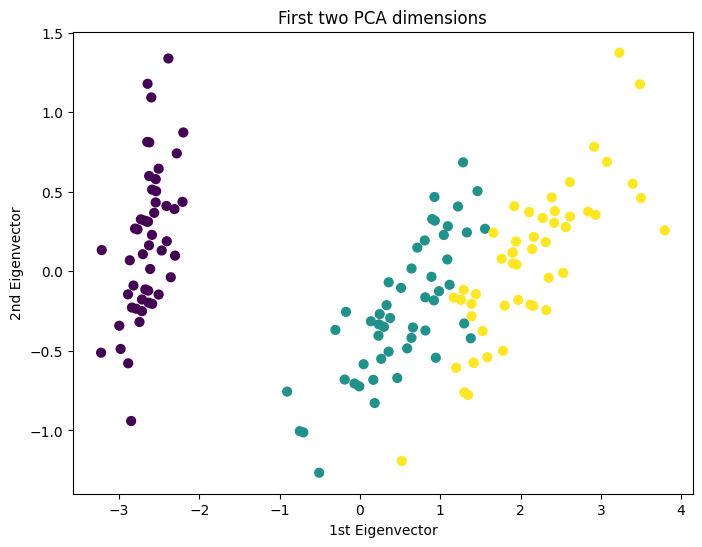

In [ ]:
fig = plt.figure(1, figsize=(8, 6))
ax = fig.add_subplot(111)
ax.scatter(
    X_reduced[:, 0],
    X_reduced[:, 1],
    c=iris.target,
    s=40,
)

ax.set_title("First two PCA dimensions")
ax.set_xlabel("1st Eigenvector")
# Добавляем разметку по оси X
ax.xaxis.set_tick_params(labelbottom=True)
ax.set_ylabel("2nd Eigenvector")
# Добавляем разметку по оси Y
ax.yaxis.set_tick_params(labelleft=True)

plt.show()

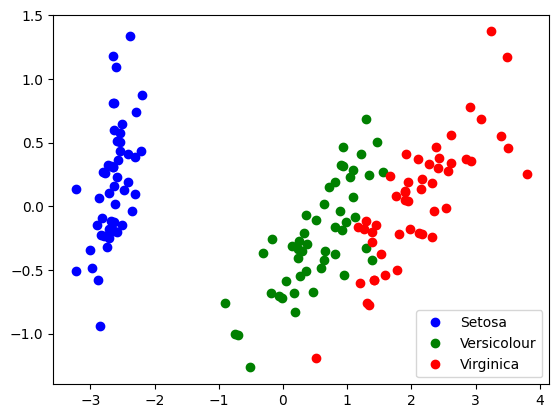

In [ ]:
# PCA 2 ГК
pca = PCA(n_components=2)
X_centered = X - X.mean(axis=0)
pca.fit(X_centered)
X_pca = pca.transform(X_centered)

# И нарисуем получившиеся точки в нашем новом пространстве
plt.plot(X_pca[y == 0, 0], X_pca[y == 0, 1], 'bo', label='Setosa')
plt.plot(X_pca[y == 1, 0], X_pca[y == 1, 1], 'go', label='Versicolour')
plt.plot(X_pca[y == 2, 0], X_pca[y == 2, 1], 'ro', label='Virginica')
plt.legend(loc=0);

## 1-й класс (Setosa)

In [ ]:
# setosa
iris1 = iris.data[0:50]

### PCA 1-й класс

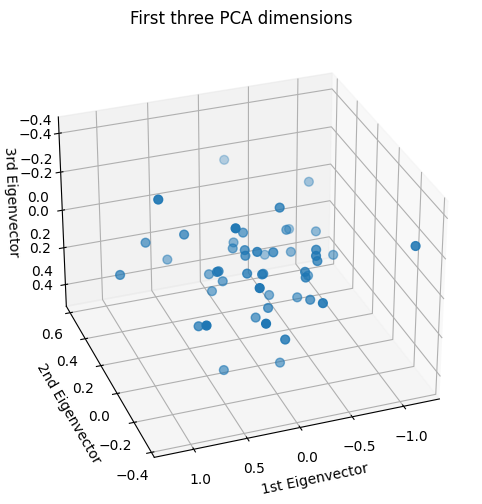

In [ ]:
import mpl_toolkits.mplot3d

from sklearn.decomposition import PCA

fig = plt.figure(1, figsize=(8, 6))
ax = fig.add_subplot(111, projection="3d", elev=-150, azim=110)

X_reduced1 = PCA(n_components=3).fit_transform(iris1)
ax.scatter(
    X_reduced1[:, 0],
    X_reduced1[:, 1],
    X_reduced1[:, 2],
    s=40,
)

ax.set_title("First three PCA dimensions")
ax.set_xlabel("1st Eigenvector")
# Добавляем разметку по оси X
ax.xaxis.set_tick_params(labelbottom=True)
ax.set_ylabel("2nd Eigenvector")
# Добавляем разметку по оси Y
ax.yaxis.set_tick_params(labelleft=True)
ax.set_zlabel("3rd Eigenvector")
# Добавляем разметку по оси Z
ax.zaxis.set_tick_params(labelright=True)

plt.show()

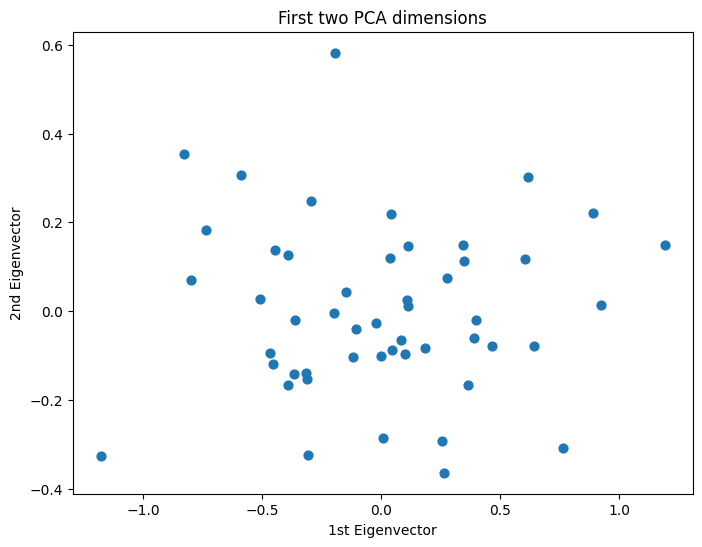

In [ ]:
# PCA 2 ГК

fig = plt.figure(1, figsize=(8, 6))
ax = fig.add_subplot(111)
ax.scatter(
    X_reduced1[:, 0],
    X_reduced1[:, 1],
    s=40,
)

ax.set_title("First two PCA dimensions")
ax.set_xlabel("1st Eigenvector")
# Добавляем разметку по оси X
ax.xaxis.set_tick_params(labelbottom=True)
ax.set_ylabel("2nd Eigenvector")
# Добавляем разметку по оси Y
ax.yaxis.set_tick_params(labelleft=True)

plt.show()

### Вычисление расстояний между точками

In [ ]:
def distance(point1, point2):
  # Вычисление расстояния по Евклиду
  return np.sqrt(np.sum((point1 - point2)**2))

# Инициализация матрицы расстояний
distances1 = np.zeros((len(iris1), len(iris1)))

# Вычисление расстояния между каждой точкой и каждой другой точкой
for i in range(len(iris1)):
  for j in range(len(iris1)):
    if i != j:
      distances1[i, j] = distance(iris1[i], iris1[j])

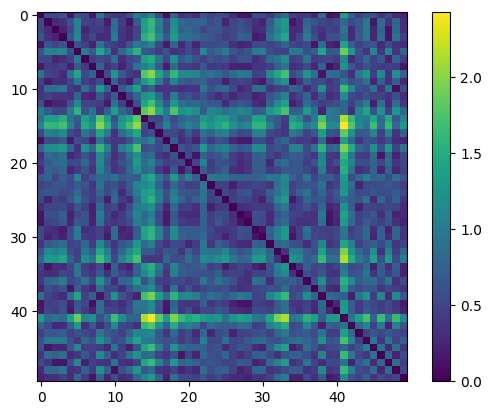

In [ ]:
# Визуализация матрицы расстояний с помощью тепловой карты
plt.imshow(distances1, cmap='viridis')
plt.colorbar()
plt.show()

In [ ]:
# Среднее по всем расстояниям:

# Вычислите сумму всех расстояний
total_distance1 = np.sum(distances1)

# Количество элементов (не считая диагональных)
n_elements = len(distances1) * (len(distances1) - 1)

# Рассчитайте среднее расстояние
average_distance1 = total_distance1 / n_elements

print(average_distance1)

0.6968168790839047


In [ ]:
# Вычислите среднее расстояние от каждой точки
average_distances_from_each_point1 = np.mean(distances1, axis=0)
print(average_distances_from_each_point1)

[0.49978732 0.62208177 0.6038146  0.66166759 0.51924061 0.7917735
 0.62209878 0.48460001 0.87632637 0.5824163  0.65227878 0.54001533
 0.65102813 0.97991428 1.07929989 1.242005   0.78053884 0.50139256
 0.91288508 0.60422886 0.66238184 0.57475434 0.80579682 0.61866797
 0.68647375 0.63920719 0.52725825 0.52038311 0.52494446 0.59912239
 0.59933726 0.63748568 0.8339856  0.98774056 0.5644557  0.59378095
 0.70410606 0.55439906 0.83866547 0.49288723 0.52311141 1.28790412
 0.77777717 0.62579055 0.76071603 0.64050728 0.6185311  0.63124141
 0.604882   0.50033869]


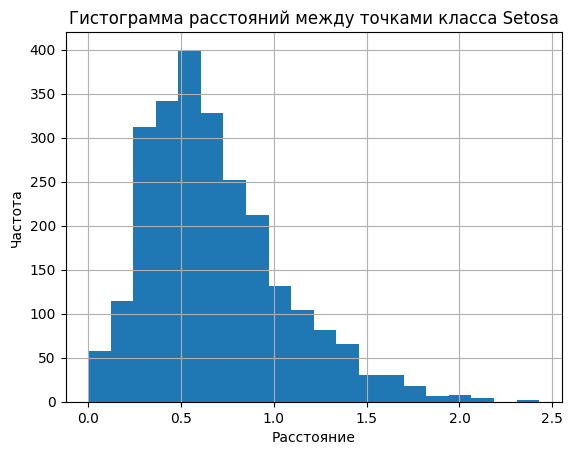

In [ ]:
# Преобразуйте distances в одномерный массив
distances1_1D = distances1.flatten()

# Определите диапазон значений
min_distance = np.min(distances1_1D)
max_distance = np.max(distances1_1D)

# Выберите количество интервалов
n_bins = 20


# Построение гистограммы
plt.hist(distances1_1D, bins=n_bins, range=(min_distance, max_distance))

# Настройка оформления
plt.xlabel("Расстояние")
plt.ylabel("Частота")
plt.title("Гистограмма расстояний между точками класса Setosa")
plt.grid(True)
plt.show()

Наиболее частое значение: 0.48579831205964485


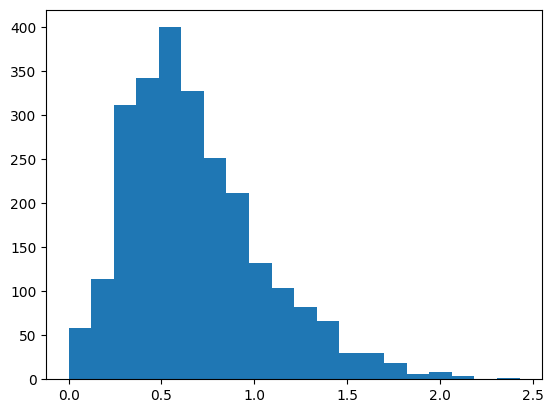

In [ ]:
# Извлечение данных из объекта Axes
counts, bins, patches = plt.hist(distances1_1D, bins=n_bins, range=(min_distance, max_distance))

# Определение наиболее частого диапазона
most_frequent_index = np.argmax(counts)

print("Наиболее частое значение:", bins[most_frequent_index])

### Расстояние по каждой оси

#### 1-й признак (длина чашелистика)

In [ ]:
first_column1 = np.take(iris1, 0, axis=1)
first_column1

array([5.1, 4.9, 4.7, 4.6, 5. , 5.4, 4.6, 5. , 4.4, 4.9, 5.4, 4.8, 4.8,
       4.3, 5.8, 5.7, 5.4, 5.1, 5.7, 5.1, 5.4, 5.1, 4.6, 5.1, 4.8, 5. ,
       5. , 5.2, 5.2, 4.7, 4.8, 5.4, 5.2, 5.5, 4.9, 5. , 5.5, 4.9, 4.4,
       5.1, 5. , 4.5, 4.4, 5. , 5.1, 4.8, 5.1, 4.6, 5.3, 5. ])

In [ ]:
print('min:', np.min(first_column1))
print('max:', np.max(first_column1))

min: 4.3
max: 5.8


In [ ]:
((np.max(first_column1)+1)-(np.min(first_column1)-1))/0.2

17.5

In [ ]:
def distance(point1, point2):
  # Вычисление расстояния по Евклиду
  return np.sqrt(np.sum((point1 - point2)**2))

# Инициализация матрицы расстояний
ds11 = np.zeros((len(first_column1), len(first_column1)))

# Вычисление расстояния между каждой точкой и каждой другой точкой
for i in range(len(first_column1)):
  for j in range(len(first_column1)):
    if i != j:
      ds11[i, j] = distance(first_column1[i], first_column1[j])

In [ ]:
# Среднее по всем расстояниям:

# Вычислите сумму всех расстояний
total_11 = np.sum(ds11)

# Количество элементов (не считая диагональных)
n_elements = len(ds11) * (len(ds11) - 1)

# Рассчитайте среднее расстояние
av_ds11 = total_11 / n_elements

print(av_ds11)

0.40040816326530615


Наиболее частое значение: 0.075


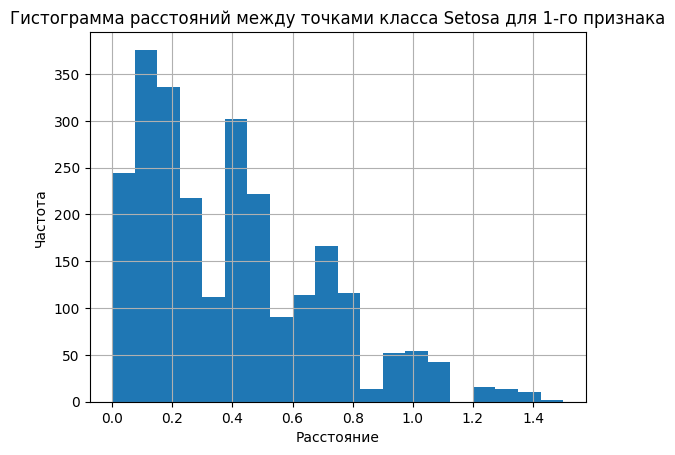

In [ ]:
# Преобразуйте distances в одномерный массив
ds11_1D = ds11.flatten()

# Определите диапазон значений
min_distance = np.min(ds11_1D)
max_distance = np.max(ds11_1D)

# Выберите количество интервалов
n_bins = 20


# Построение гистограммы
counts, bins, patches = plt.hist(ds11_1D, bins=n_bins, range=(min_distance, max_distance))
# Определение наиболее частого диапазона
most_frequent_index = np.argmax(counts)

print("Наиболее частое значение:", bins[most_frequent_index])

# Настройка оформления
plt.xlabel("Расстояние")
plt.ylabel("Частота")
plt.title("Гистограмма расстояний между точками класса Setosa для 1-го признака")
plt.grid(True)
plt.show()

#### 2-й признак (ширина чашелистика)

In [ ]:
second_column1 = np.take(iris1, 1, axis=1)
second_column1

array([3.5, 3. , 3.2, 3.1, 3.6, 3.9, 3.4, 3.4, 2.9, 3.1, 3.7, 3.4, 3. ,
       3. , 4. , 4.4, 3.9, 3.5, 3.8, 3.8, 3.4, 3.7, 3.6, 3.3, 3.4, 3. ,
       3.4, 3.5, 3.4, 3.2, 3.1, 3.4, 4.1, 4.2, 3.1, 3.2, 3.5, 3.6, 3. ,
       3.4, 3.5, 2.3, 3.2, 3.5, 3.8, 3. , 3.8, 3.2, 3.7, 3.3])

In [ ]:
print('min:', np.min(second_column1))
print('max:', np.max(second_column1))

min: 2.3
max: 4.4


In [ ]:
((np.max(second_column1)+1)-(np.min(second_column1)-1))/0.2

20.5

In [ ]:
# Инициализация матрицы расстояний
ds12 = np.zeros((len(second_column1), len(second_column1)))

# Вычисление расстояния между каждой точкой и каждой другой точкой
for i in range(len(second_column1)):
  for j in range(len(second_column1)):
    if i != j:
      ds12[i, j] = distance(second_column1[i], second_column1[j])

In [ ]:
# Среднее по всем расстояниям:

# Вычислите сумму всех расстояний
total_12 = np.sum(ds12)

# Количество элементов (не считая диагональных)
n_elements = len(ds12) * (len(ds12) - 1)

# Рассчитайте среднее расстояние
av_ds12 = total_12 / n_elements

print(av_ds12)

0.4208979591836734


Наиболее частое значение: 0.0


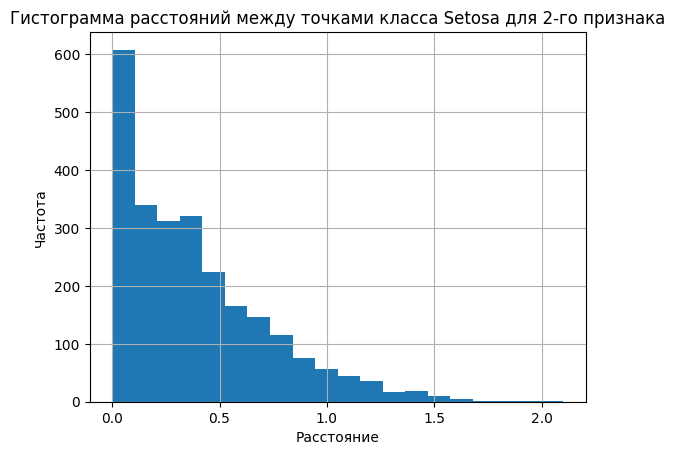

In [ ]:
# Преобразуйте distances в одномерный массив
ds12_1D = ds12.flatten()

# Определите диапазон значений
min_distance = np.min(ds12_1D)
max_distance = np.max(ds12_1D)

# Выберите количество интервалов
n_bins = 20


# Построение гистограммы
counts, bins, patches = plt.hist(ds12_1D, bins=n_bins, range=(min_distance, max_distance))
# Определение наиболее частого диапазона
most_frequent_index = np.argmax(counts)

print("Наиболее частое значение:", bins[most_frequent_index])

# Настройка оформления
plt.xlabel("Расстояние")
plt.ylabel("Частота")
plt.title("Гистограмма расстояний между точками класса Setosa для 2-го признака")
plt.grid(True)
plt.show()

#### 3-й признак (длина лепестка)

In [ ]:
thr_column1 = np.take(iris1, 2, axis=1)
thr_column1

array([1.4, 1.4, 1.3, 1.5, 1.4, 1.7, 1.4, 1.5, 1.4, 1.5, 1.5, 1.6, 1.4,
       1.1, 1.2, 1.5, 1.3, 1.4, 1.7, 1.5, 1.7, 1.5, 1. , 1.7, 1.9, 1.6,
       1.6, 1.5, 1.4, 1.6, 1.6, 1.5, 1.5, 1.4, 1.5, 1.2, 1.3, 1.4, 1.3,
       1.5, 1.3, 1.3, 1.3, 1.6, 1.9, 1.4, 1.6, 1.4, 1.5, 1.4])

In [ ]:
print('min:', np.min(thr_column1))
print('max:', np.max(thr_column1))

((np.max(thr_column1)+1)-(np.min(thr_column1)-1))/0.2

min: 1.0
max: 1.9


14.499999999999998

In [ ]:
# Инициализация матрицы расстояний
ds13 = np.zeros((len(thr_column1), len(thr_column1)))

# Вычисление расстояния между каждой точкой и каждой другой точкой
for i in range(len(thr_column1)):
  for j in range(len(thr_column1)):
    if i != j:
      ds13[i, j] = distance(thr_column1[i], thr_column1[j])

In [ ]:
# Среднее по всем расстояниям:

# Вычислите сумму всех расстояний
total_13 = np.sum(ds13)

# Количество элементов (не считая диагональных)
n_elements = len(ds13) * (len(ds13) - 1)

# Рассчитайте среднее расстояние
av_ds13 = total_13 / n_elements

print(av_ds13)

0.18930612244897962


Наиболее частое значение: 0.09


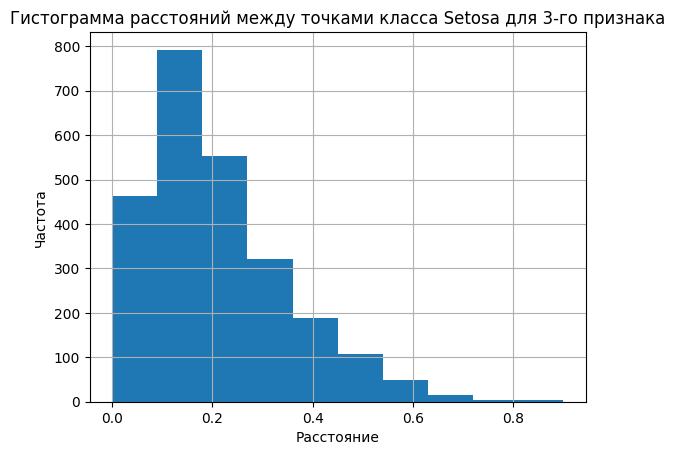

In [ ]:
# Преобразуйте distances в одномерный массив
ds13_1D = ds13.flatten()

# Определите диапазон значений
min_distance = np.min(ds13_1D)
max_distance = np.max(ds13_1D)

# Выберите количество интервалов
n_bins = 10


# Построение гистограммы
counts, bins, patches = plt.hist(ds13_1D, bins=n_bins, range=(min_distance, max_distance))
# Определение наиболее частого диапазона
most_frequent_index = np.argmax(counts)

print("Наиболее частое значение:", bins[most_frequent_index])

# Настройка оформления
plt.xlabel("Расстояние")
plt.ylabel("Частота")
plt.title("Гистограмма расстояний между точками класса Setosa для 3-го признака")
plt.grid(True)
plt.show()

#### 4-й признак (ширина лепестка)

In [ ]:
fourth_column1 = np.take(iris1, 3, axis=1)
fourth_column1

array([0.2, 0.2, 0.2, 0.2, 0.2, 0.4, 0.3, 0.2, 0.2, 0.1, 0.2, 0.2, 0.1,
       0.1, 0.2, 0.4, 0.4, 0.3, 0.3, 0.3, 0.2, 0.4, 0.2, 0.5, 0.2, 0.2,
       0.4, 0.2, 0.2, 0.2, 0.2, 0.4, 0.1, 0.2, 0.2, 0.2, 0.2, 0.1, 0.2,
       0.2, 0.3, 0.3, 0.2, 0.6, 0.4, 0.3, 0.2, 0.2, 0.2, 0.2])

In [ ]:
print('min:', np.min(fourth_column1))
print('max:', np.max(fourth_column1))

((np.max(fourth_column1)+1)-(np.min(fourth_column1)-1))/0.2

min: 0.1
max: 0.6


12.5

In [ ]:
# Инициализация матрицы расстояний
ds14 = np.zeros((len(fourth_column1), len(fourth_column1)))

# Вычисление расстояния между каждой точкой и каждой другой точкой
for i in range(len(fourth_column1)):
  for j in range(len(fourth_column1)):
    if i != j:
      ds14[i, j] = distance(fourth_column1[i], fourth_column1[j])

In [ ]:
# Среднее по всем расстояниям:

# Вычислите сумму всех расстояний
total_14 = np.sum(ds14)

# Количество элементов (не считая диагональных)
n_elements = len(ds14) * (len(ds14) - 1)

# Рассчитайте среднее расстояние
av_ds14 = total_14 / n_elements

print(av_ds14)

0.10473469387755104


Наиболее частое значение: 0.0


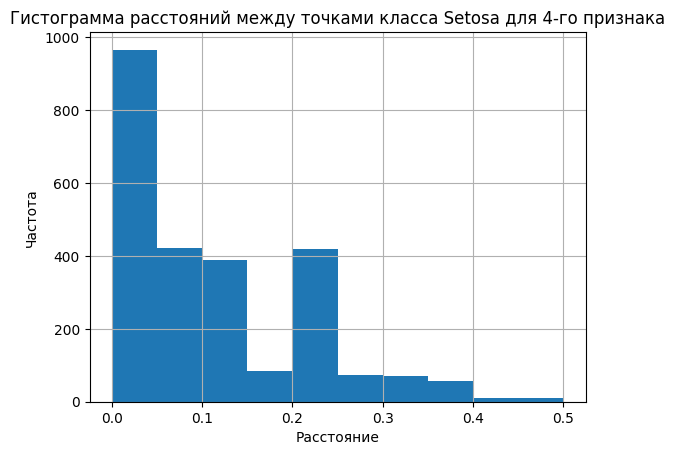

In [ ]:
# Преобразуйте distances в одномерный массив
ds14_1D = ds14.flatten()

# Определите диапазон значений
min_distance = np.min(ds14_1D)
max_distance = np.max(ds14_1D)

# Выберите количество интервалов
n_bins = 10


# Построение гистограммы
counts, bins, patches = plt.hist(ds14_1D, bins=n_bins, range=(min_distance, max_distance))
# Определение наиболее частого диапазона
most_frequent_index = np.argmax(counts)

print("Наиболее частое значение:", bins[most_frequent_index])

# Настройка оформления
plt.xlabel("Расстояние")
plt.ylabel("Частота")
plt.title("Гистограмма расстояний между точками класса Setosa для 4-го признака")
plt.grid(True)
plt.show()

### Обучение AE

In [ ]:
#### Обучение Автокодировщика
size = iris1.shape[1]
patience = 4000
verbose_show = True
ae_ir111 = tensorflow.keras.models.Sequential()

# input layer
ae_ir111.add(tensorflow.keras.layers.Dense(size))
ae_ir111.add(tensorflow.keras.layers.Activation('tanh'))

# hidden layers
ae_ir111.add(tensorflow.keras.layers.Dense(100))
ae_ir111.add(tensorflow.keras.layers.Activation('tanh'))
ae_ir111.add(tensorflow.keras.layers.Dense(50))
ae_ir111.add(tensorflow.keras.layers.Activation('tanh'))
ae_ir111.add(tensorflow.keras.layers.Dense(30))
ae_ir111.add(tensorflow.keras.layers.Activation('tanh'))
ae_ir111.add(tensorflow.keras.layers.Dense(3))
ae_ir111.add(tensorflow.keras.layers.Activation('tanh'))
ae_ir111.add(tensorflow.keras.layers.Dense(30))
ae_ir111.add(tensorflow.keras.layers.Activation('tanh'))
ae_ir111.add(tensorflow.keras.layers.Dense(50))
ae_ir111.add(tensorflow.keras.layers.Activation('tanh'))
ae_ir111.add(tensorflow.keras.layers.Dense(100))
ae_ir111.add(tensorflow.keras.layers.Activation('tanh'))

# output layer
ae_ir111.add(tensorflow.keras.layers.Dense(size))
ae_ir111.add(tensorflow.keras.layers.Activation('linear'))

optimizer = tensorflow.keras.optimizers.Adam(learning_rate=0.001, beta_1=0.9, beta_2=0.999, amsgrad=False)
ae_ir111.compile(loss='mean_squared_error', optimizer=optimizer)
error_stop = 0.0001
epo = 5000

early_stopping_callback_on_error = EarlyStoppingOnValue(monitor='loss', baseline=error_stop)
early_stopping_callback_on_improving = tensorflow.keras.callbacks.EarlyStopping(monitor='loss',
                                                                                           min_delta=0.0001, patience = patience,
                                                                                           verbose=1, mode='auto',
                                                                                           baseline=None,
                                                                                           restore_best_weights=False)

history_callback = tensorflow.keras.callbacks.History()
verbose = 1 if verbose_show else 0
history_object = ae_ir111.fit(iris1, iris1,
                                batch_size=20,
                                epochs=epo,
                                callbacks=[early_stopping_callback_on_error, history_callback,
                                early_stopping_callback_on_improving],
                                verbose=verbose)
ae_ir1_trainned = ae_ir111
ae_ir1_pred = ae_ir1_trainned.predict(iris1)
ae_ir1_trainned.save('out/AE_ir1.h5')

Выходные данные были обрезаны до нескольких последних строк (5000).
Epoch 2502/5000
3/3 [==============================] - 0s 9ms/step - loss: 0.0025
Epoch 2503/5000
3/3 [==============================] - 0s 12ms/step - loss: 0.0025
Epoch 2504/5000
3/3 [==============================] - 0s 9ms/step - loss: 0.0026
Epoch 2505/5000
3/3 [==============================] - 0s 10ms/step - loss: 0.0028
Epoch 2506/5000
3/3 [==============================] - 0s 9ms/step - loss: 0.0027
Epoch 2507/5000
3/3 [==============================] - 0s 10ms/step - loss: 0.0025
Epoch 2508/5000
3/3 [==============================] - 0s 9ms/step - loss: 0.0031
Epoch 2509/5000
3/3 [==============================] - 0s 11ms/step - loss: 0.0029
Epoch 2510/5000
3/3 [==============================] - 0s 9ms/step - loss: 0.0028
Epoch 2511/5000
3/3 [==============================] - 0s 12ms/step - loss: 0.0027
Epoch 2512/5000
3/3 [==============================] - 0s 10ms/step - loss: 0.0026
Epoch 2513/5000
3/3 [===

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [ ]:
# Сохранение AE
ae_ir111.save('best_model_for_ir1')

In [ ]:
# Сохранение 2-го AE
ae_ir111.save('best_model2_for_ir1')

In [ ]:
# Сохранение 3-го AE
ae_ir111.save('best_model3_for_ir1')

In [ ]:
# Загрузка автокодировщика
from keras.models import load_model
ae_ir1 = load_model('best_model_for_ir1')

ae_ir1_trainned = ae_ir1
ae_ir1_pred = ae_ir1_trainned.predict(iris1)
ae_ir1_trainned.save('out/AE_ir1.h5')

2/2 [==============================] - 0s 15ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [ ]:
# Загрузка 2го автокодировщика
from keras.models import load_model
ae_ir1 = load_model('best_model2_for_ir1')

ae_ir1_trainned = ae_ir1
ae_ir1_pred = ae_ir1_trainned.predict(iris1)
ae_ir1_trainned.save('out/AE_ir1.h5')

2/2 [==============================] - 0s 7ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [ ]:
# Загрузка 3го автокодировщика
from keras.models import load_model
ae_ir1 = load_model('best_model3_for_ir1')

ae_ir1_trainned = ae_ir1
ae_ir1_pred = ae_ir1_trainned.predict(iris1)
ae_ir1_trainned.save('out/AE_ir1.h5')

2/2 [==============================] - 0s 11ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [ ]:
iris1

array([[5.1, 3.5, 1.4, 0.2],
       [4.9, 3. , 1.4, 0.2],
       [4.7, 3.2, 1.3, 0.2],
       [4.6, 3.1, 1.5, 0.2],
       [5. , 3.6, 1.4, 0.2],
       [5.4, 3.9, 1.7, 0.4],
       [4.6, 3.4, 1.4, 0.3],
       [5. , 3.4, 1.5, 0.2],
       [4.4, 2.9, 1.4, 0.2],
       [4.9, 3.1, 1.5, 0.1],
       [5.4, 3.7, 1.5, 0.2],
       [4.8, 3.4, 1.6, 0.2],
       [4.8, 3. , 1.4, 0.1],
       [4.3, 3. , 1.1, 0.1],
       [5.8, 4. , 1.2, 0.2],
       [5.7, 4.4, 1.5, 0.4],
       [5.4, 3.9, 1.3, 0.4],
       [5.1, 3.5, 1.4, 0.3],
       [5.7, 3.8, 1.7, 0.3],
       [5.1, 3.8, 1.5, 0.3],
       [5.4, 3.4, 1.7, 0.2],
       [5.1, 3.7, 1.5, 0.4],
       [4.6, 3.6, 1. , 0.2],
       [5.1, 3.3, 1.7, 0.5],
       [4.8, 3.4, 1.9, 0.2],
       [5. , 3. , 1.6, 0.2],
       [5. , 3.4, 1.6, 0.4],
       [5.2, 3.5, 1.5, 0.2],
       [5.2, 3.4, 1.4, 0.2],
       [4.7, 3.2, 1.6, 0.2],
       [4.8, 3.1, 1.6, 0.2],
       [5.4, 3.4, 1.5, 0.4],
       [5.2, 4.1, 1.5, 0.1],
       [5.5, 4.2, 1.4, 0.2],
       [4.9, 3

In [ ]:
ae_ir1_pred

array([[5.087571  , 3.5013664 , 1.4209286 , 0.24105327],
       [4.89555   , 2.9872987 , 1.4124829 , 0.19089223],
       [4.6917205 , 3.1897497 , 1.3019291 , 0.21998508],
       [4.5938144 , 3.101025  , 1.5100232 , 0.20145942],
       [5.0035067 , 3.5933988 , 1.4108032 , 0.23019175],
       [5.39183   , 3.9010975 , 1.6996045 , 0.40197027],
       [4.598055  , 3.394064  , 1.4015099 , 0.2798335 ],
       [4.999145  , 3.3896167 , 1.4844142 , 0.1723157 ],
       [4.394268  , 2.9007185 , 1.4101717 , 0.2036214 ],
       [4.892671  , 3.1254268 , 1.4858323 , 0.14448205],
       [5.408252  , 3.6989796 , 1.5111251 , 0.21846834],
       [4.7944703 , 3.4037619 , 1.6033459 , 0.20058756],
       [4.7880025 , 2.995341  , 1.4047965 , 0.10041542],
       [4.2933517 , 2.9987016 , 1.1049241 , 0.10111597],
       [5.797207  , 3.9976962 , 1.1989757 , 0.20533657],
       [5.696797  , 4.40132   , 1.5003566 , 0.40609688],
       [5.400772  , 3.8996942 , 1.2915058 , 0.40051544],
       [5.0882983 , 3.5195782 ,

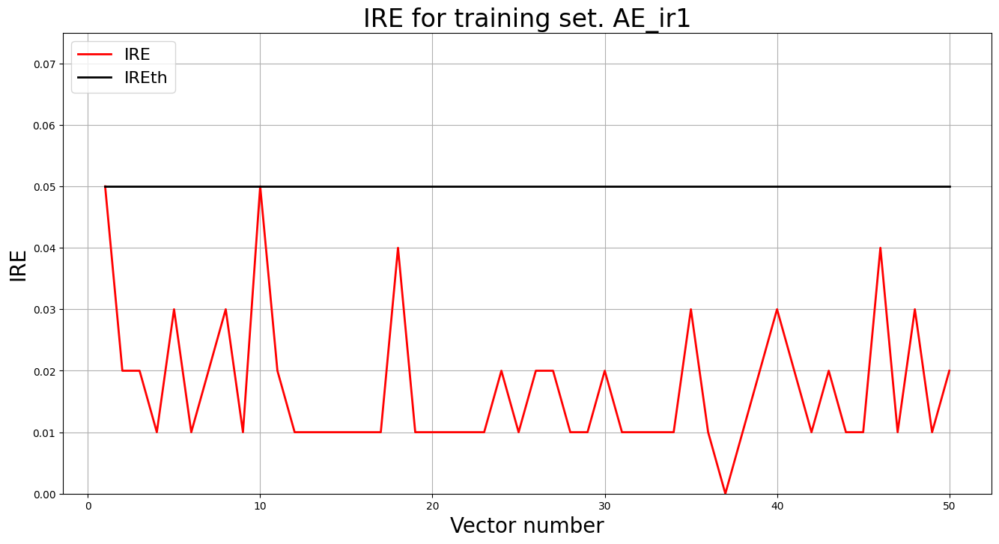

In [ ]:
# Ошибка реконструкции
irefile = 'out/AE_ir1_ire_th.txt'
IRE_array = np.round(ire_array(iris1, ae_ir1_pred), 2)
IREth = np.amax(IRE_array)
with open(irefile, 'w') as file:
    file.write(str(IREth))

IREir1 = IRE_array
IREth_ir1 = IREth

lib.ire_plot('training', IREir1, IREth, 'AE_ir1')

In [ ]:
IREth_ir1

0.05

In [ ]:
# Вычисление деф. множества
numb_square = 80

Z1, X_def1, X_plot, xx, yy, zz, ff = eli.prediction(numb_square, X, ae_ir1_trainned, IREth_ir1)

h_x=  0.12250000000000001
h_y=  0.12250000000000001
h_z=  0.12250000000000001
h_f=  0.12250000000000001
    161/1280000 [..............................] - ETA: 1:16:58

KeyboardInterrupt: 

In [ ]:
X_def1

array([[4.5, 2.3, 1.3, 0.3],
       [4.3, 2.7, 1.3, 0.3],
       [4.3, 2.9, 1.1, 0.1],
       [5.1, 2.9, 1.7, 0.3],
       [4.9, 3.1, 1.5, 0.1],
       [5.1, 3.1, 1.7, 0.3],
       [5.3, 3.1, 1.5, 0.5],
       [4.5, 3.3, 1.3, 0.3],
       [4.5, 3.3, 1.5, 0.3],
       [4.7, 3.3, 1.7, 0.1],
       [5.1, 3.3, 1.7, 0.5],
       [4.7, 3.5, 1.3, 0.3],
       [4.9, 3.5, 1.3, 0.3],
       [4.9, 3.5, 1.9, 0.1],
       [5.1, 3.5, 1.3, 0.3],
       [5.1, 3.7, 1.9, 0.3],
       [5.3, 3.7, 1.7, 0.5],
       [5.1, 3.9, 1.9, 0.3],
       [5.3, 3.9, 1.3, 0.3],
       [5.3, 4.1, 1.3, 0.1],
       [5.7, 4.1, 1.3, 0.3],
       [5.3, 4.3, 1.5, 0.3]])

In [ ]:
X_def1.shape

(3406, 4)

In [ ]:
X_plot

array([[-0.9, -0.9, -0.9, -0.9],
       [-0.9, -0.9, -0.9, -0.7],
       [-0.9, -0.9, -0.9, -0.5],
       ...,
       [ 8.7,  8.7,  8.7,  8.3],
       [ 8.7,  8.7,  8.7,  8.5],
       [ 8.7,  8.7,  8.7,  8.7]])

In [ ]:
X_plot.shape

(16, 4)

In [ ]:
np.savetxt('X_def1.txt', X_def1)

In [ ]:
# Загрузка датасета

with open('/content/drive/My Drive/Colab Notebooks/X_def1.txt', 'r') as f:
    X_def1 = np.loadtxt(f)
X_def1

array([[4.31818182, 2.12      , 1.26545455, 0.28181818],
       [4.38181818, 2.12      , 1.26545455, 0.28181818],
       [4.25454545, 2.19454545, 1.21272727, 0.32727273],
       ...,
       [5.78181818, 4.43090909, 1.52909091, 0.37272727],
       [5.78181818, 4.43090909, 1.58181818, 0.37272727],
       [5.78181818, 4.43090909, 1.63454545, 0.37272727]])

### Граница АЕ

In [ ]:
# Объедините массивы по столбцам
combined_data1 = np.concatenate([iris1, X_def1])

In [ ]:
combined_data1

array([[5.1       , 3.5       , 1.4       , 0.2       ],
       [4.9       , 3.        , 1.4       , 0.2       ],
       [4.7       , 3.2       , 1.3       , 0.2       ],
       ...,
       [5.78181818, 4.43090909, 1.52909091, 0.37272727],
       [5.78181818, 4.43090909, 1.58181818, 0.37272727],
       [5.78181818, 4.43090909, 1.63454545, 0.37272727]])

In [ ]:
combined_data1.shape

(3456, 4)

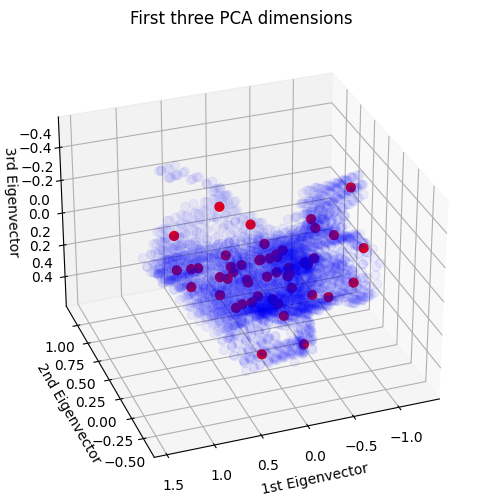

In [ ]:
# PCA 3 ГК
import mpl_toolkits.mplot3d

from sklearn.decomposition import PCA



fig = plt.figure(1, figsize=(8, 6))
ax = fig.add_subplot(111, projection="3d", elev=-150, azim=110)


X_combo1 = PCA(n_components=3).fit_transform(combined_data1.data)

ax.scatter(
    X_combo1[0:50, 0],
    X_combo1[0:50, 1],
    X_combo1[0:50, 2],
    c = 'red',
    s=40,
    alpha=1
)

ax.scatter(
    X_combo1[50:, 0],
    X_combo1[50:, 1],
    X_combo1[50:, 2],
    c = 'blue',
    s=40,
    alpha=0.05
)



ax.set_title("First three PCA dimensions")
ax.set_xlabel("1st Eigenvector")
# Добавляем разметку по оси X
ax.xaxis.set_tick_params(labelbottom=True)
ax.set_ylabel("2nd Eigenvector")
# Добавляем разметку по оси Y
ax.yaxis.set_tick_params(labelleft=True)
ax.set_zlabel("3rd Eigenvector")
# Добавляем разметку по оси Z
ax.zaxis.set_tick_params(labelright=True)

plt.show()

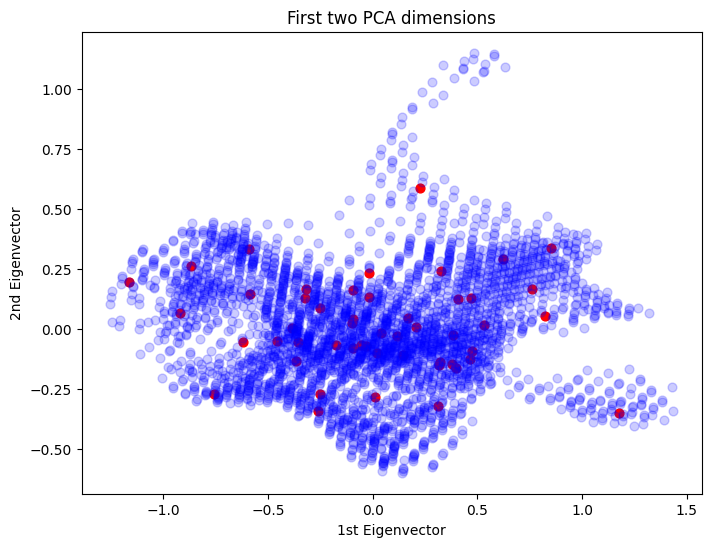

In [ ]:
# PCA 2 ГК

fig = plt.figure(1, figsize=(8, 6))
ax = fig.add_subplot(111)

ax.scatter(
    X_combo1[0:50, 0],
    X_combo1[0:50, 1],
    c = 'red',
    s=40,
    alpha=1
)

ax.scatter(
    X_combo1[50:, 0],
    X_combo1[50:, 1],
    c = 'blue',
    s=40,
    alpha=0.2
)


ax.set_title("First two PCA dimensions")
ax.set_xlabel("1st Eigenvector")
# Добавляем разметку по оси X
ax.xaxis.set_tick_params(labelbottom=True)
ax.set_ylabel("2nd Eigenvector")
# Добавляем разметку по оси Y
ax.yaxis.set_tick_params(labelleft=True)

plt.show()

### Вычисление EDCA

In [ ]:
numb_square = 15

amount, amount_ae = lib4dthelast55new.calculations(numb_square, X, iris1, X_def1, '_ir1')

min:  -0.9
max:  8.9
amount:  13
amount_ae:  37

Оценка качества AE_ir1
IDEAL = 0. Excess:  1.8461538461538463
IDEAL = 0. Deficit:  0.0
IDEAL = 1. Coating:  1.0
summa:  1.0
IDEAL = 1. Extrapolation precision (Approx):  0.3513513513513513




### График Excess

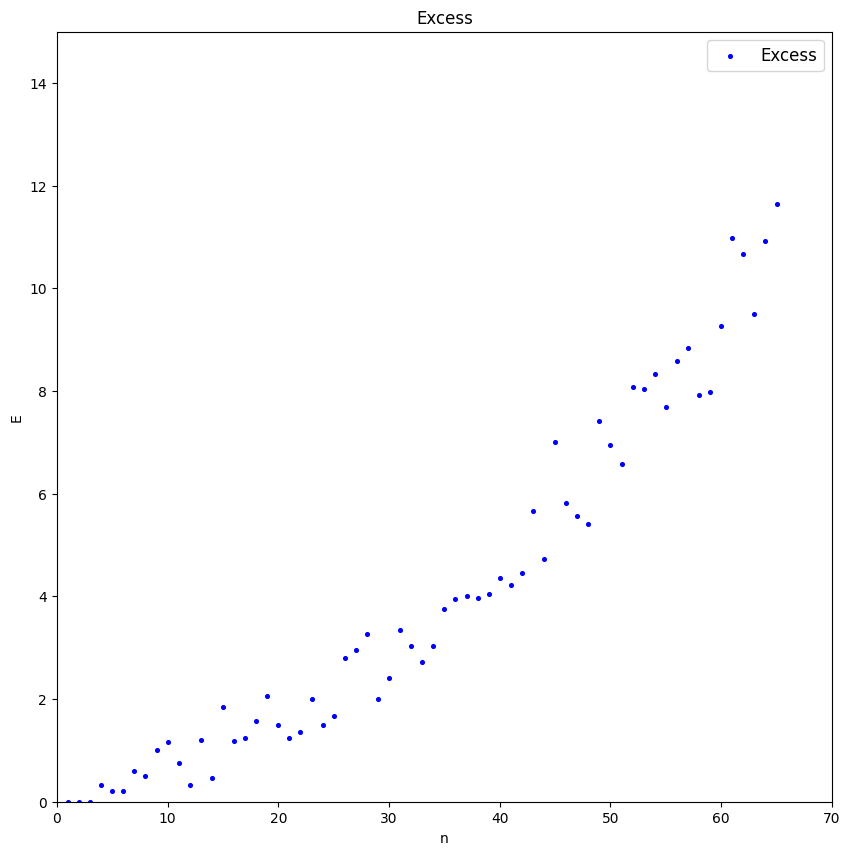

In [ ]:
Excess = [0, 0, 0, 0.3333, 0.2, 0.2, 0.6, 0.5, 1, 1.1667, 0.75, 0.3333, 1.2, 0.4615, 1.8462, 1.1765, 1.25, 1.5789, 2.0556, 1.5,
          1.25, 1.3636, 2, 1.5, 1.6774, 2.8076, 2.9643, 3.2692, 2, 2.4194, 3.3448, 3.0303, 2.7222, 3.027, 3.75, 3.9459, 4, 3.9736, 4.0513, 4.3514,
          4.2143, 4.4651, 5.6571, 4.7273, 7, 5.8182, 5.5609, 5.4091, 7.4211, 6.95, 6.5778, 8.0698, 8.0455, 8.3333, 7.6957, 8.587, 8.8372, 7.9167, 7.9783, 9.2667,
          10.9772, 10.6667, 9.5, 10.9318, 11.6522]


n = list(range(1, 66))

plt.figure(figsize=(10,10))
plt.scatter(n,Excess,marker='o',s=7,color='b',label='Excess')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.xlim([0, 70])
plt.ylim([0, 15])
plt.show()

### Среднее

In [ ]:
nn = np.arange(1,66)

av = []
for i in nn:
  av.append(np.mean(Excess[0:i]))

print(av)

[0.0, 0.0, 0.0, 0.083325, 0.10666, 0.12221666666666668, 0.19047142857142857, 0.2291625, 0.3148111111111111, 0.4, 0.4318181818181818, 0.42360833333333336, 0.4833307692307693, 0.48177142857142863, 0.5727333333333334, 0.61046875, 0.6480882352941176, 0.6998, 0.771157894736842, 0.8076000000000001, 0.8286666666666667, 0.8529818181818182, 0.9028521739130434, 0.9277333333333333, 0.9577199999999999, 1.0288692307692306, 1.1005518518518518, 1.1780035714285713, 1.206348275862069, 1.2467833333333334, 1.3144612903225807, 1.3680812500000001, 1.4091151515151517, 1.4567, 1.5222228571428573, 1.5895472222222224, 1.6546945945945948, 1.715718421052632, 1.7756051282051284, 1.8399999999999999, 1.8979097560975606, 1.959033333333333, 2.04503488372093, 2.1059954545454542, 2.2147511111111107, 2.293086956521739, 2.362614893617021, 2.426083333333333, 2.5280224489795917, 2.616462, 2.694135294117647, 2.7975134615384607, 2.8965320754716974, 2.9972129629629625, 3.082639999999999, 3.180932142857143, 3.2801649122807017,

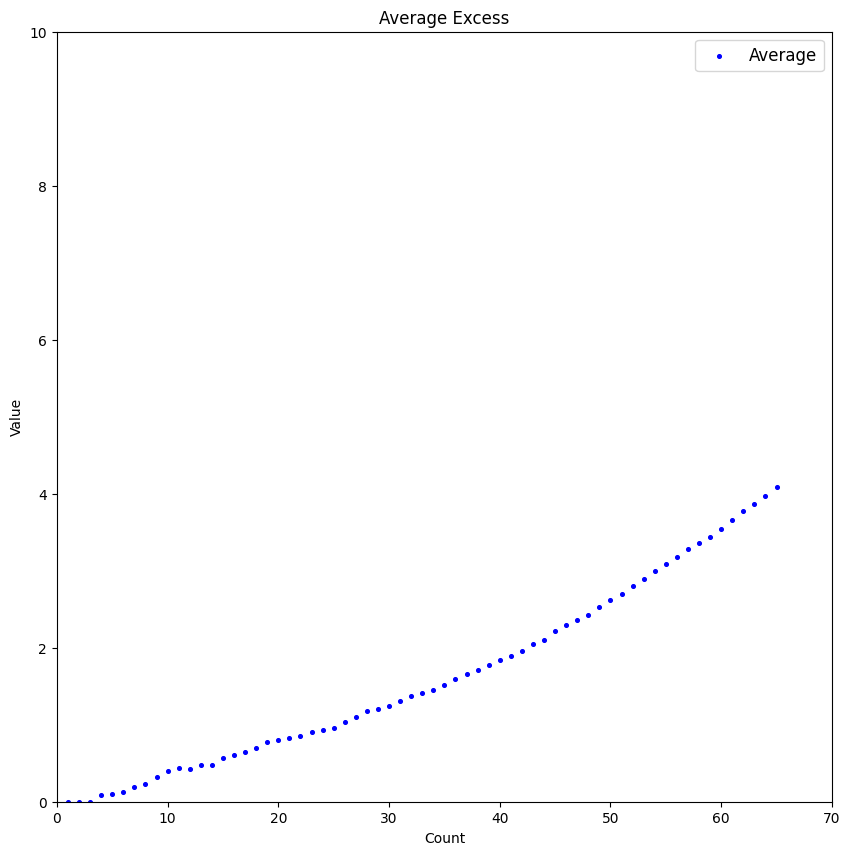

In [ ]:
plt.figure(figsize=(10,10))
plt.scatter(nn,av,marker='o',s=7,color='b',label='Average')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Average Excess')
plt.xlabel('Count')
plt.ylabel('Value')
plt.xlim([0, 70])
plt.ylim([0, 10])
plt.show()

### Аппроксимация МНК

In [ ]:
x = np.array(n)
y = np.array(Excess)

linear_func = lambda x, b0, b1: b0 + b1*x
quadratic_func = lambda x, b0, b1, b2: b0 + b1*x + b2*x**2
qubic_func = lambda x, b0, b1, b2, b3: b0 + b1*x + b2*x**2 + b3*x**3
exp_func = lambda x, b0, b1, b2: b0 + b1*np.exp(b2*x)
exp1_func = lambda x, b0, b1, b2: b0 + b1*np.exp(x-b2)
exp2_func = lambda x, b0, b1: b0*np.power(b1,x)
exp3_func = lambda x, b0, b1, b2:  b0 + b1*np.power(b2,x)


from scipy.optimize import leastsq

# list of model
model_list = [
    'linear', 'quadratic',
    'qubic', 'exp3']

# model reference
models_dict = {
        'linear':             linear_func,
        'quadratic':          quadratic_func,
        'qubic':              qubic_func,
        'exp3':               exp3_func}

# initial values
p0_dict = {
        'linear':             [0, 0],
        'quadratic':          [0, 0, 0],
        'qubic':              [0, 0, 0, 0],
        'exp3':               [0, 1, 1]}

# titles (formulas)
formulas_dict = {
        'linear':             'y = b0 + b1*x',
        'quadratic':          'y = b0 + b1*x + b2*x^2',
        'qubic':              'y = b0 + b1*x + b2*x^2 + b3*x^3',
        'exp3':               'y = b0 + b1*np.power(b2,x)'}

# actual data
X_fact = x
Y_fact = y

# function for calculating residuals
residual_func = lambda p, x, y: y - func(x, *p)

# return all optional outputs
full_output = True

# variables to save the calculation results
calculation_results_df = pd.DataFrame(columns=['func', 'p0', 'popt', 'cov_x', 'SSE', 'MSE', 'pcov', 'perr', 'Y_calc', 'error_metrics'])
error_metrics_results_df = pd.DataFrame(columns=['MSE', 'RMSE', 'MAE', 'MSPE', 'MAPE', 'RMSLE', 'R2'])

# calculations
for func_name in model_list:
    print(f'{func_name.upper()} MODEL: {formulas_dict[func_name]}')
    func = models_dict[func_name]
    calculation_results_df.loc[func_name, 'func'] = func
    p0 = p0_dict[func_name]
    print(f'p0 = {p0}')
    calculation_results_df.loc[func_name, 'p0'] = p0
    if full_output:
        (popt, cov_x, infodict, mesg, ier) = leastsq(residual_func, p0, args=(X_fact, Y_fact), full_output=full_output)
        integer_flag = f'ier = {ier}, the solution was found' if ier<=4 else f'ier = {ier}, the solution was not found'
        print(integer_flag, '\n', mesg)
        calculation_results_df.loc[func_name, 'popt'] = popt
        print(f'parameters = {popt}')
        calculation_results_df.loc[func_name, 'cov_x'] = cov_x
        print(f'cov_x = \n{cov_x}')
        #SSE = (residual_func(popt, X_fact, Y_fact)**2).sum()
        SSE = (infodict['fvec']**2).sum()
        calculation_results_df.loc[func_name, 'SSE'] = SSE
        print(f'SSE = {SSE}')
        MSE = SSE / (len(Y_fact)-len(p0))
        calculation_results_df.loc[func_name, 'MSE'] = MSE
        print(f'MSE = {MSE}')
        pcov = cov_x * MSE
        calculation_results_df.loc[func_name, 'pcov'] = pcov
        print(f'pcov =\n {pcov}')
        perr = np.sqrt(np.diag(pcov))
        calculation_results_df.loc[func_name, 'perr'] = perr
        print(f'perr = {perr}\n')
    else:
        popt = leastsq(residual_func, p0, args=(X_fact, Y_fact), full_output=full_output)
        calculation_results_df.loc[func_name, 'popt'] = popt
        print(f'parameters = {popt}\n')
    Y_calc = func(X_fact, *popt)
    calculation_results_df.loc[func_name, 'Y_calc'] = Y_calc
    (error_metrics_dict, error_metrics_df) = regression_error_metrics(Yfact=Y_fact, Ycalc=Y_calc, model_name=func_name)
    calculation_results_df.loc[func_name, 'error_metrics'] = error_metrics_dict.values()
    error_metrics_results_df = pd.concat([error_metrics_results_df, error_metrics_df])

LINEAR MODEL: y = b0 + b1*x
p0 = [0, 0]
ier = 1, the solution was found 
 Both actual and predicted relative reductions in the sum of squares
  are at most 0.000000
parameters = [-1.46243332  0.16825975]
cov_x = 
[[ 6.29807690e-02 -1.44230768e-03]
 [-1.44230768e-03  4.37062931e-05]]
SSE = 53.13883806842616
MSE = 0.8434736201337486
pcov =
 [[ 5.31226172e-02 -1.21654848e-03]
 [-1.21654848e-03  3.68651052e-05]]
perr = [0.23048344 0.00607166]

QUADRATIC MODEL: y = b0 + b1*x + b2*x^2
p0 = [0, 0, 0]
ier = 1, the solution was found 
 Both actual and predicted relative reductions in the sum of squares
  are at most 0.000000
parameters = [0.25641154 0.01433335 0.00233222]
cov_x = 
[[ 1.47344331e-01 -8.99725339e-03  1.14468873e-04]
 [-8.99725339e-03  7.20268588e-04 -1.02509438e-05]
 [ 1.14468873e-04 -1.02509438e-05  1.55317330e-07]]
SSE = 18.1186481296734
MSE = 0.29223626015602255
pcov =
 [[ 4.30593563e-02 -2.62932368e-03  3.34519553e-05]
 [-2.62932368e-03  2.10488599e-04 -2.99569748e-06]
 [ 3.3

<ipython-input-7-a10df777837d>:36: RuntimeWarning: divide by zero encountered in divide
  MSPE = (1/n_fit) *  np.sum(((Yfact-Ycalc)/Yfact)**2)
<ipython-input-7-a10df777837d>:37: RuntimeWarning: divide by zero encountered in divide
  MAPE = (1/n_fit) *  np.sum(abs((Yfact-Ycalc)/Yfact))
<ipython-input-7-a10df777837d>:38: RuntimeWarning: invalid value encountered in log
  RMSLE = math.sqrt((1/n_fit) * np.sum((np.log(Yfact + 1)-np.log(Ycalc + 1))**2))
<ipython-input-7-a10df777837d>:36: RuntimeWarning: divide by zero encountered in divide
  MSPE = (1/n_fit) *  np.sum(((Yfact-Ycalc)/Yfact)**2)
<ipython-input-7-a10df777837d>:37: RuntimeWarning: divide by zero encountered in divide
  MAPE = (1/n_fit) *  np.sum(abs((Yfact-Ycalc)/Yfact))
<ipython-input-7-a10df777837d>:36: RuntimeWarning: divide by zero encountered in divide
  MSPE = (1/n_fit) *  np.sum(((Yfact-Ycalc)/Yfact)**2)
<ipython-input-7-a10df777837d>:37: RuntimeWarning: divide by zero encountered in divide
  MAPE = (1/n_fit) *  np.sum(ab

#### 1-я степень

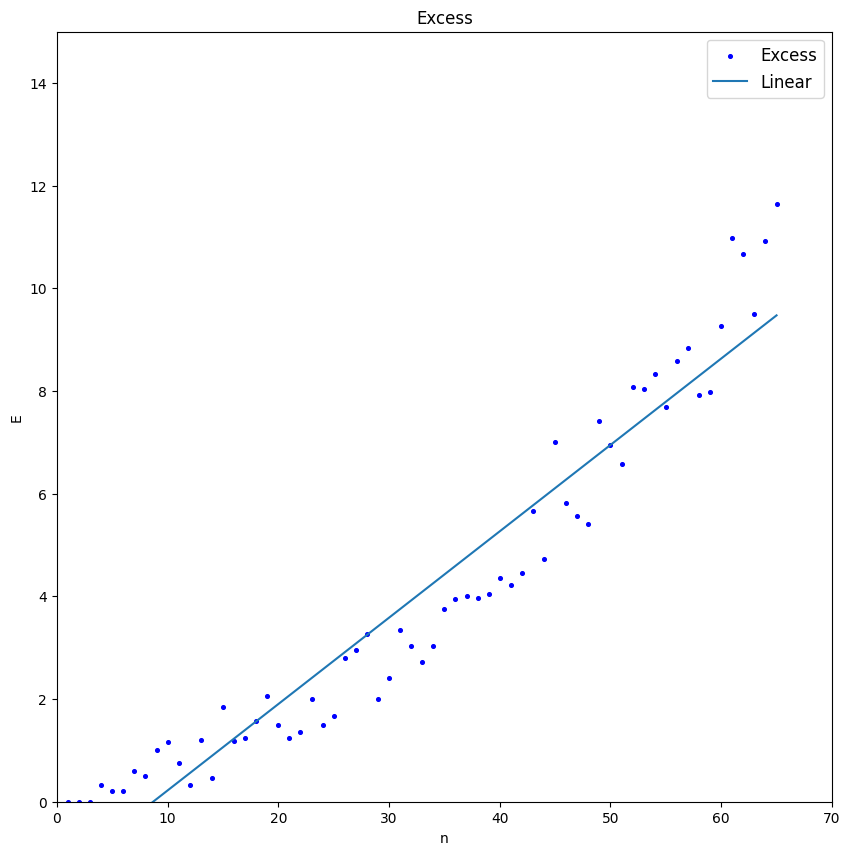

In [ ]:
b0, b1 = [-1.46243332,  0.16825975]

xx = np.arange (1,66)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='b',label='Excess')
plt.plot(xx, b0 + b1*xx , label = 'Linear')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.xlim([0, 70])
plt.ylim([0, 15])
plt.show()

#### 2-я степень

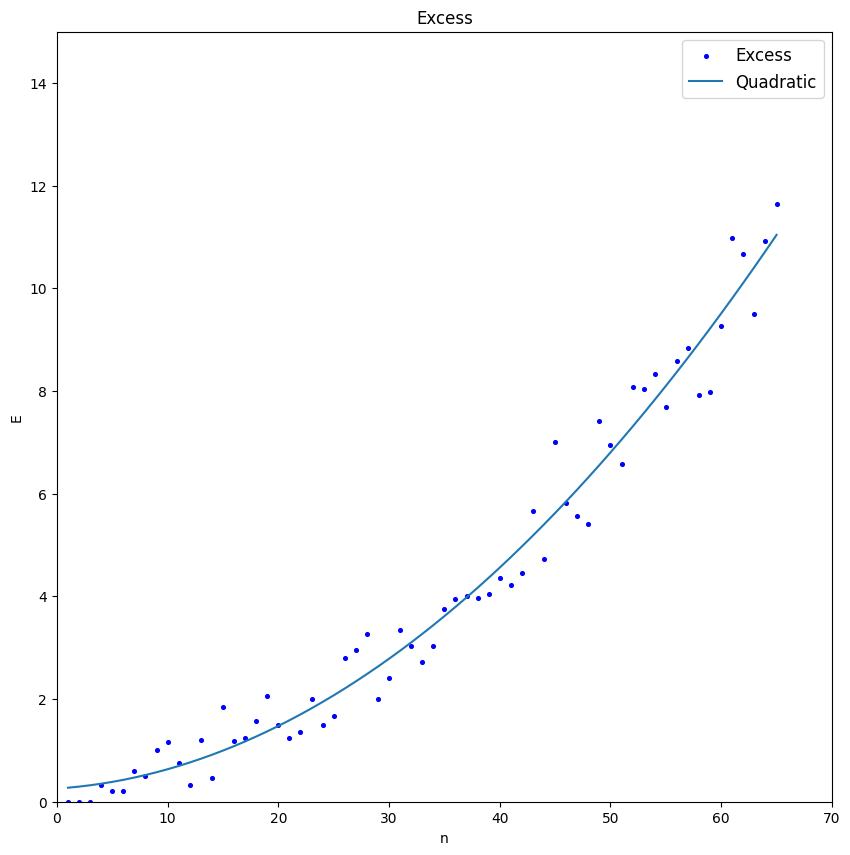

In [ ]:
b0, b1, b2 = [0.25641154, 0.01433335, 0.00233222]

xx = np.arange (1,66)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='b',label='Excess')
plt.plot(xx, b0 + b1*xx + b2*xx**2 , label = 'Quadratic')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.xlim([0, 70])
plt.ylim([0, 15])
plt.show()

#### 3-я степень

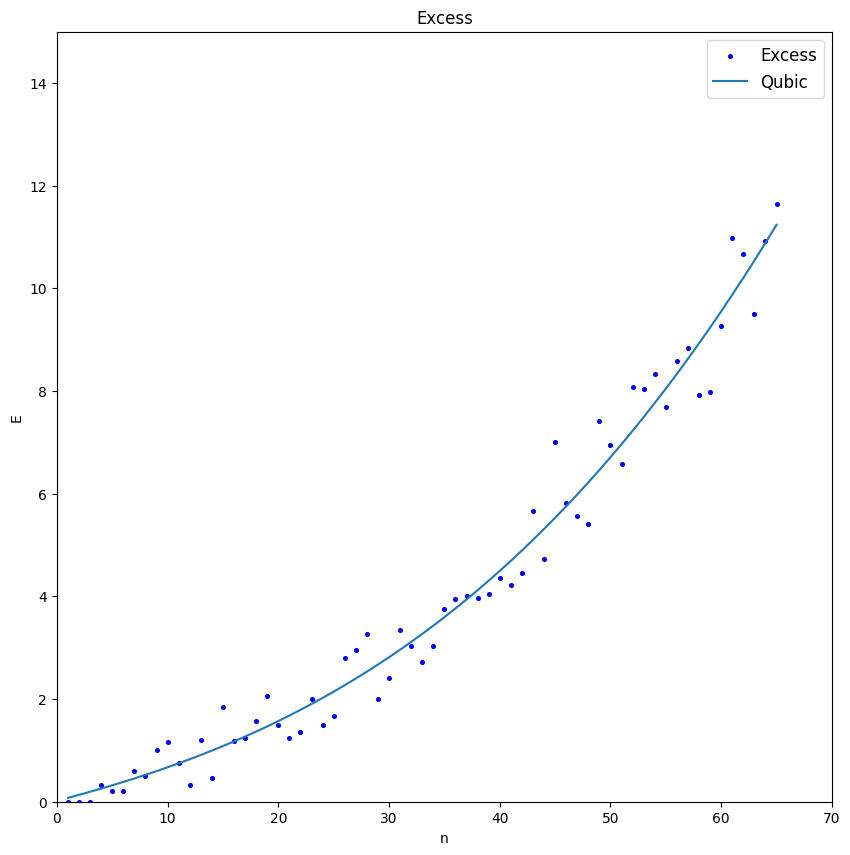

In [ ]:
b0, b1, b2, b3 = [1.85322182e-02, 5.60019403e-02, 7.65848697e-04, 1.58219148e-05]

xx = np.arange (1,66)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='b',label='Excess')
plt.plot(xx, b0 + b1*xx + b2*xx**2 + b3*xx**3 , label = 'Qubic')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.xlim([0, 70])
plt.ylim([0, 15])
plt.show()

#### EXP

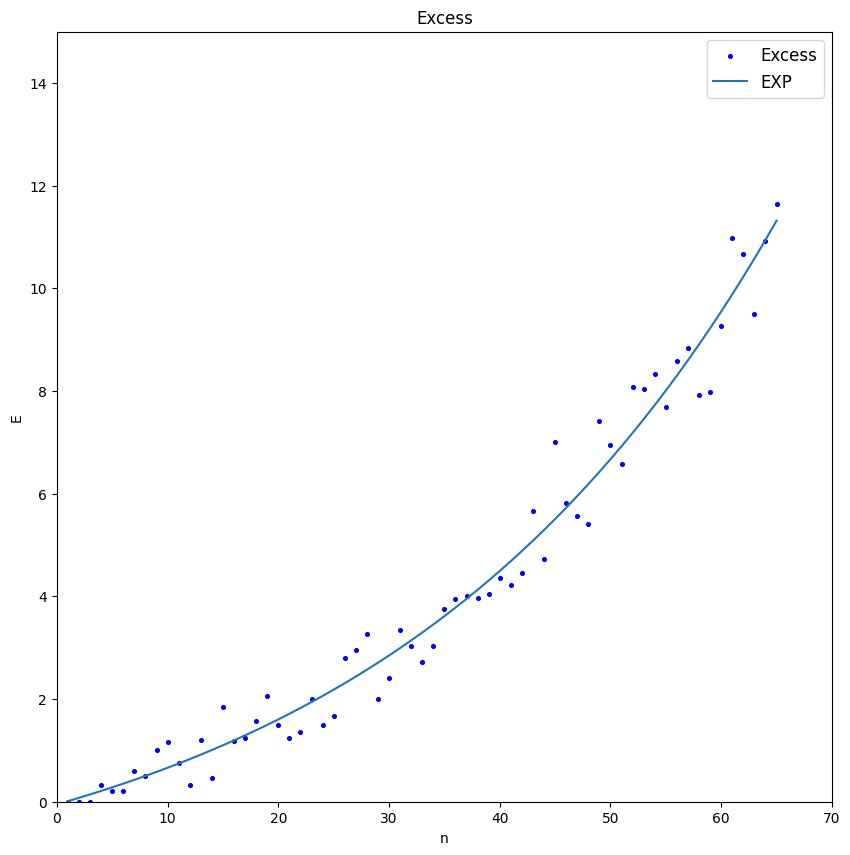

In [ ]:
b0, b1, b2 = [-2.26425714,  2.21335949,  1.02830514]

xx = np.arange (1,66)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='b',label='Excess')
plt.plot(xx, b0 + b1*np.power(b2,xx) , label = 'EXP')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.xlim([0, 70])
plt.ylim([0, 15])
plt.show()

### Несколько точек (Excess)

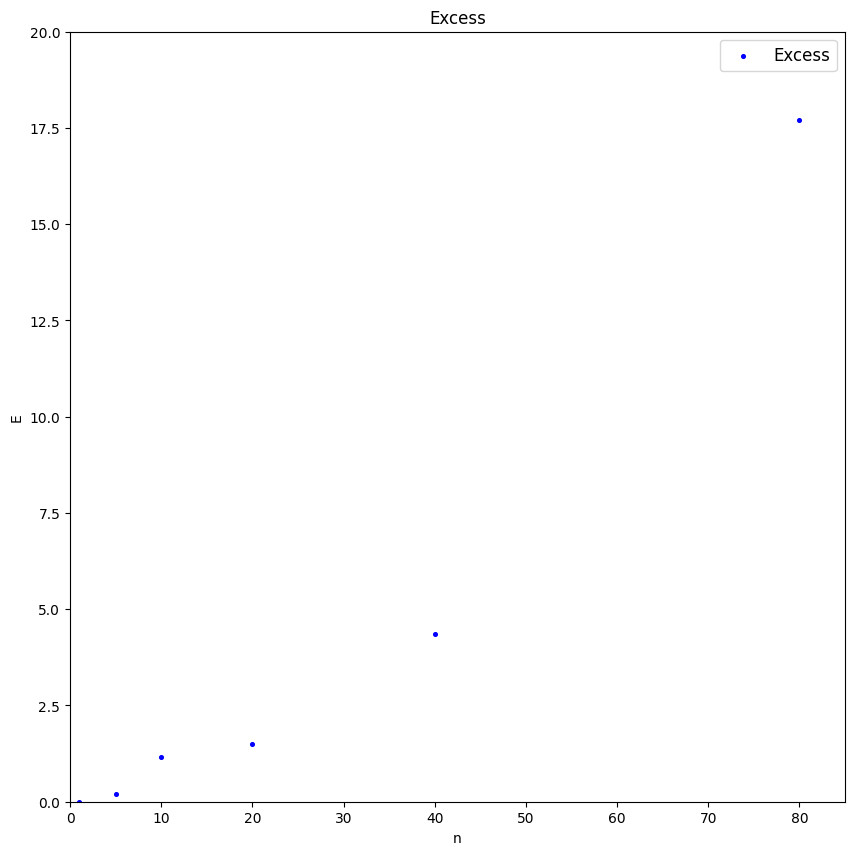

In [ ]:
Excess = [0, 0.2, 1.1667, 1.5, 4.3514, 17.7083]
n = [1, 5, 10, 20, 40, 80]

plt.figure(figsize=(10,10))
plt.scatter(n,Excess,marker='o',s=7,color='b',label='Excess')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.xlim([0, 85])
plt.ylim([0, 20])
plt.show()

In [ ]:
x = np.array(n)
y = np.array(Excess)

linear_func = lambda x, b0, b1: b0 + b1*x
quadratic_func = lambda x, b0, b1, b2: b0 + b1*x + b2*x**2
qubic_func = lambda x, b0, b1, b2, b3: b0 + b1*x + b2*x**2 + b3*x**3
exp_func = lambda x, b0, b1, b2: b0 + b1*np.exp(b2*x)
exp1_func = lambda x, b0, b1, b2: b0 + b1*np.exp(x-b2)
exp2_func = lambda x, b0, b1: b0*np.power(b1,x)
exp3_func = lambda x, b0, b1, b2:  b0 + b1*np.power(b2,x)


from scipy.optimize import leastsq

# list of model
model_list = [
    'linear', 'quadratic',
    'qubic']

# model reference
models_dict = {
        'linear':             linear_func,
        'quadratic':          quadratic_func,
        'qubic':              qubic_func}

# initial values
p0_dict = {
        'linear':             [0, 0],
        'quadratic':          [0, 0, 0],
        'qubic':              [0, 0, 0, 0]}

# titles (formulas)
formulas_dict = {
        'linear':             'y = b0 + b1*x',
        'quadratic':          'y = b0 + b1*x + b2*x^2',
        'qubic':              'y = b0 + b1*x + b2*x^2 + b3*x^3'}

# actual data
X_fact = x
Y_fact = y

# function for calculating residuals
residual_func = lambda p, x, y: y - func(x, *p)

# return all optional outputs
full_output = True

# variables to save the calculation results
calculation_results_df = pd.DataFrame(columns=['func', 'p0', 'popt', 'cov_x', 'SSE', 'MSE', 'pcov', 'perr', 'Y_calc', 'error_metrics'])
error_metrics_results_df = pd.DataFrame(columns=['MSE', 'RMSE', 'MAE', 'MSPE', 'MAPE', 'RMSLE', 'R2'])

# calculations
for func_name in model_list:
    print(f'{func_name.upper()} MODEL: {formulas_dict[func_name]}')
    func = models_dict[func_name]
    calculation_results_df.loc[func_name, 'func'] = func
    p0 = p0_dict[func_name]
    print(f'p0 = {p0}')
    calculation_results_df.loc[func_name, 'p0'] = p0
    if full_output:
        (popt, cov_x, infodict, mesg, ier) = leastsq(residual_func, p0, args=(X_fact, Y_fact), full_output=full_output)
        integer_flag = f'ier = {ier}, the solution was found' if ier<=4 else f'ier = {ier}, the solution was not found'
        print(integer_flag, '\n', mesg)
        calculation_results_df.loc[func_name, 'popt'] = popt
        print(f'parameters = {popt}')
        calculation_results_df.loc[func_name, 'cov_x'] = cov_x
        print(f'cov_x = \n{cov_x}')
        #SSE = (residual_func(popt, X_fact, Y_fact)**2).sum()
        SSE = (infodict['fvec']**2).sum()
        calculation_results_df.loc[func_name, 'SSE'] = SSE
        print(f'SSE = {SSE}')
        MSE = SSE / (len(Y_fact)-len(p0))
        calculation_results_df.loc[func_name, 'MSE'] = MSE
        print(f'MSE = {MSE}')
        pcov = cov_x * MSE
        calculation_results_df.loc[func_name, 'pcov'] = pcov
        print(f'pcov =\n {pcov}')
        perr = np.sqrt(np.diag(pcov))
        calculation_results_df.loc[func_name, 'perr'] = perr
        print(f'perr = {perr}\n')
    else:
        popt = leastsq(residual_func, p0, args=(X_fact, Y_fact), full_output=full_output)
        calculation_results_df.loc[func_name, 'popt'] = popt
        print(f'parameters = {popt}\n')
    Y_calc = func(X_fact, *popt)
    calculation_results_df.loc[func_name, 'Y_calc'] = Y_calc
    (error_metrics_dict, error_metrics_df) = regression_error_metrics(Yfact=Y_fact, Ycalc=Y_calc, model_name=func_name)
    calculation_results_df.loc[func_name, 'error_metrics'] = error_metrics_dict.values()
    error_metrics_results_df = pd.concat([error_metrics_results_df, error_metrics_df])

LINEAR MODEL: y = b0 + b1*x
p0 = [0, 0]
ier = 3, the solution was found 
 Both actual and predicted relative reductions in the sum of squares
  are at most 0.000000 and the relative error between two consecutive iterates is at 
  most 0.000000
parameters = [-1.57665494  0.22042519]
cov_x = 
[[ 3.17897088e-01 -5.81655475e-03]
 [-5.81655475e-03  2.23713648e-04]]
SSE = 15.430451463588362
MSE = 3.8576128658970905
pcov =
 [[ 1.22632390e+00 -2.24380165e-02]
 [-2.24380165e-02  8.63000645e-04]]
perr = [1.10739509 0.02937687]

QUADRATIC MODEL: y = b0 + b1*x + b2*x^2
p0 = [0, 0, 0]
ier = 1, the solution was found 
 Both actual and predicted relative reductions in the sum of squares
  are at most 0.000000
parameters = [3.01218448e-01 1.05455307e-04 2.70966905e-03]
cov_x = 
[[ 5.55248286e-01 -3.36636002e-02  3.42486230e-04]
 [-3.36636002e-02  3.49084579e-03 -4.01819063e-05]
 [ 3.42486230e-04 -4.01819063e-05  4.94190334e-07]]
SSE = 0.5731186669104458
MSE = 0.19103955563681527
pcov =
 [[ 1.06074386e

<ipython-input-7-a10df777837d>:36: RuntimeWarning: divide by zero encountered in divide
  MSPE = (1/n_fit) *  np.sum(((Yfact-Ycalc)/Yfact)**2)
<ipython-input-7-a10df777837d>:37: RuntimeWarning: divide by zero encountered in divide
  MAPE = (1/n_fit) *  np.sum(abs((Yfact-Ycalc)/Yfact))
<ipython-input-7-a10df777837d>:38: RuntimeWarning: invalid value encountered in log
  RMSLE = math.sqrt((1/n_fit) * np.sum((np.log(Yfact + 1)-np.log(Ycalc + 1))**2))
<ipython-input-7-a10df777837d>:36: RuntimeWarning: divide by zero encountered in divide
  MSPE = (1/n_fit) *  np.sum(((Yfact-Ycalc)/Yfact)**2)
<ipython-input-7-a10df777837d>:37: RuntimeWarning: divide by zero encountered in divide
  MAPE = (1/n_fit) *  np.sum(abs((Yfact-Ycalc)/Yfact))
<ipython-input-7-a10df777837d>:36: RuntimeWarning: divide by zero encountered in divide
  MSPE = (1/n_fit) *  np.sum(((Yfact-Ycalc)/Yfact)**2)
<ipython-input-7-a10df777837d>:37: RuntimeWarning: divide by zero encountered in divide
  MAPE = (1/n_fit) *  np.sum(ab

3 степень

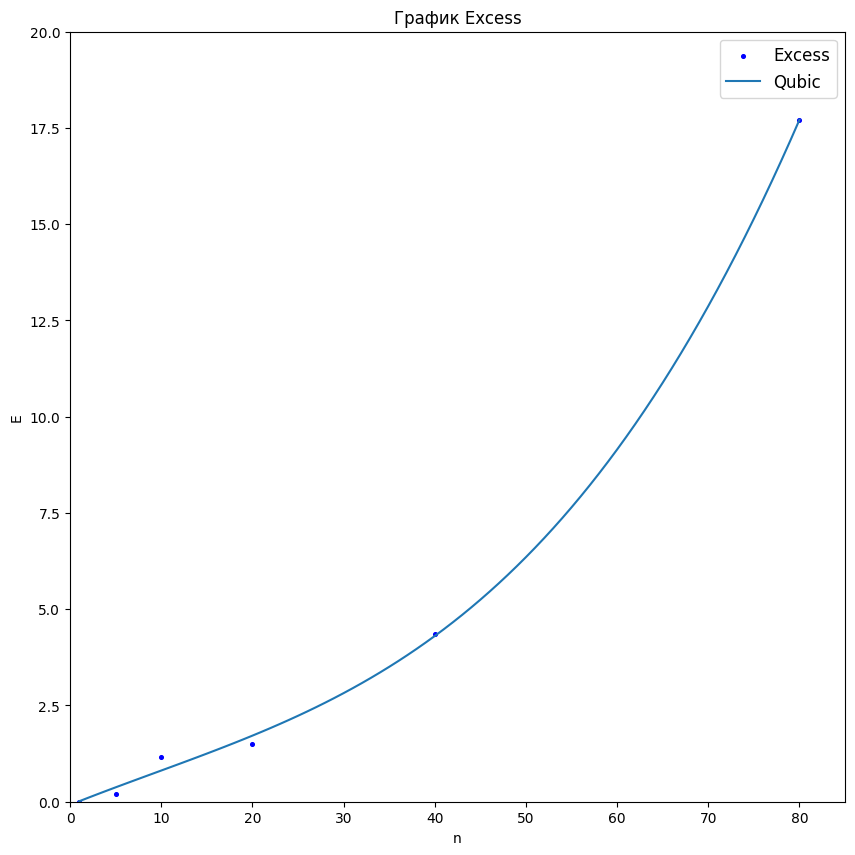

In [ ]:
b0, b1, b2, b3 =[-8.23282405e-02,  9.45957005e-02, -8.44305763e-04,  3.05267431e-05]

xx = np.arange (1,81)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='b',label='Excess')
plt.plot(xx, b0 + b1*xx + b2*xx**2 + b3*xx**3 , label = 'Qubic')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.xlim([0, 85])
plt.ylim([0, 20])
plt.show()

In [ ]:
import sympy as sp

def f(x):
  z = b0 + b1*x + b2*x**2 + b3*x**3
  return z

# Объявляем символьную переменную x
x = sp.Symbol ("x")
# Вывод функции
print("f(x) =", f(x))
# Находим производную функции f(x) и сохраняем ее в переменной d_f:
d_f = sp.diff(f(x), x)
print("Первая производная функции:",d_f)

# Решаем уравнение d_f = 0:
x_extr = sp.solve (d_f)
print ("точка экстремума:", x_extr)

# Сохраняем точки экстремума в переменные:
x_0 = x_extr[0]
x_1 = x_extr[1]

# Находим вторую производную функции:
d2_f = sp.diff(f(x), x, 2)
print("Вторая производная функции:", d2_f)

# Решаем уравнение d2_f = 0
x_extr2 = sp.solve (d2_f)
print ("точка перегиба:", x_extr2)

# Находим значение второй производной в точках экстремума x_0 и x_1,
# Сохраняем их в переменные f_0_d2 и f_1_d2:
f_0_d2 = d2_f.evalf(subs = {x : x_0})
f_1_d2 = d2_f.evalf(subs = {x : x_1})

# Определяем, является ли точка x_0 точкой лок.минимума, максимума или перегиба
if f_0_d2 > 0:
  print(x_0, "- локальный минимум")
elif f_0_d2 < 0:
  print(x_0, "- локальный максимум")
else:
  print(x_0, "- точка перегиба")

# Определяем, является ли точка x_1 точкой лок.минимума, максимума или перегиба
if f_1_d2 > 0:
  print(x_1, "- локальный минимум")
elif f_1_d2 < 0:
  print(x_1, "- локальный максимум")
else:
  print(x_1, "- точка перегиба")


f(x) = 3.05267431e-5*x**3 - 0.000844305763*x**2 + 0.0945957005*x - 0.0823282405
Первая производная функции: 9.15802293e-5*x**2 - 0.001688611526*x + 0.0945957005
точка экстремума: [9.21930169266348 - 30.7884974375689*I, 9.21930169266348 + 30.7884974375689*I]
Вторая производная функции: 0.0001831604586*x - 0.001688611526
точка перегиба: [9.21930169266348]


'\n# Находим значение второй производной в точках экстремума x_0 и x_1,\n# Сохраняем их в переменные f_0_d2 и f_1_d2:\nf_0_d2 = d2_f.evalf(subs = {x : x_0})\nf_1_d2 = d2_f.evalf(subs = {x : x_1})\n\n# Определяем, является ли точка x_0 точкой лок.минимума, максимума или перегиба\nif f_0_d2 > 0:\n  print(x_0, "- локальный минимум")\nelif f_0_d2 < 0:\n  print(x_0, "- локальный максимум")\nelse:\n  print(x_0, "- точка перегиба")\n\n# Определяем, является ли точка x_1 точкой лок.минимума, максимума или перегиба\nif f_1_d2 > 0:\n  print(x_1, "- локальный минимум")\nelif f_1_d2 < 0:\n  print(x_1, "- локальный максимум")\nelse:\n  print(x_1, "- точка перегиба")\n'

2 степень

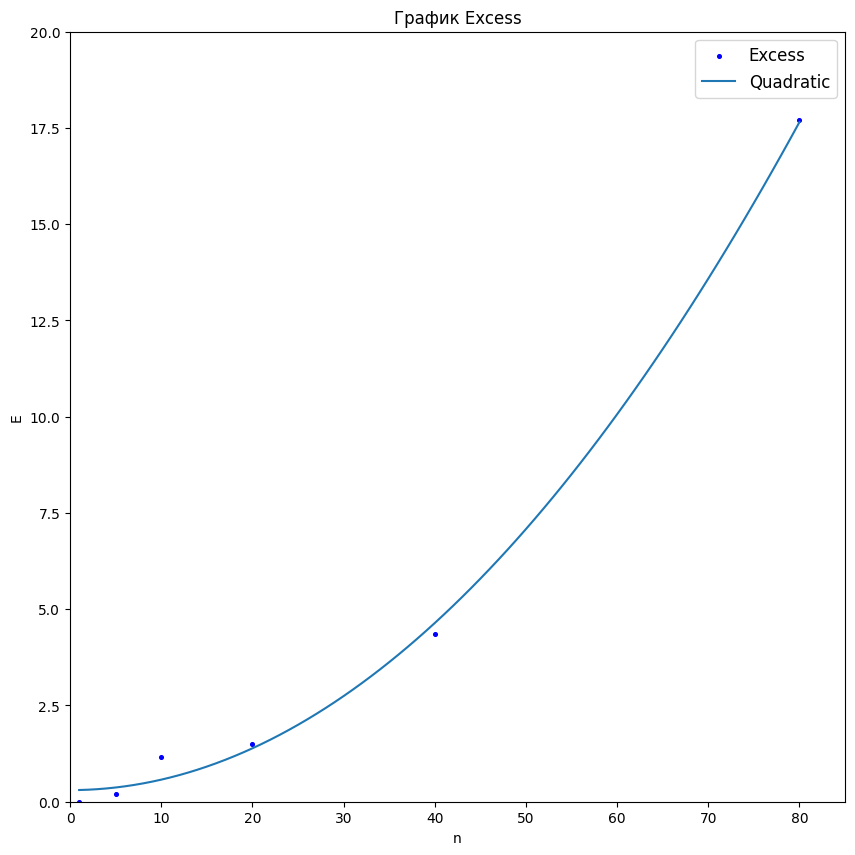

In [ ]:
b0, b1, b2 = [3.01218448e-01, 1.05455307e-04, 2.70966905e-03]

xx = np.arange (1,81)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='b',label='Excess')
plt.plot(xx, b0 + b1*xx + b2*xx**2 , label = 'Quadratic')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.xlim([0, 85])
plt.ylim([0, 20])
plt.show()

In [ ]:
from sympy import *

x = Symbol('x', real=True)
f = b0 + b1*x + b2*x**2
fprime = f.diff(x)

solve(fprime, x)

[-0.0194590750852027]

### График Approx

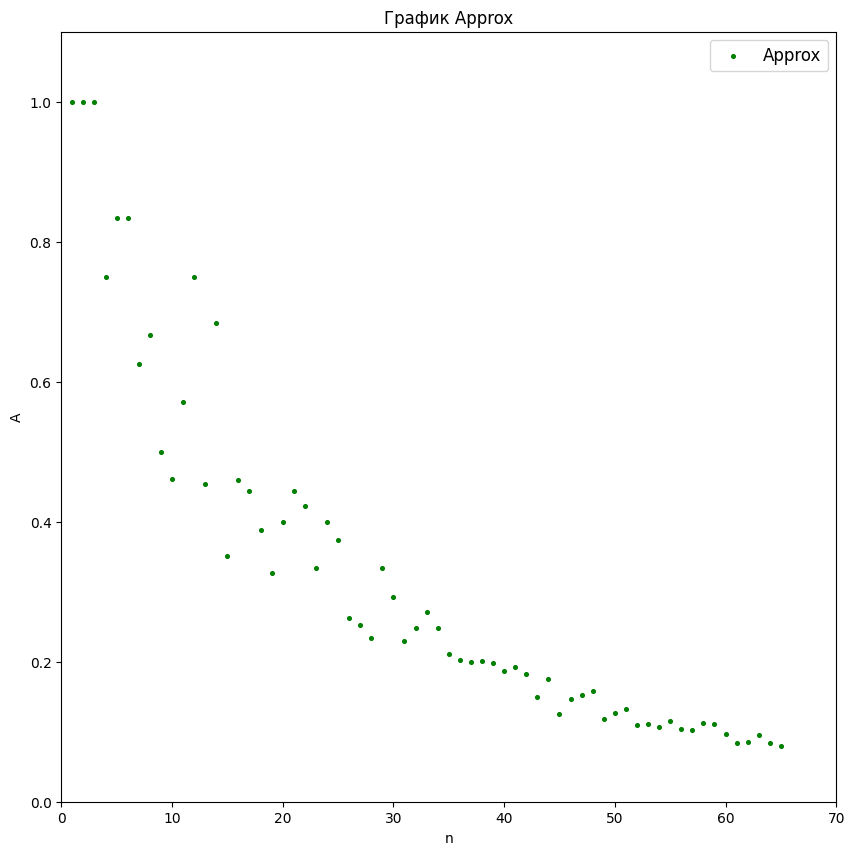

In [ ]:
Approx = [1, 1, 1, 0.75, 0.8333, 0.8333, 0.625, 0.6667, 0.5, 0.4615, 0.5714, 0.75, 0.4546, 0.6842, 0.3514, 0.4595, 0.4444, 0.3877, 0.3272, 0.4,
          0.4444, 0.4231, 0.3333, 0.4, 0.3735, 0.2626, 0.2523, 0.2342, 0.3333, 0.2925, 0.2302, 0.2481, 0.2706, 0.2483, 0.2105, 0.2021, 0.2, 0.2011, 0.198, 0.1869,
          0.1927, 0.183, 0.15, 0.1753, 0.125, 0.1467, 0.1524, 0.1577, 0.1188, 0.1262, 0.1324, 0.1103, 0.1111, 0.1074, 0.115, 0.1046, 0.1029, 0.1124, 0.1114, 0.0974,
          0.0838, 0.0857, 0.0952, 0.0842, 0.079]

n = list(range(1, 66))

plt.figure(figsize=(10,10))
plt.scatter(n,Approx,marker='o',s=7,color='g',label='Approx')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Approx')
plt.xlabel('n')
plt.ylabel('A')
plt.xlim([0, 70])
plt.ylim([0, 1.1])
plt.show()

### Среднее Approx

[1.0, 1.0, 1.0, 0.9375, 0.91666, 0.9027666666666668, 0.8630857142857143, 0.8385375, 0.8009222222222223, 0.76698, 0.7492000000000001, 0.7492666666666667, 0.7266, 0.7235714285714286, 0.69876, 0.68380625, 0.6697235294117646, 0.6540555555555555, 0.6368526315789473, 0.62501, 0.6164095238095237, 0.6076227272727273, 0.595695652173913, 0.5875416666666666, 0.5789799999999999, 0.5668115384615384, 0.555162962962963, 0.5437, 0.5364448275862068, 0.5283133333333333, 0.5186967741935483, 0.510240625, 0.5029787878787879, 0.49548823529411773, 0.4873457142857143, 0.4794222222222223, 0.47187027027027034, 0.4647447368421053, 0.4579051282051283, 0.45113000000000003, 0.4448268292682927, 0.4385928571428571, 0.4318813953488372, 0.42605, 0.41935999999999996, 0.4134326086956521, 0.40787872340425524, 0.4026666666666667, 0.3968734693877551, 0.39146000000000003, 0.38638039215686276, 0.38107115384615386, 0.375977358490566, 0.37100370370370367, 0.36634909090909085, 0.361675, 0.3571350877192983, 0.3529155172413794, 0.

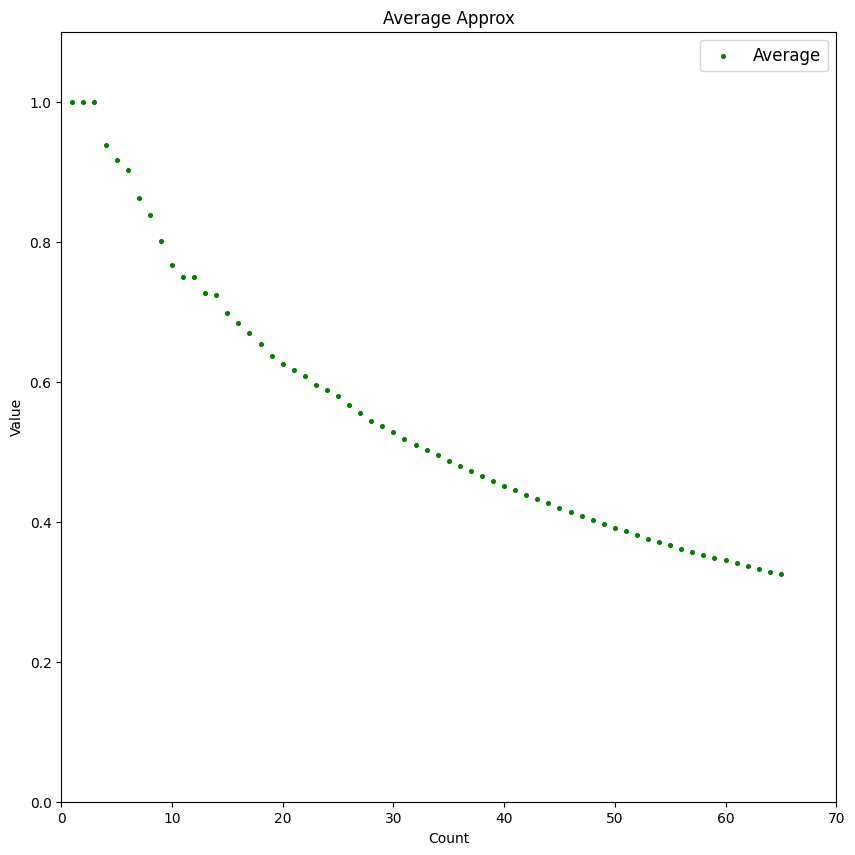

In [ ]:
nn = np.arange(1,66)

av = []
for i in nn:
  av.append(np.mean(Approx[0:i]))

print(av)

plt.figure(figsize=(10,10))
plt.scatter(nn,av,marker='o',s=7,color='g',label='Average')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Average Approx')
plt.xlabel('Count')
plt.ylabel('Value')
plt.xlim([0, 70])
plt.ylim([0, 1.1])
plt.show()

### Аппроксимация МНК (Approx)

In [ ]:
x = np.array(n)
y = np.array(Approx)

linear_func = lambda x, b0, b1: b0 + b1*x
quadratic_func = lambda x, b0, b1, b2: b0 + b1*x + b2*x**2
qubic_func = lambda x, b0, b1, b2, b3: b0 + b1*x + b2*x**2 + b3*x**3
exp_func = lambda x, b0, b1, b2: b0 + b1*np.exp(b2*x)
exp1_func = lambda x, b0, b1, b2: b0 + b1*np.exp(x-b2)
exp2_func = lambda x, b0, b1: b0*np.power(b1,x)
exp3_func = lambda x, b0, b1, b2:  b0 + b1*np.power(b2,x)


from scipy.optimize import leastsq

# list of model
model_list = [
    'linear', 'quadratic',
    'qubic']

# model reference
models_dict = {
        'linear':             linear_func,
        'quadratic':          quadratic_func,
        'qubic':              qubic_func}

# initial values
p0_dict = {
        'linear':             [0, 0],
        'quadratic':          [0, 0, 0],
        'qubic':              [0, 0, 0, 0]}

# titles (formulas)
formulas_dict = {
        'linear':             'y = b0 + b1*x',
        'quadratic':          'y = b0 + b1*x + b2*x^2',
        'qubic':              'y = b0 + b1*x + b2*x^2 + b3*x^3'}

# actual data
X_fact = x
Y_fact = y

# function for calculating residuals
residual_func = lambda p, x, y: y - func(x, *p)

# return all optional outputs
full_output = True

# variables to save the calculation results
calculation_results_df = pd.DataFrame(columns=['func', 'p0', 'popt', 'cov_x', 'SSE', 'MSE', 'pcov', 'perr', 'Y_calc', 'error_metrics'])
error_metrics_results_df = pd.DataFrame(columns=['MSE', 'RMSE', 'MAE', 'MSPE', 'MAPE', 'RMSLE', 'R2'])

# calculations
for func_name in model_list:
    print(f'{func_name.upper()} MODEL: {formulas_dict[func_name]}')
    func = models_dict[func_name]
    calculation_results_df.loc[func_name, 'func'] = func
    p0 = p0_dict[func_name]
    print(f'p0 = {p0}')
    calculation_results_df.loc[func_name, 'p0'] = p0
    if full_output:
        (popt, cov_x, infodict, mesg, ier) = leastsq(residual_func, p0, args=(X_fact, Y_fact), full_output=full_output)
        integer_flag = f'ier = {ier}, the solution was found' if ier<=4 else f'ier = {ier}, the solution was not found'
        print(integer_flag, '\n', mesg)
        calculation_results_df.loc[func_name, 'popt'] = popt
        print(f'parameters = {popt}')
        calculation_results_df.loc[func_name, 'cov_x'] = cov_x
        print(f'cov_x = \n{cov_x}')
        #SSE = (residual_func(popt, X_fact, Y_fact)**2).sum()
        SSE = (infodict['fvec']**2).sum()
        calculation_results_df.loc[func_name, 'SSE'] = SSE
        print(f'SSE = {SSE}')
        MSE = SSE / (len(Y_fact)-len(p0))
        calculation_results_df.loc[func_name, 'MSE'] = MSE
        print(f'MSE = {MSE}')
        pcov = cov_x * MSE
        calculation_results_df.loc[func_name, 'pcov'] = pcov
        print(f'pcov =\n {pcov}')
        perr = np.sqrt(np.diag(pcov))
        calculation_results_df.loc[func_name, 'perr'] = perr
        print(f'perr = {perr}\n')
    else:
        popt = leastsq(residual_func, p0, args=(X_fact, Y_fact), full_output=full_output)
        calculation_results_df.loc[func_name, 'popt'] = popt
        print(f'parameters = {popt}\n')
    Y_calc = func(X_fact, *popt)
    calculation_results_df.loc[func_name, 'Y_calc'] = Y_calc
    (error_metrics_dict, error_metrics_df) = regression_error_metrics(Yfact=Y_fact, Ycalc=Y_calc, model_name=func_name)
    calculation_results_df.loc[func_name, 'error_metrics'] = error_metrics_dict.values()
    error_metrics_results_df = pd.concat([error_metrics_results_df, error_metrics_df])

LINEAR MODEL: y = b0 + b1*x
p0 = [0, 0]
ier = 3, the solution was found 
 Both actual and predicted relative reductions in the sum of squares
  are at most 0.000000 and the relative error between two consecutive iterates is at 
  most 0.000000
parameters = [ 0.7127562  -0.01175914]
cov_x = 
[[ 6.29807690e-02 -1.44230768e-03]
 [-1.44230768e-03  4.37062932e-05]]
SSE = 0.8048229476534092
MSE = 0.012774967423069987
pcov =
 [[ 8.04577272e-04 -1.84254336e-05]
 [-1.84254336e-05  5.58346472e-07]]
perr = [0.02836507 0.00074723]

QUADRATIC MODEL: y = b0 + b1*x + b2*x^2
p0 = [0, 0, 0]
ier = 2, the solution was found 
 The relative error between two consecutive iterates is at most 0.000000
parameters = [ 9.17463885e-01 -3.00911703e-02  2.77758050e-04]
cov_x = 
[[ 1.47344322e-01 -8.99725274e-03  1.14468865e-04]
 [-8.99725274e-03  7.20268536e-04 -1.02509431e-05]
 [ 1.14468865e-04 -1.02509431e-05  1.55317320e-07]]
SSE = 0.30810092662846245
MSE = 0.00496936978433004
pcov =
 [[ 7.32208424e-04 -4.471067

#### 1 степень

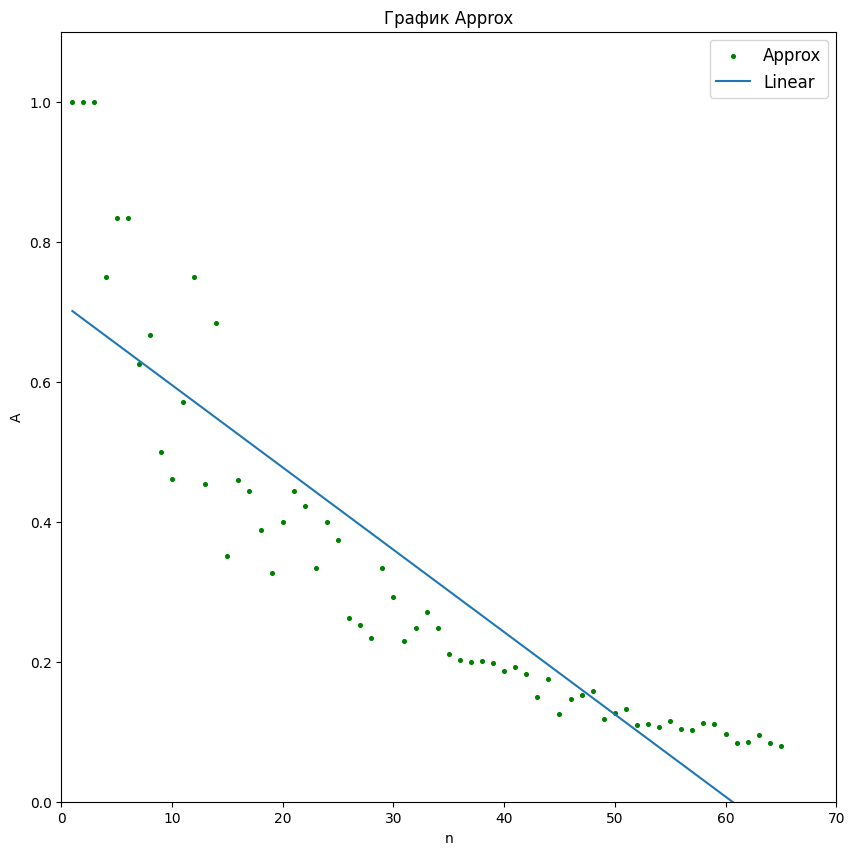

In [ ]:
b0, b1 = [ 0.7127562,  -0.01175914]

xx = np.arange (1,66)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='g',label='Approx')
plt.plot(xx, b0 + b1*xx , label = 'Linear')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Approx')
plt.xlabel('n')
plt.ylabel('A')
plt.xlim([0, 70])
plt.ylim([0, 1.1])
plt.show()

#### 2 степень

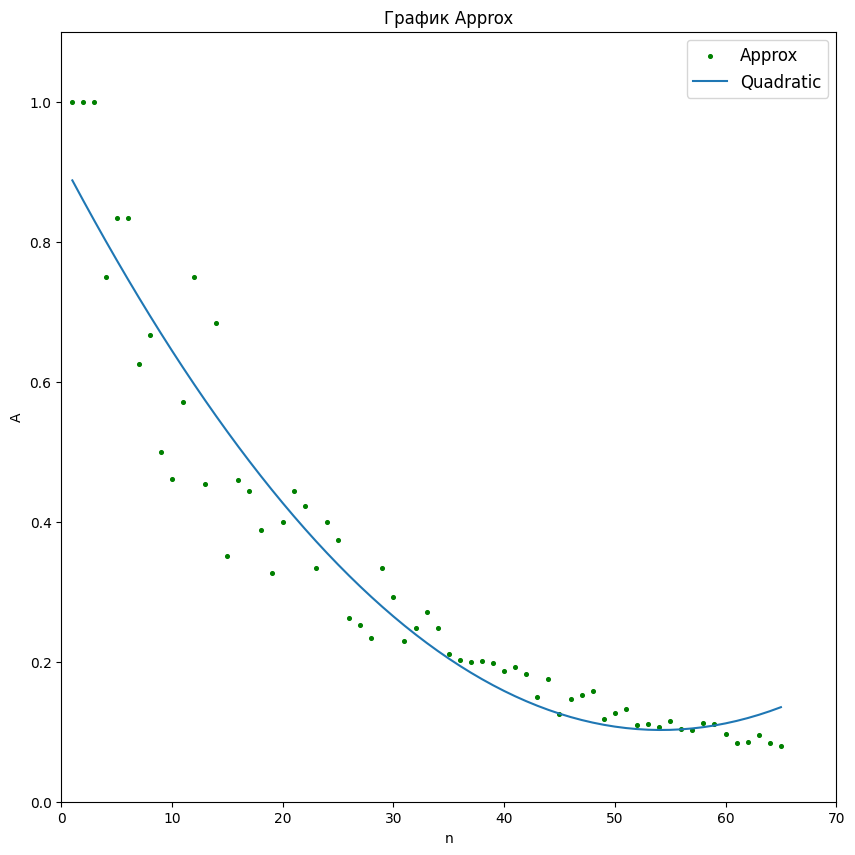

In [ ]:
b0, b1, b2 = [ 9.17463885e-01, -3.00911703e-02,  2.77758050e-04]

xx = np.arange (1,66)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='g',label='Approx')
plt.plot(xx, b0 + b1*xx + b2*xx**2 , label = 'Quadratic')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Approx')
plt.xlabel('n')
plt.ylabel('A')
plt.xlim([0, 70])
plt.ylim([0, 1.1])
plt.show()

#### 3 степень

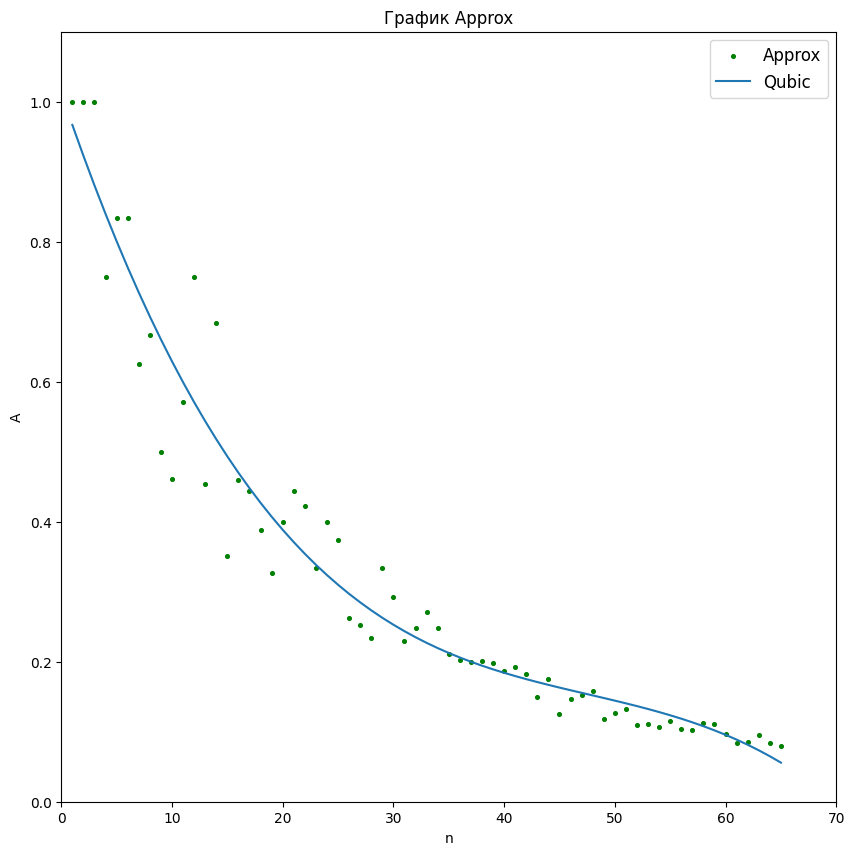

In [ ]:
b0, b1, b2, b3 =[ 1.01275484e+00, -4.67829968e-02,  9.05222676e-04, -6.33802655e-06]

xx = np.arange (1,66)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='g',label='Approx')
plt.plot(xx, b0 + b1*xx + b2*xx**2 + b3*xx**3 , label = 'Qubic')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Approx')
plt.xlabel('n')
plt.ylabel('A')
plt.xlim([0, 70])
plt.ylim([0, 1.1])
plt.show()

### Несколько точек (Approx)

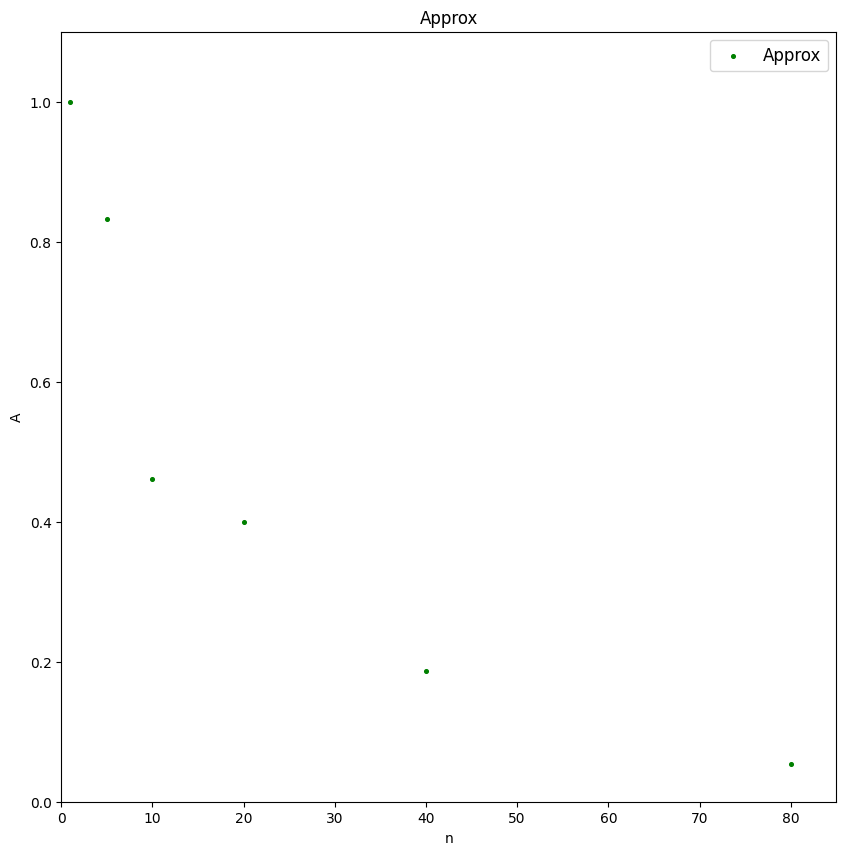

In [ ]:
Approx = [1, 0.833, 0.4615, 0.4, 0.1869, 0.0535]
n = [1, 5, 10, 20, 40, 80]

plt.figure(figsize=(10,10))
plt.scatter(n,Approx,marker='o',s=7,color='g',label='Approx')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Approx')
plt.xlabel('n')
plt.ylabel('A')
plt.xlim([0, 85])
plt.ylim([0, 1.1])
plt.show()

In [ ]:
x = np.array(n)
y = np.array(Approx)

linear_func = lambda x, b0, b1: b0 + b1*x
quadratic_func = lambda x, b0, b1, b2: b0 + b1*x + b2*x**2
qubic_func = lambda x, b0, b1, b2, b3: b0 + b1*x + b2*x**2 + b3*x**3
exp_func = lambda x, b0, b1, b2: b0 + b1*np.exp(b2*x)
exp1_func = lambda x, b0, b1, b2: b0 + b1*np.exp(x-b2)
exp2_func = lambda x, b0, b1: b0*np.power(b1,x)
exp3_func = lambda x, b0, b1, b2:  b0 + b1*np.power(b2,x)


from scipy.optimize import leastsq

# list of model
model_list = [
    'linear', 'quadratic',
    'qubic']

# model reference
models_dict = {
        'linear':             linear_func,
        'quadratic':          quadratic_func,
        'qubic':              qubic_func}

# initial values
p0_dict = {
        'linear':             [0, 0],
        'quadratic':          [0, 0, 0],
        'qubic':              [0, 0, 0, 0]}

# titles (formulas)
formulas_dict = {
        'linear':             'y = b0 + b1*x',
        'quadratic':          'y = b0 + b1*x + b2*x^2',
        'qubic':              'y = b0 + b1*x + b2*x^2 + b3*x^3'}

# actual data
X_fact = x
Y_fact = y

# function for calculating residuals
residual_func = lambda p, x, y: y - func(x, *p)

# return all optional outputs
full_output = True

# variables to save the calculation results
calculation_results_df = pd.DataFrame(columns=['func', 'p0', 'popt', 'cov_x', 'SSE', 'MSE', 'pcov', 'perr', 'Y_calc', 'error_metrics'])
error_metrics_results_df = pd.DataFrame(columns=['MSE', 'RMSE', 'MAE', 'MSPE', 'MAPE', 'RMSLE', 'R2'])

# calculations
for func_name in model_list:
    print(f'{func_name.upper()} MODEL: {formulas_dict[func_name]}')
    func = models_dict[func_name]
    calculation_results_df.loc[func_name, 'func'] = func
    p0 = p0_dict[func_name]
    print(f'p0 = {p0}')
    calculation_results_df.loc[func_name, 'p0'] = p0
    if full_output:
        (popt, cov_x, infodict, mesg, ier) = leastsq(residual_func, p0, args=(X_fact, Y_fact), full_output=full_output)
        integer_flag = f'ier = {ier}, the solution was found' if ier<=4 else f'ier = {ier}, the solution was not found'
        print(integer_flag, '\n', mesg)
        calculation_results_df.loc[func_name, 'popt'] = popt
        print(f'parameters = {popt}')
        calculation_results_df.loc[func_name, 'cov_x'] = cov_x
        print(f'cov_x = \n{cov_x}')
        #SSE = (residual_func(popt, X_fact, Y_fact)**2).sum()
        SSE = (infodict['fvec']**2).sum()
        calculation_results_df.loc[func_name, 'SSE'] = SSE
        print(f'SSE = {SSE}')
        MSE = SSE / (len(Y_fact)-len(p0))
        calculation_results_df.loc[func_name, 'MSE'] = MSE
        print(f'MSE = {MSE}')
        pcov = cov_x * MSE
        calculation_results_df.loc[func_name, 'pcov'] = pcov
        print(f'pcov =\n {pcov}')
        perr = np.sqrt(np.diag(pcov))
        calculation_results_df.loc[func_name, 'perr'] = perr
        print(f'perr = {perr}\n')
    else:
        popt = leastsq(residual_func, p0, args=(X_fact, Y_fact), full_output=full_output)
        calculation_results_df.loc[func_name, 'popt'] = popt
        print(f'parameters = {popt}\n')
    Y_calc = func(X_fact, *popt)
    calculation_results_df.loc[func_name, 'Y_calc'] = Y_calc
    (error_metrics_dict, error_metrics_df) = regression_error_metrics(Yfact=Y_fact, Ycalc=Y_calc, model_name=func_name)
    calculation_results_df.loc[func_name, 'error_metrics'] = error_metrics_dict.values()
    error_metrics_results_df = pd.concat([error_metrics_results_df, error_metrics_df])

LINEAR MODEL: y = b0 + b1*x
p0 = [0, 0]
ier = 3, the solution was found 
 Both actual and predicted relative reductions in the sum of squares
  are at most 0.000000 and the relative error between two consecutive iterates is at 
  most 0.000000
parameters = [ 0.76119841 -0.0104634 ]
cov_x = 
[[ 3.17897095e-01 -5.81655490e-03]
 [-5.81655490e-03  2.23713651e-04]]
SSE = 0.17967088731319902
MSE = 0.044917721828299756
pcov =
 [[ 1.42792133e-02 -2.61266395e-04]
 [-2.61266395e-04  1.00487075e-05]]
perr = [0.11949566 0.00316997]

QUADRATIC MODEL: y = b0 + b1*x + b2*x^2
p0 = [0, 0, 0]
ier = 3, the solution was found 
 Both actual and predicted relative reductions in the sum of squares
  are at most 0.000000 and the relative error between two consecutive iterates is at 
  most 0.000000
parameters = [ 9.33072854e-01 -3.06284082e-02  2.48005461e-04]
cov_x = 
[[ 5.55248472e-01 -3.36635834e-02  3.42485123e-04]
 [-3.36635834e-02  3.49084017e-03 -4.01817460e-05]
 [ 3.42485123e-04 -4.01817460e-05  4.941

3 степень

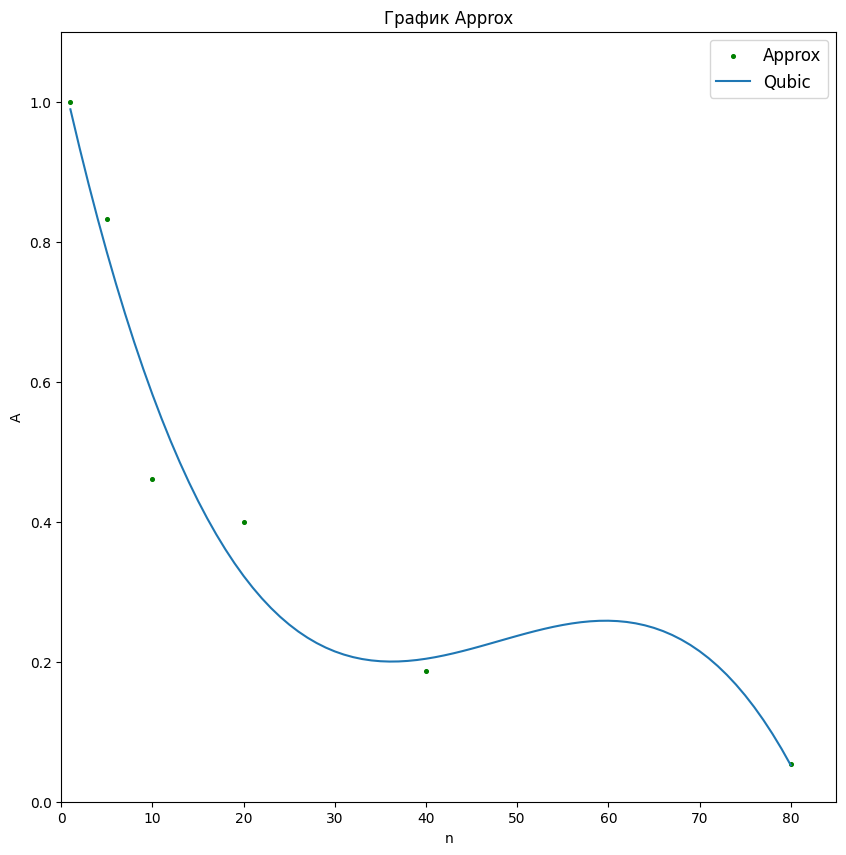

In [ ]:
b0, b1, b2, b3 =[ 1.04645244e+00, -5.85605105e-02,  1.29858997e-03, -9.02395915e-06]

xx = np.arange (1,81)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='g',label='Approx')
plt.plot(xx, b0 + b1*xx + b2*xx**2 + b3*xx**3 , label = 'Qubic')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Approx')
plt.xlabel('n')
plt.ylabel('A')
plt.xlim([0, 85])
plt.ylim([0, 1.1])
plt.show()

In [ ]:
import sympy as sp

def f(x):
  z = b0 + b1*x + b2*x**2 + b3*x**3
  return z

# Объявляем символьную переменную x
x = sp.Symbol ("x")
# Вывод функции
print("f(x) =", f(x))
# Находим производную функции f(x) и сохраняем ее в переменной d_f:
d_f = sp.diff(f(x), x)
print("Первая производная функции:",d_f)

# Решаем уравнение d_f = 0:
x_extr = sp.solve (d_f)
print ("точка экстремума:", x_extr)

# Сохраняем точки экстремума в переменные:
x_0 = x_extr[0]
x_1 = x_extr[1]

# Находим вторую производную функции:
d2_f = sp.diff(f(x), x, 2)
print("Вторая производная функции:", d2_f)

# Решаем уравнение d2_f = 0
x_extr2 = sp.solve (d2_f)
print ("точка перегиба:", x_extr2)

# Находим значение второй производной в точках экстремума x_0 и x_1,
# Сохраняем их в переменные f_0_d2 и f_1_d2:
f_0_d2 = d2_f.evalf(subs = {x : x_0})
f_1_d2 = d2_f.evalf(subs = {x : x_1})

# Определяем, является ли точка x_0 точкой лок.минимума, максимума или перегиба
if f_0_d2 > 0:
  print(x_0, "- локальный минимум")
elif f_0_d2 < 0:
  print(x_0, "- локальный максимум")
else:
  print(x_0, "- точка перегиба")

# Определяем, является ли точка x_1 точкой лок.минимума, максимума или перегиба
if f_1_d2 > 0:
  print(x_1, "- локальный минимум")
elif f_1_d2 < 0:
  print(x_1, "- локальный максимум")
else:
  print(x_1, "- точка перегиба")


f(x) = -9.02395915e-6*x**3 + 0.00129858997*x**2 - 0.0585605105*x + 1.04645244
Первая производная функции: -2.707187745e-5*x**2 + 0.00259717994*x - 0.0585605105
точка экстремума: [36.2293342066264, 59.7071203224998]
Вторая производная функции: 0.00259717994 - 5.41437549e-5*x
точка перегиба: [47.9682272645631]
36.2293342066264 - локальный минимум
59.7071203224998 - локальный максимум


2 степень

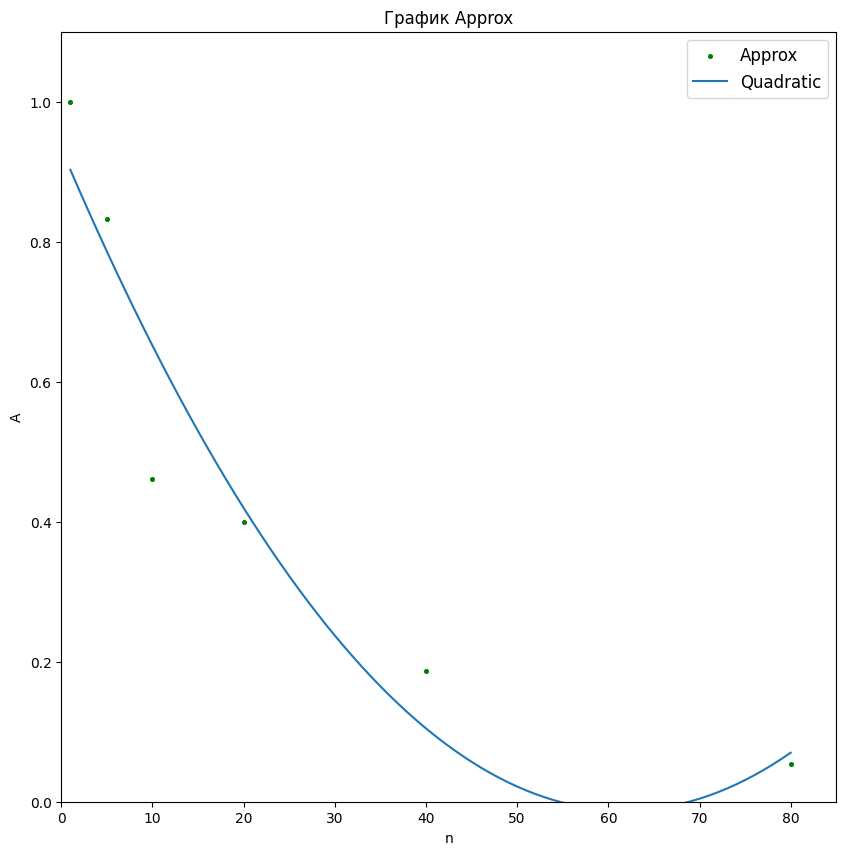

In [ ]:
b0, b1, b2 = [ 9.33072854e-01, -3.06284082e-02,  2.48005461e-04]

xx = np.arange (1,81)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='g',label='Approx')
plt.plot(xx, b0 + b1*xx + b2*xx**2 , label = 'Quadratic')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Approx')
plt.xlabel('n')
plt.ylabel('A')
plt.xlim([0, 85])
plt.ylim([0, 1.1])
plt.show()

In [ ]:
from sympy import *

x = Symbol('x', real=True)
f = b0 + b1*x + b2*x**2
fprime = f.diff(x)

solve(fprime, x)

[61.7494632507306]

In [ ]:
import sympy as sp

def f(x):
  z = b0 + b1*x + b2*x**2
  return z

# Объявляем символьную переменную x
x = sp.Symbol ("x")
# Вывод функции
print("f(x) =", f(x))
# Находим производную функции f(x) и сохраняем ее в переменной d_f:
d_f = sp.diff(f(x), x)
print("Первая производная функции:",d_f)

# Решаем уравнение d_f = 0:
x_extr = sp.solve (d_f)
print ("точка экстремума:", x_extr)

# Сохраняем точки экстремума в переменные:
x_0 = x_extr[0]

# Находим вторую производную функции:
d2_f = sp.diff(f(x), x, 2)
print("Вторая производная функции:", d2_f)

# Находим значение второй производной в точках экстремума x_0 и x_1,
# Сохраняем их в переменные f_0_d2 и f_1_d2:
f_0_d2 = d2_f.evalf(subs = {x : x_0})

# Определяем, является ли точка x_0 точкой лок.минимума, максимума или перегиба
if f_0_d2 > 0:
  print(x_0, "- локальный минимум")
elif f_0_d2 < 0:
  print(x_0, "- локальный максимум")
else:
  print(x_0, "- точка перегиба")


f(x) = 0.000294056166*x**2 - 0.0327251755*x + 0.944189501
Первая производная функции: 0.000588112332*x - 0.0327251755
точка экстремума: [55.6444300168152]
Вторая производная функции: 0.000588112332000000
55.6444300168152 - локальный минимум


### Сведенные графики Excess и Approx

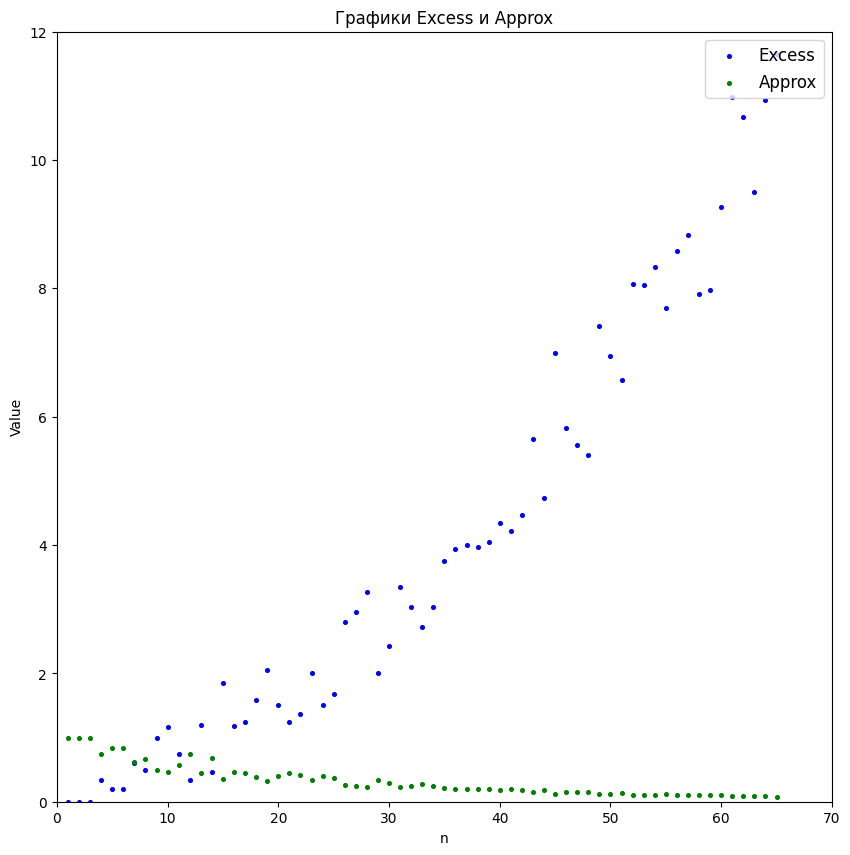

In [ ]:
Approx = [1, 1, 1, 0.75, 0.8333, 0.8333, 0.625, 0.6667, 0.5, 0.4615, 0.5714, 0.75, 0.4546, 0.6842, 0.3514, 0.4595, 0.4444, 0.3877, 0.3272, 0.4,
          0.4444, 0.4231, 0.3333, 0.4, 0.3735, 0.2626, 0.2523, 0.2342, 0.3333, 0.2925, 0.2302, 0.2481, 0.2706, 0.2483, 0.2105, 0.2021, 0.2, 0.2011, 0.198, 0.1869,
          0.1927, 0.183, 0.15, 0.1753, 0.125, 0.1467, 0.1524, 0.1577, 0.1188, 0.1262, 0.1324, 0.1103, 0.1111, 0.1074, 0.115, 0.1046, 0.1029, 0.1124, 0.1114, 0.0974,
          0.0838, 0.0857, 0.0952, 0.0842, 0.079]

Excess = [0, 0, 0, 0.3333, 0.2, 0.2, 0.6, 0.5, 1, 1.1667, 0.75, 0.3333, 1.2, 0.4615, 1.8462, 1.1765, 1.25, 1.5789, 2.0556, 1.5,
          1.25, 1.3636, 2, 1.5, 1.6774, 2.8076, 2.9643, 3.2692, 2, 2.4194, 3.3448, 3.0303, 2.7222, 3.027, 3.75, 3.9459, 4, 3.9736, 4.0513, 4.3514,
          4.2143, 4.4651, 5.6571, 4.7273, 7, 5.8182, 5.5609, 5.4091, 7.4211, 6.95, 6.5778, 8.0698, 8.0455, 8.3333, 7.6957, 8.587, 8.8372, 7.9167, 7.9783, 9.2667,
          10.9772, 10.6667, 9.5, 10.9318, 11.6522]


n = list(range(1, 66))


plt.figure(figsize=(10,10))
plt.scatter(n,Excess,marker='o',s=7,color='b',label='Excess')
plt.scatter(n,Approx,marker='o',s=7,color='g',label='Approx')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Графики Excess и Approx')
plt.xlabel('n')
plt.ylabel('Value')
plt.xlim([0, 70])
plt.ylim([0, 12])
plt.show()

## 2-й класс (Versicolour)

In [ ]:
# versicolor
iris2 = iris.data[50:100]

### PCA 2-й класс

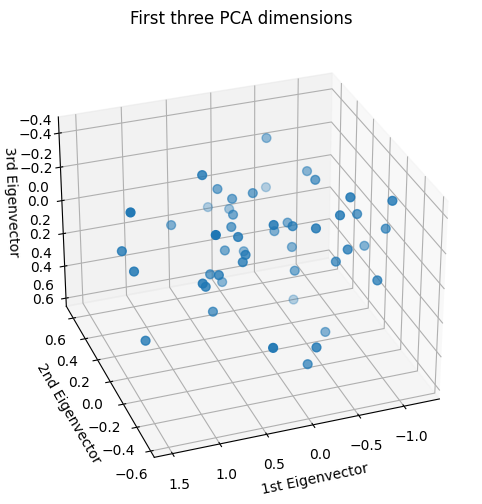

In [ ]:
import mpl_toolkits.mplot3d

from sklearn.decomposition import PCA

fig = plt.figure(1, figsize=(8, 6))
ax = fig.add_subplot(111, projection="3d", elev=-150, azim=110)

X_reduced2 = PCA(n_components=3).fit_transform(iris2)
ax.scatter(
    X_reduced2[:, 0],
    X_reduced2[:, 1],
    X_reduced2[:, 2],
    s=40,
)

ax.set_title("First three PCA dimensions")
ax.set_xlabel("1st Eigenvector")
# Добавляем разметку по оси X
ax.xaxis.set_tick_params(labelbottom=True)
ax.set_ylabel("2nd Eigenvector")
# Добавляем разметку по оси Y
ax.yaxis.set_tick_params(labelleft=True)
ax.set_zlabel("3rd Eigenvector")
# Добавляем разметку по оси Z
ax.zaxis.set_tick_params(labelright=True)

plt.show()

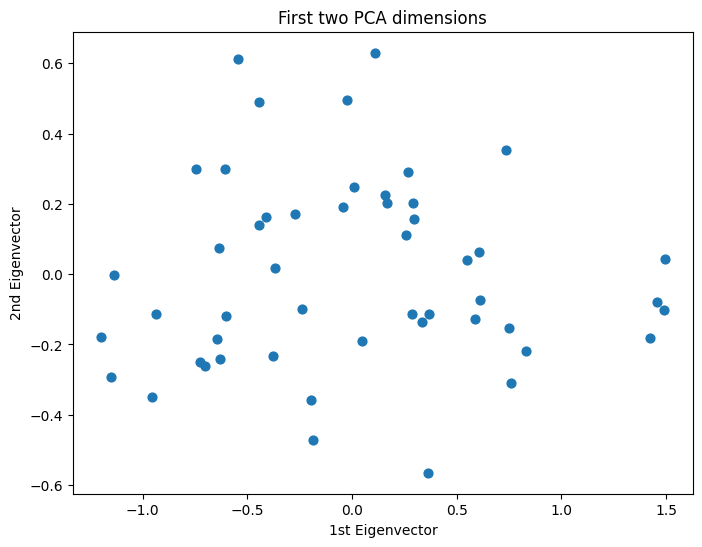

In [ ]:
# PCA 2 ГК

fig = plt.figure(1, figsize=(8, 6))
ax = fig.add_subplot(111)
ax.scatter(
    X_reduced2[:, 0],
    X_reduced2[:, 1],
    s=40,
)

ax.set_title("First two PCA dimensions")
ax.set_xlabel("1st Eigenvector")
# Добавляем разметку по оси X
ax.xaxis.set_tick_params(labelbottom=True)
ax.set_ylabel("2nd Eigenvector")
# Добавляем разметку по оси Y
ax.yaxis.set_tick_params(labelleft=True)

plt.show()

### Вычисление расстояний между точками

In [ ]:
def distance(point1, point2):
  # Вычисление расстояния по Евклиду
  return np.sqrt(np.sum((point1 - point2)**2))

# Инициализация матрицы расстояний
distances2 = np.zeros((len(iris2), len(iris2)))

# Вычисление расстояния между каждой точкой и каждой другой точкой
for i in range(len(iris2)):
  for j in range(len(iris2)):
    if i != j:
      distances2[i, j] = distance(iris2[i], iris2[j])

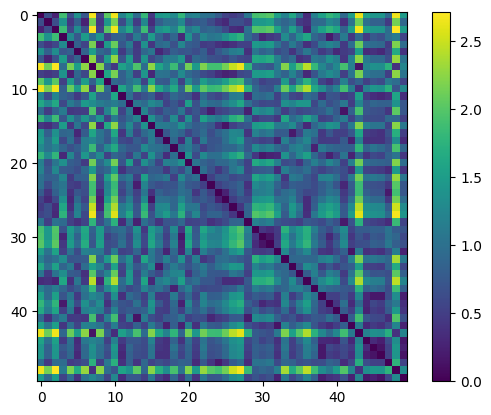

In [ ]:
# Визуализация матрицы расстояний с помощью тепловой карты
plt.imshow(distances2, cmap='viridis')
plt.colorbar()
plt.show()

In [ ]:
# Среднее по всем расстояниям:

# Вычислите сумму всех расстояний
total_distance2 = np.sum(distances2)

# Количество элементов (не считая диагональных)
n_elements = len(distances2) * (len(distances2) - 1)

# Рассчитайте среднее расстояние
average_distance2 = total_distance2 / n_elements

print(average_distance2)

0.9973606733116126


In [ ]:
# Вычислите среднее расстояние от каждой точки
average_distances_from_each_point2 = np.mean(distances2, axis=0)
print(average_distances_from_each_point2)

[1.31453249 0.92029984 1.28949402 0.94855236 0.90712937 0.77255292
 1.00759268 1.55485394 0.95322711 1.03791928 1.54097402 0.76066293
 0.99689327 0.81203901 1.00045579 1.02424417 0.85029656 0.79753859
 0.98989551 0.87994398 1.05146622 0.77890434 1.02193214 0.82823427
 0.82386989 0.93684132 1.14387432 1.2419326  0.75302227 1.07841104
 0.9785983  1.04781939 0.79453352 1.09173219 0.94785676 0.9784686
 1.07935803 0.93267835 0.81019833 0.86706605 0.85333121 0.78908166
 0.77297052 1.519059   0.76387266 0.77707301 0.73999003 0.75020572
 1.61835707 0.74083638]


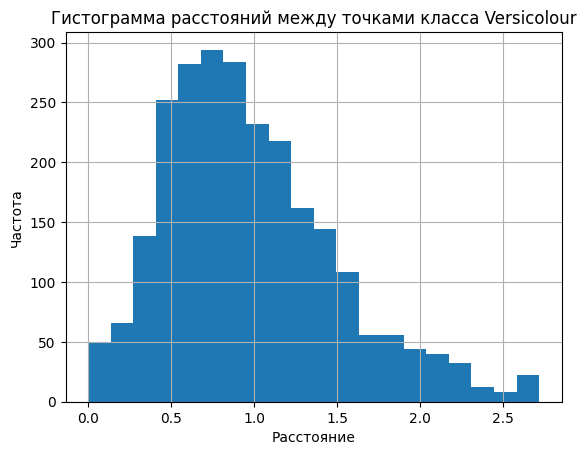

In [ ]:
# Преобразуйте distances в одномерный массив
distances2_1D = distances2.flatten()

# Определите диапазон значений
min_distance = np.min(distances2_1D)
max_distance = np.max(distances2_1D)

# Выберите количество интервалов
n_bins = 20


# Построение гистограммы
plt.hist(distances2_1D, bins=n_bins, range=(min_distance, max_distance))

# Настройка оформления
plt.xlabel("Расстояние")
plt.ylabel("Частота")
plt.title("Гистограмма расстояний между точками класса Versicolour")
plt.grid(True)
plt.show()

Наиболее частое значение: 0.6786935980249116


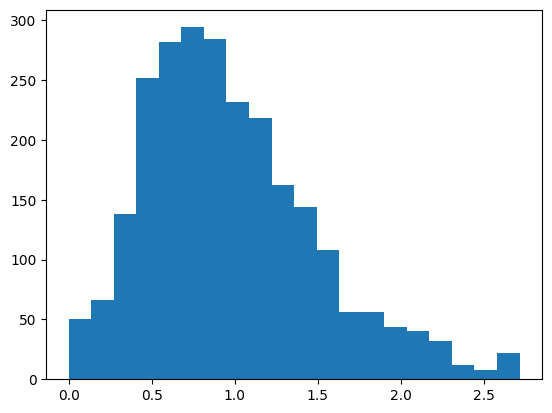

In [ ]:
# Извлечение данных из объекта Axes
counts, bins, patches = plt.hist(distances2_1D, bins=n_bins, range=(min_distance, max_distance))

# Определение наиболее частого диапазона
most_frequent_index = np.argmax(counts)

print("Наиболее частое значение:", bins[most_frequent_index])

### Расстояние по каждой оси

#### 1-й признак (длина чашелистика)

In [ ]:
first_column2 = np.take(iris2, 0, axis=1)
first_column2

array([7. , 6.4, 6.9, 5.5, 6.5, 5.7, 6.3, 4.9, 6.6, 5.2, 5. , 5.9, 6. ,
       6.1, 5.6, 6.7, 5.6, 5.8, 6.2, 5.6, 5.9, 6.1, 6.3, 6.1, 6.4, 6.6,
       6.8, 6.7, 6. , 5.7, 5.5, 5.5, 5.8, 6. , 5.4, 6. , 6.7, 6.3, 5.6,
       5.5, 5.5, 6.1, 5.8, 5. , 5.6, 5.7, 5.7, 6.2, 5.1, 5.7])

In [ ]:
print('min:', np.min(first_column2))
print('max:', np.max(first_column2))

((np.max(first_column2)+1)-(np.min(first_column2)-1))/0.2

min: 4.9
max: 7.0


20.499999999999996

In [ ]:
# Инициализация матрицы расстояний
ds21 = np.zeros((len(first_column2), len(first_column2)))

# Вычисление расстояния между каждой точкой и каждой другой точкой
for i in range(len(first_column2)):
  for j in range(len(first_column2)):
    if i != j:
      ds21[i, j] = distance(first_column2[i], first_column2[j])

In [ ]:
# Среднее по всем расстояниям:

# Вычислите сумму всех расстояний
total_21 = np.sum(ds21)

# Количество элементов (не считая диагональных)
n_elements = len(ds21) * (len(ds21) - 1)

# Рассчитайте среднее расстояние
av_ds21 = total_21 / n_elements

print(av_ds21)

0.5918367346938775


Наиболее частое значение: 0.0


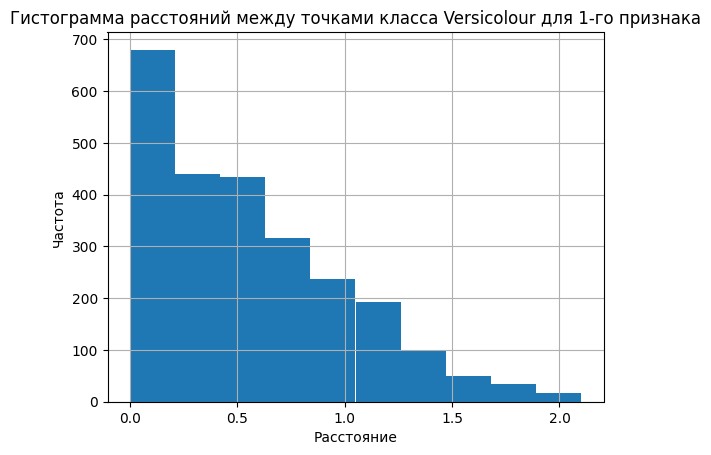

In [ ]:
# Преобразуйте distances в одномерный массив
ds21_1D = ds21.flatten()

# Определите диапазон значений
min_distance = np.min(ds21_1D)
max_distance = np.max(ds21_1D)

# Выберите количество интервалов
n_bins = 10


# Построение гистограммы
counts, bins, patches = plt.hist(ds21_1D, bins=n_bins, range=(min_distance, max_distance))
# Определение наиболее частого диапазона
most_frequent_index = np.argmax(counts)

print("Наиболее частое значение:", bins[most_frequent_index])

# Настройка оформления
plt.xlabel("Расстояние")
plt.ylabel("Частота")
plt.title("Гистограмма расстояний между точками класса Versicolour для 1-го признака")
plt.grid(True)
plt.show()

#### 2-й признак (ширина чашелистика)

In [ ]:
second_column2 = np.take(iris2, 1, axis=1)
second_column2

array([3.2, 3.2, 3.1, 2.3, 2.8, 2.8, 3.3, 2.4, 2.9, 2.7, 2. , 3. , 2.2,
       2.9, 2.9, 3.1, 3. , 2.7, 2.2, 2.5, 3.2, 2.8, 2.5, 2.8, 2.9, 3. ,
       2.8, 3. , 2.9, 2.6, 2.4, 2.4, 2.7, 2.7, 3. , 3.4, 3.1, 2.3, 3. ,
       2.5, 2.6, 3. , 2.6, 2.3, 2.7, 3. , 2.9, 2.9, 2.5, 2.8])

In [ ]:
print('min:', np.min(second_column2))
print('max:', np.max(second_column2))

((np.max(second_column2)+1)-(np.min(second_column2)-1))/0.2

min: 2.0
max: 3.4


17.0

In [ ]:
# Инициализация матрицы расстояний
ds22 = np.zeros((len(second_column2), len(second_column2)))

# Вычисление расстояния между каждой точкой и каждой другой точкой
for i in range(len(second_column2)):
  for j in range(len(second_column2)):
    if i != j:
      ds22[i, j] = distance(second_column2[i], second_column2[j])

In [ ]:
# Среднее по всем расстояниям:

# Вычислите сумму всех расстояний
total_22 = np.sum(ds22)

# Количество элементов (не считая диагональных)
n_elements = len(ds22) * (len(ds22) - 1)

# Рассчитайте среднее расстояние
av_ds22 = total_22 / n_elements

print(av_ds22)

0.35730612244897964


Наиболее частое значение: 0.0


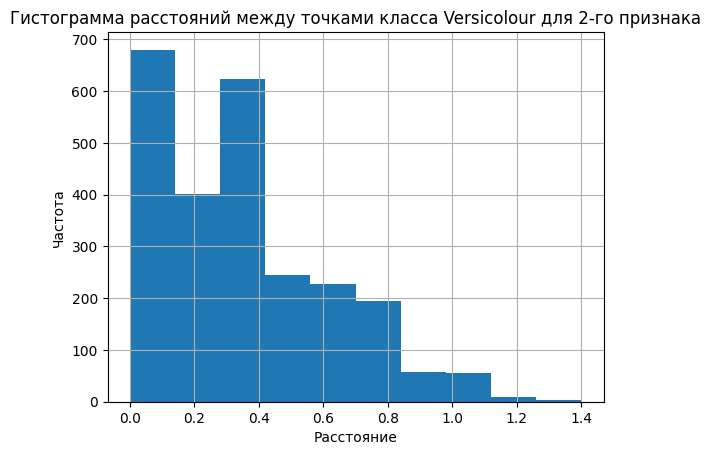

In [ ]:
# Преобразуйте distances в одномерный массив
ds22_1D = ds22.flatten()

# Определите диапазон значений
min_distance = np.min(ds22_1D)
max_distance = np.max(ds22_1D)

# Выберите количество интервалов
n_bins = 10


# Построение гистограммы
counts, bins, patches = plt.hist(ds22_1D, bins=n_bins, range=(min_distance, max_distance))
# Определение наиболее частого диапазона
most_frequent_index = np.argmax(counts)

print("Наиболее частое значение:", bins[most_frequent_index])

# Настройка оформления
plt.xlabel("Расстояние")
plt.ylabel("Частота")
plt.title("Гистограмма расстояний между точками класса Versicolour для 2-го признака")
plt.grid(True)
plt.show()

#### 3-й признак (длина лепестка)

In [ ]:
thr_column2 = np.take(iris2, 2, axis=1)
thr_column2

array([4.7, 4.5, 4.9, 4. , 4.6, 4.5, 4.7, 3.3, 4.6, 3.9, 3.5, 4.2, 4. ,
       4.7, 3.6, 4.4, 4.5, 4.1, 4.5, 3.9, 4.8, 4. , 4.9, 4.7, 4.3, 4.4,
       4.8, 5. , 4.5, 3.5, 3.8, 3.7, 3.9, 5.1, 4.5, 4.5, 4.7, 4.4, 4.1,
       4. , 4.4, 4.6, 4. , 3.3, 4.2, 4.2, 4.2, 4.3, 3. , 4.1])

In [ ]:
print('min:', np.min(thr_column2))
print('max:', np.max(thr_column2))

((np.max(thr_column2)+1)-(np.min(thr_column2)-1))/0.2

min: 3.0
max: 5.1


20.499999999999996

In [ ]:
# Инициализация матрицы расстояний
ds23 = np.zeros((len(thr_column2), len(thr_column2)))

# Вычисление расстояния между каждой точкой и каждой другой точкой
for i in range(len(thr_column2)):
  for j in range(len(thr_column2)):
    if i != j:
      ds23[i, j] = distance(thr_column2[i], thr_column2[j])

In [ ]:
# Среднее по всем расстояниям:

# Вычислите сумму всех расстояний
total_23 = np.sum(ds23)

# Количество элементов (не считая диагональных)
n_elements = len(ds23) * (len(ds23) - 1)

# Рассчитайте среднее расстояние
av_ds23 = total_23 / n_elements

print(av_ds23)

0.5304489795918367


Наиболее частое значение: 0.0


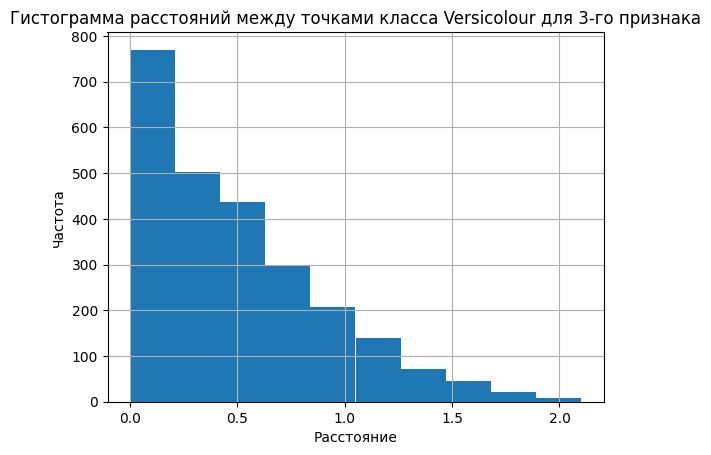

In [ ]:
# Преобразуйте distances в одномерный массив
ds23_1D = ds23.flatten()

# Определите диапазон значений
min_distance = np.min(ds23_1D)
max_distance = np.max(ds23_1D)

# Выберите количество интервалов
n_bins = 10


# Построение гистограммы
counts, bins, patches = plt.hist(ds23_1D, bins=n_bins, range=(min_distance, max_distance))
# Определение наиболее частого диапазона
most_frequent_index = np.argmax(counts)

print("Наиболее частое значение:", bins[most_frequent_index])

# Настройка оформления
plt.xlabel("Расстояние")
plt.ylabel("Частота")
plt.title("Гистограмма расстояний между точками класса Versicolour для 3-го признака")
plt.grid(True)
plt.show()

#### 4-й признак (ширина лепестка)

In [ ]:
fourth_column2 = np.take(iris2, 3, axis=1)
fourth_column2

array([1.4, 1.5, 1.5, 1.3, 1.5, 1.3, 1.6, 1. , 1.3, 1.4, 1. , 1.5, 1. ,
       1.4, 1.3, 1.4, 1.5, 1. , 1.5, 1.1, 1.8, 1.3, 1.5, 1.2, 1.3, 1.4,
       1.4, 1.7, 1.5, 1. , 1.1, 1. , 1.2, 1.6, 1.5, 1.6, 1.5, 1.3, 1.3,
       1.3, 1.2, 1.4, 1.2, 1. , 1.3, 1.2, 1.3, 1.3, 1.1, 1.3])

In [ ]:
print('min:', np.min(fourth_column2))
print('max:', np.max(fourth_column2))

((np.max(fourth_column2)+1)-(np.min(fourth_column2)-1))/0.2

min: 1.0
max: 1.8


13.999999999999998

In [ ]:
# Инициализация матрицы расстояний
ds24 = np.zeros((len(fourth_column2), len(fourth_column2)))

# Вычисление расстояния между каждой точкой и каждой другой точкой
for i in range(len(fourth_column2)):
  for j in range(len(fourth_column2)):
    if i != j:
      ds24[i, j] = distance(fourth_column2[i], fourth_column2[j])

In [ ]:
# Среднее по всем расстояниям:

# Вычислите сумму всех расстояний
total_24 = np.sum(ds24)

# Количество элементов (не считая диагональных)
n_elements = len(ds24) * (len(ds24) - 1)

# Рассчитайте среднее расстояние
av_ds24 = total_24 / n_elements

print(av_ds24)

0.22342857142857142


Наиболее частое значение: 0.08


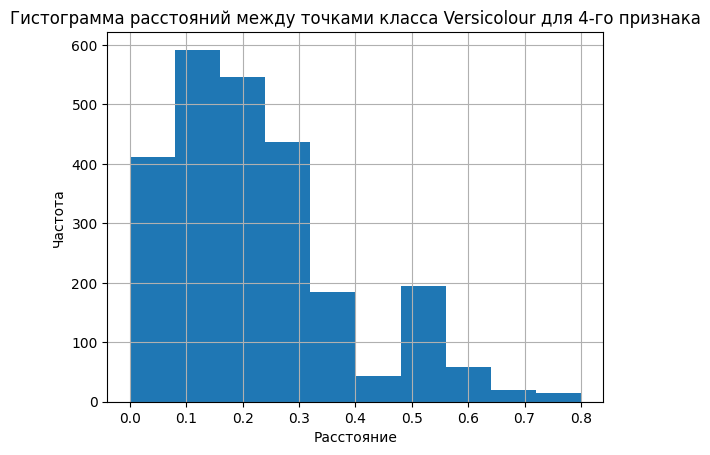

In [ ]:
# Преобразуйте distances в одномерный массив
ds24_1D = ds24.flatten()

# Определите диапазон значений
min_distance = np.min(ds24_1D)
max_distance = np.max(ds24_1D)

# Выберите количество интервалов
n_bins = 10


# Построение гистограммы
counts, bins, patches = plt.hist(ds24_1D, bins=n_bins, range=(min_distance, max_distance))
# Определение наиболее частого диапазона
most_frequent_index = np.argmax(counts)

print("Наиболее частое значение:", bins[most_frequent_index])

# Настройка оформления
plt.xlabel("Расстояние")
plt.ylabel("Частота")
plt.title("Гистограмма расстояний между точками класса Versicolour для 4-го признака")
plt.grid(True)
plt.show()

### Обучение АЕ

In [ ]:
#### Обучение Автокодировщика
size = iris2.shape[1]
patience = 4000
verbose_show = True
ae_ir2 = tensorflow.keras.models.Sequential()

# input layer
ae_ir2.add(tensorflow.keras.layers.Dense(size))
ae_ir2.add(tensorflow.keras.layers.Activation('tanh'))

# hidden layers
ae_ir2.add(tensorflow.keras.layers.Dense(100))
ae_ir2.add(tensorflow.keras.layers.Activation('tanh'))
ae_ir2.add(tensorflow.keras.layers.Dense(50))
ae_ir2.add(tensorflow.keras.layers.Activation('tanh'))
ae_ir2.add(tensorflow.keras.layers.Dense(30))
ae_ir2.add(tensorflow.keras.layers.Activation('tanh'))
ae_ir2.add(tensorflow.keras.layers.Dense(3))
ae_ir2.add(tensorflow.keras.layers.Activation('tanh'))
ae_ir2.add(tensorflow.keras.layers.Dense(30))
ae_ir2.add(tensorflow.keras.layers.Activation('tanh'))
ae_ir2.add(tensorflow.keras.layers.Dense(50))
ae_ir2.add(tensorflow.keras.layers.Activation('tanh'))
ae_ir2.add(tensorflow.keras.layers.Dense(100))
ae_ir2.add(tensorflow.keras.layers.Activation('tanh'))

# output layer
ae_ir2.add(tensorflow.keras.layers.Dense(size))
ae_ir2.add(tensorflow.keras.layers.Activation('linear'))

optimizer = tensorflow.keras.optimizers.Adam(learning_rate=0.001, beta_1=0.9, beta_2=0.999, amsgrad=False)
ae_ir2.compile(loss='mean_squared_error', optimizer=optimizer)
error_stop = 0.0001
epo = 12000

early_stopping_callback_on_error = EarlyStoppingOnValue(monitor='loss', baseline=error_stop)
early_stopping_callback_on_improving = tensorflow.keras.callbacks.EarlyStopping(monitor='loss',
                                                                                           min_delta=0.0001, patience = patience,
                                                                                           verbose=1, mode='auto',
                                                                                           baseline=None,
                                                                                           restore_best_weights=False)

history_callback = tensorflow.keras.callbacks.History()
verbose = 1 if verbose_show else 0
history_object = ae_ir2.fit(iris2, iris2,
                                batch_size=20,
                                epochs=epo,
                                callbacks=[early_stopping_callback_on_error, history_callback,
                                early_stopping_callback_on_improving],
                                verbose=verbose)
ae_ir2_trainned = ae_ir2
ae_ir2_pred = ae_ir2_trainned.predict(iris2)
ae_ir2_trainned.save('out/AE_ir2.h5')

Выходные данные были обрезаны до нескольких последних строк (5000).
Epoch 9502/12000
3/3 [==============================] - 0s 11ms/step - loss: 9.8060e-04
Epoch 9503/12000
3/3 [==============================] - 0s 9ms/step - loss: 8.4972e-04
Epoch 9504/12000
3/3 [==============================] - 0s 9ms/step - loss: 8.0895e-04
Epoch 9505/12000
3/3 [==============================] - 0s 8ms/step - loss: 8.7075e-04
Epoch 9506/12000
3/3 [==============================] - 0s 8ms/step - loss: 6.9896e-04
Epoch 9507/12000
3/3 [==============================] - 0s 7ms/step - loss: 6.9485e-04
Epoch 9508/12000
3/3 [==============================] - 0s 9ms/step - loss: 6.7469e-04
Epoch 9509/12000
3/3 [==============================] - 0s 7ms/step - loss: 6.4549e-04
Epoch 9510/12000
3/3 [==============================] - 0s 6ms/step - loss: 6.8148e-04
Epoch 9511/12000
3/3 [==============================] - 0s 8ms/step - loss: 6.8182e-04
Epoch 9512/12000
3/3 [==============================] - 0s 7m

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [ ]:
 # Сохранение AE
ae_ir2.save('best_model_for_ir2')

In [ ]:
# Загрузка автокодировщика
from keras.models import load_model
ae_ir2 = load_model('best_model_for_ir2')

ae_ir2_trainned = ae_ir2
ae_ir2_pred = ae_ir2_trainned.predict(iris2)
ae_ir2_trainned.save('out/AE_ir2.h5')

2/2 [==============================] - 0s 7ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [ ]:
iris2

array([[7. , 3.2, 4.7, 1.4],
       [6.4, 3.2, 4.5, 1.5],
       [6.9, 3.1, 4.9, 1.5],
       [5.5, 2.3, 4. , 1.3],
       [6.5, 2.8, 4.6, 1.5],
       [5.7, 2.8, 4.5, 1.3],
       [6.3, 3.3, 4.7, 1.6],
       [4.9, 2.4, 3.3, 1. ],
       [6.6, 2.9, 4.6, 1.3],
       [5.2, 2.7, 3.9, 1.4],
       [5. , 2. , 3.5, 1. ],
       [5.9, 3. , 4.2, 1.5],
       [6. , 2.2, 4. , 1. ],
       [6.1, 2.9, 4.7, 1.4],
       [5.6, 2.9, 3.6, 1.3],
       [6.7, 3.1, 4.4, 1.4],
       [5.6, 3. , 4.5, 1.5],
       [5.8, 2.7, 4.1, 1. ],
       [6.2, 2.2, 4.5, 1.5],
       [5.6, 2.5, 3.9, 1.1],
       [5.9, 3.2, 4.8, 1.8],
       [6.1, 2.8, 4. , 1.3],
       [6.3, 2.5, 4.9, 1.5],
       [6.1, 2.8, 4.7, 1.2],
       [6.4, 2.9, 4.3, 1.3],
       [6.6, 3. , 4.4, 1.4],
       [6.8, 2.8, 4.8, 1.4],
       [6.7, 3. , 5. , 1.7],
       [6. , 2.9, 4.5, 1.5],
       [5.7, 2.6, 3.5, 1. ],
       [5.5, 2.4, 3.8, 1.1],
       [5.5, 2.4, 3.7, 1. ],
       [5.8, 2.7, 3.9, 1.2],
       [6. , 2.7, 5.1, 1.6],
       [5.4, 3

In [ ]:
ae_ir2_pred

array([[6.996582  , 3.1967976 , 4.701155  , 1.3940994 ],
       [6.403949  , 3.2020586 , 4.499431  , 1.4880841 ],
       [6.891359  , 3.0966854 , 4.900541  , 1.4838989 ],
       [5.49996   , 2.30299   , 4.001437  , 1.2929709 ],
       [6.519437  , 2.7932928 , 4.590053  , 1.5036571 ],
       [5.6950355 , 2.791142  , 4.4975123 , 1.2846949 ],
       [6.2891192 , 3.300242  , 4.6956043 , 1.5935044 ],
       [4.8942137 , 2.3988006 , 3.298632  , 0.9903626 ],
       [6.583695  , 2.907087  , 4.6186247 , 1.2851819 ],
       [5.194647  , 2.6964471 , 3.906287  , 1.3913025 ],
       [4.9946294 , 1.9991084 , 3.503316  , 1.002935  ],
       [5.8936787 , 2.9952176 , 4.197226  , 1.4918925 ],
       [5.9948964 , 2.2032888 , 3.999191  , 1.0012351 ],
       [6.1038694 , 2.891457  , 4.7214913 , 1.3700721 ],
       [5.6003714 , 2.8943808 , 3.5947006 , 1.2945681 ],
       [6.687907  , 3.1045928 , 4.4099064 , 1.4034439 ],
       [5.588417  , 3.0158627 , 4.5073833 , 1.4810817 ],
       [5.8270636 , 2.6878393 ,

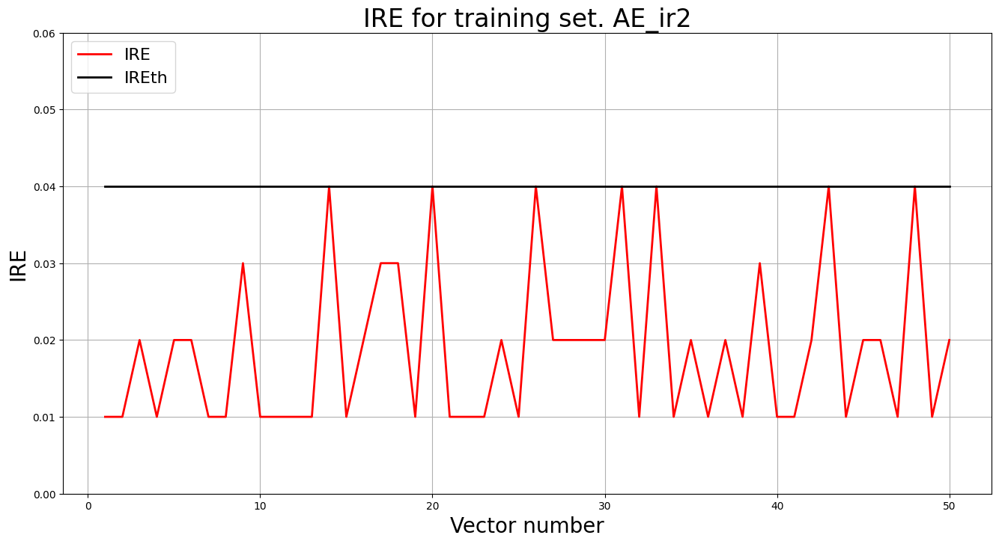

In [ ]:
# Ошибка реконструкции
irefile = 'out/AE_ir2_ire_th.txt'
IRE_array = np.round(ire_array(iris2, ae_ir2_pred), 2)
IREth = np.amax(IRE_array)
with open(irefile, 'w') as file:
    file.write(str(IREth))

IREir2 = IRE_array
IREth_ir2 = IREth

lib.ire_plot('training', IREir2, IREth, 'AE_ir2')

In [ ]:
IREth_ir2

0.04

In [ ]:
# Вычисление деф. множества

Z2, X_def2, X_plot, xx, yy, zz, ff = lib4dthelast60new.prediction(iris2, ae_ir2_trainned, IREth_ir2)

405000/405000 [==============================] - 1218s 3ms/step


In [ ]:
X_def2

array([[4.925     , 1.68      , 3.23      , 0.84      ],
       [4.925     , 1.68      , 3.23      , 0.88666667],
       [4.85666667, 1.73666667, 3.23      , 0.88666667],
       ...,
       [6.155     , 3.43666667, 4.59666667, 1.63333333],
       [6.22333333, 3.43666667, 4.52833333, 1.49333333],
       [6.22333333, 3.43666667, 4.59666667, 1.58666667]])

In [ ]:
X_def2.shape

(2789, 4)

In [ ]:
np.savetxt('X_def2.txt', X_def2)

In [ ]:
# Загрузка датасета

with open('/content/drive/My Drive/Colab Notebooks/X_def2.txt', 'r') as f:
    X_def2 = np.loadtxt(f)
X_def2

array([[4.925     , 1.68      , 3.23      , 0.84      ],
       [4.925     , 1.68      , 3.23      , 0.88666667],
       [4.85666667, 1.73666667, 3.23      , 0.88666667],
       ...,
       [6.155     , 3.43666667, 4.59666667, 1.63333333],
       [6.22333333, 3.43666667, 4.52833333, 1.49333333],
       [6.22333333, 3.43666667, 4.59666667, 1.58666667]])

### Граница АЕ

In [ ]:
# Объедините массивы по столбцам
combined_data2 = np.concatenate([iris2, X_def2])

combined_data2

array([[7.        , 3.2       , 4.7       , 1.4       ],
       [6.4       , 3.2       , 4.5       , 1.5       ],
       [6.9       , 3.1       , 4.9       , 1.5       ],
       ...,
       [6.155     , 3.43666667, 4.59666667, 1.63333333],
       [6.22333333, 3.43666667, 4.52833333, 1.49333333],
       [6.22333333, 3.43666667, 4.59666667, 1.58666667]])

In [ ]:
combined_data2.shape

(2839, 4)

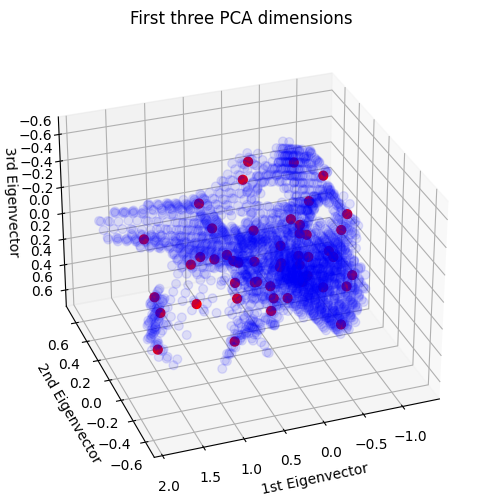

In [ ]:
# PCA 3 ГК
import mpl_toolkits.mplot3d
from sklearn.decomposition import PCA

fig = plt.figure(1, figsize=(8, 6))
ax = fig.add_subplot(111, projection="3d", elev=-150, azim=110)

X_combo2 = PCA(n_components=3).fit_transform(combined_data2.data)

ax.scatter(
    X_combo2[0:50, 0],
    X_combo2[0:50, 1],
    X_combo2[0:50, 2],
    c = 'red',
    s=40,
    alpha=1
)

ax.scatter(
    X_combo2[50:, 0],
    X_combo2[50:, 1],
    X_combo2[50:, 2],
    c = 'blue',
    s=40,
    alpha=0.1
)



ax.set_title("First three PCA dimensions")
ax.set_xlabel("1st Eigenvector")
# Добавляем разметку по оси X
ax.xaxis.set_tick_params(labelbottom=True)
ax.set_ylabel("2nd Eigenvector")
# Добавляем разметку по оси Y
ax.yaxis.set_tick_params(labelleft=True)
ax.set_zlabel("3rd Eigenvector")
# Добавляем разметку по оси Z
ax.zaxis.set_tick_params(labelright=True)

plt.show()

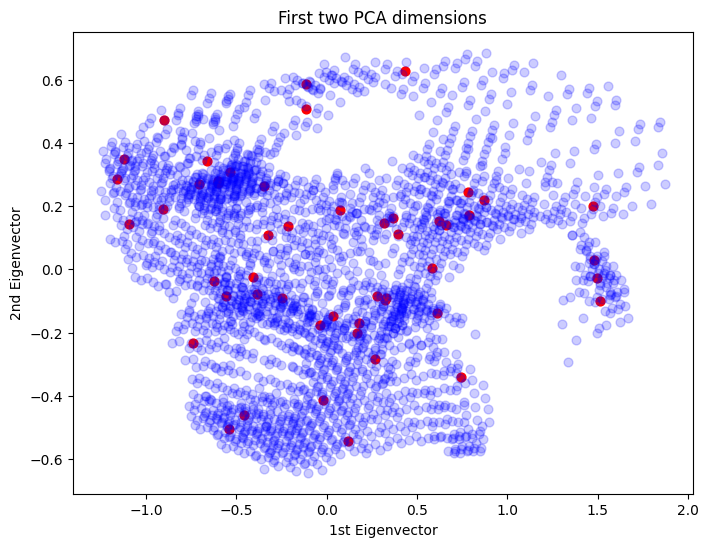

In [ ]:
# PCA 2 ГК

fig = plt.figure(1, figsize=(8, 6))
ax = fig.add_subplot(111)

ax.scatter(
    X_combo2[0:50, 0],
    X_combo2[0:50, 1],
    c = 'red',
    s=40,
    alpha=1
)

ax.scatter(
    X_combo2[50:, 0],
    X_combo2[50:, 1],
    c = 'blue',
    s=40,
    alpha=0.2
)


ax.set_title("First two PCA dimensions")
ax.set_xlabel("1st Eigenvector")
# Добавляем разметку по оси X
ax.xaxis.set_tick_params(labelbottom=True)
ax.set_ylabel("2nd Eigenvector")
# Добавляем разметку по оси Y
ax.yaxis.set_tick_params(labelleft=True)

plt.show()

### Вычисление EDCA

In [ ]:
numb_square = 51

amount, amount_ae = lib4dthelast55new.calculations(numb_square, X, iris2, X_def2, '_ir2')

min:  -0.9
max:  8.9
amount:  47
amount_ae:  472

Оценка качества AE_ir2
IDEAL = 0. Excess:  9.063829787234043
IDEAL = 0. Deficit:  0.02127659574468085
IDEAL = 1. Coating:  0.9787234042553191
summa:  1.0
IDEAL = 1. Extrapolation precision (Approx):  0.09957627118644068




### График Excess

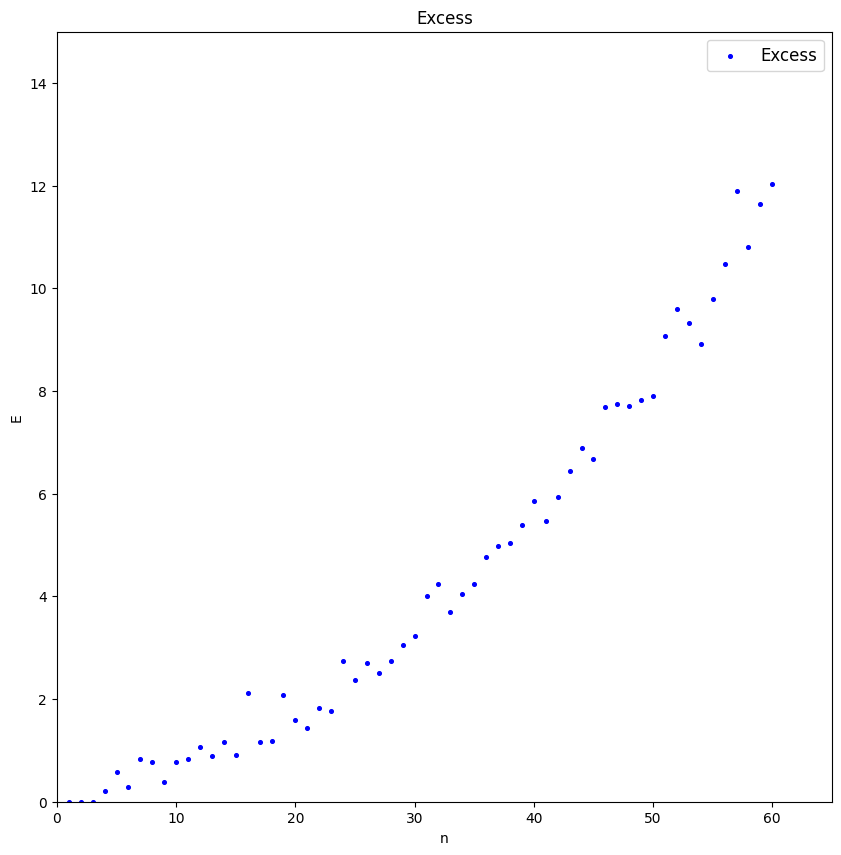

In [ ]:
Excess = [0, 0, 0, 0.2, 0.5714, 0.2857, 0.8333, 0.7778, 0.3846, 0.7692, 0.8333, 1.0625, 0.8889, 1.1667, 0.913, 2.1177, 1.1667, 1.1852, 2.087, 1.5862,
          1.4412, 1.8182, 1.7714, 2.7419, 2.3714, 2.6944, 2.5135, 2.7436, 3.0526, 3.2195, 4, 4.2432, 3.6889, 4.0488, 4.25, 4.7674, 4.9778, 5.0455, 5.4, 5.8605,
          5.4681, 5.9362, 6.4444, 6.8913, 6.6667, 7.6889, 7.7447, 7.7083, 7.8333, 7.898, 9.0638, 9.5957, 9.3192, 8.92, 9.8, 10.4694, 11.8936, 10.8125, 11.6531, 12.0408]


n = list(range(1, 61))

plt.figure(figsize=(10,10))
plt.scatter(n,Excess,marker='o',s=7,color='b',label='Excess')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.xlim([0, 65])
plt.ylim([0, 15])
plt.show()

### Среднее

In [ ]:
nn = np.arange(1,61)

av = []
for i in nn:
  av.append(np.mean(Excess[0:i]))

print(av)

[0.0, 0.0, 0.0, 0.05, 0.15428000000000003, 0.17618333333333336, 0.2700571428571429, 0.333525, 0.3392, 0.3822, 0.4232090909090909, 0.47648333333333337, 0.5082076923076924, 0.5552428571428571, 0.5790933333333333, 0.67525625, 0.704164705882353, 0.7308888888888889, 0.8022631578947369, 0.84146, 0.8700190476190476, 0.9131181818181818, 0.9504347826086956, 1.0250791666666668, 1.078932, 1.1410653846153846, 1.1918962962962965, 1.2473142857142858, 1.3095655172413794, 1.37323, 1.4579645161290322, 1.545003125, 1.6099696969696968, 1.6817, 1.75508, 1.8387555555555555, 1.9235945945945947, 2.0057500000000004, 2.0927820512820516, 2.186975, 2.2670024390243904, 2.354364285714286, 2.4494813953488372, 2.5504318181818184, 2.6419044444444446, 2.751621739130435, 2.857857446808511, 2.9589083333333335, 3.0583857142857145, 3.1551780000000003, 3.2710333333333335, 3.3926615384615384, 3.504483018867924, 3.6047703703703697, 3.717410909090909, 3.8379821428571432, 3.9793087719298246, 4.0971224137931035, 4.2251898305084

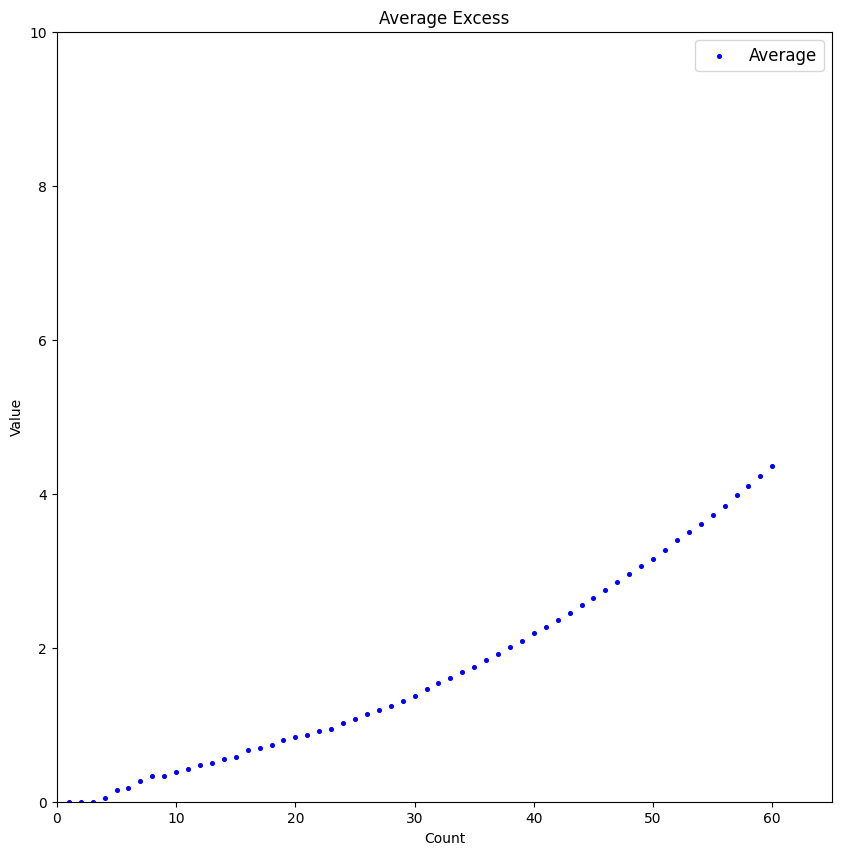

In [ ]:
plt.figure(figsize=(10,10))
plt.scatter(nn,av,marker='o',s=7,color='b',label='Average')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Average Excess')
plt.xlabel('Count')
plt.ylabel('Value')
plt.xlim([0, 65])
plt.ylim([0, 10])
plt.show()

### Аппроксимация МНК

In [ ]:
x = np.array(n)
y = np.array(Excess)

linear_func = lambda x, b0, b1: b0 + b1*x
quadratic_func = lambda x, b0, b1, b2: b0 + b1*x + b2*x**2
qubic_func = lambda x, b0, b1, b2, b3: b0 + b1*x + b2*x**2 + b3*x**3
exp_func = lambda x, b0, b1, b2: b0 + b1*np.exp(b2*x)
exp1_func = lambda x, b0, b1, b2: b0 + b1*np.exp(x-b2)
exp2_func = lambda x, b0, b1: b0*np.power(b1,x)
exp3_func = lambda x, b0, b1, b2:  b0 + b1*np.power(b2,x)


from scipy.optimize import leastsq

# list of model
model_list = [
    'linear', 'quadratic',
    'qubic', 'exp3']

# model reference
models_dict = {
        'linear':             linear_func,
        'quadratic':          quadratic_func,
        'qubic':              qubic_func,
        'exp3':               exp3_func}

# initial values
p0_dict = {
        'linear':             [0, 0],
        'quadratic':          [0, 0, 0],
        'qubic':              [0, 0, 0, 0],
        'exp3':               [0, 1, 1]}

# titles (formulas)
formulas_dict = {
        'linear':             'y = b0 + b1*x',
        'quadratic':          'y = b0 + b1*x + b2*x^2',
        'qubic':              'y = b0 + b1*x + b2*x^2 + b3*x^3',
        'exp3':               'y = b0 + b1*np.power(b2,x)'}

# actual data
X_fact = x
Y_fact = y

# function for calculating residuals
residual_func = lambda p, x, y: y - func(x, *p)

# return all optional outputs
full_output = True

# variables to save the calculation results
calculation_results_df = pd.DataFrame(columns=['func', 'p0', 'popt', 'cov_x', 'SSE', 'MSE', 'pcov', 'perr', 'Y_calc', 'error_metrics'])
error_metrics_results_df = pd.DataFrame(columns=['MSE', 'RMSE', 'MAE', 'MSPE', 'MAPE', 'RMSLE', 'R2'])

# calculations
for func_name in model_list:
    print(f'{func_name.upper()} MODEL: {formulas_dict[func_name]}')
    func = models_dict[func_name]
    calculation_results_df.loc[func_name, 'func'] = func
    p0 = p0_dict[func_name]
    print(f'p0 = {p0}')
    calculation_results_df.loc[func_name, 'p0'] = p0
    if full_output:
        (popt, cov_x, infodict, mesg, ier) = leastsq(residual_func, p0, args=(X_fact, Y_fact), full_output=full_output)
        integer_flag = f'ier = {ier}, the solution was found' if ier<=4 else f'ier = {ier}, the solution was not found'
        print(integer_flag, '\n', mesg)
        calculation_results_df.loc[func_name, 'popt'] = popt
        print(f'parameters = {popt}')
        calculation_results_df.loc[func_name, 'cov_x'] = cov_x
        print(f'cov_x = \n{cov_x}')
        #SSE = (residual_func(popt, X_fact, Y_fact)**2).sum()
        SSE = (infodict['fvec']**2).sum()
        calculation_results_df.loc[func_name, 'SSE'] = SSE
        print(f'SSE = {SSE}')
        MSE = SSE / (len(Y_fact)-len(p0))
        calculation_results_df.loc[func_name, 'MSE'] = MSE
        print(f'MSE = {MSE}')
        pcov = cov_x * MSE
        calculation_results_df.loc[func_name, 'pcov'] = pcov
        print(f'pcov =\n {pcov}')
        perr = np.sqrt(np.diag(pcov))
        calculation_results_df.loc[func_name, 'perr'] = perr
        print(f'perr = {perr}\n')
    else:
        popt = leastsq(residual_func, p0, args=(X_fact, Y_fact), full_output=full_output)
        calculation_results_df.loc[func_name, 'popt'] = popt
        print(f'parameters = {popt}\n')
    Y_calc = func(X_fact, *popt)
    calculation_results_df.loc[func_name, 'Y_calc'] = Y_calc
    (error_metrics_dict, error_metrics_df) = regression_error_metrics(Yfact=Y_fact, Ycalc=Y_calc, model_name=func_name)
    calculation_results_df.loc[func_name, 'error_metrics'] = error_metrics_dict.values()
    error_metrics_results_df = pd.concat([error_metrics_results_df, error_metrics_df])

LINEAR MODEL: y = b0 + b1*x
p0 = [0, 0]
ier = 3, the solution was found 
 Both actual and predicted relative reductions in the sum of squares
  are at most 0.000000 and the relative error between two consecutive iterates is at 
  most 0.000000
parameters = [-1.68163308  0.19793715]
cov_x = 
[[ 6.83615801e-02 -1.69491519e-03]
 [-1.69491519e-03  5.55709898e-05]]
SSE = 45.476230885754376
MSE = 0.7840729463061099
pcov =
 [[ 5.36004656e-02 -1.32893715e-03]
 [-1.32893715e-03  4.35717097e-05]]
perr = [0.23151774 0.00660089]

QUADRATIC MODEL: y = b0 + b1*x + b2*x^2
p0 = [0, 0, 0]
ier = 1, the solution was found 
 Both actual and predicted relative reductions in the sum of squares
  are at most 0.000000
parameters = [0.20850365 0.01502069 0.00299863]
cov_x = 
[[ 1.60461721e-01 -1.06078322e-02  1.46113397e-04]
 [-1.06078322e-02  9.18111355e-04 -1.41400062e-05]
 [ 1.46113397e-04 -1.41400062e-05  2.31803384e-07]]
SSE = 6.6856611936867445
MSE = 0.1172923016436271
pcov =
 [[ 1.88209246e-02 -1.244217

<ipython-input-7-a10df777837d>:36: RuntimeWarning: divide by zero encountered in divide
  MSPE = (1/n_fit) *  np.sum(((Yfact-Ycalc)/Yfact)**2)
<ipython-input-7-a10df777837d>:37: RuntimeWarning: divide by zero encountered in divide
  MAPE = (1/n_fit) *  np.sum(abs((Yfact-Ycalc)/Yfact))
<ipython-input-7-a10df777837d>:38: RuntimeWarning: invalid value encountered in log
  RMSLE = math.sqrt((1/n_fit) * np.sum((np.log(Yfact + 1)-np.log(Ycalc + 1))**2))
<ipython-input-7-a10df777837d>:36: RuntimeWarning: divide by zero encountered in divide
  MSPE = (1/n_fit) *  np.sum(((Yfact-Ycalc)/Yfact)**2)
<ipython-input-7-a10df777837d>:37: RuntimeWarning: divide by zero encountered in divide
  MAPE = (1/n_fit) *  np.sum(abs((Yfact-Ycalc)/Yfact))
<ipython-input-7-a10df777837d>:36: RuntimeWarning: divide by zero encountered in divide
  MSPE = (1/n_fit) *  np.sum(((Yfact-Ycalc)/Yfact)**2)
<ipython-input-7-a10df777837d>:37: RuntimeWarning: divide by zero encountered in divide
  MAPE = (1/n_fit) *  np.sum(ab

#### 1-я степень

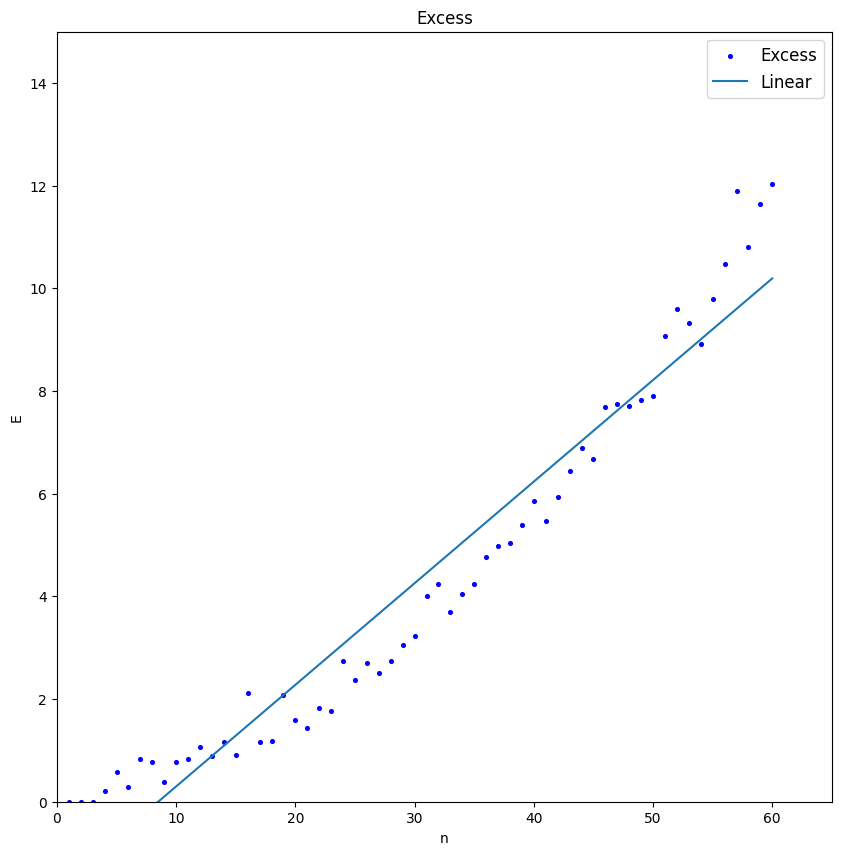

In [ ]:
b0, b1 = [-1.68163308,  0.19793715]

xx = np.arange (1,61)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='b',label='Excess')
plt.plot(xx, b0 + b1*xx , label = 'Linear')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.xlim([0, 65])
plt.ylim([0, 15])
plt.show()

#### 2-я степень

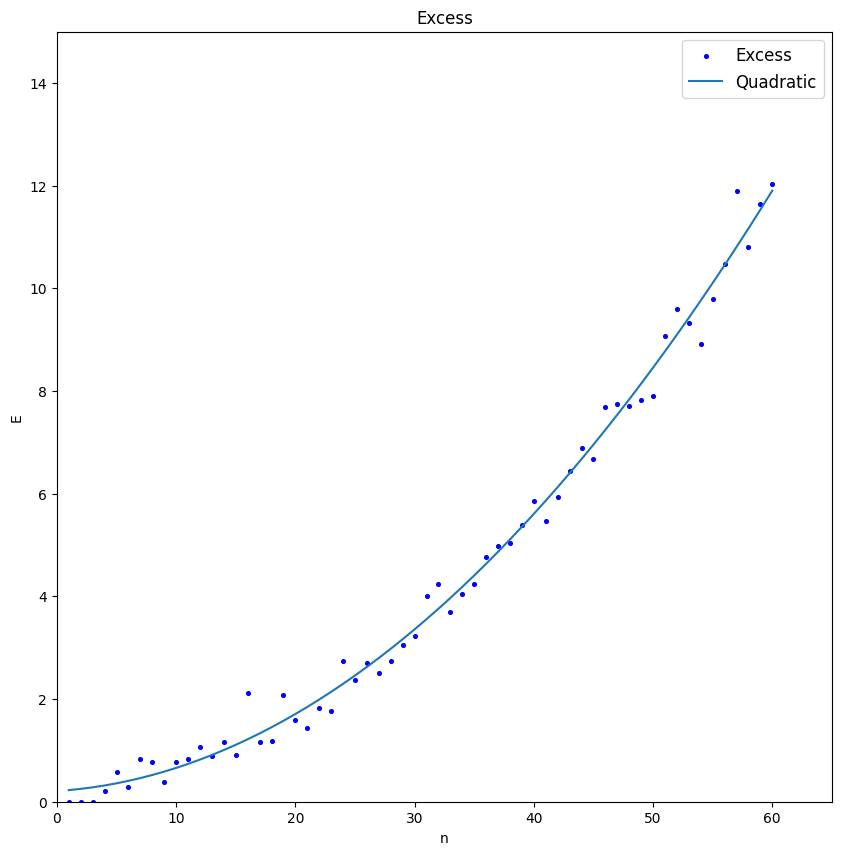

In [ ]:
b0, b1, b2 = [0.20850365, 0.01502069, 0.00299863]

xx = np.arange (1,61)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='b',label='Excess')
plt.plot(xx, b0 + b1*xx + b2*xx**2 , label = 'Quadratic')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.xlim([0, 65])
plt.ylim([0, 15])
plt.show()

#### 3-я степень

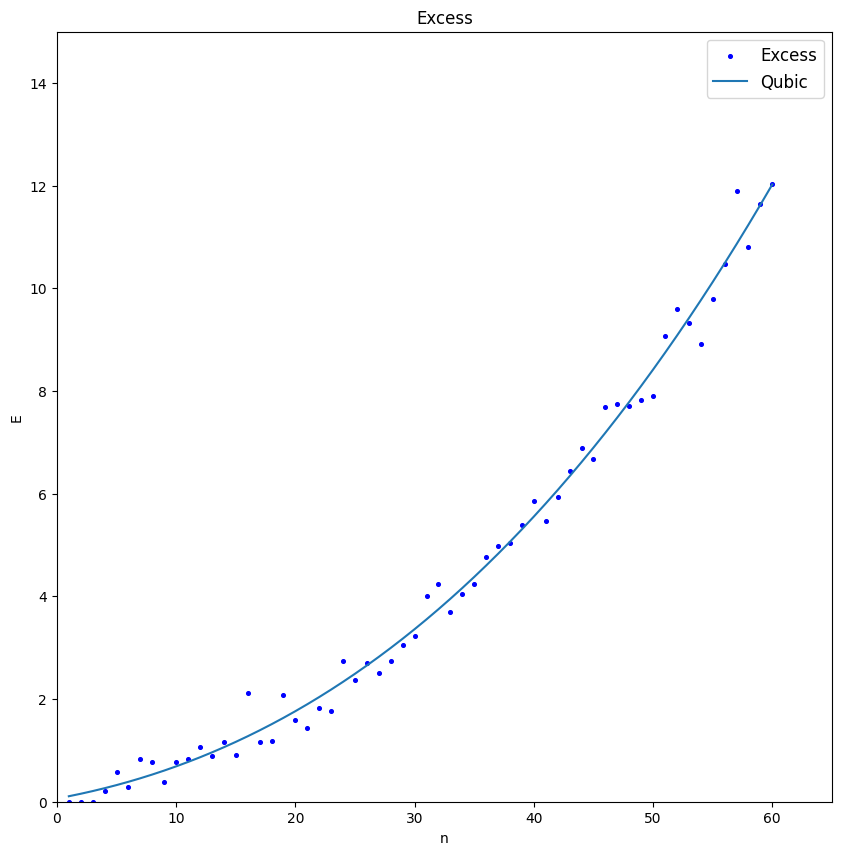

In [ ]:
b0, b1, b2, b3 =[6.21377167e-02, 4.26775447e-02, 1.87446808e-03, 1.22859272e-05]

xx = np.arange (1,61)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='b',label='Excess')
plt.plot(xx, b0 + b1*xx + b2*xx**2 + b3*xx**3 , label = 'Qubic')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.xlim([0, 65])
plt.ylim([0, 15])
plt.show()

#### EXP

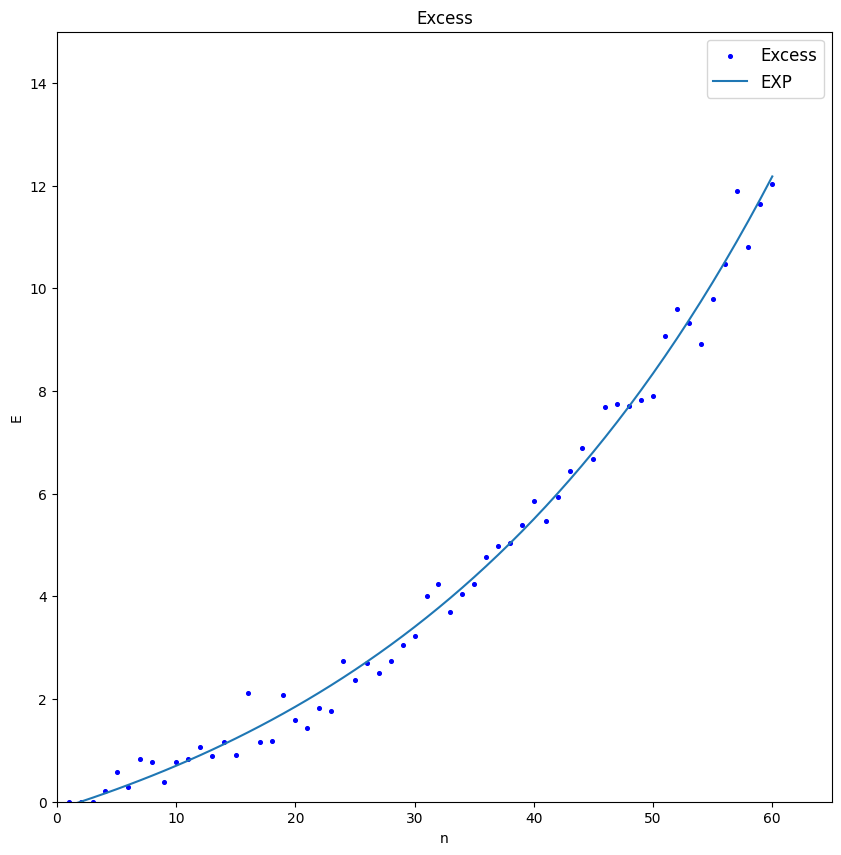

In [ ]:
b0, b1, b2 = [-2.57178235,  2.42150053,  1.03057533]

xx = np.arange (1,61)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='b',label='Excess')
plt.plot(xx, b0 + b1*np.power(b2,xx) , label = 'EXP')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.xlim([0, 65])
plt.ylim([0, 15])
plt.show()

### Несколько точек (Excess)

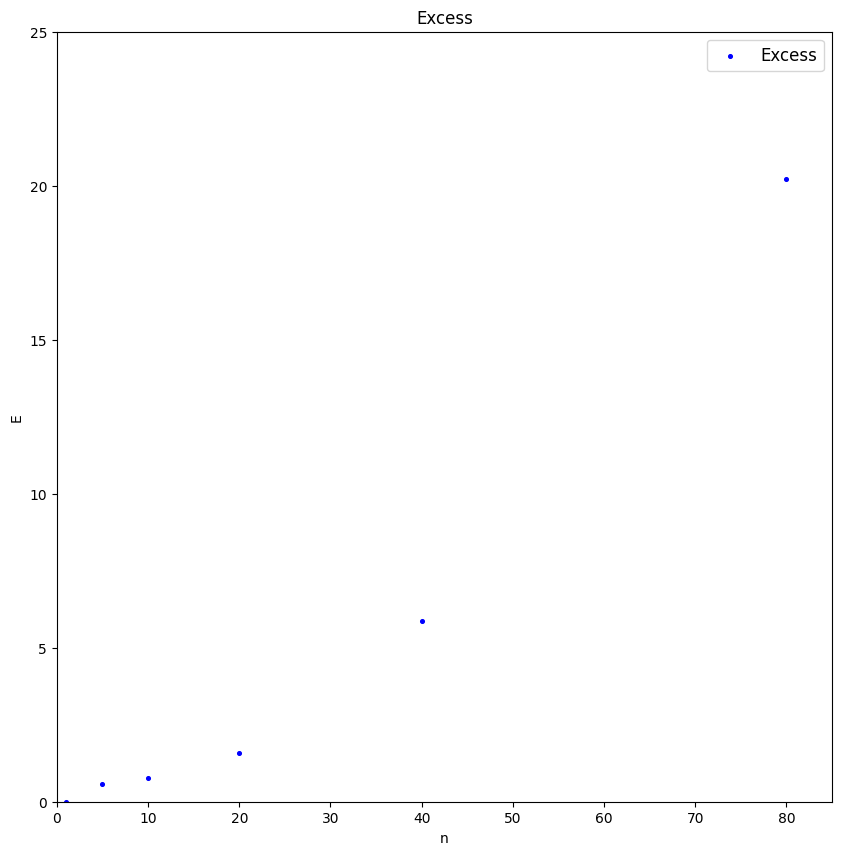

In [ ]:
Excess = [0, 0.5714, 0.7692, 1.5862, 5.8605, 20.2245]
n = [1, 5, 10, 20, 40, 80]

plt.figure(figsize=(10,10))
plt.scatter(n,Excess,marker='o',s=7,color='b',label='Excess')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.xlim([0, 85])
plt.ylim([0, 25])
plt.show()

In [ ]:
x = np.array(n)
y = np.array(Excess)

linear_func = lambda x, b0, b1: b0 + b1*x
quadratic_func = lambda x, b0, b1, b2: b0 + b1*x + b2*x**2
qubic_func = lambda x, b0, b1, b2, b3: b0 + b1*x + b2*x**2 + b3*x**3
exp_func = lambda x, b0, b1, b2: b0 + b1*np.exp(b2*x)
exp1_func = lambda x, b0, b1, b2: b0 + b1*np.exp(x-b2)
exp2_func = lambda x, b0, b1: b0*np.power(b1,x)
exp3_func = lambda x, b0, b1, b2:  b0 + b1*np.power(b2,x)


from scipy.optimize import leastsq

# list of model
model_list = [
    'linear', 'quadratic',
    'qubic', 'exp3']

# model reference
models_dict = {
        'linear':             linear_func,
        'quadratic':          quadratic_func,
        'qubic':              qubic_func,
        'exp3':               exp3_func}

# initial values
p0_dict = {
        'linear':             [0, 0],
        'quadratic':          [0, 0, 0],
        'qubic':              [0, 0, 0, 0],
        'exp3':               [0, 1, 1]}

# titles (formulas)
formulas_dict = {
        'linear':             'y = b0 + b1*x',
        'quadratic':          'y = b0 + b1*x + b2*x^2',
        'qubic':              'y = b0 + b1*x + b2*x^2 + b3*x^3',
        'exp3':               'y = b0 + b1*np.power(b2,x)'}

# actual data
X_fact = x
Y_fact = y

# function for calculating residuals
residual_func = lambda p, x, y: y - func(x, *p)

# return all optional outputs
full_output = True

# variables to save the calculation results
calculation_results_df = pd.DataFrame(columns=['func', 'p0', 'popt', 'cov_x', 'SSE', 'MSE', 'pcov', 'perr', 'Y_calc', 'error_metrics'])
error_metrics_results_df = pd.DataFrame(columns=['MSE', 'RMSE', 'MAE', 'MSPE', 'MAPE', 'RMSLE', 'R2'])

# calculations
for func_name in model_list:
    print(f'{func_name.upper()} MODEL: {formulas_dict[func_name]}')
    func = models_dict[func_name]
    calculation_results_df.loc[func_name, 'func'] = func
    p0 = p0_dict[func_name]
    print(f'p0 = {p0}')
    calculation_results_df.loc[func_name, 'p0'] = p0
    if full_output:
        (popt, cov_x, infodict, mesg, ier) = leastsq(residual_func, p0, args=(X_fact, Y_fact), full_output=full_output)
        integer_flag = f'ier = {ier}, the solution was found' if ier<=4 else f'ier = {ier}, the solution was not found'
        print(integer_flag, '\n', mesg)
        calculation_results_df.loc[func_name, 'popt'] = popt
        print(f'parameters = {popt}')
        calculation_results_df.loc[func_name, 'cov_x'] = cov_x
        print(f'cov_x = \n{cov_x}')
        #SSE = (residual_func(popt, X_fact, Y_fact)**2).sum()
        SSE = (infodict['fvec']**2).sum()
        calculation_results_df.loc[func_name, 'SSE'] = SSE
        print(f'SSE = {SSE}')
        MSE = SSE / (len(Y_fact)-len(p0))
        calculation_results_df.loc[func_name, 'MSE'] = MSE
        print(f'MSE = {MSE}')
        pcov = cov_x * MSE
        calculation_results_df.loc[func_name, 'pcov'] = pcov
        print(f'pcov =\n {pcov}')
        perr = np.sqrt(np.diag(pcov))
        calculation_results_df.loc[func_name, 'perr'] = perr
        print(f'perr = {perr}\n')
    else:
        popt = leastsq(residual_func, p0, args=(X_fact, Y_fact), full_output=full_output)
        calculation_results_df.loc[func_name, 'popt'] = popt
        print(f'parameters = {popt}\n')
    Y_calc = func(X_fact, *popt)
    calculation_results_df.loc[func_name, 'Y_calc'] = Y_calc
    (error_metrics_dict, error_metrics_df) = regression_error_metrics(Yfact=Y_fact, Ycalc=Y_calc, model_name=func_name)
    calculation_results_df.loc[func_name, 'error_metrics'] = error_metrics_dict.values()
    error_metrics_results_df = pd.concat([error_metrics_results_df, error_metrics_df])

LINEAR MODEL: y = b0 + b1*x
p0 = [0, 0]
ier = 1, the solution was found 
 Both actual and predicted relative reductions in the sum of squares
  are at most 0.000000
parameters = [-1.79758617  0.25511101]
cov_x = 
[[ 3.17897082e-01 -5.81655440e-03]
 [-5.81655440e-03  2.23713637e-04]]
SSE = 15.61443391846979
MSE = 3.9036084796174473
pcov =
 [[ 1.24094575e+00 -2.27055511e-02]
 [-2.27055511e-02  8.73290452e-04]]
perr = [1.11397744 0.02955149]

QUADRATIC MODEL: y = b0 + b1*x + b2*x^2
p0 = [0, 0, 0]
ier = 3, the solution was found 
 Both actual and predicted relative reductions in the sum of squares
  are at most 0.000000 and the relative error between two consecutive iterates is at 
  most 0.000000
parameters = [0.11807756 0.03035755 0.0027642 ]
cov_x = 
[[ 5.55248506e-01 -3.36635856e-02  3.42485130e-04]
 [-3.36635856e-02  3.49084015e-03 -4.01817423e-05]
 [ 3.42485130e-04 -4.01817423e-05  4.94187296e-07]]
SSE = 0.15310597007569526
MSE = 0.05103532335856509
pcov =
 [[ 2.83372870e-02 -1.71803

<ipython-input-7-a10df777837d>:36: RuntimeWarning: divide by zero encountered in divide
  MSPE = (1/n_fit) *  np.sum(((Yfact-Ycalc)/Yfact)**2)
<ipython-input-7-a10df777837d>:37: RuntimeWarning: divide by zero encountered in divide
  MAPE = (1/n_fit) *  np.sum(abs((Yfact-Ycalc)/Yfact))
<ipython-input-7-a10df777837d>:38: RuntimeWarning: invalid value encountered in log
  RMSLE = math.sqrt((1/n_fit) * np.sum((np.log(Yfact + 1)-np.log(Ycalc + 1))**2))
<ipython-input-7-a10df777837d>:36: RuntimeWarning: divide by zero encountered in divide
  MSPE = (1/n_fit) *  np.sum(((Yfact-Ycalc)/Yfact)**2)
<ipython-input-7-a10df777837d>:37: RuntimeWarning: divide by zero encountered in divide
  MAPE = (1/n_fit) *  np.sum(abs((Yfact-Ycalc)/Yfact))
<ipython-input-7-a10df777837d>:36: RuntimeWarning: divide by zero encountered in divide
  MSPE = (1/n_fit) *  np.sum(((Yfact-Ycalc)/Yfact)**2)
<ipython-input-7-a10df777837d>:37: RuntimeWarning: divide by zero encountered in divide
  MAPE = (1/n_fit) *  np.sum(ab

3 степень

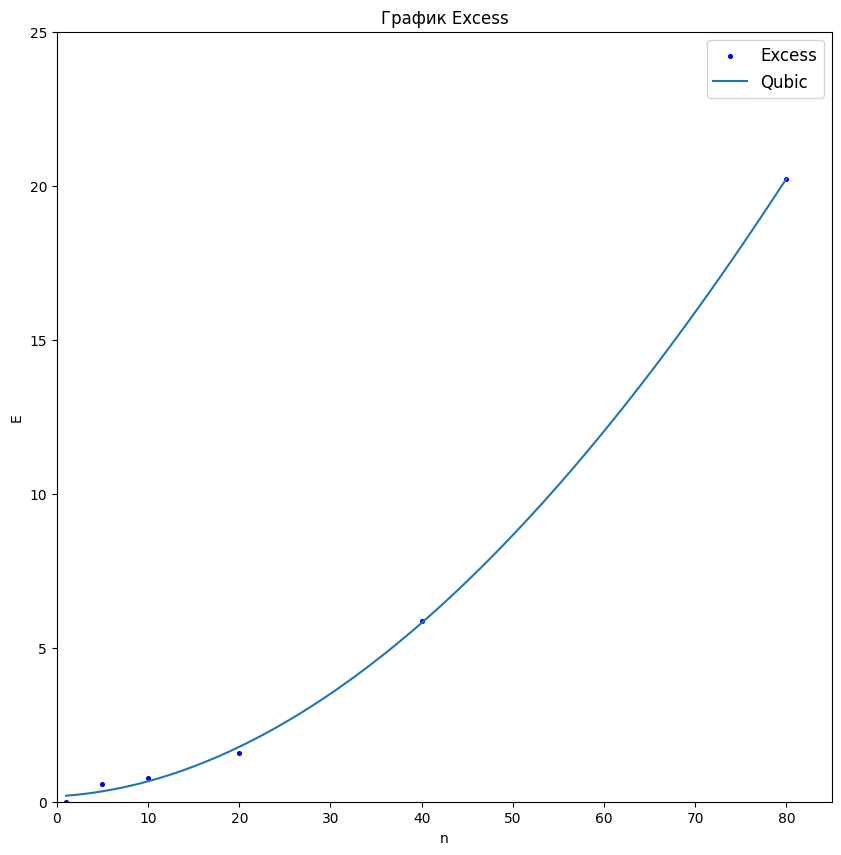

In [ ]:
b0, b1, b2, b3 =[ 1.75393063e-01,  1.62373558e-02,  3.29528854e-03, -4.56177978e-06]

xx = np.arange (1,81)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='b',label='Excess')
plt.plot(xx, b0 + b1*xx + b2*xx**2 + b3*xx**3 , label = 'Qubic')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.xlim([0, 85])
plt.ylim([0, 25])
plt.show()

In [ ]:
import sympy as sp

def f(x):
  z = b0 + b1*x + b2*x**2 + b3*x**3
  return z

# Объявляем символьную переменную x
x = sp.Symbol ("x")
# Вывод функции
print("f(x) =", f(x))
# Находим производную функции f(x) и сохраняем ее в переменной d_f:
d_f = sp.diff(f(x), x)
print("Первая производная функции:",d_f)

# Решаем уравнение d_f = 0:
x_extr = sp.solve (d_f)
print ("точка экстремума:", x_extr)

# Сохраняем точки экстремума в переменные:
x_0 = x_extr[0]
x_1 = x_extr[1]

# Находим вторую производную функции:
d2_f = sp.diff(f(x), x, 2)
print("Вторая производная функции:", d2_f)

# Решаем уравнение d2_f = 0
x_extr2 = sp.solve (d2_f)
print ("точка перегиба:", x_extr2)

# Находим значение второй производной в точках экстремума x_0 и x_1,
# Сохраняем их в переменные f_0_d2 и f_1_d2:
f_0_d2 = d2_f.evalf(subs = {x : x_0})
f_1_d2 = d2_f.evalf(subs = {x : x_1})

# Определяем, является ли точка x_0 точкой лок.минимума, максимума или перегиба
if f_0_d2 > 0:
  print(x_0, "- локальный минимум")
elif f_0_d2 < 0:
  print(x_0, "- локальный максимум")
else:
  print(x_0, "- точка перегиба")

# Определяем, является ли точка x_1 точкой лок.минимума, максимума или перегиба
if f_1_d2 > 0:
  print(x_1, "- локальный минимум")
elif f_1_d2 < 0:
  print(x_1, "- локальный максимум")
else:
  print(x_1, "- точка перегиба")


f(x) = -4.56177978e-6*x**3 + 0.00329528854*x**2 + 0.0162373558*x + 0.175393063
Первая производная функции: -1.368533934e-5*x**2 + 0.00659057708*x + 0.0162373558
точка экстремума: [-2.45124604053257, 484.030614754966]
Вторая производная функции: 0.00659057708 - 2.737067868e-5*x
точка перегиба: [240.789684357217]
-2.45124604053257 - локальный минимум
484.030614754966 - локальный максимум


In [ ]:
from sympy import *

x = Symbol('x', real=True)
f = b0 + b1*x + b2*x**2 + b3*x**3
fprime = f.diff(x)

solve(fprime, x)

[-1.91982213799412, 261.171743468953]

In [ ]:
import sympy as sp

def f(x):
  z = b0 + b1*x + b2*x**2 + b3*x**3
  return z

# Объявляем символьную переменную x
x = sp.Symbol ("x")
# Вывод функции
print("f(x) =", f(x))
# Находим производную функции f(x) и сохраняем ее в переменной d_f:
d_f = sp.diff(f(x), x)
print("Первая производная функции:",d_f)

# Решаем уравнение d_f = 0:
x_extr = sp.solve (d_f)
print ("точка экстремума:", x_extr)

# Сохраняем точки экстремума в переменные:
x_0 = x_extr[0]
x_1 = x_extr[1]

# Находим вторую производную функции:
d2_f = sp.diff(f(x), x, 2)
print("Вторая производная функции:", d2_f)

# Решаем уравнение d2_f = 0
x_extr2 = sp.solve (d2_f)
print ("точка перегиба:", x_extr2)
"""
# Находим значение второй производной в точках экстремума x_0 и x_1,
# Сохраняем их в переменные f_0_d2 и f_1_d2:
f_0_d2 = d2_f.evalf(subs = {x : x_0})
f_1_d2 = d2_f.evalf(subs = {x : x_1})

# Определяем, является ли точка x_0 точкой лок.минимума, максимума или перегиба
if f_0_d2 > 0:
  print(x_0, "- локальный минимум")
elif f_0_d2 < 0:
  print(x_0, "- локальный максимум")
else:
  print(x_0, "- точка перегиба")

# Определяем, является ли точка x_1 точкой лок.минимума, максимума или перегиба
if f_1_d2 > 0:
  print(x_1, "- локальный минимум")
elif f_1_d2 < 0:
  print(x_1, "- локальный максимум")
else:
  print(x_1, "- точка перегиба")
"""

f(x) = -9.08289464e-6*x**3 + 0.00353213683*x**2 + 0.0136625799*x + 0.1792331
Первая производная функции: -2.724868392e-5*x**2 + 0.00706427366*x + 0.0136625799
точка экстремума: [-1.91982213799412, 261.171743468953]
Вторая производная функции: 0.00706427366 - 5.449736784e-5*x
точка перегиба: [129.625960665479]


'\n# Находим значение второй производной в точках экстремума x_0 и x_1,\n# Сохраняем их в переменные f_0_d2 и f_1_d2:\nf_0_d2 = d2_f.evalf(subs = {x : x_0})\nf_1_d2 = d2_f.evalf(subs = {x : x_1})\n\n# Определяем, является ли точка x_0 точкой лок.минимума, максимума или перегиба\nif f_0_d2 > 0:\n  print(x_0, "- локальный минимум")\nelif f_0_d2 < 0:\n  print(x_0, "- локальный максимум")\nelse:\n  print(x_0, "- точка перегиба")\n\n# Определяем, является ли точка x_1 точкой лок.минимума, максимума или перегиба\nif f_1_d2 > 0:\n  print(x_1, "- локальный минимум")\nelif f_1_d2 < 0:\n  print(x_1, "- локальный максимум")\nelse:\n  print(x_1, "- точка перегиба")\n'

2 степень

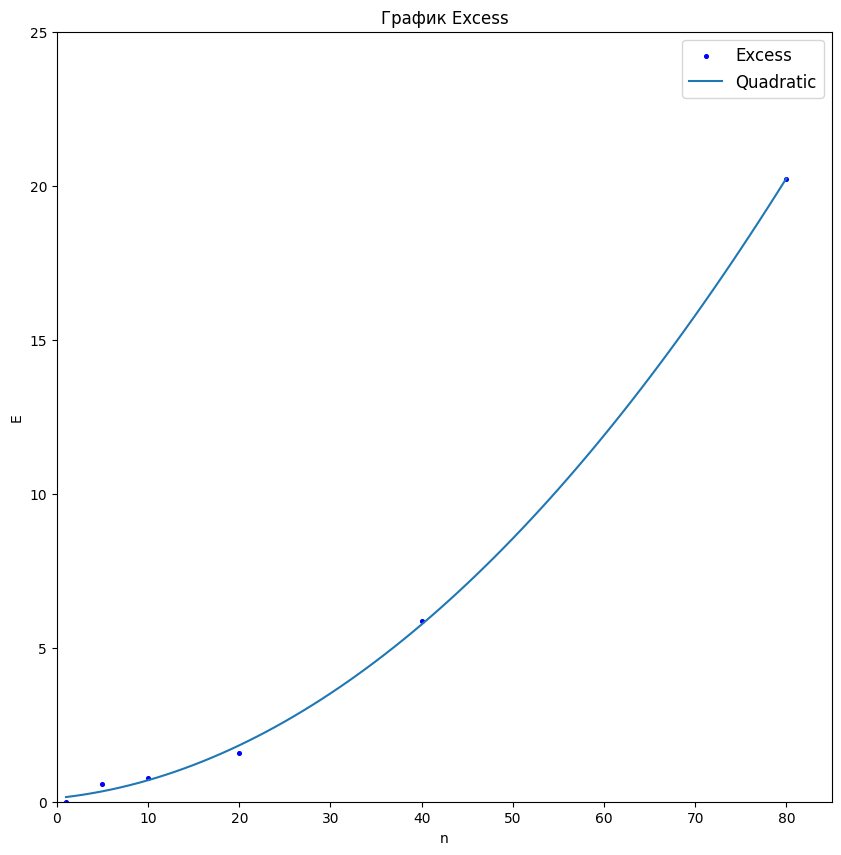

In [ ]:
b0, b1, b2 = [0.11807756, 0.03035755, 0.0027642 ]

xx = np.arange (1,81)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='b',label='Excess')
plt.plot(xx, b0 + b1*xx + b2*xx**2 , label = 'Quadratic')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.xlim([0, 85])
plt.ylim([0, 25])
plt.show()

In [ ]:
from sympy import *

x = Symbol('x', real=True)
f = b0 + b1*x + b2*x**2
fprime = f.diff(x)

solve(fprime, x)

[-5.49119998552927]

### График Approx

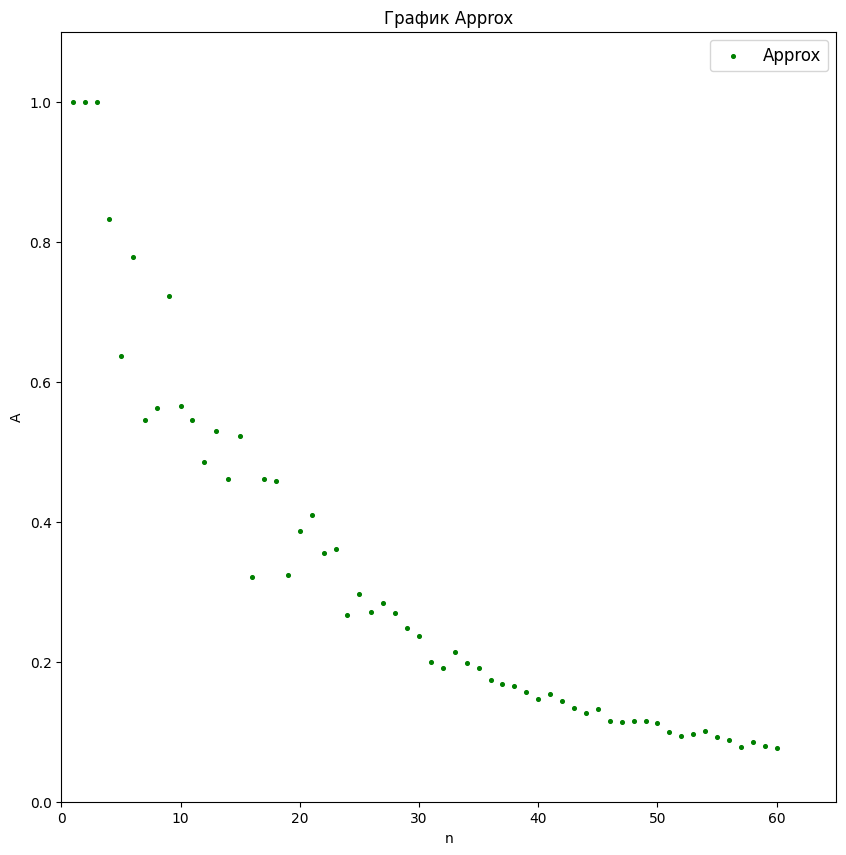

In [ ]:
Approx = [1, 1, 1, 0.833, 0.6364, 0.7778, 0.5455, 0.5625, 0.7222, 0.5652, 0.5455, 0.4849, 0.5294, 0.4615, 0.5227, 0.3208, 0.4615, 0.4576, 0.3239, 0.3867,
          0.4096, 0.3548, 0.3608, 0.2672, 0.2966, 0.2707, 0.2846, 0.269, 0.2484, 0.237, 0.2, 0.1907, 0.2133, 0.1981, 0.1913, 0.1734, 0.1679, 0.166, 0.1568, 0.1463,
          0.1546, 0.1442, 0.1343, 0.1267, 0.1319, 0.1151, 0.1144, 0.1148, 0.1159, 0.1124, 0.0996, 0.0946, 0.0969, 0.1012, 0.0928, 0.0877, 0.0777, 0.0853, 0.0792, 0.0769]

n = list(range(1, 61))

plt.figure(figsize=(10,10))
plt.scatter(n,Approx,marker='o',s=7,color='g',label='Approx')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Approx')
plt.xlabel('n')
plt.ylabel('A')
plt.xlim([0, 65])
plt.ylim([0, 1.1])
plt.show()

### Среднее Approx

[1.0, 1.0, 1.0, 0.95825, 0.89388, 0.8745333333333334, 0.8275285714285714, 0.7944, 0.7863777777777777, 0.7642599999999999, 0.7443727272727273, 0.72275, 0.7078769230769232, 0.6902785714285715, 0.6791066666666669, 0.6567125, 0.6452294117647059, 0.6348055555555556, 0.6184421052631579, 0.606855, 0.5974619047619047, 0.5864318181818181, 0.5766217391304347, 0.5637291666666667, 0.553044, 0.5421846153846154, 0.5326444444444444, 0.5232285714285714, 0.513751724137931, 0.5045266666666667, 0.4947032258064516, 0.48520312499999996, 0.4769636363636363, 0.4687617647058823, 0.46083428571428564, 0.45285, 0.44514864864864856, 0.43780263157894733, 0.4305974358974359, 0.42349, 0.4169317073170731, 0.4104380952380952, 0.4040162790697674, 0.3977136363636363, 0.39180666666666664, 0.3857913043478261, 0.38001702127659576, 0.37449166666666667, 0.3692142857142857, 0.364078, 0.3588921568627451, 0.35380961538461536, 0.3489622641509434, 0.34437407407407405, 0.3398, 0.3352982142857143, 0.33077894736842106, 0.32654655172

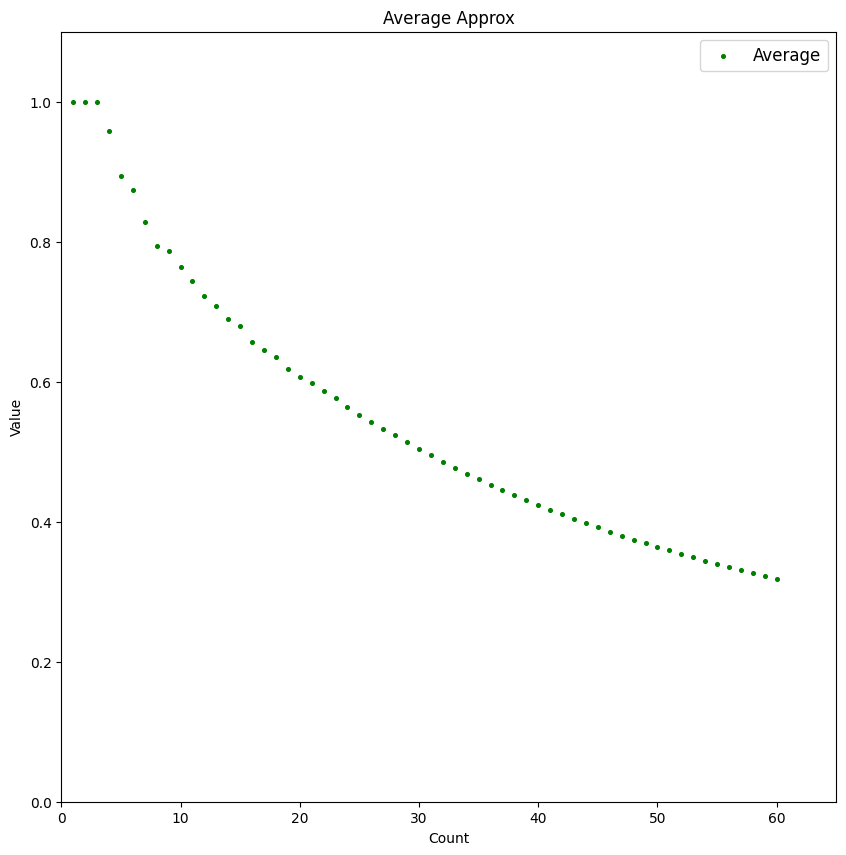

In [ ]:
nn = np.arange(1,61)

av = []
for i in nn:
  av.append(np.mean(Approx[0:i]))

print(av)

plt.figure(figsize=(10,10))
plt.scatter(nn,av,marker='o',s=7,color='g',label='Average')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Average Approx')
plt.xlabel('Count')
plt.ylabel('Value')
plt.xlim([0, 65])
plt.ylim([0, 1.1])
plt.show()

### Аппроксимация МНК (Approx)

In [ ]:
x = np.array(n)
y = np.array(Approx)

linear_func = lambda x, b0, b1: b0 + b1*x
quadratic_func = lambda x, b0, b1, b2: b0 + b1*x + b2*x**2
qubic_func = lambda x, b0, b1, b2, b3: b0 + b1*x + b2*x**2 + b3*x**3
exp_func = lambda x, b0, b1, b2: b0 + b1*np.exp(b2*x)
exp1_func = lambda x, b0, b1, b2: b0 + b1*np.exp(x-b2)
exp2_func = lambda x, b0, b1: b0*np.power(b1,x)
exp3_func = lambda x, b0, b1, b2:  b0 + b1*np.power(b2,x)


from scipy.optimize import leastsq

# list of model
model_list = [
    'linear', 'quadratic',
    'qubic']

# model reference
models_dict = {
        'linear':             linear_func,
        'quadratic':          quadratic_func,
        'qubic':              qubic_func}

# initial values
p0_dict = {
        'linear':             [0, 0],
        'quadratic':          [0, 0, 0],
        'qubic':              [0, 0, 0, 0]}

# titles (formulas)
formulas_dict = {
        'linear':             'y = b0 + b1*x',
        'quadratic':          'y = b0 + b1*x + b2*x^2',
        'qubic':              'y = b0 + b1*x + b2*x^2 + b3*x^3'}

# actual data
X_fact = x
Y_fact = y

# function for calculating residuals
residual_func = lambda p, x, y: y - func(x, *p)

# return all optional outputs
full_output = True

# variables to save the calculation results
calculation_results_df = pd.DataFrame(columns=['func', 'p0', 'popt', 'cov_x', 'SSE', 'MSE', 'pcov', 'perr', 'Y_calc', 'error_metrics'])
error_metrics_results_df = pd.DataFrame(columns=['MSE', 'RMSE', 'MAE', 'MSPE', 'MAPE', 'RMSLE', 'R2'])

# calculations
for func_name in model_list:
    print(f'{func_name.upper()} MODEL: {formulas_dict[func_name]}')
    func = models_dict[func_name]
    calculation_results_df.loc[func_name, 'func'] = func
    p0 = p0_dict[func_name]
    print(f'p0 = {p0}')
    calculation_results_df.loc[func_name, 'p0'] = p0
    if full_output:
        (popt, cov_x, infodict, mesg, ier) = leastsq(residual_func, p0, args=(X_fact, Y_fact), full_output=full_output)
        integer_flag = f'ier = {ier}, the solution was found' if ier<=4 else f'ier = {ier}, the solution was not found'
        print(integer_flag, '\n', mesg)
        calculation_results_df.loc[func_name, 'popt'] = popt
        print(f'parameters = {popt}')
        calculation_results_df.loc[func_name, 'cov_x'] = cov_x
        print(f'cov_x = \n{cov_x}')
        #SSE = (residual_func(popt, X_fact, Y_fact)**2).sum()
        SSE = (infodict['fvec']**2).sum()
        calculation_results_df.loc[func_name, 'SSE'] = SSE
        print(f'SSE = {SSE}')
        MSE = SSE / (len(Y_fact)-len(p0))
        calculation_results_df.loc[func_name, 'MSE'] = MSE
        print(f'MSE = {MSE}')
        pcov = cov_x * MSE
        calculation_results_df.loc[func_name, 'pcov'] = pcov
        print(f'pcov =\n {pcov}')
        perr = np.sqrt(np.diag(pcov))
        calculation_results_df.loc[func_name, 'perr'] = perr
        print(f'perr = {perr}\n')
    else:
        popt = leastsq(residual_func, p0, args=(X_fact, Y_fact), full_output=full_output)
        calculation_results_df.loc[func_name, 'popt'] = popt
        print(f'parameters = {popt}\n')
    Y_calc = func(X_fact, *popt)
    calculation_results_df.loc[func_name, 'Y_calc'] = Y_calc
    (error_metrics_dict, error_metrics_df) = regression_error_metrics(Yfact=Y_fact, Ycalc=Y_calc, model_name=func_name)
    calculation_results_df.loc[func_name, 'error_metrics'] = error_metrics_dict.values()
    error_metrics_results_df = pd.concat([error_metrics_results_df, error_metrics_df])

LINEAR MODEL: y = b0 + b1*x
p0 = [0, 0]
ier = 2, the solution was found 
 The relative error between two consecutive iterates is at most 0.000000
parameters = [ 0.71084367 -0.01287149]
cov_x = 
[[ 6.83615814e-02 -1.69491525e-03]
 [-1.69491525e-03  5.55709923e-05]]
SSE = 0.6782304590688153
MSE = 0.011693628604634746
pcov =
 [[ 7.99394944e-04 -1.98197095e-05]
 [-1.98197095e-05  6.49826545e-07]]
perr = [0.02827357 0.00080612]

QUADRATIC MODEL: y = b0 + b1*x + b2*x^2
p0 = [0, 0, 0]
ier = 2, the solution was found 
 The relative error between two consecutive iterates is at most 0.000000
parameters = [ 9.20739268e-01 -3.31839635e-02  3.32991427e-04]
cov_x = 
[[ 1.60461717e-01 -1.06078317e-02  1.46113383e-04]
 [-1.06078317e-02  9.18111297e-04 -1.41400049e-05]
 [ 1.46113383e-04 -1.41400049e-05  2.31803358e-07]]
SSE = 0.19987979180386528
MSE = 0.0035066630141028995
pcov =
 [[ 5.62685169e-04 -3.71980910e-05  5.12370396e-07]
 [-3.71980910e-05  3.21950693e-06 -4.95842323e-08]
 [ 5.12370396e-07 -4.

#### 1 степень

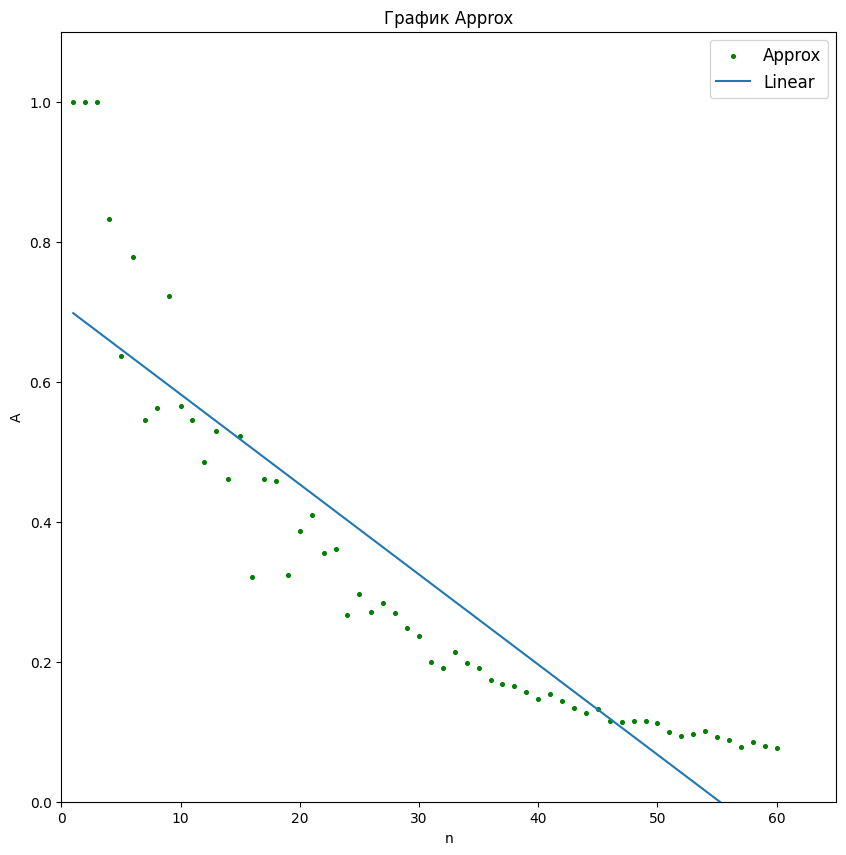

In [ ]:
b0, b1 = [ 0.71084367, -0.01287149]

xx = np.arange (1,61)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='g',label='Approx')
plt.plot(xx, b0 + b1*xx , label = 'Linear')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Approx')
plt.xlabel('n')
plt.ylabel('A')
plt.xlim([0, 65])
plt.ylim([0, 1.1])
plt.show()

#### 2 степень

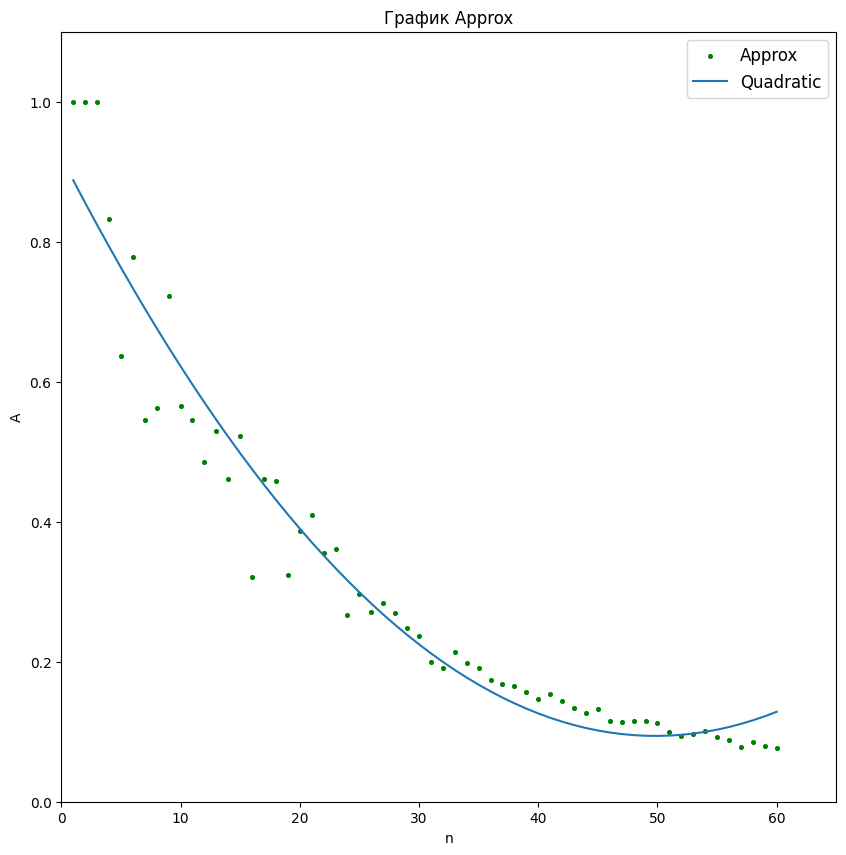

In [ ]:
b0, b1, b2 = [ 9.20739268e-01, -3.31839635e-02,  3.32991427e-04]

xx = np.arange (1,61)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='g',label='Approx')
plt.plot(xx, b0 + b1*xx + b2*xx**2 , label = 'Quadratic')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Approx')
plt.xlabel('n')
plt.ylabel('A')
plt.xlim([0, 65])
plt.ylim([0, 1.1])
plt.show()

#### 3 степень

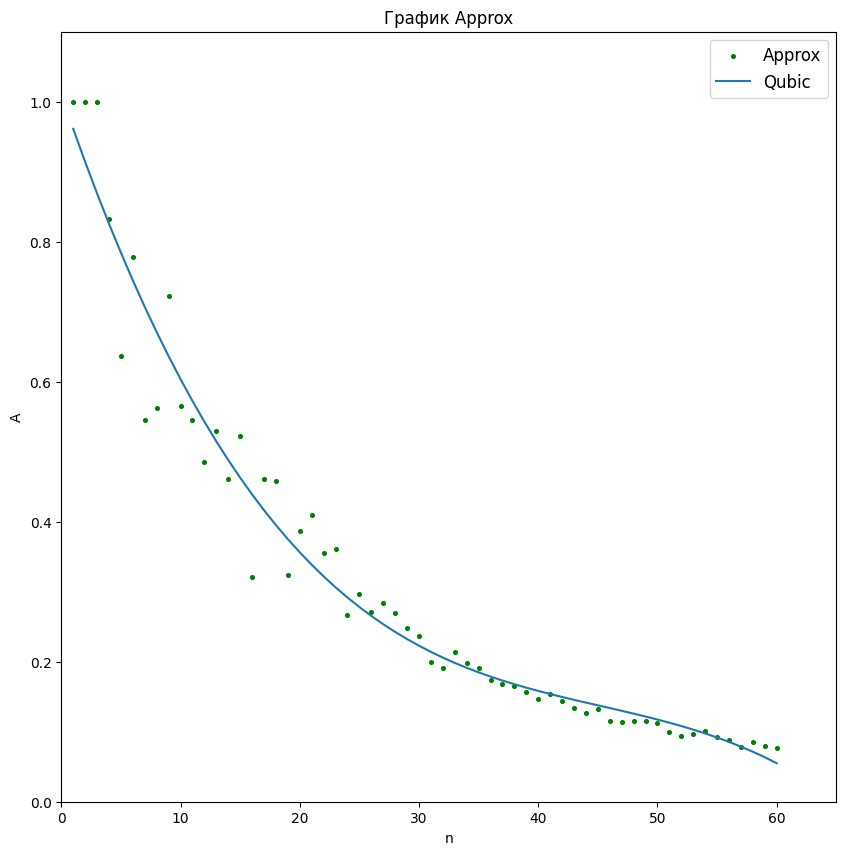

In [ ]:
b0, b1, b2, b3 =[ 1.01041910e+00, -5.01295856e-02,  1.02177665e-03, -7.52770731e-06]

xx = np.arange (1,61)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='g',label='Approx')
plt.plot(xx, b0 + b1*xx + b2*xx**2 + b3*xx**3 , label = 'Qubic')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Approx')
plt.xlabel('n')
plt.ylabel('A')
plt.xlim([0, 65])
plt.ylim([0, 1.1])
plt.show()

### Несколько точек (Approx)

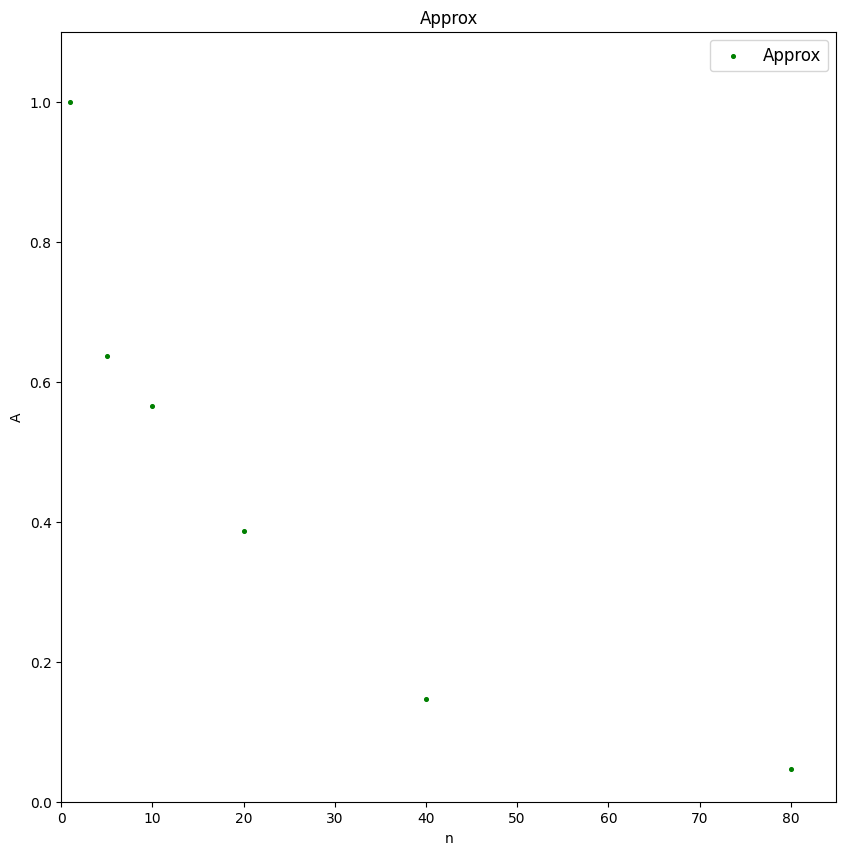

In [ ]:
Approx = [1, 0.6364, 0.5652, 0.3867, 0.1463, 0.0474]
n = [1, 5, 10, 20, 40, 80]

plt.figure(figsize=(10,10))
plt.scatter(n,Approx,marker='o',s=7,color='g',label='Approx')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Approx')
plt.xlabel('n')
plt.ylabel('A')
plt.xlim([0, 85])
plt.ylim([0, 1.1])
plt.show()

In [ ]:
x = np.array(n)
y = np.array(Approx)

linear_func = lambda x, b0, b1: b0 + b1*x
quadratic_func = lambda x, b0, b1, b2: b0 + b1*x + b2*x**2
qubic_func = lambda x, b0, b1, b2, b3: b0 + b1*x + b2*x**2 + b3*x**3
exp_func = lambda x, b0, b1, b2: b0 + b1*np.exp(b2*x)
exp1_func = lambda x, b0, b1, b2: b0 + b1*np.exp(x-b2)
exp2_func = lambda x, b0, b1: b0*np.power(b1,x)
exp3_func = lambda x, b0, b1, b2:  b0 + b1*np.power(b2,x)


from scipy.optimize import leastsq

# list of model
model_list = [
    'linear', 'quadratic',
    'qubic']

# model reference
models_dict = {
        'linear':             linear_func,
        'quadratic':          quadratic_func,
        'qubic':              qubic_func}

# initial values
p0_dict = {
        'linear':             [0, 0],
        'quadratic':          [0, 0, 0],
        'qubic':              [0, 0, 0, 0]}

# titles (formulas)
formulas_dict = {
        'linear':             'y = b0 + b1*x',
        'quadratic':          'y = b0 + b1*x + b2*x^2',
        'qubic':              'y = b0 + b1*x + b2*x^2 + b3*x^3'}

# actual data
X_fact = x
Y_fact = y

# function for calculating residuals
residual_func = lambda p, x, y: y - func(x, *p)

# return all optional outputs
full_output = True

# variables to save the calculation results
calculation_results_df = pd.DataFrame(columns=['func', 'p0', 'popt', 'cov_x', 'SSE', 'MSE', 'pcov', 'perr', 'Y_calc', 'error_metrics'])
error_metrics_results_df = pd.DataFrame(columns=['MSE', 'RMSE', 'MAE', 'MSPE', 'MAPE', 'RMSLE', 'R2'])

# calculations
for func_name in model_list:
    print(f'{func_name.upper()} MODEL: {formulas_dict[func_name]}')
    func = models_dict[func_name]
    calculation_results_df.loc[func_name, 'func'] = func
    p0 = p0_dict[func_name]
    print(f'p0 = {p0}')
    calculation_results_df.loc[func_name, 'p0'] = p0
    if full_output:
        (popt, cov_x, infodict, mesg, ier) = leastsq(residual_func, p0, args=(X_fact, Y_fact), full_output=full_output)
        integer_flag = f'ier = {ier}, the solution was found' if ier<=4 else f'ier = {ier}, the solution was not found'
        print(integer_flag, '\n', mesg)
        calculation_results_df.loc[func_name, 'popt'] = popt
        print(f'parameters = {popt}')
        calculation_results_df.loc[func_name, 'cov_x'] = cov_x
        print(f'cov_x = \n{cov_x}')
        #SSE = (residual_func(popt, X_fact, Y_fact)**2).sum()
        SSE = (infodict['fvec']**2).sum()
        calculation_results_df.loc[func_name, 'SSE'] = SSE
        print(f'SSE = {SSE}')
        MSE = SSE / (len(Y_fact)-len(p0))
        calculation_results_df.loc[func_name, 'MSE'] = MSE
        print(f'MSE = {MSE}')
        pcov = cov_x * MSE
        calculation_results_df.loc[func_name, 'pcov'] = pcov
        print(f'pcov =\n {pcov}')
        perr = np.sqrt(np.diag(pcov))
        calculation_results_df.loc[func_name, 'perr'] = perr
        print(f'perr = {perr}\n')
    else:
        popt = leastsq(residual_func, p0, args=(X_fact, Y_fact), full_output=full_output)
        calculation_results_df.loc[func_name, 'popt'] = popt
        print(f'parameters = {popt}\n')
    Y_calc = func(X_fact, *popt)
    calculation_results_df.loc[func_name, 'Y_calc'] = Y_calc
    (error_metrics_dict, error_metrics_df) = regression_error_metrics(Yfact=Y_fact, Ycalc=Y_calc, model_name=func_name)
    calculation_results_df.loc[func_name, 'error_metrics'] = error_metrics_dict.values()
    error_metrics_results_df = pd.concat([error_metrics_results_df, error_metrics_df])

LINEAR MODEL: y = b0 + b1*x
p0 = [0, 0]
ier = 3, the solution was found 
 Both actual and predicted relative reductions in the sum of squares
  are at most 0.000000 and the relative error between two consecutive iterates is at 
  most 0.000000
parameters = [ 0.72610962 -0.01009396]
cov_x = 
[[ 3.17897099e-01 -5.81655495e-03]
 [-5.81655495e-03  2.23713650e-04]]
SSE = 0.15228321024608504
MSE = 0.03807080256152126
pcov =
 [[ 1.21025977e-02 -2.21440915e-04]
 [-2.21440915e-04  8.51695821e-06]]
perr = [0.11001181 0.00291838]

QUADRATIC MODEL: y = b0 + b1*x + b2*x^2
p0 = [0, 0, 0]
ier = 3, the solution was found 
 Both actual and predicted relative reductions in the sum of squares
  are at most 0.000000 and the relative error between two consecutive iterates is at 
  most 0.000000
parameters = [ 8.90837313e-01 -2.94204819e-02  2.37693091e-04]
cov_x = 
[[ 5.55248470e-01 -3.36635829e-02  3.42485111e-04]
 [-3.36635829e-02  3.49084013e-03 -4.01817448e-05]
 [ 3.42485111e-04 -4.01817448e-05  4.9418

3 степень

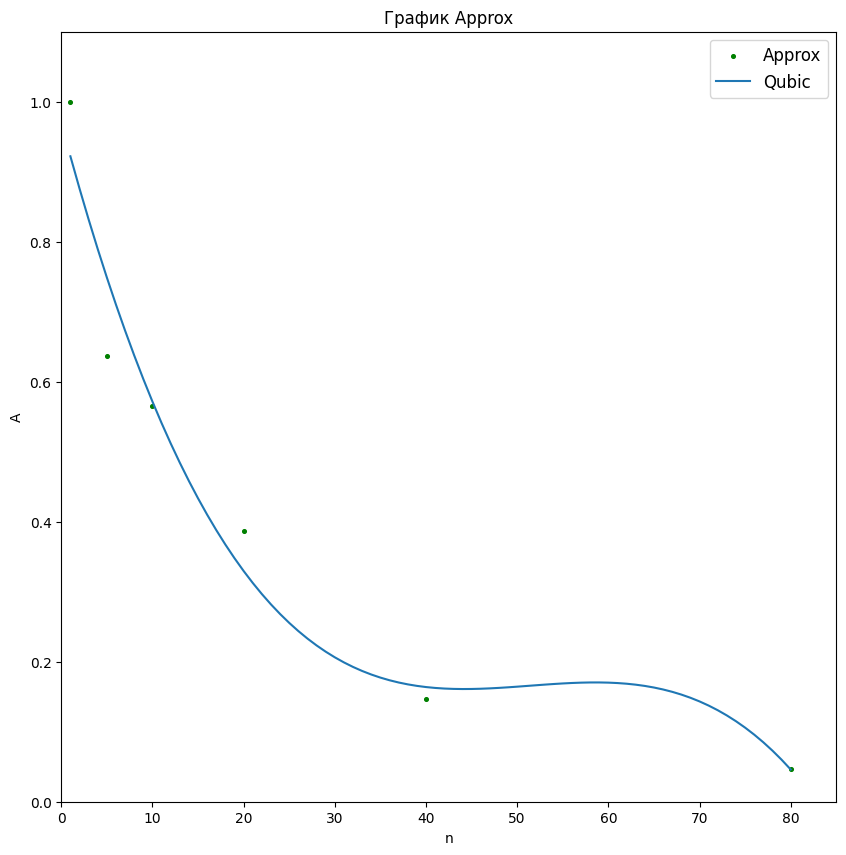

In [ ]:
b0, b1, b2, b3 =[ 9.70016540e-01, -4.89270108e-02,  9.71374249e-04, -6.30192881e-06]

xx = np.arange (1,81)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='g',label='Approx')
plt.plot(xx, b0 + b1*xx + b2*xx**2 + b3*xx**3 , label = 'Qubic')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Approx')
plt.xlabel('n')
plt.ylabel('A')
plt.xlim([0, 85])
plt.ylim([0, 1.1])
plt.show()

In [ ]:
import sympy as sp

def f(x):
  z = b0 + b1*x + b2*x**2 + b3*x**3
  return z

# Объявляем символьную переменную x
x = sp.Symbol ("x")
# Вывод функции
print("f(x) =", f(x))
# Находим производную функции f(x) и сохраняем ее в переменной d_f:
d_f = sp.diff(f(x), x)
print("Первая производная функции:",d_f)

# Решаем уравнение d_f = 0:
x_extr = sp.solve (d_f)
print ("точка экстремума:", x_extr)

# Сохраняем точки экстремума в переменные:
x_0 = x_extr[0]
x_1 = x_extr[1]

# Находим вторую производную функции:
d2_f = sp.diff(f(x), x, 2)
print("Вторая производная функции:", d2_f)

# Решаем уравнение d2_f = 0
x_extr2 = sp.solve (d2_f)
print ("точка перегиба:", x_extr2)

# Находим значение второй производной в точках экстремума x_0 и x_1,
# Сохраняем их в переменные f_0_d2 и f_1_d2:
f_0_d2 = d2_f.evalf(subs = {x : x_0})
f_1_d2 = d2_f.evalf(subs = {x : x_1})

# Определяем, является ли точка x_0 точкой лок.минимума, максимума или перегиба
if f_0_d2 > 0:
  print(x_0, "- локальный минимум")
elif f_0_d2 < 0:
  print(x_0, "- локальный максимум")
else:
  print(x_0, "- точка перегиба")

# Определяем, является ли точка x_1 точкой лок.минимума, максимума или перегиба
if f_1_d2 > 0:
  print(x_1, "- локальный минимум")
elif f_1_d2 < 0:
  print(x_1, "- локальный максимум")
else:
  print(x_1, "- точка перегиба")


f(x) = -6.30192881e-6*x**3 + 0.000971374249*x**2 - 0.0489270108*x + 0.97001654
Первая производная функции: -1.890578643e-5*x**2 + 0.001942748498*x - 0.0489270108
точка экстремума: [44.1728952301095, 58.5865697195852]
Вторая производная функции: 0.001942748498 - 3.781157286e-5*x
точка перегиба: [51.3797324748474]
44.1728952301095 - локальный минимум
58.5865697195852 - локальный максимум


2 степень

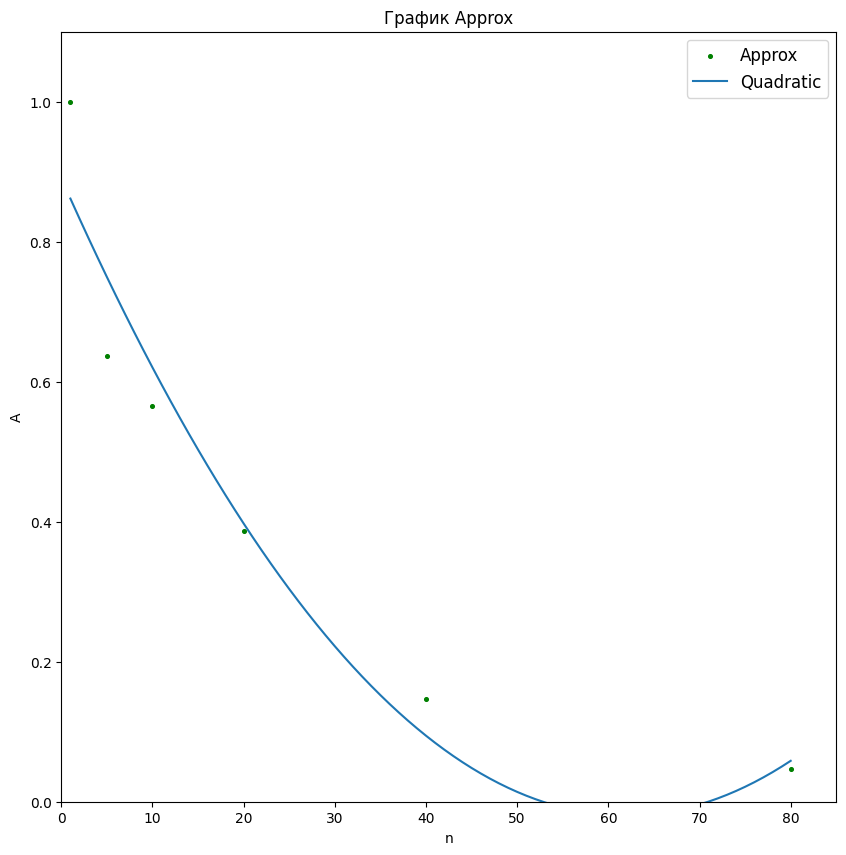

In [ ]:
b0, b1, b2 = [ 8.90837313e-01, -2.94204819e-02,  2.37693091e-04]

xx = np.arange (1,81)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='g',label='Approx')
plt.plot(xx, b0 + b1*xx + b2*xx**2 , label = 'Quadratic')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Approx')
plt.xlabel('n')
plt.ylabel('A')
plt.xlim([0, 85])
plt.ylim([0, 1.1])
plt.show()

In [ ]:
from sympy import *

x = Symbol('x', real=True)
f = b0 + b1*x + b2*x**2
fprime = f.diff(x)

solve(fprime, x)

[61.8875411485982]

### Сведенные графики Excess и Approx

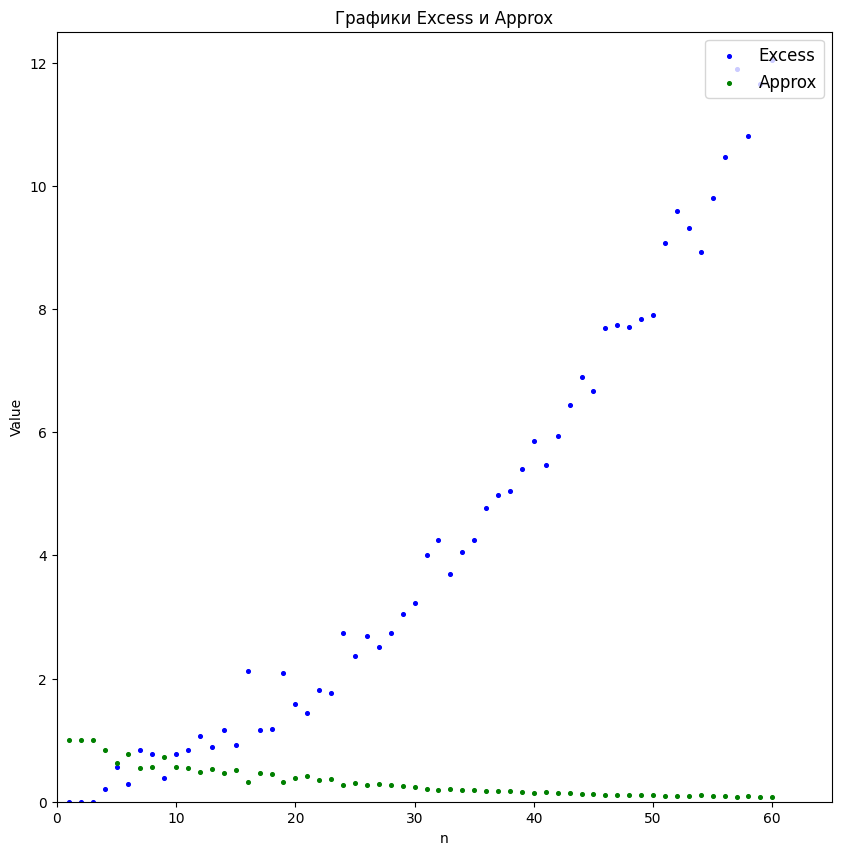

In [ ]:
Approx = [1, 1, 1, 0.833, 0.6364, 0.7778, 0.5455, 0.5625, 0.7222, 0.5652, 0.5455, 0.4849, 0.5294, 0.4615, 0.5227, 0.3208, 0.4615, 0.4576, 0.3239, 0.3867,
          0.4096, 0.3548, 0.3608, 0.2672, 0.2966, 0.2707, 0.2846, 0.269, 0.2484, 0.237, 0.2, 0.1907, 0.2133, 0.1981, 0.1913, 0.1734, 0.1679, 0.166, 0.1568, 0.1463,
          0.1546, 0.1442, 0.1343, 0.1267, 0.1319, 0.1151, 0.1144, 0.1148, 0.1159, 0.1124, 0.0996, 0.0946, 0.0969, 0.1012, 0.0928, 0.0877, 0.0777, 0.0853, 0.0792, 0.0769]

Excess = [0, 0, 0, 0.2, 0.5714, 0.2857, 0.8333, 0.7778, 0.3846, 0.7692, 0.8333, 1.0625, 0.8889, 1.1667, 0.913, 2.1177, 1.1667, 1.1852, 2.087, 1.5862,
          1.4412, 1.8182, 1.7714, 2.7419, 2.3714, 2.6944, 2.5135, 2.7436, 3.0526, 3.2195, 4, 4.2432, 3.6889, 4.0488, 4.25, 4.7674, 4.9778, 5.0455, 5.4, 5.8605,
          5.4681, 5.9362, 6.4444, 6.8913, 6.6667, 7.6889, 7.7447, 7.7083, 7.8333, 7.898, 9.0638, 9.5957, 9.3192, 8.92, 9.8, 10.4694, 11.8936, 10.8125, 11.6531, 12.0408]


n = list(range(1, 61))


plt.figure(figsize=(10,10))
plt.scatter(n,Excess,marker='o',s=7,color='b',label='Excess')
plt.scatter(n,Approx,marker='o',s=7,color='g',label='Approx')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Графики Excess и Approx')
plt.xlabel('n')
plt.ylabel('Value')
plt.xlim([0, 65])
plt.ylim([0, 12.5])
plt.show()

## 3-й класс (Virginica)

In [ ]:
# virginica
iris3 = iris.data[100:150]

### PCA 3-й класс

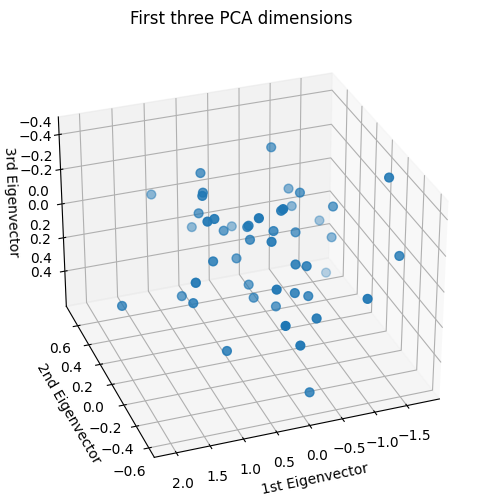

In [ ]:
import mpl_toolkits.mplot3d

from sklearn.decomposition import PCA

fig = plt.figure(1, figsize=(8, 6))
ax = fig.add_subplot(111, projection="3d", elev=-150, azim=110)

X_reduced3 = PCA(n_components=3).fit_transform(iris3)
ax.scatter(
    X_reduced3[:, 0],
    X_reduced3[:, 1],
    X_reduced3[:, 2],
    s=40,
)

ax.set_title("First three PCA dimensions")
ax.set_xlabel("1st Eigenvector")
# Добавляем разметку по оси X
ax.xaxis.set_tick_params(labelbottom=True)
ax.set_ylabel("2nd Eigenvector")
# Добавляем разметку по оси Y
ax.yaxis.set_tick_params(labelleft=True)
ax.set_zlabel("3rd Eigenvector")
# Добавляем разметку по оси Z
ax.zaxis.set_tick_params(labelright=True)

plt.show()

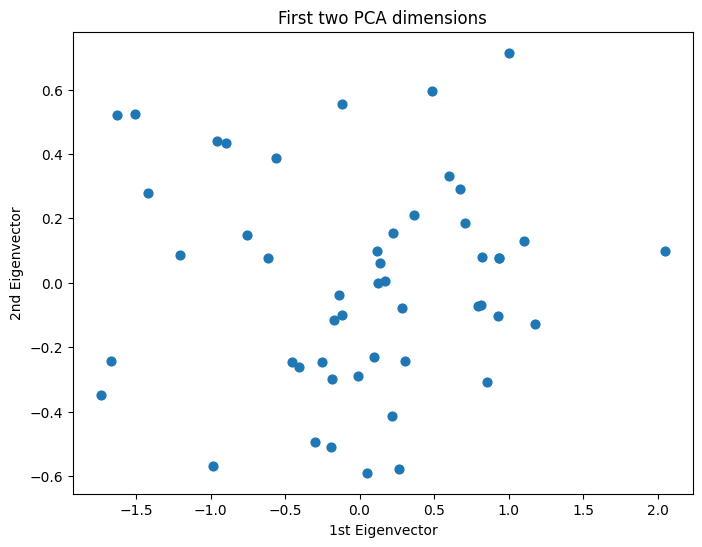

In [ ]:
# PCA 2 ГК

fig = plt.figure(1, figsize=(8, 6))
ax = fig.add_subplot(111)
ax.scatter(
    X_reduced3[:, 0],
    X_reduced3[:, 1],
    s=40,
)

ax.set_title("First two PCA dimensions")
ax.set_xlabel("1st Eigenvector")
# Добавляем разметку по оси X
ax.xaxis.set_tick_params(labelbottom=True)
ax.set_ylabel("2nd Eigenvector")
# Добавляем разметку по оси Y
ax.yaxis.set_tick_params(labelleft=True)

plt.show()

### Вычисление расстояний между точками

In [ ]:
def distance(point1, point2):
  # Вычисление расстояния по Евклиду
  return np.sqrt(np.sum((point1 - point2)**2))

# Инициализация матрицы расстояний
distances3 = np.zeros((len(iris3), len(iris3)))

# Вычисление расстояния между каждой точкой и каждой другой точкой
for i in range(len(iris3)):
  for j in range(len(iris3)):
    if i != j:
      distances3[i, j] = distance(iris3[i], iris3[j])

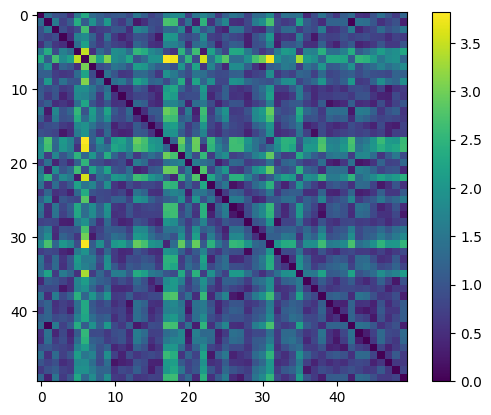

In [ ]:
# Визуализация матрицы расстояний с помощью тепловой карты
plt.imshow(distances3, cmap='viridis')
plt.colorbar()
plt.show()

In [ ]:
# Среднее по всем расстояниям:

# Вычислите сумму всех расстояний
total_distance3 = np.sum(distances3)

# Количество элементов (не считая диагональных)
n_elements = len(distances3) * (len(distances3) - 1)

# Рассчитайте среднее расстояние
average_distance3 = total_distance3 / n_elements

print(average_distance3)

1.176780801052858


In [ ]:
# Вычислите среднее расстояние от каждой точки
average_distances_from_each_point3 = np.mean(distances3, axis=0)
print(average_distances_from_each_point3)

[1.13845142 1.14732132 1.01424571 0.89369283 0.88356711 1.58704224
 2.11948518 1.29665724 1.03777086 1.35990398 0.93568624 0.8950316
 0.85088644 1.30006362 1.21783704 0.91867418 0.85198977 1.90072736
 1.91035477 1.40805467 0.94263777 1.33122479 1.72053631 1.06082888
 0.90114627 1.13811595 1.11505941 1.08082916 0.85847491 1.13695335
 1.2566183  1.86903033 0.87381141 1.07044792 1.1848684  1.44876417
 1.02563491 0.87224575 1.17244766 0.90028532 0.90746002 1.02794153
 1.14732132 0.9688364  1.0044198  0.92650593 1.0730625  0.86415416
 1.02572671 1.0894263 ]


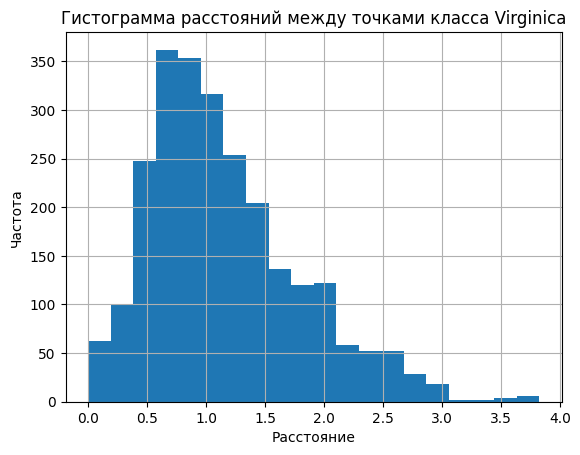

In [ ]:
# Преобразуйте distances в одномерный массив
distances3_1D = distances3.flatten()

# Определите диапазон значений
min_distance = np.min(distances3_1D)
max_distance = np.max(distances3_1D)

# Выберите количество интервалов
n_bins = 20


# Построение гистограммы
plt.hist(distances3_1D, bins=n_bins, range=(min_distance, max_distance))

# Настройка оформления
plt.xlabel("Расстояние")
plt.ylabel("Частота")
plt.title("Гистограмма расстояний между точками класса Virginica")
plt.grid(True)
plt.show()

Наиболее частое значение: 0.5735416288291548


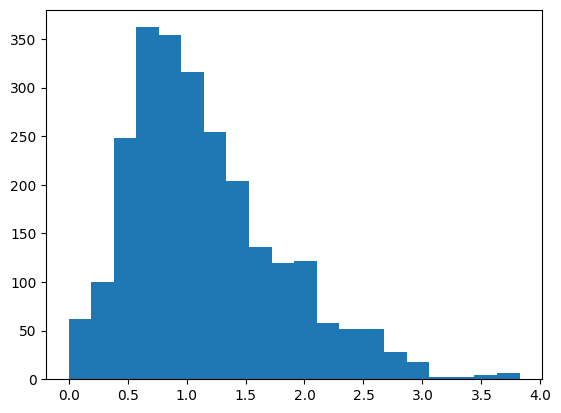

In [ ]:
# Извлечение данных из объекта Axes
counts, bins, patches = plt.hist(distances3_1D, bins=n_bins, range=(min_distance, max_distance))

# Определение наиболее частого диапазона
most_frequent_index = np.argmax(counts)
most_frequent_range = (bins[most_frequent_index], bins[most_frequent_index + 1])

print("Наиболее частое значение:", bins[most_frequent_index])

### Расстояние по каждой оси

#### 1-й признак (длина чашелистика)

In [ ]:
first_column3 = np.take(iris3, 0, axis=1)
first_column3

array([6.3, 5.8, 7.1, 6.3, 6.5, 7.6, 4.9, 7.3, 6.7, 7.2, 6.5, 6.4, 6.8,
       5.7, 5.8, 6.4, 6.5, 7.7, 7.7, 6. , 6.9, 5.6, 7.7, 6.3, 6.7, 7.2,
       6.2, 6.1, 6.4, 7.2, 7.4, 7.9, 6.4, 6.3, 6.1, 7.7, 6.3, 6.4, 6. ,
       6.9, 6.7, 6.9, 5.8, 6.8, 6.7, 6.7, 6.3, 6.5, 6.2, 5.9])

In [ ]:
print('min:', np.min(first_column3))
print('max:', np.max(first_column3))

((np.max(first_column3)+1)-(np.min(first_column3)-1))/0.2

min: 4.9
max: 7.9


25.0

In [ ]:
# Инициализация матрицы расстояний
ds31 = np.zeros((len(first_column3), len(first_column3)))

# Вычисление расстояния между каждой точкой и каждой другой точкой
for i in range(len(first_column3)):
  for j in range(len(first_column3)):
    if i != j:
      ds31[i, j] = distance(first_column3[i], first_column3[j])

In [ ]:
# Среднее по всем расстояниям:

# Вычислите сумму всех расстояний
total_31 = np.sum(ds31)

# Количество элементов (не считая диагональных)
n_elements = len(ds31) * (len(ds31) - 1)

# Рассчитайте среднее расстояние
av_ds31 = total_31 / n_elements

print(av_ds31)

0.717061224489796


Наиболее частое значение: 0.0


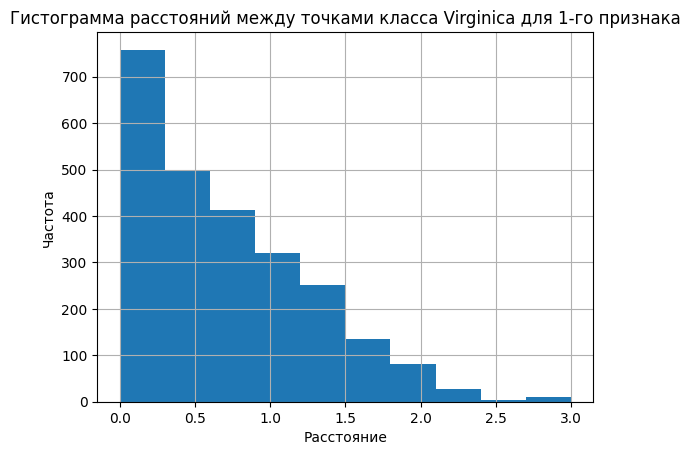

In [ ]:
# Преобразуйте distances в одномерный массив
ds31_1D = ds31.flatten()

# Определите диапазон значений
min_distance = np.min(ds31_1D)
max_distance = np.max(ds31_1D)

# Выберите количество интервалов
n_bins = 10


# Построение гистограммы
counts, bins, patches = plt.hist(ds31_1D, bins=n_bins, range=(min_distance, max_distance))
# Определение наиболее частого диапазона
most_frequent_index = np.argmax(counts)

print("Наиболее частое значение:", bins[most_frequent_index])

# Настройка оформления
plt.xlabel("Расстояние")
plt.ylabel("Частота")
plt.title("Гистограмма расстояний между точками класса Virginica для 1-го признака")
plt.grid(True)
plt.show()

#### 2-й признак (ширина чашелистика)

In [ ]:
second_column3 = np.take(iris3, 1, axis=1)
second_column3

array([3.3, 2.7, 3. , 2.9, 3. , 3. , 2.5, 2.9, 2.5, 3.6, 3.2, 2.7, 3. ,
       2.5, 2.8, 3.2, 3. , 3.8, 2.6, 2.2, 3.2, 2.8, 2.8, 2.7, 3.3, 3.2,
       2.8, 3. , 2.8, 3. , 2.8, 3.8, 2.8, 2.8, 2.6, 3. , 3.4, 3.1, 3. ,
       3.1, 3.1, 3.1, 2.7, 3.2, 3.3, 3. , 2.5, 3. , 3.4, 3. ])

In [ ]:
print('min:', np.min(second_column3))
print('max:', np.max(second_column3))

((np.max(second_column3)+1)-(np.min(second_column3)-1))/0.2

min: 2.2
max: 3.8


17.999999999999996

In [ ]:
# Инициализация матрицы расстояний
ds32 = np.zeros((len(second_column3), len(second_column3)))

# Вычисление расстояния между каждой точкой и каждой другой точкой
for i in range(len(second_column3)):
  for j in range(len(second_column3)):
    if i != j:
      ds32[i, j] = distance(second_column3[i], second_column3[j])

In [ ]:
# Среднее по всем расстояниям:

# Вычислите сумму всех расстояний
total_32 = np.sum(ds32)

# Количество элементов (не считая диагональных)
n_elements = len(ds32) * (len(ds32) - 1)

# Рассчитайте среднее расстояние
av_ds32 = total_32 / n_elements

print(av_ds32)

0.3573061224489796


Наиболее частое значение: 0.15999999999999998


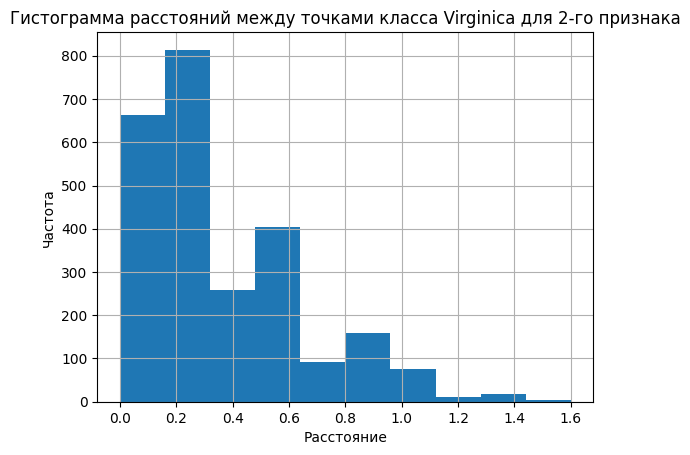

In [ ]:
# Преобразуйте distances в одномерный массив
ds32_1D = ds32.flatten()

# Определите диапазон значений
min_distance = np.min(ds32_1D)
max_distance = np.max(ds32_1D)

# Выберите количество интервалов
n_bins = 10


# Построение гистограммы
counts, bins, patches = plt.hist(ds32_1D, bins=n_bins, range=(min_distance, max_distance))
# Определение наиболее частого диапазона
most_frequent_index = np.argmax(counts)

print("Наиболее частое значение:", bins[most_frequent_index])

# Настройка оформления
plt.xlabel("Расстояние")
plt.ylabel("Частота")
plt.title("Гистограмма расстояний между точками класса Virginica для 2-го признака")
plt.grid(True)
plt.show()

#### 3-й признак (длина лепестка)

In [ ]:
thr_column3 = np.take(iris3, 2, axis=1)
thr_column3

array([6. , 5.1, 5.9, 5.6, 5.8, 6.6, 4.5, 6.3, 5.8, 6.1, 5.1, 5.3, 5.5,
       5. , 5.1, 5.3, 5.5, 6.7, 6.9, 5. , 5.7, 4.9, 6.7, 4.9, 5.7, 6. ,
       4.8, 4.9, 5.6, 5.8, 6.1, 6.4, 5.6, 5.1, 5.6, 6.1, 5.6, 5.5, 4.8,
       5.4, 5.6, 5.1, 5.1, 5.9, 5.7, 5.2, 5. , 5.2, 5.4, 5.1])

In [ ]:
print('min:', np.min(thr_column3))
print('max:', np.max(thr_column3))

((np.max(thr_column3)+1)-(np.min(thr_column3)-1))/0.2

min: 4.5
max: 6.9


22.0

In [ ]:
# Инициализация матрицы расстояний
ds33 = np.zeros((len(thr_column3), len(thr_column3)))

# Вычисление расстояния между каждой точкой и каждой другой точкой
for i in range(len(thr_column3)):
  for j in range(len(thr_column3)):
    if i != j:
      ds33[i, j] = distance(thr_column3[i], thr_column3[j])

In [ ]:
# Среднее по всем расстояниям:

# Вычислите сумму всех расстояний
total_33 = np.sum(ds33)

# Количество элементов (не считая диагональных)
n_elements = len(ds33) * (len(ds33) - 1)

# Рассчитайте среднее расстояние
av_ds33 = total_33 / n_elements

print(av_ds33)

0.6248163265306124


Наиболее частое значение: 0.0


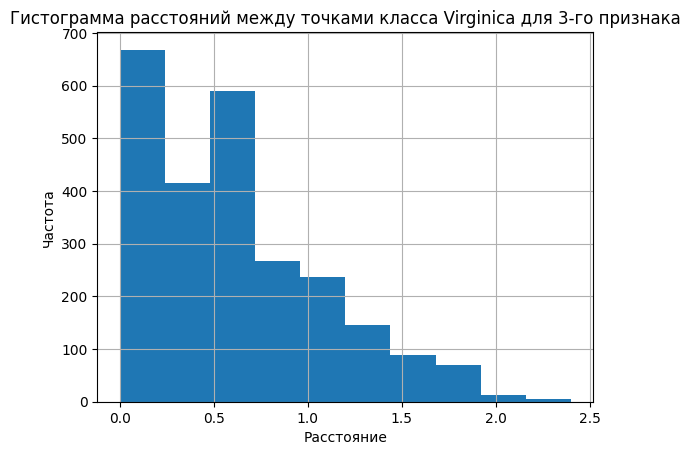

In [ ]:
# Преобразуйте distances в одномерный массив
ds33_1D = ds33.flatten()

# Определите диапазон значений
min_distance = np.min(ds33_1D)
max_distance = np.max(ds33_1D)

# Выберите количество интервалов
n_bins = 10


# Построение гистограммы
counts, bins, patches = plt.hist(ds33_1D, bins=n_bins, range=(min_distance, max_distance))
# Определение наиболее частого диапазона
most_frequent_index = np.argmax(counts)

print("Наиболее частое значение:", bins[most_frequent_index])

# Настройка оформления
plt.xlabel("Расстояние")
plt.ylabel("Частота")
plt.title("Гистограмма расстояний между точками класса Virginica для 3-го признака")
plt.grid(True)
plt.show()

#### 4-й признак (ширина лепестка)

In [ ]:
fourth_column3 = np.take(iris3, 3, axis=1)
fourth_column3

array([2.5, 1.9, 2.1, 1.8, 2.2, 2.1, 1.7, 1.8, 1.8, 2.5, 2. , 1.9, 2.1,
       2. , 2.4, 2.3, 1.8, 2.2, 2.3, 1.5, 2.3, 2. , 2. , 1.8, 2.1, 1.8,
       1.8, 1.8, 2.1, 1.6, 1.9, 2. , 2.2, 1.5, 1.4, 2.3, 2.4, 1.8, 1.8,
       2.1, 2.4, 2.3, 1.9, 2.3, 2.5, 2.3, 1.9, 2. , 2.3, 1.8])

In [ ]:
print('min:', np.min(fourth_column3))
print('max:', np.max(fourth_column3))

((np.max(fourth_column3)+1)-(np.min(fourth_column3)-1))/0.2

min: 1.4
max: 2.5


15.5

In [ ]:
# Инициализация матрицы расстояний
ds34 = np.zeros((len(fourth_column3), len(fourth_column3)))

# Вычисление расстояния между каждой точкой и каждой другой точкой
for i in range(len(fourth_column3)):
  for j in range(len(fourth_column3)):
    if i != j:
      ds34[i, j] = distance(fourth_column3[i], fourth_column3[j])

In [ ]:
# Среднее по всем расстояниям:

# Вычислите сумму всех расстояний
total_34 = np.sum(ds34)

# Количество элементов (не считая диагональных)
n_elements = len(ds34) * (len(ds34) - 1)

# Рассчитайте среднее расстояние
av_ds34 = total_34 / n_elements

print(av_ds34)

0.31371428571428567


Наиболее частое значение: 0.0


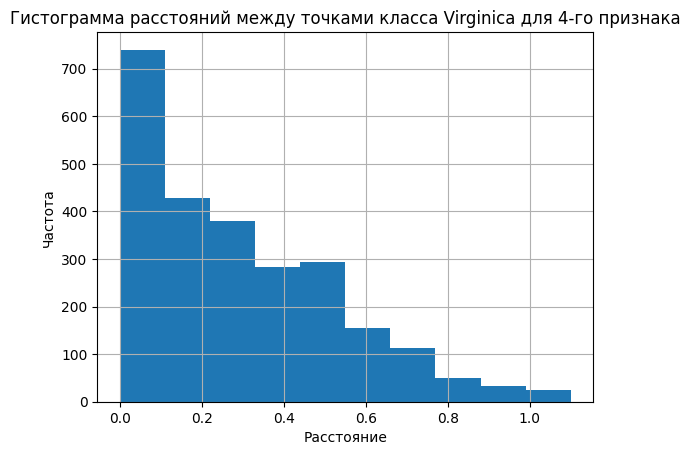

In [ ]:
# Преобразуйте distances в одномерный массив
ds34_1D = ds34.flatten()

# Определите диапазон значений
min_distance = np.min(ds34_1D)
max_distance = np.max(ds34_1D)

# Выберите количество интервалов
n_bins = 10


# Построение гистограммы
counts, bins, patches = plt.hist(ds34_1D, bins=n_bins, range=(min_distance, max_distance))
# Определение наиболее частого диапазона
most_frequent_index = np.argmax(counts)

print("Наиболее частое значение:", bins[most_frequent_index])

# Настройка оформления
plt.xlabel("Расстояние")
plt.ylabel("Частота")
plt.title("Гистограмма расстояний между точками класса Virginica для 4-го признака")
plt.grid(True)
plt.show()

### Обучение АЕ

In [ ]:
#### Обучение Автокодировщика
size = iris3.shape[1]
patience = 4000
verbose_show = True
ae_ir3 = tensorflow.keras.models.Sequential()

# input layer
ae_ir3.add(tensorflow.keras.layers.Dense(size))
ae_ir3.add(tensorflow.keras.layers.Activation('tanh'))

# hidden layers
ae_ir3.add(tensorflow.keras.layers.Dense(100))
ae_ir3.add(tensorflow.keras.layers.Activation('tanh'))
ae_ir3.add(tensorflow.keras.layers.Dense(50))
ae_ir3.add(tensorflow.keras.layers.Activation('tanh'))
ae_ir3.add(tensorflow.keras.layers.Dense(30))
ae_ir3.add(tensorflow.keras.layers.Activation('tanh'))
ae_ir3.add(tensorflow.keras.layers.Dense(3))
ae_ir3.add(tensorflow.keras.layers.Activation('tanh'))
ae_ir3.add(tensorflow.keras.layers.Dense(30))
ae_ir3.add(tensorflow.keras.layers.Activation('tanh'))
ae_ir3.add(tensorflow.keras.layers.Dense(50))
ae_ir3.add(tensorflow.keras.layers.Activation('tanh'))
ae_ir3.add(tensorflow.keras.layers.Dense(100))
ae_ir3.add(tensorflow.keras.layers.Activation('tanh'))

# output layer
ae_ir3.add(tensorflow.keras.layers.Dense(size))
ae_ir3.add(tensorflow.keras.layers.Activation('linear'))

optimizer = tensorflow.keras.optimizers.Adam(learning_rate=0.001, beta_1=0.9, beta_2=0.999, amsgrad=False)
ae_ir3.compile(loss='mean_squared_error', optimizer=optimizer)
error_stop = 0.0001
epo = 20000

early_stopping_callback_on_error = EarlyStoppingOnValue(monitor='loss', baseline=error_stop)
early_stopping_callback_on_improving = tensorflow.keras.callbacks.EarlyStopping(monitor='loss',
                                                                                           min_delta=0.0001, patience = patience,
                                                                                           verbose=1, mode='auto',
                                                                                           baseline=None,
                                                                                           restore_best_weights=False)

history_callback = tensorflow.keras.callbacks.History()
verbose = 1 if verbose_show else 0
history_object = ae_ir3.fit(iris3, iris3,
                                batch_size=20,
                                epochs=epo,
                                callbacks=[early_stopping_callback_on_error, history_callback,
                                early_stopping_callback_on_improving],
                                verbose=verbose)
ae_ir3_trainned = ae_ir3
ae_ir3_pred = ae_ir3_trainned.predict(iris3)
ae_ir3_trainned.save('out/AE_ir3.h5')

Выходные данные были обрезаны до нескольких последних строк (5000).
Epoch 9340/20000
3/3 [==============================] - 0s 11ms/step - loss: 0.0014
Epoch 9341/20000
3/3 [==============================] - 0s 10ms/step - loss: 8.6689e-04
Epoch 9342/20000
3/3 [==============================] - 0s 14ms/step - loss: 8.6494e-04
Epoch 9343/20000
3/3 [==============================] - 0s 13ms/step - loss: 7.8030e-04
Epoch 9344/20000
3/3 [==============================] - 0s 16ms/step - loss: 7.8323e-04
Epoch 9345/20000
3/3 [==============================] - 0s 20ms/step - loss: 5.3965e-04
Epoch 9346/20000
3/3 [==============================] - 0s 14ms/step - loss: 6.1958e-04
Epoch 9347/20000
3/3 [==============================] - 0s 13ms/step - loss: 6.2669e-04
Epoch 9348/20000
3/3 [==============================] - 0s 9ms/step - loss: 7.8026e-04
Epoch 9349/20000
3/3 [==============================] - 0s 11ms/step - loss: 7.4178e-04
Epoch 9350/20000
3/3 [==============================] - 0

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [ ]:
# Сохранение AE
ae_ir3.save('best_model_for_ir3')

In [ ]:
# Загрузка автокодировщика
from keras.models import load_model
ae_ir3 = load_model('best_model_for_ir3')

ae_ir3_trainned = ae_ir3
ae_ir3_pred = ae_ir3_trainned.predict(iris3)
ae_ir3_trainned.save('out/AE_ir3.h5')

2/2 [==============================] - 1s 10ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [ ]:
iris3

array([[6.3, 3.3, 6. , 2.5],
       [5.8, 2.7, 5.1, 1.9],
       [7.1, 3. , 5.9, 2.1],
       [6.3, 2.9, 5.6, 1.8],
       [6.5, 3. , 5.8, 2.2],
       [7.6, 3. , 6.6, 2.1],
       [4.9, 2.5, 4.5, 1.7],
       [7.3, 2.9, 6.3, 1.8],
       [6.7, 2.5, 5.8, 1.8],
       [7.2, 3.6, 6.1, 2.5],
       [6.5, 3.2, 5.1, 2. ],
       [6.4, 2.7, 5.3, 1.9],
       [6.8, 3. , 5.5, 2.1],
       [5.7, 2.5, 5. , 2. ],
       [5.8, 2.8, 5.1, 2.4],
       [6.4, 3.2, 5.3, 2.3],
       [6.5, 3. , 5.5, 1.8],
       [7.7, 3.8, 6.7, 2.2],
       [7.7, 2.6, 6.9, 2.3],
       [6. , 2.2, 5. , 1.5],
       [6.9, 3.2, 5.7, 2.3],
       [5.6, 2.8, 4.9, 2. ],
       [7.7, 2.8, 6.7, 2. ],
       [6.3, 2.7, 4.9, 1.8],
       [6.7, 3.3, 5.7, 2.1],
       [7.2, 3.2, 6. , 1.8],
       [6.2, 2.8, 4.8, 1.8],
       [6.1, 3. , 4.9, 1.8],
       [6.4, 2.8, 5.6, 2.1],
       [7.2, 3. , 5.8, 1.6],
       [7.4, 2.8, 6.1, 1.9],
       [7.9, 3.8, 6.4, 2. ],
       [6.4, 2.8, 5.6, 2.2],
       [6.3, 2.8, 5.1, 1.5],
       [6.1, 2

In [ ]:
ae_ir3_pred

array([[6.302604 , 3.2971687, 5.9919853, 2.498994 ],
       [5.797256 , 2.6983352, 5.096217 , 1.9022807],
       [7.099665 , 2.999815 , 5.897442 , 2.1017566],
       [6.2970605, 2.9044952, 5.596223 , 1.8000046],
       [6.501616 , 3.000674 , 5.8076553, 2.2081444],
       [7.5997767, 3.0051694, 6.604507 , 2.1010032],
       [4.894233 , 2.4991443, 4.494231 , 1.6994344],
       [7.295632 , 2.9017358, 6.3001704, 1.8006634],
       [6.691534 , 2.4991794, 5.8037796, 1.7968127],
       [7.2040906, 3.6052413, 6.1090984, 2.5045662],
       [6.5082126, 3.1888113, 5.1031523, 1.9997807],
       [6.415752 , 2.7113824, 5.2913737, 1.9137243],
       [6.806094 , 2.9875314, 5.5148783, 2.0864475],
       [5.6901813, 2.50593  , 4.9998755, 1.9960444],
       [5.7980695, 2.7969236, 5.092512 , 2.397634 ],
       [6.399937 , 3.20111  , 5.3118963, 2.3048418],
       [6.4940677, 3.0002546, 5.506295 , 1.8213109],
       [7.695311 , 3.7997875, 6.692564 , 2.2050464],
       [7.694239 , 2.599378 , 6.8986635, 2.297

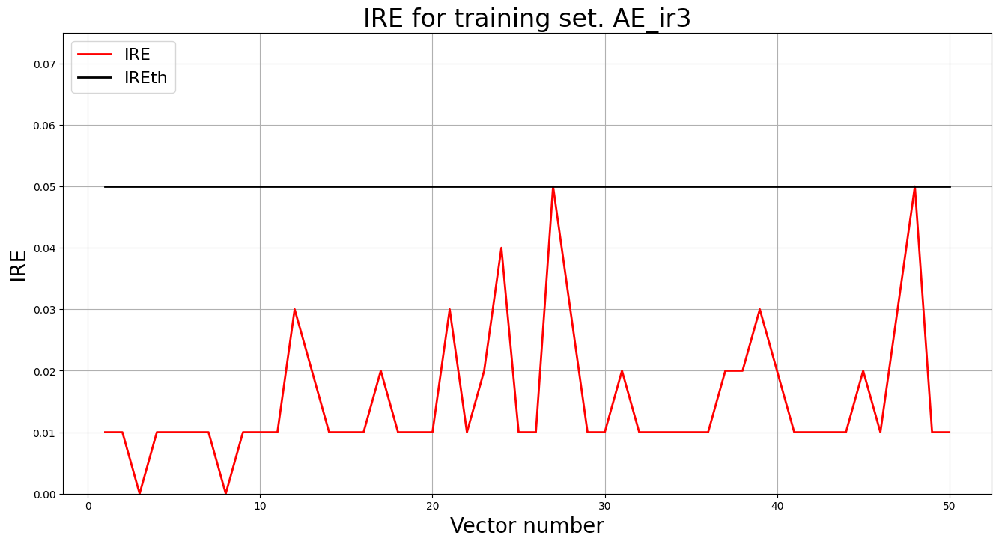

In [ ]:
# Ошибка реконструкции
irefile = 'out/AE_ir3_ire_th.txt'
IRE_array = np.round(ire_array(iris3, ae_ir3_pred), 2)
IREth = np.amax(IRE_array)
with open(irefile, 'w') as file:
    file.write(str(IREth))

IREir3 = IRE_array
IREth_ir3 = IREth

lib.ire_plot('training', IREir3, IREth, 'AE_ir3')

In [ ]:
IREth_ir3

0.05

In [ ]:
# Вычисление деф. множества

Z3, X_def3, X_plot, xx, yy, zz, ff = lib4dthelast64new.prediction(iris3, ae_ir3_trainned, IREth_ir3)

524288/524288 [==============================] - 1740s 3ms/step


In [ ]:
X_def3

array([[5.93125  , 2.2125   , 4.94375  , 1.465625 ],
       [5.93125  , 2.2125   , 5.0125   , 1.4171875],
       [6.009375 , 2.2125   , 4.94375  , 1.5625   ],
       ...,
       [7.884375 , 3.84375  , 6.45625  , 1.9984375],
       [7.884375 , 3.84375  , 6.45625  , 2.046875 ],
       [7.9625   , 3.84375  , 6.45625  , 2.046875 ]])

In [ ]:
X_def3.shape

(3121, 4)

In [ ]:
np.savetxt('X_def3.txt', X_def3)

In [ ]:
# Загрузка датасета

with open('/content/drive/My Drive/Colab Notebooks/X_def3.txt', 'r') as f:
    X_def3 = np.loadtxt(f)
X_def3

array([[5.93125  , 2.2125   , 4.94375  , 1.465625 ],
       [5.93125  , 2.2125   , 5.0125   , 1.4171875],
       [6.009375 , 2.2125   , 4.94375  , 1.5625   ],
       ...,
       [7.884375 , 3.84375  , 6.45625  , 1.9984375],
       [7.884375 , 3.84375  , 6.45625  , 2.046875 ],
       [7.9625   , 3.84375  , 6.45625  , 2.046875 ]])

### Граница АЕ

In [ ]:
# Объедините массивы по столбцам
combined_data3 = np.concatenate([iris3, X_def3])

combined_data3

array([[6.3      , 3.3      , 6.       , 2.5      ],
       [5.8      , 2.7      , 5.1      , 1.9      ],
       [7.1      , 3.       , 5.9      , 2.1      ],
       ...,
       [7.884375 , 3.84375  , 6.45625  , 1.9984375],
       [7.884375 , 3.84375  , 6.45625  , 2.046875 ],
       [7.9625   , 3.84375  , 6.45625  , 2.046875 ]])

In [ ]:
combined_data3.shape

(3171, 4)

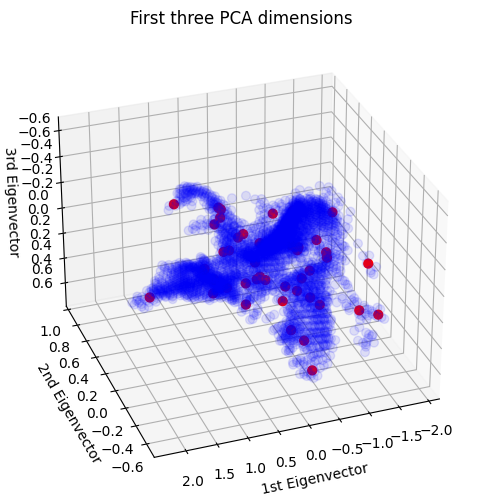

In [ ]:
# PCA 3 ГК
import mpl_toolkits.mplot3d
from sklearn.decomposition import PCA

fig = plt.figure(1, figsize=(8, 6))
ax = fig.add_subplot(111, projection="3d", elev=-150, azim=110)

X_combo3 = PCA(n_components=3).fit_transform(combined_data3.data)

ax.scatter(
    X_combo3[0:50, 0],
    X_combo3[0:50, 1],
    X_combo3[0:50, 2],
    c = 'red',
    s=40,
    alpha=1
)

ax.scatter(
    X_combo3[50:, 0],
    X_combo3[50:, 1],
    X_combo3[50:, 2],
    c = 'blue',
    s=40,
    alpha=0.1
)



ax.set_title("First three PCA dimensions")
ax.set_xlabel("1st Eigenvector")
# Добавляем разметку по оси X
ax.xaxis.set_tick_params(labelbottom=True)
ax.set_ylabel("2nd Eigenvector")
# Добавляем разметку по оси Y
ax.yaxis.set_tick_params(labelleft=True)
ax.set_zlabel("3rd Eigenvector")
# Добавляем разметку по оси Z
ax.zaxis.set_tick_params(labelright=True)

plt.show()

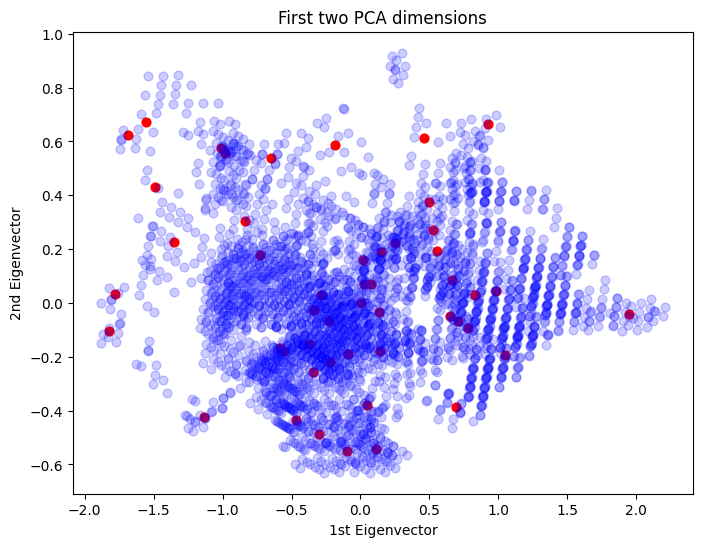

In [ ]:
# PCA 2 ГК

fig = plt.figure(1, figsize=(8, 6))
ax = fig.add_subplot(111)

ax.scatter(
    X_combo3[0:50, 0],
    X_combo3[0:50, 1],
    c = 'red',
    s=40,
    alpha=1
)

ax.scatter(
    X_combo3[50:, 0],
    X_combo3[50:, 1],
    c = 'blue',
    s=40,
    alpha=0.2
)


ax.set_title("First two PCA dimensions")
ax.set_xlabel("1st Eigenvector")
# Добавляем разметку по оси X
ax.xaxis.set_tick_params(labelbottom=True)
ax.set_ylabel("2nd Eigenvector")
# Добавляем разметку по оси Y
ax.yaxis.set_tick_params(labelleft=True)

plt.show()

### Вычисление EDCA

In [ ]:
numb_square = 58

amount, amount_ae = lib4dthelast55new.calculations(numb_square, X, iris3, X_def3, '_ir3')

min:  -0.9
max:  8.9
amount:  48
amount_ae:  696

Оценка качества AE_ir3
IDEAL = 0. Excess:  13.625
IDEAL = 0. Deficit:  0.125
IDEAL = 1. Coating:  0.875
summa:  1.0
IDEAL = 1. Extrapolation precision (Approx):  0.0689655172413793




### График Excess

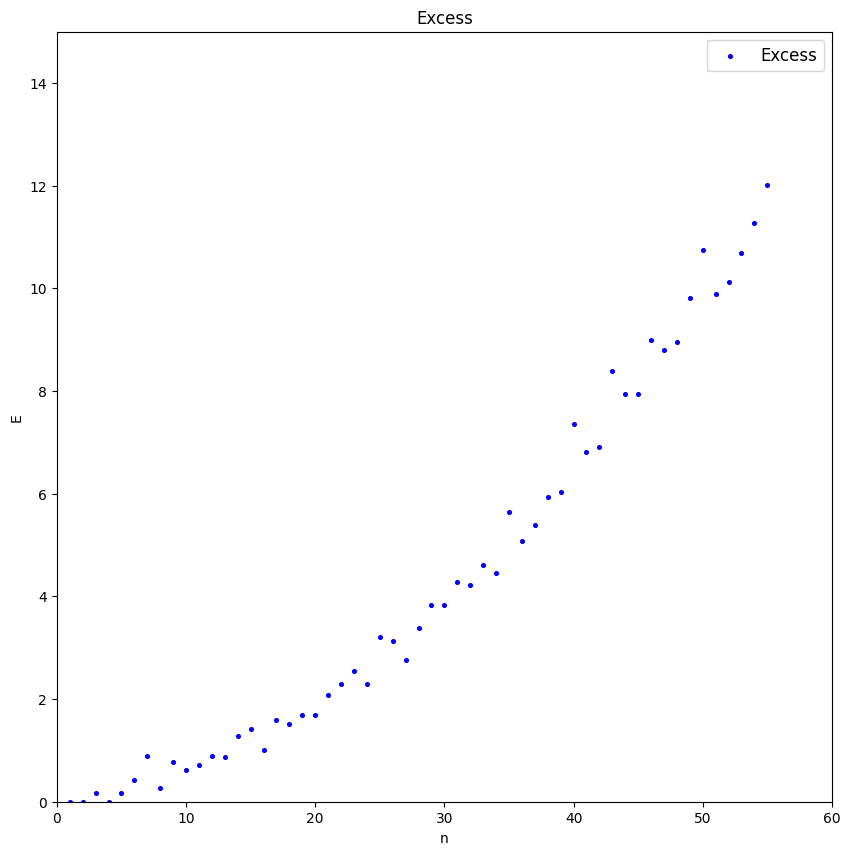

In [ ]:
Excess = [0, 0, 0.1667, 0, 0.1667, 0.4286, 0.9, 0.2667, 0.7692, 0.625, 0.7059, 0.9, 0.8696, 1.2727, 1.4167, 1, 1.5926, 1.5161, 1.6875, 1.6857,
          2.0882, 2.2973, 2.5429, 2.2857, 3.2051, 3.1282, 2.7674, 3.3902, 3.8372, 3.8293, 4.2727, 4.2128, 4.6136, 4.4468, 5.6522, 5.087, 5.4, 5.9348, 6.0426, 7.3556,
          6.8044, 6.9167, 8.4, 7.9375, 7.9375, 9, 8.8044, 8.9592, 9.8125, 10.7391, 9.898, 10.1225, 10.6875, 11.2708, 12.0204]

n = list(range(1, 56))

plt.figure(figsize=(10,10))
plt.scatter(n,Excess,marker='o',s=7,color='b',label='Excess')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.xlim([0, 60])
plt.ylim([0, 15])
plt.show()

### Среднее

In [ ]:
nn = np.arange(1,56)

av = []
for i in nn:
  av.append(np.mean(Excess[0:i]))

print(av)

[0.0, 0.0, 0.05556666666666666, 0.041675, 0.06667999999999999, 0.127, 0.2374285714285714, 0.2410875, 0.2997666666666667, 0.33229000000000003, 0.3662545454545455, 0.4107333333333334, 0.4460307692307693, 0.5050785714285715, 0.5658533333333334, 0.5929875, 0.6517882352941177, 0.6998055555555556, 0.7517894736842106, 0.7984850000000001, 0.8599, 0.9252363636363636, 0.9955695652173913, 1.0493249999999998, 1.135556, 1.2121961538461539, 1.2697962962962963, 1.345525, 1.431444827586207, 1.5113733333333335, 1.6004483870967743, 1.682084375, 1.7709181818181818, 1.8496205882352943, 1.9582657142857143, 2.045175, 2.1358459459459462, 2.2358184210526315, 2.333428205128205, 2.4589825000000003, 2.564968292682927, 2.6685809523809527, 2.8018697674418607, 2.918588636363637, 3.0301200000000006, 3.159900000000001, 3.2799957446808516, 3.3983124999999994, 3.529214285714285, 3.6734119999999995, 3.795462745098039, 3.917136538461538, 4.044879245283019, 4.178692592592593, 4.321269090909091]


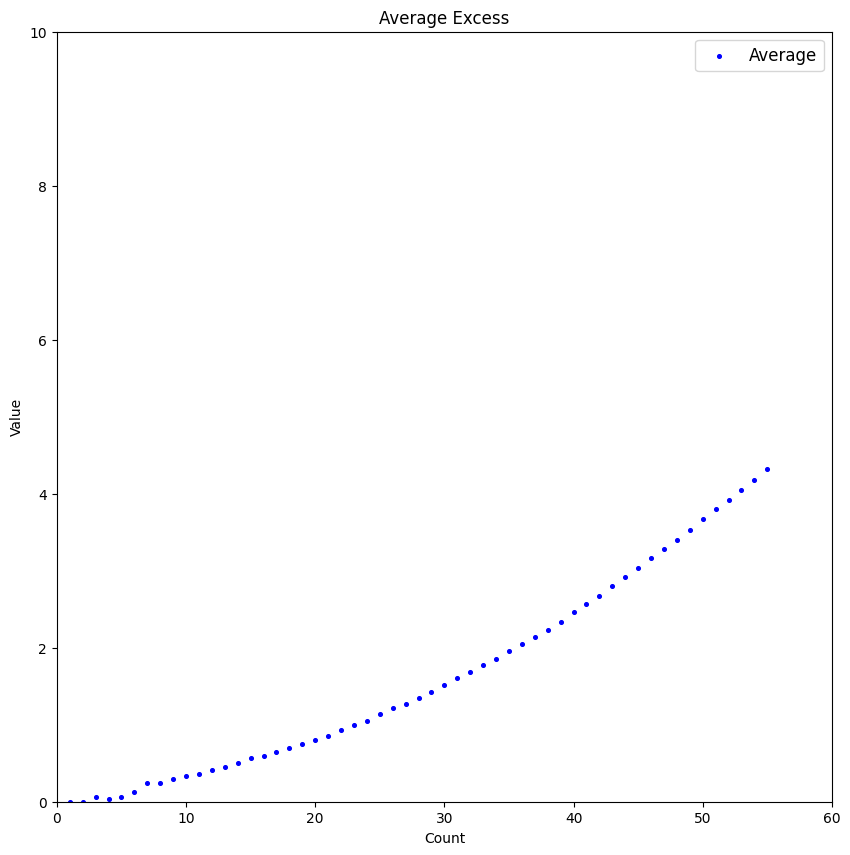

In [ ]:
plt.figure(figsize=(10,10))
plt.scatter(nn,av,marker='o',s=7,color='b',label='Average')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Average Excess')
plt.xlabel('Count')
plt.ylabel('Value')
plt.xlim([0, 60])
plt.ylim([0, 10])
plt.show()

### Аппроксимация МНК

In [ ]:
x = np.array(n)
y = np.array(Excess)

linear_func = lambda x, b0, b1: b0 + b1*x
quadratic_func = lambda x, b0, b1, b2: b0 + b1*x + b2*x**2
qubic_func = lambda x, b0, b1, b2, b3: b0 + b1*x + b2*x**2 + b3*x**3
exp_func = lambda x, b0, b1, b2: b0 + b1*np.exp(b2*x)
exp1_func = lambda x, b0, b1, b2: b0 + b1*np.exp(x-b2)
exp2_func = lambda x, b0, b1: b0*np.power(b1,x)
exp3_func = lambda x, b0, b1, b2:  b0 + b1*np.power(b2,x)


from scipy.optimize import leastsq

# list of model
model_list = [
    'linear', 'quadratic',
    'qubic', 'exp3']

# model reference
models_dict = {
        'linear':             linear_func,
        'quadratic':          quadratic_func,
        'qubic':              qubic_func,
        'exp3':               exp3_func}

# initial values
p0_dict = {
        'linear':             [0, 0],
        'quadratic':          [0, 0, 0],
        'qubic':              [0, 0, 0, 0],
        'exp3':               [0, 1, 1]}

# titles (formulas)
formulas_dict = {
        'linear':             'y = b0 + b1*x',
        'quadratic':          'y = b0 + b1*x + b2*x^2',
        'qubic':              'y = b0 + b1*x + b2*x^2 + b3*x^3',
        'exp3':               'y = b0 + b1*np.power(b2,x)'}

# actual data
X_fact = x
Y_fact = y

# function for calculating residuals
residual_func = lambda p, x, y: y - func(x, *p)

# return all optional outputs
full_output = True

# variables to save the calculation results
calculation_results_df = pd.DataFrame(columns=['func', 'p0', 'popt', 'cov_x', 'SSE', 'MSE', 'pcov', 'perr', 'Y_calc', 'error_metrics'])
error_metrics_results_df = pd.DataFrame(columns=['MSE', 'RMSE', 'MAE', 'MSPE', 'MAPE', 'RMSLE', 'R2'])

# calculations
for func_name in model_list:
    print(f'{func_name.upper()} MODEL: {formulas_dict[func_name]}')
    func = models_dict[func_name]
    calculation_results_df.loc[func_name, 'func'] = func
    p0 = p0_dict[func_name]
    print(f'p0 = {p0}')
    calculation_results_df.loc[func_name, 'p0'] = p0
    if full_output:
        (popt, cov_x, infodict, mesg, ier) = leastsq(residual_func, p0, args=(X_fact, Y_fact), full_output=full_output)
        integer_flag = f'ier = {ier}, the solution was found' if ier<=4 else f'ier = {ier}, the solution was not found'
        print(integer_flag, '\n', mesg)
        calculation_results_df.loc[func_name, 'popt'] = popt
        print(f'parameters = {popt}')
        calculation_results_df.loc[func_name, 'cov_x'] = cov_x
        print(f'cov_x = \n{cov_x}')
        #SSE = (residual_func(popt, X_fact, Y_fact)**2).sum()
        SSE = (infodict['fvec']**2).sum()
        calculation_results_df.loc[func_name, 'SSE'] = SSE
        print(f'SSE = {SSE}')
        MSE = SSE / (len(Y_fact)-len(p0))
        calculation_results_df.loc[func_name, 'MSE'] = MSE
        print(f'MSE = {MSE}')
        pcov = cov_x * MSE
        calculation_results_df.loc[func_name, 'pcov'] = pcov
        print(f'pcov =\n {pcov}')
        perr = np.sqrt(np.diag(pcov))
        calculation_results_df.loc[func_name, 'perr'] = perr
        print(f'perr = {perr}\n')
    else:
        popt = leastsq(residual_func, p0, args=(X_fact, Y_fact), full_output=full_output)
        calculation_results_df.loc[func_name, 'popt'] = popt
        print(f'parameters = {popt}\n')
    Y_calc = func(X_fact, *popt)
    calculation_results_df.loc[func_name, 'Y_calc'] = Y_calc
    (error_metrics_dict, error_metrics_df) = regression_error_metrics(Yfact=Y_fact, Ycalc=Y_calc, model_name=func_name)
    calculation_results_df.loc[func_name, 'error_metrics'] = error_metrics_dict.values()
    error_metrics_results_df = pd.concat([error_metrics_results_df, error_metrics_df])

LINEAR MODEL: y = b0 + b1*x
p0 = [0, 0]
ier = 3, the solution was found 
 Both actual and predicted relative reductions in the sum of squares
  are at most 0.000000 and the relative error between two consecutive iterates is at 
  most 0.000000
parameters = [-1.79548222  0.2184554 ]
cov_x = 
[[ 7.47474751e-02 -2.02020203e-03]
 [-2.02020203e-03  7.21500724e-05]]
SSE = 37.94555693269191
MSE = 0.7159539043904134
pcov =
 [[ 5.35157466e-02 -1.44637153e-03]
 [-1.44637153e-03  5.16561260e-05]]
perr = [0.23133471 0.00718722]

QUADRATIC MODEL: y = b0 + b1*x + b2*x^2
p0 = [0, 0, 0]
ier = 1, the solution was found 
 Both actual and predicted relative reductions in the sum of squares
  are at most 0.000000
parameters = [0.02441301 0.02688748 0.00342086]
cov_x = 
[[ 1.76138683e-01 -1.26929625e-02  1.90585050e-04]
 [-1.26929625e-02  1.19559869e-03 -2.00615855e-05]
 [ 1.90585050e-04 -2.00615855e-05  3.58242638e-07]]
SSE = 5.279838982336444
MSE = 0.10153536504493162
pcov =
 [[ 1.78843054e-02 -1.2887845

<ipython-input-7-a10df777837d>:36: RuntimeWarning: divide by zero encountered in divide
  MSPE = (1/n_fit) *  np.sum(((Yfact-Ycalc)/Yfact)**2)
<ipython-input-7-a10df777837d>:37: RuntimeWarning: divide by zero encountered in divide
  MAPE = (1/n_fit) *  np.sum(abs((Yfact-Ycalc)/Yfact))
<ipython-input-7-a10df777837d>:38: RuntimeWarning: invalid value encountered in log
  RMSLE = math.sqrt((1/n_fit) * np.sum((np.log(Yfact + 1)-np.log(Ycalc + 1))**2))
<ipython-input-7-a10df777837d>:36: RuntimeWarning: divide by zero encountered in divide
  MSPE = (1/n_fit) *  np.sum(((Yfact-Ycalc)/Yfact)**2)
<ipython-input-7-a10df777837d>:37: RuntimeWarning: divide by zero encountered in divide
  MAPE = (1/n_fit) *  np.sum(abs((Yfact-Ycalc)/Yfact))
<ipython-input-7-a10df777837d>:36: RuntimeWarning: divide by zero encountered in divide
  MSPE = (1/n_fit) *  np.sum(((Yfact-Ycalc)/Yfact)**2)
<ipython-input-7-a10df777837d>:37: RuntimeWarning: divide by zero encountered in divide
  MAPE = (1/n_fit) *  np.sum(ab

#### 1-я степень

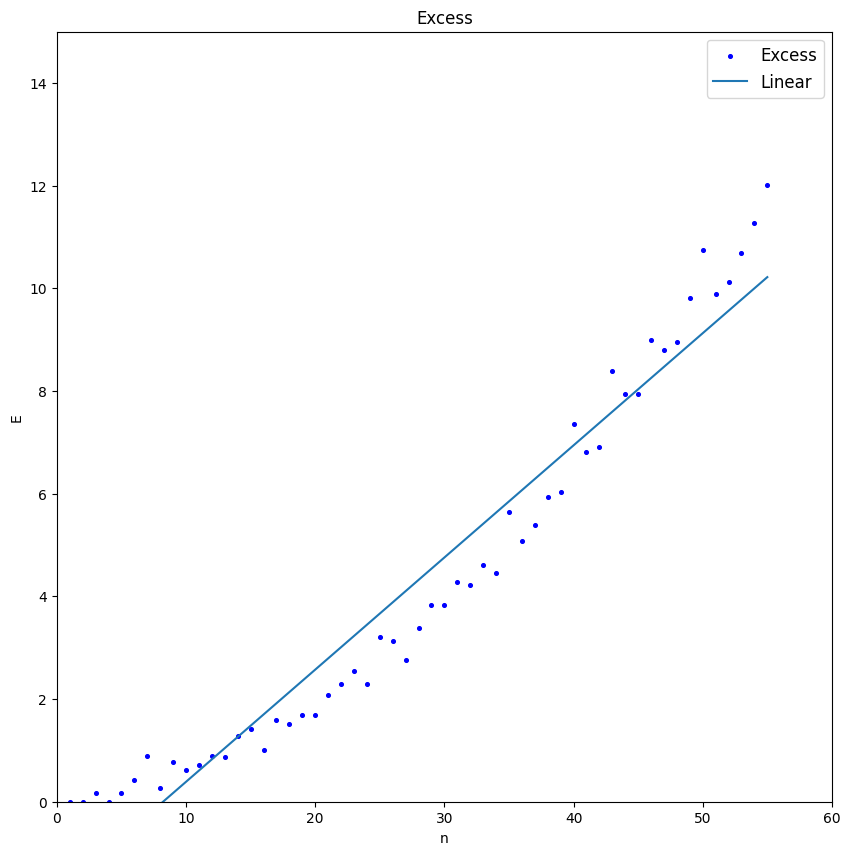

In [ ]:
b0, b1 = [-1.79548222,  0.2184554 ]

xx = np.arange (1,56)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='b',label='Excess')
plt.plot(xx, b0 + b1*xx , label = 'Linear')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.xlim([0, 60])
plt.ylim([0, 15])
plt.show()

#### 2-я степень

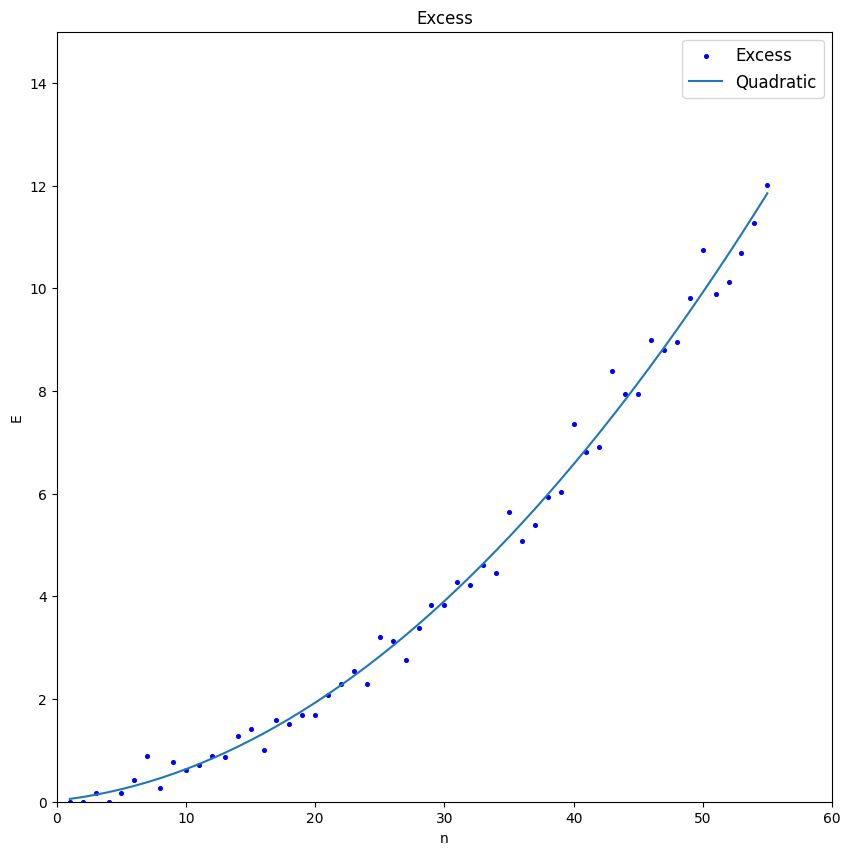

In [ ]:
b0, b1, b2 = [0.02441301, 0.02688748, 0.00342086]

xx = np.arange (1,56)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='b',label='Excess')
plt.plot(xx, b0 + b1*xx + b2*xx**2 , label = 'Quadratic')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.xlim([0, 60])
plt.ylim([0, 15])
plt.show()

#### 3-я степень

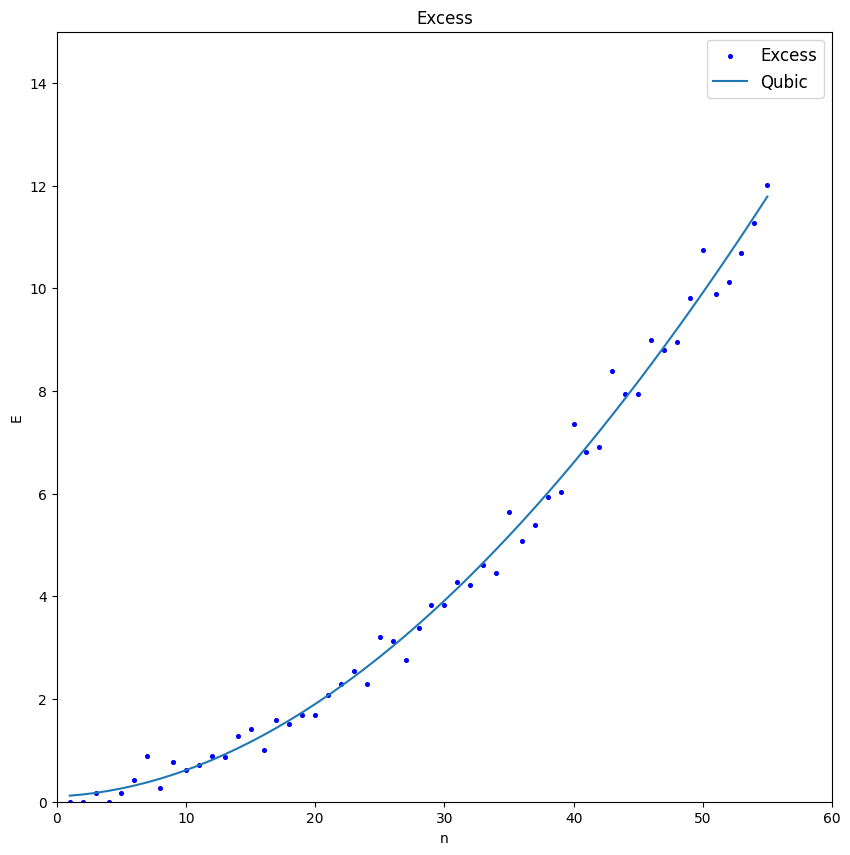

In [ ]:
b0, b1, b2, b3 =[ 1.03002789e-01,  1.07684640e-02,  4.13401157e-03, -8.48995075e-06]

xx = np.arange (1,56)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='b',label='Excess')
plt.plot(xx, b0 + b1*xx + b2*xx**2 + b3*xx**3 , label = 'Qubic')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.xlim([0, 60])
plt.ylim([0, 15])
plt.show()

#### EXP

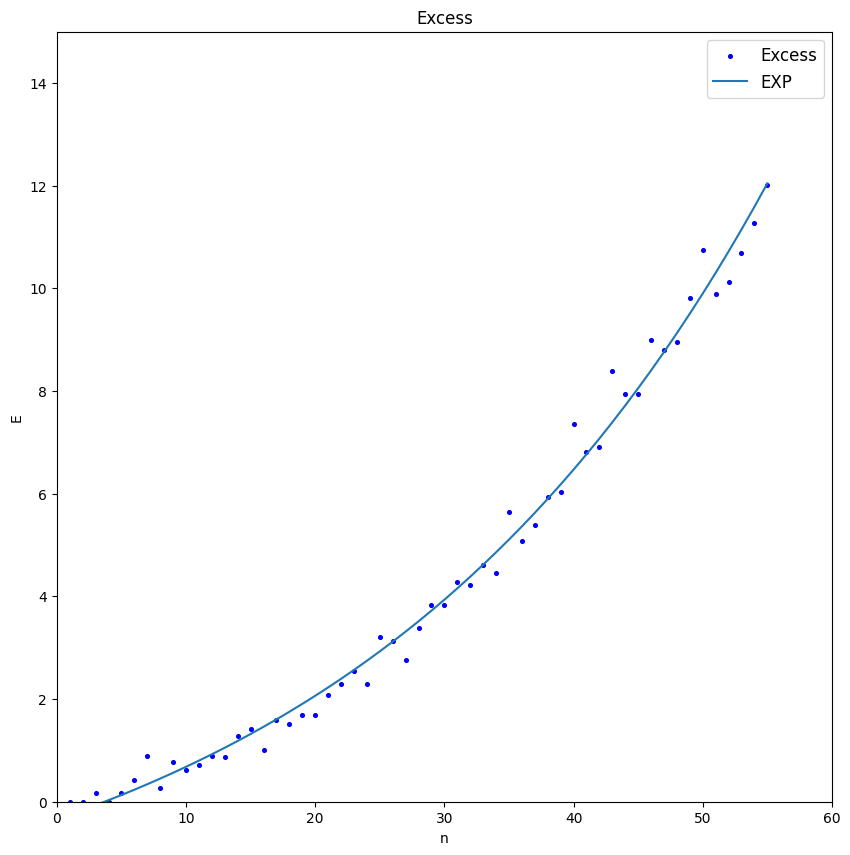

In [ ]:
b0, b1, b2 = [-3.23334716,  2.89186454, 1.03072704]

xx = np.arange (1,56)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='b',label='Excess')
plt.plot(xx, b0 + b1*np.power(b2,xx) , label = 'EXP')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.xlim([0, 60])
plt.ylim([0, 15])
plt.show()

### Несколько точек (Excess)

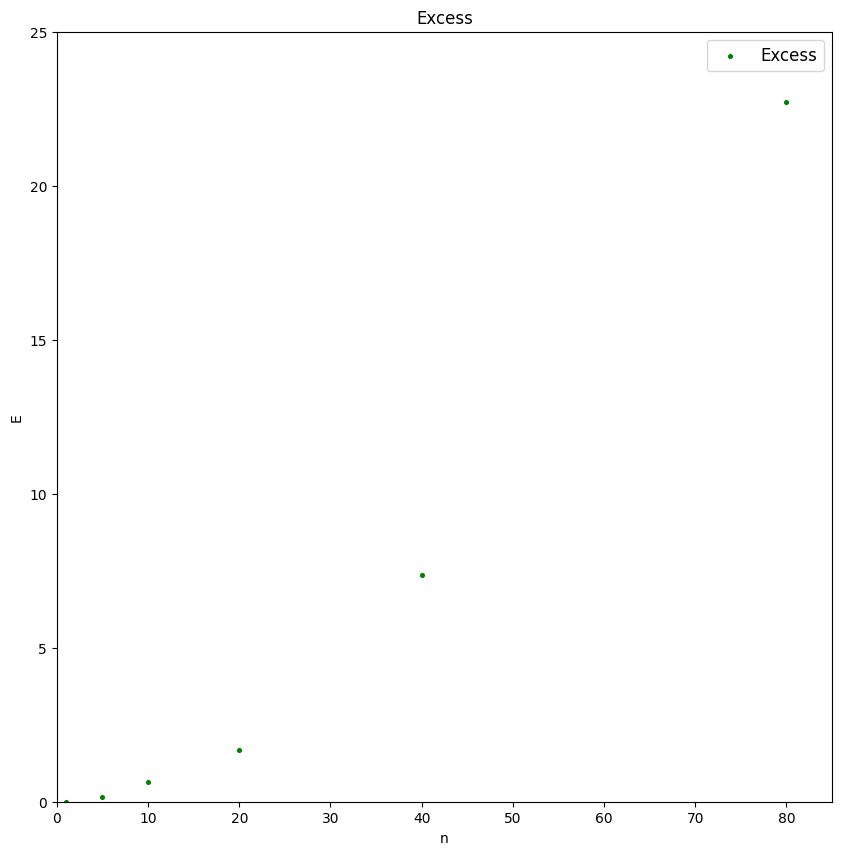

In [ ]:
Excess = [0, 0.1667, 0.625, 1.6857, 7.3556, 22.7143]
n = [1, 5, 10, 20, 40, 80]

plt.figure(figsize=(10,10))
plt.scatter(n,Excess,marker='o',s=7,color='g',label='Excess')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.xlim([0, 85])
plt.ylim([0, 25])
plt.show()

In [ ]:
x = np.array(n)
y = np.array(Excess)

linear_func = lambda x, b0, b1: b0 + b1*x
quadratic_func = lambda x, b0, b1, b2: b0 + b1*x + b2*x**2
qubic_func = lambda x, b0, b1, b2, b3: b0 + b1*x + b2*x**2 + b3*x**3
exp_func = lambda x, b0, b1, b2: b0 + b1*np.exp(b2*x)
exp1_func = lambda x, b0, b1, b2: b0 + b1*np.exp(x-b2)
exp2_func = lambda x, b0, b1: b0*np.power(b1,x)
exp3_func = lambda x, b0, b1, b2:  b0 + b1*np.power(b2,x)


from scipy.optimize import leastsq

# list of model
model_list = [
    'linear', 'quadratic',
    'qubic']

# model reference
models_dict = {
        'linear':             linear_func,
        'quadratic':          quadratic_func,
        'qubic':              qubic_func}

# initial values
p0_dict = {
        'linear':             [0, 0],
        'quadratic':          [0, 0, 0],
        'qubic':              [0, 0, 0, 0]}

# titles (formulas)
formulas_dict = {
        'linear':             'y = b0 + b1*x',
        'quadratic':          'y = b0 + b1*x + b2*x^2',
        'qubic':              'y = b0 + b1*x + b2*x^2 + b3*x^3'}

# actual data
X_fact = x
Y_fact = y

# function for calculating residuals
residual_func = lambda p, x, y: y - func(x, *p)

# return all optional outputs
full_output = True

# variables to save the calculation results
calculation_results_df = pd.DataFrame(columns=['func', 'p0', 'popt', 'cov_x', 'SSE', 'MSE', 'pcov', 'perr', 'Y_calc', 'error_metrics'])
error_metrics_results_df = pd.DataFrame(columns=['MSE', 'RMSE', 'MAE', 'MSPE', 'MAPE', 'RMSLE', 'R2'])

# calculations
for func_name in model_list:
    print(f'{func_name.upper()} MODEL: {formulas_dict[func_name]}')
    func = models_dict[func_name]
    calculation_results_df.loc[func_name, 'func'] = func
    p0 = p0_dict[func_name]
    print(f'p0 = {p0}')
    calculation_results_df.loc[func_name, 'p0'] = p0
    if full_output:
        (popt, cov_x, infodict, mesg, ier) = leastsq(residual_func, p0, args=(X_fact, Y_fact), full_output=full_output)
        integer_flag = f'ier = {ier}, the solution was found' if ier<=4 else f'ier = {ier}, the solution was not found'
        print(integer_flag, '\n', mesg)
        calculation_results_df.loc[func_name, 'popt'] = popt
        print(f'parameters = {popt}')
        calculation_results_df.loc[func_name, 'cov_x'] = cov_x
        print(f'cov_x = \n{cov_x}')
        #SSE = (residual_func(popt, X_fact, Y_fact)**2).sum()
        SSE = (infodict['fvec']**2).sum()
        calculation_results_df.loc[func_name, 'SSE'] = SSE
        print(f'SSE = {SSE}')
        MSE = SSE / (len(Y_fact)-len(p0))
        calculation_results_df.loc[func_name, 'MSE'] = MSE
        print(f'MSE = {MSE}')
        pcov = cov_x * MSE
        calculation_results_df.loc[func_name, 'pcov'] = pcov
        print(f'pcov =\n {pcov}')
        perr = np.sqrt(np.diag(pcov))
        calculation_results_df.loc[func_name, 'perr'] = perr
        print(f'perr = {perr}\n')
    else:
        popt = leastsq(residual_func, p0, args=(X_fact, Y_fact), full_output=full_output)
        calculation_results_df.loc[func_name, 'popt'] = popt
        print(f'parameters = {popt}\n')
    Y_calc = func(X_fact, *popt)
    calculation_results_df.loc[func_name, 'Y_calc'] = Y_calc
    (error_metrics_dict, error_metrics_df) = regression_error_metrics(Yfact=Y_fact, Ycalc=Y_calc, model_name=func_name)
    calculation_results_df.loc[func_name, 'error_metrics'] = error_metrics_dict.values()
    error_metrics_results_df = pd.concat([error_metrics_results_df, error_metrics_df])

LINEAR MODEL: y = b0 + b1*x
p0 = [0, 0]
ier = 3, the solution was found 
 Both actual and predicted relative reductions in the sum of squares
  are at most 0.000000 and the relative error between two consecutive iterates is at 
  most 0.000000
parameters = [-2.17149658  0.29215564]
cov_x = 
[[ 3.17897095e-01 -5.81655496e-03]
 [-5.81655496e-03  2.23713650e-04]]
SSE = 15.21334093793289
MSE = 3.8033352344832223
pcov =
 [[ 1.20906922e+00 -2.21223084e-02]
 [-2.21223084e-02  8.50858008e-04]]
perr = [1.09957684 0.02916947]

QUADRATIC MODEL: y = b0 + b1*x + b2*x^2
p0 = [0, 0, 0]
ier = 1, the solution was found 
 Both actual and predicted relative reductions in the sum of squares
  are at most 0.000000
parameters = [-0.30572405  0.07325562  0.00269221]
cov_x = 
[[ 5.55248485e-01 -3.36635834e-02  3.42485098e-04]
 [-3.36635834e-02  3.49084014e-03 -4.01817444e-05]
 [ 3.42485098e-04 -4.01817444e-05  4.94187357e-07]]
SSE = 0.5468700619641192
MSE = 0.18229002065470643
pcov =
 [[ 1.01216258e-01 -6.136

<ipython-input-7-a10df777837d>:36: RuntimeWarning: divide by zero encountered in divide
  MSPE = (1/n_fit) *  np.sum(((Yfact-Ycalc)/Yfact)**2)
<ipython-input-7-a10df777837d>:37: RuntimeWarning: divide by zero encountered in divide
  MAPE = (1/n_fit) *  np.sum(abs((Yfact-Ycalc)/Yfact))
<ipython-input-7-a10df777837d>:38: RuntimeWarning: invalid value encountered in log
  RMSLE = math.sqrt((1/n_fit) * np.sum((np.log(Yfact + 1)-np.log(Ycalc + 1))**2))
<ipython-input-7-a10df777837d>:36: RuntimeWarning: divide by zero encountered in divide
  MSPE = (1/n_fit) *  np.sum(((Yfact-Ycalc)/Yfact)**2)
<ipython-input-7-a10df777837d>:37: RuntimeWarning: divide by zero encountered in divide
  MAPE = (1/n_fit) *  np.sum(abs((Yfact-Ycalc)/Yfact))
<ipython-input-7-a10df777837d>:36: RuntimeWarning: divide by zero encountered in divide
  MSPE = (1/n_fit) *  np.sum(((Yfact-Ycalc)/Yfact)**2)
<ipython-input-7-a10df777837d>:37: RuntimeWarning: divide by zero encountered in divide
  MAPE = (1/n_fit) *  np.sum(ab

3 степень

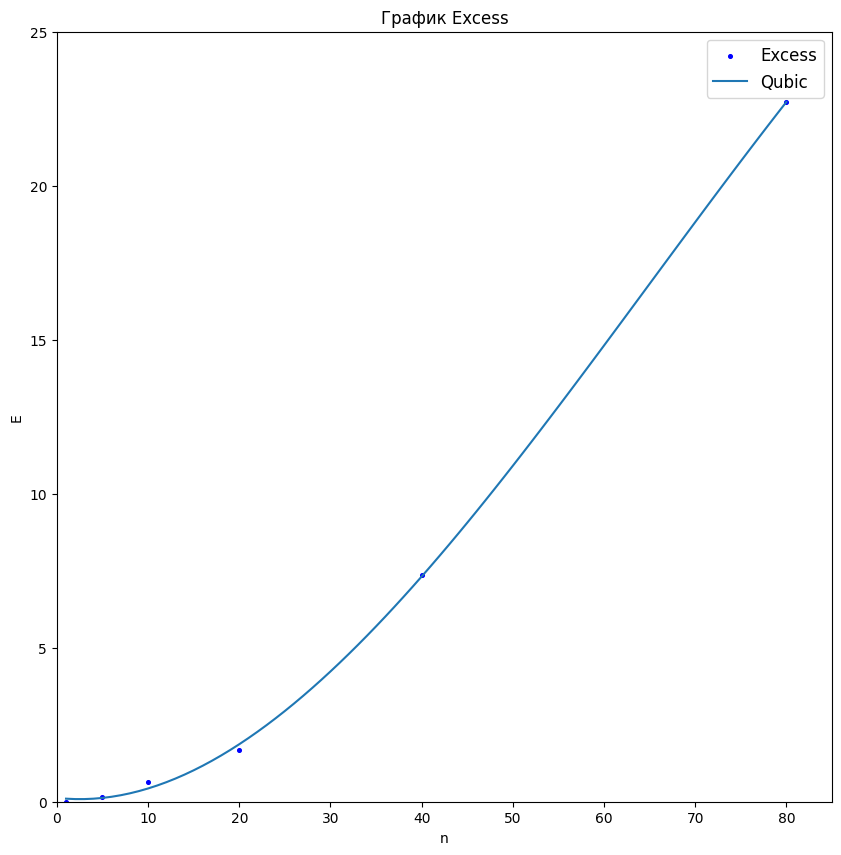

In [ ]:
b0, b1, b2, b3 =[ 1.25072616e-01, -3.28750850e-02,  6.68400508e-03, -3.42874009e-05]

xx = np.arange (1,81)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='b',label='Excess')
plt.plot(xx, b0 + b1*xx + b2*xx**2 + b3*xx**3 , label = 'Qubic')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.xlim([0, 85])
plt.ylim([0, 25])
plt.show()

In [ ]:
import sympy as sp

def f(x):
  z = b0 + b1*x + b2*x**2 + b3*x**3
  return z

# Объявляем символьную переменную x
x = sp.Symbol ("x")
# Вывод функции
print("f(x) =", f(x))
# Находим производную функции f(x) и сохраняем ее в переменной d_f:
d_f = sp.diff(f(x), x)
print("Первая производная функции:",d_f)

# Решаем уравнение d_f = 0:
x_extr = sp.solve (d_f)
print ("точка экстремума:", x_extr)

# Сохраняем точки экстремума в переменные:
x_0 = x_extr[0]
x_1 = x_extr[1]

# Находим вторую производную функции:
d2_f = sp.diff(f(x), x, 2)
print("Вторая производная функции:", d2_f)

# Решаем уравнение d2_f = 0
x_extr2 = sp.solve (d2_f)
print ("точка перегиба:", x_extr2)

# Находим значение второй производной в точках экстремума x_0 и x_1,
# Сохраняем их в переменные f_0_d2 и f_1_d2:
f_0_d2 = d2_f.evalf(subs = {x : x_0})
f_1_d2 = d2_f.evalf(subs = {x : x_1})

# Определяем, является ли точка x_0 точкой лок.минимума, максимума или перегиба
if f_0_d2 > 0:
  print(x_0, "- локальный минимум")
elif f_0_d2 < 0:
  print(x_0, "- локальный максимум")
else:
  print(x_0, "- точка перегиба")

# Определяем, является ли точка x_1 точкой лок.минимума, максимума или перегиба
if f_1_d2 > 0:
  print(x_1, "- локальный минимум")
elif f_1_d2 < 0:
  print(x_1, "- локальный максимум")
else:
  print(x_1, "- точка перегиба")


f(x) = -3.42874009e-5*x**3 + 0.00668400508*x**2 - 0.032875085*x + 0.125072616
Первая производная функции: -0.0001028622027*x**2 + 0.01336801016*x - 0.032875085
точка экстремума: [2.50762071210062, 127.452751602579]
Вторая производная функции: 0.01336801016 - 0.0002057244054*x
точка перегиба: [64.9801861573396]
2.50762071210062 - локальный минимум
127.452751602579 - локальный максимум


In [ ]:
from sympy import *

x = Symbol('x', real=True)
f = b0 + b1*x + b2*x**2 + b3*x**3
fprime = f.diff(x)

solve(fprime, x)

[3.03247521651244, 93.9900415730798]

2 степень

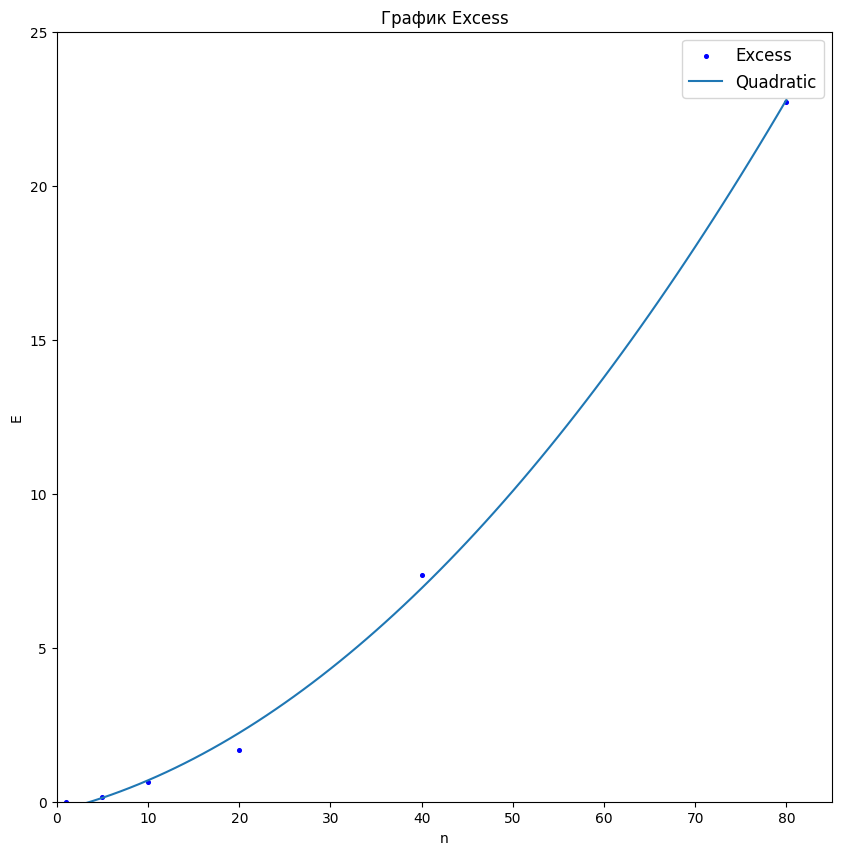

In [ ]:
b0, b1, b2 = [-0.30572405,  0.07325562,  0.00269221]

xx = np.arange (1,81)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='b',label='Excess')
plt.plot(xx, b0 + b1*xx + b2*xx**2 , label = 'Quadratic')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Excess')
plt.xlabel('n')
plt.ylabel('E')
plt.xlim([0, 85])
plt.ylim([0, 25])
plt.show()

In [ ]:
from sympy import *

x = Symbol('x', real=True)
f = b0 + b1*x + b2*x**2
fprime = f.diff(x)

solve(fprime, x)

[-13.6051088139484]

### График Approx

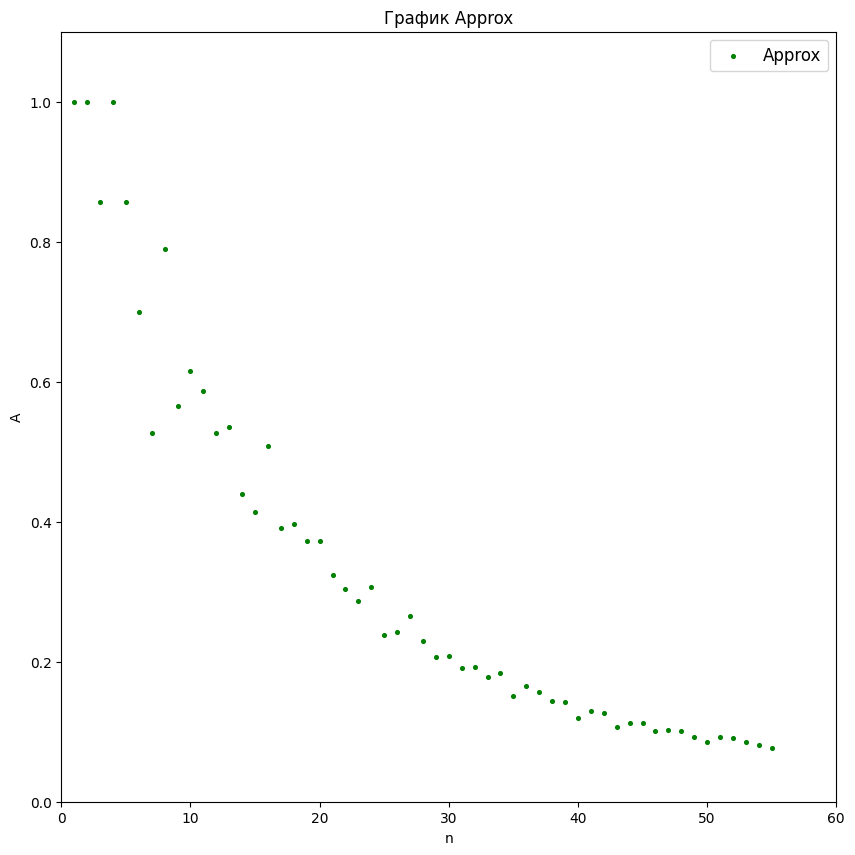

In [ ]:
Approx = [1, 1, 0.8571, 1, 0.8571, 0.7, 0.5263, 0.7895, 0.5652, 0.6154, 0.5862, 0.5263, 0.5349, 0.44, 0.4138, 0.5088, 0.3913, 0.3974, 0.3721, 0.3723,
          0.3238, 0.3033, 0.2869, 0.3066, 0.2378, 0.2422, 0.2654, 0.2291, 0.2067, 0.2081, 0.1905, 0.1926, 0.1781, 0.1843, 0.1513, 0.1649, 0.1568, 0.1442, 0.1424, 0.1203,
          0.1289, 0.1263, 0.1064, 0.1124, 0.1119, 0.1004, 0.1024, 0.1008, 0.0927, 0.0853, 0.0921, 0.0904, 0.086, 0.0816, 0.0768]

n = list(range(1, 56))

plt.figure(figsize=(10,10))
plt.scatter(n,Approx,marker='o',s=7,color='g',label='Approx')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Approx')
plt.xlabel('n')
plt.ylabel('A')
plt.xlim([0, 60])
plt.ylim([0, 1.1])
plt.show()

### Среднее Approx

[1.0, 1.0, 0.9523666666666667, 0.964275, 0.94284, 0.9023666666666667, 0.8486428571428571, 0.8412499999999999, 0.8105777777777777, 0.79106, 0.7724363636363637, 0.751925, 0.7352307692307692, 0.7141428571428571, 0.69412, 0.6825375, 0.6654058823529412, 0.6505166666666666, 0.6358631578947368, 0.6226849999999999, 0.6084523809523809, 0.5945818181818181, 0.5812043478260869, 0.5697625, 0.556484, 0.5443961538461538, 0.534062962962963, 0.5231714285714285, 0.5122586206896551, 0.50212, 0.49206774193548386, 0.482709375, 0.4734787878787879, 0.46497352941176473, 0.45601142857142857, 0.44792499999999996, 0.44005675675675676, 0.432271052631579, 0.42483846153846155, 0.417225, 0.4101926829268293, 0.40343333333333337, 0.3965255813953489, 0.3900681818181819, 0.3838866666666667, 0.3777239130434783, 0.37186595744680856, 0.36621875, 0.3606367346938775, 0.35513, 0.3499725490196078, 0.34498076923076915, 0.3400943396226414, 0.33530740740740733, 0.33060727272727264]


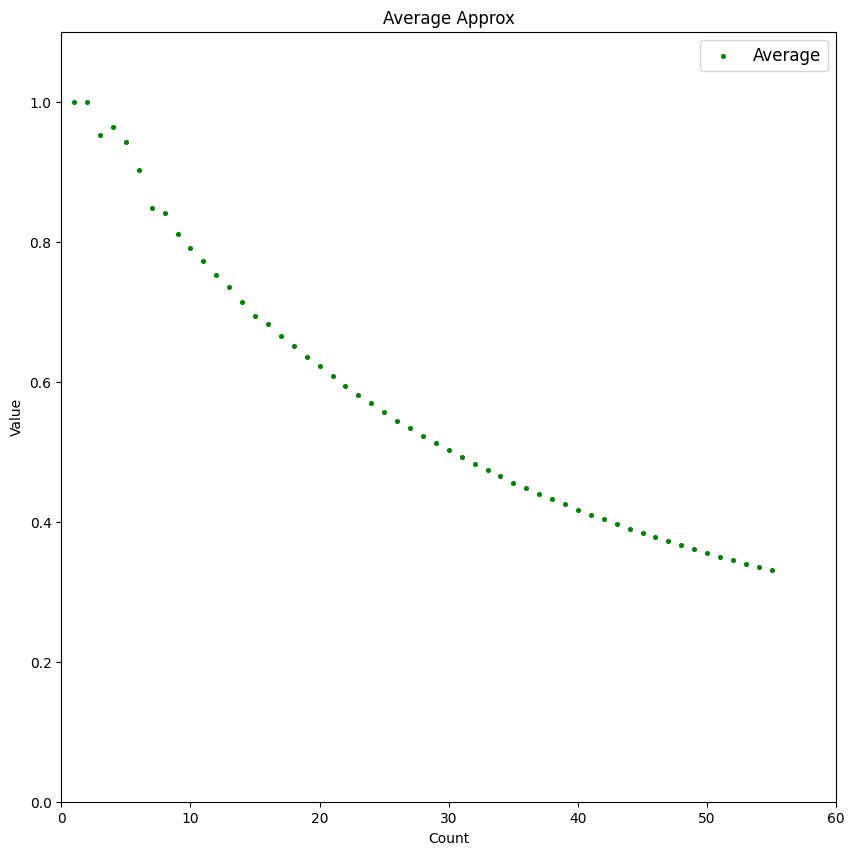

In [ ]:
nn = np.arange(1,56)

av = []
for i in nn:
  av.append(np.mean(Approx[0:i]))

print(av)

plt.figure(figsize=(10,10))
plt.scatter(nn,av,marker='o',s=7,color='g',label='Average')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Average Approx')
plt.xlabel('Count')
plt.ylabel('Value')
plt.xlim([0, 60])
plt.ylim([0, 1.1])
plt.show()

### Аппроксимация МНК (Approx)

In [ ]:
x = np.array(n)
y = np.array(Approx)

linear_func = lambda x, b0, b1: b0 + b1*x
quadratic_func = lambda x, b0, b1, b2: b0 + b1*x + b2*x**2
qubic_func = lambda x, b0, b1, b2, b3: b0 + b1*x + b2*x**2 + b3*x**3
exp_func = lambda x, b0, b1, b2: b0 + b1*np.exp(b2*x)
exp1_func = lambda x, b0, b1, b2: b0 + b1*np.exp(x-b2)
exp2_func = lambda x, b0, b1: b0*np.power(b1,x)
exp3_func = lambda x, b0, b1, b2:  b0 + b1*np.power(b2,x)


from scipy.optimize import leastsq

# list of model
model_list = [
    'linear', 'quadratic',
    'qubic']

# model reference
models_dict = {
        'linear':             linear_func,
        'quadratic':          quadratic_func,
        'qubic':              qubic_func}

# initial values
p0_dict = {
        'linear':             [0, 0],
        'quadratic':          [0, 0, 0],
        'qubic':              [0, 0, 0, 0]}

# titles (formulas)
formulas_dict = {
        'linear':             'y = b0 + b1*x',
        'quadratic':          'y = b0 + b1*x + b2*x^2',
        'qubic':              'y = b0 + b1*x + b2*x^2 + b3*x^3'}

# actual data
X_fact = x
Y_fact = y

# function for calculating residuals
residual_func = lambda p, x, y: y - func(x, *p)

# return all optional outputs
full_output = True

# variables to save the calculation results
calculation_results_df = pd.DataFrame(columns=['func', 'p0', 'popt', 'cov_x', 'SSE', 'MSE', 'pcov', 'perr', 'Y_calc', 'error_metrics'])
error_metrics_results_df = pd.DataFrame(columns=['MSE', 'RMSE', 'MAE', 'MSPE', 'MAPE', 'RMSLE', 'R2'])

# calculations
for func_name in model_list:
    print(f'{func_name.upper()} MODEL: {formulas_dict[func_name]}')
    func = models_dict[func_name]
    calculation_results_df.loc[func_name, 'func'] = func
    p0 = p0_dict[func_name]
    print(f'p0 = {p0}')
    calculation_results_df.loc[func_name, 'p0'] = p0
    if full_output:
        (popt, cov_x, infodict, mesg, ier) = leastsq(residual_func, p0, args=(X_fact, Y_fact), full_output=full_output)
        integer_flag = f'ier = {ier}, the solution was found' if ier<=4 else f'ier = {ier}, the solution was not found'
        print(integer_flag, '\n', mesg)
        calculation_results_df.loc[func_name, 'popt'] = popt
        print(f'parameters = {popt}')
        calculation_results_df.loc[func_name, 'cov_x'] = cov_x
        print(f'cov_x = \n{cov_x}')
        #SSE = (residual_func(popt, X_fact, Y_fact)**2).sum()
        SSE = (infodict['fvec']**2).sum()
        calculation_results_df.loc[func_name, 'SSE'] = SSE
        print(f'SSE = {SSE}')
        MSE = SSE / (len(Y_fact)-len(p0))
        calculation_results_df.loc[func_name, 'MSE'] = MSE
        print(f'MSE = {MSE}')
        pcov = cov_x * MSE
        calculation_results_df.loc[func_name, 'pcov'] = pcov
        print(f'pcov =\n {pcov}')
        perr = np.sqrt(np.diag(pcov))
        calculation_results_df.loc[func_name, 'perr'] = perr
        print(f'perr = {perr}\n')
    else:
        popt = leastsq(residual_func, p0, args=(X_fact, Y_fact), full_output=full_output)
        calculation_results_df.loc[func_name, 'popt'] = popt
        print(f'parameters = {popt}\n')
    Y_calc = func(X_fact, *popt)
    calculation_results_df.loc[func_name, 'Y_calc'] = Y_calc
    (error_metrics_dict, error_metrics_df) = regression_error_metrics(Yfact=Y_fact, Ycalc=Y_calc, model_name=func_name)
    calculation_results_df.loc[func_name, 'error_metrics'] = error_metrics_dict.values()
    error_metrics_results_df = pd.concat([error_metrics_results_df, error_metrics_df])

LINEAR MODEL: y = b0 + b1*x
p0 = [0, 0]
ier = 2, the solution was found 
 The relative error between two consecutive iterates is at most 0.000000
parameters = [ 0.7506103  -0.01500011]
cov_x = 
[[ 7.47474757e-02 -2.02020203e-03]
 [-2.02020203e-03  7.21500716e-05]]
SSE = 0.6650055769285713
MSE = 0.012547275036388137
pcov =
 [[ 9.37877135e-04 -2.53480305e-05]
 [-2.53480305e-05  9.05286793e-07]]
perr = [0.03062478 0.00095147]

QUADRATIC MODEL: y = b0 + b1*x + b2*x^2
p0 = [0, 0, 0]
ier = 2, the solution was found 
 The relative error between two consecutive iterates is at most 0.000000
parameters = [ 9.79514229e-01 -3.90952583e-02  4.30270538e-04]
cov_x = 
[[ 1.76138745e-01 -1.26929673e-02  1.90585093e-04]
 [-1.26929673e-02  1.19559905e-03 -2.00615888e-05]
 [ 1.90585093e-04 -2.00615888e-05  3.58242657e-07]]
SSE = 0.1482253182239159
MSE = 0.0028504868889214596
pcov =
 [[ 5.02081184e-04 -3.61811368e-05  5.43260309e-07]
 [-3.61811368e-05  3.40803940e-06 -5.71852958e-08]
 [ 5.43260309e-07 -5.7

#### 1 степень

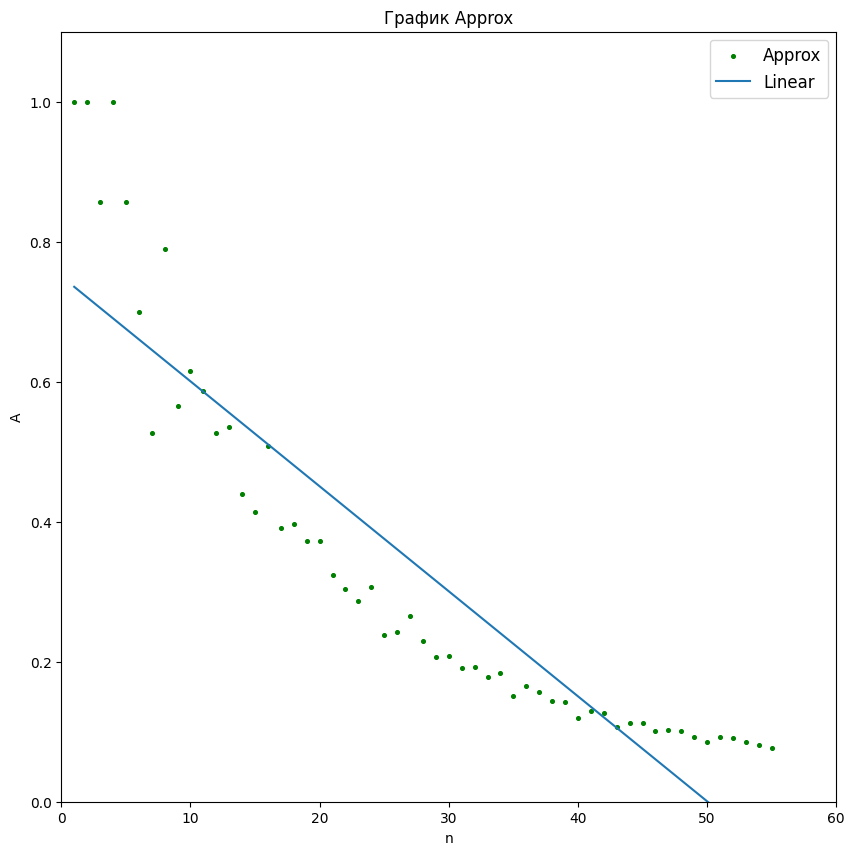

In [ ]:
b0, b1 = [ 0.7506103,  -0.01500011]

xx = np.arange (1,56)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='g',label='Approx')
plt.plot(xx, b0 + b1*xx , label = 'Linear')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Approx')
plt.xlabel('n')
plt.ylabel('A')
plt.xlim([0, 60])
plt.ylim([0, 1.1])
plt.show()

#### 2 степень

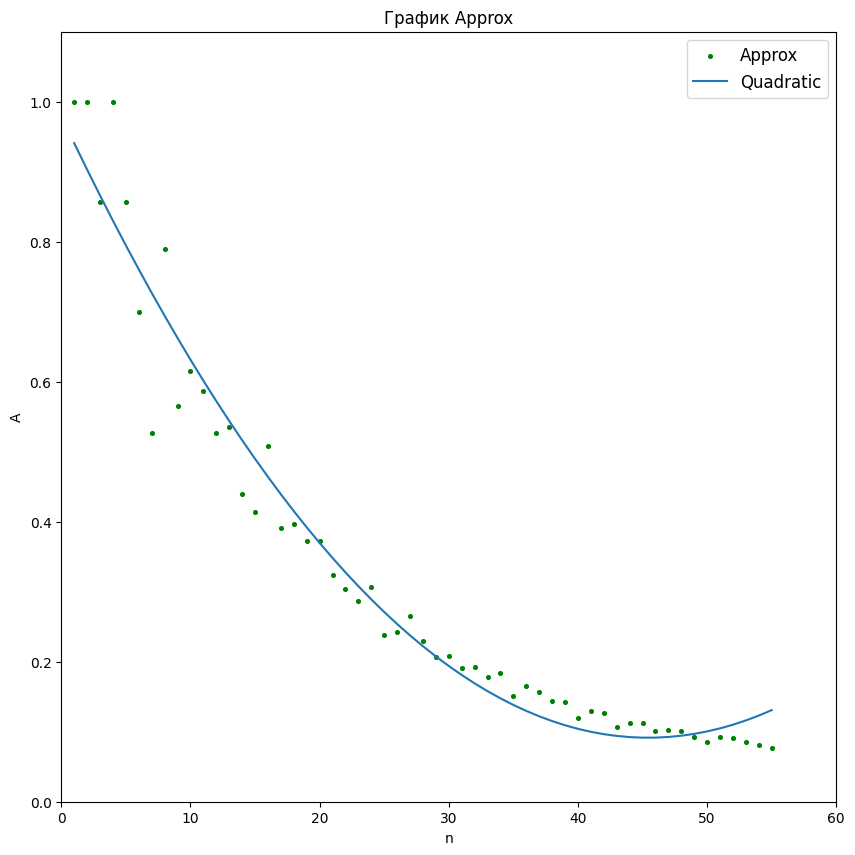

In [ ]:
b0, b1, b2 = [ 9.79514229e-01, -3.90952583e-02,  4.30270538e-04]

xx = np.arange (1,56)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='g',label='Approx')
plt.plot(xx, b0 + b1*xx + b2*xx**2 , label = 'Quadratic')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Approx')
plt.xlabel('n')
plt.ylabel('A')
plt.xlim([0, 60])
plt.ylim([0, 1.1])
plt.show()

#### 3 степень

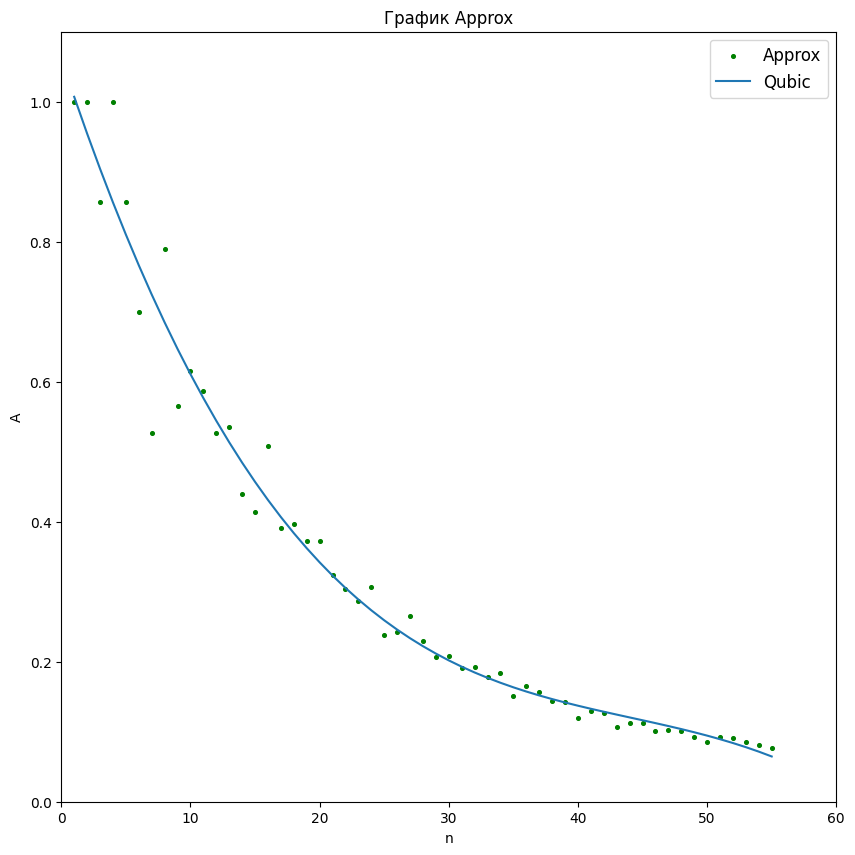

In [ ]:
b0, b1, b2, b3 = [ 1.06185591e+00, -5.59838062e-02,  1.17747270e-03, -8.89526381e-06]

xx = np.arange (1,56)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='g',label='Approx')
plt.plot(xx, b0 + b1*xx + b2*xx**2 + b3*xx**3 , label = 'Qubic')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Approx')
plt.xlabel('n')
plt.ylabel('A')
plt.xlim([0, 60])
plt.ylim([0, 1.1])
plt.show()

### Несколько точек (Approx)

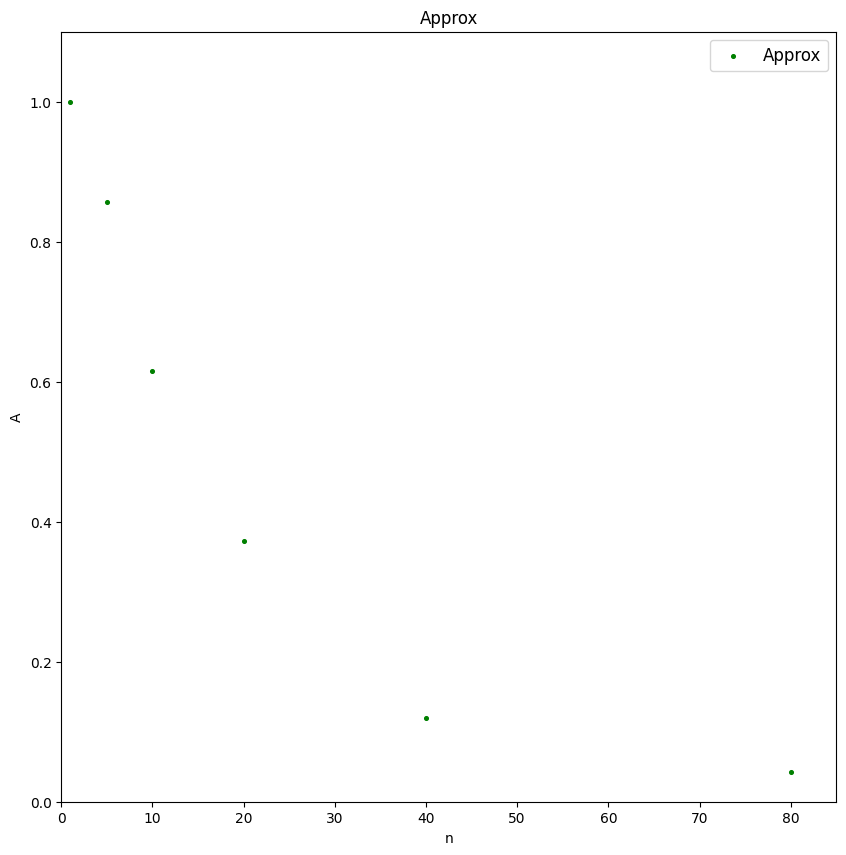

In [ ]:
Approx = [1, 0.8571, 0.6154, 0.3723, 0.1203, 0.0423]
n = [1, 5, 10, 20, 40, 80]

plt.figure(figsize=(10,10))
plt.scatter(n,Approx,marker='o',s=7,color='g',label='Approx')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Approx')
plt.xlabel('n')
plt.ylabel('A')
plt.xlim([0, 85])
plt.ylim([0, 1.1])
plt.show()

In [ ]:
x = np.array(n)
y = np.array(Approx)

linear_func = lambda x, b0, b1: b0 + b1*x
quadratic_func = lambda x, b0, b1, b2: b0 + b1*x + b2*x**2
qubic_func = lambda x, b0, b1, b2, b3: b0 + b1*x + b2*x**2 + b3*x**3
exp_func = lambda x, b0, b1, b2: b0 + b1*np.exp(b2*x)
exp1_func = lambda x, b0, b1, b2: b0 + b1*np.exp(x-b2)
exp2_func = lambda x, b0, b1: b0*np.power(b1,x)
exp3_func = lambda x, b0, b1, b2:  b0 + b1*np.power(b2,x)


from scipy.optimize import leastsq

# list of model
model_list = [
    'linear', 'quadratic',
    'qubic']

# model reference
models_dict = {
        'linear':             linear_func,
        'quadratic':          quadratic_func,
        'qubic':              qubic_func}

# initial values
p0_dict = {
        'linear':             [0, 0],
        'quadratic':          [0, 0, 0],
        'qubic':              [0, 0, 0, 0]}

# titles (formulas)
formulas_dict = {
        'linear':             'y = b0 + b1*x',
        'quadratic':          'y = b0 + b1*x + b2*x^2',
        'qubic':              'y = b0 + b1*x + b2*x^2 + b3*x^3'}

# actual data
X_fact = x
Y_fact = y

# function for calculating residuals
residual_func = lambda p, x, y: y - func(x, *p)

# return all optional outputs
full_output = True

# variables to save the calculation results
calculation_results_df = pd.DataFrame(columns=['func', 'p0', 'popt', 'cov_x', 'SSE', 'MSE', 'pcov', 'perr', 'Y_calc', 'error_metrics'])
error_metrics_results_df = pd.DataFrame(columns=['MSE', 'RMSE', 'MAE', 'MSPE', 'MAPE', 'RMSLE', 'R2'])

# calculations
for func_name in model_list:
    print(f'{func_name.upper()} MODEL: {formulas_dict[func_name]}')
    func = models_dict[func_name]
    calculation_results_df.loc[func_name, 'func'] = func
    p0 = p0_dict[func_name]
    print(f'p0 = {p0}')
    calculation_results_df.loc[func_name, 'p0'] = p0
    if full_output:
        (popt, cov_x, infodict, mesg, ier) = leastsq(residual_func, p0, args=(X_fact, Y_fact), full_output=full_output)
        integer_flag = f'ier = {ier}, the solution was found' if ier<=4 else f'ier = {ier}, the solution was not found'
        print(integer_flag, '\n', mesg)
        calculation_results_df.loc[func_name, 'popt'] = popt
        print(f'parameters = {popt}')
        calculation_results_df.loc[func_name, 'cov_x'] = cov_x
        print(f'cov_x = \n{cov_x}')
        #SSE = (residual_func(popt, X_fact, Y_fact)**2).sum()
        SSE = (infodict['fvec']**2).sum()
        calculation_results_df.loc[func_name, 'SSE'] = SSE
        print(f'SSE = {SSE}')
        MSE = SSE / (len(Y_fact)-len(p0))
        calculation_results_df.loc[func_name, 'MSE'] = MSE
        print(f'MSE = {MSE}')
        pcov = cov_x * MSE
        calculation_results_df.loc[func_name, 'pcov'] = pcov
        print(f'pcov =\n {pcov}')
        perr = np.sqrt(np.diag(pcov))
        calculation_results_df.loc[func_name, 'perr'] = perr
        print(f'perr = {perr}\n')
    else:
        popt = leastsq(residual_func, p0, args=(X_fact, Y_fact), full_output=full_output)
        calculation_results_df.loc[func_name, 'popt'] = popt
        print(f'parameters = {popt}\n')
    Y_calc = func(X_fact, *popt)
    calculation_results_df.loc[func_name, 'Y_calc'] = Y_calc
    (error_metrics_dict, error_metrics_df) = regression_error_metrics(Yfact=Y_fact, Ycalc=Y_calc, model_name=func_name)
    calculation_results_df.loc[func_name, 'error_metrics'] = error_metrics_dict.values()
    error_metrics_results_df = pd.concat([error_metrics_results_df, error_metrics_df])

LINEAR MODEL: y = b0 + b1*x
p0 = [0, 0]
ier = 3, the solution was found 
 Both actual and predicted relative reductions in the sum of squares
  are at most 0.000000 and the relative error between two consecutive iterates is at 
  most 0.000000
parameters = [ 0.79852268 -0.01143421]
cov_x = 
[[ 3.17897093e-01 -5.81655480e-03]
 [-5.81655480e-03  2.23713646e-04]]
SSE = 0.17638456326398205
MSE = 0.04409614081599551
pcov =
 [[ 1.40180350e-02 -2.56487619e-04]
 [-2.56487619e-04  9.86490843e-06]]
perr = [0.11839778 0.00314085]

QUADRATIC MODEL: y = b0 + b1*x + b2*x^2
p0 = [0, 0, 0]
ier = 2, the solution was found 
 The relative error between two consecutive iterates is at most 0.000000
parameters = [ 9.96593544e-01 -3.46726837e-02  2.85805464e-04]
cov_x = 
[[ 5.55248470e-01 -3.36635829e-02  3.42485112e-04]
 [-3.36635829e-02  3.49084013e-03 -4.01817450e-05]
 [ 3.42485112e-04 -4.01817450e-05  4.94187366e-07]]
SSE = 0.011093487791992845
MSE = 0.003697829263997615
pcov =
 [[ 2.05321404e-03 -1.2448

3 степень

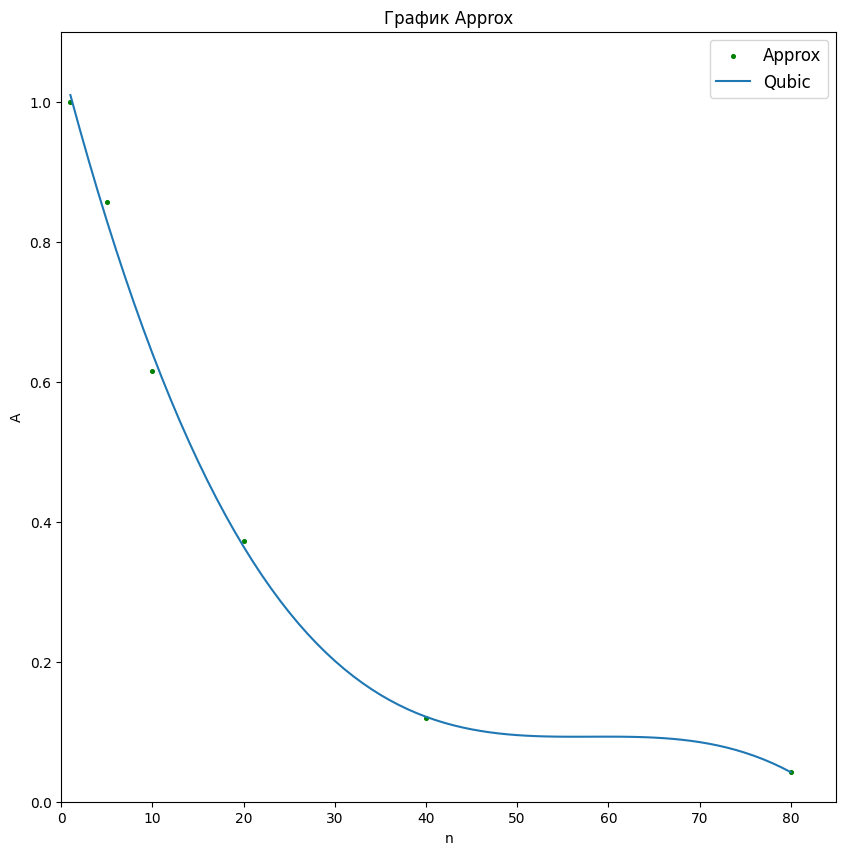

In [ ]:
b0, b1, b2, b3 =[ 1.05857686e+00, -4.99428412e-02,  8.60147875e-04, -4.93329418e-06]

xx = np.arange (1,81)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='g',label='Approx')
plt.plot(xx, b0 + b1*xx + b2*xx**2 + b3*xx**3 , label = 'Qubic')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Approx')
plt.xlabel('n')
plt.ylabel('A')
plt.xlim([0, 85])
plt.ylim([0, 1.1])
plt.show()

In [ ]:
import sympy as sp

def f(x):
  z = b0 + b1*x + b2*x**2 + b3*x**3
  return z

# Объявляем символьную переменную x
x = sp.Symbol ("x")
# Вывод функции
print("f(x) =", f(x))
# Находим производную функции f(x) и сохраняем ее в переменной d_f:
d_f = sp.diff(f(x), x)
print("Первая производная функции:",d_f)

# Решаем уравнение d_f = 0:
x_extr = sp.solve (d_f)
print ("точка экстремума:", x_extr)

# Сохраняем точки экстремума в переменные:
x_0 = x_extr[0]
x_1 = x_extr[1]

# Находим вторую производную функции:
d2_f = sp.diff(f(x), x, 2)
print("Вторая производная функции:", d2_f)

# Решаем уравнение d2_f = 0
x_extr2 = sp.solve (d2_f)
print ("точка перегиба:", x_extr2)


# Находим значение второй производной в точках экстремума x_0 и x_1,
# Сохраняем их в переменные f_0_d2 и f_1_d2:
f_0_d2 = d2_f.evalf(subs = {x : x_0})
f_1_d2 = d2_f.evalf(subs = {x : x_1})

# Определяем, является ли точка x_0 точкой лок.минимума, максимума или перегиба
if f_0_d2 > 0:
  print(x_0, "- локальный минимум")
elif f_0_d2 < 0:
  print(x_0, "- локальный максимум")
else:
  print(x_0, "- точка перегиба")

# Определяем, является ли точка x_1 точкой лок.минимума, максимума или перегиба
if f_1_d2 > 0:
  print(x_1, "- локальный минимум")
elif f_1_d2 < 0:
  print(x_1, "- локальный максимум")
else:
  print(x_1, "- точка перегиба")


f(x) = -4.93329418e-6*x**3 + 0.000860147875*x**2 - 0.0499428412*x + 1.05857686
Первая производная функции: -1.479988254e-5*x**2 + 0.00172029575*x - 0.0499428412
точка экстремума: [56.3229986058335, 59.9141232328376]
Вторая производная функции: 0.00172029575 - 2.959976508e-5*x
точка перегиба: [58.1185609193355]
56.3229986058335 - локальный минимум
59.9141232328376 - локальный максимум


2 степень

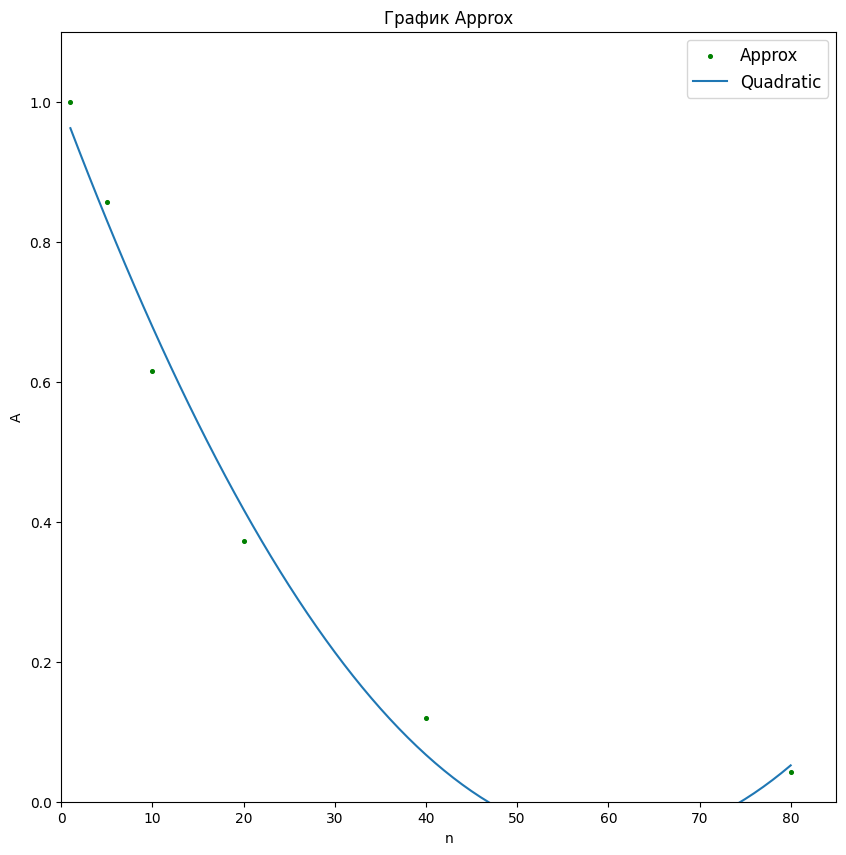

In [ ]:
b0, b1, b2 = [ 9.96593544e-01, -3.46726837e-02,  2.85805464e-04]

xx = np.arange (1,81)
plt.figure(figsize=(10,10))
plt.scatter(x,y,marker='o',s=7,color='g',label='Approx')
plt.plot(xx, b0 + b1*xx + b2*xx**2 , label = 'Quadratic')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('График Approx')
plt.xlabel('n')
plt.ylabel('A')
plt.xlim([0, 85])
plt.ylim([0, 1.1])
plt.show()

In [ ]:
from sympy import *

x = Symbol('x', real=True)
f = b0 + b1*x + b2*x**2
fprime = f.diff(x)

solve(fprime, x)

[60.6578391027542]

### Сведенные графики Excess и Approx

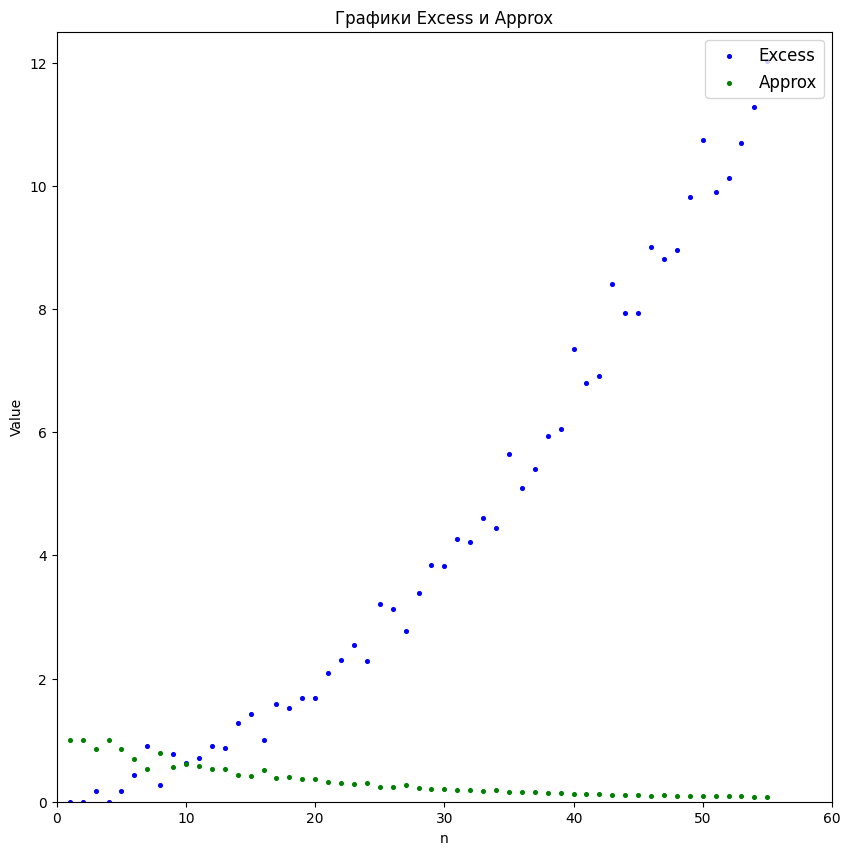

In [ ]:
Approx = [1, 1, 0.8571, 1, 0.8571, 0.7, 0.5263, 0.7895, 0.5652, 0.6154, 0.5862, 0.5263, 0.5349, 0.44, 0.4138, 0.5088, 0.3913, 0.3974, 0.3721, 0.3723,
          0.3238, 0.3033, 0.2869, 0.3066, 0.2378, 0.2422, 0.2654, 0.2291, 0.2067, 0.2081, 0.1905, 0.1926, 0.1781, 0.1843, 0.1513, 0.1649, 0.1568, 0.1442, 0.1424, 0.1203,
          0.1289, 0.1263, 0.1064, 0.1124, 0.1119, 0.1004, 0.1024, 0.1008, 0.0927, 0.0853, 0.0921, 0.0904, 0.086, 0.0816, 0.0768]

Excess = [0, 0, 0.1667, 0, 0.1667, 0.4286, 0.9, 0.2667, 0.7692, 0.625, 0.7059, 0.9, 0.8696, 1.2727, 1.4167, 1, 1.5926, 1.5161, 1.6875, 1.6857,
          2.0882, 2.2973, 2.5429, 2.2857, 3.2051, 3.1282, 2.7674, 3.3902, 3.8372, 3.8293, 4.2727, 4.2128, 4.6136, 4.4468, 5.6522, 5.087, 5.4, 5.9348, 6.0426, 7.3556,
          6.8044, 6.9167, 8.4, 7.9375, 7.9375, 9, 8.8044, 8.9592, 9.8125, 10.7391, 9.898, 10.1225, 10.6875, 11.2708, 12.0204]


n = list(range(1, 56))


plt.figure(figsize=(10,10))
plt.scatter(n,Excess,marker='o',s=7,color='b',label='Excess')
plt.scatter(n,Approx,marker='o',s=7,color='g',label='Approx')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Графики Excess и Approx')
plt.xlabel('n')
plt.ylabel('Value')
plt.xlim([0, 60])
plt.ylim([0, 12.5])
plt.show()

# Excess для всех 3 классов

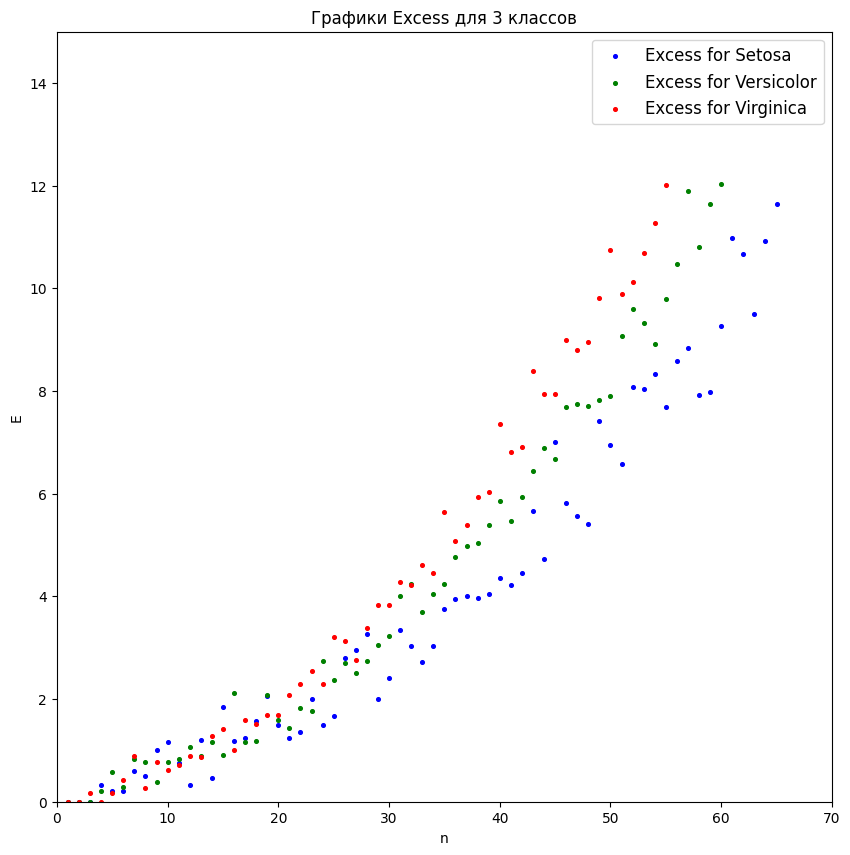

In [ ]:
Excess1 = [0, 0, 0, 0.3333, 0.2, 0.2, 0.6, 0.5, 1, 1.1667, 0.75, 0.3333, 1.2, 0.4615, 1.8462, 1.1765, 1.25, 1.5789, 2.0556, 1.5,
          1.25, 1.3636, 2, 1.5, 1.6774, 2.8076, 2.9643, 3.2692, 2, 2.4194, 3.3448, 3.0303, 2.7222, 3.027, 3.75, 3.9459, 4, 3.9736, 4.0513, 4.3514,
          4.2143, 4.4651, 5.6571, 4.7273, 7, 5.8182, 5.5609, 5.4091, 7.4211, 6.95, 6.5778, 8.0698, 8.0455, 8.3333, 7.6957, 8.587, 8.8372, 7.9167, 7.9783, 9.2667,
          10.9772, 10.6667, 9.5, 10.9318, 11.6522]

n1 = list(range(1, 66))

Excess2 = [0, 0, 0, 0.2, 0.5714, 0.2857, 0.8333, 0.7778, 0.3846, 0.7692, 0.8333, 1.0625, 0.8889, 1.1667, 0.913, 2.1177, 1.1667, 1.1852, 2.087, 1.5862,
          1.4412, 1.8182, 1.7714, 2.7419, 2.3714, 2.6944, 2.5135, 2.7436, 3.0526, 3.2195, 4, 4.2432, 3.6889, 4.0488, 4.25, 4.7674, 4.9778, 5.0455, 5.4, 5.8605,
          5.4681, 5.9362, 6.4444, 6.8913, 6.6667, 7.6889, 7.7447, 7.7083, 7.8333, 7.898, 9.0638, 9.5957, 9.3192, 8.92, 9.8, 10.4694, 11.8936, 10.8125, 11.6531, 12.0408]

n2 = list(range(1, 61))

Excess3 = [0, 0, 0.1667, 0, 0.1667, 0.4286, 0.9, 0.2667, 0.7692, 0.625, 0.7059, 0.9, 0.8696, 1.2727, 1.4167, 1, 1.5926, 1.5161, 1.6875, 1.6857,
          2.0882, 2.2973, 2.5429, 2.2857, 3.2051, 3.1282, 2.7674, 3.3902, 3.8372, 3.8293, 4.2727, 4.2128, 4.6136, 4.4468, 5.6522, 5.087, 5.4, 5.9348, 6.0426, 7.3556,
          6.8044, 6.9167, 8.4, 7.9375, 7.9375, 9, 8.8044, 8.9592, 9.8125, 10.7391, 9.898, 10.1225, 10.6875, 11.2708, 12.0204]

n3 = list(range(1, 56))

plt.figure(figsize=(10,10))
plt.scatter(n1,Excess1,marker='o',s=7,color='b',label='Excess for Setosa')
plt.scatter(n2,Excess2,marker='o',s=7,color='g',label='Excess for Versicolor')
plt.scatter(n3,Excess3,marker='o',s=7,color='r',label='Excess for Virginica')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Графики Excess для 3 классов')
plt.xlabel('n')
plt.ylabel('E')
plt.xlim([0, 70])
plt.ylim([0, 15])
plt.show()

# Approx для всех 3 классов

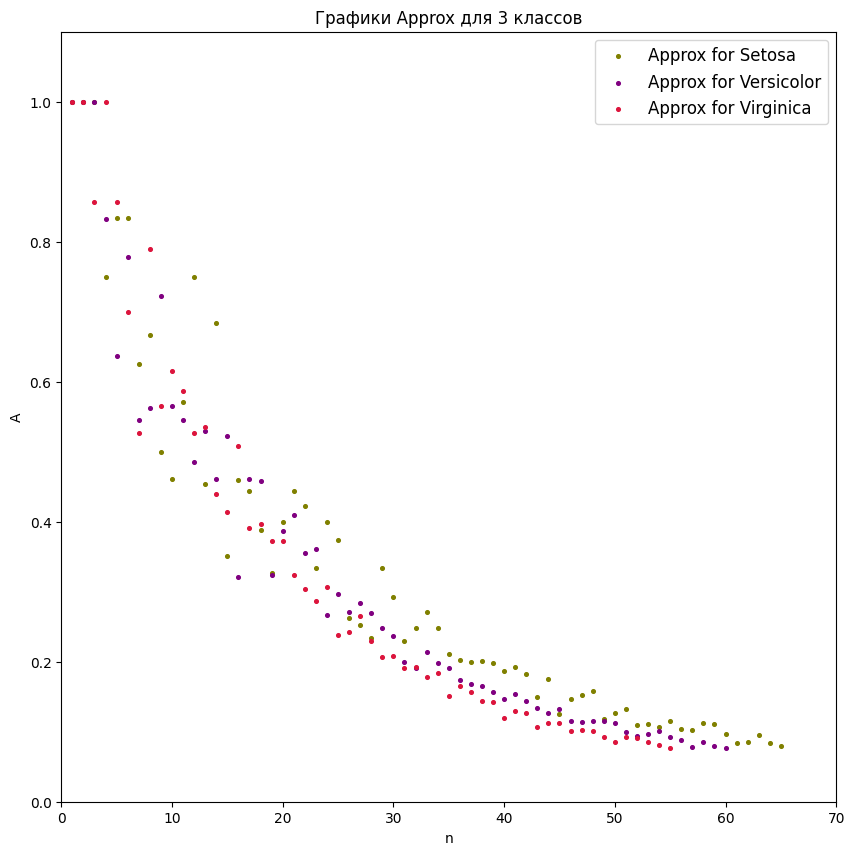

In [ ]:
Approx1 = [1, 1, 1, 0.75, 0.8333, 0.8333, 0.625, 0.6667, 0.5, 0.4615, 0.5714, 0.75, 0.4546, 0.6842, 0.3514, 0.4595, 0.4444, 0.3877, 0.3272, 0.4,
          0.4444, 0.4231, 0.3333, 0.4, 0.3735, 0.2626, 0.2523, 0.2342, 0.3333, 0.2925, 0.2302, 0.2481, 0.2706, 0.2483, 0.2105, 0.2021, 0.2, 0.2011, 0.198, 0.1869,
          0.1927, 0.183, 0.15, 0.1753, 0.125, 0.1467, 0.1524, 0.1577, 0.1188, 0.1262, 0.1324, 0.1103, 0.1111, 0.1074, 0.115, 0.1046, 0.1029, 0.1124, 0.1114, 0.0974,
          0.0838, 0.0857, 0.0952, 0.0842, 0.079]

n1 = list(range(1, 66))

Approx2 = [1, 1, 1, 0.833, 0.6364, 0.7778, 0.5455, 0.5625, 0.7222, 0.5652, 0.5455, 0.4849, 0.5294, 0.4615, 0.5227, 0.3208, 0.4615, 0.4576, 0.3239, 0.3867,
          0.4096, 0.3548, 0.3608, 0.2672, 0.2966, 0.2707, 0.2846, 0.269, 0.2484, 0.237, 0.2, 0.1907, 0.2133, 0.1981, 0.1913, 0.1734, 0.1679, 0.166, 0.1568, 0.1463,
          0.1546, 0.1442, 0.1343, 0.1267, 0.1319, 0.1151, 0.1144, 0.1148, 0.1159, 0.1124, 0.0996, 0.0946, 0.0969, 0.1012, 0.0928, 0.0877, 0.0777, 0.0853, 0.0792, 0.0769]

n2 = list(range(1, 61))

Approx3 = [1, 1, 0.8571, 1, 0.8571, 0.7, 0.5263, 0.7895, 0.5652, 0.6154, 0.5862, 0.5263, 0.5349, 0.44, 0.4138, 0.5088, 0.3913, 0.3974, 0.3721, 0.3723,
          0.3238, 0.3033, 0.2869, 0.3066, 0.2378, 0.2422, 0.2654, 0.2291, 0.2067, 0.2081, 0.1905, 0.1926, 0.1781, 0.1843, 0.1513, 0.1649, 0.1568, 0.1442, 0.1424, 0.1203,
          0.1289, 0.1263, 0.1064, 0.1124, 0.1119, 0.1004, 0.1024, 0.1008, 0.0927, 0.0853, 0.0921, 0.0904, 0.086, 0.0816, 0.0768]

n3 = list(range(1, 56))

plt.figure(figsize=(10,10))
plt.scatter(n1,Approx1,marker='o',s=7,color='olive',label='Approx for Setosa')
plt.scatter(n2,Approx2,marker='o',s=7,color='purple',label='Approx for Versicolor')
plt.scatter(n3,Approx3,marker='o',s=7,color='crimson',label='Approx for Virginica')
plt.legend(loc= 'upper right',fontsize=12)
plt.title('Графики Approx для 3 классов')
plt.xlabel('n')
plt.ylabel('A')
plt.xlim([0, 70])
plt.ylim([0, 1.1])
plt.show()

# Проверки

In [ ]:
x_min, x_max = X[:, 0].min() - 1, X[:, 0].max() + 1
print(x_min, x_max)
y_min, y_max = X[:, 1].min() - 1, X[:, 1].max() + 1
print(y_min, y_max)
z_min, z_max = X[:, 2].min() - 1, X[:, 2].max() + 1
print(z_min, z_max)
f_min, f_max = X[:, 3].min() - 1, X[:, 3].max() + 1
print(f_min, f_max)

3.3 8.9
1.0 5.4
0.0 7.9
-0.9 3.5


In [ ]:
v_min = min(x_min, y_min, z_min, f_min)
v_min

-0.9

In [ ]:
v_max = max(x_max, y_max, z_max, f_max)
v_max

8.9

In [ ]:
h_x = 1
h_y = 1
h_z = 1
h_f = 1

In [ ]:
xx, yy, zz, ff = np.meshgrid(np.arange(x_min, x_max, h_x), np.arange(y_min, y_max, h_y),np.arange(z_min, z_max, h_z), np.arange(f_min, f_max, h_f))
X_plot = np.c_[xx.ravel(), yy.ravel(), zz.ravel(), ff.ravel()]

X_plot.shape

(1200, 4)

In [ ]:
numb_square_x = round((x_max - x_min) / h_x)
numb_square_y = round((y_max - y_min) / h_y)
numb_square_z = round((z_max - z_min) / h_z)
numb_square_f = round((f_max - f_min) / h_f)

print(numb_square_x)
print(numb_square_y)
print(numb_square_z)
print(numb_square_f)

xbounds = [(x_min + i*h_x, x_min + (i + 1)*h_x) for i in range(numb_square_x)]
ybounds = [(y_min + i*h_y, y_min + (i + 1)*h_y) for i in range(numb_square_y)]
zbounds = [(z_min + i*h_z, z_min + (i + 1)*h_z) for i in range(numb_square_z)]
fbounds = [(f_min + i*h_f, f_min + (i + 1)*h_f) for i in range(numb_square_f)]


6
4
8
4


In [ ]:
xbounds

[(3.3, 4.3), (4.3, 5.3), (5.3, 6.3), (6.3, 7.3), (7.3, 8.3), (8.3, 9.3)]

In [ ]:
cart = np.zeros((1, 2, 3, 4))
cart

array([[[[0., 0., 0., 0.],
         [0., 0., 0., 0.],
         [0., 0., 0., 0.]],

        [[0., 0., 0., 0.],
         [0., 0., 0., 0.],
         [0., 0., 0., 0.]]]])

In [ ]:
cart[0, 1, 1, 3] = 1

In [ ]:
cart

array([[[[0., 0., 0., 1.],
         [0., 0., 0., 1.],
         [0., 0., 0., 0.]],

        [[0., 0., 0., 0.],
         [0., 0., 0., 1.],
         [0., 0., 0., 0.]]]])

In [ ]:
x_min, x_max = iris1[:, 0].min() - 1, iris1[:, 0].max() + 1
print(x_min, x_max)
y_min, y_max = iris1[:, 1].min() - 1, iris1[:, 1].max() + 1
print(y_min, y_max)
z_min, z_max = iris1[:, 2].min() - 1, iris1[:, 2].max() + 1
print(z_min, z_max)
f_min, f_max = iris1[:, 3].min() - 1, iris1[:, 3].max() + 1
print(f_min, f_max)

3.3 6.8
1.2999999999999998 5.4
0.0 2.9
-0.9 1.6


In [ ]:
h_x = (x_max - x_min) / 10
h_y = (y_max - y_min) / 10
h_z = (z_max - z_min) / 10
h_f = (f_max - f_min) / 10

print(h_x)
print(h_y)
print(h_z)
print(h_f)

0.35
0.41000000000000003
0.29
0.25


In [ ]:
a = ([[5.1, 3.5, 1.4, 0.2],
       [4.9, 3. , 1.4, 0.2],
       [4.7, 3.2, 1.3, 0.2],
       [4.6, 3.1, 1.5, 0.2],
       [5. , 3.6, 1.4, 0.2],
       [5.4, 3.9, 1.7, 0.4],
       [4.6, 3.4, 1.4, 0.3]])

a = np.array(a)
a

array([[5.1, 3.5, 1.4, 0.2],
       [4.9, 3. , 1.4, 0.2],
       [4.7, 3.2, 1.3, 0.2],
       [4.6, 3.1, 1.5, 0.2],
       [5. , 3.6, 1.4, 0.2],
       [5.4, 3.9, 1.7, 0.4],
       [4.6, 3.4, 1.4, 0.3]])

In [ ]:
x_min, x_max = a[:, 0].min() - 2, a[:, 0].max() + 1
# print(x_min, x_max)
y_min, y_max = a[:, 1].min() - 1, a[:, 1].max() + 1
# print(y_min, y_max)
z_min, z_max = a[:, 2].min() - 1, a[:, 2].max() + 1
f_min, f_max = a[:, 3].min() - 1, a[:, 3].max() + 1

h_x = (x_max - x_min) / 30
h_y = (y_max - y_min) / 30
h_z = (z_max - z_min) / 30
h_f = (f_max - f_min) / 30
h_y = h_x
h_z = h_x
h_f = h_x
    #print('ШАГ x:', h_x)
    #print('ШАГ y:', h_y)
xx, yy, zz, ff = np.meshgrid(np.arange(x_min, x_max, h_x), np.arange(y_min, y_max, h_y),np.arange(z_min, z_max, h_z), np.arange(f_min, f_max, h_f))
X_plot = np.c_[xx.ravel(), yy.ravel(), zz.ravel(), ff.ravel()]

In [ ]:
print(x_min)
print(x_max)
print(h_x)

2.5999999999999996
6.4
0.12666666666666668


In [ ]:
print(y_min)
print(y_max)
print(h_y)

2.0
4.9
0.12666666666666668


In [ ]:
print(z_min)
print(z_max)
print(h_z)

0.30000000000000004
2.7
0.12666666666666668


In [ ]:
print(f_min)
print(f_max)
print(h_f)

-0.8
1.4
0.12666666666666668


In [ ]:
xx, yy, zz, ff = np.meshgrid(np.arange(x_min, x_max, h_x), np.arange(y_min, y_max, h_y),np.arange(z_min, z_max, h_z), np.arange(f_min, f_max, h_f))
X_plot = np.c_[xx.ravel(), yy.ravel(), zz.ravel(), ff.ravel()]

In [ ]:
xx.shape

(23, 31, 19, 18)

In [ ]:
X_plot

array([[ 2.6       ,  2.        ,  0.3       , -0.8       ],
       [ 2.6       ,  2.        ,  0.3       , -0.67333333],
       [ 2.6       ,  2.        ,  0.3       , -0.54666667],
       ...,
       [ 6.4       ,  4.78666667,  2.58      ,  1.1       ],
       [ 6.4       ,  4.78666667,  2.58      ,  1.22666667],
       [ 6.4       ,  4.78666667,  2.58      ,  1.35333333]])

In [ ]:
X_plot.shape

(243846, 4)

In [ ]:
a_prr, ireshka = predict_ae(ae_ir1_trainned, X_plot, IREth_ir1)

7621/7621 [==============================] - 26s 3ms/step


In [ ]:
a_prr

array([[1.],
       [1.],
       [1.],
       ...,
       [1.],
       [1.],
       [1.]])

In [ ]:
X_def = np.array([0, 0, 0, 0], ndmin=2)
for ind,ans in enumerate(a_prr):
  if ans == 0:
    # print(ans, ' kl= 1')
    # print(ind, len (svm_predicted_scan))
    X_def = np.append(X_def, [X_plot[ind]], axis=0)

X_def


array([[0.        , 0.        , 0.        , 0.        ],
       [2.6       , 2.        , 1.31333333, 0.08666667],
       [2.6       , 2.        , 1.31333333, 0.21333333],
       ...,
       [6.4       , 4.78666667, 1.82      , 0.34      ],
       [6.4       , 4.78666667, 1.82      , 0.46666667],
       [6.4       , 4.78666667, 1.82      , 0.59333333]])

In [ ]:
h_x = (x_max - x_min) / 4
h_y = (y_max - y_min) / 4
h_z = (z_max - z_min) / 4
h_f = (f_max - f_min) / 4

h_x = abs(h_x)
h_y = abs(h_y)
h_z = abs(h_z)
h_f = abs(h_f)

In [ ]:
col_id = np.zeros(4)
col_id_ae = np.zeros(4)

col_id

array([0., 0., 0., 0.])

In [ ]:
print(x_min)
print(x_max)
print(h_x)

2.5999999999999996
6.4
0.9500000000000002


In [ ]:
print(y_min)
print(y_max)
print(h_y)

2.0
4.9
0.7250000000000001


In [ ]:
print(z_min)
print(z_max)
print(h_z)

0.30000000000000004
2.7
0.6000000000000001


In [ ]:
print(f_min)
print(f_max)
print(h_f)

-0.8
1.4
0.55
